<a href="https://colab.research.google.com/github/MNguyen-65/Autocheckout-Bot/blob/master/Custom_Backtester.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install yfinance

In [22]:
import pandas as pd
import time
import numpy as np
from datetime import datetime, timedelta,date
import copy 
import matplotlib.pyplot as plt
from scipy import stats
import random
from pandas_datareader import data as pdr
import yfinance as yf
from IPython.core.debugger import set_trace
plt.style.use('ggplot')
%matplotlib inline
from google.colab import drive
drive.mount('drive')

Drive already mounted at drive; to attempt to forcibly remount, call drive.mount("drive", force_remount=True).


In [3]:
def nearest(possible_values, value):
    return min(possible_values, key=lambda x: abs(x - value))

def unique(list1): 
    # intilize a null list 
    unique_list = [] 
    # traverse for all elements 
    for x in list1: 
        # check if exists in unique_list or not 
        if x not in unique_list: 
            unique_list.append(x)
    return unique_list

In [149]:
df = pd.read_csv(f'drive/My Drive/Historical Options Data/Final Equity Data/JNJ 2013-Present with 2018.csv')
df['trade_date'] = pd.to_datetime(df['trade_date'])
df['expirDate'] = pd.to_datetime(df['expirDate'])
df['pct_change'] = ''
df_dates = pd.to_datetime(df["trade_date"].map(pd.Timestamp.date).unique())

In [150]:
def get_pct_change(df, trade_dates, date):
    previous_date = np.datetime64(trade_dates[trade_dates < date][-1])
    previous_filter = df['trade_date'] == previous_date
    current_filter = df['trade_date'] == np.datetime64(date)
    previous_price =  df[previous_filter]["stkPx"].iloc[0]
    current_price = df[current_filter]["stkPx"].iloc[0]
    return (current_price - previous_price)/100

In [151]:
for i in range(1,len(df_dates)):
  pct_change = get_pct_change(df,df_dates,df_dates[i])
  df.loc[df['trade_date'] == df_dates[i],'pct_change'] = pct_change
  print(df_dates[i],pct_change)

2013-01-03 00:00:00 -0.0010000000000000852
2013-01-04 00:00:00 0.008100000000000022
2013-01-07 00:00:00 -0.0014999999999999148
2013-01-08 00:00:00 9.999999999990905e-05
2013-01-09 00:00:00 0.003200000000000074
2013-01-10 00:00:00 0.0045999999999999375
2013-01-11 00:00:00 0.0015999999999999658
2013-01-14 00:00:00 0.0021000000000000797
2013-01-15 00:00:00 -0.0018999999999999772
2013-01-16 00:00:00 0.0020999999999999374
2013-01-17 00:00:00 0.003200000000000074
2013-01-18 00:00:00 0.003299999999999983
2013-01-22 00:00:00 -0.005400000000000063
2013-01-23 00:00:00 0.0015999999999999658
2013-01-24 00:00:00 0.0025
2013-01-25 00:00:00 0.008200000000000074
2013-01-28 00:00:00 -0.0029999999999999714
2013-01-29 00:00:00 0.007899999999999921
2013-01-30 00:00:00 -0.0031999999999999316
2013-01-31 00:00:00 -0.001700000000000017
2013-02-01 00:00:00 0.002600000000000051
2013-02-04 00:00:00 -0.0007000000000000739
2013-02-05 00:00:00 0.005499999999999972
2013-02-06 00:00:00 0.00730000000000004
2013-02-07 

In [ ]:
pct_change = pdr.get_data_yahoo("JNJ", start="2013-1-1", end="2020-8-14")['Close'].pct_change()[2:30]

In [153]:
df.to_csv(f'drive/My Drive/Shared Drive/Lavaca Capital/Historical Options Data/JNJ 2013-Present with 2018 and pct.csv')

In [ ]:
def plot_returns(portfolios,figsize = (6,4),bar_graph = True, graph_rolls = False):

    fig, ax1 = plt.subplots(figsize = (10,6))
    ax2 = ax1.twinx()  # set up the 2nd axis
    fig.autofmt_xdate()
    # the next few lines plot the fiscal year data as bar plots and changes the color for each.
    
    for portfolio in portfolios:
        data = {'date':[date[0] for date in portfolio.PNL],'port_val' : np.cumsum([date[1] for date in portfolio.PNL])}
        port_df = pd.DataFrame(data)
        data = {'date':[date[0] for date in portfolio.PNL_roll],'port_val' : np.cumsum([date[1] for date in portfolio.PNL_roll])}
        rolls_df = pd.DataFrame(data)
        data = {'date':[date[0] for date in portfolio.PNL_no_roll],'port_val' : np.cumsum([date[1] for date in portfolio.PNL_no_roll])}
        no_roll_df = pd.DataFrame(data)
        port_df['pct_change'] = port_df['port_val'].pct_change()
        port_df['positive'] = port_df['pct_change'] > 0
        port_df = port_df.sort_values(by="date")
        no_roll_df = no_roll_df.sort_values(by="date")
        port_df = port_df.sort_values(by="date")
        line_tag = f"{portfolio.dte_sell} DTE, Freq:{portfolio.frequency}, Entry:{portfolio.strike_signal_val}, Exit:{portfolio.exit_signal_val}, Roll:{portfolio.roll_positions}"
        ax1.plot(port_df['date'].values,port_df['port_val'].values, 'o-', lw = 1.5, label = line_tag) #plot the Revenue on axis #1
        if graph_rolls:
            ax1.plot(rolls_df['date'].values,rolls_df['port_val'].values, 'o-', lw = 1.5, label = line_tag) #plot the Revenue on axis #1
        print(f"Sharpe: {(port_df['pct_change'].mean() / port_df['pct_change'].std()) * (252**0.5)}")
    ax1.legend()
    
    if bar_graph:
        ax2.bar(port_df['date'].values,port_df['pct_change'].values,width = 6, alpha = 0.5,color=port_df.positive.map({True: 'g', False: 'r'}))
        # ax2.bar([date[0] for i, date in enumerate(portfolio.PNL) if pct_trade[1] < 0],pd.Series([date[1] for date in portfolio.PNL if date[1] < 0]).pct_change(),width = 8, alpha=0.6, color='red')
        # ax2.bar([date[0] for date in portfolio.PNL if date[1] >= 0],pd.Series([date[1] for date in portfolio.PNL if date[1] >= 0]).pct_change(),width = 8, alpha=0.6, color='green')
        ax2.set_ylabel('% PNL Per Trade')
    ax2.grid(b=False) # turn off grid #2

    if len(portfolios) == 1:
        title = f"{portfolio.ticker} Backtest ({portfolio.strike_signal}: {portfolio.strike_signal_val}, {portfolio.dte_sell} DTE, {portfolio.frequency} freq.)"
        if portfolio.exit_signal:
            title = title + f", exit: {portfolio.exit_signal_val} {portfolio.exit_signal}"
        if portfolio.roll_positions:
            title = title + f", Roll Losses"
    else:
        title = f"{portfolio.ticker} Backtest"
    ax1.set_title(title)
    ax1.set_ylabel('Portfolio Value')
    plt.show()
    

In [ ]:
class portfolio:
    
    # Ticker can be any ticker from the data. Change date in YYYY,M,D format. 
    # Strike_signal can be moneyness or delta and strike_signal_val should be the moneyness (ie:1.1) or delta (ie:0.25) that we purchase at, respectively
    # Dte_sell is how far the options are. Frequency compensates for start_date descrepancies and can be set to under the dte_sell variable to overlap positions
    # roll_positions can be True or False. Roll_strategy_credit is similar to strike_signal how we choose the strike for the roll position (fixed or delta) and roll_credit_val is the corresponding value (ie: $0.5 or 0.25 delta, respectively)
    # roll_strategy is when we decide to stop rolling our positions (total_pnl, hybrid, trade_pnl, initial_loss, fixed) and exit is the corresponding value for either setting
    
    def __init__(self, ticker = 'JNJ', start_date = datetime(2017,1,1), end_date = datetime(2020,1,1), date_offset = 0,
                 strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 14, frequency= 14,
                 exit_signal = 'delta', exit_signal_val = .15, 
                 roll_positions = False, roll_strategy_credit = 'fixed', roll_credit = 0.4, 
                 roll_strategy = 'trade_pnl', roll_strategy_exit = 0.2,df = None):
        
        self.ticker = ticker.upper()
        self.start_date = start_date
        self.end_date = end_date
        self.date_offset = timedelta(days= date_offset)
        self.strike_signal = strike_signal
        self.strike_signal_val = strike_signal_val
        self.dte_sell = dte_sell
        self.exit_signal = exit_signal
        self.exit_signal_val = exit_signal_val
        self.frequency = frequency
        # Set constant to prevent compounding (self.PNL[-1][1] * self.trade_allocation) / premium
        self.num_contracts = 7700
        self.PNL = [[start_date,1000000]]
        self.PNL_no_roll = [[start_date,1000000]]
        self.PNL_roll = [[start_date,1000000]]
        if type(df) != pd.core.frame.DataFrame:
          df = pd.read_csv(f'C:/Users/Michael Nguyen/Google Drive/Shared Drive/Lavaca Capital/Historical Options Data/{ticker} 2013-Present with 2018.csv')
          df['trade_date'] = pd.to_datetime(df['trade_date'])
          df['expirDate'] = pd.to_datetime(df['expirDate'])
        self.df = df      
        self.roll_positions = roll_positions
        self.roll_strategy = roll_strategy
        self.roll_credit = roll_credit
        self.roll_strategy_exit = roll_strategy_exit
        self.trading_days = pd.to_datetime(df["trade_date"].map(pd.Timestamp.date).unique())
                
    def run_backtest(self):
        # Making list of desired trading dates
        df = self.df
        dates = [self.start_date]
        date = self.start_date
        i=1
        while date < (self.end_date - timedelta(self.dte_sell)):
            date += timedelta(self.frequency)
            dates.append(date)
            i+=1
        
        # Since some are non-trading days, this matches each date to the closest trading day
        self.trade_dates = [nearest(self.trading_days,pd.to_datetime(x)) for x in dates]
        
        # Simulate trades for each day of each trading day
        for i, date in enumerate(self.trade_dates):
            
            # Filtering the dataset so that we only look at a specific trade date, expiry, and liquidity (at least one option traded- prevents issues with calls valued at $0)
            date_filter = (df['trade_date']== date)   
            available_expiries = pd.to_datetime(df[date_filter]["expirDate"].map(pd.Timestamp.date).unique())
            nearest_expiry = nearest(available_expiries, date+timedelta(days = self.dte_sell))
            expiry_filter = df['expirDate'] == nearest_expiry
            liquidity_filter = df['cValue'] > 0
            
            # Calculating the optimal strike based on moneyness or delta (specified by user)
            if self.strike_signal == 'moneyness':
                nearest_strike = nearest(unique(df[date_filter & expiry_filter & liquidity_filter]['strike'].values), df[date_filter & expiry_filter]['stkPx'].iloc[0] * self.strike_signal_val)
            elif self.strike_signal == 'delta':
                nearest_delta = nearest(df[date_filter & expiry_filter & liquidity_filter]['delta'].values, self.strike_signal_val)
                delta_filter = df['delta'] == nearest_delta
                nearest_strike = df[date_filter & expiry_filter & liquidity_filter & delta_filter]['strike'].values[0]
            
            strike_filter = df['strike'] == nearest_strike
            premium = self.get_cp(date, nearest_expiry,nearest_strike, 'cValue')
            print(f'Date {date.date()}, Expiry: {pd.Timestamp(nearest_expiry).to_pydatetime().date()}, Strike: {nearest_strike}, Underlying: {df[date_filter & expiry_filter]["stkPx"].iloc[0]}, Premium: {premium}, Delta: {nearest_delta}')
            
            # Exit strategy for call position
            # Buying the call back at a later date (days until expiry) or waiting until a delta threshhold is met (lock in profits)
            if self.exit_signal == 'delta':
                exit_signal_filter = df['delta'] < self.exit_signal_val
                after_trade_filter = df['trade_date'] > date
                exceeded_limit = df[expiry_filter & liquidity_filter & strike_filter & exit_signal_filter & after_trade_filter][['trade_date','strike','delta','cValue','strike']]

                # If the contract hits the exit signal value at a given date, set that as the call date
                if len(exceeded_limit) > 0:
                    print(f'Bought back call (expiry {nearest_expiry}, strike = {nearest_strike}) on {exceeded_limit["trade_date"].iloc[0].date()} for {exceeded_limit["cValue"].iloc[0]}')
                    call_price = exceeded_limit['cValue'].iloc[0]
                    execution_date = exceeded_limit["trade_date"].iloc[0].date()
                    self.update_pnl(execution_date, self.num_contracts,premium, call_price)
                else:
                    print(f'Expired call (expiry {nearest_expiry}, strike = {nearest_strike}) on {date.date()}')
                    call_price = self.expire_call(nearest_strike, nearest_expiry)
                    self.update_pnl(nearest_expiry, self.num_contracts,premium, call_price)
            
            elif self.exit_signal == 'dte':
                roll_date = self.trade_dates[i+1]
                pass
                
            # Letting the call expire (collect premium or pay for the expiry difference). Multiply call_price by -1 since PNL subtracts it from the premium
            else:
                call_price = self.expire_call(nearest_strike, nearest_expiry)
                self.update_pnl(nearest_expiry, self.num_contracts,premium, call_price)
    
    def backtest_v2(self):
        self.recursive_backtest(self.start_date)

    def recursive_backtest(self,date):
        date = pd.Timestamp(date).to_pydatetime()
        if (date + timedelta(days = self.dte_sell)) > self.end_date:
            return
        df = self.df
        date = nearest(self.trading_days, date)
        
        # Filtering the dataset so that we only look at a specific trade date, expiry, and liquidity (at least one option traded- prevents issues with calls valued at $0)
        date_filter = (df['trade_date'] == date) 
        available_expiries = pd.to_datetime(df[date_filter]["expirDate"].map(pd.Timestamp.date).unique())
        nearest_expiry = nearest(available_expiries, date+timedelta(days = self.dte_sell))
        expiry_filter = df['expirDate'] == nearest_expiry
        liquidity_filter = df['cValue'] > 0
        
        # Calculating the optimal strike based on moneyness or delta (specified by user)
        if self.strike_signal == 'moneyness':
            nearest_strike = nearest(unique(df[date_filter & expiry_filter & liquidity_filter]['strike'].values), df[date_filter & expiry_filter]['stkPx'].iloc[0] * self.strike_signal_val)
        elif self.strike_signal == 'delta':
            nearest_delta = nearest(df[date_filter & expiry_filter & liquidity_filter]['delta'].values, self.strike_signal_val)
            delta_filter = df['delta'] == nearest_delta
            nearest_strike = df[date_filter & expiry_filter & liquidity_filter & delta_filter]['strike'].values[0]

        strike_filter = df['strike'] == nearest_strike
        premium = self.get_cp(date, nearest_expiry,nearest_strike, 'cValue')
        print(f'Date {date.date()}, Expiry: {pd.Timestamp(nearest_expiry).to_pydatetime().date()}, Strike: {nearest_strike}, Underlying: {df[date_filter & expiry_filter]["stkPx"].iloc[0]}, Premium: {premium}, Delta: {nearest_delta}')

        # Exit strategy for call position
        # Buying the call back at a later date (days until expiry) or waiting until a delta threshhold is met (lock in profits)
        if self.exit_signal == 'delta':
            exit_signal_filter = df['delta'] < self.exit_signal_val
            after_trade_filter = df['trade_date'] > date
            exceeded_limit = df[expiry_filter & liquidity_filter & strike_filter & exit_signal_filter & after_trade_filter][['trade_date','strike','delta','cValue','strike']]

            # If the contract hits the exit signal value at a given date, set that as the call date
            if len(exceeded_limit) > 0:
                print(f'Bought back call (expiry {nearest_expiry}, strike = {nearest_strike}) on {exceeded_limit["trade_date"].iloc[0].date()} for {exceeded_limit["cValue"].iloc[0]}')
                call_price = exceeded_limit['cValue'].iloc[0]
                execution_date = exceeded_limit["trade_date"].iloc[0].date()
                self.update_pnl(execution_date, self.num_contracts,premium, call_price)
                close_date = execution_date
            else:
                print(f'Expired call (expiry {nearest_expiry}, strike = {nearest_strike}) on {date.date()}')
                call_price = self.expire_call(nearest_strike, nearest_expiry)
                self.update_pnl(nearest_expiry, self.num_contracts,premium, call_price)
                close_date = nearest_expiry

        # This elif statement was supposed to be for a days till expiry feature, but it's not valuable for our purposes
        # elif self.exit_signal == 'dte':

        # Letting the call expire (collect premium or pay for the expiry difference)
        else:
            call_price = self.expire_call(nearest_strike, nearest_expiry)
            self.update_pnl(nearest_expiry, self.num_contracts,premium, call_price)
            close_date = nearest_expiry
        
        self.recursive_backtest(close_date + self.date_offset)
                
    def expire_call(self,strike,expiry):
        #underlying_price = pdr.get_data_yahoo(self.ticker, start= expiry, end= expiry)['Close'].values[0]
        date = nearest(df['trade_date'].unique(),expiry)
        date_filter = df['trade_date'] == date
        #print(df[date_filter]["stkPx"],df[date_filter]["stkPx"].values)
        # print(len(df[date_filter]["stkPx"].values),type(df[date_filter]["stkPx"].values))
        # print(df[date_filter]["stkPx"].values[0])
        underlying_price = df[date_filter]["stkPx"].values[0]
        if date != expiry:
            print(f'Error with data- {date} price used since {expiry} was not available',end = ' ')
        if underlying_price <= strike:
            print('At expiry, underlying is', underlying_price,', strike is', strike)
            return 0
        else:
            print('Strike was breached- At expiry, underlying is', underlying_price,', strike is', strike)
            return (underlying_price - strike)
            
    def get_cp(self,date, nearest_expiry,nearest_strike, price_metric= 'cValue'):
        df = self.df
        date_filter = (df['trade_date']== date)
        expiry_filter = (df['expirDate'] == nearest_expiry)
        strike_filter = (df['strike'] == nearest_strike)
        call_price =  df[expiry_filter & strike_filter & date_filter][price_metric].values[0]
        return call_price
    
    
    
    
      ##################################################################################################################
     #  TO-DO: if we lose money on a trade, we roll it to a later expiry to collect a credit of equal or lesser value #
    ##################################################################################################################
    # roll can be True or False depending if it is an initial trade or a rolled trade
    def update_pnl(self,date, num_contracts, premium, call_price, rolled = False):
        date = pd.Timestamp(date).to_pydatetime()
        if premium < call_price:
            print('We lost money ',f'PNL {date.date()} = {(premium - call_price) * self.num_contracts} (premium = {premium}, exit = {call_price})\n')
            # Sometimes we will lose a LOT of money on a trade- in that case, just lock in your losses and be happy
            if self.roll_positions:
                self.roll_position(date,(premium - call_price),(premium - call_price))
        else:
            print(f'PNL {date} = {(premium - call_price) * self.num_contracts} (premium = {premium}, exit = {call_price})\n')
        if rolled:
            self.PNL_no_roll.append([date, (premium - call_price) * self.num_contracts])
        else:
            self.PNL_roll.append([date, (premium - call_price) * self.num_contracts])
        self.PNL.append([date, (premium - call_price) * self.num_contracts])
        
    # We should implement a maximum credit (lots of options have deltas of 1)
    # Add feature to sell another call with the same delta and continue to do so until we're even
    # Use eval so that we can set credit_premium to be a fixed value (ie: +0.05), a multiplier (ie: *0.5 or *1.5), previous loss, or use same strategy as original trade
    # available_premiums = df[date_filter]['cValue']
    
    def roll_position(self, date, initial_loss, total_loss, credit_premium = 0.05):
        date = pd.Timestamp(date).to_pydatetime()
        if (date + timedelta(days = self.dte_sell)) > self.end_date:
            return
        df = self.df
        #trade_date = nearest(self.trading_days[self.trading_days > date], date + timedelta(days=1))
        trade_date = nearest(self.trading_days[self.trading_days > date], date)
        # Have if-statements to calculate credit based on the strategy
        
        # Filtering the dataset so that we only look at a specific trade date, expiry, and liquidity (at least one option traded- prevents issues with calls valued at $0)
        date_filter = (df['trade_date'] == trade_date) 
        available_expiries = pd.to_datetime(df[date_filter]["expirDate"].map(pd.Timestamp.date).unique())
        nearest_expiry = nearest(available_expiries, trade_date+timedelta(days = self.dte_sell))
        expiry_filter = df['expirDate'] == nearest_expiry
        liquidity_filter = df['cValue'] > 0
        
        # NEED to change this. We need leeway to between the credit and the exit condition if we buyback the option
        credit_filter = df['cValue'] >= self.roll_credit
                
        # Calculuating the optimal strike based on credit or maximum delta
        best_strike = max(df[date_filter & credit_filter & expiry_filter & liquidity_filter].strike.values)
        strike_filter = df['strike'] == best_strike
        
        print(f'Rolling {total_loss} loss from {date.date()}. Selling Call on {trade_date}, Expiry: {nearest_expiry.date()}, Strike: {best_strike}, Premium = {self.get_cp(trade_date, nearest_expiry,best_strike, "cValue")}, Underlying: {df[date_filter & expiry_filter]["stkPx"].iloc[0]}, Delta: {df[date_filter & credit_filter & expiry_filter & liquidity_filter & strike_filter].delta.values[0]}')

        # Exit strategy for call position
        # Letting the call expire (collect premium or pay for the expiry difference)
        if self.exit_signal == None:
            premium = self.get_cp(trade_date, nearest_expiry,best_strike, 'cValue')
            #num_contracts = (self.PNL[-1][1] * self.trade_allocation) / premium
            expiry_value = self.expire_call(best_strike, nearest_expiry)
            self.update_pnl(nearest_expiry, self.num_contracts,premium, expiry_value)
        
        # Buying the call back at a later date (days until expiry) or waiting until a delta threshhold is met (lock in profits)
        else:
            premium = self.get_cp(trade_date, nearest_expiry,best_strike, 'cValue')
            
            # Not finished yet
            if self.exit_signal == 'dte':
                roll_date = self.trade_dates[i+1]
                pass
            elif self.exit_signal == 'delta':
                strike_filter = df['strike'] == best_strike
                exit_signal_filter = (df['delta'] < self.exit_signal_val)
                after_trade_filter = df['trade_date'] > trade_date
                exceeded_limit = df[expiry_filter & liquidity_filter & strike_filter & exit_signal_filter & after_trade_filter][['trade_date','strike','delta','cValue','strike']]
                
                # If the contract hits the exit signal value at a given date, set that as the call date
                if len(exceeded_limit) > 0:
                    print(f'Bought back call (expiry {nearest_expiry}, strike = {best_strike}) on {exceeded_limit["trade_date"].iloc[0].date()} for {exceeded_limit["cValue"].iloc[0]}')
                    call_price = exceeded_limit['cValue'].iloc[0]
                    close_date = exceeded_limit["trade_date"].iloc[0]
                else:
                    print(f'Expired call (expiry {nearest_expiry}, strike = {best_strike}) on {trade_date.date()}')
                    call_price = self.expire_call(best_strike, nearest_expiry)
                    close_date = nearest_expiry
        
        trade_pnl = premium - call_price
        total_pnl = total_loss + trade_pnl
        print(f'premium = {premium}, exit = {call_price}, trade pnl = {trade_pnl}, total pnl = {total_pnl}')
        
        # Add option where we can pivot between trade_pnl and total_pnl (do we want to make everything back or just a bit?)
        if self.roll_strategy == 'total_pnl' and total_pnl < 0:
            print(f'Made {trade_pnl}. Rolling position to recover {total_pnl} total loss')
            self.update_pnl(close_date, self.num_contracts, premium, call_price,rolled = True)
            self.roll_position(close_date,initial_loss, total_pnl)
        
        elif self.roll_strategy == 'hybrid' and abs(total_pnl) < abs(initial_loss/2):
            print(f'Made {trade_pnl}. Rolling position {total_loss} to recover half of initial loss {initial_loss}')
            self.update_pnl(close_date, self.num_contracts, premium, call_price,rolled = True)
            self.roll_position(close_date,initial_loss, total_pnl)
        
        elif self.roll_strategy == 'trade_pnl' and trade_pnl < self.roll_strategy_exit:
            print(f'Made {trade_pnl}. Rolling position to recover {self.roll_strategy_exit} trade loss')
            self.update_pnl(close_date, self.num_contracts, premium, call_price,rolled = True)
            self.roll_position(close_date,initial_loss, total_pnl)
        
        elif self.roll_strategy == 'initial_loss' and trade_pnl < initial_loss:
            print(f'Made {trade_pnl}. Rolling position to recover {initial_loss + trade_pnl} loss (initial loss: {initial_loss})')
            self.update_pnl(close_date, self.num_contracts, trade_pnl, total_pnl,rolled = True)
            self.roll_position(close_date,initial_loss, total_pnl)
        
        elif self.roll_strategy == 'fixed' and trade_pnl < self.roll_credit:
            print(f'Made {trade_pnl}. Rolling position to recover {self.roll_credit}')
            self.update_pnl(close_date, self.num_contracts, premium, call_price,rolled = True)
            self.roll_position(close_date,initial_loss, total_pnl)
        
        else:
            print(f'Achieved roll target with a trade PNL of {premium-call_price}. Initial loss : {initial_loss}, total pnl : {total_pnl}')
            self.update_pnl(close_date, self.num_contracts, premium, call_price,rolled = True)
    
    def final_return(self):
        return  np.cumsum([date[1] for date in self.PNL])[-1]
    
    def sharpe(self):
        port_pnl = np.cumsum([date[1] for date in self.PNL])
        port_pnl_pct = pd.Series(port_pnl).pct_change()
        return (port_pnl_pct.mean() / port_pnl_pct.std()) * (252**0.5)

In [ ]:
start = time.time()
# Returns Dataframe
data = {'[Entry,Exit]':[[.1,0]],7:[0]}
returns_df = pd.DataFrame(data)
for i in [7,14,21,30,50]:
    returns_df[i] = [np.float(0)]
for entry in range(4,11):
    for gap in range(1,3):
        data = {f'[Entry,Exit]':[[round(entry * 0.05,2), round((entry) *0.05  - (gap) * 0.1 ,2)]]}
        df2 = pd.DataFrame(data)
        for i in [7,14,21,30,50]:
            df2[i] = [np.float(0)]
        returns_df = pd.concat([returns_df,df2],ignore_index = True)
data = {'[Entry,Exit]':[[.1,0]],7:[0]}
sharpe_df = pd.DataFrame(data)
for i in [7,14,21,30,50]:
    sharpe_df[i] = [np.float(0)]
for entry in range(4,11):
    for gap in range(1,3):
      data = {f'[Entry,Exit]':[[round(entry * 0.05,2), round((entry) *0.05  - (gap) * 0.1 ,2)]]}
      df2 = pd.DataFrame(data)
      for i in [7,14,21,30,50]:
          df2[i] = [np.float(0)]
      sharpe_df = pd.concat([sharpe_df,df2],ignore_index = True)
print(f'Initialization took {time.time()-start} seconds')

Initialization took 0.14522814750671387 seconds


Date 2016-12-30, Expiry: 2017-01-06, Strike: 117.0, Underlying: 115.09, Premium: 0.1, Delta: 0.127166
Expired call (expiry 2017-01-06 00:00:00, strike = 117.0) on 2016-12-30
At expiry, underlying is 116.30000305175781 , strike is 117.0
PNL 2017-01-06 00:00:00 = 770.0 (premium = 0.1, exit = 0)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 119.0, Underlying: 116.39, Premium: 0.13, Delta: 0.120597
Expired call (expiry 2017-01-13 00:00:00, strike = 119.0) on 2017-01-06
At expiry, underlying is 114.5999984741211 , strike is 119.0
PNL 2017-01-13 00:00:00 = 1001.0 (premium = 0.13, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 117.0, Underlying: 114.64, Premium: 0.09, Delta: 0.103504
Expired call (expiry 2017-01-20 00:00:00, strike = 117.0) on 2017-01-13
At expiry, underlying is 114.1500015258789 , strike is 117.0
PNL 2017-01-20 00:00:00 = 693.0 (premium = 0.09, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 118.0, Underlying: 114.14, Premium: 0.09, Delta: 0.078221
Expired c

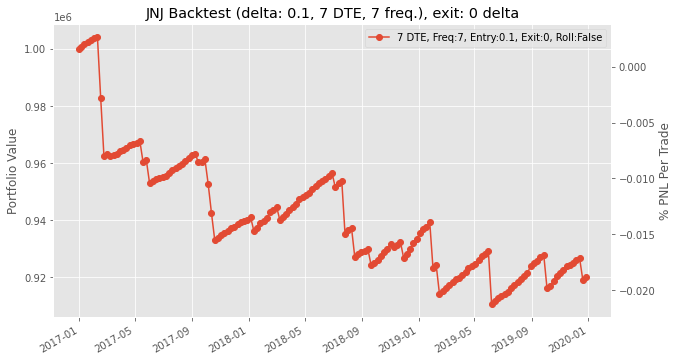

Date 2016-12-30, Expiry: 2017-01-13, Strike: 119.0, Underlying: 115.09, Premium: 0.12, Delta: 0.091823
Expired call (expiry 2017-01-13 00:00:00, strike = 119.0) on 2016-12-30
At expiry, underlying is 114.5999984741211 , strike is 119.0
PNL 2017-01-13 00:00:00 = 924.0 (premium = 0.12, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 119.0, Underlying: 114.64, Premium: 0.21, Delta: 0.119949
Expired call (expiry 2017-01-27 00:00:00, strike = 119.0) on 2017-01-13
At expiry, underlying is 113.37999725341797 , strike is 119.0
PNL 2017-01-27 00:00:00 = 1617.0 (premium = 0.21, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 116.0, Underlying: 113.14, Premium: 0.15, Delta: 0.126306
Expired call (expiry 2017-02-10 00:00:00, strike = 116.0) on 2017-01-27
At expiry, underlying is 115.23999786376953 , strike is 116.0
PNL 2017-02-10 00:00:00 = 1155.0 (premium = 0.15, exit = 0)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 117.0, Underlying: 115.33, Premium: 0.11, Delta: 0.125372
Expir

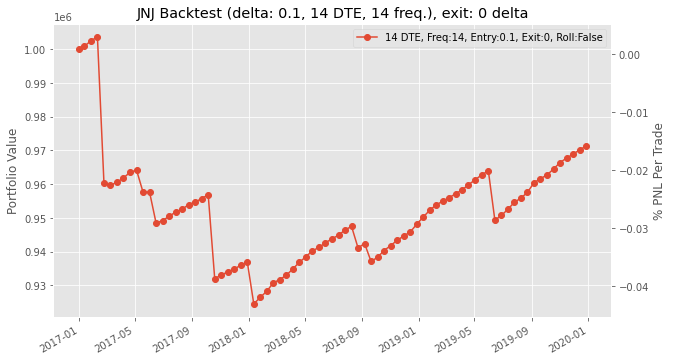

Date 2016-12-30, Expiry: 2017-01-20, Strike: 120.0, Underlying: 115.09, Premium: 0.16, Delta: 0.096521
Expired call (expiry 2017-01-20 00:00:00, strike = 120.0) on 2016-12-30
At expiry, underlying is 114.1500015258789 , strike is 120.0
PNL 2017-01-20 00:00:00 = 1232.0 (premium = 0.16, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 119.0, Underlying: 114.14, Premium: 0.17, Delta: 0.099251
Expired call (expiry 2017-02-10 00:00:00, strike = 119.0) on 2017-01-20
At expiry, underlying is 115.23999786376953 , strike is 119.0
PNL 2017-02-10 00:00:00 = 1309.0 (premium = 0.17, exit = 0)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 118.0, Underlying: 115.33, Premium: 0.09, Delta: 0.084123
Expired call (expiry 2017-03-03 00:00:00, strike = 118.0) on 2017-02-10
Strike was breached- At expiry, underlying is 123.79000091552734 , strike is 118.0
We lost money  PNL 2017-03-03 = -43890.00704956055 (premium = 0.09, exit = 5.790000915527344)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 128.0, 

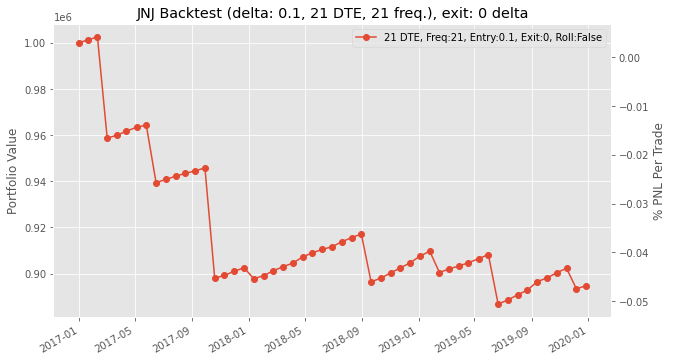

Date 2016-12-30, Expiry: 2017-01-27, Strike: 122.0, Underlying: 115.09, Premium: 0.2, Delta: 0.089556
Expired call (expiry 2017-01-27 00:00:00, strike = 122.0) on 2016-12-30
At expiry, underlying is 113.37999725341797 , strike is 122.0
PNL 2017-01-27 00:00:00 = 1540.0 (premium = 0.2, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 117.0, Underlying: 113.14, Premium: 0.19, Delta: 0.118349
Expired call (expiry 2017-02-24 00:00:00, strike = 117.0) on 2017-01-27
Strike was breached- At expiry, underlying is 122.7300033569336 , strike is 117.0
We lost money  PNL 2017-02-24 = -42658.02584838867 (premium = 0.19, exit = 5.730003356933594)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 128.0, Underlying: 122.58, Premium: 0.15, Delta: 0.086417
Expired call (expiry 2017-03-24 00:00:00, strike = 128.0) on 2017-02-24
At expiry, underlying is 125.4800033569336 , strike is 128.0
PNL 2017-03-24 00:00:00 = 1155.0 (premium = 0.15, exit = 0)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 132.0, Und

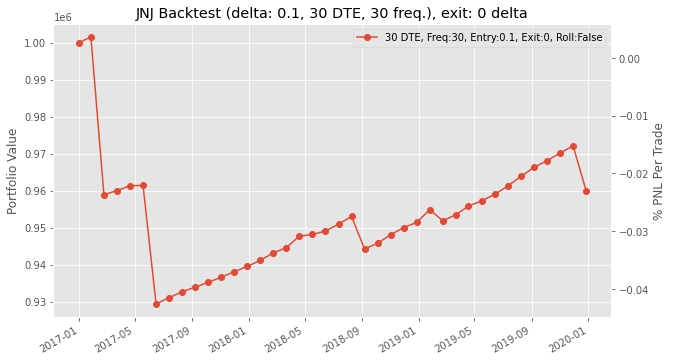

Date 2016-12-30, Expiry: 2017-02-17, Strike: 125.0, Underlying: 115.09, Premium: 0.2, Delta: 0.070937
Expired call (expiry 2017-02-17 00:00:00, strike = 125.0) on 2016-12-30
At expiry, underlying is 118.86000061035156 , strike is 125.0
PNL 2017-02-17 00:00:00 = 1540.0 (premium = 0.2, exit = 0)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 123.0, Underlying: 118.42, Premium: 0.19, Delta: 0.102978
Expired call (expiry 2017-03-31 00:00:00, strike = 123.0) on 2017-02-17
Strike was breached- At expiry, underlying is 124.55000305175781 , strike is 123.0
We lost money  PNL 2017-03-31 = -10472.023498535156 (premium = 0.19, exit = 1.5500030517578125)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 130.0, Underlying: 124.65, Premium: 0.37, Delta: 0.14794000000000002
Expired call (expiry 2017-05-19 00:00:00, strike = 130.0) on 2017-03-31
At expiry, underlying is 127 , strike is 130.0
PNL 2017-05-19 00:00:00 = 2849.0 (premium = 0.37, exit = 0)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 133.0, Und

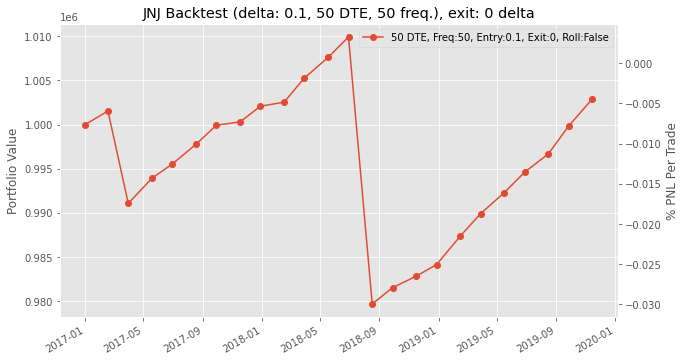

0.10 took 409.33930468559265 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 117.0, Underlying: 115.09, Premium: 0.1, Delta: 0.127166
Bought back call (expiry 2017-01-06 00:00:00, strike = 117.0) on 2017-01-04 for 0.04
PNL 2017-01-04 00:00:00 = 462.00000000000006 (premium = 0.1, exit = 0.04)

Date 2017-01-04, Expiry: 2017-01-13, Strike: 118.0, Underlying: 115.75, Premium: 0.23, Delta: 0.178845
Expired call (expiry 2017-01-13 00:00:00, strike = 118.0) on 2017-01-04
At expiry, underlying is 114.5999984741211 , strike is 118.0
PNL 2017-01-13 00:00:00 = 1771.0 (premium = 0.23, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 116.0, Underlying: 114.64, Premium: 0.24, Delta: 0.231537
Bought back call (expiry 2017-01-20 00:00:00, strike = 116.0) on 2017-01-18 for 0.04
PNL 2017-01-18 00:00:00 = 1539.9999999999998 (premium = 0.24, exit = 0.04)

Date 2017-01-18, Expiry: 2017-01-27, Strike: 117.0, Underlying: 114.71, Premium: 0.42, Delta: 0.236115
Bought back call (expiry 2017-01-27 0

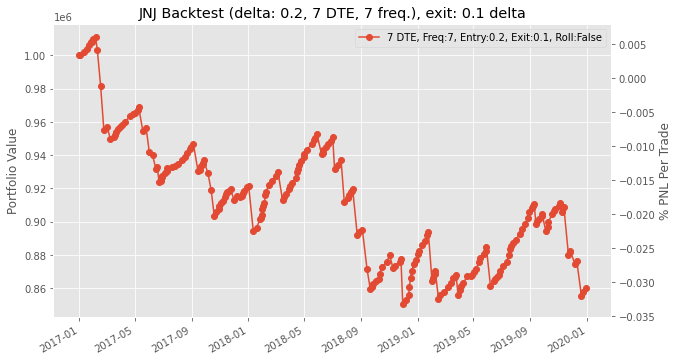

Date 2016-12-30, Expiry: 2017-01-13, Strike: 118.0, Underlying: 115.09, Premium: 0.27, Delta: 0.171293
Expired call (expiry 2017-01-13 00:00:00, strike = 118.0) on 2016-12-30
At expiry, underlying is 114.5999984741211 , strike is 118.0
PNL 2017-01-13 00:00:00 = 2079.0 (premium = 0.27, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 118.0, Underlying: 114.64, Premium: 0.35, Delta: 0.181778
Bought back call (expiry 2017-01-27 00:00:00, strike = 118.0) on 2017-01-19 for 0.14
PNL 2017-01-19 00:00:00 = 1616.9999999999998 (premium = 0.35, exit = 0.14)

Date 2017-01-19, Expiry: 2017-02-03, Strike: 117.0, Underlying: 114.18, Premium: 0.4, Delta: 0.212319
Bought back call (expiry 2017-02-03 00:00:00, strike = 117.0) on 2017-01-24 for 0.01
PNL 2017-01-24 00:00:00 = 3003.0 (premium = 0.4, exit = 0.01)

Date 2017-01-24, Expiry: 2017-02-10, Strike: 114.0, Underlying: 111.699, Premium: 0.22, Delta: 0.177116
Expired call (expiry 2017-02-10 00:00:00, strike = 114.0) on 2017-01-24
Strike was br

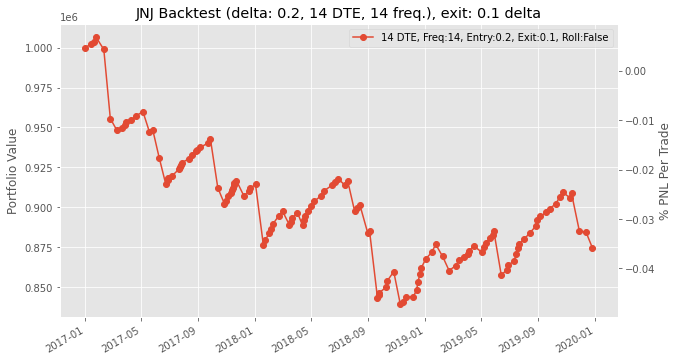

Date 2016-12-30, Expiry: 2017-01-20, Strike: 118.0, Underlying: 115.09, Premium: 0.43, Delta: 0.21633400000000005
Bought back call (expiry 2017-01-20 00:00:00, strike = 118.0) on 2017-01-12 for 0.06
PNL 2017-01-12 00:00:00 = 2849.0 (premium = 0.43, exit = 0.06)

Date 2017-01-12, Expiry: 2017-02-03, Strike: 118.0, Underlying: 114.598, Premium: 0.51, Delta: 0.217566
Bought back call (expiry 2017-02-03 00:00:00, strike = 118.0) on 2017-01-23 for 0.1
PNL 2017-01-23 00:00:00 = 3157.0000000000005 (premium = 0.51, exit = 0.1)

Date 2017-01-23, Expiry: 2017-02-10, Strike: 117.0, Underlying: 113.87, Premium: 0.31, Delta: 0.17943900000000002
Bought back call (expiry 2017-02-10 00:00:00, strike = 117.0) on 2017-01-24 for 0.04
PNL 2017-01-24 00:00:00 = 2079.0 (premium = 0.31, exit = 0.04)

Date 2017-01-24, Expiry: 2017-02-17, Strike: 115.0, Underlying: 111.699, Premium: 0.26, Delta: 0.159117
Expired call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-24
Strike was breached- At expiry, und

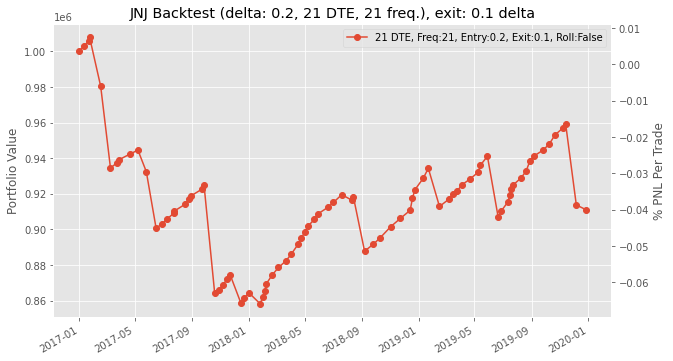

Date 2016-12-30, Expiry: 2017-01-27, Strike: 119.0, Underlying: 115.09, Premium: 0.61, Delta: 0.223913
Bought back call (expiry 2017-01-27 00:00:00, strike = 119.0) on 2017-01-18 for 0.13
PNL 2017-01-18 00:00:00 = 3696.0 (premium = 0.61, exit = 0.13)

Date 2017-01-18, Expiry: 2017-02-17, Strike: 120.0, Underlying: 114.71, Premium: 0.25, Delta: 0.121076
Bought back call (expiry 2017-02-17 00:00:00, strike = 120.0) on 2017-01-19 for 0.02
PNL 2017-01-19 00:00:00 = 1771.0 (premium = 0.25, exit = 0.02)

Date 2017-01-19, Expiry: 2017-02-17, Strike: 120.0, Underlying: 114.18, Premium: 0.02, Delta: 0.021837
Bought back call (expiry 2017-02-17 00:00:00, strike = 120.0) on 2017-01-20 for 0.04
We lost money  PNL 2017-01-20 = -154.0 (premium = 0.02, exit = 0.04)

Date 2017-01-20, Expiry: 2017-02-17, Strike: 120.0, Underlying: 114.14, Premium: 0.04, Delta: 0.033824
Bought back call (expiry 2017-02-17 00:00:00, strike = 120.0) on 2017-01-23 for 0.09
We lost money  PNL 2017-01-23 = -384.9999999999999

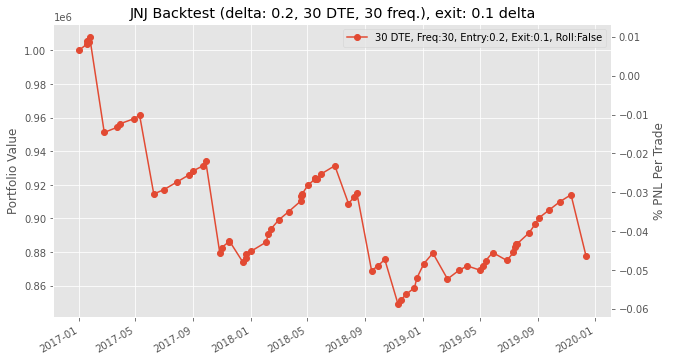

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
Bought back call (expiry 2017-02-17 00:00:00, strike = 120.0) on 2017-01-11 for 0.17
PNL 2017-01-11 00:00:00 = 5004.999999999999 (premium = 0.82, exit = 0.17)

Date 2017-01-11, Expiry: 2017-02-24, Strike: 120.0, Underlying: 114.87, Premium: 0.62, Delta: 0.192364
Bought back call (expiry 2017-02-24 00:00:00, strike = 120.0) on 2017-01-20 for 0.18
PNL 2017-01-20 00:00:00 = 3388.0 (premium = 0.62, exit = 0.18)

Date 2017-01-20, Expiry: 2017-03-17, Strike: 120.0, Underlying: 114.14, Premium: 0.2, Delta: 0.093169
Bought back call (expiry 2017-03-17 00:00:00, strike = 120.0) on 2017-01-23 for 0.12
PNL 2017-01-23 00:00:00 = 616.0000000000001 (premium = 0.2, exit = 0.12)

Date 2017-01-23, Expiry: 2017-03-17, Strike: 120.0, Underlying: 113.87, Premium: 0.12, Delta: 0.067815
Bought back call (expiry 2017-03-17 00:00:00, strike = 120.0) on 2017-01-24 for 0.01
PNL 2017-01-24 00:00:00 = 847.0 (pre

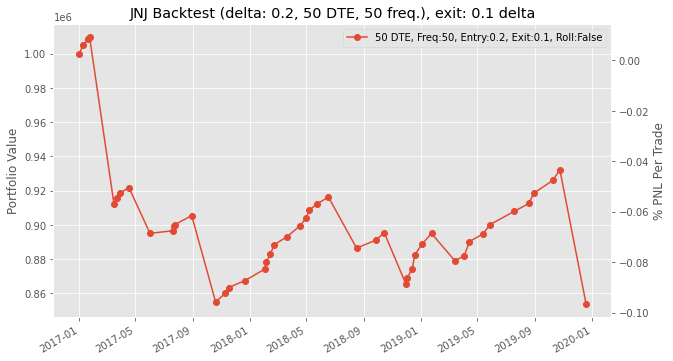

0.20.1 took 232.2253110408783 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 117.0, Underlying: 115.09, Premium: 0.1, Delta: 0.127166
Expired call (expiry 2017-01-06 00:00:00, strike = 117.0) on 2016-12-30
At expiry, underlying is 116.30000305175781 , strike is 117.0
PNL 2017-01-06 00:00:00 = 770.0 (premium = 0.1, exit = 0)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 118.0, Underlying: 116.39, Premium: 0.27, Delta: 0.225601
Expired call (expiry 2017-01-13 00:00:00, strike = 118.0) on 2017-01-06
At expiry, underlying is 114.5999984741211 , strike is 118.0
PNL 2017-01-13 00:00:00 = 2079.0 (premium = 0.27, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 116.0, Underlying: 114.64, Premium: 0.24, Delta: 0.231537
Expired call (expiry 2017-01-20 00:00:00, strike = 116.0) on 2017-01-13
At expiry, underlying is 114.1500015258789 , strike is 116.0
PNL 2017-01-20 00:00:00 = 1848.0 (premium = 0.24, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.14, P

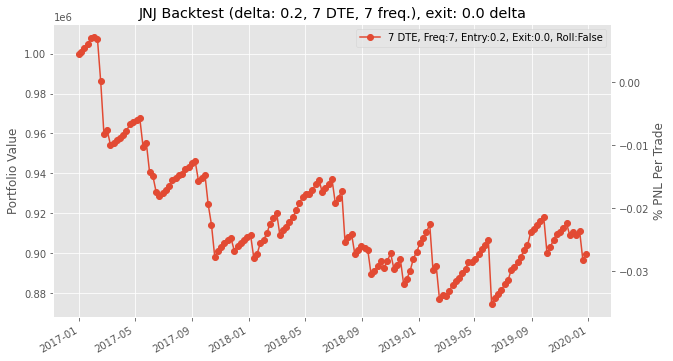

Date 2016-12-30, Expiry: 2017-01-13, Strike: 118.0, Underlying: 115.09, Premium: 0.27, Delta: 0.171293
Expired call (expiry 2017-01-13 00:00:00, strike = 118.0) on 2016-12-30
At expiry, underlying is 114.5999984741211 , strike is 118.0
PNL 2017-01-13 00:00:00 = 2079.0 (premium = 0.27, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 118.0, Underlying: 114.64, Premium: 0.35, Delta: 0.181778
Expired call (expiry 2017-01-27 00:00:00, strike = 118.0) on 2017-01-13
At expiry, underlying is 113.37999725341797 , strike is 118.0
PNL 2017-01-27 00:00:00 = 2695.0 (premium = 0.35, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 115.0, Underlying: 113.14, Premium: 0.32, Delta: 0.230397
Expired call (expiry 2017-02-10 00:00:00, strike = 115.0) on 2017-01-27
Strike was breached- At expiry, underlying is 115.23999786376953 , strike is 115.0
PNL 2017-02-10 00:00:00 = 616.0164489746094 (premium = 0.32, exit = 0.23999786376953125)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 117.0, Under

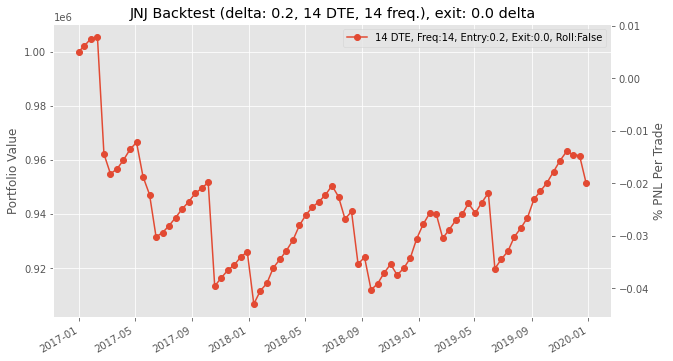

Date 2016-12-30, Expiry: 2017-01-20, Strike: 118.0, Underlying: 115.09, Premium: 0.43, Delta: 0.21633400000000005
Expired call (expiry 2017-01-20 00:00:00, strike = 118.0) on 2016-12-30
At expiry, underlying is 114.1500015258789 , strike is 118.0
PNL 2017-01-20 00:00:00 = 3311.0 (premium = 0.43, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 117.0, Underlying: 114.14, Premium: 0.47, Delta: 0.226569
Expired call (expiry 2017-02-10 00:00:00, strike = 117.0) on 2017-01-20
At expiry, underlying is 115.23999786376953 , strike is 117.0
PNL 2017-02-10 00:00:00 = 3619.0 (premium = 0.47, exit = 0)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 117.0, Underlying: 115.33, Premium: 0.24, Delta: 0.186113
Expired call (expiry 2017-03-03 00:00:00, strike = 117.0) on 2017-02-10
Strike was breached- At expiry, underlying is 123.79000091552734 , strike is 117.0
We lost money  PNL 2017-03-03 = -50435.00704956055 (premium = 0.24, exit = 6.790000915527344)

Date 2017-03-03, Expiry: 2017-03-24, Stri

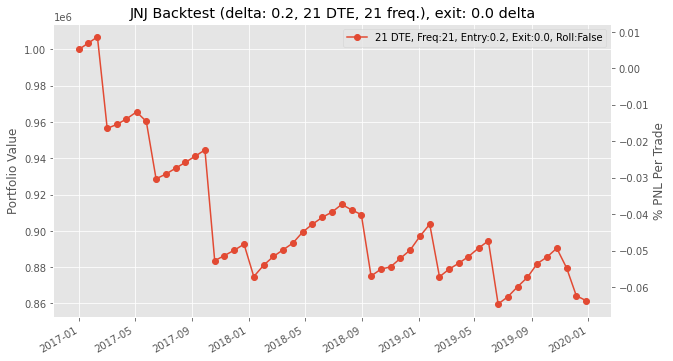

Date 2016-12-30, Expiry: 2017-01-27, Strike: 119.0, Underlying: 115.09, Premium: 0.61, Delta: 0.223913
Expired call (expiry 2017-01-27 00:00:00, strike = 119.0) on 2016-12-30
At expiry, underlying is 113.37999725341797 , strike is 119.0
PNL 2017-01-27 00:00:00 = 4697.0 (premium = 0.61, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 116.0, Underlying: 113.14, Premium: 0.35, Delta: 0.189234
Expired call (expiry 2017-02-24 00:00:00, strike = 116.0) on 2017-01-27
Strike was breached- At expiry, underlying is 122.7300033569336 , strike is 116.0
We lost money  PNL 2017-02-24 = -49126.02584838867 (premium = 0.35, exit = 6.730003356933594)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 126.0, Underlying: 122.58, Premium: 0.41, Delta: 0.193457
Expired call (expiry 2017-03-24 00:00:00, strike = 126.0) on 2017-02-24
At expiry, underlying is 125.4800033569336 , strike is 126.0
PNL 2017-03-24 00:00:00 = 3157.0 (premium = 0.41, exit = 0)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 130.0, U

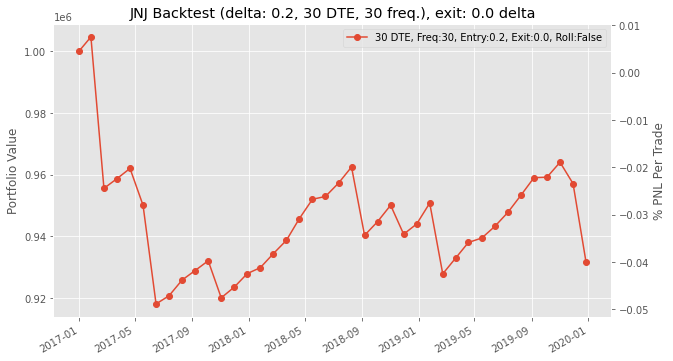

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
Expired call (expiry 2017-02-17 00:00:00, strike = 120.0) on 2016-12-30
At expiry, underlying is 118.86000061035156 , strike is 120.0
PNL 2017-02-17 00:00:00 = 6314.0 (premium = 0.82, exit = 0)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 121.0, Underlying: 118.42, Premium: 0.47, Delta: 0.213277
Expired call (expiry 2017-03-31 00:00:00, strike = 121.0) on 2017-02-17
Strike was breached- At expiry, underlying is 124.55000305175781 , strike is 121.0
We lost money  PNL 2017-03-31 = -23716.02349853516 (premium = 0.47, exit = 3.5500030517578125)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 130.0, Underlying: 124.65, Premium: 0.37, Delta: 0.14794000000000002
Expired call (expiry 2017-05-19 00:00:00, strike = 130.0) on 2017-03-31
At expiry, underlying is 127 , strike is 130.0
PNL 2017-05-19 00:00:00 = 2849.0 (premium = 0.37, exit = 0)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 130.0, Un

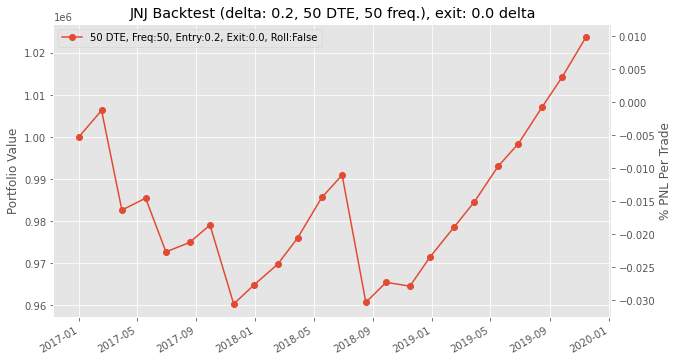

0.20.0 took 415.01912689208984 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Expired call (expiry 2017-01-06 00:00:00, strike = 116.0) on 2016-12-30
Strike was breached- At expiry, underlying is 116.30000305175781 , strike is 116.0
PNL 2017-01-06 00:00:00 = 384.9765014648436 (premium = 0.35, exit = 0.3000030517578125)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 118.0, Underlying: 116.39, Premium: 0.27, Delta: 0.225601
Bought back call (expiry 2017-01-13 00:00:00, strike = 118.0) on 2017-01-10 for 0.08
PNL 2017-01-10 00:00:00 = 1463.0 (premium = 0.27, exit = 0.08)

Date 2017-01-10, Expiry: 2017-01-20, Strike: 118.0, Underlying: 116.46, Premium: 0.38, Delta: 0.265786
Bought back call (expiry 2017-01-20 00:00:00, strike = 118.0) on 2017-01-11 for 0.14
PNL 2017-01-11 00:00:00 = 1848.0 (premium = 0.38, exit = 0.14)

Date 2017-01-11, Expiry: 2017-01-20, Strike: 117.0, Underlying: 114.87, Premium: 0.26, Delta: 0.193409
Bought 

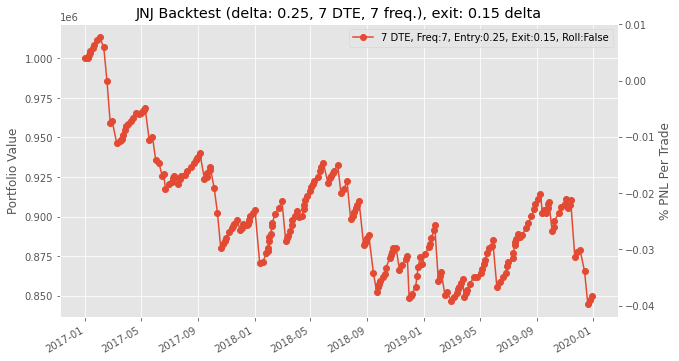

Date 2016-12-30, Expiry: 2017-01-13, Strike: 117.0, Underlying: 115.09, Premium: 0.49, Delta: 0.272704
Bought back call (expiry 2017-01-13 00:00:00, strike = 117.0) on 2017-01-11 for 0.02
PNL 2017-01-11 00:00:00 = 3619.0 (premium = 0.49, exit = 0.02)

Date 2017-01-11, Expiry: 2017-01-27, Strike: 118.0, Underlying: 114.87, Premium: 0.52, Delta: 0.226929
Bought back call (expiry 2017-01-27 00:00:00, strike = 118.0) on 2017-01-18 for 0.24
PNL 2017-01-18 00:00:00 = 2156.0 (premium = 0.52, exit = 0.24)

Date 2017-01-18, Expiry: 2017-02-03, Strike: 117.0, Underlying: 114.71, Premium: 0.59, Delta: 0.271592
Bought back call (expiry 2017-02-03 00:00:00, strike = 117.0) on 2017-01-23 for 0.2
PNL 2017-01-23 00:00:00 = 3002.9999999999995 (premium = 0.59, exit = 0.2)

Date 2017-01-23, Expiry: 2017-02-03, Strike: 116.0, Underlying: 113.87, Premium: 0.39, Delta: 0.236665
Bought back call (expiry 2017-02-03 00:00:00, strike = 116.0) on 2017-01-24 for 0.02
PNL 2017-01-24 00:00:00 = 2849.0 (premium = 0.

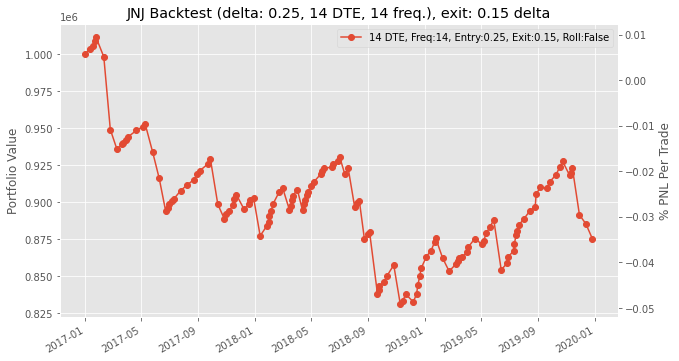

Date 2016-12-30, Expiry: 2017-01-20, Strike: 118.0, Underlying: 115.09, Premium: 0.43, Delta: 0.21633400000000005
Bought back call (expiry 2017-01-20 00:00:00, strike = 118.0) on 2017-01-11 for 0.14
PNL 2017-01-11 00:00:00 = 2233.0 (premium = 0.43, exit = 0.14)

Date 2017-01-11, Expiry: 2017-02-03, Strike: 118.0, Underlying: 114.87, Premium: 0.68, Delta: 0.255471
Bought back call (expiry 2017-02-03 00:00:00, strike = 118.0) on 2017-01-19 for 0.24
PNL 2017-01-19 00:00:00 = 3388.0000000000005 (premium = 0.68, exit = 0.24)

Date 2017-01-19, Expiry: 2017-02-10, Strike: 117.0, Underlying: 114.18, Premium: 0.55, Delta: 0.243584
Bought back call (expiry 2017-02-10 00:00:00, strike = 117.0) on 2017-01-24 for 0.04
PNL 2017-01-24 00:00:00 = 3927.0 (premium = 0.55, exit = 0.04)

Date 2017-01-24, Expiry: 2017-02-17, Strike: 114.0, Underlying: 111.699, Premium: 0.45, Delta: 0.246127
Expired call (expiry 2017-02-17 00:00:00, strike = 114.0) on 2017-01-24
Strike was breached- At expiry, underlying is

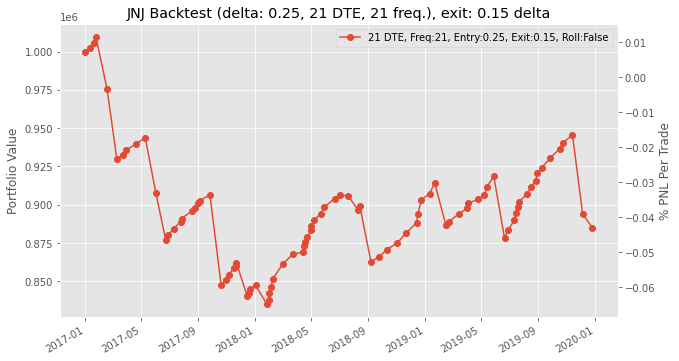

Date 2016-12-30, Expiry: 2017-01-27, Strike: 119.0, Underlying: 115.09, Premium: 0.61, Delta: 0.223913
Bought back call (expiry 2017-01-27 00:00:00, strike = 119.0) on 2017-01-12 for 0.24
PNL 2017-01-12 00:00:00 = 2849.0 (premium = 0.61, exit = 0.24)

Date 2017-01-12, Expiry: 2017-02-10, Strike: 118.0, Underlying: 114.598, Premium: 0.73, Delta: 0.255152
Bought back call (expiry 2017-02-10 00:00:00, strike = 118.0) on 2017-01-23 for 0.17
PNL 2017-01-23 00:00:00 = 4312.0 (premium = 0.73, exit = 0.17)

Date 2017-01-23, Expiry: 2017-02-24, Strike: 117.0, Underlying: 113.87, Premium: 0.53, Delta: 0.220574
Bought back call (expiry 2017-02-24 00:00:00, strike = 117.0) on 2017-01-24 for 0.13
PNL 2017-01-24 00:00:00 = 3080.0 (premium = 0.53, exit = 0.13)

Date 2017-01-24, Expiry: 2017-02-24, Strike: 114.0, Underlying: 111.699, Premium: 0.56, Delta: 0.252539
Expired call (expiry 2017-02-24 00:00:00, strike = 114.0) on 2017-01-24
Strike was breached- At expiry, underlying is 122.7300033569336 , s

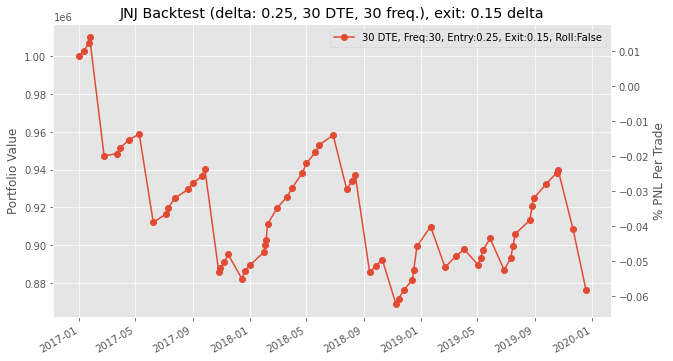

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
Bought back call (expiry 2017-02-17 00:00:00, strike = 120.0) on 2017-01-11 for 0.17
PNL 2017-01-11 00:00:00 = 5004.999999999999 (premium = 0.82, exit = 0.17)

Date 2017-01-11, Expiry: 2017-02-24, Strike: 119.0, Underlying: 114.87, Premium: 0.84, Delta: 0.24218
Bought back call (expiry 2017-02-24 00:00:00, strike = 119.0) on 2017-01-20 for 0.29
PNL 2017-01-20 00:00:00 = 4235.0 (premium = 0.84, exit = 0.29)

Date 2017-01-20, Expiry: 2017-03-17, Strike: 120.0, Underlying: 114.14, Premium: 0.2, Delta: 0.093169
Bought back call (expiry 2017-03-17 00:00:00, strike = 120.0) on 2017-01-23 for 0.12
PNL 2017-01-23 00:00:00 = 616.0000000000001 (premium = 0.2, exit = 0.12)

Date 2017-01-23, Expiry: 2017-03-17, Strike: 115.0, Underlying: 113.87, Premium: 1.34, Delta: 0.389184
Expired call (expiry 2017-03-17 00:00:00, strike = 115.0) on 2017-01-23
Strike was breached- At expiry, underlying is 128.

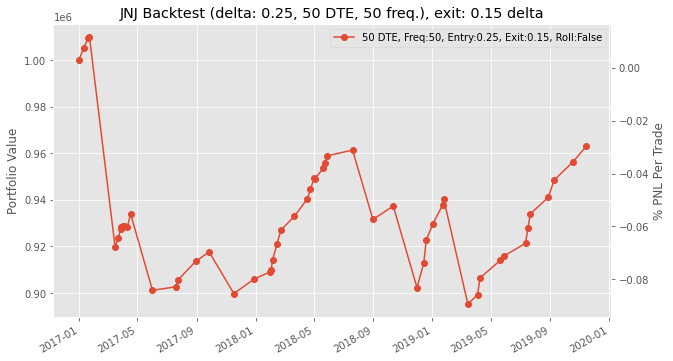

0.250.15 took 233.63594269752502 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Expired call (expiry 2017-01-06 00:00:00, strike = 116.0) on 2016-12-30
Strike was breached- At expiry, underlying is 116.30000305175781 , strike is 116.0
PNL 2017-01-06 00:00:00 = 384.9765014648436 (premium = 0.35, exit = 0.3000030517578125)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 118.0, Underlying: 116.39, Premium: 0.27, Delta: 0.225601
Expired call (expiry 2017-01-13 00:00:00, strike = 118.0) on 2017-01-06
At expiry, underlying is 114.5999984741211 , strike is 118.0
PNL 2017-01-13 00:00:00 = 2079.0 (premium = 0.27, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 116.0, Underlying: 114.64, Premium: 0.24, Delta: 0.231537
Bought back call (expiry 2017-01-20 00:00:00, strike = 116.0) on 2017-01-19 for 0.01
PNL 2017-01-19 00:00:00 = 1770.9999999999998 (premium = 0.24, exit = 0.01)

Date 2017-01-19, Expiry: 2017-01-27, Strike: 116.0,

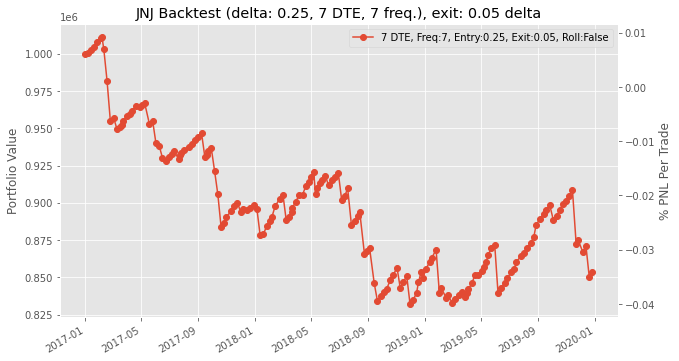

Date 2016-12-30, Expiry: 2017-01-13, Strike: 117.0, Underlying: 115.09, Premium: 0.49, Delta: 0.272704
Bought back call (expiry 2017-01-13 00:00:00, strike = 117.0) on 2017-01-11 for 0.02
PNL 2017-01-11 00:00:00 = 3619.0 (premium = 0.49, exit = 0.02)

Date 2017-01-11, Expiry: 2017-01-27, Strike: 118.0, Underlying: 114.87, Premium: 0.52, Delta: 0.226929
Bought back call (expiry 2017-01-27 00:00:00, strike = 118.0) on 2017-01-23 for 0.03
PNL 2017-01-23 00:00:00 = 3773.0 (premium = 0.52, exit = 0.03)

Date 2017-01-23, Expiry: 2017-02-03, Strike: 116.0, Underlying: 113.87, Premium: 0.39, Delta: 0.236665
Bought back call (expiry 2017-02-03 00:00:00, strike = 116.0) on 2017-01-24 for 0.02
PNL 2017-01-24 00:00:00 = 2849.0 (premium = 0.39, exit = 0.02)

Date 2017-01-24, Expiry: 2017-02-10, Strike: 113.0, Underlying: 111.699, Premium: 0.49, Delta: 0.312594
Expired call (expiry 2017-02-10 00:00:00, strike = 113.0) on 2017-01-24
Strike was breached- At expiry, underlying is 115.23999786376953 , s

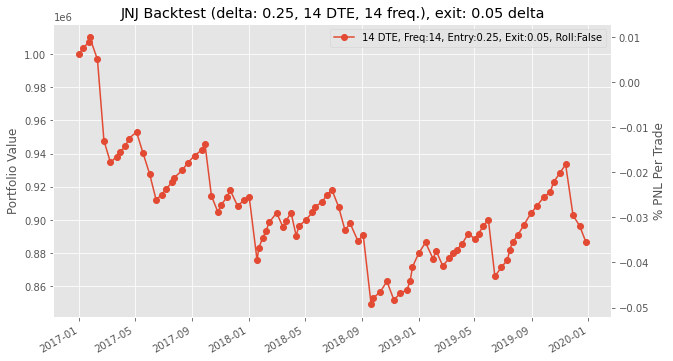

Date 2016-12-30, Expiry: 2017-01-20, Strike: 118.0, Underlying: 115.09, Premium: 0.43, Delta: 0.21633400000000005
Bought back call (expiry 2017-01-20 00:00:00, strike = 118.0) on 2017-01-13 for 0.03
PNL 2017-01-13 00:00:00 = 3080.0 (premium = 0.43, exit = 0.03)

Date 2017-01-13, Expiry: 2017-02-03, Strike: 118.0, Underlying: 114.64, Premium: 0.5, Delta: 0.21705700000000006
Expired call (expiry 2017-02-03 00:00:00, strike = 118.0) on 2017-01-13
At expiry, underlying is 113.63999938964844 , strike is 118.0
PNL 2017-02-03 00:00:00 = 3850.0 (premium = 0.5, exit = 0)

Date 2017-02-03, Expiry: 2017-02-24, Strike: 115.0, Underlying: 113.539, Premium: 0.48, Delta: 0.274918
Expired call (expiry 2017-02-24 00:00:00, strike = 115.0) on 2017-02-03
Strike was breached- At expiry, underlying is 122.7300033569336 , strike is 115.0
We lost money  PNL 2017-02-24 = -55825.02584838867 (premium = 0.48, exit = 7.730003356933594)

Date 2017-02-24, Expiry: 2017-03-17, Strike: 125.0, Underlying: 122.58, Premi

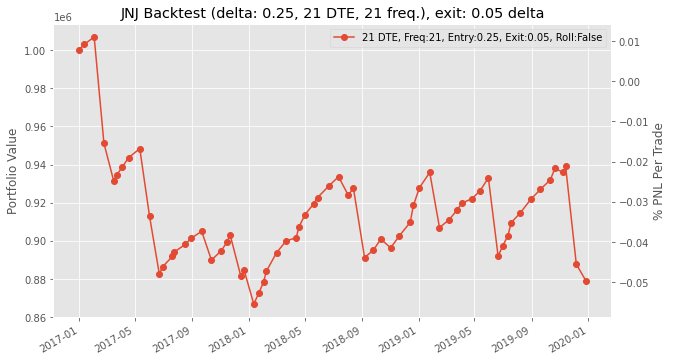

Date 2016-12-30, Expiry: 2017-01-27, Strike: 119.0, Underlying: 115.09, Premium: 0.61, Delta: 0.223913
Bought back call (expiry 2017-01-27 00:00:00, strike = 119.0) on 2017-01-20 for 0.04
PNL 2017-01-20 00:00:00 = 4389.0 (premium = 0.61, exit = 0.04)

Date 2017-01-20, Expiry: 2017-02-17, Strike: 115.0, Underlying: 114.14, Premium: 1.26, Delta: 0.432462
Expired call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-20
Strike was breached- At expiry, underlying is 118.86000061035156 , strike is 115.0
We lost money  PNL 2017-02-17 = -20020.00469970703 (premium = 1.26, exit = 3.8600006103515625)

Date 2017-02-17, Expiry: 2017-03-17, Strike: 120.0, Underlying: 118.42, Premium: 0.49, Delta: 0.258863
Expired call (expiry 2017-03-17 00:00:00, strike = 120.0) on 2017-02-17
Strike was breached- At expiry, underlying is 128.05999755859375 , strike is 120.0
We lost money  PNL 2017-03-17 = -58288.981201171875 (premium = 0.49, exit = 8.05999755859375)

Date 2017-03-17, Expiry: 2017-04-13, Stri

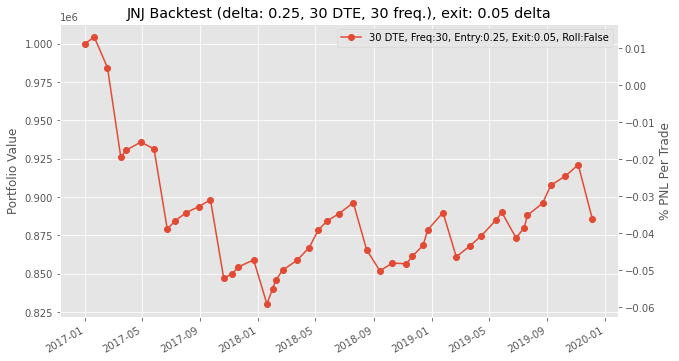

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
Bought back call (expiry 2017-02-17 00:00:00, strike = 120.0) on 2017-01-19 for 0.02
PNL 2017-01-19 00:00:00 = 6159.999999999999 (premium = 0.82, exit = 0.02)

Date 2017-01-19, Expiry: 2017-03-03, Strike: 118.0, Underlying: 114.18, Premium: 0.65, Delta: 0.220749
Bought back call (expiry 2017-03-03 00:00:00, strike = 118.0) on 2017-02-03 for 0.06
PNL 2017-02-03 00:00:00 = 4543.000000000001 (premium = 0.65, exit = 0.06)

Date 2017-02-03, Expiry: 2017-03-24, Strike: 116.0, Underlying: 113.539, Premium: 0.57, Delta: 0.236771
Expired call (expiry 2017-03-24 00:00:00, strike = 116.0) on 2017-02-03
Strike was breached- At expiry, underlying is 125.4800033569336 , strike is 116.0
We lost money  PNL 2017-03-24 = -68607.02584838867 (premium = 0.57, exit = 9.480003356933594)

Date 2017-03-24, Expiry: 2017-05-19, Strike: 130.0, Underlying: 125.56, Premium: 0.95, Delta: 0.256068
Bought back call (

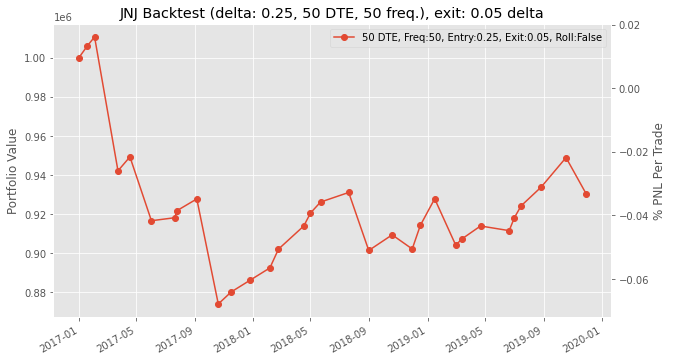

0.250.05 took 248.12614464759827 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Expired call (expiry 2017-01-06 00:00:00, strike = 116.0) on 2016-12-30
Strike was breached- At expiry, underlying is 116.30000305175781 , strike is 116.0
PNL 2017-01-06 00:00:00 = 384.9765014648436 (premium = 0.35, exit = 0.3000030517578125)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 118.0, Underlying: 116.39, Premium: 0.27, Delta: 0.225601
Bought back call (expiry 2017-01-13 00:00:00, strike = 118.0) on 2017-01-09 for 0.19
PNL 2017-01-09 00:00:00 = 616.0000000000001 (premium = 0.27, exit = 0.19)

Date 2017-01-09, Expiry: 2017-01-13, Strike: 117.0, Underlying: 116.495, Premium: 0.46, Delta: 0.390772
Bought back call (expiry 2017-01-13 00:00:00, strike = 117.0) on 2017-01-11 for 0.02
PNL 2017-01-11 00:00:00 = 3388.0 (premium = 0.46, exit = 0.02)

Date 2017-01-11, Expiry: 2017-01-20, Strike: 116.0, Underlying: 114.87, Premium: 0.45, Delta: 0.

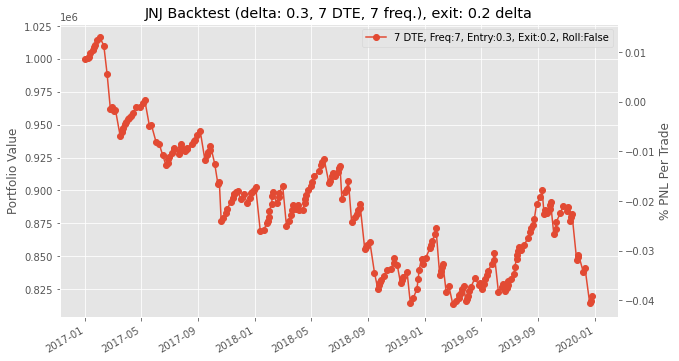

Date 2016-12-30, Expiry: 2017-01-13, Strike: 117.0, Underlying: 115.09, Premium: 0.49, Delta: 0.272704
Bought back call (expiry 2017-01-13 00:00:00, strike = 117.0) on 2017-01-11 for 0.02
PNL 2017-01-11 00:00:00 = 3619.0 (premium = 0.49, exit = 0.02)

Date 2017-01-11, Expiry: 2017-01-27, Strike: 117.0, Underlying: 114.87, Premium: 0.77, Delta: 0.30688000000000004
Bought back call (expiry 2017-01-27 00:00:00, strike = 117.0) on 2017-01-19 for 0.26
PNL 2017-01-19 00:00:00 = 3927.0 (premium = 0.77, exit = 0.26)

Date 2017-01-19, Expiry: 2017-02-03, Strike: 116.0, Underlying: 114.18, Premium: 0.66, Delta: 0.306709
Bought back call (expiry 2017-02-03 00:00:00, strike = 116.0) on 2017-01-24 for 0.02
PNL 2017-01-24 00:00:00 = 4928.0 (premium = 0.66, exit = 0.02)

Date 2017-01-24, Expiry: 2017-02-10, Strike: 113.0, Underlying: 111.699, Premium: 0.49, Delta: 0.312594
Expired call (expiry 2017-02-10 00:00:00, strike = 113.0) on 2017-01-24
Strike was breached- At expiry, underlying is 115.2399978

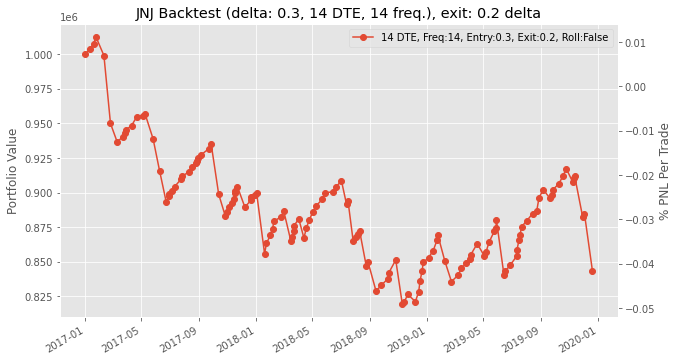

Date 2016-12-30, Expiry: 2017-01-20, Strike: 117.0, Underlying: 115.09, Premium: 0.67, Delta: 0.306055
Bought back call (expiry 2017-01-20 00:00:00, strike = 117.0) on 2017-01-11 for 0.26
PNL 2017-01-11 00:00:00 = 3157.0000000000005 (premium = 0.67, exit = 0.26)

Date 2017-01-11, Expiry: 2017-02-03, Strike: 117.0, Underlying: 114.87, Premium: 0.96, Delta: 0.330334
Bought back call (expiry 2017-02-03 00:00:00, strike = 117.0) on 2017-01-20 for 0.33
PNL 2017-01-20 00:00:00 = 4850.999999999999 (premium = 0.96, exit = 0.33)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 116.0, Underlying: 114.14, Premium: 0.74, Delta: 0.317813
Bought back call (expiry 2017-02-10 00:00:00, strike = 116.0) on 2017-01-24 for 0.07
PNL 2017-01-24 00:00:00 = 5158.999999999999 (premium = 0.74, exit = 0.07)

Date 2017-01-24, Expiry: 2017-02-17, Strike: 114.0, Underlying: 111.699, Premium: 0.45, Delta: 0.246127
Expired call (expiry 2017-02-17 00:00:00, strike = 114.0) on 2017-01-24
Strike was breached- At expiry, un

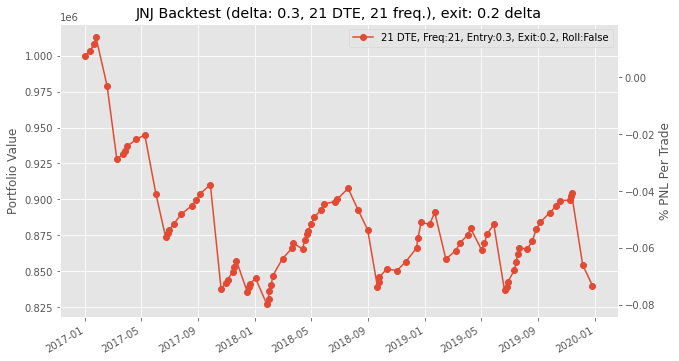

Date 2016-12-30, Expiry: 2017-01-27, Strike: 118.0, Underlying: 115.09, Premium: 0.85, Delta: 0.289694
Bought back call (expiry 2017-01-27 00:00:00, strike = 118.0) on 2017-01-12 for 0.39
PNL 2017-01-12 00:00:00 = 3541.9999999999995 (premium = 0.85, exit = 0.39)

Date 2017-01-12, Expiry: 2017-02-10, Strike: 117.0, Underlying: 114.598, Premium: 1.01, Delta: 0.323342
Bought back call (expiry 2017-02-10 00:00:00, strike = 117.0) on 2017-01-23 for 0.31
PNL 2017-01-23 00:00:00 = 5390.0 (premium = 1.01, exit = 0.31)

Date 2017-01-23, Expiry: 2017-02-24, Strike: 116.0, Underlying: 113.87, Premium: 0.78, Delta: 0.295606
Bought back call (expiry 2017-02-24 00:00:00, strike = 116.0) on 2017-01-24 for 0.22
PNL 2017-01-24 00:00:00 = 4312.0 (premium = 0.78, exit = 0.22)

Date 2017-01-24, Expiry: 2017-02-24, Strike: 113.0, Underlying: 111.699, Premium: 0.86, Delta: 0.34627800000000003
Expired call (expiry 2017-02-24 00:00:00, strike = 113.0) on 2017-01-24
Strike was breached- At expiry, underlying i

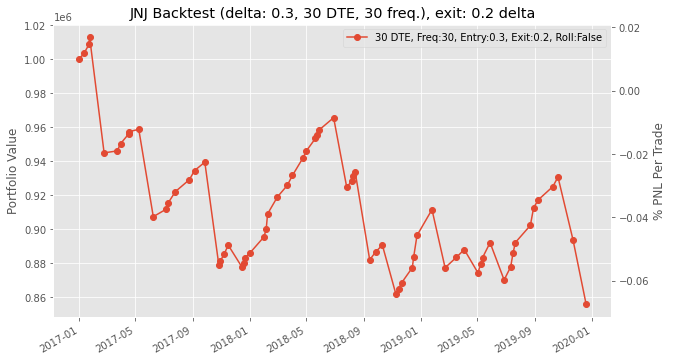

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
Bought back call (expiry 2017-02-17 00:00:00, strike = 120.0) on 2017-01-03 for 0.45
PNL 2017-01-03 00:00:00 = 2848.9999999999995 (premium = 0.82, exit = 0.45)

Date 2017-01-03, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.7, Premium: 0.45, Delta: 0.18639
Bought back call (expiry 2017-02-17 00:00:00, strike = 120.0) on 2017-01-11 for 0.17
PNL 2017-01-11 00:00:00 = 2156.0 (premium = 0.45, exit = 0.17)

Date 2017-01-11, Expiry: 2017-02-24, Strike: 118.0, Underlying: 114.87, Premium: 1.12, Delta: 0.29830100000000004
Bought back call (expiry 2017-02-24 00:00:00, strike = 118.0) on 2017-01-19 for 0.51
PNL 2017-01-19 00:00:00 = 4697.000000000001 (premium = 1.12, exit = 0.51)

Date 2017-01-19, Expiry: 2017-03-03, Strike: 117.0, Underlying: 114.18, Premium: 0.9, Delta: 0.282011
Bought back call (expiry 2017-03-03 00:00:00, strike = 117.0) on 2017-01-24 for 0.16
PNL 2017-01-24 00:00:00 =

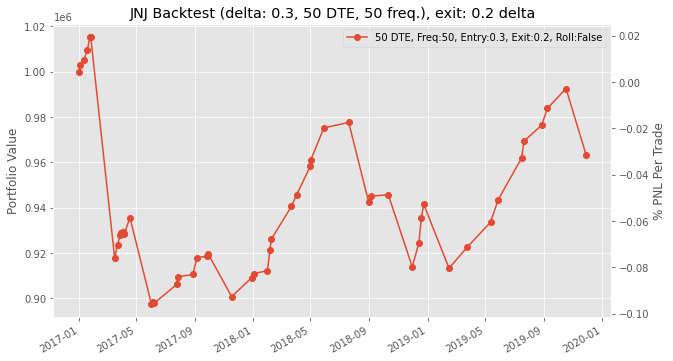

0.30.2 took 210.19532537460327 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Expired call (expiry 2017-01-06 00:00:00, strike = 116.0) on 2016-12-30
Strike was breached- At expiry, underlying is 116.30000305175781 , strike is 116.0
PNL 2017-01-06 00:00:00 = 384.9765014648436 (premium = 0.35, exit = 0.3000030517578125)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 118.0, Underlying: 116.39, Premium: 0.27, Delta: 0.225601
Expired call (expiry 2017-01-13 00:00:00, strike = 118.0) on 2017-01-06
At expiry, underlying is 114.5999984741211 , strike is 118.0
PNL 2017-01-13 00:00:00 = 2079.0 (premium = 0.27, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 116.0, Underlying: 114.64, Premium: 0.24, Delta: 0.231537
Bought back call (expiry 2017-01-20 00:00:00, strike = 116.0) on 2017-01-18 for 0.04
PNL 2017-01-18 00:00:00 = 1539.9999999999998 (premium = 0.24, exit = 0.04)

Date 2017-01-18, Expiry: 2017-01-27, Strike: 116.0, U

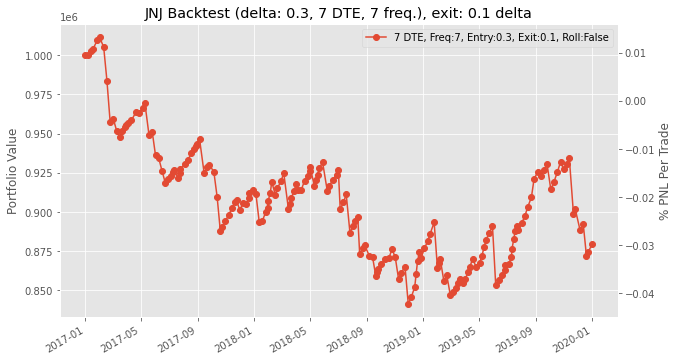

Date 2016-12-30, Expiry: 2017-01-13, Strike: 117.0, Underlying: 115.09, Premium: 0.49, Delta: 0.272704
Bought back call (expiry 2017-01-13 00:00:00, strike = 117.0) on 2017-01-11 for 0.02
PNL 2017-01-11 00:00:00 = 3619.0 (premium = 0.49, exit = 0.02)

Date 2017-01-11, Expiry: 2017-01-27, Strike: 117.0, Underlying: 114.87, Premium: 0.77, Delta: 0.30688000000000004
Bought back call (expiry 2017-01-27 00:00:00, strike = 117.0) on 2017-01-23 for 0.09
PNL 2017-01-23 00:00:00 = 5236.0 (premium = 0.77, exit = 0.09)

Date 2017-01-23, Expiry: 2017-02-03, Strike: 115.0, Underlying: 113.87, Premium: 0.69, Delta: 0.357477
Bought back call (expiry 2017-02-03 00:00:00, strike = 115.0) on 2017-01-24 for 0.05
PNL 2017-01-24 00:00:00 = 4927.999999999999 (premium = 0.69, exit = 0.05)

Date 2017-01-24, Expiry: 2017-02-10, Strike: 113.0, Underlying: 111.699, Premium: 0.49, Delta: 0.312594
Expired call (expiry 2017-02-10 00:00:00, strike = 113.0) on 2017-01-24
Strike was breached- At expiry, underlying is 

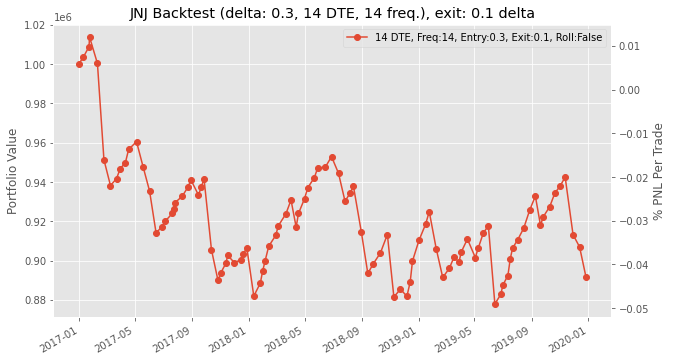

Date 2016-12-30, Expiry: 2017-01-20, Strike: 117.0, Underlying: 115.09, Premium: 0.67, Delta: 0.306055
Bought back call (expiry 2017-01-20 00:00:00, strike = 117.0) on 2017-01-17 for 0.02
PNL 2017-01-17 00:00:00 = 5005.0 (premium = 0.67, exit = 0.02)

Date 2017-01-17, Expiry: 2017-02-10, Strike: 117.0, Underlying: 114.77, Premium: 0.88, Delta: 0.316893
Bought back call (expiry 2017-02-10 00:00:00, strike = 117.0) on 2017-01-24 for 0.04
PNL 2017-01-24 00:00:00 = 6468.0 (premium = 0.88, exit = 0.04)

Date 2017-01-24, Expiry: 2017-02-17, Strike: 114.0, Underlying: 111.699, Premium: 0.45, Delta: 0.246127
Expired call (expiry 2017-02-17 00:00:00, strike = 114.0) on 2017-01-24
Strike was breached- At expiry, underlying is 118.86000061035156 , strike is 114.0
We lost money  PNL 2017-02-17 = -33957.00469970703 (premium = 0.45, exit = 4.8600006103515625)

Date 2017-02-17, Expiry: 2017-03-10, Strike: 119.0, Underlying: 118.42, Premium: 0.55, Delta: 0.327399
Expired call (expiry 2017-03-10 00:00:

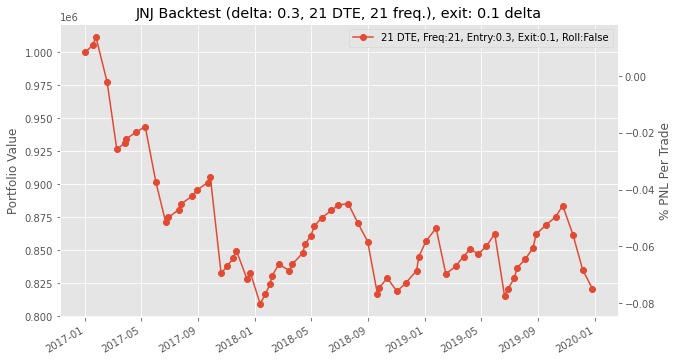

Date 2016-12-30, Expiry: 2017-01-27, Strike: 118.0, Underlying: 115.09, Premium: 0.85, Delta: 0.289694
Bought back call (expiry 2017-01-27 00:00:00, strike = 118.0) on 2017-01-19 for 0.14
PNL 2017-01-19 00:00:00 = 5467.0 (premium = 0.85, exit = 0.14)

Date 2017-01-19, Expiry: 2017-02-17, Strike: 115.0, Underlying: 114.18, Premium: 1.24, Delta: 0.431751
Expired call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-19
Strike was breached- At expiry, underlying is 118.86000061035156 , strike is 115.0
We lost money  PNL 2017-02-17 = -20174.00469970703 (premium = 1.24, exit = 3.8600006103515625)

Date 2017-02-17, Expiry: 2017-03-17, Strike: 120.0, Underlying: 118.42, Premium: 0.49, Delta: 0.258863
Expired call (expiry 2017-03-17 00:00:00, strike = 120.0) on 2017-02-17
Strike was breached- At expiry, underlying is 128.05999755859375 , strike is 120.0
We lost money  PNL 2017-03-17 = -58288.981201171875 (premium = 0.49, exit = 8.05999755859375)

Date 2017-03-17, Expiry: 2017-04-13, Stri

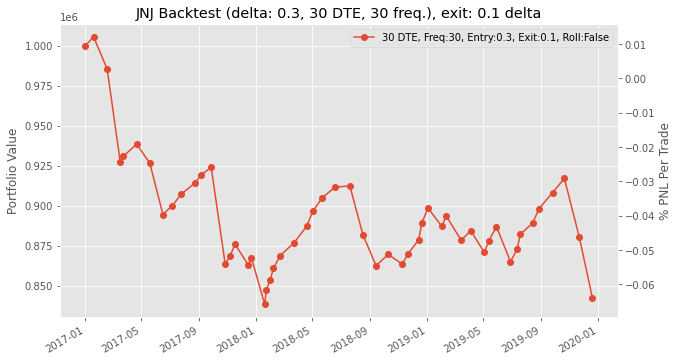

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
Bought back call (expiry 2017-02-17 00:00:00, strike = 120.0) on 2017-01-11 for 0.17
PNL 2017-01-11 00:00:00 = 5004.999999999999 (premium = 0.82, exit = 0.17)

Date 2017-01-11, Expiry: 2017-02-24, Strike: 118.0, Underlying: 114.87, Premium: 1.12, Delta: 0.29830100000000004
Bought back call (expiry 2017-02-24 00:00:00, strike = 118.0) on 2017-01-24 for 0.07
PNL 2017-01-24 00:00:00 = 8085.0 (premium = 1.12, exit = 0.07)

Date 2017-01-24, Expiry: 2017-03-17, Strike: 115.0, Underlying: 111.699, Premium: 0.4, Delta: 0.184568
Expired call (expiry 2017-03-17 00:00:00, strike = 115.0) on 2017-01-24
Strike was breached- At expiry, underlying is 128.05999755859375 , strike is 115.0
We lost money  PNL 2017-03-17 = -97481.98120117188 (premium = 0.4, exit = 13.05999755859375)

Date 2017-03-17, Expiry: 2017-04-28, Strike: 131.0, Underlying: 128.4, Premium: 1.03, Delta: 0.317677
Bought back call (ex

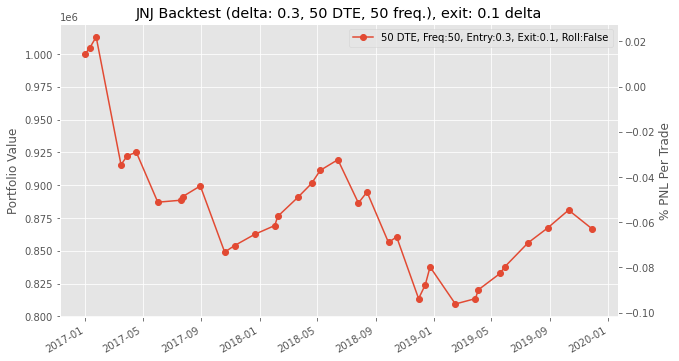

0.30.1 took 217.02738523483276 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Expired call (expiry 2017-01-06 00:00:00, strike = 116.0) on 2016-12-30
Strike was breached- At expiry, underlying is 116.30000305175781 , strike is 116.0
PNL 2017-01-06 00:00:00 = 384.9765014648436 (premium = 0.35, exit = 0.3000030517578125)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 117.0, Underlying: 116.39, Premium: 0.55, Delta: 0.387161
Bought back call (expiry 2017-01-13 00:00:00, strike = 117.0) on 2017-01-11 for 0.02
PNL 2017-01-11 00:00:00 = 4081.0 (premium = 0.55, exit = 0.02)

Date 2017-01-11, Expiry: 2017-01-20, Strike: 116.0, Underlying: 114.87, Premium: 0.45, Delta: 0.312816
Bought back call (expiry 2017-01-20 00:00:00, strike = 116.0) on 2017-01-13 for 0.24
PNL 2017-01-13 00:00:00 = 1617.0000000000002 (premium = 0.45, exit = 0.24)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.64, Premium: 0.57, Delta: 0.42

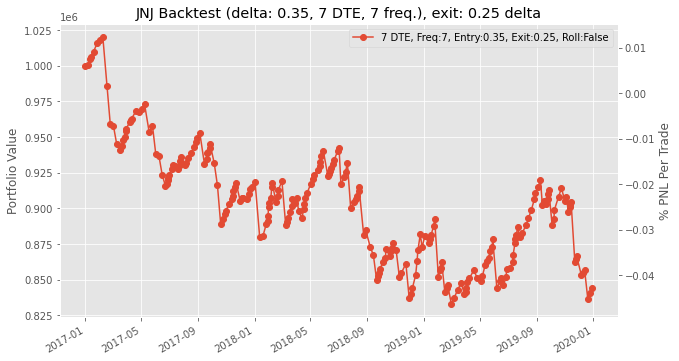

Date 2016-12-30, Expiry: 2017-01-13, Strike: 116.0, Underlying: 115.09, Premium: 0.81, Delta: 0.39292
Bought back call (expiry 2017-01-13 00:00:00, strike = 116.0) on 2017-01-11 for 0.14
PNL 2017-01-11 00:00:00 = 5159.0 (premium = 0.81, exit = 0.14)

Date 2017-01-11, Expiry: 2017-01-27, Strike: 117.0, Underlying: 114.87, Premium: 0.77, Delta: 0.30688000000000004
Bought back call (expiry 2017-01-27 00:00:00, strike = 117.0) on 2017-01-18 for 0.42
PNL 2017-01-18 00:00:00 = 2695.0000000000005 (premium = 0.77, exit = 0.42)

Date 2017-01-18, Expiry: 2017-02-03, Strike: 116.0, Underlying: 114.71, Premium: 0.91, Delta: 0.371905
Bought back call (expiry 2017-02-03 00:00:00, strike = 116.0) on 2017-01-23 for 0.39
PNL 2017-01-23 00:00:00 = 4004.0 (premium = 0.91, exit = 0.39)

Date 2017-01-23, Expiry: 2017-02-03, Strike: 115.0, Underlying: 113.87, Premium: 0.69, Delta: 0.357477
Bought back call (expiry 2017-02-03 00:00:00, strike = 115.0) on 2017-01-24 for 0.05
PNL 2017-01-24 00:00:00 = 4927.999

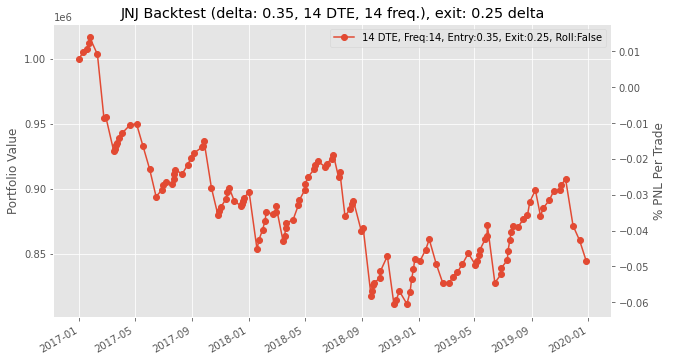

Date 2016-12-30, Expiry: 2017-01-20, Strike: 117.0, Underlying: 115.09, Premium: 0.67, Delta: 0.306055
Bought back call (expiry 2017-01-20 00:00:00, strike = 117.0) on 2017-01-11 for 0.26
PNL 2017-01-11 00:00:00 = 3157.0000000000005 (premium = 0.67, exit = 0.26)

Date 2017-01-11, Expiry: 2017-02-03, Strike: 117.0, Underlying: 114.87, Premium: 0.96, Delta: 0.330334
Bought back call (expiry 2017-02-03 00:00:00, strike = 117.0) on 2017-01-19 for 0.4
PNL 2017-01-19 00:00:00 = 4312.0 (premium = 0.96, exit = 0.4)

Date 2017-01-19, Expiry: 2017-02-10, Strike: 116.0, Underlying: 114.18, Premium: 0.84, Delta: 0.331919
Bought back call (expiry 2017-02-10 00:00:00, strike = 116.0) on 2017-01-24 for 0.07
PNL 2017-01-24 00:00:00 = 5929.0 (premium = 0.84, exit = 0.07)

Date 2017-01-24, Expiry: 2017-02-17, Strike: 113.0, Underlying: 111.699, Premium: 0.75, Delta: 0.356503
Expired call (expiry 2017-02-17 00:00:00, strike = 113.0) on 2017-01-24
Strike was breached- At expiry, underlying is 118.86000061

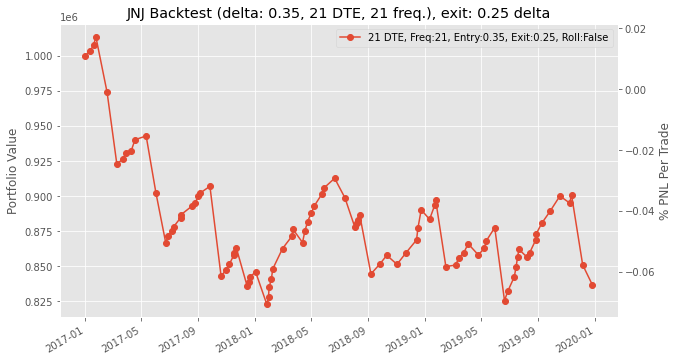

Date 2016-12-30, Expiry: 2017-01-27, Strike: 117.0, Underlying: 115.09, Premium: 1.18, Delta: 0.364969
Bought back call (expiry 2017-01-27 00:00:00, strike = 117.0) on 2017-01-18 for 0.42
PNL 2017-01-18 00:00:00 = 5852.0 (premium = 1.18, exit = 0.42)

Date 2017-01-18, Expiry: 2017-02-17, Strike: 115.0, Underlying: 114.71, Premium: 1.74, Delta: 0.4910350000000001
Bought back call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-24 for 0.26
PNL 2017-01-24 00:00:00 = 11396.0 (premium = 1.74, exit = 0.26)

Date 2017-01-24, Expiry: 2017-02-24, Strike: 113.0, Underlying: 111.699, Premium: 0.86, Delta: 0.34627800000000003
Expired call (expiry 2017-02-24 00:00:00, strike = 113.0) on 2017-01-24
Strike was breached- At expiry, underlying is 122.7300033569336 , strike is 113.0
We lost money  PNL 2017-02-24 = -68299.02584838867 (premium = 0.86, exit = 9.730003356933594)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 124.0, Underlying: 122.58, Premium: 0.95, Delta: 0.363981
Expired call (expi

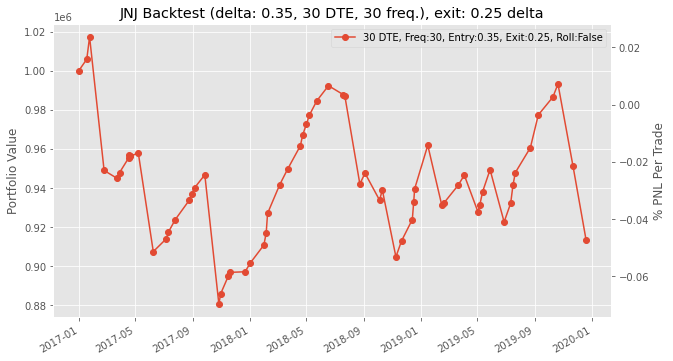

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
Bought back call (expiry 2017-02-17 00:00:00, strike = 120.0) on 2017-01-03 for 0.45
PNL 2017-01-03 00:00:00 = 2848.9999999999995 (premium = 0.82, exit = 0.45)

Date 2017-01-03, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.7, Premium: 0.45, Delta: 0.18639
Bought back call (expiry 2017-02-17 00:00:00, strike = 120.0) on 2017-01-06 for 0.59
We lost money  PNL 2017-01-06 = -1077.9999999999998 (premium = 0.45, exit = 0.59)

Date 2017-01-06, Expiry: 2017-02-24, Strike: 119.0, Underlying: 116.39, Premium: 1.39, Delta: 0.336895
Bought back call (expiry 2017-02-24 00:00:00, strike = 119.0) on 2017-01-11 for 0.84
PNL 2017-01-11 00:00:00 = 4234.999999999999 (premium = 1.39, exit = 0.84)

Date 2017-01-11, Expiry: 2017-02-24, Strike: 117.0, Underlying: 114.87, Premium: 1.46, Delta: 0.35901500000000003
Bought back call (expiry 2017-02-24 00:00:00, strike = 117.0) on 2017-01-23 for 0.53
PNL 2

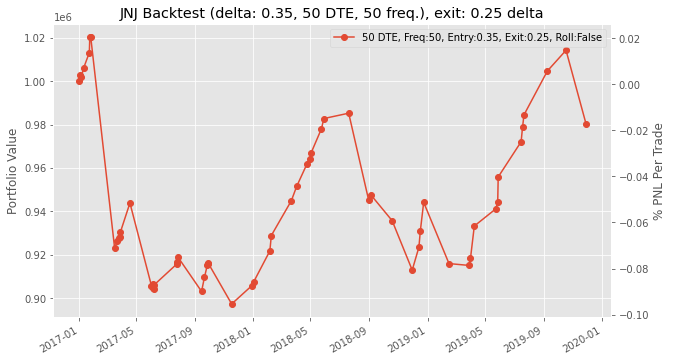

0.350.25 took 214.49528408050537 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Expired call (expiry 2017-01-06 00:00:00, strike = 116.0) on 2016-12-30
Strike was breached- At expiry, underlying is 116.30000305175781 , strike is 116.0
PNL 2017-01-06 00:00:00 = 384.9765014648436 (premium = 0.35, exit = 0.3000030517578125)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 117.0, Underlying: 116.39, Premium: 0.55, Delta: 0.387161
Bought back call (expiry 2017-01-13 00:00:00, strike = 117.0) on 2017-01-11 for 0.02
PNL 2017-01-11 00:00:00 = 4081.0 (premium = 0.55, exit = 0.02)

Date 2017-01-11, Expiry: 2017-01-20, Strike: 116.0, Underlying: 114.87, Premium: 0.45, Delta: 0.312816
Bought back call (expiry 2017-01-20 00:00:00, strike = 116.0) on 2017-01-18 for 0.04
PNL 2017-01-18 00:00:00 = 3157.0000000000005 (premium = 0.45, exit = 0.04)

Date 2017-01-18, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.71, Premium: 0.71, Delta: 0.

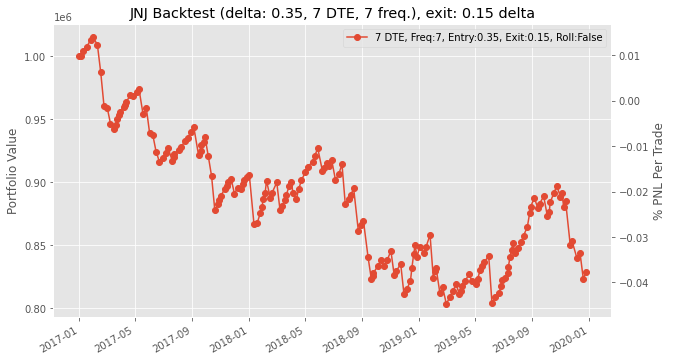

Date 2016-12-30, Expiry: 2017-01-13, Strike: 116.0, Underlying: 115.09, Premium: 0.81, Delta: 0.39292
Bought back call (expiry 2017-01-13 00:00:00, strike = 116.0) on 2017-01-12 for 0.02
PNL 2017-01-12 00:00:00 = 6083.0 (premium = 0.81, exit = 0.02)

Date 2017-01-12, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.598, Premium: 0.92, Delta: 0.363594
Expired call (expiry 2017-01-27 00:00:00, strike = 116.0) on 2017-01-12
At expiry, underlying is 113.37999725341797 , strike is 116.0
PNL 2017-01-27 00:00:00 = 7084.0 (premium = 0.92, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 114.0, Underlying: 113.14, Premium: 0.62, Delta: 0.37324
Expired call (expiry 2017-02-10 00:00:00, strike = 114.0) on 2017-01-27
Strike was breached- At expiry, underlying is 115.23999786376953 , strike is 114.0
We lost money  PNL 2017-02-10 = -4773.983551025391 (premium = 0.62, exit = 1.2399978637695312)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 116.0, Underlying: 115.33, Premium: 0.36, Delta: 0.3

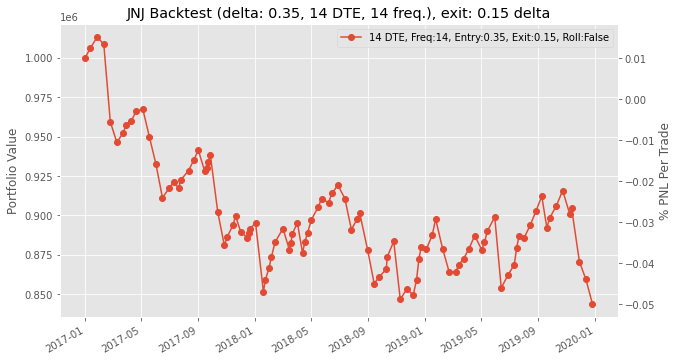

Date 2016-12-30, Expiry: 2017-01-20, Strike: 117.0, Underlying: 115.09, Premium: 0.67, Delta: 0.306055
Bought back call (expiry 2017-01-20 00:00:00, strike = 117.0) on 2017-01-12 for 0.15
PNL 2017-01-12 00:00:00 = 4004.0 (premium = 0.67, exit = 0.15)

Date 2017-01-12, Expiry: 2017-02-03, Strike: 116.0, Underlying: 114.598, Premium: 1.07, Delta: 0.378589
Bought back call (expiry 2017-02-03 00:00:00, strike = 116.0) on 2017-01-24 for 0.02
PNL 2017-01-24 00:00:00 = 8085.0 (premium = 1.07, exit = 0.02)

Date 2017-01-24, Expiry: 2017-02-17, Strike: 113.0, Underlying: 111.699, Premium: 0.75, Delta: 0.356503
Expired call (expiry 2017-02-17 00:00:00, strike = 113.0) on 2017-01-24
Strike was breached- At expiry, underlying is 118.86000061035156 , strike is 113.0
We lost money  PNL 2017-02-17 = -39347.00469970703 (premium = 0.75, exit = 5.8600006103515625)

Date 2017-02-17, Expiry: 2017-03-10, Strike: 119.0, Underlying: 118.42, Premium: 0.55, Delta: 0.327399
Expired call (expiry 2017-03-10 00:00

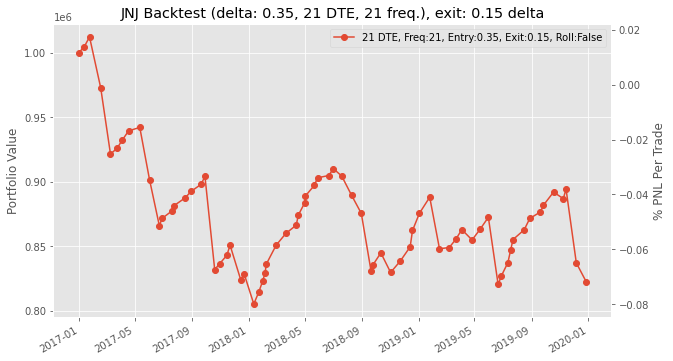

Date 2016-12-30, Expiry: 2017-01-27, Strike: 117.0, Underlying: 115.09, Premium: 1.18, Delta: 0.364969
Bought back call (expiry 2017-01-27 00:00:00, strike = 117.0) on 2017-01-20 for 0.2
PNL 2017-01-20 00:00:00 = 7546.0 (premium = 1.18, exit = 0.2)

Date 2017-01-20, Expiry: 2017-02-17, Strike: 115.0, Underlying: 114.14, Premium: 1.26, Delta: 0.432462
Bought back call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-02-08 for 0.11
PNL 2017-02-08 00:00:00 = 8855.0 (premium = 1.26, exit = 0.11)

Date 2017-02-08, Expiry: 2017-03-10, Strike: 114.0, Underlying: 113.385, Premium: 0.75, Delta: 0.363399
Expired call (expiry 2017-03-10 00:00:00, strike = 114.0) on 2017-02-08
Strike was breached- At expiry, underlying is 126.20999908447266 , strike is 114.0
We lost money  PNL 2017-03-10 = -88241.99295043945 (premium = 0.75, exit = 12.209999084472656)

Date 2017-03-10, Expiry: 2017-04-07, Strike: 128.0, Underlying: 126.35, Premium: 0.92, Delta: 0.355219
Bought back call (expiry 2017-04-07 00:0

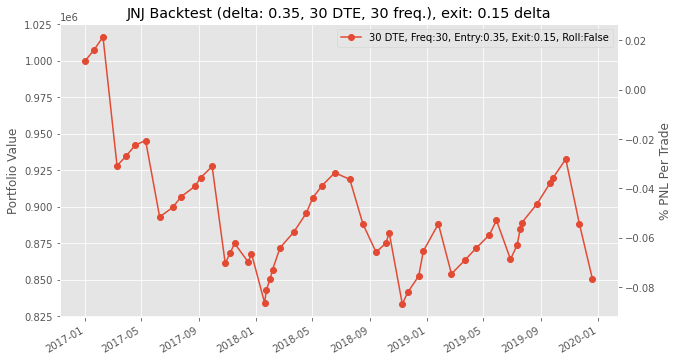

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
Bought back call (expiry 2017-02-17 00:00:00, strike = 120.0) on 2017-01-11 for 0.17
PNL 2017-01-11 00:00:00 = 5004.999999999999 (premium = 0.82, exit = 0.17)

Date 2017-01-11, Expiry: 2017-02-24, Strike: 117.0, Underlying: 114.87, Premium: 1.46, Delta: 0.35901500000000003
Bought back call (expiry 2017-02-24 00:00:00, strike = 117.0) on 2017-01-24 for 0.13
PNL 2017-01-24 00:00:00 = 10241.0 (premium = 1.46, exit = 0.13)

Date 2017-01-24, Expiry: 2017-03-17, Strike: 115.0, Underlying: 111.699, Premium: 0.4, Delta: 0.184568
Expired call (expiry 2017-03-17 00:00:00, strike = 115.0) on 2017-01-24
Strike was breached- At expiry, underlying is 128.05999755859375 , strike is 115.0
We lost money  PNL 2017-03-17 = -97481.98120117188 (premium = 0.4, exit = 13.05999755859375)

Date 2017-03-17, Expiry: 2017-04-28, Strike: 131.0, Underlying: 128.4, Premium: 1.03, Delta: 0.317677
Bought back call (e

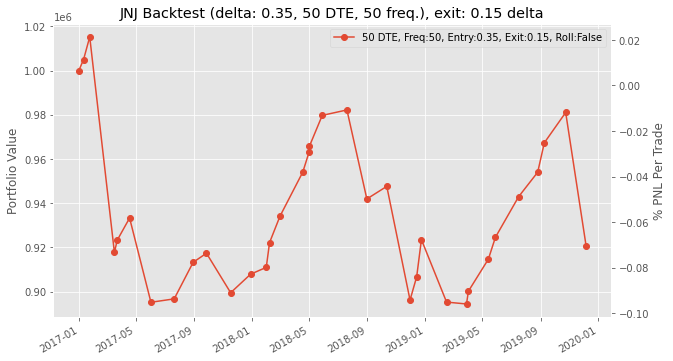

0.350.15 took 215.9984941482544 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Expired call (expiry 2017-01-06 00:00:00, strike = 116.0) on 2016-12-30
Strike was breached- At expiry, underlying is 116.30000305175781 , strike is 116.0
PNL 2017-01-06 00:00:00 = 384.9765014648436 (premium = 0.35, exit = 0.3000030517578125)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 117.0, Underlying: 116.39, Premium: 0.55, Delta: 0.387161
Bought back call (expiry 2017-01-13 00:00:00, strike = 117.0) on 2017-01-11 for 0.02
PNL 2017-01-11 00:00:00 = 4081.0 (premium = 0.55, exit = 0.02)

Date 2017-01-11, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.87, Premium: 0.82, Delta: 0.481882
Bought back call (expiry 2017-01-20 00:00:00, strike = 115.0) on 2017-01-19 for 0.08
PNL 2017-01-19 00:00:00 = 5698.0 (premium = 0.82, exit = 0.08)

Date 2017-01-19, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.18, Premium: 0.81, Delta: 0.397038
Expire

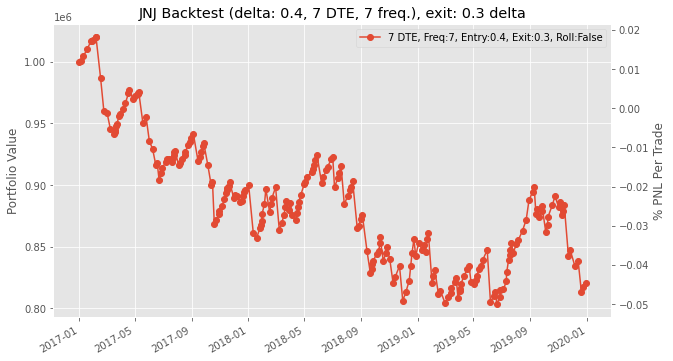

Date 2016-12-30, Expiry: 2017-01-13, Strike: 116.0, Underlying: 115.09, Premium: 0.81, Delta: 0.39292
Bought back call (expiry 2017-01-13 00:00:00, strike = 116.0) on 2017-01-11 for 0.14
PNL 2017-01-11 00:00:00 = 5159.0 (premium = 0.81, exit = 0.14)

Date 2017-01-11, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.87, Premium: 1.12, Delta: 0.398916
Bought back call (expiry 2017-01-27 00:00:00, strike = 116.0) on 2017-01-19 for 0.47
PNL 2017-01-19 00:00:00 = 5005.000000000001 (premium = 1.12, exit = 0.47)

Date 2017-01-19, Expiry: 2017-02-03, Strike: 115.0, Underlying: 114.18, Premium: 1.03, Delta: 0.416286
Bought back call (expiry 2017-02-03 00:00:00, strike = 115.0) on 2017-01-24 for 0.05
PNL 2017-01-24 00:00:00 = 7546.0 (premium = 1.03, exit = 0.05)

Date 2017-01-24, Expiry: 2017-02-10, Strike: 112.0, Underlying: 111.699, Premium: 0.99, Delta: 0.47166
Expired call (expiry 2017-02-10 00:00:00, strike = 112.0) on 2017-01-24
Strike was breached- At expiry, underlying is 115.239997863

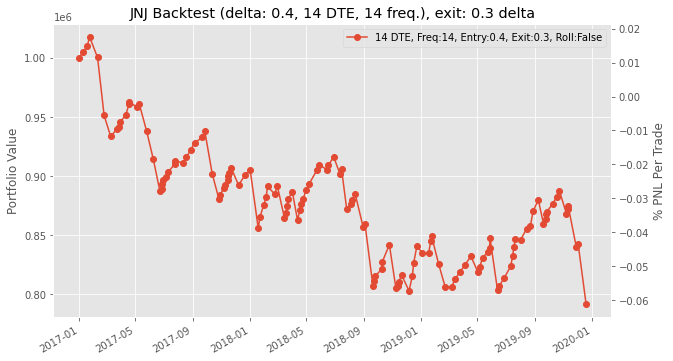

Date 2016-12-30, Expiry: 2017-01-20, Strike: 116.0, Underlying: 115.09, Premium: 1.04, Delta: 0.413177
Bought back call (expiry 2017-01-20 00:00:00, strike = 116.0) on 2017-01-12 for 0.32
PNL 2017-01-12 00:00:00 = 5544.0 (premium = 1.04, exit = 0.32)

Date 2017-01-12, Expiry: 2017-02-03, Strike: 116.0, Underlying: 114.598, Premium: 1.07, Delta: 0.378589
Bought back call (expiry 2017-02-03 00:00:00, strike = 116.0) on 2017-01-20 for 0.57
PNL 2017-01-20 00:00:00 = 3850.000000000001 (premium = 1.07, exit = 0.57)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 115.0, Underlying: 114.14, Premium: 1.13, Delta: 0.42176
Bought back call (expiry 2017-02-10 00:00:00, strike = 115.0) on 2017-01-24 for 0.11
PNL 2017-01-24 00:00:00 = 7853.999999999998 (premium = 1.13, exit = 0.11)

Date 2017-01-24, Expiry: 2017-02-17, Strike: 113.0, Underlying: 111.699, Premium: 0.75, Delta: 0.356503
Expired call (expiry 2017-02-17 00:00:00, strike = 113.0) on 2017-01-24
Strike was breached- At expiry, underlying is 

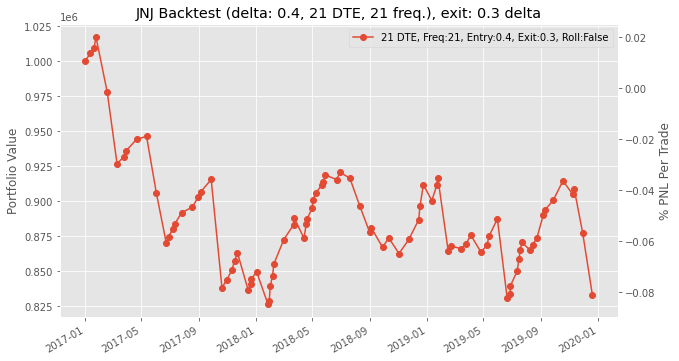

Date 2016-12-30, Expiry: 2017-01-27, Strike: 117.0, Underlying: 115.09, Premium: 1.18, Delta: 0.364969
Bought back call (expiry 2017-01-27 00:00:00, strike = 117.0) on 2017-01-12 for 0.61
PNL 2017-01-12 00:00:00 = 4389.0 (premium = 1.18, exit = 0.61)

Date 2017-01-12, Expiry: 2017-02-10, Strike: 116.0, Underlying: 114.598, Premium: 1.36, Delta: 0.399353
Bought back call (expiry 2017-02-10 00:00:00, strike = 116.0) on 2017-01-23 for 0.54
PNL 2017-01-23 00:00:00 = 6314.000000000001 (premium = 1.36, exit = 0.54)

Date 2017-01-23, Expiry: 2017-02-24, Strike: 115.0, Underlying: 113.87, Premium: 1.12, Delta: 0.382673
Bought back call (expiry 2017-02-24 00:00:00, strike = 115.0) on 2017-01-24 for 0.35
PNL 2017-01-24 00:00:00 = 5929.000000000001 (premium = 1.12, exit = 0.35)

Date 2017-01-24, Expiry: 2017-02-24, Strike: 112.0, Underlying: 111.699, Premium: 1.28, Delta: 0.450779
Expired call (expiry 2017-02-24 00:00:00, strike = 112.0) on 2017-01-24
Strike was breached- At expiry, underlying is

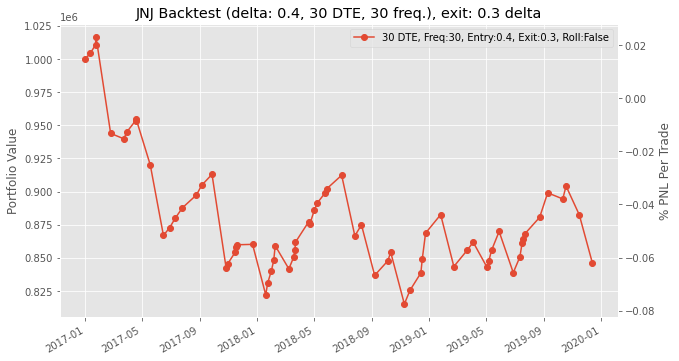

Date 2016-12-30, Expiry: 2017-02-17, Strike: 115.0, Underlying: 115.09, Premium: 2.69, Delta: 0.517649
Bought back call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-24 for 0.26
PNL 2017-01-24 00:00:00 = 18710.999999999996 (premium = 2.69, exit = 0.26)

Date 2017-01-24, Expiry: 2017-03-17, Strike: 110.0, Underlying: 111.699, Premium: 2.81, Delta: 0.6037560000000001
Expired call (expiry 2017-03-17 00:00:00, strike = 110.0) on 2017-01-24
Strike was breached- At expiry, underlying is 128.05999755859375 , strike is 110.0
We lost money  PNL 2017-03-17 = -117424.98120117188 (premium = 2.81, exit = 18.05999755859375)

Date 2017-03-17, Expiry: 2017-04-28, Strike: 130.0, Underlying: 128.4, Premium: 1.42, Delta: 0.394503
Bought back call (expiry 2017-04-28 00:00:00, strike = 130.0) on 2017-03-22 for 0.86
PNL 2017-03-22 00:00:00 = 4312.0 (premium = 1.42, exit = 0.86)

Date 2017-03-22, Expiry: 2017-05-19, Strike: 130.0, Underlying: 126.5, Premium: 1.02, Delta: 0.286456
Bought back call (

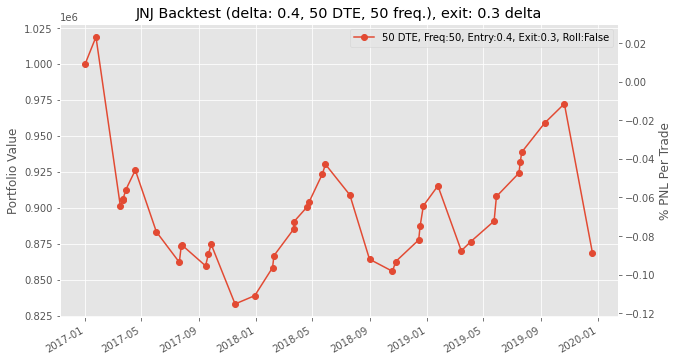

0.40.3 took 221.79610323905945 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Expired call (expiry 2017-01-06 00:00:00, strike = 116.0) on 2016-12-30
Strike was breached- At expiry, underlying is 116.30000305175781 , strike is 116.0
PNL 2017-01-06 00:00:00 = 384.9765014648436 (premium = 0.35, exit = 0.3000030517578125)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 117.0, Underlying: 116.39, Premium: 0.55, Delta: 0.387161
Bought back call (expiry 2017-01-13 00:00:00, strike = 117.0) on 2017-01-11 for 0.02
PNL 2017-01-11 00:00:00 = 4081.0 (premium = 0.55, exit = 0.02)

Date 2017-01-11, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.87, Premium: 0.82, Delta: 0.481882
Bought back call (expiry 2017-01-20 00:00:00, strike = 115.0) on 2017-01-19 for 0.08
PNL 2017-01-19 00:00:00 = 5698.0 (premium = 0.82, exit = 0.08)

Date 2017-01-19, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.18, Premium: 0.81, Delta: 0.397038
Expired

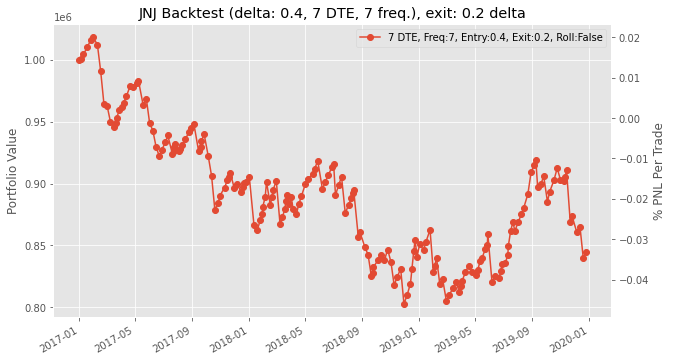

Date 2016-12-30, Expiry: 2017-01-13, Strike: 116.0, Underlying: 115.09, Premium: 0.81, Delta: 0.39292
Bought back call (expiry 2017-01-13 00:00:00, strike = 116.0) on 2017-01-11 for 0.14
PNL 2017-01-11 00:00:00 = 5159.0 (premium = 0.81, exit = 0.14)

Date 2017-01-11, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.87, Premium: 1.12, Delta: 0.398916
Bought back call (expiry 2017-01-27 00:00:00, strike = 116.0) on 2017-01-23 for 0.23
PNL 2017-01-23 00:00:00 = 6853.000000000001 (premium = 1.12, exit = 0.23)

Date 2017-01-23, Expiry: 2017-02-03, Strike: 115.0, Underlying: 113.87, Premium: 0.69, Delta: 0.357477
Bought back call (expiry 2017-02-03 00:00:00, strike = 115.0) on 2017-01-24 for 0.05
PNL 2017-01-24 00:00:00 = 4927.999999999999 (premium = 0.69, exit = 0.05)

Date 2017-01-24, Expiry: 2017-02-10, Strike: 112.0, Underlying: 111.699, Premium: 0.99, Delta: 0.47166
Expired call (expiry 2017-02-10 00:00:00, strike = 112.0) on 2017-01-24
Strike was breached- At expiry, underlying is 11

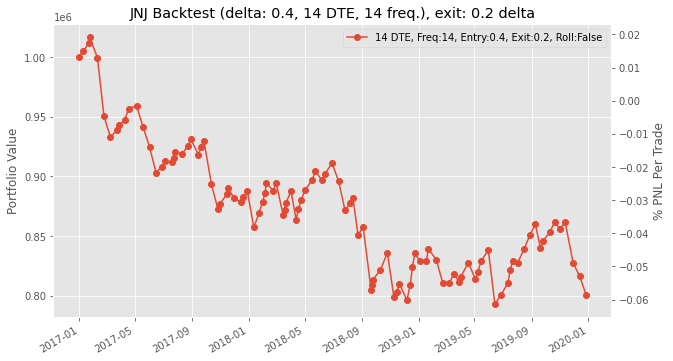

Date 2016-12-30, Expiry: 2017-01-20, Strike: 116.0, Underlying: 115.09, Premium: 1.04, Delta: 0.413177
Bought back call (expiry 2017-01-20 00:00:00, strike = 116.0) on 2017-01-17 for 0.12
PNL 2017-01-17 00:00:00 = 7084.0 (premium = 1.04, exit = 0.12)

Date 2017-01-17, Expiry: 2017-02-10, Strike: 116.0, Underlying: 114.77, Premium: 1.25, Delta: 0.403075
Bought back call (expiry 2017-02-10 00:00:00, strike = 116.0) on 2017-01-24 for 0.07
PNL 2017-01-24 00:00:00 = 9086.0 (premium = 1.25, exit = 0.07)

Date 2017-01-24, Expiry: 2017-02-17, Strike: 113.0, Underlying: 111.699, Premium: 0.75, Delta: 0.356503
Expired call (expiry 2017-02-17 00:00:00, strike = 113.0) on 2017-01-24
Strike was breached- At expiry, underlying is 118.86000061035156 , strike is 113.0
We lost money  PNL 2017-02-17 = -39347.00469970703 (premium = 0.75, exit = 5.8600006103515625)

Date 2017-02-17, Expiry: 2017-03-10, Strike: 119.0, Underlying: 118.42, Premium: 0.55, Delta: 0.327399
Expired call (expiry 2017-03-10 00:00:

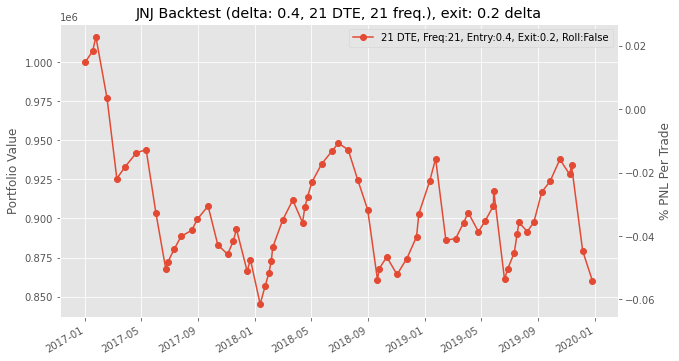

Date 2016-12-30, Expiry: 2017-01-27, Strike: 117.0, Underlying: 115.09, Premium: 1.18, Delta: 0.364969
Bought back call (expiry 2017-01-27 00:00:00, strike = 117.0) on 2017-01-19 for 0.26
PNL 2017-01-19 00:00:00 = 7083.999999999999 (premium = 1.18, exit = 0.26)

Date 2017-01-19, Expiry: 2017-02-17, Strike: 115.0, Underlying: 114.18, Premium: 1.24, Delta: 0.431751
Bought back call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-24 for 0.26
PNL 2017-01-24 00:00:00 = 7546.0 (premium = 1.24, exit = 0.26)

Date 2017-01-24, Expiry: 2017-02-24, Strike: 112.0, Underlying: 111.699, Premium: 1.28, Delta: 0.450779
Expired call (expiry 2017-02-24 00:00:00, strike = 112.0) on 2017-01-24
Strike was breached- At expiry, underlying is 122.7300033569336 , strike is 112.0
We lost money  PNL 2017-02-24 = -72765.02584838867 (premium = 1.28, exit = 10.730003356933594)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 124.0, Underlying: 122.58, Premium: 0.95, Delta: 0.363981
Expired call (expiry 2017-03

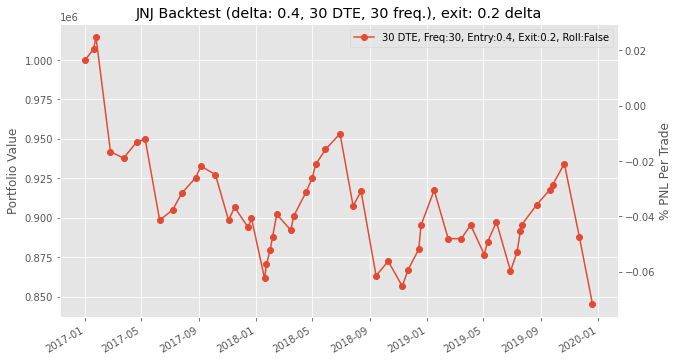

Date 2016-12-30, Expiry: 2017-02-17, Strike: 115.0, Underlying: 115.09, Premium: 2.69, Delta: 0.517649
Bought back call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-24 for 0.26
PNL 2017-01-24 00:00:00 = 18710.999999999996 (premium = 2.69, exit = 0.26)

Date 2017-01-24, Expiry: 2017-03-17, Strike: 110.0, Underlying: 111.699, Premium: 2.81, Delta: 0.6037560000000001
Expired call (expiry 2017-03-17 00:00:00, strike = 110.0) on 2017-01-24
Strike was breached- At expiry, underlying is 128.05999755859375 , strike is 110.0
We lost money  PNL 2017-03-17 = -117424.98120117188 (premium = 2.81, exit = 18.05999755859375)

Date 2017-03-17, Expiry: 2017-04-28, Strike: 130.0, Underlying: 128.4, Premium: 1.42, Delta: 0.394503
Bought back call (expiry 2017-04-28 00:00:00, strike = 130.0) on 2017-03-23 for 0.49
PNL 2017-03-23 00:00:00 = 7160.999999999999 (premium = 1.42, exit = 0.49)

Date 2017-03-23, Expiry: 2017-05-05, Strike: 128.0, Underlying: 125.775, Premium: 1.67, Delta: 0.400117
Bough

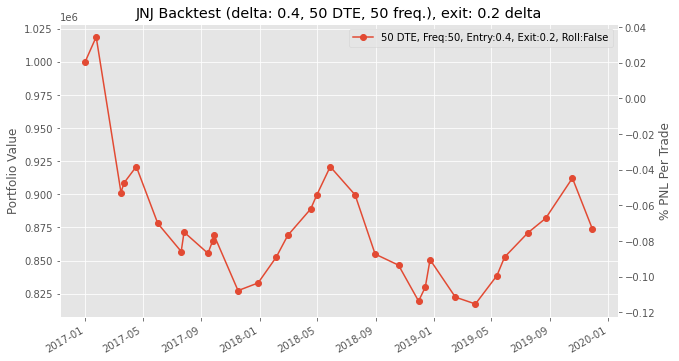

0.40.2 took 224.87767362594604 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 115.0, Underlying: 115.09, Premium: 0.84, Delta: 0.5270100000000001
Expired call (expiry 2017-01-06 00:00:00, strike = 115.0) on 2016-12-30
Strike was breached- At expiry, underlying is 116.30000305175781 , strike is 115.0
We lost money  PNL 2017-01-06 = -3542.0234985351567 (premium = 0.84, exit = 1.3000030517578125)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 117.0, Underlying: 116.39, Premium: 0.55, Delta: 0.387161
Bought back call (expiry 2017-01-13 00:00:00, strike = 117.0) on 2017-01-11 for 0.02
PNL 2017-01-11 00:00:00 = 4081.0 (premium = 0.55, exit = 0.02)

Date 2017-01-11, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.87, Premium: 0.82, Delta: 0.481882
Bought back call (expiry 2017-01-20 00:00:00, strike = 115.0) on 2017-01-19 for 0.08
PNL 2017-01-19 00:00:00 = 5698.0 (premium = 0.82, exit = 0.08)

Date 2017-01-19, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.18, Premium: 0.81, Delta

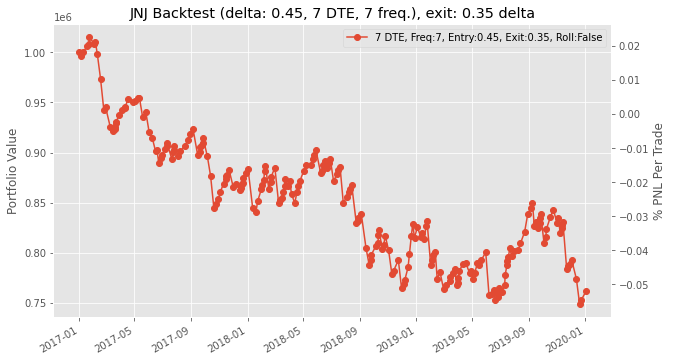

Date 2016-12-30, Expiry: 2017-01-13, Strike: 116.0, Underlying: 115.09, Premium: 0.81, Delta: 0.39292
Bought back call (expiry 2017-01-13 00:00:00, strike = 116.0) on 2017-01-11 for 0.14
PNL 2017-01-11 00:00:00 = 5159.0 (premium = 0.81, exit = 0.14)

Date 2017-01-11, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.87, Premium: 1.59, Delta: 0.4965810000000001
Bought back call (expiry 2017-01-27 00:00:00, strike = 115.0) on 2017-01-23 for 0.48
PNL 2017-01-23 00:00:00 = 8547.0 (premium = 1.59, exit = 0.48)

Date 2017-01-23, Expiry: 2017-02-03, Strike: 114.0, Underlying: 113.87, Premium: 1.14, Delta: 0.49235
Bought back call (expiry 2017-02-03 00:00:00, strike = 114.0) on 2017-01-24 for 0.14
PNL 2017-01-24 00:00:00 = 7699.999999999999 (premium = 1.14, exit = 0.14)

Date 2017-01-24, Expiry: 2017-02-10, Strike: 112.0, Underlying: 111.699, Premium: 0.99, Delta: 0.47166
Expired call (expiry 2017-02-10 00:00:00, strike = 112.0) on 2017-01-24
Strike was breached- At expiry, underlying is 115.

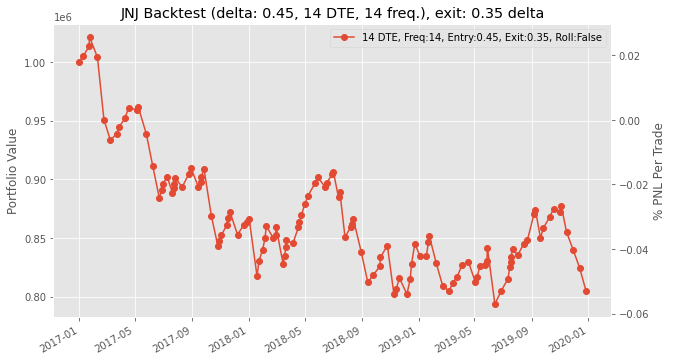

Date 2016-12-30, Expiry: 2017-01-20, Strike: 116.0, Underlying: 115.09, Premium: 1.04, Delta: 0.413177
Bought back call (expiry 2017-01-20 00:00:00, strike = 116.0) on 2017-01-11 for 0.45
PNL 2017-01-11 00:00:00 = 4543.000000000001 (premium = 1.04, exit = 0.45)

Date 2017-01-11, Expiry: 2017-02-03, Strike: 116.0, Underlying: 114.87, Premium: 1.34, Delta: 0.413598
Bought back call (expiry 2017-02-03 00:00:00, strike = 116.0) on 2017-01-19 for 0.66
PNL 2017-01-19 00:00:00 = 5236.0 (premium = 1.34, exit = 0.66)

Date 2017-01-19, Expiry: 2017-02-10, Strike: 115.0, Underlying: 114.18, Premium: 1.23, Delta: 0.4301100000000001
Bought back call (expiry 2017-02-10 00:00:00, strike = 115.0) on 2017-01-24 for 0.11
PNL 2017-01-24 00:00:00 = 8624.0 (premium = 1.23, exit = 0.11)

Date 2017-01-24, Expiry: 2017-02-17, Strike: 112.0, Underlying: 111.699, Premium: 1.19, Delta: 0.47954
Expired call (expiry 2017-02-17 00:00:00, strike = 112.0) on 2017-01-24
Strike was breached- At expiry, underlying is 11

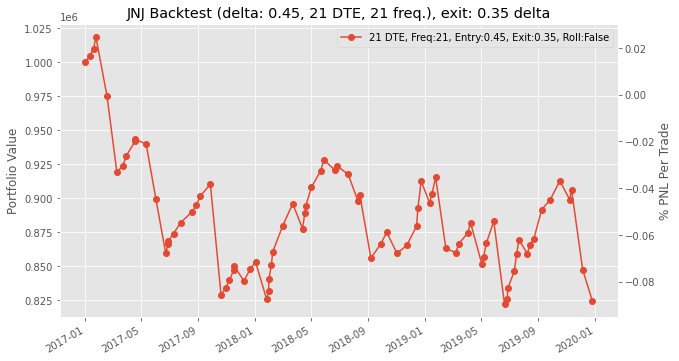

Date 2016-12-30, Expiry: 2017-01-27, Strike: 116.0, Underlying: 115.09, Premium: 1.6, Delta: 0.445572
Bought back call (expiry 2017-01-27 00:00:00, strike = 116.0) on 2017-01-18 for 0.71
PNL 2017-01-18 00:00:00 = 6853.000000000001 (premium = 1.6, exit = 0.71)

Date 2017-01-18, Expiry: 2017-02-17, Strike: 115.0, Underlying: 114.71, Premium: 1.74, Delta: 0.4910350000000001
Bought back call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-24 for 0.26
PNL 2017-01-24 00:00:00 = 11396.0 (premium = 1.74, exit = 0.26)

Date 2017-01-24, Expiry: 2017-02-24, Strike: 112.0, Underlying: 111.699, Premium: 1.28, Delta: 0.450779
Expired call (expiry 2017-02-24 00:00:00, strike = 112.0) on 2017-01-24
Strike was breached- At expiry, underlying is 122.7300033569336 , strike is 112.0
We lost money  PNL 2017-02-24 = -72765.02584838867 (premium = 1.28, exit = 10.730003356933594)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 123.0, Underlying: 122.58, Premium: 1.38, Delta: 0.463867
Expired call (expir

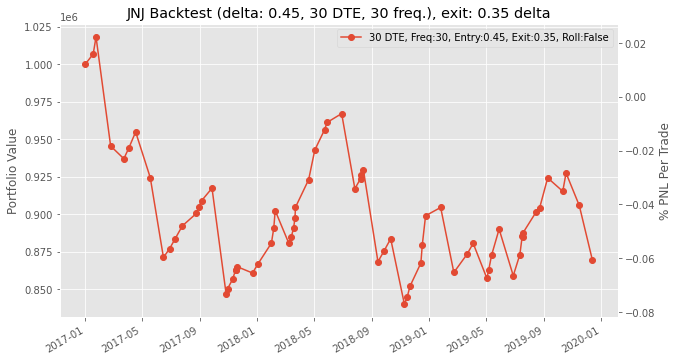

Date 2016-12-30, Expiry: 2017-02-17, Strike: 115.0, Underlying: 115.09, Premium: 2.69, Delta: 0.517649
Bought back call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-24 for 0.26
PNL 2017-01-24 00:00:00 = 18710.999999999996 (premium = 2.69, exit = 0.26)

Date 2017-01-24, Expiry: 2017-03-17, Strike: 110.0, Underlying: 111.699, Premium: 2.81, Delta: 0.6037560000000001
Expired call (expiry 2017-03-17 00:00:00, strike = 110.0) on 2017-01-24
Strike was breached- At expiry, underlying is 128.05999755859375 , strike is 110.0
We lost money  PNL 2017-03-17 = -117424.98120117188 (premium = 2.81, exit = 18.05999755859375)

Date 2017-03-17, Expiry: 2017-04-28, Strike: 129.0, Underlying: 128.4, Premium: 1.9, Delta: 0.473844
Bought back call (expiry 2017-04-28 00:00:00, strike = 129.0) on 2017-03-22 for 1.15
PNL 2017-03-22 00:00:00 = 5775.0 (premium = 1.9, exit = 1.15)

Date 2017-03-22, Expiry: 2017-05-19, Strike: 125.0, Underlying: 126.5, Premium: 3.6, Delta: 0.5975659999999999
Bought back

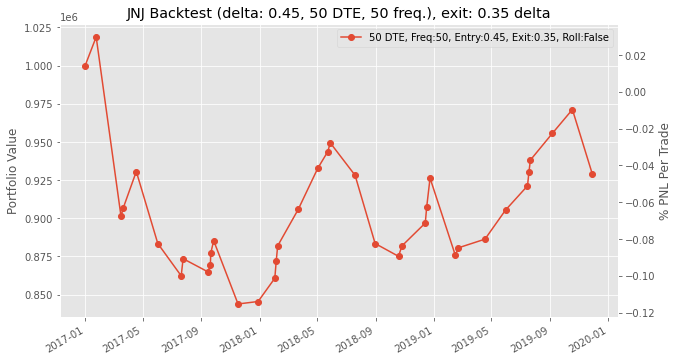

0.450.35 took 229.6601140499115 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 115.0, Underlying: 115.09, Premium: 0.84, Delta: 0.5270100000000001
Expired call (expiry 2017-01-06 00:00:00, strike = 115.0) on 2016-12-30
Strike was breached- At expiry, underlying is 116.30000305175781 , strike is 115.0
We lost money  PNL 2017-01-06 = -3542.0234985351567 (premium = 0.84, exit = 1.3000030517578125)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 117.0, Underlying: 116.39, Premium: 0.55, Delta: 0.387161
Bought back call (expiry 2017-01-13 00:00:00, strike = 117.0) on 2017-01-11 for 0.02
PNL 2017-01-11 00:00:00 = 4081.0 (premium = 0.55, exit = 0.02)

Date 2017-01-11, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.87, Premium: 0.82, Delta: 0.481882
Bought back call (expiry 2017-01-20 00:00:00, strike = 115.0) on 2017-01-19 for 0.08
PNL 2017-01-19 00:00:00 = 5698.0 (premium = 0.82, exit = 0.08)

Date 2017-01-19, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.18, Premium: 0.81, Delt

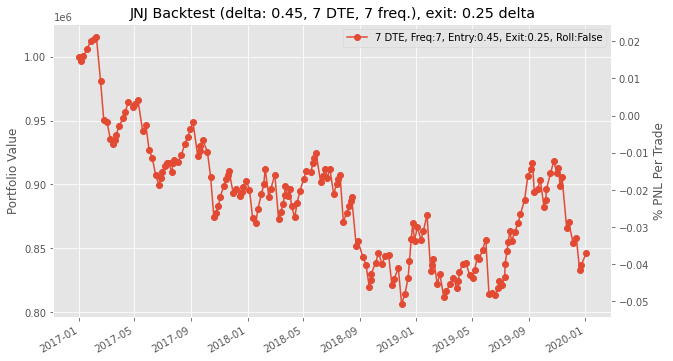

Date 2016-12-30, Expiry: 2017-01-13, Strike: 116.0, Underlying: 115.09, Premium: 0.81, Delta: 0.39292
Bought back call (expiry 2017-01-13 00:00:00, strike = 116.0) on 2017-01-11 for 0.14
PNL 2017-01-11 00:00:00 = 5159.0 (premium = 0.81, exit = 0.14)

Date 2017-01-11, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.87, Premium: 1.59, Delta: 0.4965810000000001
Expired call (expiry 2017-01-27 00:00:00, strike = 115.0) on 2017-01-11
At expiry, underlying is 113.37999725341797 , strike is 115.0
PNL 2017-01-27 00:00:00 = 12243.0 (premium = 1.59, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 114.0, Underlying: 113.14, Premium: 0.62, Delta: 0.37324
Bought back call (expiry 2017-02-10 00:00:00, strike = 114.0) on 2017-02-08 for 0.12
PNL 2017-02-08 00:00:00 = 3850.0 (premium = 0.62, exit = 0.12)

Date 2017-02-08, Expiry: 2017-02-24, Strike: 113.0, Underlying: 113.385, Premium: 1.01, Delta: 0.530636
Expired call (expiry 2017-02-24 00:00:00, strike = 113.0) on 2017-02-08
Strike was br

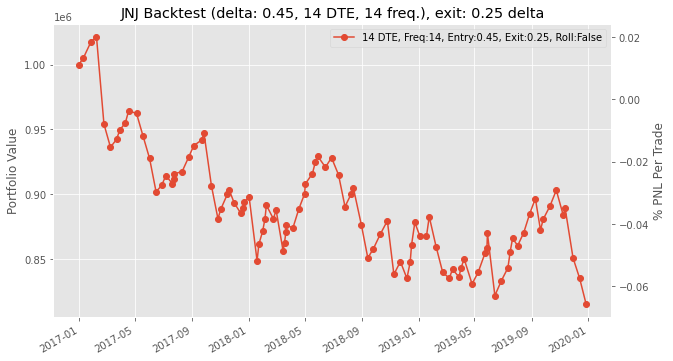

Date 2016-12-30, Expiry: 2017-01-20, Strike: 116.0, Underlying: 115.09, Premium: 1.04, Delta: 0.413177
Bought back call (expiry 2017-01-20 00:00:00, strike = 116.0) on 2017-01-13 for 0.24
PNL 2017-01-13 00:00:00 = 6160.0 (premium = 1.04, exit = 0.24)

Date 2017-01-13, Expiry: 2017-02-03, Strike: 115.0, Underlying: 114.64, Premium: 1.53, Delta: 0.477542
Bought back call (expiry 2017-02-03 00:00:00, strike = 115.0) on 2017-01-24 for 0.05
PNL 2017-01-24 00:00:00 = 11396.0 (premium = 1.53, exit = 0.05)

Date 2017-01-24, Expiry: 2017-02-17, Strike: 112.0, Underlying: 111.699, Premium: 1.19, Delta: 0.47954
Expired call (expiry 2017-02-17 00:00:00, strike = 112.0) on 2017-01-24
Strike was breached- At expiry, underlying is 118.86000061035156 , strike is 112.0
We lost money  PNL 2017-02-17 = -43659.00469970704 (premium = 1.19, exit = 6.8600006103515625)

Date 2017-02-17, Expiry: 2017-03-10, Strike: 118.0, Underlying: 118.42, Premium: 1.0, Delta: 0.477891
Expired call (expiry 2017-03-10 00:00:0

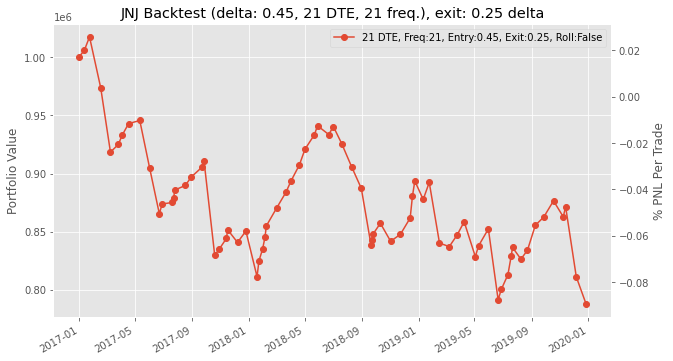

Date 2016-12-30, Expiry: 2017-01-27, Strike: 116.0, Underlying: 115.09, Premium: 1.6, Delta: 0.445572
Bought back call (expiry 2017-01-27 00:00:00, strike = 116.0) on 2017-01-20 for 0.39
PNL 2017-01-20 00:00:00 = 9317.0 (premium = 1.6, exit = 0.39)

Date 2017-01-20, Expiry: 2017-02-17, Strike: 115.0, Underlying: 114.14, Premium: 1.26, Delta: 0.432462
Bought back call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-24 for 0.26
PNL 2017-01-24 00:00:00 = 7700.0 (premium = 1.26, exit = 0.26)

Date 2017-01-24, Expiry: 2017-02-24, Strike: 112.0, Underlying: 111.699, Premium: 1.28, Delta: 0.450779
Expired call (expiry 2017-02-24 00:00:00, strike = 112.0) on 2017-01-24
Strike was breached- At expiry, underlying is 122.7300033569336 , strike is 112.0
We lost money  PNL 2017-02-24 = -72765.02584838867 (premium = 1.28, exit = 10.730003356933594)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 123.0, Underlying: 122.58, Premium: 1.38, Delta: 0.463867
Expired call (expiry 2017-03-24 00:00:00,

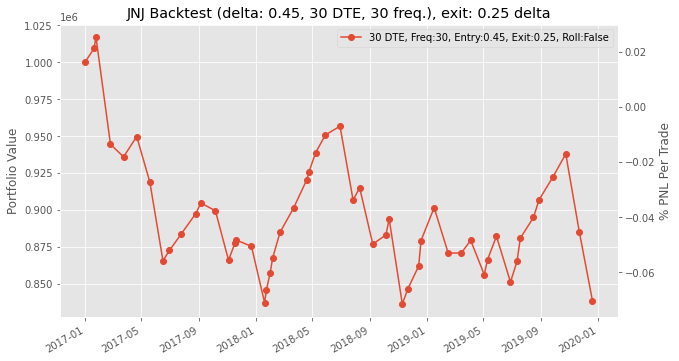

Date 2016-12-30, Expiry: 2017-02-17, Strike: 115.0, Underlying: 115.09, Premium: 2.69, Delta: 0.517649
Bought back call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-24 for 0.26
PNL 2017-01-24 00:00:00 = 18710.999999999996 (premium = 2.69, exit = 0.26)

Date 2017-01-24, Expiry: 2017-03-17, Strike: 110.0, Underlying: 111.699, Premium: 2.81, Delta: 0.6037560000000001
Expired call (expiry 2017-03-17 00:00:00, strike = 110.0) on 2017-01-24
Strike was breached- At expiry, underlying is 128.05999755859375 , strike is 110.0
We lost money  PNL 2017-03-17 = -117424.98120117188 (premium = 2.81, exit = 18.05999755859375)

Date 2017-03-17, Expiry: 2017-04-28, Strike: 129.0, Underlying: 128.4, Premium: 1.9, Delta: 0.473844
Bought back call (expiry 2017-04-28 00:00:00, strike = 129.0) on 2017-03-28 for 0.7
PNL 2017-03-28 00:00:00 = 9240.0 (premium = 1.9, exit = 0.7)

Date 2017-03-28, Expiry: 2017-05-19, Strike: 125.0, Underlying: 125.555, Premium: 2.92, Delta: 0.546247
Bought back call (ex

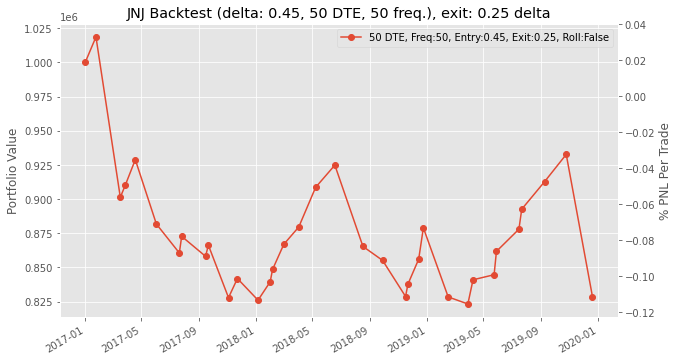

0.450.25 took 228.4425024986267 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 115.0, Underlying: 115.09, Premium: 0.84, Delta: 0.5270100000000001
Expired call (expiry 2017-01-06 00:00:00, strike = 115.0) on 2016-12-30
Strike was breached- At expiry, underlying is 116.30000305175781 , strike is 115.0
We lost money  PNL 2017-01-06 = -3542.0234985351567 (premium = 0.84, exit = 1.3000030517578125)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 116.0, Underlying: 116.39, Premium: 1.05, Delta: 0.579331
Bought back call (expiry 2017-01-13 00:00:00, strike = 116.0) on 2017-01-11 for 0.14
PNL 2017-01-11 00:00:00 = 7007.0 (premium = 1.05, exit = 0.14)

Date 2017-01-11, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.87, Premium: 0.82, Delta: 0.481882
Bought back call (expiry 2017-01-20 00:00:00, strike = 115.0) on 2017-01-19 for 0.08
PNL 2017-01-19 00:00:00 = 5698.0 (premium = 0.82, exit = 0.08)

Date 2017-01-19, Expiry: 2017-01-27, Strike: 114.0, Underlying: 114.18, Premium: 1.3, Delta

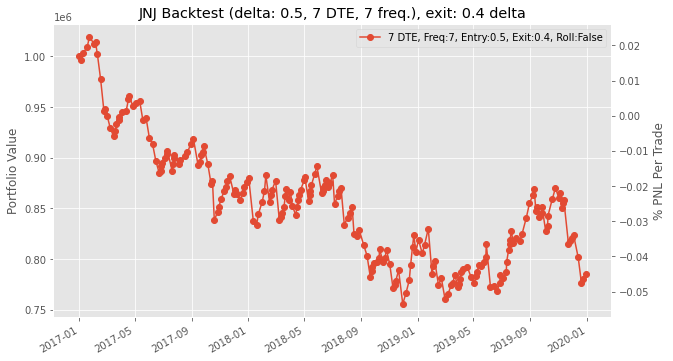

Date 2016-12-30, Expiry: 2017-01-13, Strike: 115.0, Underlying: 115.09, Premium: 1.26, Delta: 0.526835
Bought back call (expiry 2017-01-13 00:00:00, strike = 115.0) on 2017-01-12 for 0.2
PNL 2017-01-12 00:00:00 = 8162.0 (premium = 1.26, exit = 0.2)

Date 2017-01-12, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.598, Premium: 1.35, Delta: 0.4664430000000001
Bought back call (expiry 2017-01-27 00:00:00, strike = 115.0) on 2017-01-19 for 0.81
PNL 2017-01-19 00:00:00 = 4158.0 (premium = 1.35, exit = 0.81)

Date 2017-01-19, Expiry: 2017-02-03, Strike: 114.0, Underlying: 114.18, Premium: 1.54, Delta: 0.52957
Bought back call (expiry 2017-02-03 00:00:00, strike = 114.0) on 2017-01-24 for 0.14
PNL 2017-01-24 00:00:00 = 10780.0 (premium = 1.54, exit = 0.14)

Date 2017-01-24, Expiry: 2017-02-10, Strike: 112.0, Underlying: 111.699, Premium: 0.99, Delta: 0.47166
Expired call (expiry 2017-02-10 00:00:00, strike = 112.0) on 2017-01-24
Strike was breached- At expiry, underlying is 115.2399978637

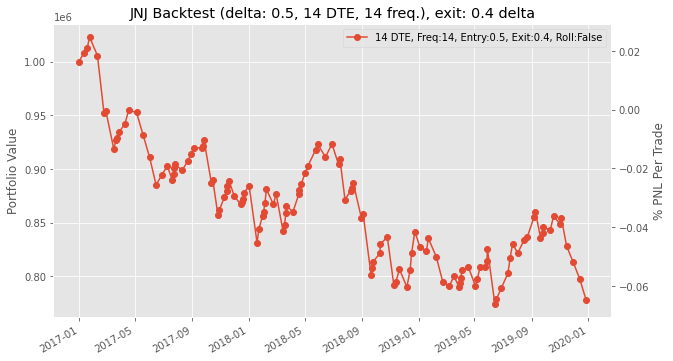

Date 2016-12-30, Expiry: 2017-01-20, Strike: 115.0, Underlying: 115.09, Premium: 1.55, Delta: 0.52461
Bought back call (expiry 2017-01-20 00:00:00, strike = 115.0) on 2017-01-19 for 0.08
PNL 2017-01-19 00:00:00 = 11319.0 (premium = 1.55, exit = 0.08)

Date 2017-01-19, Expiry: 2017-02-10, Strike: 114.0, Underlying: 114.18, Premium: 1.75, Delta: 0.529584
Bought back call (expiry 2017-02-10 00:00:00, strike = 114.0) on 2017-01-24 for 0.22
PNL 2017-01-24 00:00:00 = 11781.0 (premium = 1.75, exit = 0.22)

Date 2017-01-24, Expiry: 2017-02-17, Strike: 112.0, Underlying: 111.699, Premium: 1.19, Delta: 0.47954
Expired call (expiry 2017-02-17 00:00:00, strike = 112.0) on 2017-01-24
Strike was breached- At expiry, underlying is 118.86000061035156 , strike is 112.0
We lost money  PNL 2017-02-17 = -43659.00469970704 (premium = 1.19, exit = 6.8600006103515625)

Date 2017-02-17, Expiry: 2017-03-10, Strike: 118.0, Underlying: 118.42, Premium: 1.0, Delta: 0.477891
Expired call (expiry 2017-03-10 00:00:0

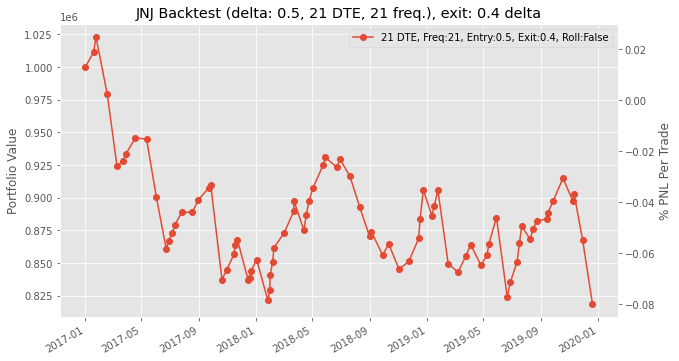

Date 2016-12-30, Expiry: 2017-01-27, Strike: 115.0, Underlying: 115.09, Premium: 2.12, Delta: 0.526139
Bought back call (expiry 2017-01-27 00:00:00, strike = 115.0) on 2017-01-19 for 0.81
PNL 2017-01-19 00:00:00 = 10087.0 (premium = 2.12, exit = 0.81)

Date 2017-01-19, Expiry: 2017-02-17, Strike: 115.0, Underlying: 114.18, Premium: 1.24, Delta: 0.431751
Bought back call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-23 for 1.03
PNL 2017-01-23 00:00:00 = 1616.9999999999998 (premium = 1.24, exit = 1.03)

Date 2017-01-23, Expiry: 2017-02-24, Strike: 114.0, Underlying: 113.87, Premium: 1.58, Delta: 0.475644
Bought back call (expiry 2017-02-24 00:00:00, strike = 114.0) on 2017-01-24 for 0.56
PNL 2017-01-24 00:00:00 = 7854.0 (premium = 1.58, exit = 0.56)

Date 2017-01-24, Expiry: 2017-02-24, Strike: 112.0, Underlying: 111.699, Premium: 1.28, Delta: 0.450779
Expired call (expiry 2017-02-24 00:00:00, strike = 112.0) on 2017-01-24
Strike was breached- At expiry, underlying is 122.73000

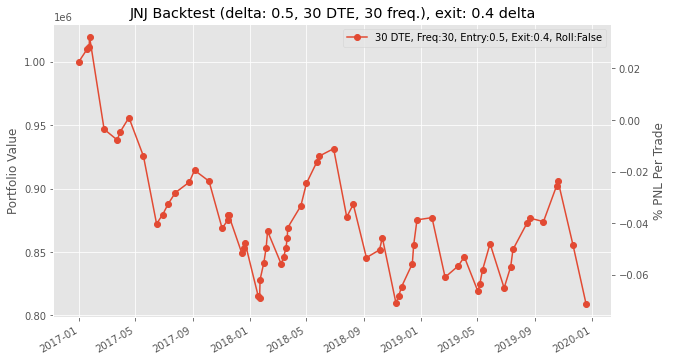

Date 2016-12-30, Expiry: 2017-02-17, Strike: 115.0, Underlying: 115.09, Premium: 2.69, Delta: 0.517649
Bought back call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-23 for 1.03
PNL 2017-01-23 00:00:00 = 12782.0 (premium = 2.69, exit = 1.03)

Date 2017-01-23, Expiry: 2017-03-17, Strike: 115.0, Underlying: 113.87, Premium: 1.34, Delta: 0.389184
Bought back call (expiry 2017-03-17 00:00:00, strike = 115.0) on 2017-01-24 for 0.4
PNL 2017-01-24 00:00:00 = 7238.0 (premium = 1.34, exit = 0.4)

Date 2017-01-24, Expiry: 2017-03-17, Strike: 110.0, Underlying: 111.699, Premium: 2.81, Delta: 0.6037560000000001
Expired call (expiry 2017-03-17 00:00:00, strike = 110.0) on 2017-01-24
Strike was breached- At expiry, underlying is 128.05999755859375 , strike is 110.0
We lost money  PNL 2017-03-17 = -117424.98120117188 (premium = 2.81, exit = 18.05999755859375)

Date 2017-03-17, Expiry: 2017-04-28, Strike: 129.0, Underlying: 128.4, Premium: 1.9, Delta: 0.473844
Bought back call (expiry 2017-0

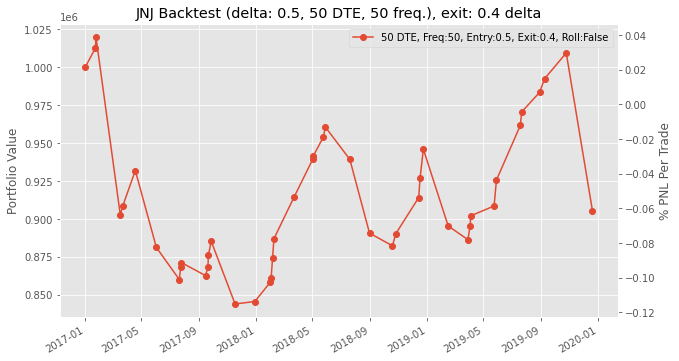

0.50.4 took 241.82956266403198 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 115.0, Underlying: 115.09, Premium: 0.84, Delta: 0.5270100000000001
Expired call (expiry 2017-01-06 00:00:00, strike = 115.0) on 2016-12-30
Strike was breached- At expiry, underlying is 116.30000305175781 , strike is 115.0
We lost money  PNL 2017-01-06 = -3542.0234985351567 (premium = 0.84, exit = 1.3000030517578125)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 116.0, Underlying: 116.39, Premium: 1.05, Delta: 0.579331
Bought back call (expiry 2017-01-13 00:00:00, strike = 116.0) on 2017-01-11 for 0.14
PNL 2017-01-11 00:00:00 = 7007.0 (premium = 1.05, exit = 0.14)

Date 2017-01-11, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.87, Premium: 0.82, Delta: 0.481882
Bought back call (expiry 2017-01-20 00:00:00, strike = 115.0) on 2017-01-19 for 0.08
PNL 2017-01-19 00:00:00 = 5698.0 (premium = 0.82, exit = 0.08)

Date 2017-01-19, Expiry: 2017-01-27, Strike: 114.0, Underlying: 114.18, Premium: 1.3, Delta:

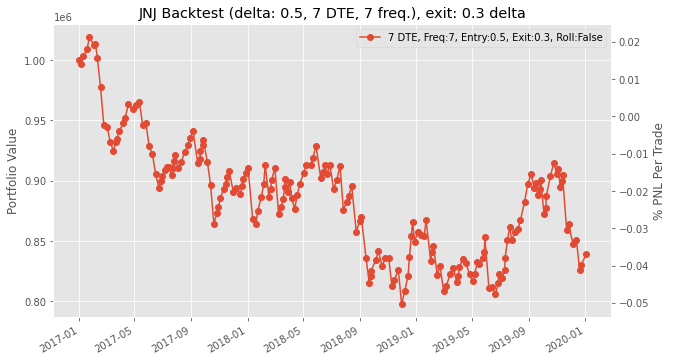

Date 2016-12-30, Expiry: 2017-01-13, Strike: 115.0, Underlying: 115.09, Premium: 1.26, Delta: 0.526835
Bought back call (expiry 2017-01-13 00:00:00, strike = 115.0) on 2017-01-13 for 0.04
PNL 2017-01-13 00:00:00 = 9394.0 (premium = 1.26, exit = 0.04)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.64, Premium: 1.3, Delta: 0.469377
Expired call (expiry 2017-01-27 00:00:00, strike = 115.0) on 2017-01-13
At expiry, underlying is 113.37999725341797 , strike is 115.0
PNL 2017-01-27 00:00:00 = 10010.0 (premium = 1.3, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 113.0, Underlying: 113.14, Premium: 1.1, Delta: 0.5334800000000001
Expired call (expiry 2017-02-10 00:00:00, strike = 113.0) on 2017-01-27
Strike was breached- At expiry, underlying is 115.23999786376953 , strike is 113.0
We lost money  PNL 2017-02-10 = -8777.98355102539 (premium = 1.1, exit = 2.2399978637695312)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 115.0, Underlying: 115.33, Premium: 0.83, Del

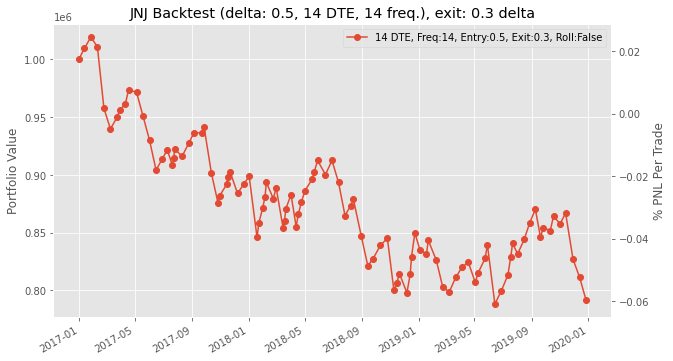

Date 2016-12-30, Expiry: 2017-01-20, Strike: 115.0, Underlying: 115.09, Premium: 1.55, Delta: 0.52461
Bought back call (expiry 2017-01-20 00:00:00, strike = 115.0) on 2017-01-19 for 0.08
PNL 2017-01-19 00:00:00 = 11319.0 (premium = 1.55, exit = 0.08)

Date 2017-01-19, Expiry: 2017-02-10, Strike: 114.0, Underlying: 114.18, Premium: 1.75, Delta: 0.529584
Bought back call (expiry 2017-02-10 00:00:00, strike = 114.0) on 2017-01-24 for 0.22
PNL 2017-01-24 00:00:00 = 11781.0 (premium = 1.75, exit = 0.22)

Date 2017-01-24, Expiry: 2017-02-17, Strike: 112.0, Underlying: 111.699, Premium: 1.19, Delta: 0.47954
Expired call (expiry 2017-02-17 00:00:00, strike = 112.0) on 2017-01-24
Strike was breached- At expiry, underlying is 118.86000061035156 , strike is 112.0
We lost money  PNL 2017-02-17 = -43659.00469970704 (premium = 1.19, exit = 6.8600006103515625)

Date 2017-02-17, Expiry: 2017-03-10, Strike: 118.0, Underlying: 118.42, Premium: 1.0, Delta: 0.477891
Expired call (expiry 2017-03-10 00:00:0

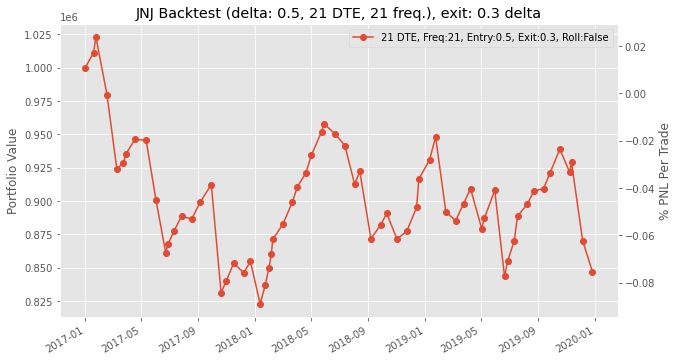

Date 2016-12-30, Expiry: 2017-01-27, Strike: 115.0, Underlying: 115.09, Premium: 2.12, Delta: 0.526139
Expired call (expiry 2017-01-27 00:00:00, strike = 115.0) on 2016-12-30
At expiry, underlying is 113.37999725341797 , strike is 115.0
PNL 2017-01-27 00:00:00 = 16324.0 (premium = 2.12, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 113.0, Underlying: 113.14, Premium: 1.44, Delta: 0.500169
Expired call (expiry 2017-02-24 00:00:00, strike = 113.0) on 2017-01-27
Strike was breached- At expiry, underlying is 122.7300033569336 , strike is 113.0
We lost money  PNL 2017-02-24 = -63833.02584838868 (premium = 1.44, exit = 9.730003356933594)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 123.0, Underlying: 122.58, Premium: 1.38, Delta: 0.463867
Expired call (expiry 2017-03-24 00:00:00, strike = 123.0) on 2017-02-24
Strike was breached- At expiry, underlying is 125.4800033569336 , strike is 123.0
We lost money  PNL 2017-03-24 = -8470.025848388672 (premium = 1.38, exit = 2.480003356933593

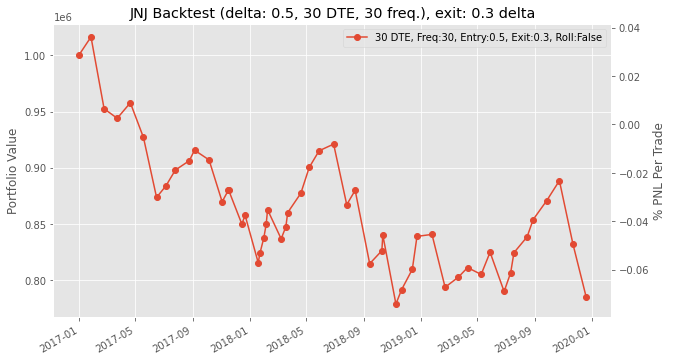

Date 2016-12-30, Expiry: 2017-02-17, Strike: 115.0, Underlying: 115.09, Premium: 2.69, Delta: 0.517649
Bought back call (expiry 2017-02-17 00:00:00, strike = 115.0) on 2017-01-24 for 0.26
PNL 2017-01-24 00:00:00 = 18710.999999999996 (premium = 2.69, exit = 0.26)

Date 2017-01-24, Expiry: 2017-03-17, Strike: 110.0, Underlying: 111.699, Premium: 2.81, Delta: 0.6037560000000001
Expired call (expiry 2017-03-17 00:00:00, strike = 110.0) on 2017-01-24
Strike was breached- At expiry, underlying is 128.05999755859375 , strike is 110.0
We lost money  PNL 2017-03-17 = -117424.98120117188 (premium = 2.81, exit = 18.05999755859375)

Date 2017-03-17, Expiry: 2017-04-28, Strike: 129.0, Underlying: 128.4, Premium: 1.9, Delta: 0.473844
Bought back call (expiry 2017-04-28 00:00:00, strike = 129.0) on 2017-03-23 for 0.74
PNL 2017-03-23 00:00:00 = 8932.0 (premium = 1.9, exit = 0.74)

Date 2017-03-23, Expiry: 2017-05-05, Strike: 126.0, Underlying: 125.775, Premium: 2.59, Delta: 0.524583
Bought back call (

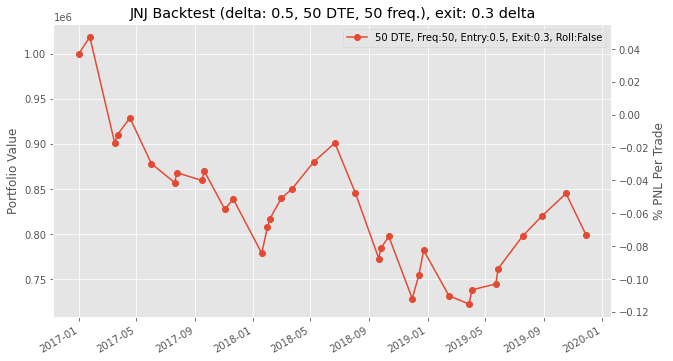

0.50.3 took 231.04825234413147 seconds


In [ ]:
for index, row in returns_df.iterrows():
    start = time.time()
    x,entry_exit = list(row.iteritems())[0]
    entry = entry_exit[0]
    exit = entry_exit[1]
    for dte, columnData in list(row.iteritems())[1:]:
        port_backtest = portfolio(df = df, dte_sell = dte, frequency= dte,strike_signal_val = entry, exit_signal_val = exit, roll_positions = False)
        port_backtest.backtest_v2()
        returns_df.at[index,dte] = copy.dee5pcopy(port_backtest.final_return())
        sharpe_df.at[index,dte] = copy.deepcopy(port_backtest.sharpe())
        plot_returns([port_backtest])
    print(f'{entry}{exit} took {time.time() - start} seconds')

In [ ]:
returns_df

,"[Entry,Exit]",7,14,21,30,50
0,"[0.1, 0]",920228.018799,971279.023499,894663.950653,960036.809662,1.002926e+06
1,"[0.2, 0.1]",860399.310181,874490.239685,911064.847260,877569.870758,8.537771e+05
2,"[0.2, 0.0]",899514.990601,951412.934204,861553.983551,931546.772064,1.023793e+06
3,"[0.25, 0.15]",849773.333679,875260.394775,884962.084595,876106.844910,9.628860e+05
4,"[0.25, 0.05]",853469.096344,886425.098694,878879.086945,885501.028198,9.303920e+05
5,"[0.3, 0.2]",819820.406525,843305.242035,839917.157440,855932.844910,9.633480e+05
6,"[0.3, 0.1]",879803.152740,891353.126892,820667.108093,842303.898956,8.664821e+05
7,"[0.35, 0.25]",844383.199738,844690.934204,836452.117493,913374.997650,9.802110e+05
8,"[0.35, 0.15]",828752.253784,843844.054047,822669.202087,850542.962402,9.207670e+05
9,"[0.4, 0.3]",820821.129242,791792.110443,832448.084595,845922.863708,8.685609e+05


Initialization took 0.12987065315246582 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 108.0, Underlying: 104.57, Premium: 0.13, Delta: 0.103282
Expired call (expiry 2015-01-09 00:00:00, strike = 108.0) on 2014-12-31
At expiry, underlying is 105.01 , strike is 108.0
PNL 2015-01-09 00:00:00 = 1001.0 (premium = 0.13, exit = 0)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 108.0, Underlying: 105.01, Premium: 0.07, Delta: 0.079788
Expired call (expiry 2015-01-17 00:00:00, strike = 108.0) on 2015-01-09
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 108.0
PNL 2015-01-17 00:00:00 = 539.0 (premium = 0.07, exit = 0)

Date 2015-01-16, Expiry: 2015-01-23, Strike: 107.0, Underlying: 104.04, Premium: 0.17, Delta: 0.131246
Expired call (expiry 2015-01-23 00:00:00, strike = 107.0) on 2015-01-16
At expiry, underlying is 102.18 , strike is 107.0
PNL 2015-01-23 00:00:00 = 1309.0 (premium = 0.17, exit

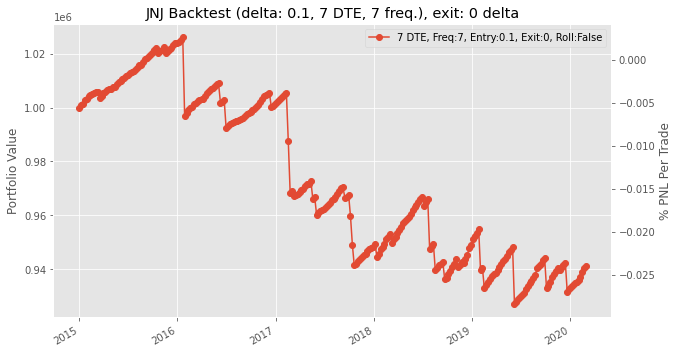

Date 2014-12-31, Expiry: 2015-01-17, Strike: 109.0, Underlying: 104.57, Premium: 0.16, Delta: 0.100641
Expired call (expiry 2015-01-17 00:00:00, strike = 109.0) on 2014-12-31
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 109.0
PNL 2015-01-17 00:00:00 = 1232.0 (premium = 0.16, exit = 0)

Date 2015-01-16, Expiry: 2015-01-30, Strike: 109.0, Underlying: 104.04, Premium: 0.17, Delta: 0.09865
Expired call (expiry 2015-01-30 00:00:00, strike = 109.0) on 2015-01-16
At expiry, underlying is 100.33 , strike is 109.0
PNL 2015-01-30 00:00:00 = 1309.0 (premium = 0.17, exit = 0)

Date 2015-01-30, Expiry: 2015-02-13, Strike: 105.0, Underlying: 100.33, Premium: 0.15, Delta: 0.096888
Expired call (expiry 2015-02-13 00:00:00, strike = 105.0) on 2015-01-30
At expiry, underlying is 99.6099 , strike is 105.0
PNL 2015-02-13 00:00:00 = 1155.0 (premium = 0.15, exit = 0)

Date 2015-02-13, Expiry: 2015-02-27, Str

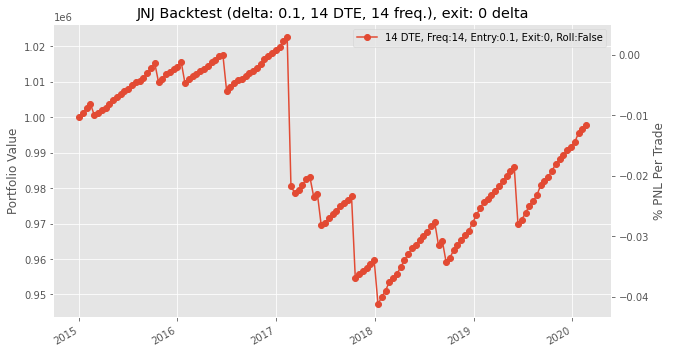

Date 2014-12-31, Expiry: 2015-01-23, Strike: 110.0, Underlying: 104.57, Premium: 0.22, Delta: 0.108816
Expired call (expiry 2015-01-23 00:00:00, strike = 110.0) on 2014-12-31
At expiry, underlying is 102.18 , strike is 110.0
PNL 2015-01-23 00:00:00 = 1694.0 (premium = 0.22, exit = 0)

Date 2015-01-23, Expiry: 2015-02-13, Strike: 106.0, Underlying: 102.18, Premium: 0.17, Delta: 0.115318
Expired call (expiry 2015-02-13 00:00:00, strike = 106.0) on 2015-01-23
At expiry, underlying is 99.6099 , strike is 106.0
PNL 2015-02-13 00:00:00 = 1309.0 (premium = 0.17, exit = 0)

Date 2015-02-13, Expiry: 2015-03-06, Strike: 103.0, Underlying: 99.6099, Premium: 0.18, Delta: 0.113397
Expired call (expiry 2015-03-06 00:00:00, strike = 103.0) on 2015-02-13
At expiry, underlying is 100.01 , strike is 103.0
PNL 2015-03-06 00:00:00 = 1386.0 (premium = 0.18, exit = 0)

Date 2015-03-06, Expiry: 2015-03-27, Strike: 104.0, Underlying: 100.01, Premium: 0.15, Delta: 0.102866
Expired call (expiry 2015-03-27 00:00

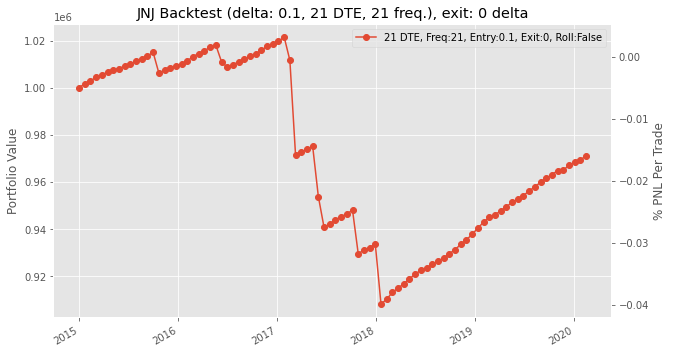

Date 2014-12-31, Expiry: 2015-01-30, Strike: 111.0, Underlying: 104.57, Premium: 0.25, Delta: 0.110206
Expired call (expiry 2015-01-30 00:00:00, strike = 111.0) on 2014-12-31
At expiry, underlying is 100.33 , strike is 111.0
PNL 2015-01-30 00:00:00 = 1925.0 (premium = 0.25, exit = 0)

Date 2015-01-30, Expiry: 2015-02-27, Strike: 106.0, Underlying: 100.33, Premium: 0.19, Delta: 0.094336
Expired call (expiry 2015-02-27 00:00:00, strike = 106.0) on 2015-01-30
At expiry, underlying is 102.55 , strike is 106.0
PNL 2015-02-27 00:00:00 = 1463.0 (premium = 0.19, exit = 0)

Date 2015-02-27, Expiry: 2015-03-27, Strike: 107.0, Underlying: 102.55, Premium: 0.18, Delta: 0.11253
Expired call (expiry 2015-03-27 00:00:00, strike = 107.0) on 2015-02-27
At expiry, underlying is 100.34 , strike is 107.0
PNL 2015-03-27 00:00:00 = 1386.0 (premium = 0.18, exit = 0)

Date 2015-03-27, Expiry: 2015-04-24, Strike: 107.0, Underlying: 100.34, Premium: 0.17, Delta: 0.083753
Expired call (expiry 2015-04-24 00:00:00

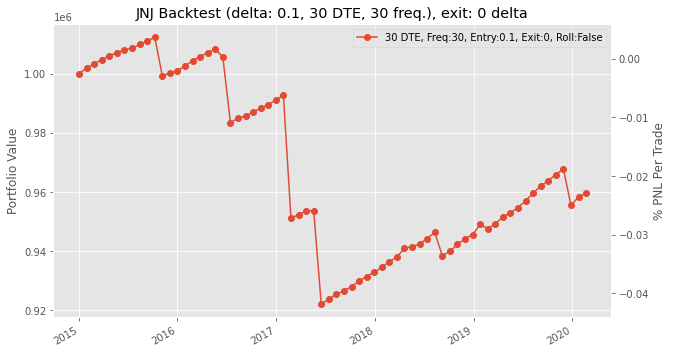

Date 2014-12-31, Expiry: 2015-02-20, Strike: 115.0, Underlying: 104.57, Premium: 0.07, Delta: 0.031583
Expired call (expiry 2015-02-20 00:00:00, strike = 115.0) on 2014-12-31
At expiry, underlying is 100.26 , strike is 115.0
PNL 2015-02-20 00:00:00 = 539.0 (premium = 0.07, exit = 0)

Date 2015-02-20, Expiry: 2015-04-17, Strike: 110.0, Underlying: 100.26, Premium: 0.03, Delta: 0.020826
Expired call (expiry 2015-04-17 00:00:00, strike = 110.0) on 2015-02-20
At expiry, underlying is 99.54 , strike is 110.0
PNL 2015-04-17 00:00:00 = 231.0 (premium = 0.03, exit = 0)

Date 2015-04-17, Expiry: 2015-05-29, Strike: 105.0, Underlying: 99.54, Premium: 0.2, Delta: 0.099805
Expired call (expiry 2015-05-29 00:00:00, strike = 105.0) on 2015-04-17
At expiry, underlying is 100.45 , strike is 105.0
PNL 2015-05-29 00:00:00 = 1540.0 (premium = 0.2, exit = 0)

Date 2015-05-29, Expiry: 2015-07-17, Strike: 105.0, Underlying: 100.45, Premium: 0.3, Delta: 0.148376
Expired call (expiry 2015-07-17 00:00:00, stri

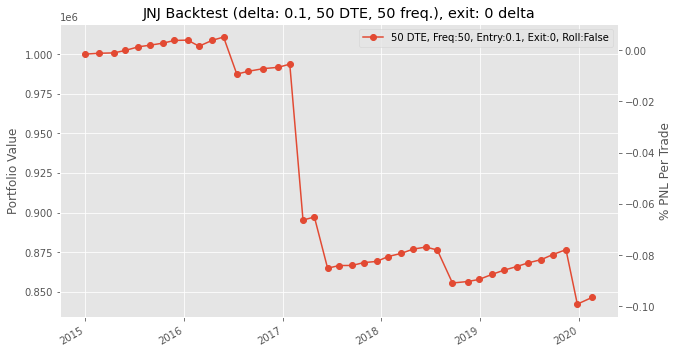

0.10 took 124.49765634536743 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 107.0, Underlying: 104.57, Premium: 0.26, Delta: 0.185105
Bought back call (expiry 2015-01-09 00:00:00, strike = 107.0) on 2015-01-05 for 0.03
PNL 2015-01-05 00:00:00 = 1771.0 (premium = 0.26, exit = 0.03)

Date 2015-01-05, Expiry: 2015-01-09, Strike: 106.0, Underlying: 103.79, Premium: 0.12, Delta: 0.128884
Bought back call (expiry 2015-01-09 00:00:00, strike = 106.0) on 2015-01-06 for 0.04
PNL 2015-01-06 00:00:00 = 615.9999999999999 (premium = 0.12, exit = 0.04)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 105.0, Underlying: 103.28, Premium: 0.14, Delta: 0.158174
Expired call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 105.0
PNL 2015-01-09 00:00:00 = 1000.9999999999607 (premium = 0.14, exit = 0.010000000000005116)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 107.0, Underlying: 105.01, Premium: 0.19, Delta: 0.171664
Bought 

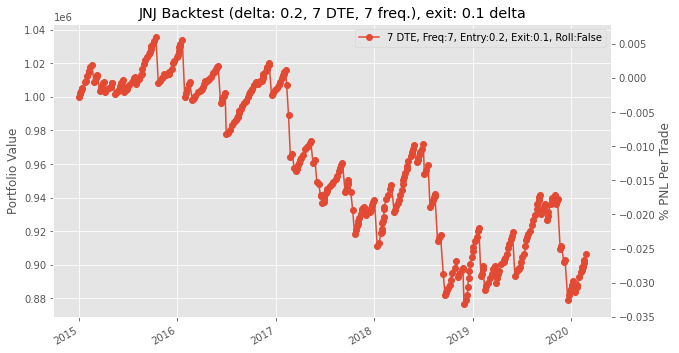

Date 2014-12-31, Expiry: 2015-01-17, Strike: 108.0, Underlying: 104.57, Premium: 0.28, Delta: 0.160722
Bought back call (expiry 2015-01-17 00:00:00, strike = 108.0) on 2015-01-05 for 0.09
PNL 2015-01-05 00:00:00 = 1463.0000000000002 (premium = 0.28, exit = 0.09)

Date 2015-01-05, Expiry: 2015-01-17, Strike: 106.0, Underlying: 103.79, Premium: 0.37, Delta: 0.227164
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-14 for 0.03
PNL 2015-01-14 00:00:00 = 2617.9999999999995 (premium = 0.37, exit = 0.03)

Date 2015-01-14, Expiry: 2015-01-30, Strike: 107.0, Underlying: 103.935, Premium: 0.41, Delta: 0.205294
Bought back call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-20 for 0.03
PNL 2015-01-20 00:00:00 = 2926.0 (premium = 0.41, exit = 0.03)

Date 2015-01-20, Expiry: 2015-02-06, Strike: 104.0, Underlying: 101.29, Premium: 0.5, Delta: 0.234714
Bought back call (expiry 2015-02-06 00:00:00, strike = 104.0) on 2015-01-30 for 0.05
PNL 2015-01-30 00:00:00 = 3465.0

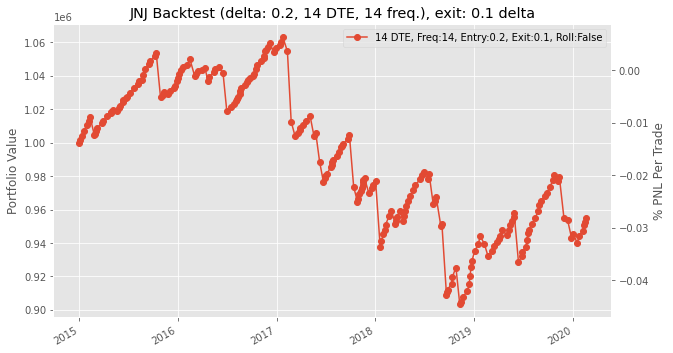

Date 2014-12-31, Expiry: 2015-01-23, Strike: 108.0, Underlying: 104.57, Premium: 0.55, Delta: 0.22607
Bought back call (expiry 2015-01-23 00:00:00, strike = 108.0) on 2015-01-14 for 0.11
PNL 2015-01-14 00:00:00 = 3388.0000000000005 (premium = 0.55, exit = 0.11)

Date 2015-01-14, Expiry: 2015-02-06, Strike: 108.0, Underlying: 103.935, Premium: 0.44, Delta: 0.186398
Bought back call (expiry 2015-02-06 00:00:00, strike = 108.0) on 2015-01-20 for 0.07
PNL 2015-01-20 00:00:00 = 2849.0 (premium = 0.44, exit = 0.07)

Date 2015-01-20, Expiry: 2015-02-13, Strike: 105.0, Underlying: 101.29, Premium: 0.49, Delta: 0.20319
Bought back call (expiry 2015-02-13 00:00:00, strike = 105.0) on 2015-01-30 for 0.15
PNL 2015-01-30 00:00:00 = 2617.9999999999995 (premium = 0.49, exit = 0.15)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 103.0, Underlying: 100.33, Premium: 0.54, Delta: 0.235059
Bought back call (expiry 2015-02-20 00:00:00, strike = 103.0) on 2015-02-12 for 0.02
PNL 2015-02-12 00:00:00 = 4004.0 

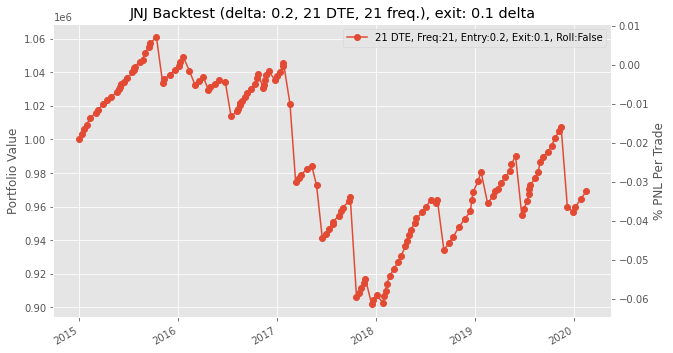

Date 2014-12-31, Expiry: 2015-01-30, Strike: 109.0, Underlying: 104.57, Premium: 0.52, Delta: 0.199396
Bought back call (expiry 2015-01-30 00:00:00, strike = 109.0) on 2015-01-06 for 0.18
PNL 2015-01-06 00:00:00 = 2618.0 (premium = 0.52, exit = 0.18)

Date 2015-01-06, Expiry: 2015-02-06, Strike: 107.0, Underlying: 103.28, Premium: 0.61, Delta: 0.228151
Bought back call (expiry 2015-02-06 00:00:00, strike = 107.0) on 2015-01-20 for 0.12
PNL 2015-01-20 00:00:00 = 3773.0 (premium = 0.61, exit = 0.12)

Date 2015-01-20, Expiry: 2015-02-20, Strike: 105.0, Underlying: 101.29, Premium: 0.6, Delta: 0.214643
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-02-02 for 0.14
PNL 2015-02-02 00:00:00 = 3541.9999999999995 (premium = 0.6, exit = 0.14)

Date 2015-02-02, Expiry: 2015-03-06, Strike: 104.0, Underlying: 100.83, Premium: 0.44, Delta: 0.189768
Bought back call (expiry 2015-03-06 00:00:00, strike = 104.0) on 2015-02-12 for 0.07
PNL 2015-02-12 00:00:00 = 2849.0 (premium = 0.

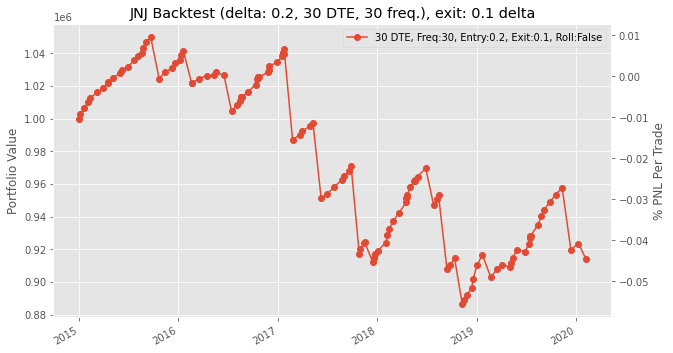

Date 2014-12-31, Expiry: 2015-02-20, Strike: 110.0, Underlying: 104.57, Premium: 0.55, Delta: 0.179046
Bought back call (expiry 2015-02-20 00:00:00, strike = 110.0) on 2015-01-14 for 0.16
PNL 2015-01-14 00:00:00 = 3003.0 (premium = 0.55, exit = 0.16)

Date 2015-01-14, Expiry: 2015-02-27, Strike: 109.0, Underlying: 103.935, Premium: 0.52, Delta: 0.17797000000000002
Bought back call (expiry 2015-02-27 00:00:00, strike = 109.0) on 2015-01-20 for 0.11
PNL 2015-01-20 00:00:00 = 3157.0000000000005 (premium = 0.52, exit = 0.11)

Date 2015-01-20, Expiry: 2015-03-20, Strike: 105.0, Underlying: 101.29, Premium: 0.88, Delta: 0.246872
Bought back call (expiry 2015-03-20 00:00:00, strike = 105.0) on 2015-02-09 for 0.17
PNL 2015-02-09 00:00:00 = 5467.0 (premium = 0.88, exit = 0.17)

Date 2015-02-09, Expiry: 2015-03-27, Strike: 104.0, Underlying: 99.7399, Premium: 0.48, Delta: 0.17517
Bought back call (expiry 2015-03-27 00:00:00, strike = 104.0) on 2015-03-10 for 0.1
PNL 2015-03-10 00:00:00 = 2926.0 

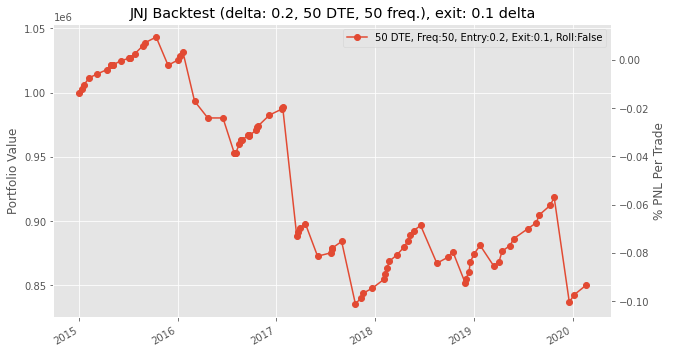

0.20.1 took 173.78648805618286 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 107.0, Underlying: 104.57, Premium: 0.26, Delta: 0.185105
Expired call (expiry 2015-01-09 00:00:00, strike = 107.0) on 2014-12-31
At expiry, underlying is 105.01 , strike is 107.0
PNL 2015-01-09 00:00:00 = 2002.0 (premium = 0.26, exit = 0)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 107.0, Underlying: 105.01, Premium: 0.19, Delta: 0.171664
Expired call (expiry 2015-01-17 00:00:00, strike = 107.0) on 2015-01-09
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 107.0
PNL 2015-01-17 00:00:00 = 1463.0 (premium = 0.19, exit = 0)

Date 2015-01-16, Expiry: 2015-01-23, Strike: 106.0, Underlying: 104.04, Premium: 0.37, Delta: 0.236488
Expired call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-16
At expiry, underlying is 102.18 , strike is 106.0
PNL 2015-01-23 00:00:00 = 2849.0 (premium = 0.37, exit = 0)

D

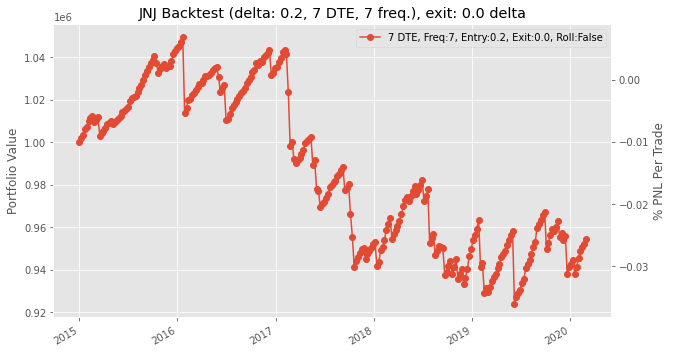

Date 2014-12-31, Expiry: 2015-01-17, Strike: 108.0, Underlying: 104.57, Premium: 0.28, Delta: 0.160722
Expired call (expiry 2015-01-17 00:00:00, strike = 108.0) on 2014-12-31
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 108.0
PNL 2015-01-17 00:00:00 = 2156.0 (premium = 0.28, exit = 0)

Date 2015-01-16, Expiry: 2015-01-30, Strike: 107.0, Underlying: 104.04, Premium: 0.41, Delta: 0.20852
Expired call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-16
At expiry, underlying is 100.33 , strike is 107.0
PNL 2015-01-30 00:00:00 = 3157.0 (premium = 0.41, exit = 0)

Date 2015-01-30, Expiry: 2015-02-13, Strike: 103.0, Underlying: 100.33, Premium: 0.41, Delta: 0.22185900000000006
Expired call (expiry 2015-02-13 00:00:00, strike = 103.0) on 2015-01-30
At expiry, underlying is 99.6099 , strike is 103.0
PNL 2015-02-13 00:00:00 = 3157.0 (premium = 0.41, exit = 0)

Date 2015-02-13, Expiry: 2015

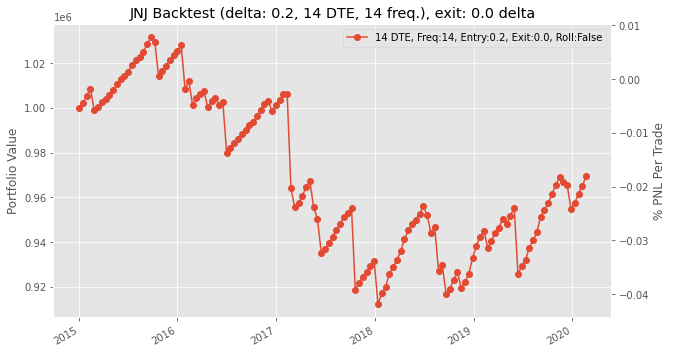

Date 2014-12-31, Expiry: 2015-01-23, Strike: 108.0, Underlying: 104.57, Premium: 0.55, Delta: 0.22607
Expired call (expiry 2015-01-23 00:00:00, strike = 108.0) on 2014-12-31
At expiry, underlying is 102.18 , strike is 108.0
PNL 2015-01-23 00:00:00 = 4235.0 (premium = 0.55, exit = 0)

Date 2015-01-23, Expiry: 2015-02-13, Strike: 105.0, Underlying: 102.18, Premium: 0.31, Delta: 0.188434
Expired call (expiry 2015-02-13 00:00:00, strike = 105.0) on 2015-01-23
At expiry, underlying is 99.6099 , strike is 105.0
PNL 2015-02-13 00:00:00 = 2387.0 (premium = 0.31, exit = 0)

Date 2015-02-13, Expiry: 2015-03-06, Strike: 102.0, Underlying: 99.6099, Premium: 0.33, Delta: 0.186853
Expired call (expiry 2015-03-06 00:00:00, strike = 102.0) on 2015-02-13
At expiry, underlying is 100.01 , strike is 102.0
PNL 2015-03-06 00:00:00 = 2541.0 (premium = 0.33, exit = 0)

Date 2015-03-06, Expiry: 2015-03-27, Strike: 103.0, Underlying: 100.01, Premium: 0.29, Delta: 0.17588900000000002
Expired call (expiry 2015-0

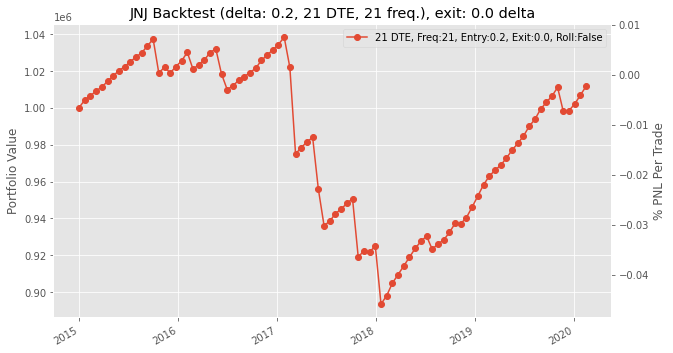

Date 2014-12-31, Expiry: 2015-01-30, Strike: 109.0, Underlying: 104.57, Premium: 0.52, Delta: 0.199396
Expired call (expiry 2015-01-30 00:00:00, strike = 109.0) on 2014-12-31
At expiry, underlying is 100.33 , strike is 109.0
PNL 2015-01-30 00:00:00 = 4004.0 (premium = 0.52, exit = 0)

Date 2015-01-30, Expiry: 2015-02-27, Strike: 104.0, Underlying: 100.33, Premium: 0.46, Delta: 0.196389
Expired call (expiry 2015-02-27 00:00:00, strike = 104.0) on 2015-01-30
At expiry, underlying is 102.55 , strike is 104.0
PNL 2015-02-27 00:00:00 = 3542.0 (premium = 0.46, exit = 0)

Date 2015-02-27, Expiry: 2015-03-27, Strike: 106.0, Underlying: 102.55, Premium: 0.32, Delta: 0.176879
Expired call (expiry 2015-03-27 00:00:00, strike = 106.0) on 2015-02-27
At expiry, underlying is 100.34 , strike is 106.0
PNL 2015-03-27 00:00:00 = 2464.0 (premium = 0.32, exit = 0)

Date 2015-03-27, Expiry: 2015-04-24, Strike: 104.0, Underlying: 100.34, Premium: 0.56, Delta: 0.225345
Expired call (expiry 2015-04-24 00:00:0

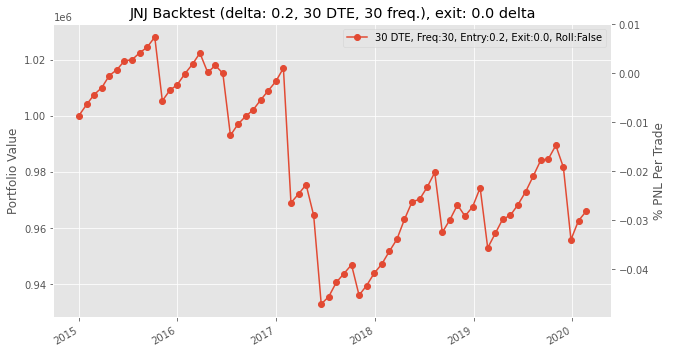

Date 2014-12-31, Expiry: 2015-02-20, Strike: 110.0, Underlying: 104.57, Premium: 0.55, Delta: 0.179046
Expired call (expiry 2015-02-20 00:00:00, strike = 110.0) on 2014-12-31
At expiry, underlying is 100.26 , strike is 110.0
PNL 2015-02-20 00:00:00 = 4235.0 (premium = 0.55, exit = 0)

Date 2015-02-20, Expiry: 2015-04-17, Strike: 105.0, Underlying: 100.26, Premium: 0.49, Delta: 0.183758
Expired call (expiry 2015-04-17 00:00:00, strike = 105.0) on 2015-02-20
At expiry, underlying is 99.54 , strike is 105.0
PNL 2015-04-17 00:00:00 = 3773.0 (premium = 0.49, exit = 0)

Date 2015-04-17, Expiry: 2015-05-29, Strike: 103.0, Underlying: 99.54, Premium: 0.5, Delta: 0.205185
Expired call (expiry 2015-05-29 00:00:00, strike = 103.0) on 2015-04-17
At expiry, underlying is 100.45 , strike is 103.0
PNL 2015-05-29 00:00:00 = 3850.0 (premium = 0.5, exit = 0)

Date 2015-05-29, Expiry: 2015-07-17, Strike: 105.0, Underlying: 100.45, Premium: 0.3, Delta: 0.148376
Expired call (expiry 2015-07-17 00:00:00, st

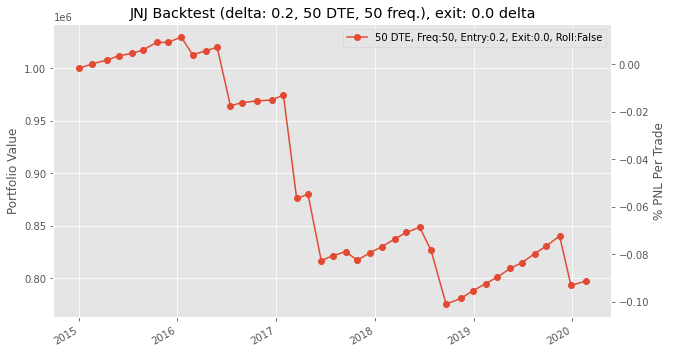

0.20.0 took 150.26902961730957 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 106.0, Underlying: 104.57, Premium: 0.51, Delta: 0.303162
Bought back call (expiry 2015-01-09 00:00:00, strike = 106.0) on 2015-01-05 for 0.12
PNL 2015-01-05 00:00:00 = 3003.0 (premium = 0.51, exit = 0.12)

Date 2015-01-05, Expiry: 2015-01-09, Strike: 105.0, Underlying: 103.79, Premium: 0.36, Delta: 0.292578
Expired call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-05
Strike was breached- At expiry, underlying is 105.01 , strike is 105.0
PNL 2015-01-09 00:00:00 = 2694.9999999999604 (premium = 0.36, exit = 0.010000000000005116)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.319877
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-14 for 0.03
PNL 2015-01-14 00:00:00 = 3003.0 (premium = 0.42, exit = 0.03)

Date 2015-01-14, Expiry: 2015-01-23, Strike: 106.0, Underlying: 103.935, Premium: 0.42, Delta: 0.246474
Bought back cal

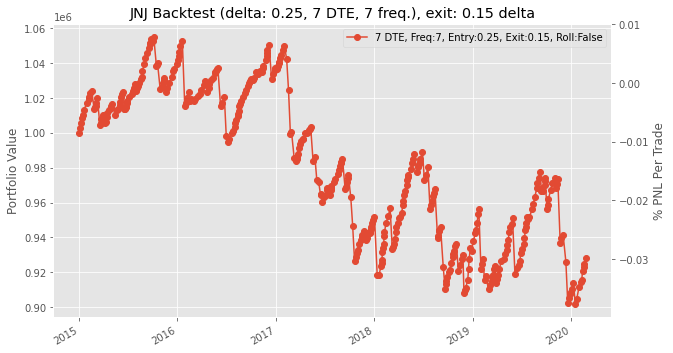

Date 2014-12-31, Expiry: 2015-01-17, Strike: 107.0, Underlying: 104.57, Premium: 0.48, Delta: 0.243142
Bought back call (expiry 2015-01-17 00:00:00, strike = 107.0) on 2015-01-05 for 0.19
PNL 2015-01-05 00:00:00 = 2233.0 (premium = 0.48, exit = 0.19)

Date 2015-01-05, Expiry: 2015-01-17, Strike: 106.0, Underlying: 103.79, Premium: 0.37, Delta: 0.227164
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-14 for 0.03
PNL 2015-01-14 00:00:00 = 2617.9999999999995 (premium = 0.37, exit = 0.03)

Date 2015-01-14, Expiry: 2015-01-30, Strike: 106.0, Underlying: 103.935, Premium: 0.64, Delta: 0.292013
Bought back call (expiry 2015-01-30 00:00:00, strike = 106.0) on 2015-01-20 for 0.07
PNL 2015-01-20 00:00:00 = 4389.000000000001 (premium = 0.64, exit = 0.07)

Date 2015-01-20, Expiry: 2015-02-06, Strike: 104.0, Underlying: 101.29, Premium: 0.5, Delta: 0.234714
Bought back call (expiry 2015-02-06 00:00:00, strike = 104.0) on 2015-01-30 for 0.05
PNL 2015-01-30 00:00:00 = 3465.0 

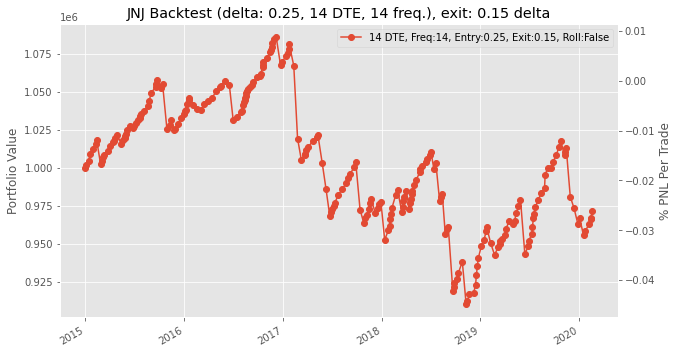

Date 2014-12-31, Expiry: 2015-01-23, Strike: 108.0, Underlying: 104.57, Premium: 0.55, Delta: 0.22607
Bought back call (expiry 2015-01-23 00:00:00, strike = 108.0) on 2015-01-05 for 0.21
PNL 2015-01-05 00:00:00 = 2618.0000000000005 (premium = 0.55, exit = 0.21)

Date 2015-01-05, Expiry: 2015-01-23, Strike: 106.0, Underlying: 103.79, Premium: 0.63, Delta: 0.28807
Bought back call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-15 for 0.2
PNL 2015-01-15 00:00:00 = 3311.0 (premium = 0.63, exit = 0.2)

Date 2015-01-15, Expiry: 2015-02-06, Strike: 106.0, Underlying: 102.54, Premium: 0.55, Delta: 0.225052
Bought back call (expiry 2015-02-06 00:00:00, strike = 106.0) on 2015-01-20 for 0.2
PNL 2015-01-20 00:00:00 = 2695.0000000000005 (premium = 0.55, exit = 0.2)

Date 2015-01-20, Expiry: 2015-02-13, Strike: 104.0, Underlying: 101.29, Premium: 0.72, Delta: 0.271821
Bought back call (expiry 2015-02-13 00:00:00, strike = 104.0) on 2015-01-30 for 0.25
PNL 2015-01-30 00:00:00 = 3619.0 (prem

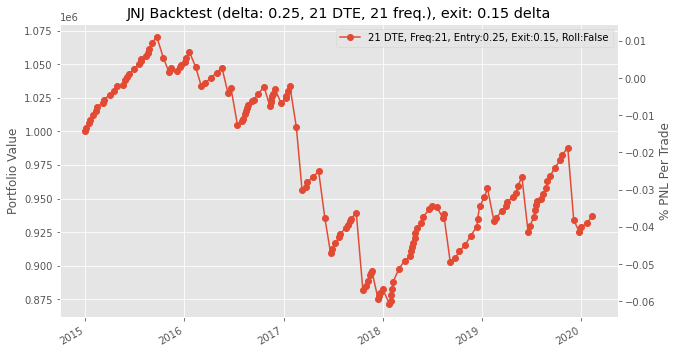

Date 2014-12-31, Expiry: 2015-01-30, Strike: 108.0, Underlying: 104.57, Premium: 0.74, Delta: 0.259889
Bought back call (expiry 2015-01-30 00:00:00, strike = 108.0) on 2015-01-06 for 0.3
PNL 2015-01-06 00:00:00 = 3388.0 (premium = 0.74, exit = 0.3)

Date 2015-01-06, Expiry: 2015-02-06, Strike: 107.0, Underlying: 103.28, Premium: 0.61, Delta: 0.228151
Bought back call (expiry 2015-02-06 00:00:00, strike = 107.0) on 2015-01-20 for 0.12
PNL 2015-01-20 00:00:00 = 3773.0 (premium = 0.61, exit = 0.12)

Date 2015-01-20, Expiry: 2015-02-20, Strike: 104.0, Underlying: 101.29, Premium: 0.84, Delta: 0.278069
Bought back call (expiry 2015-02-20 00:00:00, strike = 104.0) on 2015-02-06 for 0.16
PNL 2015-02-06 00:00:00 = 5235.999999999999 (premium = 0.84, exit = 0.16)

Date 2015-02-06, Expiry: 2015-03-06, Strike: 103.0, Underlying: 100.98, Premium: 0.65, Delta: 0.274479
Bought back call (expiry 2015-03-06 00:00:00, strike = 103.0) on 2015-02-12 for 0.14
PNL 2015-02-12 00:00:00 = 3927.0 (premium = 0.6

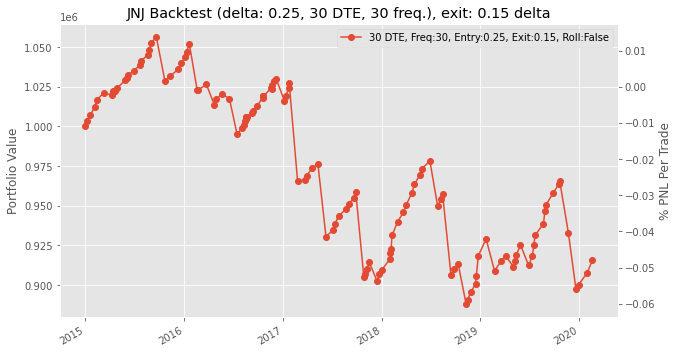

Date 2014-12-31, Expiry: 2015-02-20, Strike: 110.0, Underlying: 104.57, Premium: 0.55, Delta: 0.179046
Bought back call (expiry 2015-02-20 00:00:00, strike = 110.0) on 2015-01-05 for 0.36
PNL 2015-01-05 00:00:00 = 1463.0000000000005 (premium = 0.55, exit = 0.36)

Date 2015-01-05, Expiry: 2015-02-20, Strike: 110.0, Underlying: 103.79, Premium: 0.36, Delta: 0.132666
Bought back call (expiry 2015-02-20 00:00:00, strike = 110.0) on 2015-01-06 for 0.29
PNL 2015-01-06 00:00:00 = 539.0 (premium = 0.36, exit = 0.29)

Date 2015-01-06, Expiry: 2015-02-20, Strike: 105.0, Underlying: 103.28, Premium: 1.53, Delta: 0.380553
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-01-30 for 0.2
PNL 2015-01-30 00:00:00 = 10241.0 (premium = 1.53, exit = 0.2)

Date 2015-01-30, Expiry: 2015-03-20, Strike: 105.0, Underlying: 100.33, Premium: 0.38, Delta: 0.15513
Bought back call (expiry 2015-03-20 00:00:00, strike = 105.0) on 2015-02-09 for 0.17
PNL 2015-02-09 00:00:00 = 1617.0 (premium = 0.3

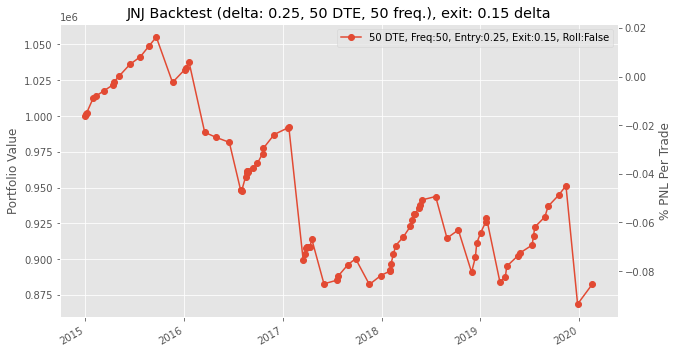

0.250.15 took 189.21379041671753 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 106.0, Underlying: 104.57, Premium: 0.51, Delta: 0.303162
Expired call (expiry 2015-01-09 00:00:00, strike = 106.0) on 2014-12-31
At expiry, underlying is 105.01 , strike is 106.0
PNL 2015-01-09 00:00:00 = 3927.0 (premium = 0.51, exit = 0)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.319877
Expired call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-09
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 106.0
PNL 2015-01-17 00:00:00 = 3234.0 (premium = 0.42, exit = 0)

Date 2015-01-16, Expiry: 2015-01-23, Strike: 106.0, Underlying: 104.04, Premium: 0.37, Delta: 0.236488
Expired call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-16
At expiry, underlying is 102.18 , strike is 106.0
PNL 2015-01-23 00:00:00 = 2849.0 (premium = 0.37, exit = 0)


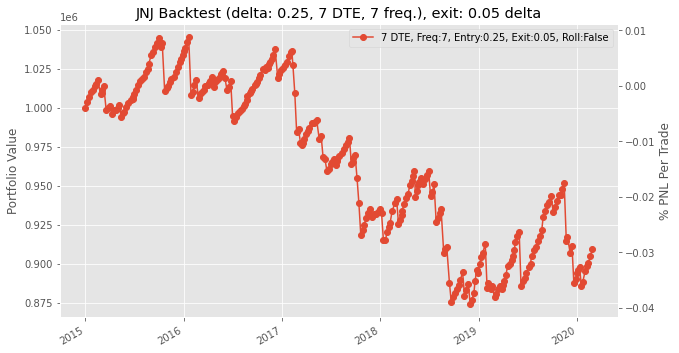

Date 2014-12-31, Expiry: 2015-01-17, Strike: 107.0, Underlying: 104.57, Premium: 0.48, Delta: 0.243142
Bought back call (expiry 2015-01-17 00:00:00, strike = 107.0) on 2015-01-13 for 0.01
PNL 2015-01-13 00:00:00 = 3619.0 (premium = 0.48, exit = 0.01)

Date 2015-01-13, Expiry: 2015-01-30, Strike: 107.0, Underlying: 104.57, Premium: 0.46, Delta: 0.24012600000000006
Bought back call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-20 for 0.03
PNL 2015-01-20 00:00:00 = 3311.0000000000005 (premium = 0.46, exit = 0.03)

Date 2015-01-20, Expiry: 2015-02-06, Strike: 104.0, Underlying: 101.29, Premium: 0.5, Delta: 0.234714
Bought back call (expiry 2015-02-06 00:00:00, strike = 104.0) on 2015-02-02 for 0.01
PNL 2015-02-02 00:00:00 = 3773.0 (premium = 0.5, exit = 0.01)

Date 2015-02-02, Expiry: 2015-02-13, Strike: 103.0, Underlying: 100.83, Premium: 0.31, Delta: 0.206975
Bought back call (expiry 2015-02-13 00:00:00, strike = 103.0) on 2015-02-10 for 0.01
PNL 2015-02-10 00:00:00 = 2310.0 (p

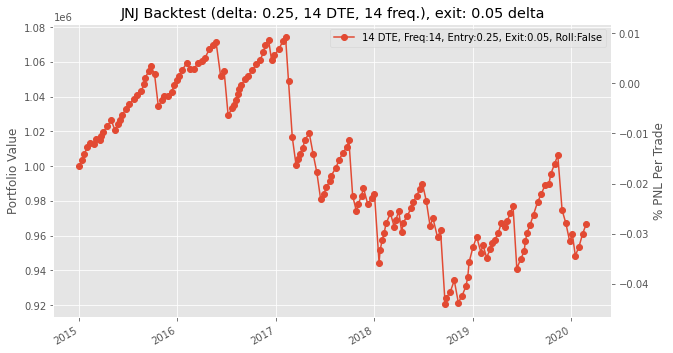

Date 2014-12-31, Expiry: 2015-01-23, Strike: 108.0, Underlying: 104.57, Premium: 0.55, Delta: 0.22607
Bought back call (expiry 2015-01-23 00:00:00, strike = 108.0) on 2015-01-15 for 0.05
PNL 2015-01-15 00:00:00 = 3850.0 (premium = 0.55, exit = 0.05)

Date 2015-01-15, Expiry: 2015-02-06, Strike: 106.0, Underlying: 102.54, Premium: 0.55, Delta: 0.225052
Bought back call (expiry 2015-02-06 00:00:00, strike = 106.0) on 2015-01-29 for 0.04
PNL 2015-01-29 00:00:00 = 3927.0 (premium = 0.55, exit = 0.04)

Date 2015-01-29, Expiry: 2015-02-20, Strike: 105.0, Underlying: 102.425, Premium: 0.45, Delta: 0.220263
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-02-09 for 0.03
PNL 2015-02-09 00:00:00 = 3234.0000000000005 (premium = 0.45, exit = 0.03)

Date 2015-02-09, Expiry: 2015-02-27, Strike: 102.0, Underlying: 99.7399, Premium: 0.44, Delta: 0.224821
Expired call (expiry 2015-02-27 00:00:00, strike = 102.0) on 2015-02-09
Strike was breached- At expiry, underlying is 102.55 , s

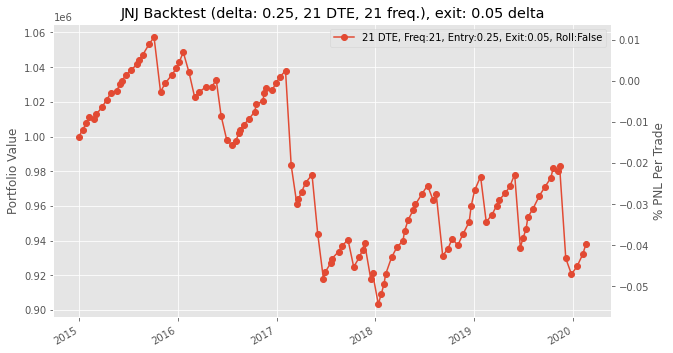

Date 2014-12-31, Expiry: 2015-01-30, Strike: 108.0, Underlying: 104.57, Premium: 0.74, Delta: 0.259889
Bought back call (expiry 2015-01-30 00:00:00, strike = 108.0) on 2015-01-20 for 0.01
PNL 2015-01-20 00:00:00 = 5621.0 (premium = 0.74, exit = 0.01)

Date 2015-01-20, Expiry: 2015-02-20, Strike: 104.0, Underlying: 101.29, Premium: 0.84, Delta: 0.278069
Bought back call (expiry 2015-02-20 00:00:00, strike = 104.0) on 2015-02-11 for 0.04
PNL 2015-02-11 00:00:00 = 6159.999999999999 (premium = 0.84, exit = 0.04)

Date 2015-02-11, Expiry: 2015-03-13, Strike: 103.0, Underlying: 100.29, Premium: 0.57, Delta: 0.230312
Bought back call (expiry 2015-03-13 00:00:00, strike = 103.0) on 2015-03-09 for 0.03
PNL 2015-03-09 00:00:00 = 4157.999999999999 (premium = 0.57, exit = 0.03)

Date 2015-03-09, Expiry: 2015-04-10, Strike: 104.0, Underlying: 100.66, Premium: 0.48, Delta: 0.214769
Bought back call (expiry 2015-04-10 00:00:00, strike = 104.0) on 2015-04-01 for 0.01
PNL 2015-04-01 00:00:00 = 3619.0 (

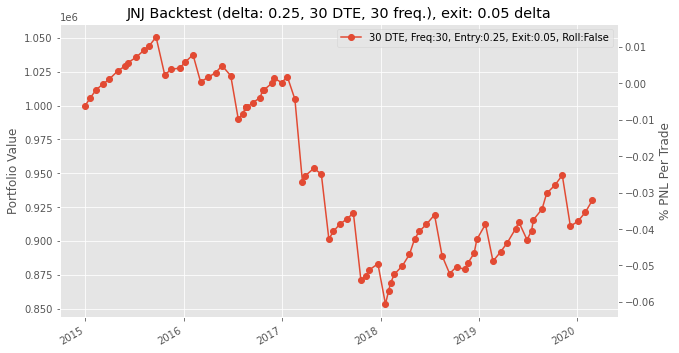

Date 2014-12-31, Expiry: 2015-02-20, Strike: 110.0, Underlying: 104.57, Premium: 0.55, Delta: 0.179046
Bought back call (expiry 2015-02-20 00:00:00, strike = 110.0) on 2015-01-20 for 0.04
PNL 2015-01-20 00:00:00 = 3927.0 (premium = 0.55, exit = 0.04)

Date 2015-01-20, Expiry: 2015-03-20, Strike: 105.0, Underlying: 101.29, Premium: 0.88, Delta: 0.246872
Bought back call (expiry 2015-03-20 00:00:00, strike = 105.0) on 2015-02-13 for 0.05
PNL 2015-02-13 00:00:00 = 6391.0 (premium = 0.88, exit = 0.05)

Date 2015-02-13, Expiry: 2015-04-02, Strike: 103.0, Underlying: 99.6099, Premium: 0.68, Delta: 0.225839
Bought back call (expiry 2015-04-02 00:00:00, strike = 103.0) on 2015-03-27 for 0.02
PNL 2015-03-27 00:00:00 = 5082.0 (premium = 0.68, exit = 0.02)

Date 2015-03-27, Expiry: 2015-05-15, Strike: 105.0, Underlying: 100.34, Premium: 0.69, Delta: 0.220401
Bought back call (expiry 2015-05-15 00:00:00, strike = 105.0) on 2015-04-29 for 0.03
PNL 2015-04-29 00:00:00 = 5081.999999999999 (premium = 

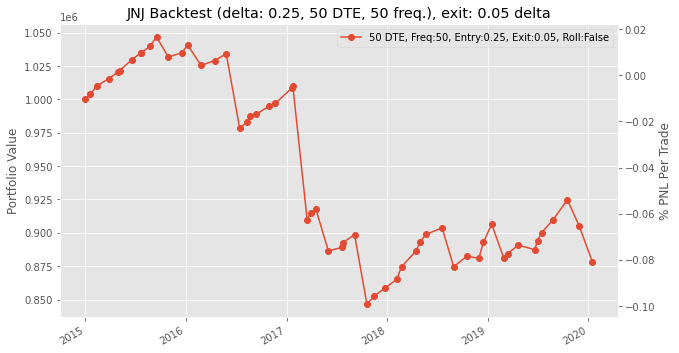

0.250.05 took 155.77515029907227 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 106.0, Underlying: 104.57, Premium: 0.51, Delta: 0.303162
Bought back call (expiry 2015-01-09 00:00:00, strike = 106.0) on 2015-01-05 for 0.12
PNL 2015-01-05 00:00:00 = 3003.0 (premium = 0.51, exit = 0.12)

Date 2015-01-05, Expiry: 2015-01-09, Strike: 105.0, Underlying: 103.79, Premium: 0.36, Delta: 0.292578
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-06 for 0.14
PNL 2015-01-06 00:00:00 = 1693.9999999999998 (premium = 0.36, exit = 0.14)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.28, Premium: 0.39, Delta: 0.342749
Expired call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 104.0
We lost money  PNL 2015-01-09 = -4774.000000000039 (premium = 0.39, exit = 1.0100000000000051)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.31987

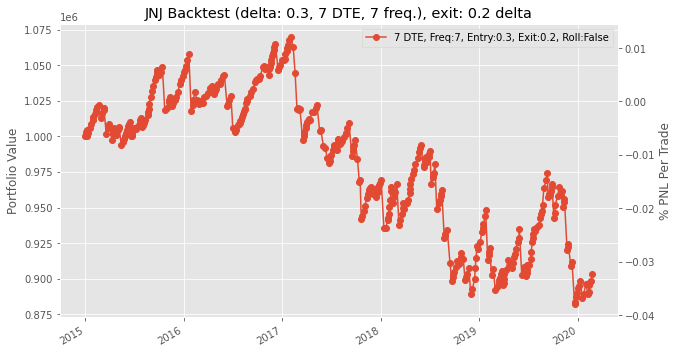

Date 2014-12-31, Expiry: 2015-01-17, Strike: 106.0, Underlying: 104.57, Premium: 0.78, Delta: 0.346231
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-06 for 0.24
PNL 2015-01-06 00:00:00 = 4158.0 (premium = 0.78, exit = 0.24)

Date 2015-01-06, Expiry: 2015-01-17, Strike: 105.0, Underlying: 103.28, Premium: 0.44, Delta: 0.269821
Expired call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-06
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 105.0
PNL 2015-01-17 00:00:00 = 3388.0 (premium = 0.44, exit = 0)

Date 2015-01-16, Expiry: 2015-01-30, Strike: 106.0, Underlying: 104.04, Premium: 0.64, Delta: 0.294691
Bought back call (expiry 2015-01-30 00:00:00, strike = 106.0) on 2015-01-20 for 0.07
PNL 2015-01-20 00:00:00 = 4389.000000000001 (premium = 0.64, exit = 0.07)

Date 2015-01-20, Expiry: 2015-02-06, Strike: 103.0, Underlying: 101.29, Premium: 0.77, Delta: 0.3

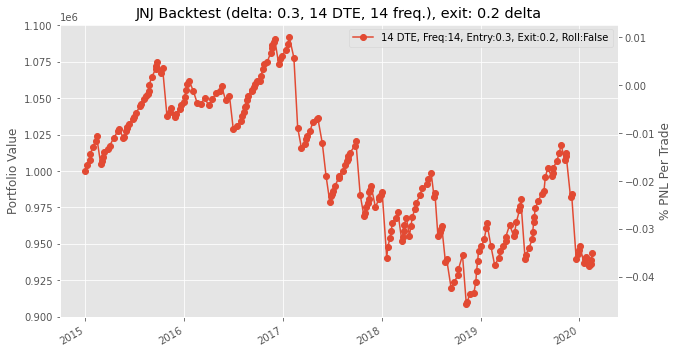

Date 2014-12-31, Expiry: 2015-01-23, Strike: 107.0, Underlying: 104.57, Premium: 0.81, Delta: 0.302863
Bought back call (expiry 2015-01-23 00:00:00, strike = 107.0) on 2015-01-05 for 0.37
PNL 2015-01-05 00:00:00 = 3388.0000000000005 (premium = 0.81, exit = 0.37)

Date 2015-01-05, Expiry: 2015-01-23, Strike: 106.0, Underlying: 103.79, Premium: 0.63, Delta: 0.28807
Bought back call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-15 for 0.2
PNL 2015-01-15 00:00:00 = 3311.0 (premium = 0.63, exit = 0.2)

Date 2015-01-15, Expiry: 2015-02-06, Strike: 105.0, Underlying: 102.54, Premium: 0.81, Delta: 0.301318
Bought back call (expiry 2015-02-06 00:00:00, strike = 105.0) on 2015-01-20 for 0.32
PNL 2015-01-20 00:00:00 = 3773.0000000000005 (premium = 0.81, exit = 0.32)

Date 2015-01-20, Expiry: 2015-02-13, Strike: 104.0, Underlying: 101.29, Premium: 0.72, Delta: 0.271821
Bought back call (expiry 2015-02-13 00:00:00, strike = 104.0) on 2015-01-30 for 0.25
PNL 2015-01-30 00:00:00 = 3619.0 (p

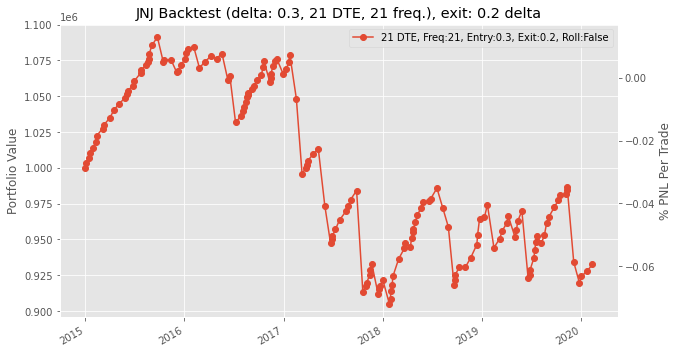

Date 2014-12-31, Expiry: 2015-01-30, Strike: 107.0, Underlying: 104.57, Premium: 1.02, Delta: 0.330746
Bought back call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-15 for 0.28
PNL 2015-01-15 00:00:00 = 5698.0 (premium = 1.02, exit = 0.28)

Date 2015-01-15, Expiry: 2015-02-13, Strike: 105.0, Underlying: 102.54, Premium: 1.05, Delta: 0.328537
Bought back call (expiry 2015-02-13 00:00:00, strike = 105.0) on 2015-01-23 for 0.31
PNL 2015-01-23 00:00:00 = 5698.0 (premium = 1.05, exit = 0.31)

Date 2015-01-23, Expiry: 2015-02-20, Strike: 104.0, Underlying: 102.18, Premium: 0.68, Delta: 0.296133
Bought back call (expiry 2015-02-20 00:00:00, strike = 104.0) on 2015-01-30 for 0.33
PNL 2015-01-30 00:00:00 = 2695.0000000000005 (premium = 0.68, exit = 0.33)

Date 2015-01-30, Expiry: 2015-02-27, Strike: 103.0, Underlying: 100.33, Premium: 0.69, Delta: 0.26621500000000003
Bought back call (expiry 2015-02-27 00:00:00, strike = 103.0) on 2015-02-09 for 0.24
PNL 2015-02-09 00:00:00 = 3464.99

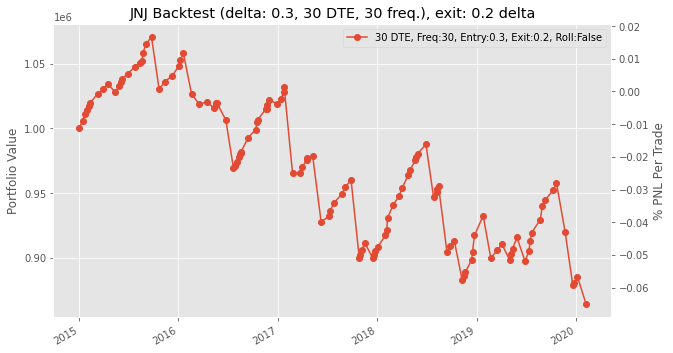

Date 2014-12-31, Expiry: 2015-02-20, Strike: 110.0, Underlying: 104.57, Premium: 0.55, Delta: 0.179046
Bought back call (expiry 2015-02-20 00:00:00, strike = 110.0) on 2015-01-02 for 0.43
PNL 2015-01-02 00:00:00 = 924.0000000000003 (premium = 0.55, exit = 0.43)

Date 2015-01-02, Expiry: 2015-02-20, Strike: 110.0, Underlying: 104.6, Premium: 0.43, Delta: 0.154071
Bought back call (expiry 2015-02-20 00:00:00, strike = 110.0) on 2015-01-05 for 0.36
PNL 2015-01-05 00:00:00 = 539.0 (premium = 0.43, exit = 0.36)

Date 2015-01-05, Expiry: 2015-02-20, Strike: 105.0, Underlying: 103.79, Premium: 1.8, Delta: 0.418191
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-01-26 for 0.34
PNL 2015-01-26 00:00:00 = 11242.0 (premium = 1.8, exit = 0.34)

Date 2015-01-26, Expiry: 2015-03-20, Strike: 105.0, Underlying: 102.26, Premium: 0.63, Delta: 0.242694
Bought back call (expiry 2015-03-20 00:00:00, strike = 105.0) on 2015-01-30 for 0.38
PNL 2015-01-30 00:00:00 = 1925.0 (premium = 0.63

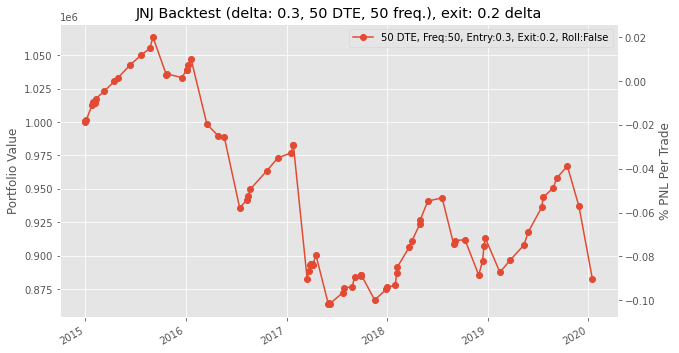

0.30.2 took 192.56238293647766 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 106.0, Underlying: 104.57, Premium: 0.51, Delta: 0.303162
Bought back call (expiry 2015-01-09 00:00:00, strike = 106.0) on 2015-01-06 for 0.04
PNL 2015-01-06 00:00:00 = 3619.0 (premium = 0.51, exit = 0.04)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.28, Premium: 0.39, Delta: 0.342749
Expired call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 104.0
We lost money  PNL 2015-01-09 = -4774.000000000039 (premium = 0.39, exit = 1.0100000000000051)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.319877
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-14 for 0.03
PNL 2015-01-14 00:00:00 = 3003.0 (premium = 0.42, exit = 0.03)

Date 2015-01-14, Expiry: 2015-01-23, Strike: 106.0, Underlying: 103.935, Premium: 0.42, Delta: 0.246474
Expired cal

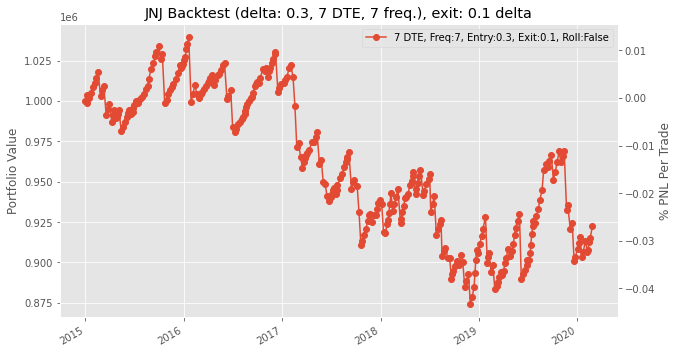

Date 2014-12-31, Expiry: 2015-01-17, Strike: 106.0, Underlying: 104.57, Premium: 0.78, Delta: 0.346231
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-14 for 0.03
PNL 2015-01-14 00:00:00 = 5775.0 (premium = 0.78, exit = 0.03)

Date 2015-01-14, Expiry: 2015-01-30, Strike: 106.0, Underlying: 103.935, Premium: 0.64, Delta: 0.292013
Bought back call (expiry 2015-01-30 00:00:00, strike = 106.0) on 2015-01-20 for 0.07
PNL 2015-01-20 00:00:00 = 4389.000000000001 (premium = 0.64, exit = 0.07)

Date 2015-01-20, Expiry: 2015-02-06, Strike: 103.0, Underlying: 101.29, Premium: 0.77, Delta: 0.323363
Bought back call (expiry 2015-02-06 00:00:00, strike = 103.0) on 2015-02-02 for 0.06
PNL 2015-02-02 00:00:00 = 5467.0 (premium = 0.77, exit = 0.06)

Date 2015-02-02, Expiry: 2015-02-13, Strike: 102.0, Underlying: 100.83, Premium: 0.59, Delta: 0.329102
Bought back call (expiry 2015-02-13 00:00:00, strike = 102.0) on 2015-02-11 for 0.04
PNL 2015-02-11 00:00:00 = 4234.999999999999 

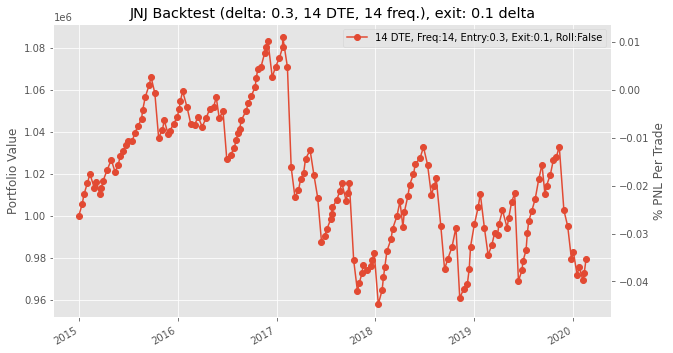

Date 2014-12-31, Expiry: 2015-01-23, Strike: 107.0, Underlying: 104.57, Premium: 0.81, Delta: 0.302863
Bought back call (expiry 2015-01-23 00:00:00, strike = 107.0) on 2015-01-15 for 0.1
PNL 2015-01-15 00:00:00 = 5467.000000000001 (premium = 0.81, exit = 0.1)

Date 2015-01-15, Expiry: 2015-02-06, Strike: 105.0, Underlying: 102.54, Premium: 0.81, Delta: 0.301318
Bought back call (expiry 2015-02-06 00:00:00, strike = 105.0) on 2015-01-30 for 0.02
PNL 2015-01-30 00:00:00 = 6083.0 (premium = 0.81, exit = 0.02)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 102.0, Underlying: 100.33, Premium: 0.83, Delta: 0.321747
Bought back call (expiry 2015-02-20 00:00:00, strike = 102.0) on 2015-02-12 for 0.05
PNL 2015-02-12 00:00:00 = 6005.999999999999 (premium = 0.83, exit = 0.05)

Date 2015-02-12, Expiry: 2015-03-06, Strike: 100.0, Underlying: 98.48, Premium: 0.68, Delta: 0.295833
Expired call (expiry 2015-03-06 00:00:00, strike = 100.0) on 2015-02-12
Strike was breached- At expiry, underlying is 100.

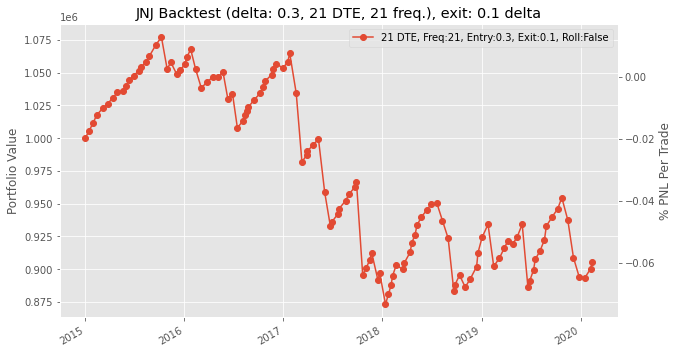

Date 2014-12-31, Expiry: 2015-01-30, Strike: 107.0, Underlying: 104.57, Premium: 1.02, Delta: 0.330746
Bought back call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-20 for 0.03
PNL 2015-01-20 00:00:00 = 7623.0 (premium = 1.02, exit = 0.03)

Date 2015-01-20, Expiry: 2015-02-20, Strike: 104.0, Underlying: 101.29, Premium: 0.84, Delta: 0.278069
Bought back call (expiry 2015-02-20 00:00:00, strike = 104.0) on 2015-02-09 for 0.06
PNL 2015-02-09 00:00:00 = 6006.0 (premium = 0.84, exit = 0.06)

Date 2015-02-09, Expiry: 2015-03-13, Strike: 102.0, Underlying: 99.7399, Premium: 0.73, Delta: 0.273925
Bought back call (expiry 2015-03-13 00:00:00, strike = 102.0) on 2015-03-10 for 0.02
PNL 2015-03-10 00:00:00 = 5467.0 (premium = 0.73, exit = 0.02)

Date 2015-03-10, Expiry: 2015-04-10, Strike: 102.0, Underlying: 99.53, Premium: 0.65, Delta: 0.278118
Bought back call (expiry 2015-04-10 00:00:00, strike = 102.0) on 2015-04-01 for 0.1
PNL 2015-04-01 00:00:00 = 4235.0 (premium = 0.65, exit = 

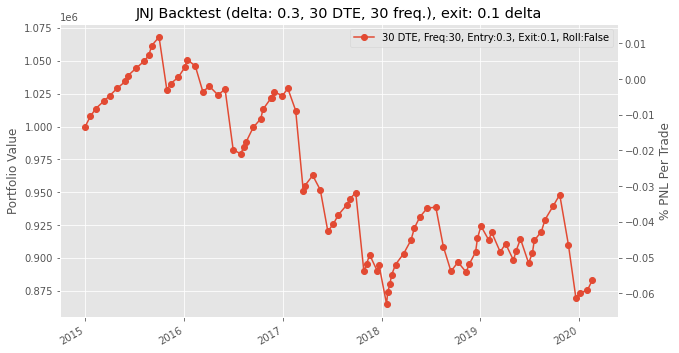

Date 2014-12-31, Expiry: 2015-02-20, Strike: 110.0, Underlying: 104.57, Premium: 0.55, Delta: 0.179046
Bought back call (expiry 2015-02-20 00:00:00, strike = 110.0) on 2015-01-14 for 0.16
PNL 2015-01-14 00:00:00 = 3003.0 (premium = 0.55, exit = 0.16)

Date 2015-01-14, Expiry: 2015-02-27, Strike: 107.0, Underlying: 103.935, Premium: 0.99, Delta: 0.285668
Bought back call (expiry 2015-02-27 00:00:00, strike = 107.0) on 2015-01-23 for 0.16
PNL 2015-01-23 00:00:00 = 6391.0 (premium = 0.99, exit = 0.16)

Date 2015-01-23, Expiry: 2015-03-20, Strike: 105.0, Underlying: 102.18, Premium: 0.53, Delta: 0.226344
Bought back call (expiry 2015-03-20 00:00:00, strike = 105.0) on 2015-02-09 for 0.17
PNL 2015-02-09 00:00:00 = 2772.0 (premium = 0.53, exit = 0.17)

Date 2015-02-09, Expiry: 2015-03-27, Strike: 102.0, Underlying: 99.7399, Premium: 0.92, Delta: 0.2895
Bought back call (expiry 2015-03-27 00:00:00, strike = 102.0) on 2015-03-25 for 0.05
PNL 2015-03-25 00:00:00 = 6699.0 (premium = 0.92, exit =

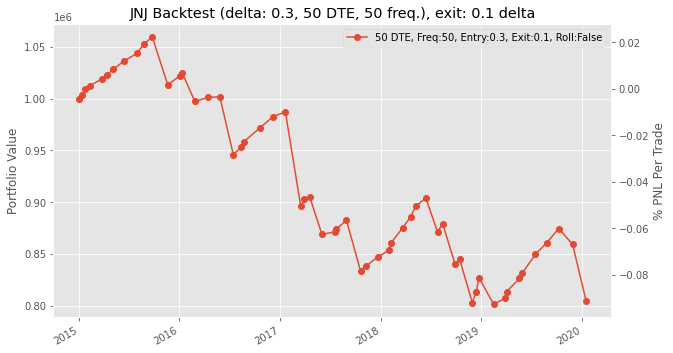

0.30.1 took 159.14653849601746 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 106.0, Underlying: 104.57, Premium: 0.51, Delta: 0.303162
Bought back call (expiry 2015-01-09 00:00:00, strike = 106.0) on 2015-01-05 for 0.12
PNL 2015-01-05 00:00:00 = 3003.0 (premium = 0.51, exit = 0.12)

Date 2015-01-05, Expiry: 2015-01-09, Strike: 105.0, Underlying: 103.79, Premium: 0.36, Delta: 0.292578
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-06 for 0.14
PNL 2015-01-06 00:00:00 = 1693.9999999999998 (premium = 0.36, exit = 0.14)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.28, Premium: 0.39, Delta: 0.342749
Expired call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 104.0
We lost money  PNL 2015-01-09 = -4774.000000000039 (premium = 0.39, exit = 1.0100000000000051)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.319877


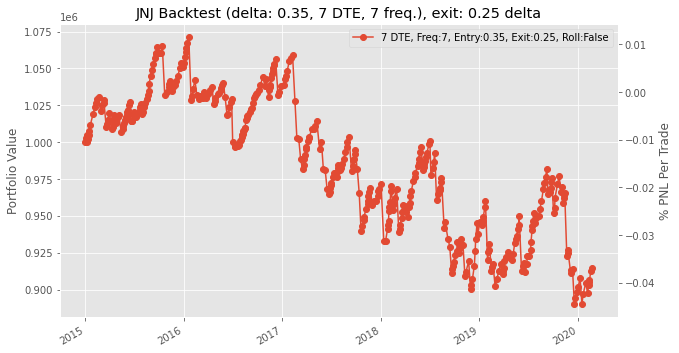

Date 2014-12-31, Expiry: 2015-01-17, Strike: 106.0, Underlying: 104.57, Premium: 0.78, Delta: 0.346231
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-05 for 0.37
PNL 2015-01-05 00:00:00 = 3157.0000000000005 (premium = 0.78, exit = 0.37)

Date 2015-01-05, Expiry: 2015-01-17, Strike: 105.0, Underlying: 103.79, Premium: 0.66, Delta: 0.348671
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-14 for 0.15
PNL 2015-01-14 00:00:00 = 3927.0 (premium = 0.66, exit = 0.15)

Date 2015-01-14, Expiry: 2015-01-30, Strike: 105.0, Underlying: 103.935, Premium: 1.0, Delta: 0.395163
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-20 for 0.15
PNL 2015-01-20 00:00:00 = 6545.0 (premium = 1.0, exit = 0.15)

Date 2015-01-20, Expiry: 2015-02-06, Strike: 103.0, Underlying: 101.29, Premium: 0.77, Delta: 0.323363
Bought back call (expiry 2015-02-06 00:00:00, strike = 103.0) on 2015-01-30 for 0.14
PNL 2015-01-30 00:00:00 = 4851.0 (premium = 0

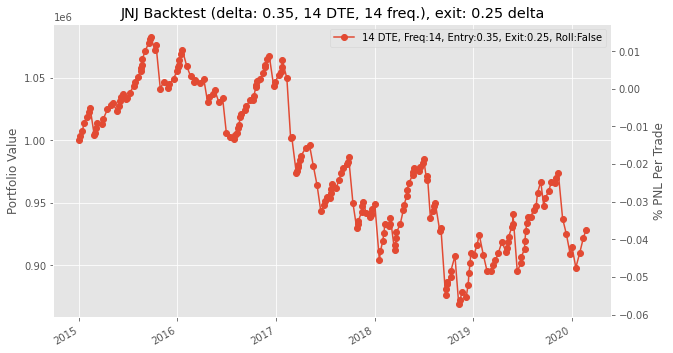

Date 2014-12-31, Expiry: 2015-01-23, Strike: 106.0, Underlying: 104.57, Premium: 1.16, Delta: 0.388243
Bought back call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-06 for 0.48
PNL 2015-01-06 00:00:00 = 5235.999999999999 (premium = 1.16, exit = 0.48)

Date 2015-01-06, Expiry: 2015-01-30, Strike: 105.0, Underlying: 103.28, Premium: 1.0, Delta: 0.353752
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-20 for 0.15
PNL 2015-01-20 00:00:00 = 6545.0 (premium = 1.0, exit = 0.15)

Date 2015-01-20, Expiry: 2015-02-13, Strike: 103.0, Underlying: 101.29, Premium: 1.03, Delta: 0.351902
Bought back call (expiry 2015-02-13 00:00:00, strike = 103.0) on 2015-01-30 for 0.41
PNL 2015-01-30 00:00:00 = 4774.000000000001 (premium = 1.03, exit = 0.41)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 102.0, Underlying: 100.33, Premium: 0.83, Delta: 0.321747
Bought back call (expiry 2015-02-20 00:00:00, strike = 102.0) on 2015-02-09 for 0.29
PNL 2015-02-09 00:00:00 = 4158.0 (pr

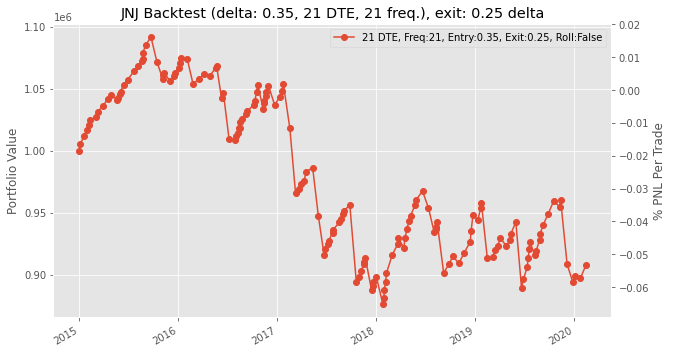

Date 2014-12-31, Expiry: 2015-01-30, Strike: 107.0, Underlying: 104.57, Premium: 1.02, Delta: 0.330746
Bought back call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-06 for 0.47
PNL 2015-01-06 00:00:00 = 4235.0 (premium = 1.02, exit = 0.47)

Date 2015-01-06, Expiry: 2015-02-06, Strike: 105.0, Underlying: 103.28, Premium: 1.21, Delta: 0.37514
Bought back call (expiry 2015-02-06 00:00:00, strike = 105.0) on 2015-01-20 for 0.32
PNL 2015-01-20 00:00:00 = 6852.999999999999 (premium = 1.21, exit = 0.32)

Date 2015-01-20, Expiry: 2015-02-20, Strike: 103.0, Underlying: 101.29, Premium: 1.14, Delta: 0.34783600000000003
Bought back call (expiry 2015-02-20 00:00:00, strike = 103.0) on 2015-01-30 for 0.54
PNL 2015-01-30 00:00:00 = 4619.999999999999 (premium = 1.14, exit = 0.54)

Date 2015-01-30, Expiry: 2015-02-27, Strike: 102.0, Underlying: 100.33, Premium: 1.01, Delta: 0.346724
Bought back call (expiry 2015-02-27 00:00:00, strike = 102.0) on 2015-02-09 for 0.44
PNL 2015-02-09 00:00:00 

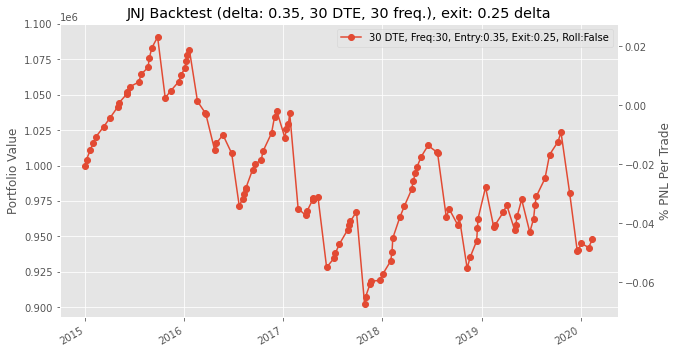

Date 2014-12-31, Expiry: 2015-02-20, Strike: 105.0, Underlying: 104.57, Premium: 2.4, Delta: 0.4763850000000001
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-01-20 for 0.6
PNL 2015-01-20 00:00:00 = 13859.999999999998 (premium = 2.4, exit = 0.6)

Date 2015-01-20, Expiry: 2015-03-20, Strike: 105.0, Underlying: 101.29, Premium: 0.88, Delta: 0.246872
Bought back call (expiry 2015-03-20 00:00:00, strike = 105.0) on 2015-01-23 for 0.53
PNL 2015-01-23 00:00:00 = 2695.0 (premium = 0.88, exit = 0.53)

Date 2015-01-23, Expiry: 2015-03-20, Strike: 105.0, Underlying: 102.18, Premium: 0.53, Delta: 0.226344
Bought back call (expiry 2015-03-20 00:00:00, strike = 105.0) on 2015-01-26 for 0.63
We lost money  PNL 2015-01-26 = -769.9999999999998 (premium = 0.53, exit = 0.63)

Date 2015-01-26, Expiry: 2015-03-20, Strike: 105.0, Underlying: 102.26, Premium: 0.63, Delta: 0.242694
Bought back call (expiry 2015-03-20 00:00:00, strike = 105.0) on 2015-01-27 for 0.56
PNL 2015-01-27 00:00

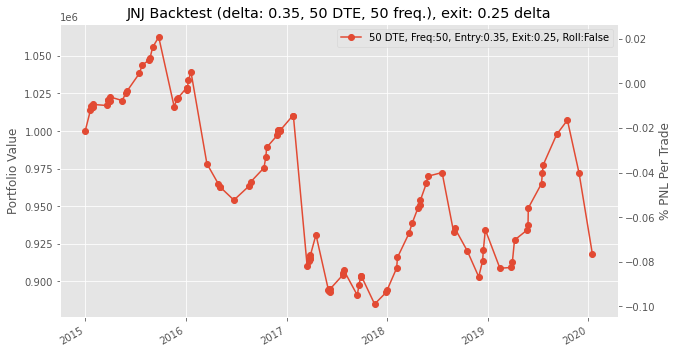

0.350.25 took 201.61182618141174 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 106.0, Underlying: 104.57, Premium: 0.51, Delta: 0.303162
Bought back call (expiry 2015-01-09 00:00:00, strike = 106.0) on 2015-01-05 for 0.12
PNL 2015-01-05 00:00:00 = 3003.0 (premium = 0.51, exit = 0.12)

Date 2015-01-05, Expiry: 2015-01-09, Strike: 105.0, Underlying: 103.79, Premium: 0.36, Delta: 0.292578
Expired call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-05
Strike was breached- At expiry, underlying is 105.01 , strike is 105.0
PNL 2015-01-09 00:00:00 = 2694.9999999999604 (premium = 0.36, exit = 0.010000000000005116)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.319877
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-14 for 0.03
PNL 2015-01-14 00:00:00 = 3003.0 (premium = 0.42, exit = 0.03)

Date 2015-01-14, Expiry: 2015-01-23, Strike: 105.0, Underlying: 103.935, Premium: 0.71, Delta: 0.363936
Bought back c

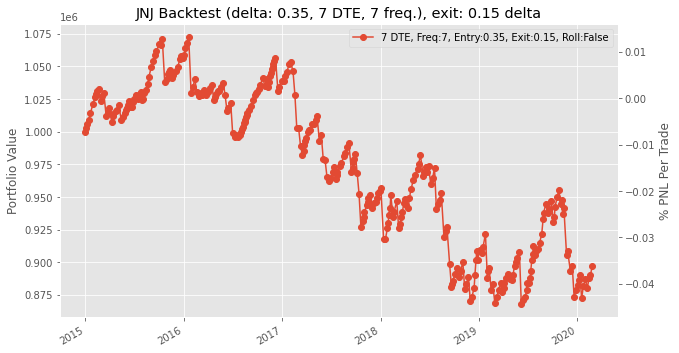

Date 2014-12-31, Expiry: 2015-01-17, Strike: 106.0, Underlying: 104.57, Premium: 0.78, Delta: 0.346231
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-14 for 0.03
PNL 2015-01-14 00:00:00 = 5775.0 (premium = 0.78, exit = 0.03)

Date 2015-01-14, Expiry: 2015-01-30, Strike: 105.0, Underlying: 103.935, Premium: 1.0, Delta: 0.395163
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-20 for 0.15
PNL 2015-01-20 00:00:00 = 6545.0 (premium = 1.0, exit = 0.15)

Date 2015-01-20, Expiry: 2015-02-06, Strike: 103.0, Underlying: 101.29, Premium: 0.77, Delta: 0.323363
Bought back call (expiry 2015-02-06 00:00:00, strike = 103.0) on 2015-01-30 for 0.14
PNL 2015-01-30 00:00:00 = 4851.0 (premium = 0.77, exit = 0.14)

Date 2015-01-30, Expiry: 2015-02-13, Strike: 102.0, Underlying: 100.33, Premium: 0.65, Delta: 0.31848000000000004
Bought back call (expiry 2015-02-13 00:00:00, strike = 102.0) on 2015-02-09 for 0.13
PNL 2015-02-09 00:00:00 = 4004.0 (premium = 0.

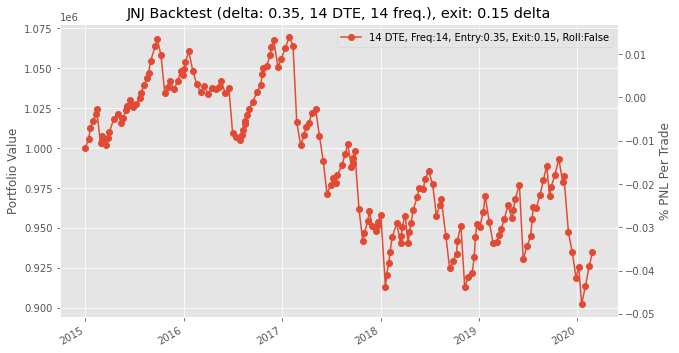

Date 2014-12-31, Expiry: 2015-01-23, Strike: 106.0, Underlying: 104.57, Premium: 1.16, Delta: 0.388243
Bought back call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-15 for 0.2
PNL 2015-01-15 00:00:00 = 7392.0 (premium = 1.16, exit = 0.2)

Date 2015-01-15, Expiry: 2015-02-06, Strike: 104.0, Underlying: 102.54, Premium: 1.18, Delta: 0.387355
Bought back call (expiry 2015-02-06 00:00:00, strike = 104.0) on 2015-01-30 for 0.05
PNL 2015-01-30 00:00:00 = 8701.0 (premium = 1.18, exit = 0.05)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 102.0, Underlying: 100.33, Premium: 0.83, Delta: 0.321747
Bought back call (expiry 2015-02-20 00:00:00, strike = 102.0) on 2015-02-12 for 0.05
PNL 2015-02-12 00:00:00 = 6005.999999999999 (premium = 0.83, exit = 0.05)

Date 2015-02-12, Expiry: 2015-03-06, Strike: 99.5, Underlying: 98.48, Premium: 0.85, Delta: 0.345562
Expired call (expiry 2015-03-06 00:00:00, strike = 99.5) on 2015-02-12
Strike was breached- At expiry, underlying is 100.01 , strike i

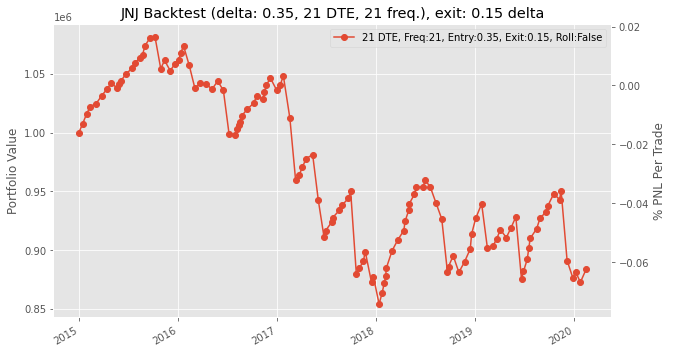

Date 2014-12-31, Expiry: 2015-01-30, Strike: 107.0, Underlying: 104.57, Premium: 1.02, Delta: 0.330746
Bought back call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-15 for 0.28
PNL 2015-01-15 00:00:00 = 5698.0 (premium = 1.02, exit = 0.28)

Date 2015-01-15, Expiry: 2015-02-13, Strike: 105.0, Underlying: 102.54, Premium: 1.05, Delta: 0.328537
Bought back call (expiry 2015-02-13 00:00:00, strike = 105.0) on 2015-01-30 for 0.15
PNL 2015-01-30 00:00:00 = 6930.0 (premium = 1.05, exit = 0.15)

Date 2015-01-30, Expiry: 2015-02-27, Strike: 102.0, Underlying: 100.33, Premium: 1.01, Delta: 0.346724
Bought back call (expiry 2015-02-27 00:00:00, strike = 102.0) on 2015-02-12 for 0.1
PNL 2015-02-12 00:00:00 = 7007.0 (premium = 1.01, exit = 0.1)

Date 2015-02-12, Expiry: 2015-03-13, Strike: 100.0, Underlying: 98.48, Premium: 0.98, Delta: 0.333436
Bought back call (expiry 2015-03-13 00:00:00, strike = 100.0) on 2015-03-11 for 0.08
PNL 2015-03-11 00:00:00 = 6930.0 (premium = 0.98, exit = 0.

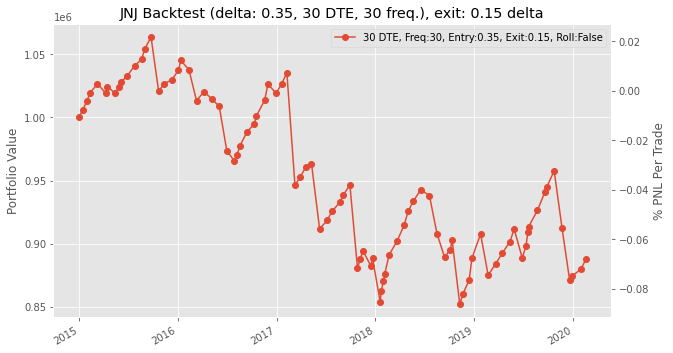

Date 2014-12-31, Expiry: 2015-02-20, Strike: 105.0, Underlying: 104.57, Premium: 2.4, Delta: 0.4763850000000001
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-01-30 for 0.2
PNL 2015-01-30 00:00:00 = 16939.999999999996 (premium = 2.4, exit = 0.2)

Date 2015-01-30, Expiry: 2015-03-20, Strike: 100.0, Underlying: 100.33, Premium: 2.31, Delta: 0.503223
Expired call (expiry 2015-03-20 00:00:00, strike = 100.0) on 2015-01-30
Strike was breached- At expiry, underlying is 102.4 , strike is 100.0
We lost money  PNL 2015-03-20 = -693.0000000000433 (premium = 2.31, exit = 2.4000000000000057)

Date 2015-03-20, Expiry: 2015-05-15, Strike: 105.0, Underlying: 102.4, Premium: 1.08, Delta: 0.326361
Bought back call (expiry 2015-05-15 00:00:00, strike = 105.0) on 2015-04-01 for 0.34
PNL 2015-04-01 00:00:00 = 5698.0 (premium = 1.08, exit = 0.34)

Date 2015-04-01, Expiry: 2015-05-15, Strike: 100.0, Underlying: 98.94, Premium: 1.85, Delta: 0.442802
Expired call (expiry 2015-05-15 00:0

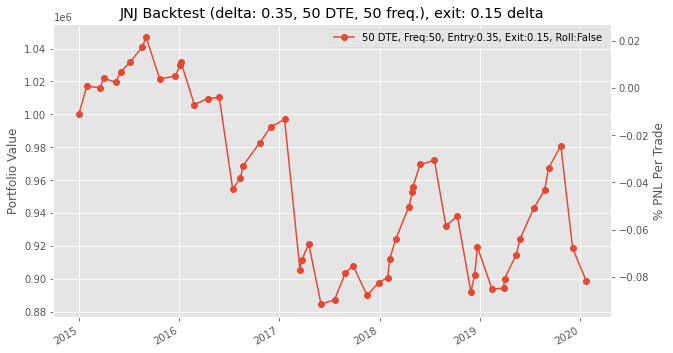

0.350.15 took 164.34434962272644 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 105.0, Underlying: 104.57, Premium: 0.9, Delta: 0.446113
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-05 for 0.36
PNL 2015-01-05 00:00:00 = 4158.0 (premium = 0.9, exit = 0.36)

Date 2015-01-05, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.79, Premium: 0.81, Delta: 0.486189
Expired call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-05
Strike was breached- At expiry, underlying is 105.01 , strike is 104.0
We lost money  PNL 2015-01-09 = -1540.0000000000389 (premium = 0.81, exit = 1.0100000000000051)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.319877
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-12 for 0.14
PNL 2015-01-12 00:00:00 = 2156.0 (premium = 0.42, exit = 0.14)

Date 2015-01-12, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.62, Premium: 0.5, Delta: 0.413486
Bought back 

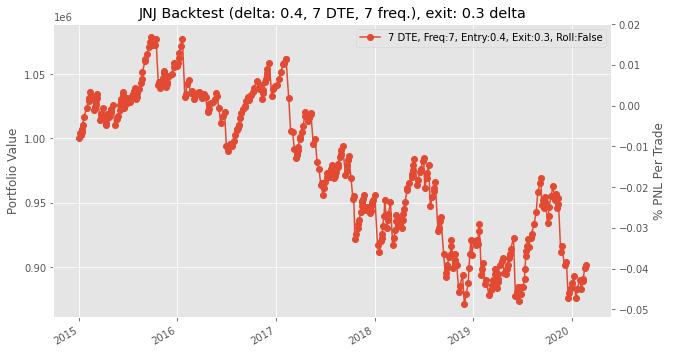

Date 2014-12-31, Expiry: 2015-01-17, Strike: 106.0, Underlying: 104.57, Premium: 0.78, Delta: 0.346231
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-05 for 0.37
PNL 2015-01-05 00:00:00 = 3157.0000000000005 (premium = 0.78, exit = 0.37)

Date 2015-01-05, Expiry: 2015-01-17, Strike: 105.0, Underlying: 103.79, Premium: 0.66, Delta: 0.348671
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-06 for 0.44
PNL 2015-01-06 00:00:00 = 1694.0000000000002 (premium = 0.66, exit = 0.44)

Date 2015-01-06, Expiry: 2015-01-17, Strike: 104.0, Underlying: 103.28, Premium: 0.79, Delta: 0.403261
Bought back call (expiry 2015-01-17 00:00:00, strike = 104.0) on 2015-01-15 for 0.05
PNL 2015-01-15 00:00:00 = 5698.0 (premium = 0.79, exit = 0.05)

Date 2015-01-15, Expiry: 2015-01-30, Strike: 104.0, Underlying: 102.54, Premium: 0.97, Delta: 0.367009
Bought back call (expiry 2015-01-30 00:00:00, strike = 104.0) on 2015-01-20 for 0.31
PNL 2015-01-20 00:00:00 = 5081.9

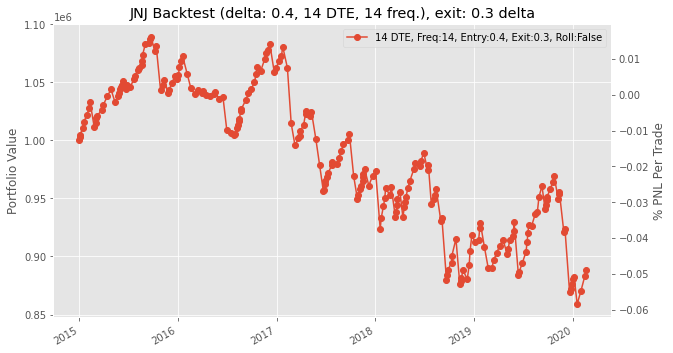

Date 2014-12-31, Expiry: 2015-01-23, Strike: 106.0, Underlying: 104.57, Premium: 1.16, Delta: 0.388243
Bought back call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-05 for 0.63
PNL 2015-01-05 00:00:00 = 4080.9999999999995 (premium = 1.16, exit = 0.63)

Date 2015-01-05, Expiry: 2015-01-23, Strike: 105.0, Underlying: 103.79, Premium: 1.0, Delta: 0.394324
Bought back call (expiry 2015-01-23 00:00:00, strike = 105.0) on 2015-01-15 for 0.35
PNL 2015-01-15 00:00:00 = 5005.0 (premium = 1.0, exit = 0.35)

Date 2015-01-15, Expiry: 2015-02-06, Strike: 104.0, Underlying: 102.54, Premium: 1.18, Delta: 0.387355
Bought back call (expiry 2015-02-06 00:00:00, strike = 104.0) on 2015-01-20 for 0.5
PNL 2015-01-20 00:00:00 = 5235.999999999999 (premium = 1.18, exit = 0.5)

Date 2015-01-20, Expiry: 2015-02-13, Strike: 102.0, Underlying: 101.29, Premium: 1.44, Delta: 0.439022
Bought back call (expiry 2015-02-13 00:00:00, strike = 102.0) on 2015-02-09 for 0.13
PNL 2015-02-09 00:00:00 = 10087.0 (pr

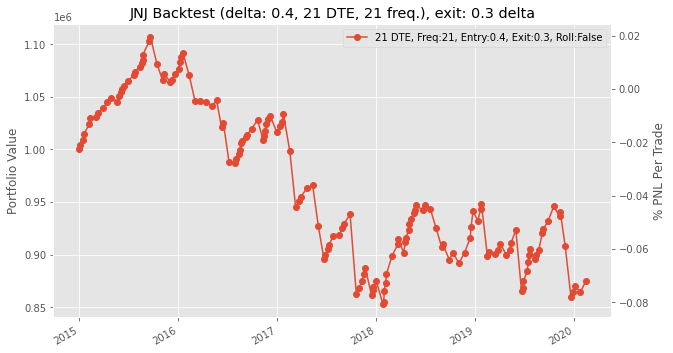

Date 2014-12-31, Expiry: 2015-01-30, Strike: 106.0, Underlying: 104.57, Premium: 1.4, Delta: 0.409227
Bought back call (expiry 2015-01-30 00:00:00, strike = 106.0) on 2015-01-06 for 0.7
PNL 2015-01-06 00:00:00 = 5390.0 (premium = 1.4, exit = 0.7)

Date 2015-01-06, Expiry: 2015-02-06, Strike: 105.0, Underlying: 103.28, Premium: 1.21, Delta: 0.37514
Bought back call (expiry 2015-02-06 00:00:00, strike = 105.0) on 2015-01-20 for 0.32
PNL 2015-01-20 00:00:00 = 6852.999999999999 (premium = 1.21, exit = 0.32)

Date 2015-01-20, Expiry: 2015-02-20, Strike: 102.0, Underlying: 101.29, Premium: 1.51, Delta: 0.4239600000000001
Bought back call (expiry 2015-02-20 00:00:00, strike = 102.0) on 2015-02-09 for 0.29
PNL 2015-02-09 00:00:00 = 9394.0 (premium = 1.51, exit = 0.29)

Date 2015-02-09, Expiry: 2015-03-13, Strike: 100.0, Underlying: 99.7399, Premium: 1.5, Delta: 0.442766
Bought back call (expiry 2015-03-13 00:00:00, strike = 100.0) on 2015-03-11 for 0.08
PNL 2015-03-11 00:00:00 = 10934.0 (premi

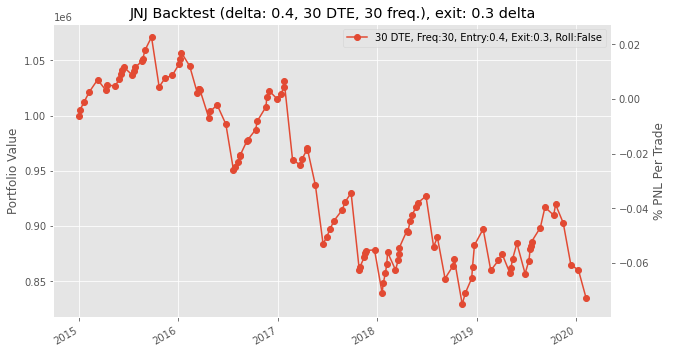

Date 2014-12-31, Expiry: 2015-02-20, Strike: 105.0, Underlying: 104.57, Premium: 2.4, Delta: 0.4763850000000001
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-01-20 for 0.6
PNL 2015-01-20 00:00:00 = 13859.999999999998 (premium = 2.4, exit = 0.6)

Date 2015-01-20, Expiry: 2015-03-20, Strike: 100.0, Underlying: 101.29, Premium: 3.28, Delta: 0.552381
Bought back call (expiry 2015-03-20 00:00:00, strike = 100.0) on 2015-03-11 for 0.39
PNL 2015-03-11 00:00:00 = 22252.999999999996 (premium = 3.28, exit = 0.39)

Date 2015-03-11, Expiry: 2015-04-24, Strike: 100.0, Underlying: 98.32, Premium: 1.45, Delta: 0.4023
Expired call (expiry 2015-04-24 00:00:00, strike = 100.0) on 2015-03-11
Strike was breached- At expiry, underlying is 101.11 , strike is 100.0
PNL 2015-04-24 00:00:00 = 2618.000000000004 (premium = 1.45, exit = 1.1099999999999994)

Date 2015-04-24, Expiry: 2015-06-19, Strike: 100.0, Underlying: 101.11, Premium: 2.35, Delta: 0.560183
Bought back call (expiry 2015-0

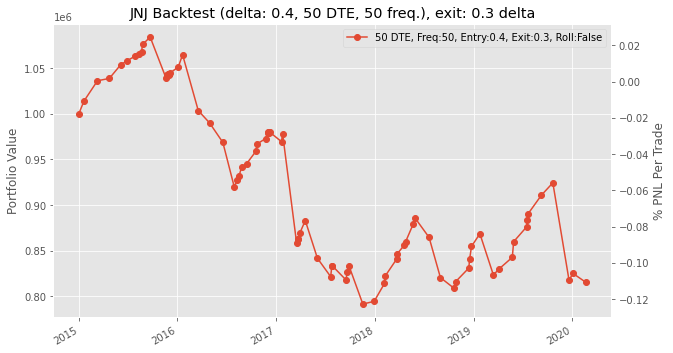

0.40.3 took 194.52813267707825 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 105.0, Underlying: 104.57, Premium: 0.9, Delta: 0.446113
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-06 for 0.14
PNL 2015-01-06 00:00:00 = 5852.0 (premium = 0.9, exit = 0.14)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.28, Premium: 0.39, Delta: 0.342749
Expired call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 104.0
We lost money  PNL 2015-01-09 = -4774.000000000039 (premium = 0.39, exit = 1.0100000000000051)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.319877
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-12 for 0.14
PNL 2015-01-12 00:00:00 = 2156.0 (premium = 0.42, exit = 0.14)

Date 2015-01-12, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.62, Premium: 0.5, Delta: 0.413486
Expired call (e

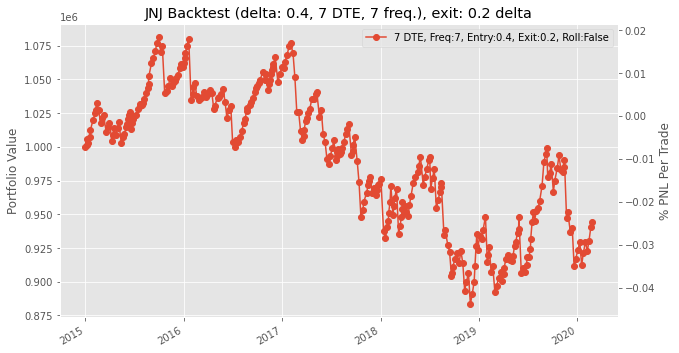

Date 2014-12-31, Expiry: 2015-01-17, Strike: 106.0, Underlying: 104.57, Premium: 0.78, Delta: 0.346231
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-06 for 0.24
PNL 2015-01-06 00:00:00 = 4158.0 (premium = 0.78, exit = 0.24)

Date 2015-01-06, Expiry: 2015-01-17, Strike: 104.0, Underlying: 103.28, Premium: 0.79, Delta: 0.403261
Bought back call (expiry 2015-01-17 00:00:00, strike = 104.0) on 2015-01-15 for 0.05
PNL 2015-01-15 00:00:00 = 5698.0 (premium = 0.79, exit = 0.05)

Date 2015-01-15, Expiry: 2015-01-30, Strike: 104.0, Underlying: 102.54, Premium: 0.97, Delta: 0.367009
Bought back call (expiry 2015-01-30 00:00:00, strike = 104.0) on 2015-01-20 for 0.31
PNL 2015-01-20 00:00:00 = 5081.999999999999 (premium = 0.97, exit = 0.31)

Date 2015-01-20, Expiry: 2015-02-06, Strike: 102.0, Underlying: 101.29, Premium: 1.16, Delta: 0.425526
Expired call (expiry 2015-02-06 00:00:00, strike = 102.0) on 2015-01-20
At expiry, underlying is 100.98 , strike is 102.0
PNL 2015

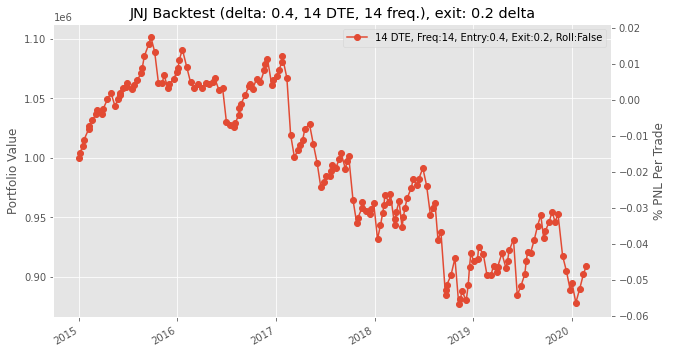

Date 2014-12-31, Expiry: 2015-01-23, Strike: 106.0, Underlying: 104.57, Premium: 1.16, Delta: 0.388243
Bought back call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-15 for 0.2
PNL 2015-01-15 00:00:00 = 7392.0 (premium = 1.16, exit = 0.2)

Date 2015-01-15, Expiry: 2015-02-06, Strike: 104.0, Underlying: 102.54, Premium: 1.18, Delta: 0.387355
Bought back call (expiry 2015-02-06 00:00:00, strike = 104.0) on 2015-01-30 for 0.05
PNL 2015-01-30 00:00:00 = 8701.0 (premium = 1.18, exit = 0.05)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 101.0, Underlying: 100.33, Premium: 1.23, Delta: 0.417642
Bought back call (expiry 2015-02-20 00:00:00, strike = 101.0) on 2015-02-12 for 0.12
PNL 2015-02-12 00:00:00 = 8546.999999999998 (premium = 1.23, exit = 0.12)

Date 2015-02-12, Expiry: 2015-03-06, Strike: 99.0, Underlying: 98.48, Premium: 1.06, Delta: 0.39733
Expired call (expiry 2015-03-06 00:00:00, strike = 99.0) on 2015-02-12
Strike was breached- At expiry, underlying is 100.01 , strike is

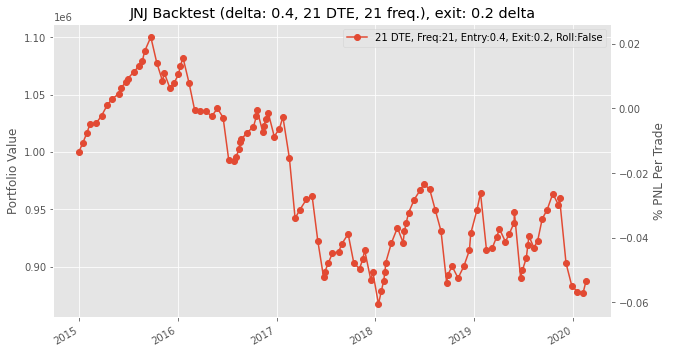

Date 2014-12-31, Expiry: 2015-01-30, Strike: 106.0, Underlying: 104.57, Premium: 1.4, Delta: 0.409227
Bought back call (expiry 2015-01-30 00:00:00, strike = 106.0) on 2015-01-20 for 0.07
PNL 2015-01-20 00:00:00 = 10240.999999999998 (premium = 1.4, exit = 0.07)

Date 2015-01-20, Expiry: 2015-02-20, Strike: 102.0, Underlying: 101.29, Premium: 1.51, Delta: 0.4239600000000001
Bought back call (expiry 2015-02-20 00:00:00, strike = 102.0) on 2015-02-09 for 0.29
PNL 2015-02-09 00:00:00 = 9394.0 (premium = 1.51, exit = 0.29)

Date 2015-02-09, Expiry: 2015-03-13, Strike: 100.0, Underlying: 99.7399, Premium: 1.5, Delta: 0.442766
Bought back call (expiry 2015-03-13 00:00:00, strike = 100.0) on 2015-03-11 for 0.08
PNL 2015-03-11 00:00:00 = 10934.0 (premium = 1.5, exit = 0.08)

Date 2015-03-11, Expiry: 2015-04-10, Strike: 99.5, Underlying: 98.32, Premium: 1.21, Delta: 0.411901
Expired call (expiry 2015-04-10 00:00:00, strike = 99.5) on 2015-03-11
Strike was breached- At expiry, underlying is 101.94

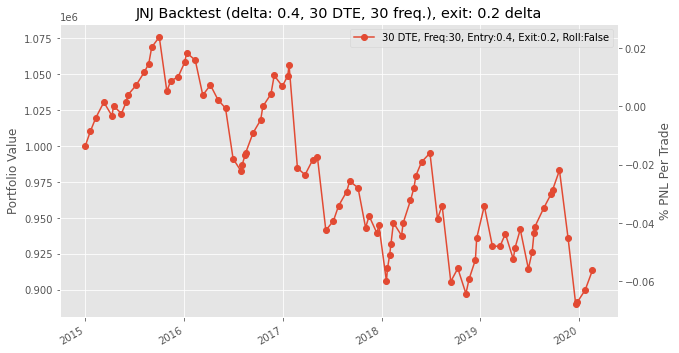

Date 2014-12-31, Expiry: 2015-02-20, Strike: 105.0, Underlying: 104.57, Premium: 2.4, Delta: 0.4763850000000001
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-01-26 for 0.34
PNL 2015-01-26 00:00:00 = 15862.0 (premium = 2.4, exit = 0.34)

Date 2015-01-26, Expiry: 2015-03-20, Strike: 105.0, Underlying: 102.26, Premium: 0.63, Delta: 0.242694
Bought back call (expiry 2015-03-20 00:00:00, strike = 105.0) on 2015-01-30 for 0.38
PNL 2015-01-30 00:00:00 = 1925.0 (premium = 0.63, exit = 0.38)

Date 2015-01-30, Expiry: 2015-03-20, Strike: 100.0, Underlying: 100.33, Premium: 2.31, Delta: 0.503223
Expired call (expiry 2015-03-20 00:00:00, strike = 100.0) on 2015-01-30
Strike was breached- At expiry, underlying is 102.4 , strike is 100.0
We lost money  PNL 2015-03-20 = -693.0000000000433 (premium = 2.31, exit = 2.4000000000000057)

Date 2015-03-20, Expiry: 2015-05-15, Strike: 105.0, Underlying: 102.4, Premium: 1.08, Delta: 0.326361
Bought back call (expiry 2015-05-15 00:00:00

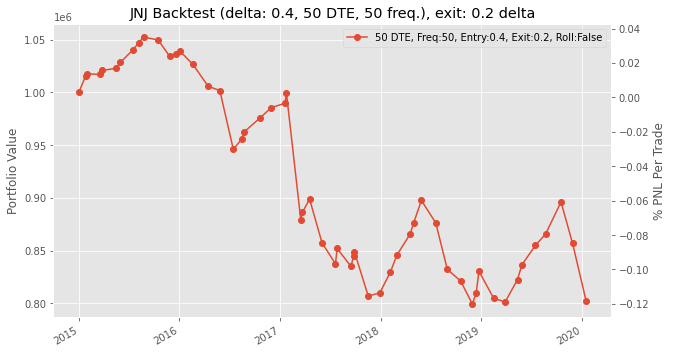

0.40.2 took 165.3415985107422 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 105.0, Underlying: 104.57, Premium: 0.9, Delta: 0.446113
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-05 for 0.36
PNL 2015-01-05 00:00:00 = 4158.0 (premium = 0.9, exit = 0.36)

Date 2015-01-05, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.79, Premium: 0.81, Delta: 0.486189
Bought back call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-06 for 0.39
PNL 2015-01-06 00:00:00 = 3234.0000000000005 (premium = 0.81, exit = 0.39)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.28, Premium: 0.39, Delta: 0.342749
Expired call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 104.0
We lost money  PNL 2015-01-09 = -4774.000000000039 (premium = 0.39, exit = 1.0100000000000051)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 105.0, Underlying: 105.01, Premium: 0.85, Delta: 0.509847
Bou

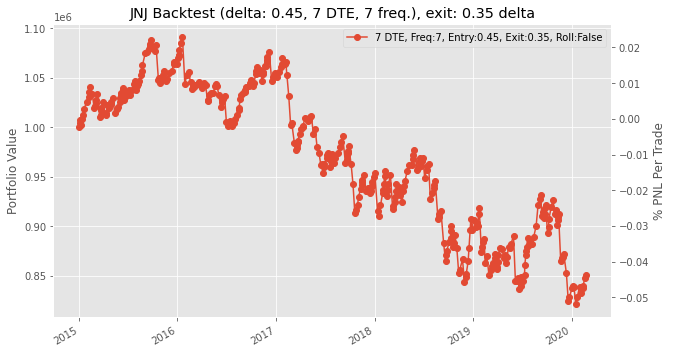

Date 2014-12-31, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 1.23, Delta: 0.45979
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-05 for 0.66
PNL 2015-01-05 00:00:00 = 4389.0 (premium = 1.23, exit = 0.66)

Date 2015-01-05, Expiry: 2015-01-17, Strike: 104.0, Underlying: 103.79, Premium: 1.11, Delta: 0.4842770000000001
Bought back call (expiry 2015-01-17 00:00:00, strike = 104.0) on 2015-01-15 for 0.05
PNL 2015-01-15 00:00:00 = 8162.0 (premium = 1.11, exit = 0.05)

Date 2015-01-15, Expiry: 2015-01-30, Strike: 103.0, Underlying: 102.54, Premium: 1.38, Delta: 0.464808
Bought back call (expiry 2015-01-30 00:00:00, strike = 103.0) on 2015-01-20 for 0.55
PNL 2015-01-20 00:00:00 = 6390.999999999999 (premium = 1.38, exit = 0.55)

Date 2015-01-20, Expiry: 2015-02-06, Strike: 102.0, Underlying: 101.29, Premium: 1.16, Delta: 0.425526
Bought back call (expiry 2015-02-06 00:00:00, strike = 102.0) on 2015-01-30 for 0.32
PNL 2015-01-30 00:00:00 = 6467.99999

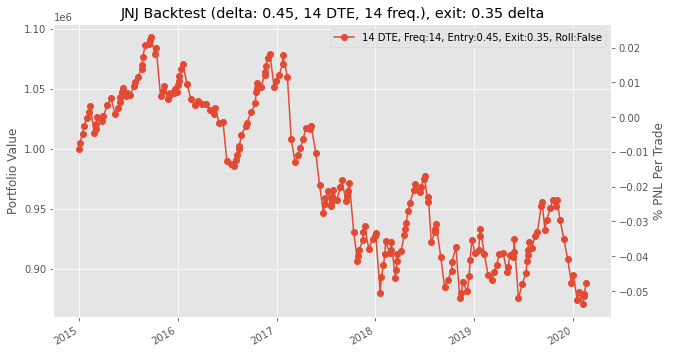

Date 2014-12-31, Expiry: 2015-01-23, Strike: 105.0, Underlying: 104.57, Premium: 1.61, Delta: 0.478491
Bought back call (expiry 2015-01-23 00:00:00, strike = 105.0) on 2015-01-06 for 0.77
PNL 2015-01-06 00:00:00 = 6468.000000000001 (premium = 1.61, exit = 0.77)

Date 2015-01-06, Expiry: 2015-01-30, Strike: 104.0, Underlying: 103.28, Premium: 1.39, Delta: 0.443316
Bought back call (expiry 2015-01-30 00:00:00, strike = 104.0) on 2015-01-20 for 0.31
PNL 2015-01-20 00:00:00 = 8315.999999999998 (premium = 1.39, exit = 0.31)

Date 2015-01-20, Expiry: 2015-02-13, Strike: 102.0, Underlying: 101.29, Premium: 1.44, Delta: 0.439022
Bought back call (expiry 2015-02-13 00:00:00, strike = 102.0) on 2015-01-30 for 0.65
PNL 2015-01-30 00:00:00 = 6082.999999999999 (premium = 1.44, exit = 0.65)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 101.0, Underlying: 100.33, Premium: 1.23, Delta: 0.417642
Bought back call (expiry 2015-02-20 00:00:00, strike = 101.0) on 2015-02-09 for 0.54
PNL 2015-02-09 00:00:00

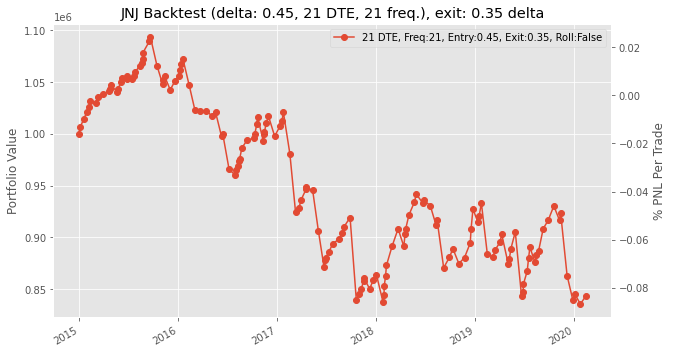

Date 2014-12-31, Expiry: 2015-01-30, Strike: 105.0, Underlying: 104.57, Premium: 1.88, Delta: 0.49021
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-15 for 0.67
PNL 2015-01-15 00:00:00 = 9317.0 (premium = 1.88, exit = 0.67)

Date 2015-01-15, Expiry: 2015-02-13, Strike: 103.0, Underlying: 102.54, Premium: 1.9, Delta: 0.481511
Bought back call (expiry 2015-02-13 00:00:00, strike = 103.0) on 2015-01-30 for 0.41
PNL 2015-01-30 00:00:00 = 11473.0 (premium = 1.9, exit = 0.41)

Date 2015-01-30, Expiry: 2015-02-27, Strike: 101.0, Underlying: 100.33, Premium: 1.41, Delta: 0.4332220000000001
Bought back call (expiry 2015-02-27 00:00:00, strike = 101.0) on 2015-02-09 for 0.74
PNL 2015-02-09 00:00:00 = 5158.999999999999 (premium = 1.41, exit = 0.74)

Date 2015-02-09, Expiry: 2015-03-13, Strike: 100.0, Underlying: 99.7399, Premium: 1.5, Delta: 0.442766
Bought back call (expiry 2015-03-13 00:00:00, strike = 100.0) on 2015-02-12 for 0.98
PNL 2015-02-12 00:00:00 = 4004.0 (pre

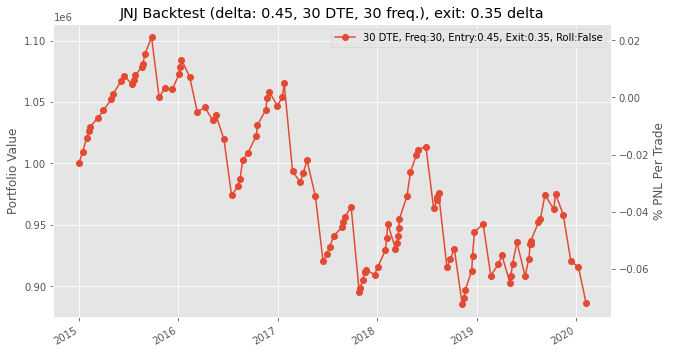

Date 2014-12-31, Expiry: 2015-02-20, Strike: 105.0, Underlying: 104.57, Premium: 2.4, Delta: 0.4763850000000001
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-01-15 for 1.02
PNL 2015-01-15 00:00:00 = 10626.0 (premium = 2.4, exit = 1.02)

Date 2015-01-15, Expiry: 2015-02-27, Strike: 103.0, Underlying: 102.54, Premium: 2.12, Delta: 0.4626
Bought back call (expiry 2015-02-27 00:00:00, strike = 103.0) on 2015-01-20 for 1.19
PNL 2015-01-20 00:00:00 = 7161.000000000001 (premium = 2.12, exit = 1.19)

Date 2015-01-20, Expiry: 2015-03-20, Strike: 100.0, Underlying: 101.29, Premium: 3.28, Delta: 0.552381
Bought back call (expiry 2015-03-20 00:00:00, strike = 100.0) on 2015-02-12 for 1.14
PNL 2015-02-12 00:00:00 = 16477.999999999996 (premium = 3.28, exit = 1.14)

Date 2015-02-12, Expiry: 2015-04-02, Strike: 99.0, Underlying: 98.48, Premium: 1.99, Delta: 0.443561
Expired call (expiry 2015-04-02 00:00:00, strike = 99.0) on 2015-02-12
Strike was breached- At expiry, underlying

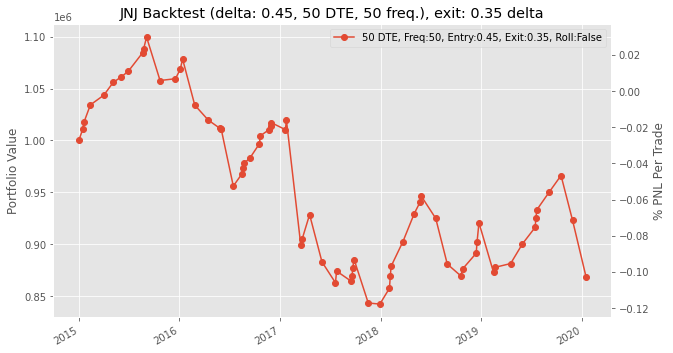

0.450.35 took 191.99158787727356 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 105.0, Underlying: 104.57, Premium: 0.9, Delta: 0.446113
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-06 for 0.14
PNL 2015-01-06 00:00:00 = 5852.0 (premium = 0.9, exit = 0.14)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.28, Premium: 0.39, Delta: 0.342749
Expired call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 104.0
We lost money  PNL 2015-01-09 = -4774.000000000039 (premium = 0.39, exit = 1.0100000000000051)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 105.0, Underlying: 105.01, Premium: 0.85, Delta: 0.509847
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-14 for 0.15
PNL 2015-01-14 00:00:00 = 5390.0 (premium = 0.85, exit = 0.15)

Date 2015-01-14, Expiry: 2015-01-23, Strike: 104.0, Underlying: 103.935, Premium: 1.14, Delta: 0.498414
Bought back

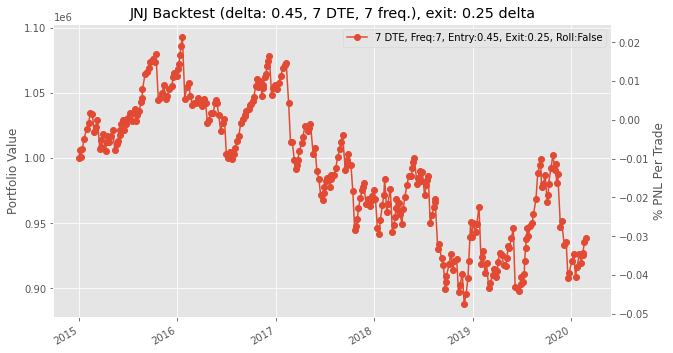

Date 2014-12-31, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 1.23, Delta: 0.45979
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-14 for 0.15
PNL 2015-01-14 00:00:00 = 8316.0 (premium = 1.23, exit = 0.15)

Date 2015-01-14, Expiry: 2015-01-30, Strike: 104.0, Underlying: 103.935, Premium: 1.49, Delta: 0.503792
Bought back call (expiry 2015-01-30 00:00:00, strike = 104.0) on 2015-01-20 for 0.31
PNL 2015-01-20 00:00:00 = 9086.0 (premium = 1.49, exit = 0.31)

Date 2015-01-20, Expiry: 2015-02-06, Strike: 102.0, Underlying: 101.29, Premium: 1.16, Delta: 0.425526
Bought back call (expiry 2015-02-06 00:00:00, strike = 102.0) on 2015-01-30 for 0.32
PNL 2015-01-30 00:00:00 = 6467.999999999999 (premium = 1.16, exit = 0.32)

Date 2015-01-30, Expiry: 2015-02-13, Strike: 101.0, Underlying: 100.33, Premium: 1.02, Delta: 0.436155
Expired call (expiry 2015-02-13 00:00:00, strike = 101.0) on 2015-01-30
At expiry, underlying is 99.6099 , strike is 101.0
PNL 201

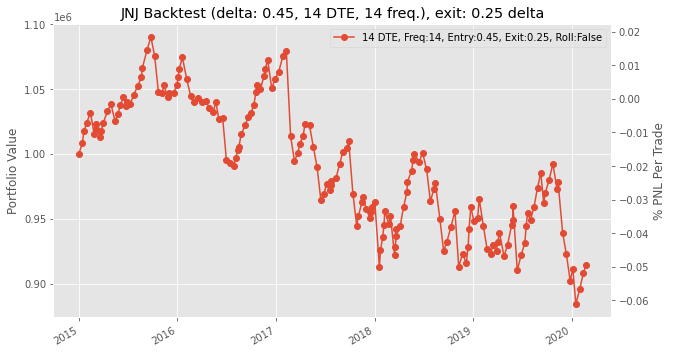

Date 2014-12-31, Expiry: 2015-01-23, Strike: 105.0, Underlying: 104.57, Premium: 1.61, Delta: 0.478491
Bought back call (expiry 2015-01-23 00:00:00, strike = 105.0) on 2015-01-15 for 0.35
PNL 2015-01-15 00:00:00 = 9702.000000000002 (premium = 1.61, exit = 0.35)

Date 2015-01-15, Expiry: 2015-02-06, Strike: 103.0, Underlying: 102.54, Premium: 1.64, Delta: 0.476555
Bought back call (expiry 2015-02-06 00:00:00, strike = 103.0) on 2015-01-30 for 0.14
PNL 2015-01-30 00:00:00 = 11550.0 (premium = 1.64, exit = 0.14)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 101.0, Underlying: 100.33, Premium: 1.23, Delta: 0.417642
Bought back call (expiry 2015-02-20 00:00:00, strike = 101.0) on 2015-02-12 for 0.12
PNL 2015-02-12 00:00:00 = 8546.999999999998 (premium = 1.23, exit = 0.12)

Date 2015-02-12, Expiry: 2015-03-06, Strike: 98.5, Underlying: 98.48, Premium: 1.29, Delta: 0.449499
Expired call (expiry 2015-03-06 00:00:00, strike = 98.5) on 2015-02-12
Strike was breached- At expiry, underlying is 100

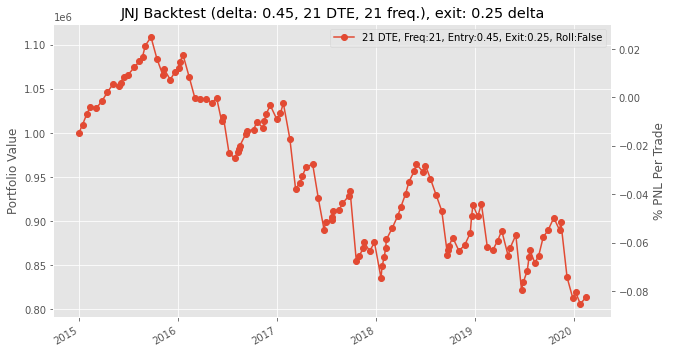

Date 2014-12-31, Expiry: 2015-01-30, Strike: 105.0, Underlying: 104.57, Premium: 1.88, Delta: 0.49021
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-20 for 0.15
PNL 2015-01-20 00:00:00 = 13321.0 (premium = 1.88, exit = 0.15)

Date 2015-01-20, Expiry: 2015-02-20, Strike: 102.0, Underlying: 101.29, Premium: 1.51, Delta: 0.4239600000000001
Bought back call (expiry 2015-02-20 00:00:00, strike = 102.0) on 2015-02-09 for 0.29
PNL 2015-02-09 00:00:00 = 9394.0 (premium = 1.51, exit = 0.29)

Date 2015-02-09, Expiry: 2015-03-13, Strike: 100.0, Underlying: 99.7399, Premium: 1.5, Delta: 0.442766
Bought back call (expiry 2015-03-13 00:00:00, strike = 100.0) on 2015-03-11 for 0.08
PNL 2015-03-11 00:00:00 = 10934.0 (premium = 1.5, exit = 0.08)

Date 2015-03-11, Expiry: 2015-04-10, Strike: 99.0, Underlying: 98.32, Premium: 1.43, Delta: 0.4593100000000001
Expired call (expiry 2015-04-10 00:00:00, strike = 99.0) on 2015-03-11
Strike was breached- At expiry, underlying is 101.94

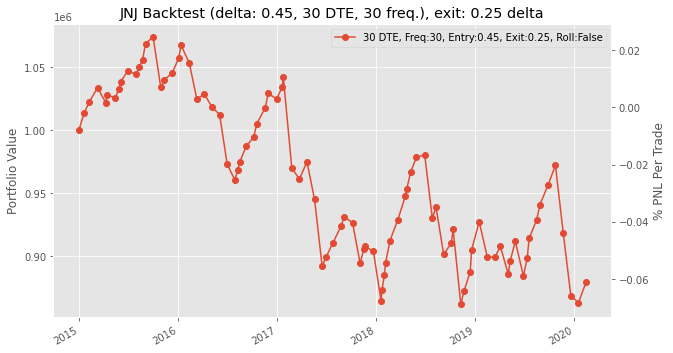

Date 2014-12-31, Expiry: 2015-02-20, Strike: 105.0, Underlying: 104.57, Premium: 2.4, Delta: 0.4763850000000001
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-01-20 for 0.6
PNL 2015-01-20 00:00:00 = 13859.999999999998 (premium = 2.4, exit = 0.6)

Date 2015-01-20, Expiry: 2015-03-20, Strike: 100.0, Underlying: 101.29, Premium: 3.28, Delta: 0.552381
Expired call (expiry 2015-03-20 00:00:00, strike = 100.0) on 2015-01-20
Strike was breached- At expiry, underlying is 102.4 , strike is 100.0
PNL 2015-03-20 00:00:00 = 6775.9999999999545 (premium = 3.28, exit = 2.4000000000000057)

Date 2015-03-20, Expiry: 2015-05-15, Strike: 105.0, Underlying: 102.4, Premium: 1.08, Delta: 0.326361
Bought back call (expiry 2015-05-15 00:00:00, strike = 105.0) on 2015-03-25 for 0.64
PNL 2015-03-25 00:00:00 = 3388.0000000000005 (premium = 1.08, exit = 0.64)

Date 2015-03-25, Expiry: 2015-05-15, Strike: 100.0, Underlying: 100.34, Premium: 2.72, Delta: 0.542808
Expired call (expiry 2015-05-

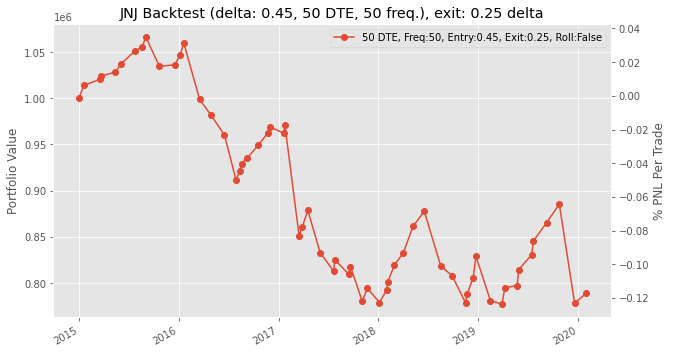

0.450.25 took 165.97891998291016 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 105.0, Underlying: 104.57, Premium: 0.9, Delta: 0.446113
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-05 for 0.36
PNL 2015-01-05 00:00:00 = 4158.0 (premium = 0.9, exit = 0.36)

Date 2015-01-05, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.79, Premium: 0.81, Delta: 0.486189
Bought back call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-06 for 0.39
PNL 2015-01-06 00:00:00 = 3234.0000000000005 (premium = 0.81, exit = 0.39)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 103.0, Underlying: 103.28, Premium: 0.88, Delta: 0.568177
Expired call (expiry 2015-01-09 00:00:00, strike = 103.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 103.0
We lost money  PNL 2015-01-09 = -8701.00000000004 (premium = 0.88, exit = 2.010000000000005)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 105.0, Underlying: 105.01, Premium: 0.85, Delta: 0.509847
Bo

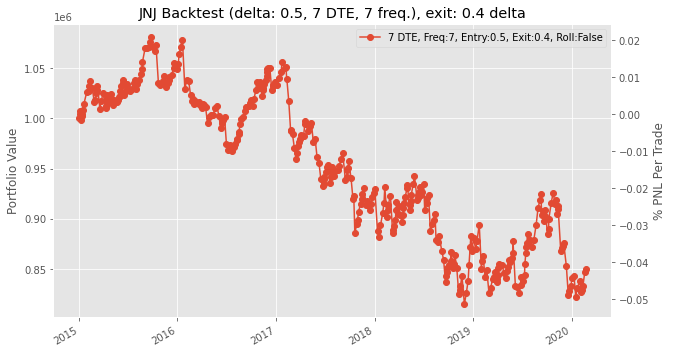

Date 2014-12-31, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 1.23, Delta: 0.45979
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-05 for 0.66
PNL 2015-01-05 00:00:00 = 4389.0 (premium = 1.23, exit = 0.66)

Date 2015-01-05, Expiry: 2015-01-17, Strike: 104.0, Underlying: 103.79, Premium: 1.11, Delta: 0.4842770000000001
Bought back call (expiry 2015-01-17 00:00:00, strike = 104.0) on 2015-01-15 for 0.05
PNL 2015-01-15 00:00:00 = 8162.0 (premium = 1.11, exit = 0.05)

Date 2015-01-15, Expiry: 2015-01-30, Strike: 103.0, Underlying: 102.54, Premium: 1.38, Delta: 0.464808
Bought back call (expiry 2015-01-30 00:00:00, strike = 103.0) on 2015-01-20 for 0.55
PNL 2015-01-20 00:00:00 = 6390.999999999999 (premium = 1.38, exit = 0.55)

Date 2015-01-20, Expiry: 2015-02-06, Strike: 101.0, Underlying: 101.29, Premium: 1.68, Delta: 0.529758
Expired call (expiry 2015-02-06 00:00:00, strike = 101.0) on 2015-01-20
At expiry, underlying is 100.98 , strike is 101.0

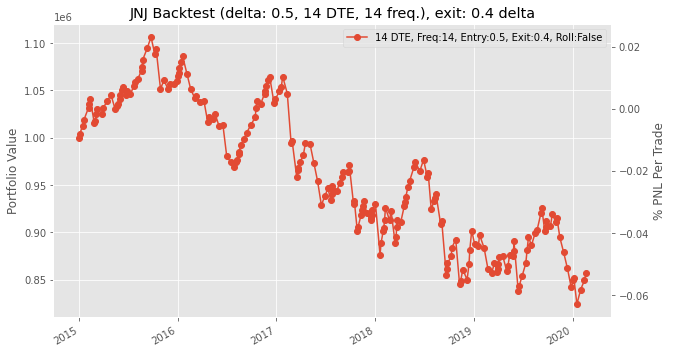

Date 2014-12-31, Expiry: 2015-01-23, Strike: 105.0, Underlying: 104.57, Premium: 1.61, Delta: 0.478491
Bought back call (expiry 2015-01-23 00:00:00, strike = 105.0) on 2015-01-05 for 1.0
PNL 2015-01-05 00:00:00 = 4697.000000000001 (premium = 1.61, exit = 1.0)

Date 2015-01-05, Expiry: 2015-01-23, Strike: 104.0, Underlying: 103.79, Premium: 1.52, Delta: 0.501941
Bought back call (expiry 2015-01-23 00:00:00, strike = 104.0) on 2015-01-15 for 0.61
PNL 2015-01-15 00:00:00 = 7007.0 (premium = 1.52, exit = 0.61)

Date 2015-01-15, Expiry: 2015-02-06, Strike: 103.0, Underlying: 102.54, Premium: 1.64, Delta: 0.476555
Bought back call (expiry 2015-02-06 00:00:00, strike = 103.0) on 2015-01-20 for 0.77
PNL 2015-01-20 00:00:00 = 6698.999999999999 (premium = 1.64, exit = 0.77)

Date 2015-01-20, Expiry: 2015-02-13, Strike: 101.0, Underlying: 101.29, Premium: 1.96, Delta: 0.526828
Bought back call (expiry 2015-02-13 00:00:00, strike = 101.0) on 2015-02-09 for 0.29
PNL 2015-02-09 00:00:00 = 12859.0 (p

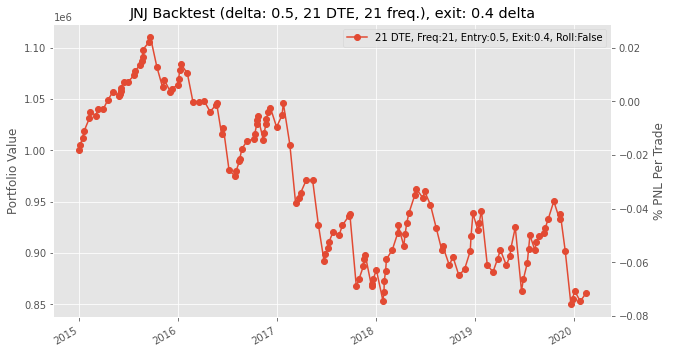

Date 2014-12-31, Expiry: 2015-01-30, Strike: 105.0, Underlying: 104.57, Premium: 1.88, Delta: 0.49021
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-06 for 1.0
PNL 2015-01-06 00:00:00 = 6775.999999999999 (premium = 1.88, exit = 1.0)

Date 2015-01-06, Expiry: 2015-02-06, Strike: 103.0, Underlying: 103.28, Premium: 2.19, Delta: 0.537972
Bought back call (expiry 2015-02-06 00:00:00, strike = 103.0) on 2015-01-20 for 0.77
PNL 2015-01-20 00:00:00 = 10934.0 (premium = 2.19, exit = 0.77)

Date 2015-01-20, Expiry: 2015-02-20, Strike: 101.0, Underlying: 101.29, Premium: 1.95, Delta: 0.5053
Bought back call (expiry 2015-02-20 00:00:00, strike = 101.0) on 2015-02-09 for 0.54
PNL 2015-02-09 00:00:00 = 10857.0 (premium = 1.95, exit = 0.54)

Date 2015-02-09, Expiry: 2015-03-13, Strike: 99.5, Underlying: 99.7399, Premium: 1.75, Delta: 0.485904
Bought back call (expiry 2015-03-13 00:00:00, strike = 99.5) on 2015-02-12 for 1.18
PNL 2015-02-12 00:00:00 = 4389.000000000001 (prem

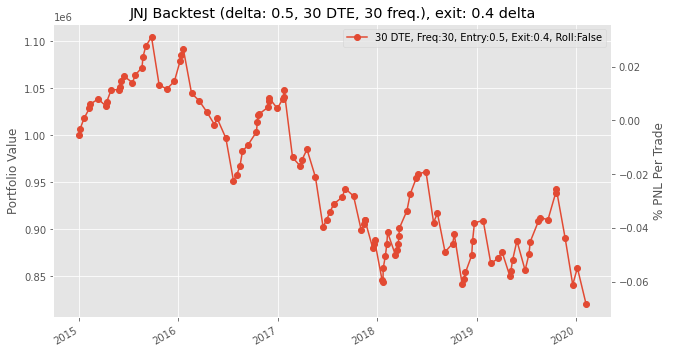

Date 2014-12-31, Expiry: 2015-02-20, Strike: 105.0, Underlying: 104.57, Premium: 2.4, Delta: 0.4763850000000001
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-01-06 for 1.53
PNL 2015-01-06 00:00:00 = 6698.999999999999 (premium = 2.4, exit = 1.53)

Date 2015-01-06, Expiry: 2015-02-20, Strike: 105.0, Underlying: 103.28, Premium: 1.53, Delta: 0.380553
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-01-15 for 1.02
PNL 2015-01-15 00:00:00 = 3927.0 (premium = 1.53, exit = 1.02)

Date 2015-01-15, Expiry: 2015-02-27, Strike: 102.0, Underlying: 102.54, Premium: 2.67, Delta: 0.526439
Bought back call (expiry 2015-02-27 00:00:00, strike = 102.0) on 2015-01-30 for 1.01
PNL 2015-01-30 00:00:00 = 12782.0 (premium = 2.67, exit = 1.01)

Date 2015-01-30, Expiry: 2015-03-20, Strike: 100.0, Underlying: 100.33, Premium: 2.31, Delta: 0.503223
Bought back call (expiry 2015-03-20 00:00:00, strike = 100.0) on 2015-02-12 for 1.14
PNL 2015-02-12 00:00:00 = 9009.00000

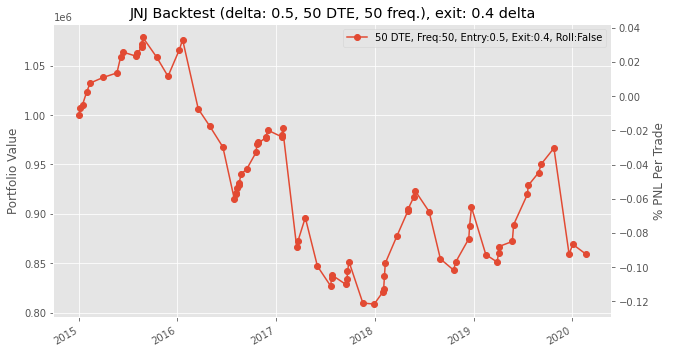

0.50.4 took 192.98124408721924 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 105.0, Underlying: 104.57, Premium: 0.9, Delta: 0.446113
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-05 for 0.36
PNL 2015-01-05 00:00:00 = 4158.0 (premium = 0.9, exit = 0.36)

Date 2015-01-05, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.79, Premium: 0.81, Delta: 0.486189
Expired call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-05
Strike was breached- At expiry, underlying is 105.01 , strike is 104.0
We lost money  PNL 2015-01-09 = -1540.0000000000389 (premium = 0.81, exit = 1.0100000000000051)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 105.0, Underlying: 105.01, Premium: 0.85, Delta: 0.509847
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-14 for 0.15
PNL 2015-01-14 00:00:00 = 5390.0 (premium = 0.85, exit = 0.15)

Date 2015-01-14, Expiry: 2015-01-23, Strike: 104.0, Underlying: 103.935, Premium: 1.14, Delta: 0.498414
Bought back 

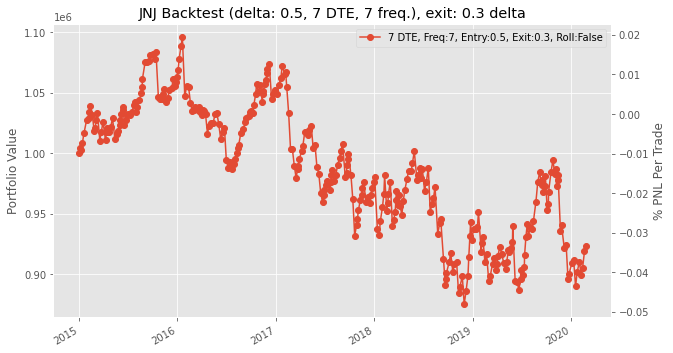

Date 2014-12-31, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 1.23, Delta: 0.45979
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-06 for 0.44
PNL 2015-01-06 00:00:00 = 6083.0 (premium = 1.23, exit = 0.44)

Date 2015-01-06, Expiry: 2015-01-17, Strike: 103.0, Underlying: 103.28, Premium: 1.3, Delta: 0.544387
Expired call (expiry 2015-01-17 00:00:00, strike = 103.0) on 2015-01-06
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available Strike was breached- At expiry, underlying is 104.04 , strike is 103.0
PNL 2015-01-17 00:00:00 = 2001.9999999999523 (premium = 1.3, exit = 1.0400000000000063)

Date 2015-01-16, Expiry: 2015-01-30, Strike: 104.0, Underlying: 104.04, Premium: 1.46, Delta: 0.511944
Bought back call (expiry 2015-01-30 00:00:00, strike = 104.0) on 2015-01-20 for 0.31
PNL 2015-01-20 00:00:00 = 8855.0 (premium = 1.46, exit = 0.31)

Date 2015-01-20, Expiry: 2015-02-06, Strike: 101.0, Underlyin

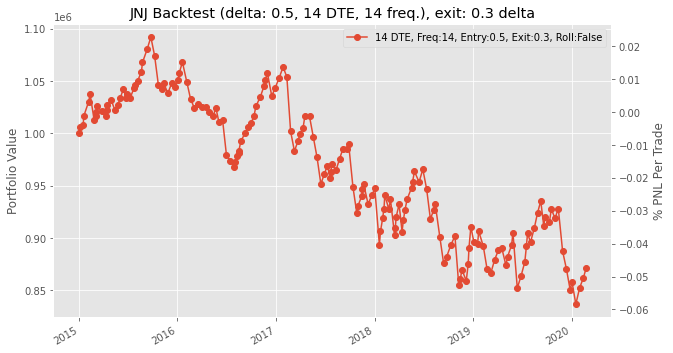

Date 2014-12-31, Expiry: 2015-01-23, Strike: 105.0, Underlying: 104.57, Premium: 1.61, Delta: 0.478491
Bought back call (expiry 2015-01-23 00:00:00, strike = 105.0) on 2015-01-15 for 0.35
PNL 2015-01-15 00:00:00 = 9702.000000000002 (premium = 1.61, exit = 0.35)

Date 2015-01-15, Expiry: 2015-02-06, Strike: 103.0, Underlying: 102.54, Premium: 1.64, Delta: 0.476555
Bought back call (expiry 2015-02-06 00:00:00, strike = 103.0) on 2015-01-30 for 0.14
PNL 2015-01-30 00:00:00 = 11550.0 (premium = 1.64, exit = 0.14)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 100.0, Underlying: 100.33, Premium: 1.72, Delta: 0.515516
Bought back call (expiry 2015-02-20 00:00:00, strike = 100.0) on 2015-02-12 for 0.28
PNL 2015-02-12 00:00:00 = 11088.0 (premium = 1.72, exit = 0.28)

Date 2015-02-12, Expiry: 2015-03-06, Strike: 98.0, Underlying: 98.48, Premium: 1.55, Delta: 0.500698
Expired call (expiry 2015-03-06 00:00:00, strike = 98.0) on 2015-02-12
Strike was breached- At expiry, underlying is 100.01 , stri

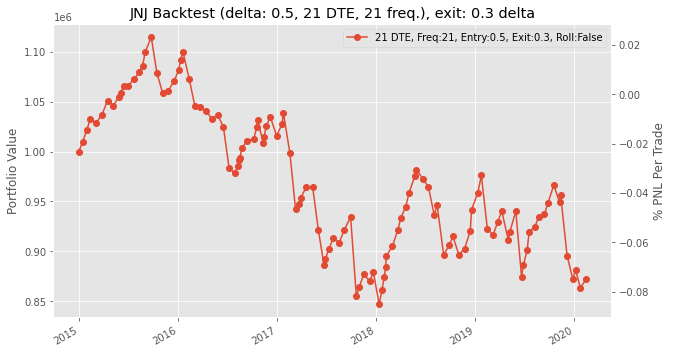

Date 2014-12-31, Expiry: 2015-01-30, Strike: 105.0, Underlying: 104.57, Premium: 1.88, Delta: 0.49021
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-15 for 0.67
PNL 2015-01-15 00:00:00 = 9317.0 (premium = 1.88, exit = 0.67)

Date 2015-01-15, Expiry: 2015-02-13, Strike: 103.0, Underlying: 102.54, Premium: 1.9, Delta: 0.481511
Bought back call (expiry 2015-02-13 00:00:00, strike = 103.0) on 2015-01-30 for 0.41
PNL 2015-01-30 00:00:00 = 11473.0 (premium = 1.9, exit = 0.41)

Date 2015-01-30, Expiry: 2015-02-27, Strike: 100.0, Underlying: 100.33, Premium: 1.92, Delta: 0.520357
Bought back call (expiry 2015-02-27 00:00:00, strike = 100.0) on 2015-02-12 for 0.43
PNL 2015-02-12 00:00:00 = 11473.0 (premium = 1.92, exit = 0.43)

Date 2015-02-12, Expiry: 2015-03-13, Strike: 98.0, Underlying: 98.48, Premium: 1.91, Delta: 0.501951
Expired call (expiry 2015-03-13 00:00:00, strike = 98.0) on 2015-02-12
Strike was breached- At expiry, underlying is 99.21 , strike is 98.0
PNL 

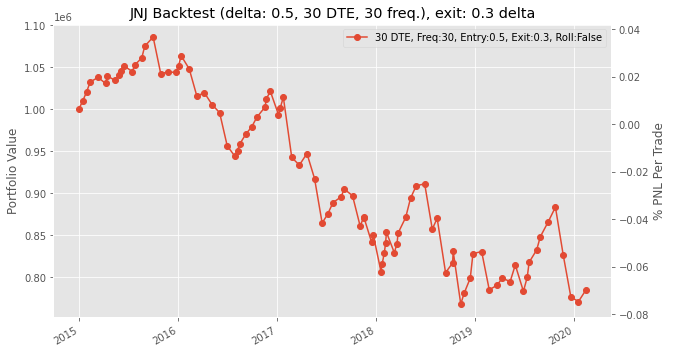

Date 2014-12-31, Expiry: 2015-02-20, Strike: 105.0, Underlying: 104.57, Premium: 2.4, Delta: 0.4763850000000001
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-01-20 for 0.6
PNL 2015-01-20 00:00:00 = 13859.999999999998 (premium = 2.4, exit = 0.6)

Date 2015-01-20, Expiry: 2015-03-20, Strike: 100.0, Underlying: 101.29, Premium: 3.28, Delta: 0.552381
Bought back call (expiry 2015-03-20 00:00:00, strike = 100.0) on 2015-03-11 for 0.39
PNL 2015-03-11 00:00:00 = 22252.999999999996 (premium = 3.28, exit = 0.39)

Date 2015-03-11, Expiry: 2015-04-24, Strike: 98.5, Underlying: 98.32, Premium: 2.19, Delta: 0.515976
Expired call (expiry 2015-04-24 00:00:00, strike = 98.5) on 2015-03-11
Strike was breached- At expiry, underlying is 101.11 , strike is 98.5
We lost money  PNL 2015-04-24 = -3233.999999999996 (premium = 2.19, exit = 2.6099999999999994)

Date 2015-04-24, Expiry: 2015-06-19, Strike: 100.0, Underlying: 101.11, Premium: 2.35, Delta: 0.560183
Bought back call (expiry 

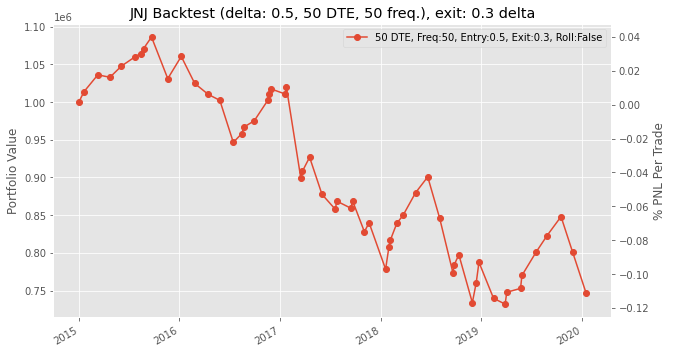

0.50.3 took 169.56813669204712 seconds
    [Entry,Exit]         7        14         21        30        50
0       [0.1, 0]  941210.5  997690.0   971163.5  959613.5  846500.5
1     [0.2, 0.1]  906137.0  954677.8   969046.0  913875.5  850196.5
2     [0.2, 0.0]  954724.0  969315.5  1011742.5  965927.5  797644.0
3   [0.25, 0.15]  928274.5  971741.0   936898.5  915762.0  882575.0
4   [0.25, 0.05]  909409.5  966505.0   938284.5  930199.5  878147.5
5     [0.3, 0.2]  903711.5  943697.6   932586.5  864210.5  882382.5
6     [0.3, 0.1]  922653.5  979394.8   905829.0  883345.0  804651.0
7   [0.35, 0.25]  914984.3  928605.6   908031.2  948102.0  917956.5
8   [0.35, 0.15]  897397.5  934650.1   883583.7  887849.5  898783.5
9     [0.4, 0.3]  901671.0  888103.6   875344.7  834642.5  815238.5
10    [0.4, 0.2]  944483.0  908778.1   887626.2  913644.5  802302.5
11  [0.45, 0.35]  850720.1  887988.1   843697.7  886194.0  868407.0
12  [0.45, 0.25]  938292.2  914745.6   814283.7  879726.0  788789.0
13    [0.

In [ ]:
start = time.time()
# Returns Dataframe
data = {'[Entry,Exit]':[[.1,0]],7:[0]}
returns_df = pd.DataFrame(data)
for i in [7,14,21,30,50]:
    returns_df[i] = [np.float(0)]
for entry in range(4,11):
    for gap in range(1,3):
        data = {f'[Entry,Exit]':[[round(entry * 0.05,2), round((entry) *0.05  - (gap) * 0.1 ,2)]]}
        df2 = pd.DataFrame(data)
        for i in [7,14,21,30,50]:
            df2[i] = [np.float(0)]
        returns_df = pd.concat([returns_df,df2],ignore_index = True)

# Sharpe Dataframe
data = {'[Entry,Exit]':[[.1,0]],7:[0]}
sharpe_df = pd.DataFrame(data)
for i in [7,14,21,30,50]:
    sharpe_df[i] = [np.float(0)]
for entry in range(4,11):
    for gap in range(1,3):
      data = {f'[Entry,Exit]':[[round(entry * 0.05,2), round((entry) *0.05  - (gap) * 0.1 ,2)]]}
      df2 = pd.DataFrame(data)
      for i in [7,14,21,30,50]:
          df2[i] = [np.float(0)]
      sharpe_df = pd.concat([sharpe_df,df2],ignore_index = True)
print(f'Initialization took {time.time()-start} seconds')

for index, row in returns_df.iterrows():
    start = time.time()
    x,entry_exit = list(row.iteritems())[0]
    entry = entry_exit[0]
    exit = entry_exit[1]
    for dte, columnData in list(row.iteritems())[1:]:
        port_backtest = portfolio(start_date = datetime(2015,1,1), end_date = datetime(2020,3,1),df = df, dte_sell = dte, frequency= dte,strike_signal_val = entry, exit_signal_val = exit, roll_positions = False)
        port_backtest.backtest_v2()
        returns_df.at[index,dte] = copy.deepcopy(port_backtest.final_return())
        sharpe_df.at[index,dte] = copy.deepcopy(port_backtest.sharpe())
        plot_returns([port_backtest])
    print(f'{entry}{exit} took {time.time() - start} seconds')

print(returns_df)
print(sharpe_df)

Initialization took 0.14117860794067383 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 117.0, Underlying: 115.09, Premium: 0.1, Delta: 0.127166
At expiry, underlying is 116.39 , strike is 117.0
PNL 2017-01-06 00:00:00 = 770.0 (premium = 0.1, exit = 0)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 119.0, Underlying: 116.39, Premium: 0.13, Delta: 0.120597
At expiry, underlying is 114.64 , strike is 119.0
PNL 2017-01-13 00:00:00 = 1001.0 (premium = 0.13, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 117.0, Underlying: 114.64, Premium: 0.09, Delta: 0.103504
At expiry, underlying is 114.14 , strike is 117.0
PNL 2017-01-20 00:00:00 = 693.0 (premium = 0.09, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 118.0, Underlying: 114.14, Premium: 0.09, Delta: 0.078221
At expiry, underlying is 113.14 , strike is 118.0
PNL 2017-01-27 00:00:00 = 693.0 (premium = 0.09, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Strike: 115.0, Underlying: 113.14, Premium: 0.09, Delta: 0.12148

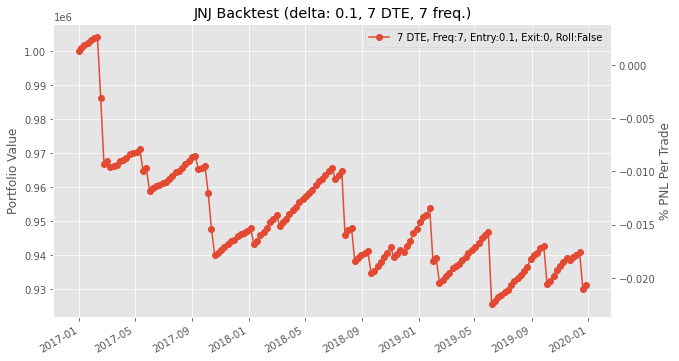

Date 2016-12-30, Expiry: 2017-01-13, Strike: 119.0, Underlying: 115.09, Premium: 0.12, Delta: 0.091823
At expiry, underlying is 114.64 , strike is 119.0
PNL 2017-01-13 00:00:00 = 924.0 (premium = 0.12, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 119.0, Underlying: 114.64, Premium: 0.21, Delta: 0.119949
At expiry, underlying is 113.14 , strike is 119.0
PNL 2017-01-27 00:00:00 = 1617.0 (premium = 0.21, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 116.0, Underlying: 113.14, Premium: 0.15, Delta: 0.126306
At expiry, underlying is 115.33 , strike is 116.0
PNL 2017-02-10 00:00:00 = 1155.0 (premium = 0.15, exit = 0)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 117.0, Underlying: 115.33, Premium: 0.11, Delta: 0.125372
Strike was breached- At expiry, underlying is 122.58 , strike is 117.0
We lost money  PNL 2017-02-24 = -42118.999999999985 (premium = 0.11, exit = 5.579999999999998)

Date 2017-02-24, Expiry: 2017-03-10, Strike: 126.0, Underlying: 122.58, Premium: 0.12, De

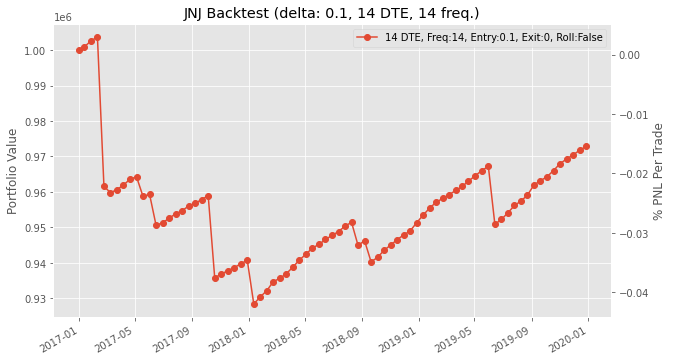

Date 2016-12-30, Expiry: 2017-01-20, Strike: 120.0, Underlying: 115.09, Premium: 0.16, Delta: 0.096521
At expiry, underlying is 114.14 , strike is 120.0
PNL 2017-01-20 00:00:00 = 1232.0 (premium = 0.16, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 119.0, Underlying: 114.14, Premium: 0.17, Delta: 0.099251
At expiry, underlying is 115.33 , strike is 119.0
PNL 2017-02-10 00:00:00 = 1309.0 (premium = 0.17, exit = 0)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 118.0, Underlying: 115.33, Premium: 0.09, Delta: 0.084123
Strike was breached- At expiry, underlying is 123.63 , strike is 118.0
We lost money  PNL 2017-03-03 = -42657.99999999996 (premium = 0.09, exit = 5.6299999999999955)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 128.0, Underlying: 123.63, Premium: 0.17, Delta: 0.105138
At expiry, underlying is 125.56 , strike is 128.0
PNL 2017-03-24 00:00:00 = 1309.0 (premium = 0.17, exit = 0)

Date 2017-03-24, Expiry: 2017-04-13, Strike: 130.0, Underlying: 125.56, Premium: 0.22, D

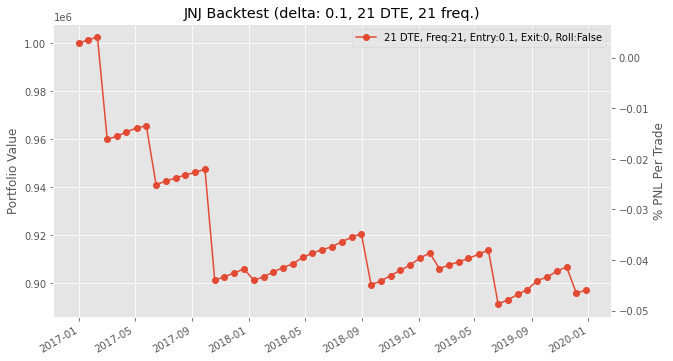

Date 2016-12-30, Expiry: 2017-01-27, Strike: 122.0, Underlying: 115.09, Premium: 0.2, Delta: 0.089556
At expiry, underlying is 113.14 , strike is 122.0
PNL 2017-01-27 00:00:00 = 1540.0 (premium = 0.2, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 117.0, Underlying: 113.14, Premium: 0.19, Delta: 0.118349
Strike was breached- At expiry, underlying is 122.58 , strike is 117.0
We lost money  PNL 2017-02-24 = -41502.999999999985 (premium = 0.19, exit = 5.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 128.0, Underlying: 122.58, Premium: 0.15, Delta: 0.086417
At expiry, underlying is 125.56 , strike is 128.0
PNL 2017-03-24 00:00:00 = 1155.0 (premium = 0.15, exit = 0)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 132.0, Underlying: 125.56, Premium: 0.17, Delta: 0.08391
At expiry, underlying is 121.985 , strike is 132.0
PNL 2017-04-21 00:00:00 = 1309.0 (premium = 0.17, exit = 0)

Date 2017-04-21, Expiry: 2017-05-19, Strike: 130.0, Underlying: 121.985, Premium: 0.01, De

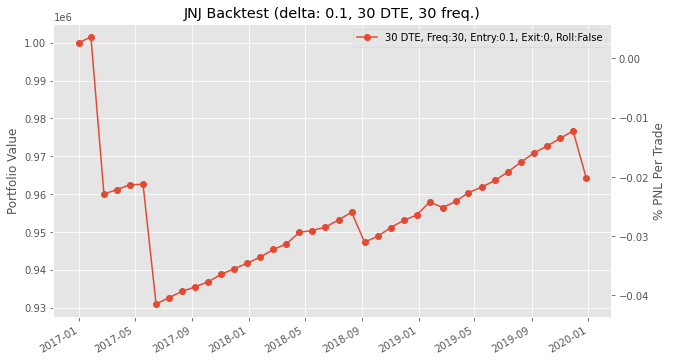

Date 2016-12-30, Expiry: 2017-02-17, Strike: 125.0, Underlying: 115.09, Premium: 0.2, Delta: 0.070937
At expiry, underlying is 118.42 , strike is 125.0
PNL 2017-02-17 00:00:00 = 1540.0 (premium = 0.2, exit = 0)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 123.0, Underlying: 118.42, Premium: 0.19, Delta: 0.102978
Strike was breached- At expiry, underlying is 124.65 , strike is 123.0
We lost money  PNL 2017-03-31 = -11242.000000000044 (premium = 0.19, exit = 1.6500000000000057)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 130.0, Underlying: 124.65, Premium: 0.37, Delta: 0.14794000000000002
At expiry, underlying is 126.87 , strike is 130.0
PNL 2017-05-19 00:00:00 = 2849.0 (premium = 0.37, exit = 0)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 133.0, Underlying: 126.87, Premium: 0.21, Delta: 0.092878
At expiry, underlying is 132.73 , strike is 133.0
PNL 2017-06-30 00:00:00 = 1617.0 (premium = 0.21, exit = 0)

Date 2017-06-30, Expiry: 2017-08-18, Strike: 140.0, Underlying: 132.73, Premiu

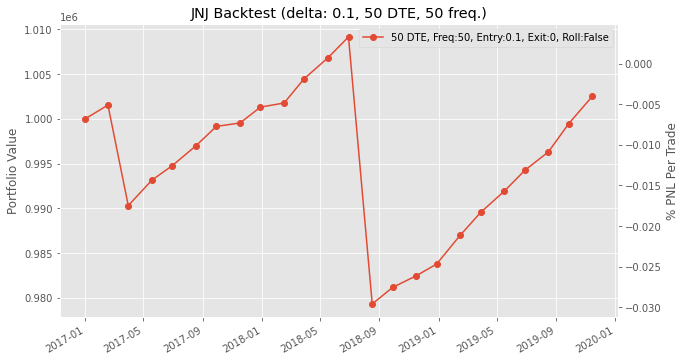

0.10 took 79.52454829216003 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 117.0, Underlying: 115.09, Premium: 0.1, Delta: 0.127166
At expiry, underlying is 116.39 , strike is 117.0
PNL 2017-01-06 00:00:00 = 770.0 (premium = 0.1, exit = 0)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 118.0, Underlying: 116.39, Premium: 0.27, Delta: 0.225601
At expiry, underlying is 114.64 , strike is 118.0
PNL 2017-01-13 00:00:00 = 2079.0 (premium = 0.27, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 116.0, Underlying: 114.64, Premium: 0.24, Delta: 0.231537
At expiry, underlying is 114.14 , strike is 116.0
PNL 2017-01-20 00:00:00 = 1848.0 (premium = 0.24, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.14, Premium: 0.39, Delta: 0.24824
At expiry, underlying is 113.14 , strike is 116.0
PNL 2017-01-27 00:00:00 = 3003.0 (premium = 0.39, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Strike: 115.0, Underlying: 113.14, Premium: 0.09, Delta: 0.121483
At expiry

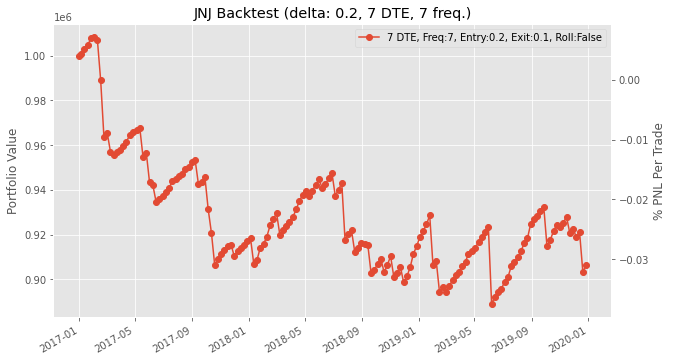

Date 2016-12-30, Expiry: 2017-01-13, Strike: 118.0, Underlying: 115.09, Premium: 0.27, Delta: 0.171293
At expiry, underlying is 114.64 , strike is 118.0
PNL 2017-01-13 00:00:00 = 2079.0 (premium = 0.27, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 118.0, Underlying: 114.64, Premium: 0.35, Delta: 0.181778
At expiry, underlying is 113.14 , strike is 118.0
PNL 2017-01-27 00:00:00 = 2695.0 (premium = 0.35, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 115.0, Underlying: 113.14, Premium: 0.32, Delta: 0.230397
Strike was breached- At expiry, underlying is 115.33 , strike is 115.0
We lost money  PNL 2017-02-10 = -76.99999999998681 (premium = 0.32, exit = 0.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 117.0, Underlying: 115.33, Premium: 0.11, Delta: 0.125372
Strike was breached- At expiry, underlying is 122.58 , strike is 117.0
We lost money  PNL 2017-02-24 = -42118.999999999985 (premium = 0.11, exit = 5.579999999999998)

Date 2017-02-24, Expiry: 2017-03

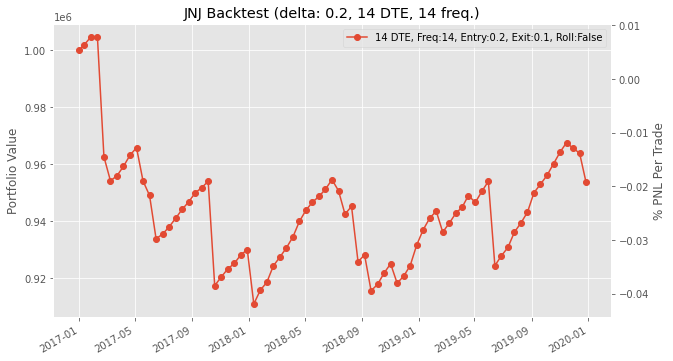

Date 2016-12-30, Expiry: 2017-01-20, Strike: 118.0, Underlying: 115.09, Premium: 0.43, Delta: 0.21633400000000005
At expiry, underlying is 114.14 , strike is 118.0
PNL 2017-01-20 00:00:00 = 3311.0 (premium = 0.43, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 117.0, Underlying: 114.14, Premium: 0.47, Delta: 0.226569
At expiry, underlying is 115.33 , strike is 117.0
PNL 2017-02-10 00:00:00 = 3619.0 (premium = 0.47, exit = 0)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 117.0, Underlying: 115.33, Premium: 0.24, Delta: 0.186113
Strike was breached- At expiry, underlying is 123.63 , strike is 117.0
We lost money  PNL 2017-03-03 = -49202.99999999996 (premium = 0.24, exit = 6.6299999999999955)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 127.0, Underlying: 123.63, Premium: 0.29, Delta: 0.16639
At expiry, underlying is 125.56 , strike is 127.0
PNL 2017-03-24 00:00:00 = 2233.0 (premium = 0.29, exit = 0)

Date 2017-03-24, Expiry: 2017-04-13, Strike: 129.0, Underlying: 125.56, Premiu

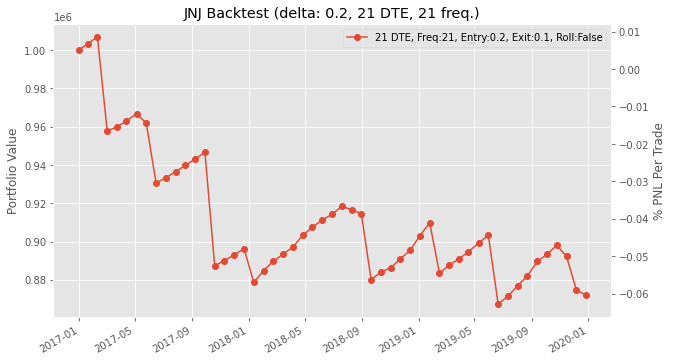

Date 2016-12-30, Expiry: 2017-01-27, Strike: 119.0, Underlying: 115.09, Premium: 0.61, Delta: 0.223913
At expiry, underlying is 113.14 , strike is 119.0
PNL 2017-01-27 00:00:00 = 4697.0 (premium = 0.61, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 116.0, Underlying: 113.14, Premium: 0.35, Delta: 0.189234
Strike was breached- At expiry, underlying is 122.58 , strike is 116.0
We lost money  PNL 2017-02-24 = -47970.99999999999 (premium = 0.35, exit = 6.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 126.0, Underlying: 122.58, Premium: 0.41, Delta: 0.193457
At expiry, underlying is 125.56 , strike is 126.0
PNL 2017-03-24 00:00:00 = 3157.0 (premium = 0.41, exit = 0)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 130.0, Underlying: 125.56, Premium: 0.43, Delta: 0.17738900000000002
At expiry, underlying is 121.985 , strike is 130.0
PNL 2017-04-21 00:00:00 = 3311.0 (premium = 0.43, exit = 0)

Date 2017-04-21, Expiry: 2017-05-19, Strike: 125.0, Underlying: 121.985, Prem

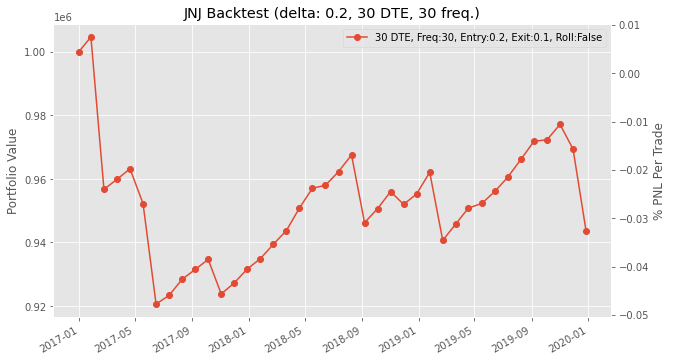

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
At expiry, underlying is 118.42 , strike is 120.0
PNL 2017-02-17 00:00:00 = 6314.0 (premium = 0.82, exit = 0)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 121.0, Underlying: 118.42, Premium: 0.47, Delta: 0.213277
Strike was breached- At expiry, underlying is 124.65 , strike is 121.0
We lost money  PNL 2017-03-31 = -24486.000000000047 (premium = 0.47, exit = 3.6500000000000057)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 130.0, Underlying: 124.65, Premium: 0.37, Delta: 0.14794000000000002
At expiry, underlying is 126.87 , strike is 130.0
PNL 2017-05-19 00:00:00 = 2849.0 (premium = 0.37, exit = 0)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 130.0, Underlying: 126.87, Premium: 0.63, Delta: 0.226856
Strike was breached- At expiry, underlying is 132.73 , strike is 130.0
We lost money  PNL 2017-06-30 = -16169.999999999922 (premium = 0.63, exit = 2.7299999999999898)

Date 2017-06-30, Ex

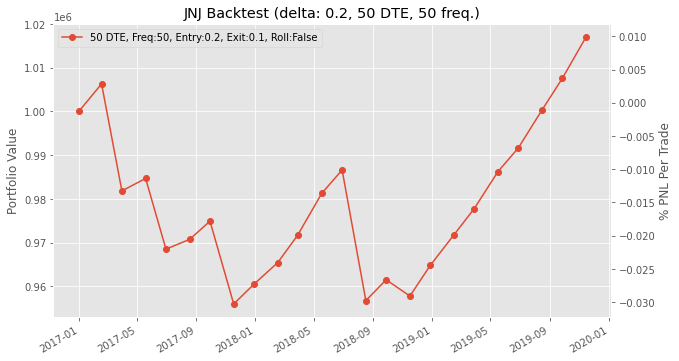

0.20.1 took 79.90358471870422 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 117.0, Underlying: 115.09, Premium: 0.1, Delta: 0.127166
At expiry, underlying is 116.39 , strike is 117.0
PNL 2017-01-06 00:00:00 = 770.0 (premium = 0.1, exit = 0)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 118.0, Underlying: 116.39, Premium: 0.27, Delta: 0.225601
At expiry, underlying is 114.64 , strike is 118.0
PNL 2017-01-13 00:00:00 = 2079.0 (premium = 0.27, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 116.0, Underlying: 114.64, Premium: 0.24, Delta: 0.231537
At expiry, underlying is 114.14 , strike is 116.0
PNL 2017-01-20 00:00:00 = 1848.0 (premium = 0.24, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.14, Premium: 0.39, Delta: 0.24824
At expiry, underlying is 113.14 , strike is 116.0
PNL 2017-01-27 00:00:00 = 3003.0 (premium = 0.39, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Strike: 115.0, Underlying: 113.14, Premium: 0.09, Delta: 0.121483
At expi

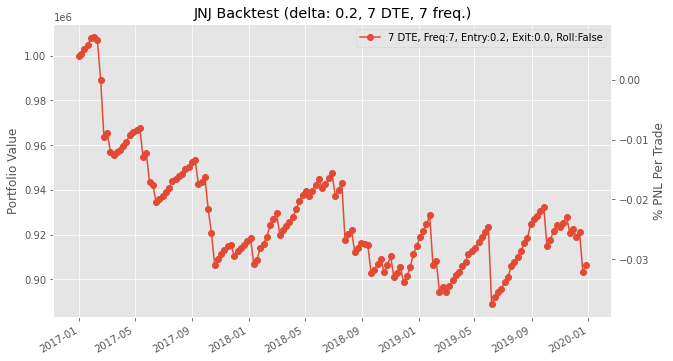

Date 2016-12-30, Expiry: 2017-01-13, Strike: 118.0, Underlying: 115.09, Premium: 0.27, Delta: 0.171293
At expiry, underlying is 114.64 , strike is 118.0
PNL 2017-01-13 00:00:00 = 2079.0 (premium = 0.27, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 118.0, Underlying: 114.64, Premium: 0.35, Delta: 0.181778
At expiry, underlying is 113.14 , strike is 118.0
PNL 2017-01-27 00:00:00 = 2695.0 (premium = 0.35, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 115.0, Underlying: 113.14, Premium: 0.32, Delta: 0.230397
Strike was breached- At expiry, underlying is 115.33 , strike is 115.0
We lost money  PNL 2017-02-10 = -76.99999999998681 (premium = 0.32, exit = 0.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 117.0, Underlying: 115.33, Premium: 0.11, Delta: 0.125372
Strike was breached- At expiry, underlying is 122.58 , strike is 117.0
We lost money  PNL 2017-02-24 = -42118.999999999985 (premium = 0.11, exit = 5.579999999999998)

Date 2017-02-24, Expiry: 2017-03

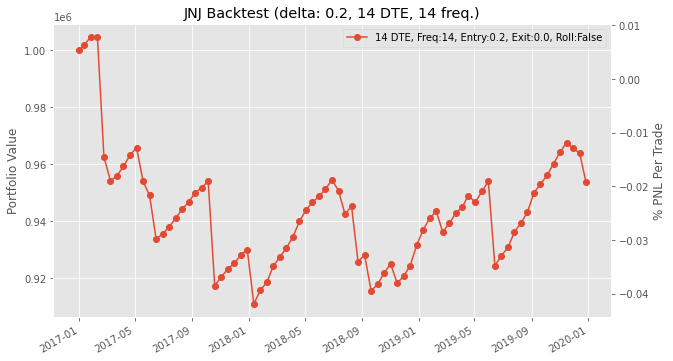

Date 2016-12-30, Expiry: 2017-01-20, Strike: 118.0, Underlying: 115.09, Premium: 0.43, Delta: 0.21633400000000005
At expiry, underlying is 114.14 , strike is 118.0
PNL 2017-01-20 00:00:00 = 3311.0 (premium = 0.43, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 117.0, Underlying: 114.14, Premium: 0.47, Delta: 0.226569
At expiry, underlying is 115.33 , strike is 117.0
PNL 2017-02-10 00:00:00 = 3619.0 (premium = 0.47, exit = 0)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 117.0, Underlying: 115.33, Premium: 0.24, Delta: 0.186113
Strike was breached- At expiry, underlying is 123.63 , strike is 117.0
We lost money  PNL 2017-03-03 = -49202.99999999996 (premium = 0.24, exit = 6.6299999999999955)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 127.0, Underlying: 123.63, Premium: 0.29, Delta: 0.16639
At expiry, underlying is 125.56 , strike is 127.0
PNL 2017-03-24 00:00:00 = 2233.0 (premium = 0.29, exit = 0)

Date 2017-03-24, Expiry: 2017-04-13, Strike: 129.0, Underlying: 125.56, Premiu

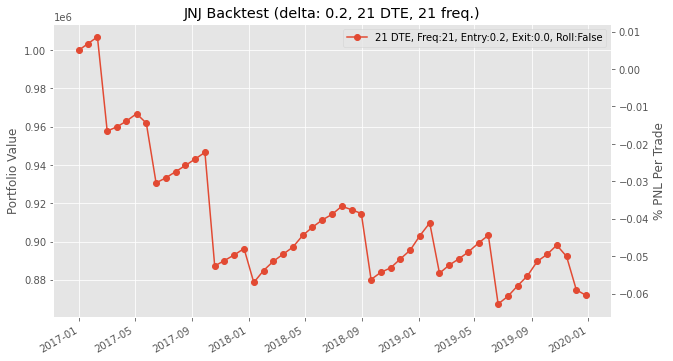

Date 2016-12-30, Expiry: 2017-01-27, Strike: 119.0, Underlying: 115.09, Premium: 0.61, Delta: 0.223913
At expiry, underlying is 113.14 , strike is 119.0
PNL 2017-01-27 00:00:00 = 4697.0 (premium = 0.61, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 116.0, Underlying: 113.14, Premium: 0.35, Delta: 0.189234
Strike was breached- At expiry, underlying is 122.58 , strike is 116.0
We lost money  PNL 2017-02-24 = -47970.99999999999 (premium = 0.35, exit = 6.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 126.0, Underlying: 122.58, Premium: 0.41, Delta: 0.193457
At expiry, underlying is 125.56 , strike is 126.0
PNL 2017-03-24 00:00:00 = 3157.0 (premium = 0.41, exit = 0)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 130.0, Underlying: 125.56, Premium: 0.43, Delta: 0.17738900000000002
At expiry, underlying is 121.985 , strike is 130.0
PNL 2017-04-21 00:00:00 = 3311.0 (premium = 0.43, exit = 0)

Date 2017-04-21, Expiry: 2017-05-19, Strike: 125.0, Underlying: 121.985, Prem

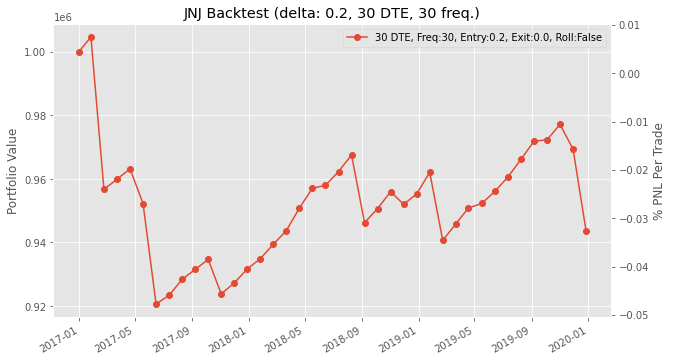

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
At expiry, underlying is 118.42 , strike is 120.0
PNL 2017-02-17 00:00:00 = 6314.0 (premium = 0.82, exit = 0)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 121.0, Underlying: 118.42, Premium: 0.47, Delta: 0.213277
Strike was breached- At expiry, underlying is 124.65 , strike is 121.0
We lost money  PNL 2017-03-31 = -24486.000000000047 (premium = 0.47, exit = 3.6500000000000057)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 130.0, Underlying: 124.65, Premium: 0.37, Delta: 0.14794000000000002
At expiry, underlying is 126.87 , strike is 130.0
PNL 2017-05-19 00:00:00 = 2849.0 (premium = 0.37, exit = 0)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 130.0, Underlying: 126.87, Premium: 0.63, Delta: 0.226856
Strike was breached- At expiry, underlying is 132.73 , strike is 130.0
We lost money  PNL 2017-06-30 = -16169.999999999922 (premium = 0.63, exit = 2.7299999999999898)

Date 2017-06-30, Ex

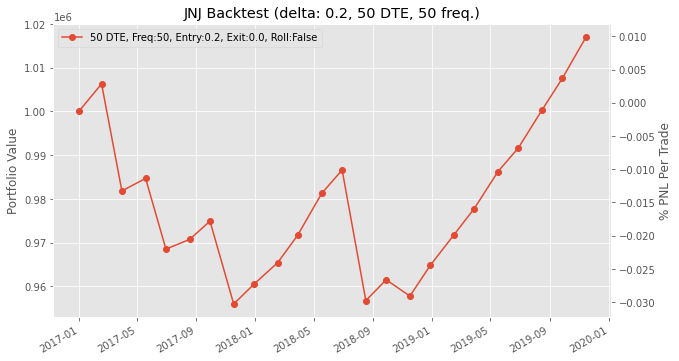

0.20.0 took 80.26929593086243 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Strike was breached- At expiry, underlying is 116.39 , strike is 116.0
We lost money  PNL 2017-01-06 = -308.00000000000455 (premium = 0.35, exit = 0.39000000000000057)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 118.0, Underlying: 116.39, Premium: 0.27, Delta: 0.225601
At expiry, underlying is 114.64 , strike is 118.0
PNL 2017-01-13 00:00:00 = 2079.0 (premium = 0.27, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 116.0, Underlying: 114.64, Premium: 0.24, Delta: 0.231537
At expiry, underlying is 114.14 , strike is 116.0
PNL 2017-01-20 00:00:00 = 1848.0 (premium = 0.24, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.14, Premium: 0.39, Delta: 0.24824
At expiry, underlying is 113.14 , strike is 116.0
PNL 2017-01-27 00:00:00 = 3003.0 (premium = 0.39, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Strike: 114.

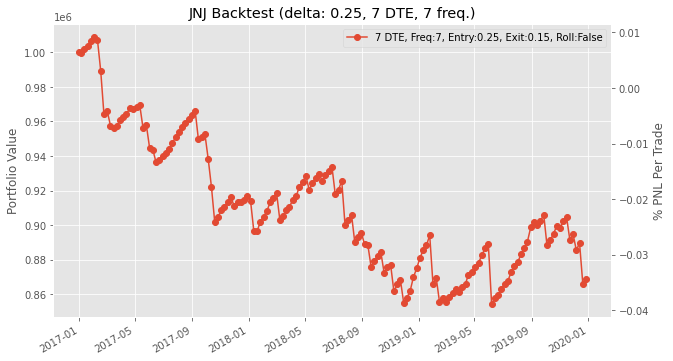

Date 2016-12-30, Expiry: 2017-01-13, Strike: 117.0, Underlying: 115.09, Premium: 0.49, Delta: 0.272704
At expiry, underlying is 114.64 , strike is 117.0
PNL 2017-01-13 00:00:00 = 3773.0 (premium = 0.49, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 117.0, Underlying: 114.64, Premium: 0.56, Delta: 0.262604
At expiry, underlying is 113.14 , strike is 117.0
PNL 2017-01-27 00:00:00 = 4312.0 (premium = 0.56, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 115.0, Underlying: 113.14, Premium: 0.32, Delta: 0.230397
Strike was breached- At expiry, underlying is 115.33 , strike is 115.0
We lost money  PNL 2017-02-10 = -76.99999999998681 (premium = 0.32, exit = 0.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 116.0, Underlying: 115.33, Premium: 0.36, Delta: 0.306339
Strike was breached- At expiry, underlying is 122.58 , strike is 116.0
We lost money  PNL 2017-02-24 = -47893.999999999985 (premium = 0.36, exit = 6.579999999999998)

Date 2017-02-24, Expiry: 2017-03

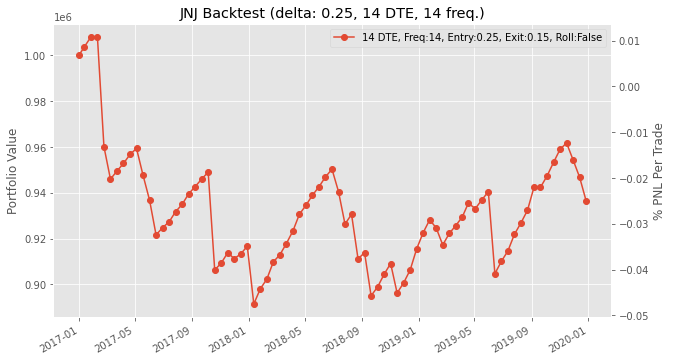

Date 2016-12-30, Expiry: 2017-01-20, Strike: 118.0, Underlying: 115.09, Premium: 0.43, Delta: 0.21633400000000005
At expiry, underlying is 114.14 , strike is 118.0
PNL 2017-01-20 00:00:00 = 3311.0 (premium = 0.43, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 117.0, Underlying: 114.14, Premium: 0.47, Delta: 0.226569
At expiry, underlying is 115.33 , strike is 117.0
PNL 2017-02-10 00:00:00 = 3619.0 (premium = 0.47, exit = 0)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 117.0, Underlying: 115.33, Premium: 0.24, Delta: 0.186113
Strike was breached- At expiry, underlying is 123.63 , strike is 117.0
We lost money  PNL 2017-03-03 = -49202.99999999996 (premium = 0.24, exit = 6.6299999999999955)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 126.0, Underlying: 123.63, Premium: 0.48, Delta: 0.248178
At expiry, underlying is 125.56 , strike is 126.0
PNL 2017-03-24 00:00:00 = 3696.0 (premium = 0.48, exit = 0)

Date 2017-03-24, Expiry: 2017-04-13, Strike: 128.0, Underlying: 125.56, Premi

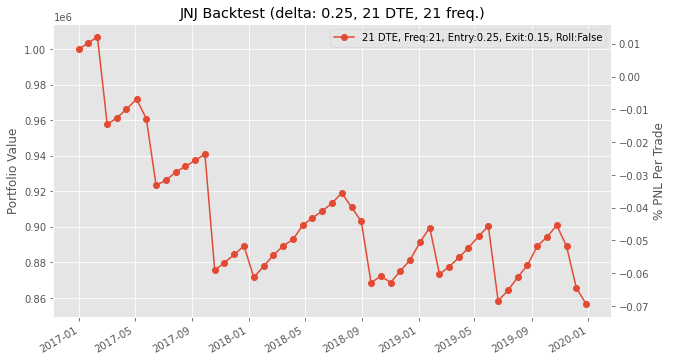

Date 2016-12-30, Expiry: 2017-01-27, Strike: 119.0, Underlying: 115.09, Premium: 0.61, Delta: 0.223913
At expiry, underlying is 113.14 , strike is 119.0
PNL 2017-01-27 00:00:00 = 4697.0 (premium = 0.61, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 115.0, Underlying: 113.14, Premium: 0.6, Delta: 0.281556
Strike was breached- At expiry, underlying is 122.58 , strike is 115.0
We lost money  PNL 2017-02-24 = -53745.99999999999 (premium = 0.6, exit = 7.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 125.0, Underlying: 122.58, Premium: 0.63, Delta: 0.271692
Strike was breached- At expiry, underlying is 125.56 , strike is 125.0
PNL 2017-03-24 00:00:00 = 538.9999999999825 (premium = 0.63, exit = 0.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 129.0, Underlying: 125.56, Premium: 0.65, Delta: 0.24165100000000006
At expiry, underlying is 121.985 , strike is 129.0
PNL 2017-04-21 00:00:00 = 5005.0 (premium = 0.65, exit = 0)

Date 2017-04-21, Expiry: 2017-

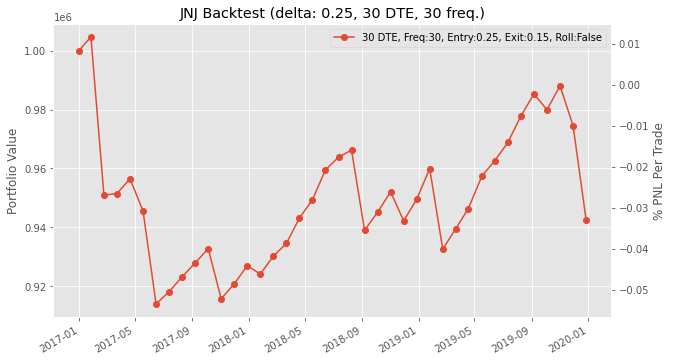

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
At expiry, underlying is 118.42 , strike is 120.0
PNL 2017-02-17 00:00:00 = 6314.0 (premium = 0.82, exit = 0)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 121.0, Underlying: 118.42, Premium: 0.47, Delta: 0.213277
Strike was breached- At expiry, underlying is 124.65 , strike is 121.0
We lost money  PNL 2017-03-31 = -24486.000000000047 (premium = 0.47, exit = 3.6500000000000057)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 130.0, Underlying: 124.65, Premium: 0.37, Delta: 0.14794000000000002
At expiry, underlying is 126.87 , strike is 130.0
PNL 2017-05-19 00:00:00 = 2849.0 (premium = 0.37, exit = 0)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 130.0, Underlying: 126.87, Premium: 0.63, Delta: 0.226856
Strike was breached- At expiry, underlying is 132.73 , strike is 130.0
We lost money  PNL 2017-06-30 = -16169.999999999922 (premium = 0.63, exit = 2.7299999999999898)

Date 2017-06-30, Ex

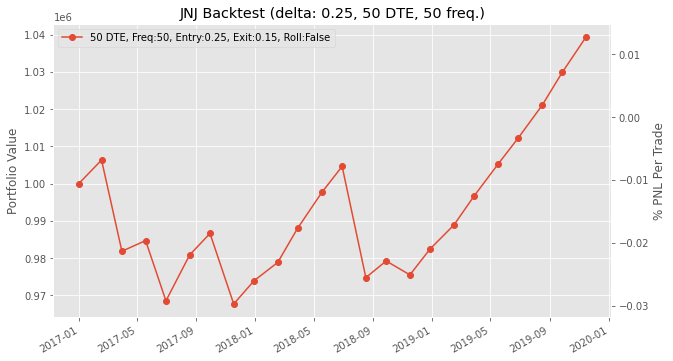

0.250.15 took 81.1003668308258 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Strike was breached- At expiry, underlying is 116.39 , strike is 116.0
We lost money  PNL 2017-01-06 = -308.00000000000455 (premium = 0.35, exit = 0.39000000000000057)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 118.0, Underlying: 116.39, Premium: 0.27, Delta: 0.225601
At expiry, underlying is 114.64 , strike is 118.0
PNL 2017-01-13 00:00:00 = 2079.0 (premium = 0.27, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 116.0, Underlying: 114.64, Premium: 0.24, Delta: 0.231537
At expiry, underlying is 114.14 , strike is 116.0
PNL 2017-01-20 00:00:00 = 1848.0 (premium = 0.24, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.14, Premium: 0.39, Delta: 0.24824
At expiry, underlying is 113.14 , strike is 116.0
PNL 2017-01-27 00:00:00 = 3003.0 (premium = 0.39, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Strike: 114

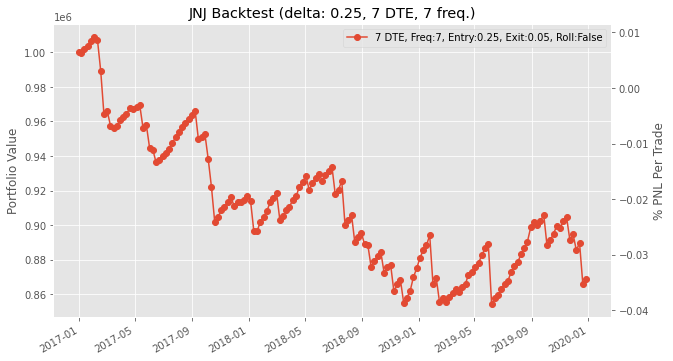

Date 2016-12-30, Expiry: 2017-01-13, Strike: 117.0, Underlying: 115.09, Premium: 0.49, Delta: 0.272704
At expiry, underlying is 114.64 , strike is 117.0
PNL 2017-01-13 00:00:00 = 3773.0 (premium = 0.49, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 117.0, Underlying: 114.64, Premium: 0.56, Delta: 0.262604
At expiry, underlying is 113.14 , strike is 117.0
PNL 2017-01-27 00:00:00 = 4312.0 (premium = 0.56, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 115.0, Underlying: 113.14, Premium: 0.32, Delta: 0.230397
Strike was breached- At expiry, underlying is 115.33 , strike is 115.0
We lost money  PNL 2017-02-10 = -76.99999999998681 (premium = 0.32, exit = 0.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 116.0, Underlying: 115.33, Premium: 0.36, Delta: 0.306339
Strike was breached- At expiry, underlying is 122.58 , strike is 116.0
We lost money  PNL 2017-02-24 = -47893.999999999985 (premium = 0.36, exit = 6.579999999999998)

Date 2017-02-24, Expiry: 2017-03

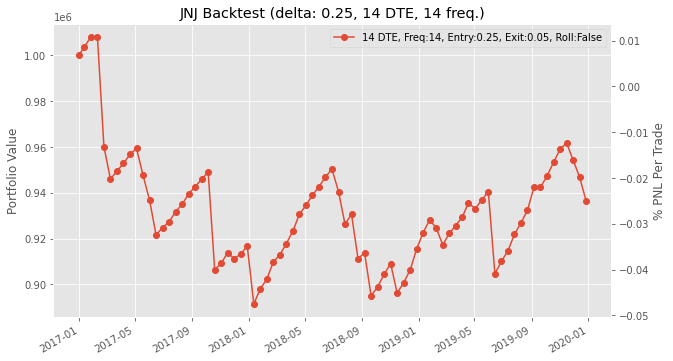

Date 2016-12-30, Expiry: 2017-01-20, Strike: 118.0, Underlying: 115.09, Premium: 0.43, Delta: 0.21633400000000005
At expiry, underlying is 114.14 , strike is 118.0
PNL 2017-01-20 00:00:00 = 3311.0 (premium = 0.43, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 117.0, Underlying: 114.14, Premium: 0.47, Delta: 0.226569
At expiry, underlying is 115.33 , strike is 117.0
PNL 2017-02-10 00:00:00 = 3619.0 (premium = 0.47, exit = 0)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 117.0, Underlying: 115.33, Premium: 0.24, Delta: 0.186113
Strike was breached- At expiry, underlying is 123.63 , strike is 117.0
We lost money  PNL 2017-03-03 = -49202.99999999996 (premium = 0.24, exit = 6.6299999999999955)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 126.0, Underlying: 123.63, Premium: 0.48, Delta: 0.248178
At expiry, underlying is 125.56 , strike is 126.0
PNL 2017-03-24 00:00:00 = 3696.0 (premium = 0.48, exit = 0)

Date 2017-03-24, Expiry: 2017-04-13, Strike: 128.0, Underlying: 125.56, Premi

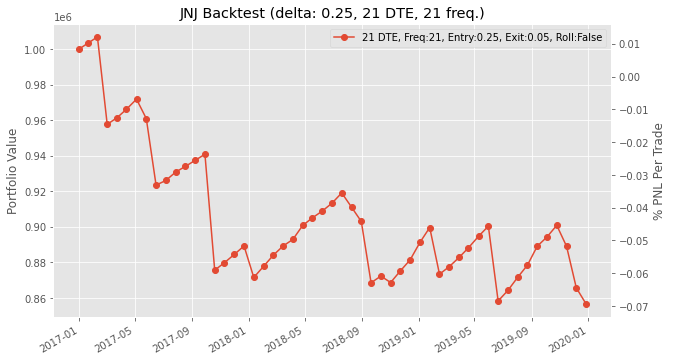

Date 2016-12-30, Expiry: 2017-01-27, Strike: 119.0, Underlying: 115.09, Premium: 0.61, Delta: 0.223913
At expiry, underlying is 113.14 , strike is 119.0
PNL 2017-01-27 00:00:00 = 4697.0 (premium = 0.61, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 115.0, Underlying: 113.14, Premium: 0.6, Delta: 0.281556
Strike was breached- At expiry, underlying is 122.58 , strike is 115.0
We lost money  PNL 2017-02-24 = -53745.99999999999 (premium = 0.6, exit = 7.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 125.0, Underlying: 122.58, Premium: 0.63, Delta: 0.271692
Strike was breached- At expiry, underlying is 125.56 , strike is 125.0
PNL 2017-03-24 00:00:00 = 538.9999999999825 (premium = 0.63, exit = 0.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 129.0, Underlying: 125.56, Premium: 0.65, Delta: 0.24165100000000006
At expiry, underlying is 121.985 , strike is 129.0
PNL 2017-04-21 00:00:00 = 5005.0 (premium = 0.65, exit = 0)

Date 2017-04-21, Expiry: 2017-

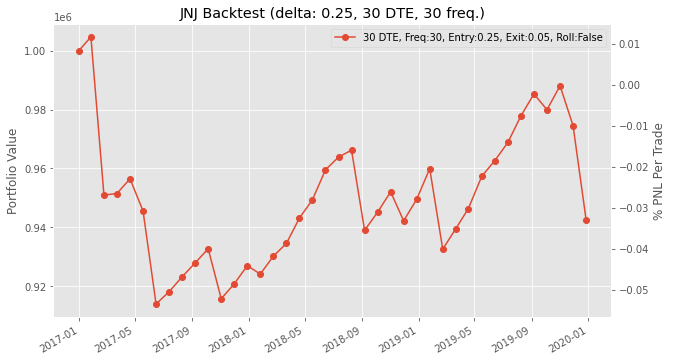

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
At expiry, underlying is 118.42 , strike is 120.0
PNL 2017-02-17 00:00:00 = 6314.0 (premium = 0.82, exit = 0)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 121.0, Underlying: 118.42, Premium: 0.47, Delta: 0.213277
Strike was breached- At expiry, underlying is 124.65 , strike is 121.0
We lost money  PNL 2017-03-31 = -24486.000000000047 (premium = 0.47, exit = 3.6500000000000057)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 130.0, Underlying: 124.65, Premium: 0.37, Delta: 0.14794000000000002
At expiry, underlying is 126.87 , strike is 130.0
PNL 2017-05-19 00:00:00 = 2849.0 (premium = 0.37, exit = 0)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 130.0, Underlying: 126.87, Premium: 0.63, Delta: 0.226856
Strike was breached- At expiry, underlying is 132.73 , strike is 130.0
We lost money  PNL 2017-06-30 = -16169.999999999922 (premium = 0.63, exit = 2.7299999999999898)

Date 2017-06-30, Ex

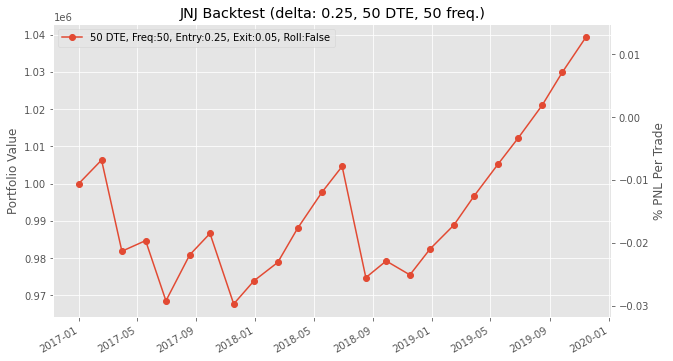

0.250.05 took 80.89931154251099 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Strike was breached- At expiry, underlying is 116.39 , strike is 116.0
We lost money  PNL 2017-01-06 = -308.00000000000455 (premium = 0.35, exit = 0.39000000000000057)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 118.0, Underlying: 116.39, Premium: 0.27, Delta: 0.225601
At expiry, underlying is 114.64 , strike is 118.0
PNL 2017-01-13 00:00:00 = 2079.0 (premium = 0.27, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 116.0, Underlying: 114.64, Premium: 0.24, Delta: 0.231537
At expiry, underlying is 114.14 , strike is 116.0
PNL 2017-01-20 00:00:00 = 1848.0 (premium = 0.24, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.14, Premium: 0.39, Delta: 0.24824
At expiry, underlying is 113.14 , strike is 116.0
PNL 2017-01-27 00:00:00 = 3003.0 (premium = 0.39, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Strike: 11

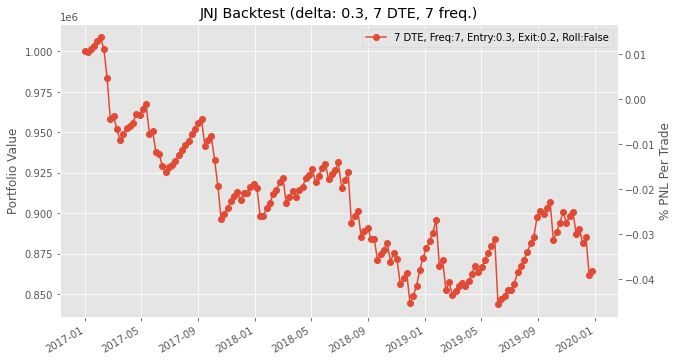

Date 2016-12-30, Expiry: 2017-01-13, Strike: 117.0, Underlying: 115.09, Premium: 0.49, Delta: 0.272704
At expiry, underlying is 114.64 , strike is 117.0
PNL 2017-01-13 00:00:00 = 3773.0 (premium = 0.49, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 117.0, Underlying: 114.64, Premium: 0.56, Delta: 0.262604
At expiry, underlying is 113.14 , strike is 117.0
PNL 2017-01-27 00:00:00 = 4312.0 (premium = 0.56, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 115.0, Underlying: 113.14, Premium: 0.32, Delta: 0.230397
Strike was breached- At expiry, underlying is 115.33 , strike is 115.0
We lost money  PNL 2017-02-10 = -76.99999999998681 (premium = 0.32, exit = 0.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 116.0, Underlying: 115.33, Premium: 0.36, Delta: 0.306339
Strike was breached- At expiry, underlying is 122.58 , strike is 116.0
We lost money  PNL 2017-02-24 = -47893.999999999985 (premium = 0.36, exit = 6.579999999999998)

Date 2017-02-24, Expiry: 2017-03

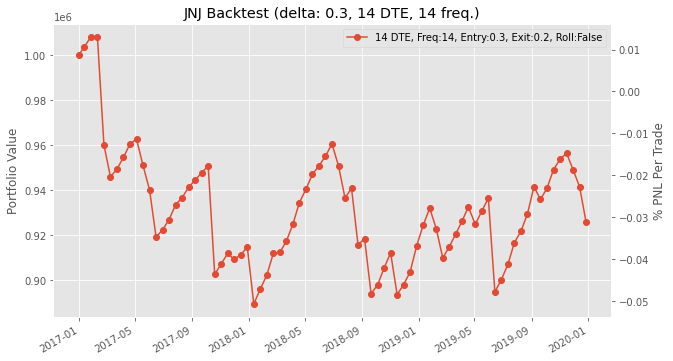

Date 2016-12-30, Expiry: 2017-01-20, Strike: 117.0, Underlying: 115.09, Premium: 0.67, Delta: 0.306055
At expiry, underlying is 114.14 , strike is 117.0
PNL 2017-01-20 00:00:00 = 5159.0 (premium = 0.67, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 116.0, Underlying: 114.14, Premium: 0.74, Delta: 0.317813
At expiry, underlying is 115.33 , strike is 116.0
PNL 2017-02-10 00:00:00 = 5698.0 (premium = 0.74, exit = 0)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 116.0, Underlying: 115.33, Premium: 0.54, Delta: 0.330624
Strike was breached- At expiry, underlying is 123.63 , strike is 116.0
We lost money  PNL 2017-03-03 = -54592.99999999996 (premium = 0.54, exit = 7.6299999999999955)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 125.0, Underlying: 123.63, Premium: 0.77, Delta: 0.350987
Strike was breached- At expiry, underlying is 125.56 , strike is 125.0
PNL 2017-03-24 00:00:00 = 1616.9999999999827 (premium = 0.77, exit = 0.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-13, S

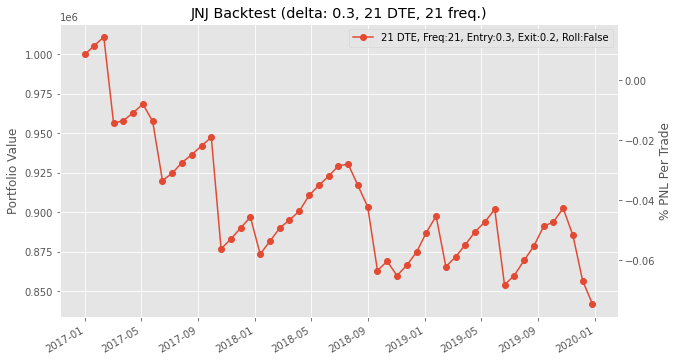

Date 2016-12-30, Expiry: 2017-01-27, Strike: 118.0, Underlying: 115.09, Premium: 0.85, Delta: 0.289694
At expiry, underlying is 113.14 , strike is 118.0
PNL 2017-01-27 00:00:00 = 6545.0 (premium = 0.85, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 115.0, Underlying: 113.14, Premium: 0.6, Delta: 0.281556
Strike was breached- At expiry, underlying is 122.58 , strike is 115.0
We lost money  PNL 2017-02-24 = -53745.99999999999 (premium = 0.6, exit = 7.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 125.0, Underlying: 122.58, Premium: 0.63, Delta: 0.271692
Strike was breached- At expiry, underlying is 125.56 , strike is 125.0
PNL 2017-03-24 00:00:00 = 538.9999999999825 (premium = 0.63, exit = 0.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 128.0, Underlying: 125.56, Premium: 0.95, Delta: 0.316002
At expiry, underlying is 121.985 , strike is 128.0
PNL 2017-04-21 00:00:00 = 7315.0 (premium = 0.95, exit = 0)

Date 2017-04-21, Expiry: 2017-05-19, Stri

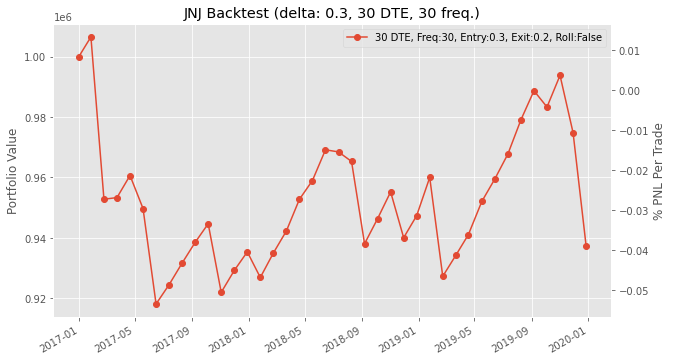

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
At expiry, underlying is 118.42 , strike is 120.0
PNL 2017-02-17 00:00:00 = 6314.0 (premium = 0.82, exit = 0)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 120.0, Underlying: 118.42, Premium: 0.7, Delta: 0.291976
Strike was breached- At expiry, underlying is 124.65 , strike is 120.0
We lost money  PNL 2017-03-31 = -30415.000000000044 (premium = 0.7, exit = 4.650000000000006)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 130.0, Underlying: 124.65, Premium: 0.37, Delta: 0.14794000000000002
At expiry, underlying is 126.87 , strike is 130.0
PNL 2017-05-19 00:00:00 = 2849.0 (premium = 0.37, exit = 0)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 129.0, Underlying: 126.87, Premium: 0.88, Delta: 0.292164
Strike was breached- At expiry, underlying is 132.73 , strike is 129.0
We lost money  PNL 2017-06-30 = -21944.999999999924 (premium = 0.88, exit = 3.7299999999999898)

Date 2017-06-30, Expir

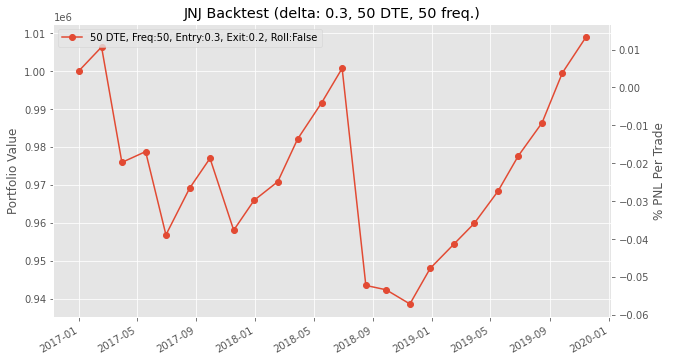

0.30.2 took 81.56446146965027 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Strike was breached- At expiry, underlying is 116.39 , strike is 116.0
We lost money  PNL 2017-01-06 = -308.00000000000455 (premium = 0.35, exit = 0.39000000000000057)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 118.0, Underlying: 116.39, Premium: 0.27, Delta: 0.225601
At expiry, underlying is 114.64 , strike is 118.0
PNL 2017-01-13 00:00:00 = 2079.0 (premium = 0.27, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 116.0, Underlying: 114.64, Premium: 0.24, Delta: 0.231537
At expiry, underlying is 114.14 , strike is 116.0
PNL 2017-01-20 00:00:00 = 1848.0 (premium = 0.24, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.14, Premium: 0.39, Delta: 0.24824
At expiry, underlying is 113.14 , strike is 116.0
PNL 2017-01-27 00:00:00 = 3003.0 (premium = 0.39, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Strike: 114.

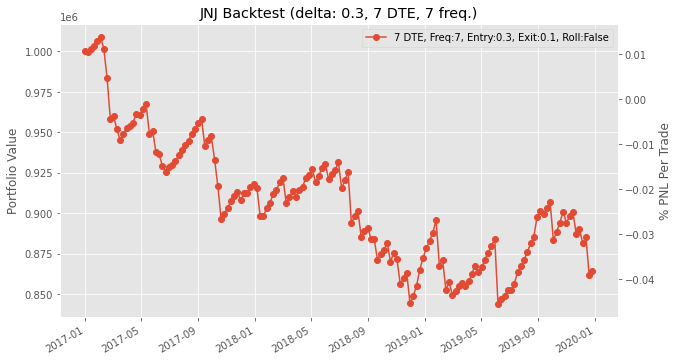

Date 2016-12-30, Expiry: 2017-01-13, Strike: 117.0, Underlying: 115.09, Premium: 0.49, Delta: 0.272704
At expiry, underlying is 114.64 , strike is 117.0
PNL 2017-01-13 00:00:00 = 3773.0 (premium = 0.49, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 117.0, Underlying: 114.64, Premium: 0.56, Delta: 0.262604
At expiry, underlying is 113.14 , strike is 117.0
PNL 2017-01-27 00:00:00 = 4312.0 (premium = 0.56, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 115.0, Underlying: 113.14, Premium: 0.32, Delta: 0.230397
Strike was breached- At expiry, underlying is 115.33 , strike is 115.0
We lost money  PNL 2017-02-10 = -76.99999999998681 (premium = 0.32, exit = 0.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 116.0, Underlying: 115.33, Premium: 0.36, Delta: 0.306339
Strike was breached- At expiry, underlying is 122.58 , strike is 116.0
We lost money  PNL 2017-02-24 = -47893.999999999985 (premium = 0.36, exit = 6.579999999999998)

Date 2017-02-24, Expiry: 2017-03

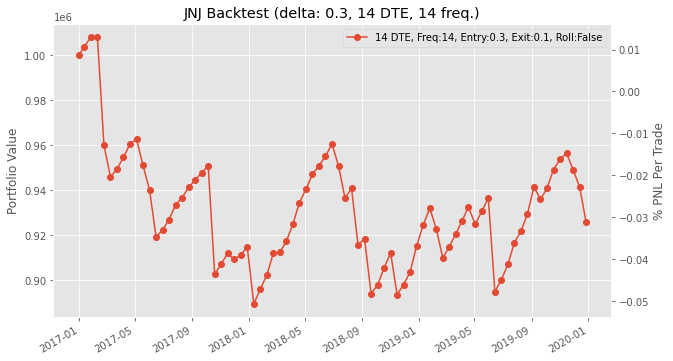

Date 2016-12-30, Expiry: 2017-01-20, Strike: 117.0, Underlying: 115.09, Premium: 0.67, Delta: 0.306055
At expiry, underlying is 114.14 , strike is 117.0
PNL 2017-01-20 00:00:00 = 5159.0 (premium = 0.67, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 116.0, Underlying: 114.14, Premium: 0.74, Delta: 0.317813
At expiry, underlying is 115.33 , strike is 116.0
PNL 2017-02-10 00:00:00 = 5698.0 (premium = 0.74, exit = 0)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 116.0, Underlying: 115.33, Premium: 0.54, Delta: 0.330624
Strike was breached- At expiry, underlying is 123.63 , strike is 116.0
We lost money  PNL 2017-03-03 = -54592.99999999996 (premium = 0.54, exit = 7.6299999999999955)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 125.0, Underlying: 123.63, Premium: 0.77, Delta: 0.350987
Strike was breached- At expiry, underlying is 125.56 , strike is 125.0
PNL 2017-03-24 00:00:00 = 1616.9999999999827 (premium = 0.77, exit = 0.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-13, S

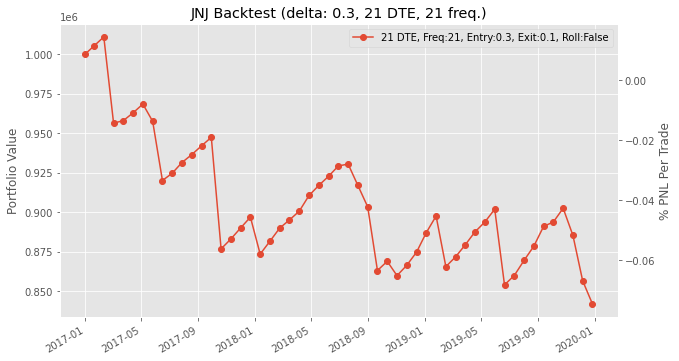

Date 2016-12-30, Expiry: 2017-01-27, Strike: 118.0, Underlying: 115.09, Premium: 0.85, Delta: 0.289694
At expiry, underlying is 113.14 , strike is 118.0
PNL 2017-01-27 00:00:00 = 6545.0 (premium = 0.85, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 115.0, Underlying: 113.14, Premium: 0.6, Delta: 0.281556
Strike was breached- At expiry, underlying is 122.58 , strike is 115.0
We lost money  PNL 2017-02-24 = -53745.99999999999 (premium = 0.6, exit = 7.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 125.0, Underlying: 122.58, Premium: 0.63, Delta: 0.271692
Strike was breached- At expiry, underlying is 125.56 , strike is 125.0
PNL 2017-03-24 00:00:00 = 538.9999999999825 (premium = 0.63, exit = 0.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 128.0, Underlying: 125.56, Premium: 0.95, Delta: 0.316002
At expiry, underlying is 121.985 , strike is 128.0
PNL 2017-04-21 00:00:00 = 7315.0 (premium = 0.95, exit = 0)

Date 2017-04-21, Expiry: 2017-05-19, Stri

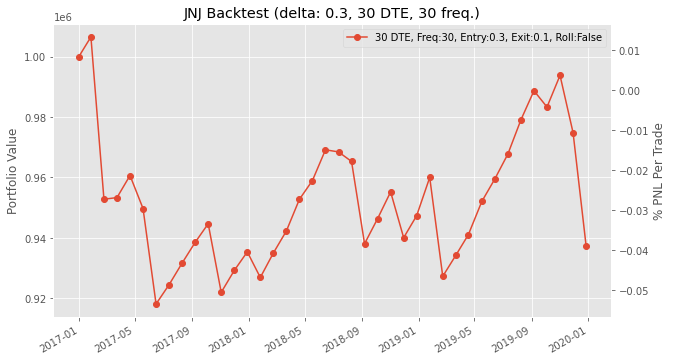

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
At expiry, underlying is 118.42 , strike is 120.0
PNL 2017-02-17 00:00:00 = 6314.0 (premium = 0.82, exit = 0)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 120.0, Underlying: 118.42, Premium: 0.7, Delta: 0.291976
Strike was breached- At expiry, underlying is 124.65 , strike is 120.0
We lost money  PNL 2017-03-31 = -30415.000000000044 (premium = 0.7, exit = 4.650000000000006)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 130.0, Underlying: 124.65, Premium: 0.37, Delta: 0.14794000000000002
At expiry, underlying is 126.87 , strike is 130.0
PNL 2017-05-19 00:00:00 = 2849.0 (premium = 0.37, exit = 0)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 129.0, Underlying: 126.87, Premium: 0.88, Delta: 0.292164
Strike was breached- At expiry, underlying is 132.73 , strike is 129.0
We lost money  PNL 2017-06-30 = -21944.999999999924 (premium = 0.88, exit = 3.7299999999999898)

Date 2017-06-30, Expir

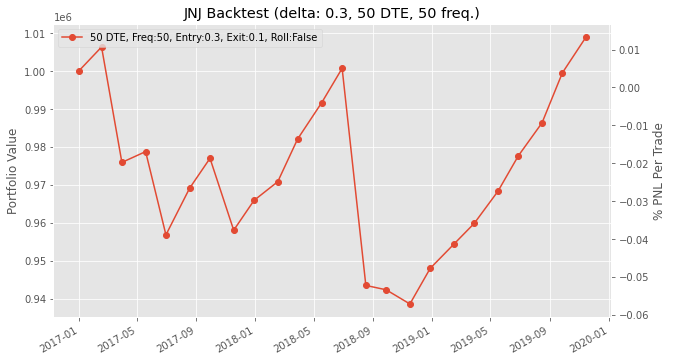

0.30.1 took 85.57343220710754 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Strike was breached- At expiry, underlying is 116.39 , strike is 116.0
We lost money  PNL 2017-01-06 = -308.00000000000455 (premium = 0.35, exit = 0.39000000000000057)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 117.0, Underlying: 116.39, Premium: 0.55, Delta: 0.387161
At expiry, underlying is 114.64 , strike is 117.0
PNL 2017-01-13 00:00:00 = 4235.0 (premium = 0.55, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.64, Premium: 0.57, Delta: 0.428844
At expiry, underlying is 114.14 , strike is 115.0
PNL 2017-01-20 00:00:00 = 4389.0 (premium = 0.57, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.14, Premium: 0.7, Delta: 0.382087
At expiry, underlying is 113.14 , strike is 115.0
PNL 2017-01-27 00:00:00 = 5390.0 (premium = 0.7, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Strike: 114.0

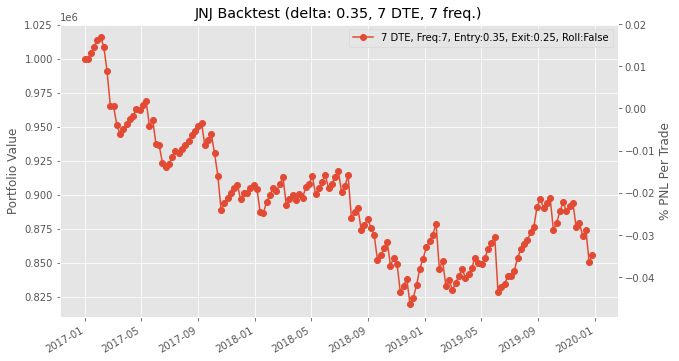

Date 2016-12-30, Expiry: 2017-01-13, Strike: 116.0, Underlying: 115.09, Premium: 0.81, Delta: 0.39292
At expiry, underlying is 114.64 , strike is 116.0
PNL 2017-01-13 00:00:00 = 6237.0 (premium = 0.81, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.64, Premium: 0.87, Delta: 0.360969
At expiry, underlying is 113.14 , strike is 116.0
PNL 2017-01-27 00:00:00 = 6699.0 (premium = 0.87, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 114.0, Underlying: 113.14, Premium: 0.62, Delta: 0.37324
Strike was breached- At expiry, underlying is 115.33 , strike is 114.0
We lost money  PNL 2017-02-10 = -5466.999999999987 (premium = 0.62, exit = 1.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 116.0, Underlying: 115.33, Premium: 0.36, Delta: 0.306339
Strike was breached- At expiry, underlying is 122.58 , strike is 116.0
We lost money  PNL 2017-02-24 = -47893.999999999985 (premium = 0.36, exit = 6.579999999999998)

Date 2017-02-24, Expiry: 2017-03-1

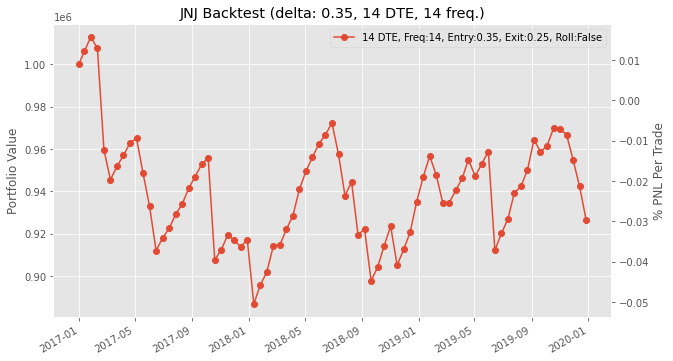

Date 2016-12-30, Expiry: 2017-01-20, Strike: 117.0, Underlying: 115.09, Premium: 0.67, Delta: 0.306055
At expiry, underlying is 114.14 , strike is 117.0
PNL 2017-01-20 00:00:00 = 5159.0 (premium = 0.67, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 116.0, Underlying: 114.14, Premium: 0.74, Delta: 0.317813
At expiry, underlying is 115.33 , strike is 116.0
PNL 2017-02-10 00:00:00 = 5698.0 (premium = 0.74, exit = 0)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 116.0, Underlying: 115.33, Premium: 0.54, Delta: 0.330624
Strike was breached- At expiry, underlying is 123.63 , strike is 116.0
We lost money  PNL 2017-03-03 = -54592.99999999996 (premium = 0.54, exit = 7.6299999999999955)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 125.0, Underlying: 123.63, Premium: 0.77, Delta: 0.350987
Strike was breached- At expiry, underlying is 125.56 , strike is 125.0
PNL 2017-03-24 00:00:00 = 1616.9999999999827 (premium = 0.77, exit = 0.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-13, S

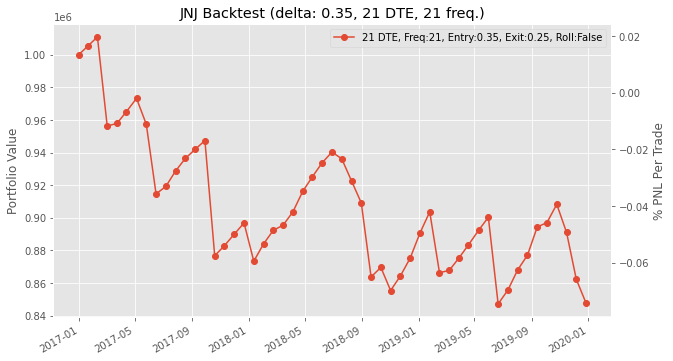

Date 2016-12-30, Expiry: 2017-01-27, Strike: 117.0, Underlying: 115.09, Premium: 1.18, Delta: 0.364969
At expiry, underlying is 113.14 , strike is 117.0
PNL 2017-01-27 00:00:00 = 9086.0 (premium = 1.18, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 114.0, Underlying: 113.14, Premium: 0.96, Delta: 0.388086
Strike was breached- At expiry, underlying is 122.58 , strike is 114.0
We lost money  PNL 2017-02-24 = -58673.999999999985 (premium = 0.96, exit = 8.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 124.0, Underlying: 122.58, Premium: 0.95, Delta: 0.363981
Strike was breached- At expiry, underlying is 125.56 , strike is 124.0
We lost money  PNL 2017-03-24 = -4697.000000000018 (premium = 0.95, exit = 1.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 128.0, Underlying: 125.56, Premium: 0.95, Delta: 0.316002
At expiry, underlying is 121.985 , strike is 128.0
PNL 2017-04-21 00:00:00 = 7315.0 (premium = 0.95, exit = 0)

Date 2017-04-21, Expiry: 2017-0

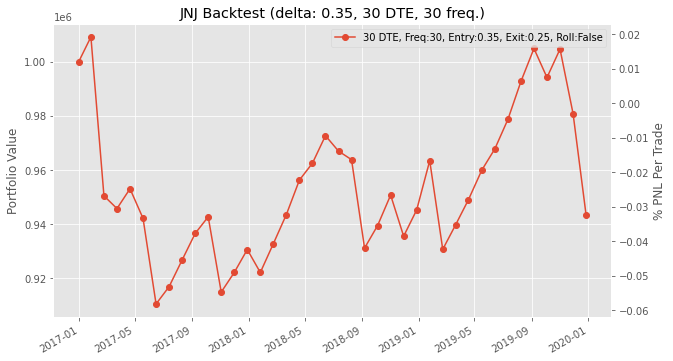

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
At expiry, underlying is 118.42 , strike is 120.0
PNL 2017-02-17 00:00:00 = 6314.0 (premium = 0.82, exit = 0)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 119.0, Underlying: 118.42, Premium: 1.04, Delta: 0.385446
Strike was breached- At expiry, underlying is 124.65 , strike is 119.0
We lost money  PNL 2017-03-31 = -35497.000000000044 (premium = 1.04, exit = 5.650000000000006)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 125.0, Underlying: 124.65, Premium: 2.07, Delta: 0.486106
Strike was breached- At expiry, underlying is 126.87 , strike is 125.0
PNL 2017-05-19 00:00:00 = 1539.9999999999638 (premium = 2.07, exit = 1.8700000000000045)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 128.0, Underlying: 126.87, Premium: 1.22, Delta: 0.36642
Strike was breached- At expiry, underlying is 132.73 , strike is 128.0
We lost money  PNL 2017-06-30 = -27026.999999999924 (premium = 1.22, exit = 4.7

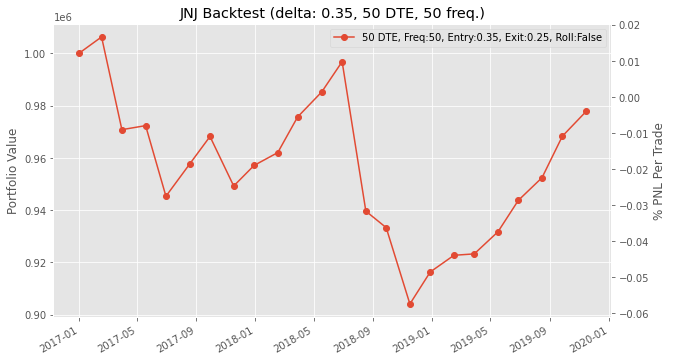

0.350.25 took 80.3702073097229 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Strike was breached- At expiry, underlying is 116.39 , strike is 116.0
We lost money  PNL 2017-01-06 = -308.00000000000455 (premium = 0.35, exit = 0.39000000000000057)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 117.0, Underlying: 116.39, Premium: 0.55, Delta: 0.387161
At expiry, underlying is 114.64 , strike is 117.0
PNL 2017-01-13 00:00:00 = 4235.0 (premium = 0.55, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.64, Premium: 0.57, Delta: 0.428844
At expiry, underlying is 114.14 , strike is 115.0
PNL 2017-01-20 00:00:00 = 4389.0 (premium = 0.57, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.14, Premium: 0.7, Delta: 0.382087
At expiry, underlying is 113.14 , strike is 115.0
PNL 2017-01-27 00:00:00 = 5390.0 (premium = 0.7, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Strike: 114.

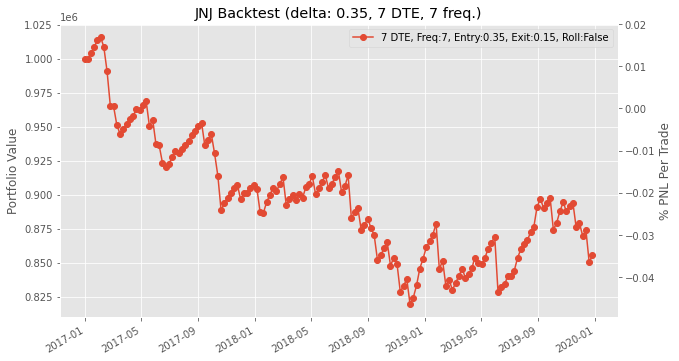

Date 2016-12-30, Expiry: 2017-01-13, Strike: 116.0, Underlying: 115.09, Premium: 0.81, Delta: 0.39292
At expiry, underlying is 114.64 , strike is 116.0
PNL 2017-01-13 00:00:00 = 6237.0 (premium = 0.81, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.64, Premium: 0.87, Delta: 0.360969
At expiry, underlying is 113.14 , strike is 116.0
PNL 2017-01-27 00:00:00 = 6699.0 (premium = 0.87, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 114.0, Underlying: 113.14, Premium: 0.62, Delta: 0.37324
Strike was breached- At expiry, underlying is 115.33 , strike is 114.0
We lost money  PNL 2017-02-10 = -5466.999999999987 (premium = 0.62, exit = 1.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 116.0, Underlying: 115.33, Premium: 0.36, Delta: 0.306339
Strike was breached- At expiry, underlying is 122.58 , strike is 116.0
We lost money  PNL 2017-02-24 = -47893.999999999985 (premium = 0.36, exit = 6.579999999999998)

Date 2017-02-24, Expiry: 2017-03-1

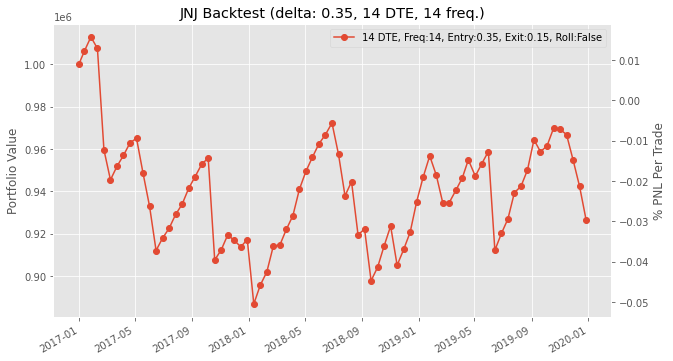

Date 2016-12-30, Expiry: 2017-01-20, Strike: 117.0, Underlying: 115.09, Premium: 0.67, Delta: 0.306055
At expiry, underlying is 114.14 , strike is 117.0
PNL 2017-01-20 00:00:00 = 5159.0 (premium = 0.67, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 116.0, Underlying: 114.14, Premium: 0.74, Delta: 0.317813
At expiry, underlying is 115.33 , strike is 116.0
PNL 2017-02-10 00:00:00 = 5698.0 (premium = 0.74, exit = 0)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 116.0, Underlying: 115.33, Premium: 0.54, Delta: 0.330624
Strike was breached- At expiry, underlying is 123.63 , strike is 116.0
We lost money  PNL 2017-03-03 = -54592.99999999996 (premium = 0.54, exit = 7.6299999999999955)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 125.0, Underlying: 123.63, Premium: 0.77, Delta: 0.350987
Strike was breached- At expiry, underlying is 125.56 , strike is 125.0
PNL 2017-03-24 00:00:00 = 1616.9999999999827 (premium = 0.77, exit = 0.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-13, S

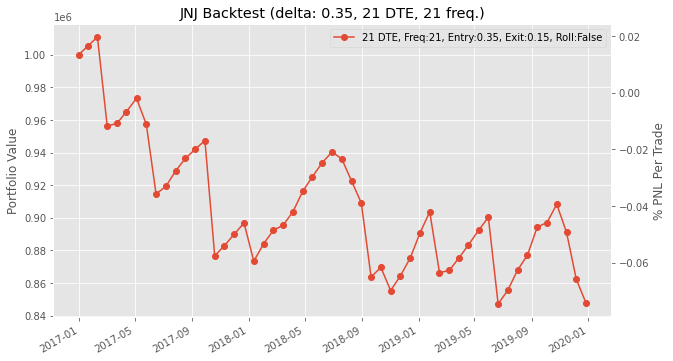

Date 2016-12-30, Expiry: 2017-01-27, Strike: 117.0, Underlying: 115.09, Premium: 1.18, Delta: 0.364969
At expiry, underlying is 113.14 , strike is 117.0
PNL 2017-01-27 00:00:00 = 9086.0 (premium = 1.18, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 114.0, Underlying: 113.14, Premium: 0.96, Delta: 0.388086
Strike was breached- At expiry, underlying is 122.58 , strike is 114.0
We lost money  PNL 2017-02-24 = -58673.999999999985 (premium = 0.96, exit = 8.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 124.0, Underlying: 122.58, Premium: 0.95, Delta: 0.363981
Strike was breached- At expiry, underlying is 125.56 , strike is 124.0
We lost money  PNL 2017-03-24 = -4697.000000000018 (premium = 0.95, exit = 1.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 128.0, Underlying: 125.56, Premium: 0.95, Delta: 0.316002
At expiry, underlying is 121.985 , strike is 128.0
PNL 2017-04-21 00:00:00 = 7315.0 (premium = 0.95, exit = 0)

Date 2017-04-21, Expiry: 2017-0

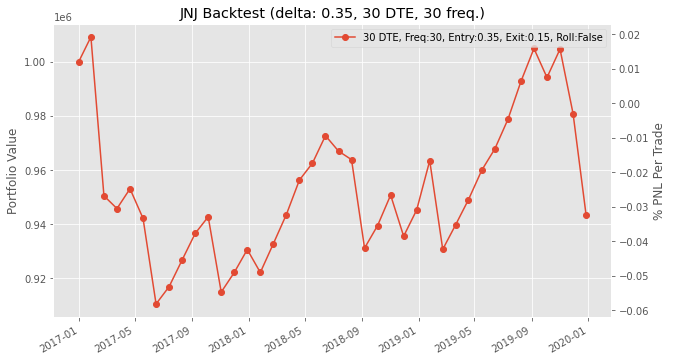

Date 2016-12-30, Expiry: 2017-02-17, Strike: 120.0, Underlying: 115.09, Premium: 0.82, Delta: 0.229597
At expiry, underlying is 118.42 , strike is 120.0
PNL 2017-02-17 00:00:00 = 6314.0 (premium = 0.82, exit = 0)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 119.0, Underlying: 118.42, Premium: 1.04, Delta: 0.385446
Strike was breached- At expiry, underlying is 124.65 , strike is 119.0
We lost money  PNL 2017-03-31 = -35497.000000000044 (premium = 1.04, exit = 5.650000000000006)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 125.0, Underlying: 124.65, Premium: 2.07, Delta: 0.486106
Strike was breached- At expiry, underlying is 126.87 , strike is 125.0
PNL 2017-05-19 00:00:00 = 1539.9999999999638 (premium = 2.07, exit = 1.8700000000000045)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 128.0, Underlying: 126.87, Premium: 1.22, Delta: 0.36642
Strike was breached- At expiry, underlying is 132.73 , strike is 128.0
We lost money  PNL 2017-06-30 = -27026.999999999924 (premium = 1.22, exit = 4.7

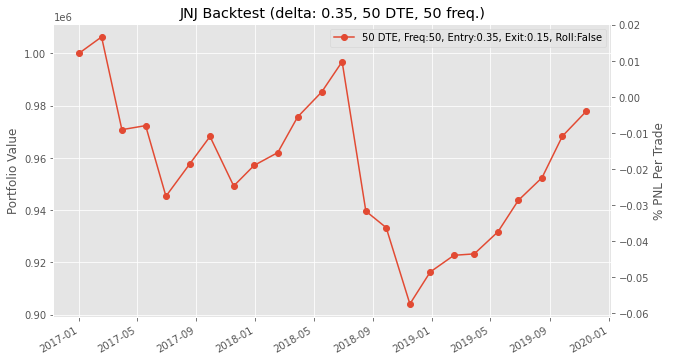

0.350.15 took 80.08904814720154 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Strike was breached- At expiry, underlying is 116.39 , strike is 116.0
We lost money  PNL 2017-01-06 = -308.00000000000455 (premium = 0.35, exit = 0.39000000000000057)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 117.0, Underlying: 116.39, Premium: 0.55, Delta: 0.387161
At expiry, underlying is 114.64 , strike is 117.0
PNL 2017-01-13 00:00:00 = 4235.0 (premium = 0.55, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.64, Premium: 0.57, Delta: 0.428844
At expiry, underlying is 114.14 , strike is 115.0
PNL 2017-01-20 00:00:00 = 4389.0 (premium = 0.57, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.14, Premium: 0.7, Delta: 0.382087
At expiry, underlying is 113.14 , strike is 115.0
PNL 2017-01-27 00:00:00 = 5390.0 (premium = 0.7, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Strike: 114

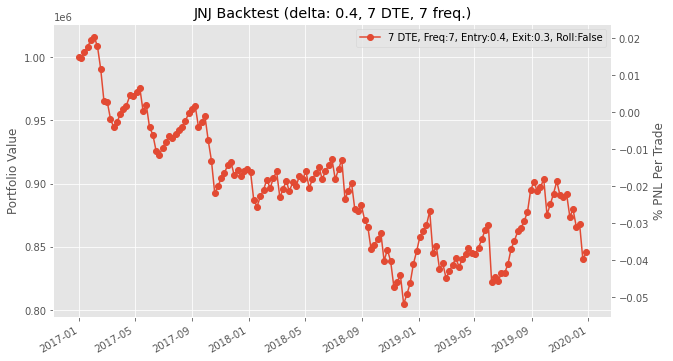

Date 2016-12-30, Expiry: 2017-01-13, Strike: 116.0, Underlying: 115.09, Premium: 0.81, Delta: 0.39292
At expiry, underlying is 114.64 , strike is 116.0
PNL 2017-01-13 00:00:00 = 6237.0 (premium = 0.81, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.64, Premium: 0.87, Delta: 0.360969
At expiry, underlying is 113.14 , strike is 116.0
PNL 2017-01-27 00:00:00 = 6699.0 (premium = 0.87, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 114.0, Underlying: 113.14, Premium: 0.62, Delta: 0.37324
Strike was breached- At expiry, underlying is 115.33 , strike is 114.0
We lost money  PNL 2017-02-10 = -5466.999999999987 (premium = 0.62, exit = 1.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 116.0, Underlying: 115.33, Premium: 0.36, Delta: 0.306339
Strike was breached- At expiry, underlying is 122.58 , strike is 116.0
We lost money  PNL 2017-02-24 = -47893.999999999985 (premium = 0.36, exit = 6.579999999999998)

Date 2017-02-24, Expiry: 2017-03-1

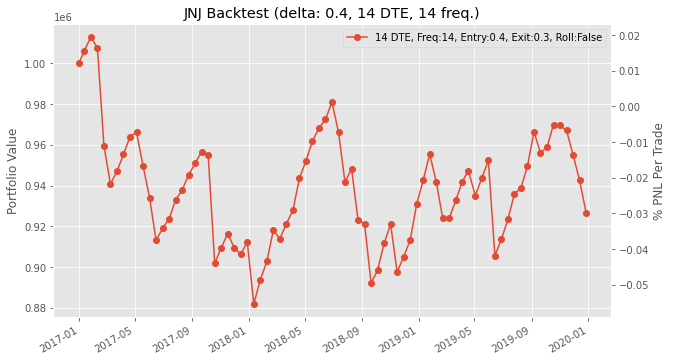

Date 2016-12-30, Expiry: 2017-01-20, Strike: 116.0, Underlying: 115.09, Premium: 1.04, Delta: 0.413177
At expiry, underlying is 114.14 , strike is 116.0
PNL 2017-01-20 00:00:00 = 8008.0 (premium = 1.04, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 115.0, Underlying: 114.14, Premium: 1.13, Delta: 0.42176
Strike was breached- At expiry, underlying is 115.33 , strike is 115.0
PNL 2017-02-10 00:00:00 = 6160.000000000013 (premium = 1.13, exit = 0.3299999999999983)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 116.0, Underlying: 115.33, Premium: 0.54, Delta: 0.330624
Strike was breached- At expiry, underlying is 123.63 , strike is 116.0
We lost money  PNL 2017-03-03 = -54592.99999999996 (premium = 0.54, exit = 7.6299999999999955)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 125.0, Underlying: 123.63, Premium: 0.77, Delta: 0.350987
Strike was breached- At expiry, underlying is 125.56 , strike is 125.0
PNL 2017-03-24 00:00:00 = 1616.9999999999827 (premium = 0.77, exit = 0.560000000

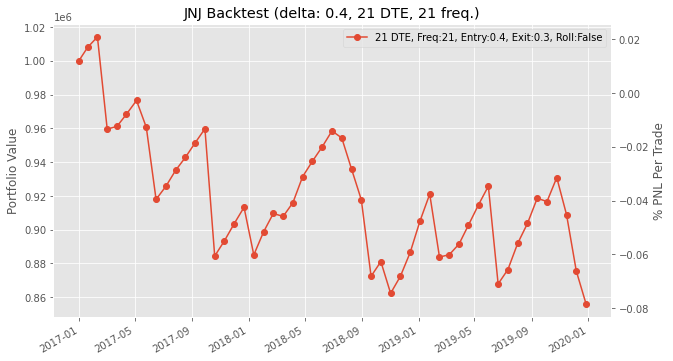

Date 2016-12-30, Expiry: 2017-01-27, Strike: 117.0, Underlying: 115.09, Premium: 1.18, Delta: 0.364969
At expiry, underlying is 113.14 , strike is 117.0
PNL 2017-01-27 00:00:00 = 9086.0 (premium = 1.18, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 114.0, Underlying: 113.14, Premium: 0.96, Delta: 0.388086
Strike was breached- At expiry, underlying is 122.58 , strike is 114.0
We lost money  PNL 2017-02-24 = -58673.999999999985 (premium = 0.96, exit = 8.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 124.0, Underlying: 122.58, Premium: 0.95, Delta: 0.363981
Strike was breached- At expiry, underlying is 125.56 , strike is 124.0
We lost money  PNL 2017-03-24 = -4697.000000000018 (premium = 0.95, exit = 1.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 127.0, Underlying: 125.56, Premium: 1.33, Delta: 0.395994
At expiry, underlying is 121.985 , strike is 127.0
PNL 2017-04-21 00:00:00 = 10241.0 (premium = 1.33, exit = 0)

Date 2017-04-21, Expiry: 2017-

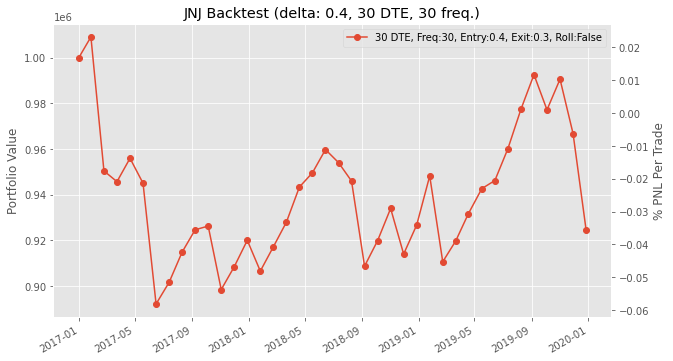

Date 2016-12-30, Expiry: 2017-02-17, Strike: 115.0, Underlying: 115.09, Premium: 2.69, Delta: 0.517649
Strike was breached- At expiry, underlying is 118.42 , strike is 115.0
We lost money  PNL 2017-02-17 = -5621.000000000014 (premium = 2.69, exit = 3.4200000000000017)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 119.0, Underlying: 118.42, Premium: 1.04, Delta: 0.385446
Strike was breached- At expiry, underlying is 124.65 , strike is 119.0
We lost money  PNL 2017-03-31 = -35497.000000000044 (premium = 1.04, exit = 5.650000000000006)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 125.0, Underlying: 124.65, Premium: 2.07, Delta: 0.486106
Strike was breached- At expiry, underlying is 126.87 , strike is 125.0
PNL 2017-05-19 00:00:00 = 1539.9999999999638 (premium = 2.07, exit = 1.8700000000000045)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 128.0, Underlying: 126.87, Premium: 1.22, Delta: 0.36642
Strike was breached- At expiry, underlying is 132.73 , strike is 128.0
We lost money  PNL 2017

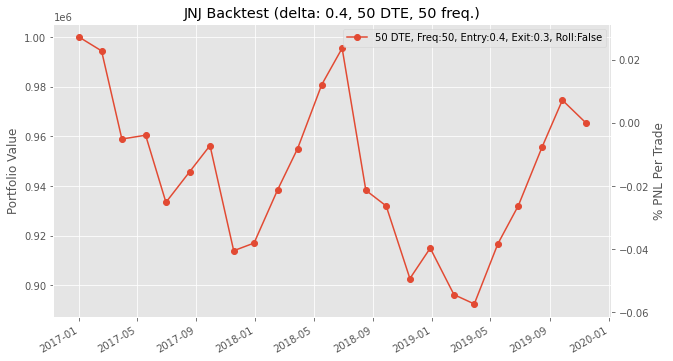

0.40.3 took 80.60751914978027 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 116.0, Underlying: 115.09, Premium: 0.35, Delta: 0.310796
Strike was breached- At expiry, underlying is 116.39 , strike is 116.0
We lost money  PNL 2017-01-06 = -308.00000000000455 (premium = 0.35, exit = 0.39000000000000057)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 117.0, Underlying: 116.39, Premium: 0.55, Delta: 0.387161
At expiry, underlying is 114.64 , strike is 117.0
PNL 2017-01-13 00:00:00 = 4235.0 (premium = 0.55, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.64, Premium: 0.57, Delta: 0.428844
At expiry, underlying is 114.14 , strike is 115.0
PNL 2017-01-20 00:00:00 = 4389.0 (premium = 0.57, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.14, Premium: 0.7, Delta: 0.382087
At expiry, underlying is 113.14 , strike is 115.0
PNL 2017-01-27 00:00:00 = 5390.0 (premium = 0.7, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Strike: 114.0

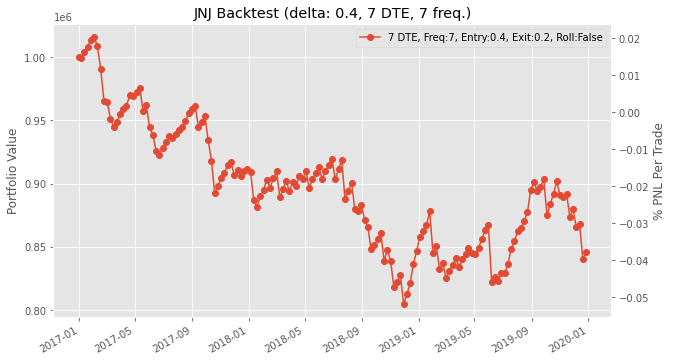

Date 2016-12-30, Expiry: 2017-01-13, Strike: 116.0, Underlying: 115.09, Premium: 0.81, Delta: 0.39292
At expiry, underlying is 114.64 , strike is 116.0
PNL 2017-01-13 00:00:00 = 6237.0 (premium = 0.81, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 116.0, Underlying: 114.64, Premium: 0.87, Delta: 0.360969
At expiry, underlying is 113.14 , strike is 116.0
PNL 2017-01-27 00:00:00 = 6699.0 (premium = 0.87, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 114.0, Underlying: 113.14, Premium: 0.62, Delta: 0.37324
Strike was breached- At expiry, underlying is 115.33 , strike is 114.0
We lost money  PNL 2017-02-10 = -5466.999999999987 (premium = 0.62, exit = 1.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 116.0, Underlying: 115.33, Premium: 0.36, Delta: 0.306339
Strike was breached- At expiry, underlying is 122.58 , strike is 116.0
We lost money  PNL 2017-02-24 = -47893.999999999985 (premium = 0.36, exit = 6.579999999999998)

Date 2017-02-24, Expiry: 2017-03-1

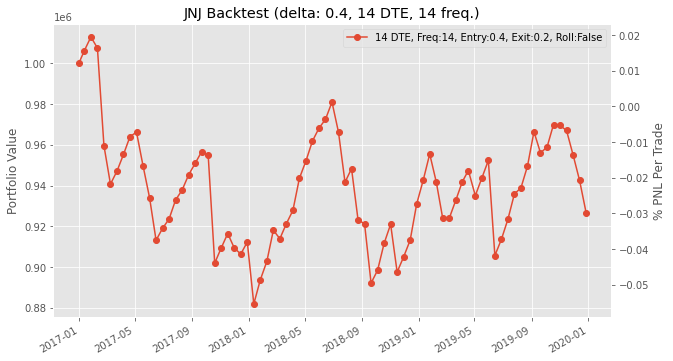

Date 2016-12-30, Expiry: 2017-01-20, Strike: 116.0, Underlying: 115.09, Premium: 1.04, Delta: 0.413177
At expiry, underlying is 114.14 , strike is 116.0
PNL 2017-01-20 00:00:00 = 8008.0 (premium = 1.04, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 115.0, Underlying: 114.14, Premium: 1.13, Delta: 0.42176
Strike was breached- At expiry, underlying is 115.33 , strike is 115.0
PNL 2017-02-10 00:00:00 = 6160.000000000013 (premium = 1.13, exit = 0.3299999999999983)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 116.0, Underlying: 115.33, Premium: 0.54, Delta: 0.330624
Strike was breached- At expiry, underlying is 123.63 , strike is 116.0
We lost money  PNL 2017-03-03 = -54592.99999999996 (premium = 0.54, exit = 7.6299999999999955)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 125.0, Underlying: 123.63, Premium: 0.77, Delta: 0.350987
Strike was breached- At expiry, underlying is 125.56 , strike is 125.0
PNL 2017-03-24 00:00:00 = 1616.9999999999827 (premium = 0.77, exit = 0.560000000

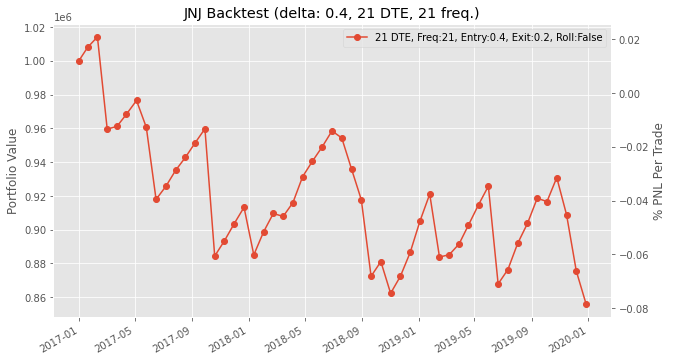

Date 2016-12-30, Expiry: 2017-01-27, Strike: 117.0, Underlying: 115.09, Premium: 1.18, Delta: 0.364969
At expiry, underlying is 113.14 , strike is 117.0
PNL 2017-01-27 00:00:00 = 9086.0 (premium = 1.18, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 114.0, Underlying: 113.14, Premium: 0.96, Delta: 0.388086
Strike was breached- At expiry, underlying is 122.58 , strike is 114.0
We lost money  PNL 2017-02-24 = -58673.999999999985 (premium = 0.96, exit = 8.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 124.0, Underlying: 122.58, Premium: 0.95, Delta: 0.363981
Strike was breached- At expiry, underlying is 125.56 , strike is 124.0
We lost money  PNL 2017-03-24 = -4697.000000000018 (premium = 0.95, exit = 1.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 127.0, Underlying: 125.56, Premium: 1.33, Delta: 0.395994
At expiry, underlying is 121.985 , strike is 127.0
PNL 2017-04-21 00:00:00 = 10241.0 (premium = 1.33, exit = 0)

Date 2017-04-21, Expiry: 2017-

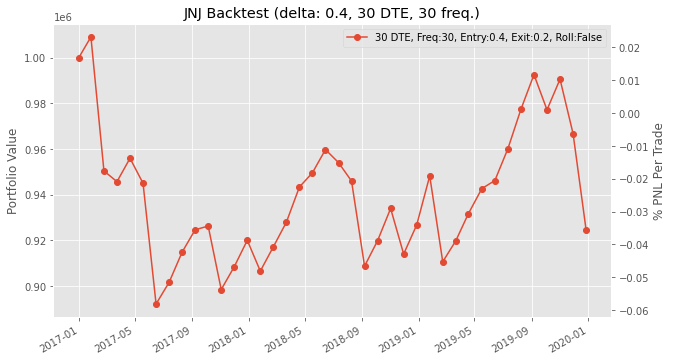

Date 2016-12-30, Expiry: 2017-02-17, Strike: 115.0, Underlying: 115.09, Premium: 2.69, Delta: 0.517649
Strike was breached- At expiry, underlying is 118.42 , strike is 115.0
We lost money  PNL 2017-02-17 = -5621.000000000014 (premium = 2.69, exit = 3.4200000000000017)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 119.0, Underlying: 118.42, Premium: 1.04, Delta: 0.385446
Strike was breached- At expiry, underlying is 124.65 , strike is 119.0
We lost money  PNL 2017-03-31 = -35497.000000000044 (premium = 1.04, exit = 5.650000000000006)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 125.0, Underlying: 124.65, Premium: 2.07, Delta: 0.486106
Strike was breached- At expiry, underlying is 126.87 , strike is 125.0
PNL 2017-05-19 00:00:00 = 1539.9999999999638 (premium = 2.07, exit = 1.8700000000000045)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 128.0, Underlying: 126.87, Premium: 1.22, Delta: 0.36642
Strike was breached- At expiry, underlying is 132.73 , strike is 128.0
We lost money  PNL 2017

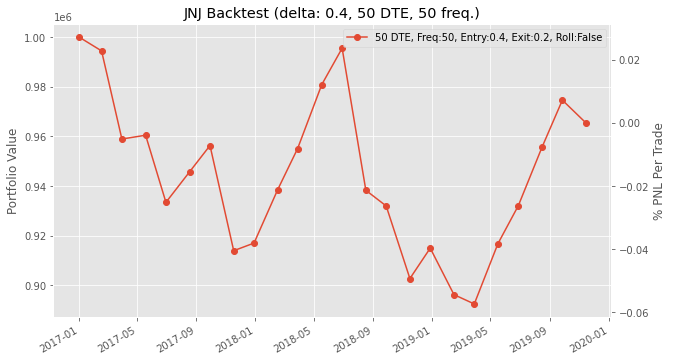

0.40.2 took 80.32901000976562 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 115.0, Underlying: 115.09, Premium: 0.84, Delta: 0.5270100000000001
Strike was breached- At expiry, underlying is 116.39 , strike is 115.0
We lost money  PNL 2017-01-06 = -4235.000000000005 (premium = 0.84, exit = 1.3900000000000006)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 117.0, Underlying: 116.39, Premium: 0.55, Delta: 0.387161
At expiry, underlying is 114.64 , strike is 117.0
PNL 2017-01-13 00:00:00 = 4235.0 (premium = 0.55, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.64, Premium: 0.57, Delta: 0.428844
At expiry, underlying is 114.14 , strike is 115.0
PNL 2017-01-20 00:00:00 = 4389.0 (premium = 0.57, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.14, Premium: 0.7, Delta: 0.382087
At expiry, underlying is 113.14 , strike is 115.0
PNL 2017-01-27 00:00:00 = 5390.0 (premium = 0.7, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Strik

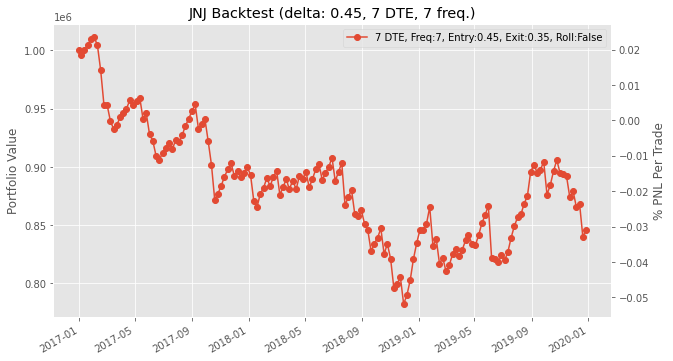

Date 2016-12-30, Expiry: 2017-01-13, Strike: 116.0, Underlying: 115.09, Premium: 0.81, Delta: 0.39292
At expiry, underlying is 114.64 , strike is 116.0
PNL 2017-01-13 00:00:00 = 6237.0 (premium = 0.81, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.64, Premium: 1.3, Delta: 0.469377
At expiry, underlying is 113.14 , strike is 115.0
PNL 2017-01-27 00:00:00 = 10010.0 (premium = 1.3, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 114.0, Underlying: 113.14, Premium: 0.62, Delta: 0.37324
Strike was breached- At expiry, underlying is 115.33 , strike is 114.0
We lost money  PNL 2017-02-10 = -5466.999999999987 (premium = 0.62, exit = 1.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 115.0, Underlying: 115.33, Premium: 0.83, Delta: 0.526061
Strike was breached- At expiry, underlying is 122.58 , strike is 115.0
We lost money  PNL 2017-02-24 = -51974.999999999985 (premium = 0.83, exit = 7.579999999999998)

Date 2017-02-24, Expiry: 2017-03-10

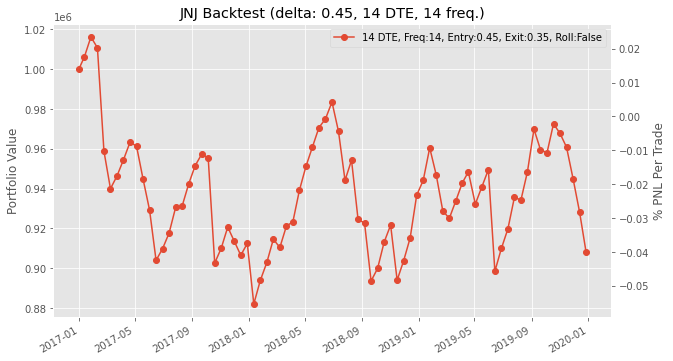

Date 2016-12-30, Expiry: 2017-01-20, Strike: 116.0, Underlying: 115.09, Premium: 1.04, Delta: 0.413177
At expiry, underlying is 114.14 , strike is 116.0
PNL 2017-01-20 00:00:00 = 8008.0 (premium = 1.04, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 115.0, Underlying: 114.14, Premium: 1.13, Delta: 0.42176
Strike was breached- At expiry, underlying is 115.33 , strike is 115.0
PNL 2017-02-10 00:00:00 = 6160.000000000013 (premium = 1.13, exit = 0.3299999999999983)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 115.0, Underlying: 115.33, Premium: 1.01, Delta: 0.486107
Strike was breached- At expiry, underlying is 123.63 , strike is 115.0
We lost money  PNL 2017-03-03 = -58673.99999999996 (premium = 1.01, exit = 8.629999999999995)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 124.0, Underlying: 123.63, Premium: 1.18, Delta: 0.467656
Strike was breached- At expiry, underlying is 125.56 , strike is 124.0
We lost money  PNL 2017-03-24 = -2926.000000000018 (premium = 1.18, exit = 1.5600

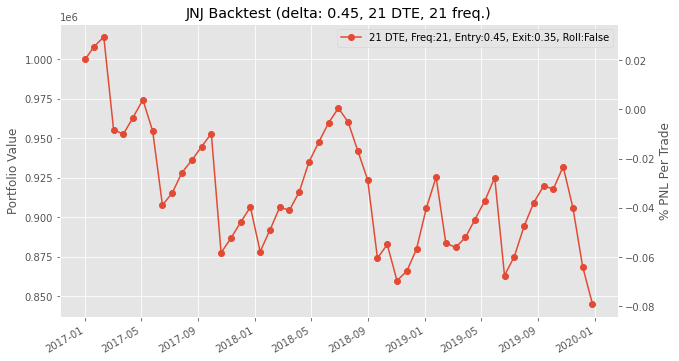

Date 2016-12-30, Expiry: 2017-01-27, Strike: 116.0, Underlying: 115.09, Premium: 1.6, Delta: 0.445572
At expiry, underlying is 113.14 , strike is 116.0
PNL 2017-01-27 00:00:00 = 12320.0 (premium = 1.6, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 113.0, Underlying: 113.14, Premium: 1.44, Delta: 0.500169
Strike was breached- At expiry, underlying is 122.58 , strike is 113.0
We lost money  PNL 2017-02-24 = -62677.99999999999 (premium = 1.44, exit = 9.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 123.0, Underlying: 122.58, Premium: 1.38, Delta: 0.463867
Strike was breached- At expiry, underlying is 125.56 , strike is 123.0
We lost money  PNL 2017-03-24 = -9086.000000000018 (premium = 1.38, exit = 2.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 126.0, Underlying: 125.56, Premium: 1.79, Delta: 0.477903
At expiry, underlying is 121.985 , strike is 126.0
PNL 2017-04-21 00:00:00 = 13783.0 (premium = 1.79, exit = 0)

Date 2017-04-21, Expiry: 2017-05

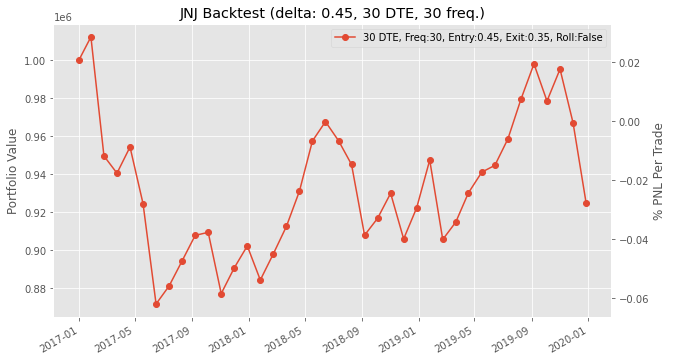

Date 2016-12-30, Expiry: 2017-02-17, Strike: 115.0, Underlying: 115.09, Premium: 2.69, Delta: 0.517649
Strike was breached- At expiry, underlying is 118.42 , strike is 115.0
We lost money  PNL 2017-02-17 = -5621.000000000014 (premium = 2.69, exit = 3.4200000000000017)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 118.0, Underlying: 118.42, Premium: 1.49, Delta: 0.485616
Strike was breached- At expiry, underlying is 124.65 , strike is 118.0
We lost money  PNL 2017-03-31 = -39732.000000000044 (premium = 1.49, exit = 6.650000000000006)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 125.0, Underlying: 124.65, Premium: 2.07, Delta: 0.486106
Strike was breached- At expiry, underlying is 126.87 , strike is 125.0
PNL 2017-05-19 00:00:00 = 1539.9999999999638 (premium = 2.07, exit = 1.8700000000000045)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 127.0, Underlying: 126.87, Premium: 1.65, Delta: 0.445201
Strike was breached- At expiry, underlying is 132.73 , strike is 127.0
We lost money  PNL 201

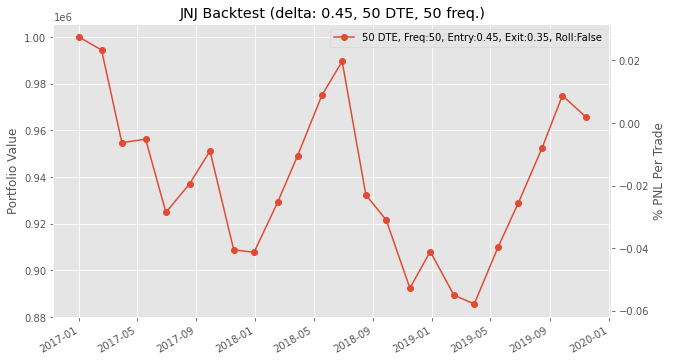

0.450.35 took 80.19517827033997 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 115.0, Underlying: 115.09, Premium: 0.84, Delta: 0.5270100000000001
Strike was breached- At expiry, underlying is 116.39 , strike is 115.0
We lost money  PNL 2017-01-06 = -4235.000000000005 (premium = 0.84, exit = 1.3900000000000006)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 117.0, Underlying: 116.39, Premium: 0.55, Delta: 0.387161
At expiry, underlying is 114.64 , strike is 117.0
PNL 2017-01-13 00:00:00 = 4235.0 (premium = 0.55, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.64, Premium: 0.57, Delta: 0.428844
At expiry, underlying is 114.14 , strike is 115.0
PNL 2017-01-20 00:00:00 = 4389.0 (premium = 0.57, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.14, Premium: 0.7, Delta: 0.382087
At expiry, underlying is 113.14 , strike is 115.0
PNL 2017-01-27 00:00:00 = 5390.0 (premium = 0.7, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Str

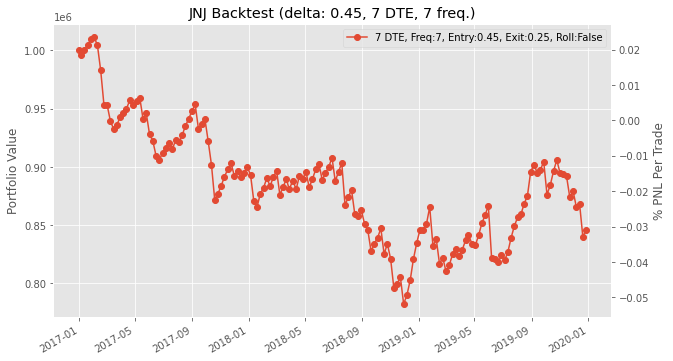

Date 2016-12-30, Expiry: 2017-01-13, Strike: 116.0, Underlying: 115.09, Premium: 0.81, Delta: 0.39292
At expiry, underlying is 114.64 , strike is 116.0
PNL 2017-01-13 00:00:00 = 6237.0 (premium = 0.81, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.64, Premium: 1.3, Delta: 0.469377
At expiry, underlying is 113.14 , strike is 115.0
PNL 2017-01-27 00:00:00 = 10010.0 (premium = 1.3, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 114.0, Underlying: 113.14, Premium: 0.62, Delta: 0.37324
Strike was breached- At expiry, underlying is 115.33 , strike is 114.0
We lost money  PNL 2017-02-10 = -5466.999999999987 (premium = 0.62, exit = 1.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 115.0, Underlying: 115.33, Premium: 0.83, Delta: 0.526061
Strike was breached- At expiry, underlying is 122.58 , strike is 115.0
We lost money  PNL 2017-02-24 = -51974.999999999985 (premium = 0.83, exit = 7.579999999999998)

Date 2017-02-24, Expiry: 2017-03-10

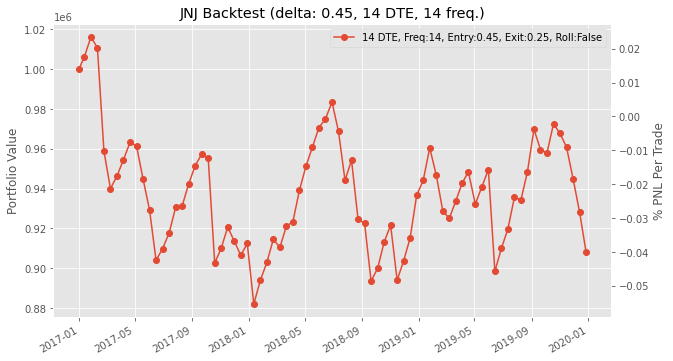

Date 2016-12-30, Expiry: 2017-01-20, Strike: 116.0, Underlying: 115.09, Premium: 1.04, Delta: 0.413177
At expiry, underlying is 114.14 , strike is 116.0
PNL 2017-01-20 00:00:00 = 8008.0 (premium = 1.04, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 115.0, Underlying: 114.14, Premium: 1.13, Delta: 0.42176
Strike was breached- At expiry, underlying is 115.33 , strike is 115.0
PNL 2017-02-10 00:00:00 = 6160.000000000013 (premium = 1.13, exit = 0.3299999999999983)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 115.0, Underlying: 115.33, Premium: 1.01, Delta: 0.486107
Strike was breached- At expiry, underlying is 123.63 , strike is 115.0
We lost money  PNL 2017-03-03 = -58673.99999999996 (premium = 1.01, exit = 8.629999999999995)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 124.0, Underlying: 123.63, Premium: 1.18, Delta: 0.467656
Strike was breached- At expiry, underlying is 125.56 , strike is 124.0
We lost money  PNL 2017-03-24 = -2926.000000000018 (premium = 1.18, exit = 1.5600

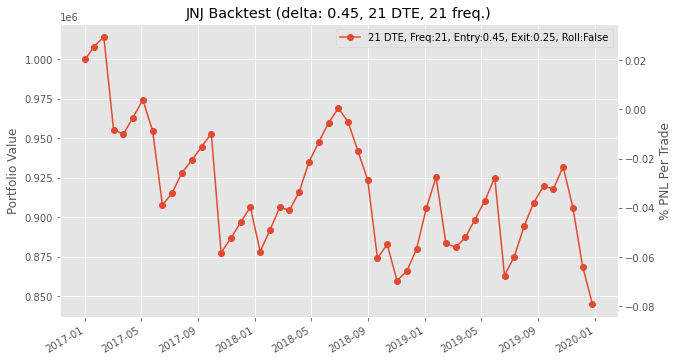

Date 2016-12-30, Expiry: 2017-01-27, Strike: 116.0, Underlying: 115.09, Premium: 1.6, Delta: 0.445572
At expiry, underlying is 113.14 , strike is 116.0
PNL 2017-01-27 00:00:00 = 12320.0 (premium = 1.6, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 113.0, Underlying: 113.14, Premium: 1.44, Delta: 0.500169
Strike was breached- At expiry, underlying is 122.58 , strike is 113.0
We lost money  PNL 2017-02-24 = -62677.99999999999 (premium = 1.44, exit = 9.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 123.0, Underlying: 122.58, Premium: 1.38, Delta: 0.463867
Strike was breached- At expiry, underlying is 125.56 , strike is 123.0
We lost money  PNL 2017-03-24 = -9086.000000000018 (premium = 1.38, exit = 2.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 126.0, Underlying: 125.56, Premium: 1.79, Delta: 0.477903
At expiry, underlying is 121.985 , strike is 126.0
PNL 2017-04-21 00:00:00 = 13783.0 (premium = 1.79, exit = 0)

Date 2017-04-21, Expiry: 2017-05

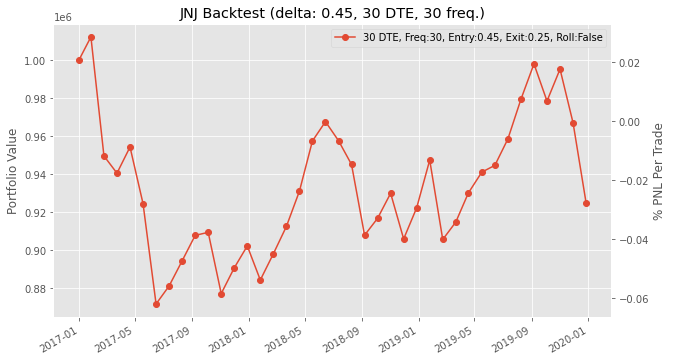

Date 2016-12-30, Expiry: 2017-02-17, Strike: 115.0, Underlying: 115.09, Premium: 2.69, Delta: 0.517649
Strike was breached- At expiry, underlying is 118.42 , strike is 115.0
We lost money  PNL 2017-02-17 = -5621.000000000014 (premium = 2.69, exit = 3.4200000000000017)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 118.0, Underlying: 118.42, Premium: 1.49, Delta: 0.485616
Strike was breached- At expiry, underlying is 124.65 , strike is 118.0
We lost money  PNL 2017-03-31 = -39732.000000000044 (premium = 1.49, exit = 6.650000000000006)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 125.0, Underlying: 124.65, Premium: 2.07, Delta: 0.486106
Strike was breached- At expiry, underlying is 126.87 , strike is 125.0
PNL 2017-05-19 00:00:00 = 1539.9999999999638 (premium = 2.07, exit = 1.8700000000000045)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 127.0, Underlying: 126.87, Premium: 1.65, Delta: 0.445201
Strike was breached- At expiry, underlying is 132.73 , strike is 127.0
We lost money  PNL 201

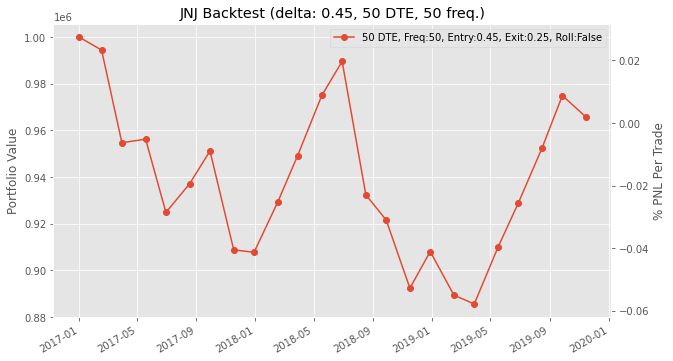

0.450.25 took 79.74332594871521 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 115.0, Underlying: 115.09, Premium: 0.84, Delta: 0.5270100000000001
Strike was breached- At expiry, underlying is 116.39 , strike is 115.0
We lost money  PNL 2017-01-06 = -4235.000000000005 (premium = 0.84, exit = 1.3900000000000006)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 116.0, Underlying: 116.39, Premium: 1.05, Delta: 0.579331
At expiry, underlying is 114.64 , strike is 116.0
PNL 2017-01-13 00:00:00 = 8085.0 (premium = 1.05, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.64, Premium: 0.57, Delta: 0.428844
At expiry, underlying is 114.14 , strike is 115.0
PNL 2017-01-20 00:00:00 = 4389.0 (premium = 0.57, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 114.0, Underlying: 114.14, Premium: 1.18, Delta: 0.529044
At expiry, underlying is 113.14 , strike is 114.0
PNL 2017-01-27 00:00:00 = 9086.0 (premium = 1.18, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, S

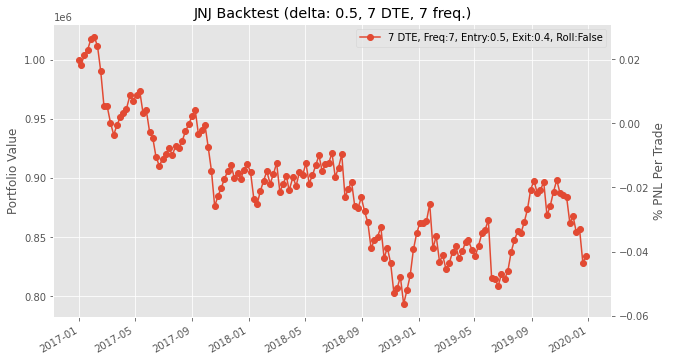

Date 2016-12-30, Expiry: 2017-01-13, Strike: 115.0, Underlying: 115.09, Premium: 1.26, Delta: 0.526835
At expiry, underlying is 114.64 , strike is 115.0
PNL 2017-01-13 00:00:00 = 9702.0 (premium = 1.26, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.64, Premium: 1.3, Delta: 0.469377
At expiry, underlying is 113.14 , strike is 115.0
PNL 2017-01-27 00:00:00 = 10010.0 (premium = 1.3, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 113.0, Underlying: 113.14, Premium: 1.1, Delta: 0.5334800000000001
Strike was breached- At expiry, underlying is 115.33 , strike is 113.0
We lost money  PNL 2017-02-10 = -9470.999999999985 (premium = 1.1, exit = 2.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 115.0, Underlying: 115.33, Premium: 0.83, Delta: 0.526061
Strike was breached- At expiry, underlying is 122.58 , strike is 115.0
We lost money  PNL 2017-02-24 = -51974.999999999985 (premium = 0.83, exit = 7.579999999999998)

Date 2017-02-24, Expiry: 

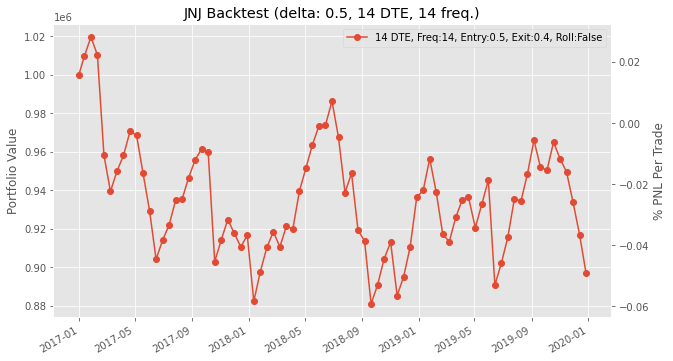

Date 2016-12-30, Expiry: 2017-01-20, Strike: 115.0, Underlying: 115.09, Premium: 1.55, Delta: 0.52461
At expiry, underlying is 114.14 , strike is 115.0
PNL 2017-01-20 00:00:00 = 11935.0 (premium = 1.55, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 114.0, Underlying: 114.14, Premium: 1.64, Delta: 0.5277189999999999
Strike was breached- At expiry, underlying is 115.33 , strike is 114.0
PNL 2017-02-10 00:00:00 = 2387.0000000000123 (premium = 1.64, exit = 1.3299999999999983)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 115.0, Underlying: 115.33, Premium: 1.01, Delta: 0.486107
Strike was breached- At expiry, underlying is 123.63 , strike is 115.0
We lost money  PNL 2017-03-03 = -58673.99999999996 (premium = 1.01, exit = 8.629999999999995)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 124.0, Underlying: 123.63, Premium: 1.18, Delta: 0.467656
Strike was breached- At expiry, underlying is 125.56 , strike is 124.0
We lost money  PNL 2017-03-24 = -2926.000000000018 (premium = 1.18, e

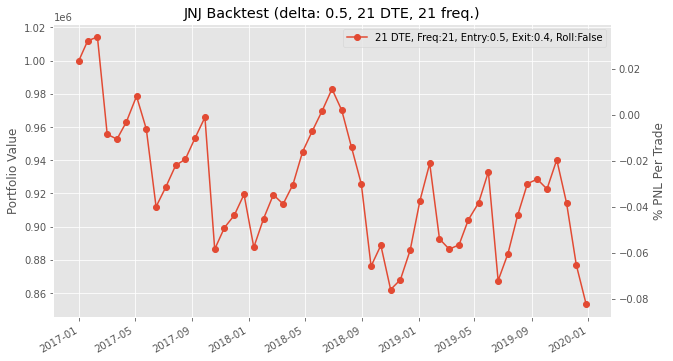

Date 2016-12-30, Expiry: 2017-01-27, Strike: 115.0, Underlying: 115.09, Premium: 2.12, Delta: 0.526139
At expiry, underlying is 113.14 , strike is 115.0
PNL 2017-01-27 00:00:00 = 16324.0 (premium = 2.12, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 113.0, Underlying: 113.14, Premium: 1.44, Delta: 0.500169
Strike was breached- At expiry, underlying is 122.58 , strike is 113.0
We lost money  PNL 2017-02-24 = -62677.99999999999 (premium = 1.44, exit = 9.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 123.0, Underlying: 122.58, Premium: 1.38, Delta: 0.463867
Strike was breached- At expiry, underlying is 125.56 , strike is 123.0
We lost money  PNL 2017-03-24 = -9086.000000000018 (premium = 1.38, exit = 2.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 126.0, Underlying: 125.56, Premium: 1.79, Delta: 0.477903
At expiry, underlying is 121.985 , strike is 126.0
PNL 2017-04-21 00:00:00 = 13783.0 (premium = 1.79, exit = 0)

Date 2017-04-21, Expiry: 2017-

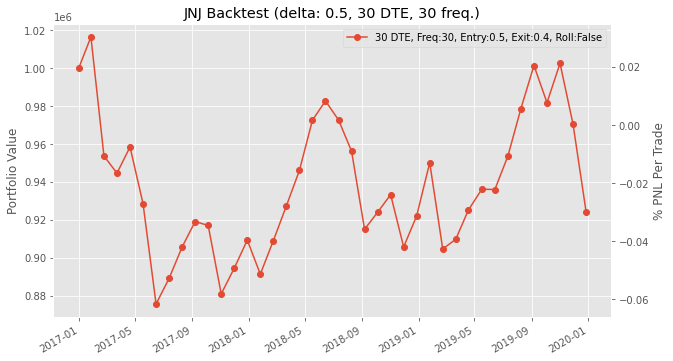

Date 2016-12-30, Expiry: 2017-02-17, Strike: 115.0, Underlying: 115.09, Premium: 2.69, Delta: 0.517649
Strike was breached- At expiry, underlying is 118.42 , strike is 115.0
We lost money  PNL 2017-02-17 = -5621.000000000014 (premium = 2.69, exit = 3.4200000000000017)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 118.0, Underlying: 118.42, Premium: 1.49, Delta: 0.485616
Strike was breached- At expiry, underlying is 124.65 , strike is 118.0
We lost money  PNL 2017-03-31 = -39732.000000000044 (premium = 1.49, exit = 6.650000000000006)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 125.0, Underlying: 124.65, Premium: 2.07, Delta: 0.486106
Strike was breached- At expiry, underlying is 126.87 , strike is 125.0
PNL 2017-05-19 00:00:00 = 1539.9999999999638 (premium = 2.07, exit = 1.8700000000000045)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 126.0, Underlying: 126.87, Premium: 2.18, Delta: 0.523473
Strike was breached- At expiry, underlying is 132.73 , strike is 126.0
We lost money  PNL 201

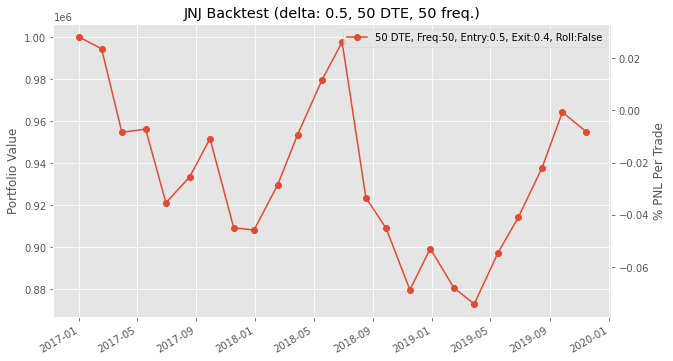

0.50.4 took 80.46496224403381 seconds
Date 2016-12-30, Expiry: 2017-01-06, Strike: 115.0, Underlying: 115.09, Premium: 0.84, Delta: 0.5270100000000001
Strike was breached- At expiry, underlying is 116.39 , strike is 115.0
We lost money  PNL 2017-01-06 = -4235.000000000005 (premium = 0.84, exit = 1.3900000000000006)

Date 2017-01-06, Expiry: 2017-01-13, Strike: 116.0, Underlying: 116.39, Premium: 1.05, Delta: 0.579331
At expiry, underlying is 114.64 , strike is 116.0
PNL 2017-01-13 00:00:00 = 8085.0 (premium = 1.05, exit = 0)

Date 2017-01-13, Expiry: 2017-01-20, Strike: 115.0, Underlying: 114.64, Premium: 0.57, Delta: 0.428844
At expiry, underlying is 114.14 , strike is 115.0
PNL 2017-01-20 00:00:00 = 4389.0 (premium = 0.57, exit = 0)

Date 2017-01-20, Expiry: 2017-01-27, Strike: 114.0, Underlying: 114.14, Premium: 1.18, Delta: 0.529044
At expiry, underlying is 113.14 , strike is 114.0
PNL 2017-01-27 00:00:00 = 9086.0 (premium = 1.18, exit = 0)

Date 2017-01-27, Expiry: 2017-02-03, Str

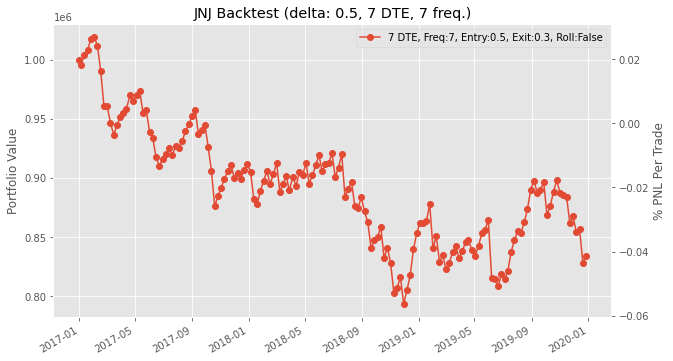

Date 2016-12-30, Expiry: 2017-01-13, Strike: 115.0, Underlying: 115.09, Premium: 1.26, Delta: 0.526835
At expiry, underlying is 114.64 , strike is 115.0
PNL 2017-01-13 00:00:00 = 9702.0 (premium = 1.26, exit = 0)

Date 2017-01-13, Expiry: 2017-01-27, Strike: 115.0, Underlying: 114.64, Premium: 1.3, Delta: 0.469377
At expiry, underlying is 113.14 , strike is 115.0
PNL 2017-01-27 00:00:00 = 10010.0 (premium = 1.3, exit = 0)

Date 2017-01-27, Expiry: 2017-02-10, Strike: 113.0, Underlying: 113.14, Premium: 1.1, Delta: 0.5334800000000001
Strike was breached- At expiry, underlying is 115.33 , strike is 113.0
We lost money  PNL 2017-02-10 = -9470.999999999985 (premium = 1.1, exit = 2.3299999999999983)

Date 2017-02-10, Expiry: 2017-02-24, Strike: 115.0, Underlying: 115.33, Premium: 0.83, Delta: 0.526061
Strike was breached- At expiry, underlying is 122.58 , strike is 115.0
We lost money  PNL 2017-02-24 = -51974.999999999985 (premium = 0.83, exit = 7.579999999999998)

Date 2017-02-24, Expiry: 

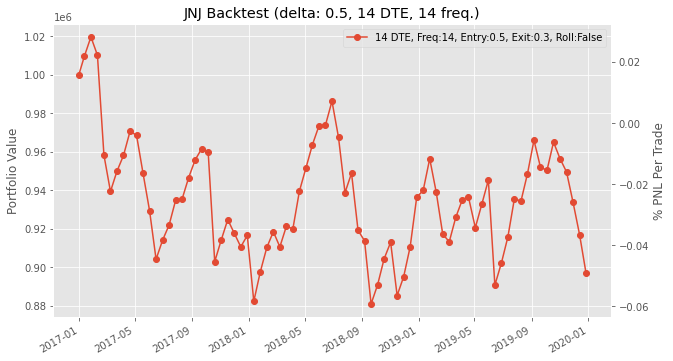

Date 2016-12-30, Expiry: 2017-01-20, Strike: 115.0, Underlying: 115.09, Premium: 1.55, Delta: 0.52461
At expiry, underlying is 114.14 , strike is 115.0
PNL 2017-01-20 00:00:00 = 11935.0 (premium = 1.55, exit = 0)

Date 2017-01-20, Expiry: 2017-02-10, Strike: 114.0, Underlying: 114.14, Premium: 1.64, Delta: 0.5277189999999999
Strike was breached- At expiry, underlying is 115.33 , strike is 114.0
PNL 2017-02-10 00:00:00 = 2387.0000000000123 (premium = 1.64, exit = 1.3299999999999983)

Date 2017-02-10, Expiry: 2017-03-03, Strike: 115.0, Underlying: 115.33, Premium: 1.01, Delta: 0.486107
Strike was breached- At expiry, underlying is 123.63 , strike is 115.0
We lost money  PNL 2017-03-03 = -58673.99999999996 (premium = 1.01, exit = 8.629999999999995)

Date 2017-03-03, Expiry: 2017-03-24, Strike: 124.0, Underlying: 123.63, Premium: 1.18, Delta: 0.467656
Strike was breached- At expiry, underlying is 125.56 , strike is 124.0
We lost money  PNL 2017-03-24 = -2926.000000000018 (premium = 1.18, e

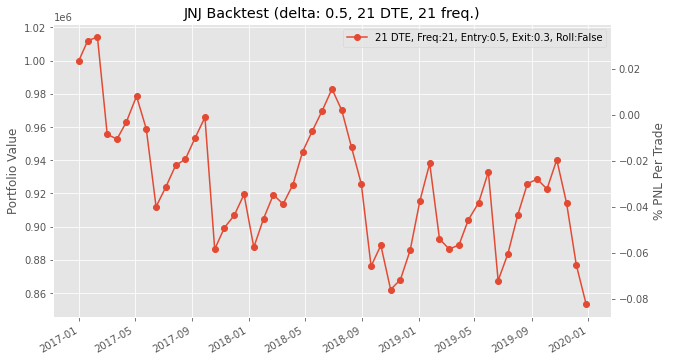

Date 2016-12-30, Expiry: 2017-01-27, Strike: 115.0, Underlying: 115.09, Premium: 2.12, Delta: 0.526139
At expiry, underlying is 113.14 , strike is 115.0
PNL 2017-01-27 00:00:00 = 16324.0 (premium = 2.12, exit = 0)

Date 2017-01-27, Expiry: 2017-02-24, Strike: 113.0, Underlying: 113.14, Premium: 1.44, Delta: 0.500169
Strike was breached- At expiry, underlying is 122.58 , strike is 113.0
We lost money  PNL 2017-02-24 = -62677.99999999999 (premium = 1.44, exit = 9.579999999999998)

Date 2017-02-24, Expiry: 2017-03-24, Strike: 123.0, Underlying: 122.58, Premium: 1.38, Delta: 0.463867
Strike was breached- At expiry, underlying is 125.56 , strike is 123.0
We lost money  PNL 2017-03-24 = -9086.000000000018 (premium = 1.38, exit = 2.5600000000000023)

Date 2017-03-24, Expiry: 2017-04-21, Strike: 126.0, Underlying: 125.56, Premium: 1.79, Delta: 0.477903
At expiry, underlying is 121.985 , strike is 126.0
PNL 2017-04-21 00:00:00 = 13783.0 (premium = 1.79, exit = 0)

Date 2017-04-21, Expiry: 2017-

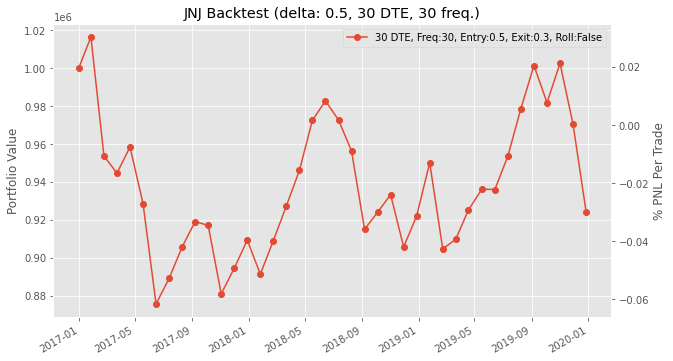

Date 2016-12-30, Expiry: 2017-02-17, Strike: 115.0, Underlying: 115.09, Premium: 2.69, Delta: 0.517649
Strike was breached- At expiry, underlying is 118.42 , strike is 115.0
We lost money  PNL 2017-02-17 = -5621.000000000014 (premium = 2.69, exit = 3.4200000000000017)

Date 2017-02-17, Expiry: 2017-03-31, Strike: 118.0, Underlying: 118.42, Premium: 1.49, Delta: 0.485616
Strike was breached- At expiry, underlying is 124.65 , strike is 118.0
We lost money  PNL 2017-03-31 = -39732.000000000044 (premium = 1.49, exit = 6.650000000000006)

Date 2017-03-31, Expiry: 2017-05-19, Strike: 125.0, Underlying: 124.65, Premium: 2.07, Delta: 0.486106
Strike was breached- At expiry, underlying is 126.87 , strike is 125.0
PNL 2017-05-19 00:00:00 = 1539.9999999999638 (premium = 2.07, exit = 1.8700000000000045)

Date 2017-05-19, Expiry: 2017-06-30, Strike: 126.0, Underlying: 126.87, Premium: 2.18, Delta: 0.523473
Strike was breached- At expiry, underlying is 132.73 , strike is 126.0
We lost money  PNL 201

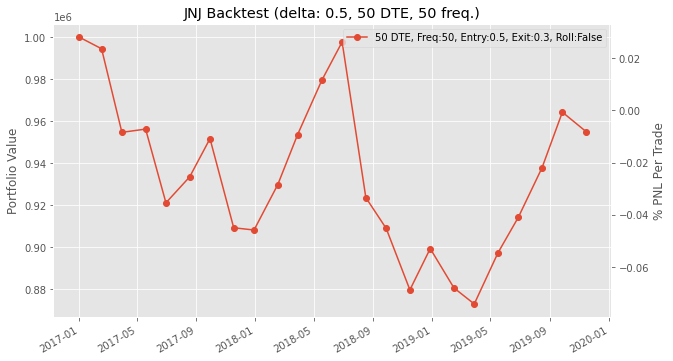

0.50.3 took 82.37459635734558 seconds
    [Entry,Exit]         7        14        21        30         50
0       [0.1, 0]  931431.5  972819.0  897089.5  964387.5  1002541.0
1     [0.2, 0.1]  906175.5  953607.5  871833.5  943597.5  1017055.5
2     [0.2, 0.0]  906175.5  953607.5  871833.5  943597.5  1017055.5
3   [0.25, 0.15]  868638.0  936513.5  856587.5  942596.5  1039385.5
4   [0.25, 0.05]  868638.0  936513.5  856587.5  942596.5  1039385.5
5     [0.3, 0.2]  864480.0  925802.8  841803.5  937437.5  1008970.5
6     [0.3, 0.1]  864480.0  925802.8  841803.5  937437.5  1008970.5
7   [0.35, 0.25]  855702.0  926526.6  847694.0  943366.5   977785.5
8   [0.35, 0.15]  855702.0  926526.6  847694.0  943366.5   977785.5
9     [0.4, 0.3]  845769.0  926757.6  856010.0  924655.5   965311.5
10    [0.4, 0.2]  845769.0  926757.6  856010.0  924655.5   965311.5
11  [0.45, 0.35]  845692.0  908046.6  845153.0  924963.5   965619.5
12  [0.45, 0.25]  845692.0  908046.6  845153.0  924963.5   965619.5
13    [0.5

In [ ]:
start = time.time()
# Returns Dataframe
data = {'[Entry,Exit]':[[.1,0]],7:[0]}
returns_df = pd.DataFrame(data)
for i in [7,14,21,30,50]:
    returns_df[i] = [np.float(0)]
for entry in range(4,11):
    for gap in range(1,3):
        data = {f'[Entry,Exit]':[[round(entry * 0.05,2), round((entry) *0.05  - (gap) * 0.1 ,2)]]}
        df2 = pd.DataFrame(data)
        for i in [7,14,21,30,50]:
            df2[i] = [np.float(0)]
        returns_df = pd.concat([returns_df,df2],ignore_index = True)

# Sharpe Dataframe
data = {'[Entry,Exit]':[[.1,0]],7:[0]}
sharpe_df = pd.DataFrame(data)
for i in [7,14,21,30,50]:
    sharpe_df[i] = [np.float(0)]
for entry in range(4,11):
    for gap in range(1,3):
      data = {f'[Entry,Exit]':[[round(entry * 0.05,2), round((entry) *0.05  - (gap) * 0.1 ,2)]]}
      df2 = pd.DataFrame(data)
      for i in [7,14,21,30,50]:
          df2[i] = [np.float(0)]
      sharpe_df = pd.concat([sharpe_df,df2],ignore_index = True)
print(f'Initialization took {time.time()-start} seconds')

for index, row in returns_df.iterrows():
    start = time.time()
    x,entry_exit = list(row.iteritems())[0]
    entry = entry_exit[0]
    exit = entry_exit[1]
    for dte, columnData in list(row.iteritems())[1:]:
        port_backtest = portfolio(df = df, dte_sell = dte, exit_signal = None, frequency= dte,strike_signal_val = entry, exit_signal_val = exit, roll_positions = False)
        port_backtest.backtest_v2()
        returns_df.at[index,dte] = copy.deepcopy(port_bac ktest.final_return())
        sharpe_df.at[index,dte] = copy.deepcopy(port_backtest.sharpe())
        plot_returns([port_backtest])
    print(f'{entry}{exit} took {time.time() - start} seconds')
print(returns_df)
print(sharpe_df)

Initialization took 0.10315585136413574 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 108.0, Underlying: 104.57, Premium: 0.13, Delta: 0.103282
Expired call (expiry 2015-01-09 00:00:00, strike = 108.0) on 2014-12-31
At expiry, underlying is 105.01 , strike is 108.0
PNL 2015-01-09 00:00:00 = 1001.0 (premium = 0.13, exit = 0)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 108.0, Underlying: 105.01, Premium: 0.07, Delta: 0.079788
Expired call (expiry 2015-01-17 00:00:00, strike = 108.0) on 2015-01-09
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 108.0
PNL 2015-01-17 00:00:00 = 539.0 (premium = 0.07, exit = 0)

Date 2015-01-16, Expiry: 2015-01-23, Strike: 107.0, Underlying: 104.04, Premium: 0.17, Delta: 0.131246
Expired call (expiry 2015-01-23 00:00:00, strike = 107.0) on 2015-01-16
At expiry, underlying is 102.18 , strike is 107.0
PNL 2015-01-23 00:00:00 = 1309.0 (premium = 0.17, exit

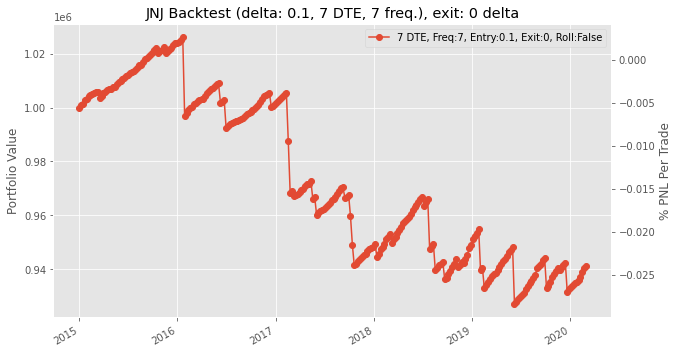

Date 2014-12-31, Expiry: 2015-01-17, Strike: 109.0, Underlying: 104.57, Premium: 0.16, Delta: 0.100641
Expired call (expiry 2015-01-17 00:00:00, strike = 109.0) on 2014-12-31
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 109.0
PNL 2015-01-17 00:00:00 = 1232.0 (premium = 0.16, exit = 0)

Date 2015-01-16, Expiry: 2015-01-30, Strike: 109.0, Underlying: 104.04, Premium: 0.17, Delta: 0.09865
Expired call (expiry 2015-01-30 00:00:00, strike = 109.0) on 2015-01-16
At expiry, underlying is 100.33 , strike is 109.0
PNL 2015-01-30 00:00:00 = 1309.0 (premium = 0.17, exit = 0)

Date 2015-01-30, Expiry: 2015-02-13, Strike: 105.0, Underlying: 100.33, Premium: 0.15, Delta: 0.096888
Expired call (expiry 2015-02-13 00:00:00, strike = 105.0) on 2015-01-30
At expiry, underlying is 99.6099 , strike is 105.0
PNL 2015-02-13 00:00:00 = 1155.0 (premium = 0.15, exit = 0)

Date 2015-02-13, Expiry: 2015-02-27, Str

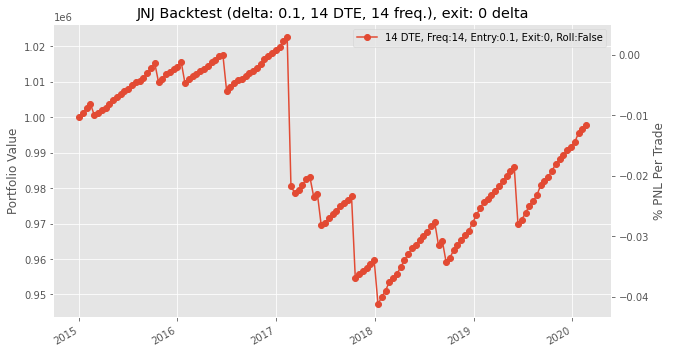

Date 2014-12-31, Expiry: 2015-01-23, Strike: 110.0, Underlying: 104.57, Premium: 0.22, Delta: 0.108816
Expired call (expiry 2015-01-23 00:00:00, strike = 110.0) on 2014-12-31
At expiry, underlying is 102.18 , strike is 110.0
PNL 2015-01-23 00:00:00 = 1694.0 (premium = 0.22, exit = 0)

Date 2015-01-23, Expiry: 2015-02-13, Strike: 106.0, Underlying: 102.18, Premium: 0.17, Delta: 0.115318
Expired call (expiry 2015-02-13 00:00:00, strike = 106.0) on 2015-01-23
At expiry, underlying is 99.6099 , strike is 106.0
PNL 2015-02-13 00:00:00 = 1309.0 (premium = 0.17, exit = 0)

Date 2015-02-13, Expiry: 2015-03-06, Strike: 103.0, Underlying: 99.6099, Premium: 0.18, Delta: 0.113397
Expired call (expiry 2015-03-06 00:00:00, strike = 103.0) on 2015-02-13
At expiry, underlying is 100.01 , strike is 103.0
PNL 2015-03-06 00:00:00 = 1386.0 (premium = 0.18, exit = 0)

Date 2015-03-06, Expiry: 2015-03-27, Strike: 104.0, Underlying: 100.01, Premium: 0.15, Delta: 0.102866
Expired call (expiry 2015-03-27 00:00

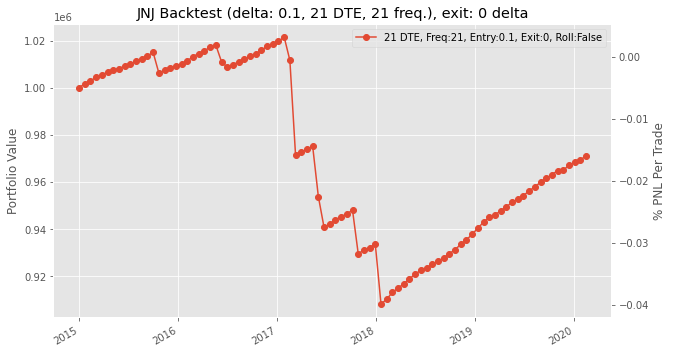

Date 2014-12-31, Expiry: 2015-01-30, Strike: 111.0, Underlying: 104.57, Premium: 0.25, Delta: 0.110206
Expired call (expiry 2015-01-30 00:00:00, strike = 111.0) on 2014-12-31
At expiry, underlying is 100.33 , strike is 111.0
PNL 2015-01-30 00:00:00 = 1925.0 (premium = 0.25, exit = 0)

Date 2015-01-30, Expiry: 2015-02-27, Strike: 106.0, Underlying: 100.33, Premium: 0.19, Delta: 0.094336
Expired call (expiry 2015-02-27 00:00:00, strike = 106.0) on 2015-01-30
At expiry, underlying is 102.55 , strike is 106.0
PNL 2015-02-27 00:00:00 = 1463.0 (premium = 0.19, exit = 0)

Date 2015-02-27, Expiry: 2015-03-27, Strike: 107.0, Underlying: 102.55, Premium: 0.18, Delta: 0.11253
Expired call (expiry 2015-03-27 00:00:00, strike = 107.0) on 2015-02-27
At expiry, underlying is 100.34 , strike is 107.0
PNL 2015-03-27 00:00:00 = 1386.0 (premium = 0.18, exit = 0)

Date 2015-03-27, Expiry: 2015-04-24, Strike: 107.0, Underlying: 100.34, Premium: 0.17, Delta: 0.083753
Expired call (expiry 2015-04-24 00:00:00

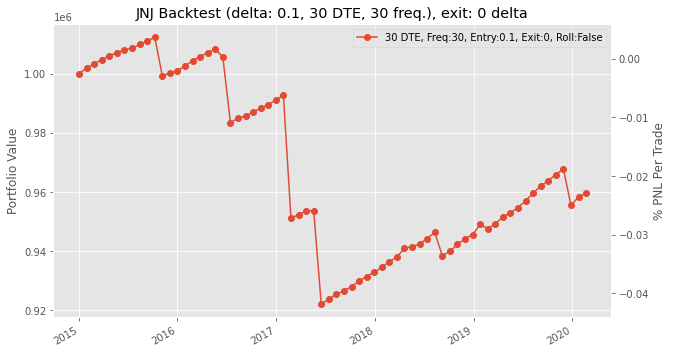

0.10 took 95.81440138816833 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 107.0, Underlying: 104.57, Premium: 0.26, Delta: 0.185105
Bought back call (expiry 2015-01-09 00:00:00, strike = 107.0) on 2015-01-05 for 0.03
PNL 2015-01-05 00:00:00 = 1771.0 (premium = 0.26, exit = 0.03)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 105.0, Underlying: 103.28, Premium: 0.14, Delta: 0.158174
Expired call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 105.0
PNL 2015-01-09 00:00:00 = 1000.9999999999607 (premium = 0.14, exit = 0.010000000000005116)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 107.0, Underlying: 105.01, Premium: 0.19, Delta: 0.171664
Bought back call (expiry 2015-01-17 00:00:00, strike = 107.0) on 2015-01-12 for 0.03
PNL 2015-01-12 00:00:00 = 1232.0 (premium = 0.19, exit = 0.03)

Date 2015-01-13, Expiry: 2015-01-17, Strike: 106.0, Underlying: 104.57, Premium: 0.11, Delta: 0.155333
Bought back call (e

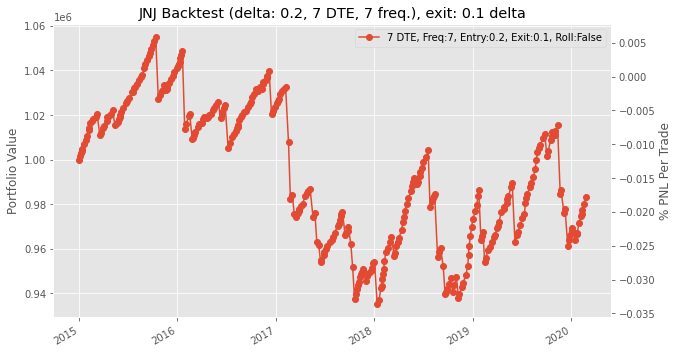

Date 2014-12-31, Expiry: 2015-01-17, Strike: 108.0, Underlying: 104.57, Premium: 0.28, Delta: 0.160722
Bought back call (expiry 2015-01-17 00:00:00, strike = 108.0) on 2015-01-05 for 0.09
PNL 2015-01-05 00:00:00 = 1463.0000000000002 (premium = 0.28, exit = 0.09)

Date 2015-01-06, Expiry: 2015-01-17, Strike: 106.0, Underlying: 103.28, Premium: 0.24, Delta: 0.16536900000000002
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-14 for 0.03
PNL 2015-01-14 00:00:00 = 1617.0 (premium = 0.24, exit = 0.03)

Date 2015-01-15, Expiry: 2015-01-30, Strike: 106.0, Underlying: 102.54, Premium: 0.44, Delta: 0.202764
Bought back call (expiry 2015-01-30 00:00:00, strike = 106.0) on 2015-01-20 for 0.07
PNL 2015-01-20 00:00:00 = 2849.0 (premium = 0.44, exit = 0.07)

Date 2015-01-21, Expiry: 2015-02-06, Strike: 105.0, Underlying: 101.9, Premium: 0.27, Delta: 0.168857
Bought back call (expiry 2015-02-06 00:00:00, strike = 105.0) on 2015-01-30 for 0.02
PNL 2015-01-30 00:00:00 = 1925.0 (

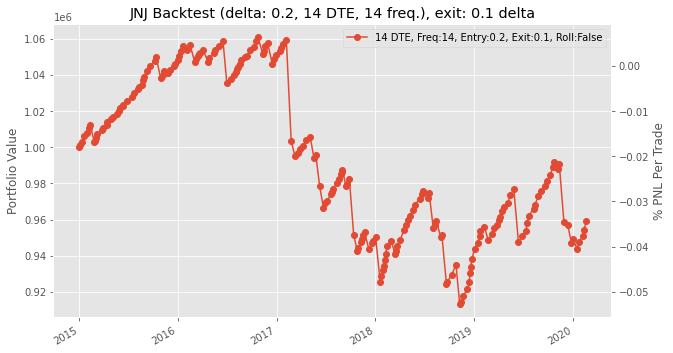

Date 2014-12-31, Expiry: 2015-01-23, Strike: 108.0, Underlying: 104.57, Premium: 0.55, Delta: 0.22607
Bought back call (expiry 2015-01-23 00:00:00, strike = 108.0) on 2015-01-14 for 0.11
PNL 2015-01-14 00:00:00 = 3388.0000000000005 (premium = 0.55, exit = 0.11)

Date 2015-01-15, Expiry: 2015-02-06, Strike: 106.0, Underlying: 102.54, Premium: 0.55, Delta: 0.225052
Bought back call (expiry 2015-02-06 00:00:00, strike = 106.0) on 2015-01-21 for 0.14
PNL 2015-01-21 00:00:00 = 3157.0000000000005 (premium = 0.55, exit = 0.14)

Date 2015-01-22, Expiry: 2015-02-13, Strike: 106.0, Underlying: 103.625, Premium: 0.43, Delta: 0.23617800000000005
Bought back call (expiry 2015-02-13 00:00:00, strike = 106.0) on 2015-01-26 for 0.08
PNL 2015-01-26 00:00:00 = 2695.0 (premium = 0.43, exit = 0.08)

Date 2015-01-27, Expiry: 2015-02-20, Strike: 105.0, Underlying: 102.09, Premium: 0.38, Delta: 0.193061
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-02-02 for 0.14
PNL 2015-02-02 00:00:

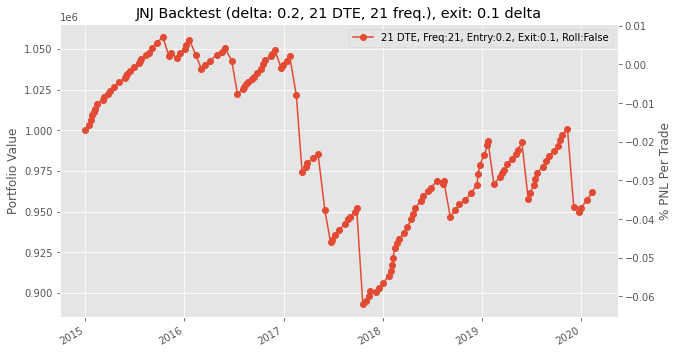

Date 2014-12-31, Expiry: 2015-01-30, Strike: 109.0, Underlying: 104.57, Premium: 0.52, Delta: 0.199396
Bought back call (expiry 2015-01-30 00:00:00, strike = 109.0) on 2015-01-06 for 0.18
PNL 2015-01-06 00:00:00 = 2618.0 (premium = 0.52, exit = 0.18)

Date 2015-01-07, Expiry: 2015-02-06, Strike: 110.0, Underlying: 105.56, Premium: 0.45, Delta: 0.17820999999999998
Bought back call (expiry 2015-02-06 00:00:00, strike = 110.0) on 2015-01-13 for 0.19
PNL 2015-01-13 00:00:00 = 2002.0 (premium = 0.45, exit = 0.19)

Date 2015-01-14, Expiry: 2015-02-13, Strike: 108.0, Underlying: 103.935, Premium: 0.57, Delta: 0.21119
Bought back call (expiry 2015-02-13 00:00:00, strike = 108.0) on 2015-01-20 for 0.13
PNL 2015-01-20 00:00:00 = 3387.9999999999995 (premium = 0.57, exit = 0.13)

Date 2015-01-21, Expiry: 2015-02-20, Strike: 105.0, Underlying: 101.9, Premium: 0.53, Delta: 0.221934
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-02-02 for 0.14
PNL 2015-02-02 00:00:00 = 3003.0 (

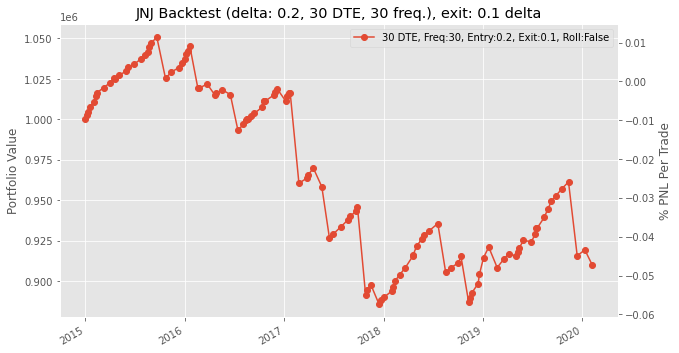

0.20.1 took 109.02787160873413 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 107.0, Underlying: 104.57, Premium: 0.26, Delta: 0.185105
Expired call (expiry 2015-01-09 00:00:00, strike = 107.0) on 2014-12-31
At expiry, underlying is 105.01 , strike is 107.0
PNL 2015-01-09 00:00:00 = 2002.0 (premium = 0.26, exit = 0)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 107.0, Underlying: 105.01, Premium: 0.19, Delta: 0.171664
Expired call (expiry 2015-01-17 00:00:00, strike = 107.0) on 2015-01-09
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 107.0
PNL 2015-01-17 00:00:00 = 1463.0 (premium = 0.19, exit = 0)

Date 2015-01-16, Expiry: 2015-01-23, Strike: 106.0, Underlying: 104.04, Premium: 0.37, Delta: 0.236488
Expired call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-16
At expiry, underlying is 102.18 , strike is 106.0
PNL 2015-01-23 00:00:00 = 2849.0 (premium = 0.37, exit = 0)

D

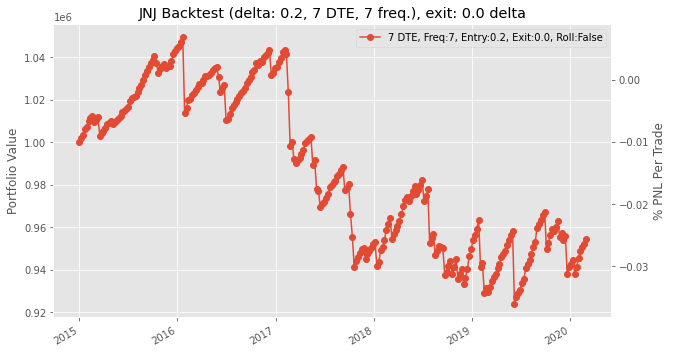

Date 2014-12-31, Expiry: 2015-01-17, Strike: 108.0, Underlying: 104.57, Premium: 0.28, Delta: 0.160722
Expired call (expiry 2015-01-17 00:00:00, strike = 108.0) on 2014-12-31
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 108.0
PNL 2015-01-17 00:00:00 = 2156.0 (premium = 0.28, exit = 0)

Date 2015-01-16, Expiry: 2015-01-30, Strike: 107.0, Underlying: 104.04, Premium: 0.41, Delta: 0.20852
Expired call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-16
At expiry, underlying is 100.33 , strike is 107.0
PNL 2015-01-30 00:00:00 = 3157.0 (premium = 0.41, exit = 0)

Date 2015-01-30, Expiry: 2015-02-13, Strike: 103.0, Underlying: 100.33, Premium: 0.41, Delta: 0.22185900000000006
Expired call (expiry 2015-02-13 00:00:00, strike = 103.0) on 2015-01-30
At expiry, underlying is 99.6099 , strike is 103.0
PNL 2015-02-13 00:00:00 = 3157.0 (premium = 0.41, exit = 0)

Date 2015-02-13, Expiry: 2015

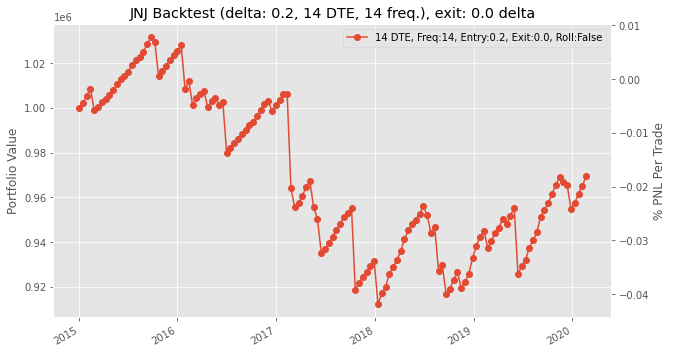

Date 2014-12-31, Expiry: 2015-01-23, Strike: 108.0, Underlying: 104.57, Premium: 0.55, Delta: 0.22607
Expired call (expiry 2015-01-23 00:00:00, strike = 108.0) on 2014-12-31
At expiry, underlying is 102.18 , strike is 108.0
PNL 2015-01-23 00:00:00 = 4235.0 (premium = 0.55, exit = 0)

Date 2015-01-23, Expiry: 2015-02-13, Strike: 105.0, Underlying: 102.18, Premium: 0.31, Delta: 0.188434
Expired call (expiry 2015-02-13 00:00:00, strike = 105.0) on 2015-01-23
At expiry, underlying is 99.6099 , strike is 105.0
PNL 2015-02-13 00:00:00 = 2387.0 (premium = 0.31, exit = 0)

Date 2015-02-13, Expiry: 2015-03-06, Strike: 102.0, Underlying: 99.6099, Premium: 0.33, Delta: 0.186853
Expired call (expiry 2015-03-06 00:00:00, strike = 102.0) on 2015-02-13
At expiry, underlying is 100.01 , strike is 102.0
PNL 2015-03-06 00:00:00 = 2541.0 (premium = 0.33, exit = 0)

Date 2015-03-06, Expiry: 2015-03-27, Strike: 103.0, Underlying: 100.01, Premium: 0.29, Delta: 0.17588900000000002
Expired call (expiry 2015-0

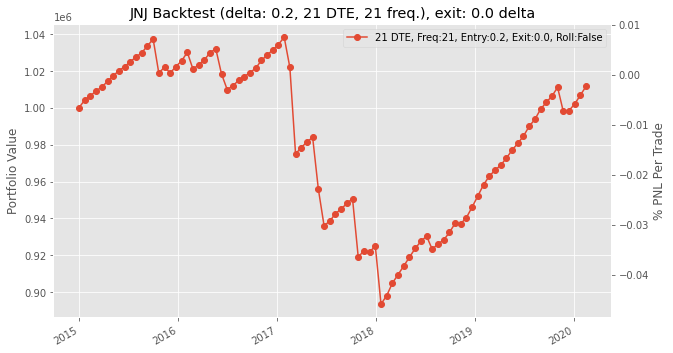

Date 2014-12-31, Expiry: 2015-01-30, Strike: 109.0, Underlying: 104.57, Premium: 0.52, Delta: 0.199396
Expired call (expiry 2015-01-30 00:00:00, strike = 109.0) on 2014-12-31
At expiry, underlying is 100.33 , strike is 109.0
PNL 2015-01-30 00:00:00 = 4004.0 (premium = 0.52, exit = 0)

Date 2015-01-30, Expiry: 2015-02-27, Strike: 104.0, Underlying: 100.33, Premium: 0.46, Delta: 0.196389
Expired call (expiry 2015-02-27 00:00:00, strike = 104.0) on 2015-01-30
At expiry, underlying is 102.55 , strike is 104.0
PNL 2015-02-27 00:00:00 = 3542.0 (premium = 0.46, exit = 0)

Date 2015-02-27, Expiry: 2015-03-27, Strike: 106.0, Underlying: 102.55, Premium: 0.32, Delta: 0.176879
Expired call (expiry 2015-03-27 00:00:00, strike = 106.0) on 2015-02-27
At expiry, underlying is 100.34 , strike is 106.0
PNL 2015-03-27 00:00:00 = 2464.0 (premium = 0.32, exit = 0)

Date 2015-03-27, Expiry: 2015-04-24, Strike: 104.0, Underlying: 100.34, Premium: 0.56, Delta: 0.225345
Expired call (expiry 2015-04-24 00:00:0

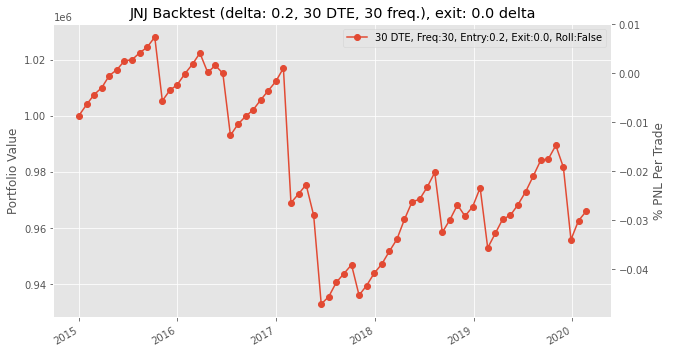

0.20.0 took 108.76992702484131 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 106.0, Underlying: 104.57, Premium: 0.51, Delta: 0.303162
Bought back call (expiry 2015-01-09 00:00:00, strike = 106.0) on 2015-01-05 for 0.12
PNL 2015-01-05 00:00:00 = 3003.0 (premium = 0.51, exit = 0.12)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 105.0, Underlying: 103.28, Premium: 0.14, Delta: 0.158174
Expired call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 105.0
PNL 2015-01-09 00:00:00 = 1000.9999999999607 (premium = 0.14, exit = 0.010000000000005116)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.319877
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-14 for 0.03
PNL 2015-01-14 00:00:00 = 3003.0 (premium = 0.42, exit = 0.03)

Date 2015-01-15, Expiry: 2015-01-23, Strike: 105.0, Underlying: 102.54, Premium: 0.35, Delta: 0.211454
Bought back call

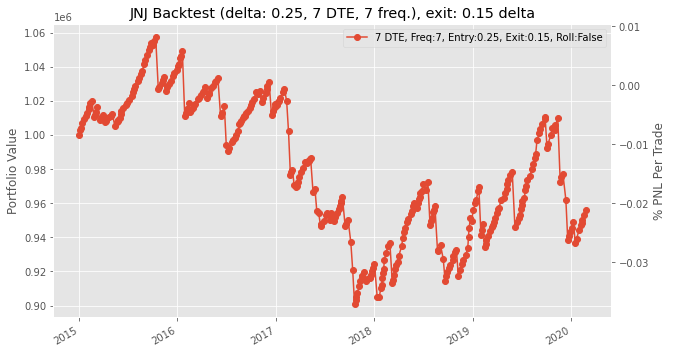

Date 2014-12-31, Expiry: 2015-01-17, Strike: 107.0, Underlying: 104.57, Premium: 0.48, Delta: 0.243142
Bought back call (expiry 2015-01-17 00:00:00, strike = 107.0) on 2015-01-05 for 0.19
PNL 2015-01-05 00:00:00 = 2233.0 (premium = 0.48, exit = 0.19)

Date 2015-01-06, Expiry: 2015-01-17, Strike: 105.0, Underlying: 103.28, Premium: 0.44, Delta: 0.269821
Expired call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-06
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 105.0
PNL 2015-01-17 00:00:00 = 3388.0 (premium = 0.44, exit = 0)

Date 2015-01-16, Expiry: 2015-01-30, Strike: 107.0, Underlying: 104.04, Premium: 0.41, Delta: 0.20852
Bought back call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-20 for 0.03
PNL 2015-01-20 00:00:00 = 2926.0 (premium = 0.41, exit = 0.03)

Date 2015-01-21, Expiry: 2015-02-06, Strike: 104.0, Underlying: 101.9, Premium: 0.5, Delta: 0.266806
Bought b

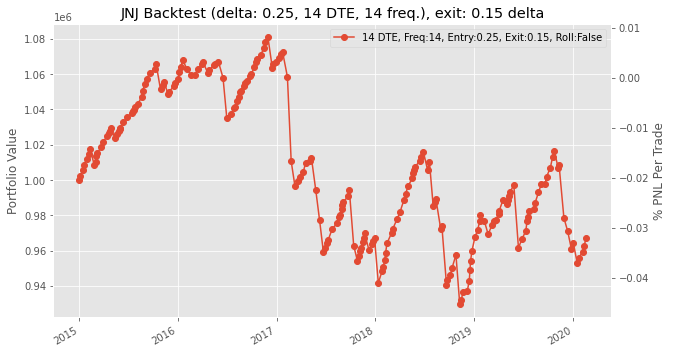

Date 2014-12-31, Expiry: 2015-01-23, Strike: 108.0, Underlying: 104.57, Premium: 0.55, Delta: 0.22607
Bought back call (expiry 2015-01-23 00:00:00, strike = 108.0) on 2015-01-05 for 0.21
PNL 2015-01-05 00:00:00 = 2618.0000000000005 (premium = 0.55, exit = 0.21)

Date 2015-01-06, Expiry: 2015-01-30, Strike: 106.0, Underlying: 103.28, Premium: 0.7, Delta: 0.27270500000000003
Bought back call (expiry 2015-01-30 00:00:00, strike = 106.0) on 2015-01-20 for 0.07
PNL 2015-01-20 00:00:00 = 4850.999999999999 (premium = 0.7, exit = 0.07)

Date 2015-01-21, Expiry: 2015-02-13, Strike: 105.0, Underlying: 101.9, Premium: 0.43, Delta: 0.209894
Bought back call (expiry 2015-02-13 00:00:00, strike = 105.0) on 2015-01-30 for 0.15
PNL 2015-01-30 00:00:00 = 2156.0 (premium = 0.43, exit = 0.15)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 103.0, Underlying: 100.33, Premium: 0.54, Delta: 0.235059
Bought back call (expiry 2015-02-20 00:00:00, strike = 103.0) on 2015-02-09 for 0.14
PNL 2015-02-09 00:00:00 = 

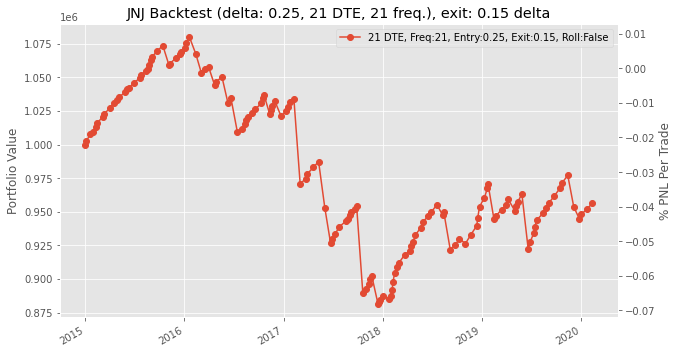

Date 2014-12-31, Expiry: 2015-01-30, Strike: 108.0, Underlying: 104.57, Premium: 0.74, Delta: 0.259889
Bought back call (expiry 2015-01-30 00:00:00, strike = 108.0) on 2015-01-06 for 0.3
PNL 2015-01-06 00:00:00 = 3388.0 (premium = 0.74, exit = 0.3)

Date 2015-01-07, Expiry: 2015-02-06, Strike: 109.0, Underlying: 105.56, Premium: 0.64, Delta: 0.236343
Bought back call (expiry 2015-02-06 00:00:00, strike = 109.0) on 2015-01-13 for 0.3
PNL 2015-01-13 00:00:00 = 2618.0 (premium = 0.64, exit = 0.3)

Date 2015-01-14, Expiry: 2015-02-13, Strike: 107.0, Underlying: 103.935, Premium: 0.79, Delta: 0.273604
Bought back call (expiry 2015-02-13 00:00:00, strike = 107.0) on 2015-01-20 for 0.21
PNL 2015-01-20 00:00:00 = 4466.000000000001 (premium = 0.79, exit = 0.21)

Date 2015-01-21, Expiry: 2015-02-20, Strike: 105.0, Underlying: 101.9, Premium: 0.53, Delta: 0.221934
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-01-30 for 0.2
PNL 2015-01-30 00:00:00 = 2541.0 (premium = 0.53, 

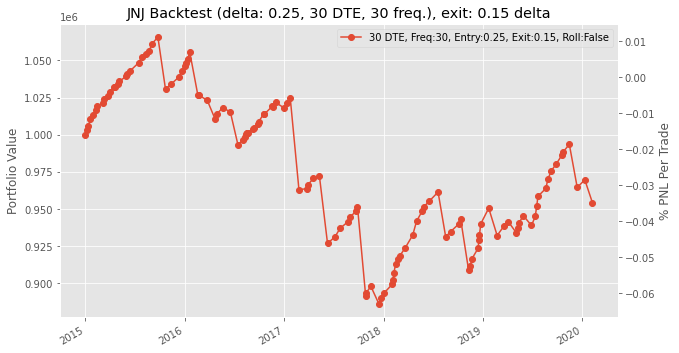

0.250.15 took 119.93106889724731 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 106.0, Underlying: 104.57, Premium: 0.51, Delta: 0.303162
Expired call (expiry 2015-01-09 00:00:00, strike = 106.0) on 2014-12-31
At expiry, underlying is 105.01 , strike is 106.0
PNL 2015-01-09 00:00:00 = 3927.0 (premium = 0.51, exit = 0)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.319877
Expired call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-09
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 106.0
PNL 2015-01-17 00:00:00 = 3234.0 (premium = 0.42, exit = 0)

Date 2015-01-16, Expiry: 2015-01-23, Strike: 106.0, Underlying: 104.04, Premium: 0.37, Delta: 0.236488
Expired call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-16
At expiry, underlying is 102.18 , strike is 106.0
PNL 2015-01-23 00:00:00 = 2849.0 (premium = 0.37, exit = 0)


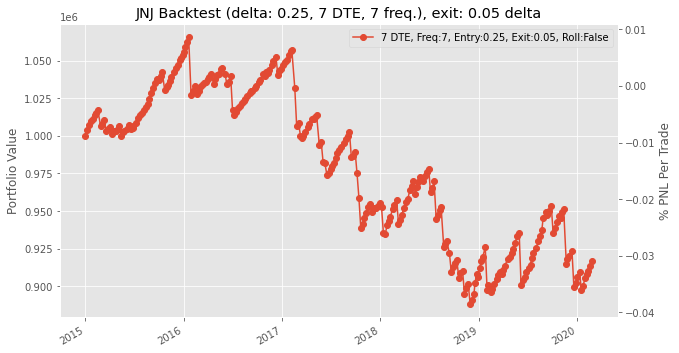

Date 2014-12-31, Expiry: 2015-01-17, Strike: 107.0, Underlying: 104.57, Premium: 0.48, Delta: 0.243142
Bought back call (expiry 2015-01-17 00:00:00, strike = 107.0) on 2015-01-13 for 0.01
PNL 2015-01-13 00:00:00 = 3619.0 (premium = 0.48, exit = 0.01)

Date 2015-01-14, Expiry: 2015-01-30, Strike: 106.0, Underlying: 103.935, Premium: 0.64, Delta: 0.292013
Bought back call (expiry 2015-01-30 00:00:00, strike = 106.0) on 2015-01-21 for 0.05
PNL 2015-01-21 00:00:00 = 4543.0 (premium = 0.64, exit = 0.05)

Date 2015-01-22, Expiry: 2015-02-06, Strike: 106.0, Underlying: 103.625, Premium: 0.29, Delta: 0.196348
Bought back call (expiry 2015-02-06 00:00:00, strike = 106.0) on 2015-01-29 for 0.04
PNL 2015-01-29 00:00:00 = 1924.9999999999998 (premium = 0.29, exit = 0.04)

Date 2015-01-30, Expiry: 2015-02-13, Strike: 103.0, Underlying: 100.33, Premium: 0.41, Delta: 0.22185900000000006
Bought back call (expiry 2015-02-13 00:00:00, strike = 103.0) on 2015-02-10 for 0.01
PNL 2015-02-10 00:00:00 = 3079.

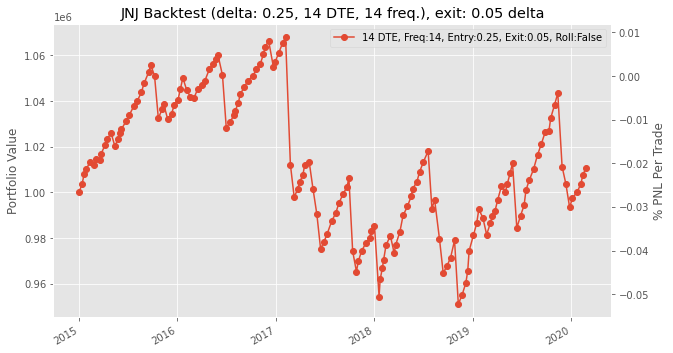

Date 2014-12-31, Expiry: 2015-01-23, Strike: 108.0, Underlying: 104.57, Premium: 0.55, Delta: 0.22607
Bought back call (expiry 2015-01-23 00:00:00, strike = 108.0) on 2015-01-15 for 0.05
PNL 2015-01-15 00:00:00 = 3850.0 (premium = 0.55, exit = 0.05)

Date 2015-01-16, Expiry: 2015-02-06, Strike: 107.0, Underlying: 104.04, Premium: 0.55, Delta: 0.240691
Bought back call (expiry 2015-02-06 00:00:00, strike = 107.0) on 2015-01-23 for 0.05
PNL 2015-01-23 00:00:00 = 3850.0 (premium = 0.55, exit = 0.05)

Date 2015-01-23, Expiry: 2015-02-13, Strike: 104.0, Underlying: 102.18, Premium: 0.54, Delta: 0.288433
Bought back call (expiry 2015-02-13 00:00:00, strike = 104.0) on 2015-02-09 for 0.01
PNL 2015-02-09 00:00:00 = 4081.0 (premium = 0.54, exit = 0.01)

Date 2015-02-10, Expiry: 2015-03-06, Strike: 102.0, Underlying: 100.34, Premium: 0.64, Delta: 0.28628000000000003
Expired call (expiry 2015-03-06 00:00:00, strike = 102.0) on 2015-02-10
At expiry, underlying is 100.01 , strike is 102.0
PNL 2015-

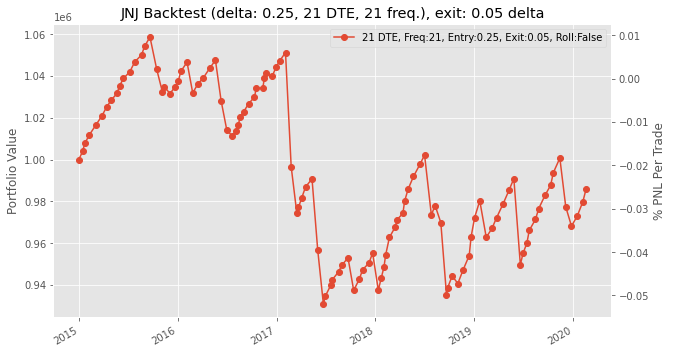

Date 2014-12-31, Expiry: 2015-01-30, Strike: 108.0, Underlying: 104.57, Premium: 0.74, Delta: 0.259889
Bought back call (expiry 2015-01-30 00:00:00, strike = 108.0) on 2015-01-20 for 0.01
PNL 2015-01-20 00:00:00 = 5621.0 (premium = 0.74, exit = 0.01)

Date 2015-01-21, Expiry: 2015-02-20, Strike: 105.0, Underlying: 101.9, Premium: 0.53, Delta: 0.221934
Bought back call (expiry 2015-02-20 00:00:00, strike = 105.0) on 2015-02-09 for 0.03
PNL 2015-02-09 00:00:00 = 3850.0 (premium = 0.53, exit = 0.03)

Date 2015-02-10, Expiry: 2015-03-13, Strike: 103.0, Underlying: 100.34, Premium: 0.62, Delta: 0.245256
Bought back call (expiry 2015-03-13 00:00:00, strike = 103.0) on 2015-03-09 for 0.03
PNL 2015-03-09 00:00:00 = 4543.0 (premium = 0.62, exit = 0.03)

Date 2015-03-10, Expiry: 2015-04-10, Strike: 102.0, Underlying: 99.53, Premium: 0.65, Delta: 0.278118
Bought back call (expiry 2015-04-10 00:00:00, strike = 102.0) on 2015-04-08 for 0.02
PNL 2015-04-08 00:00:00 = 4851.0 (premium = 0.65, exit = 0

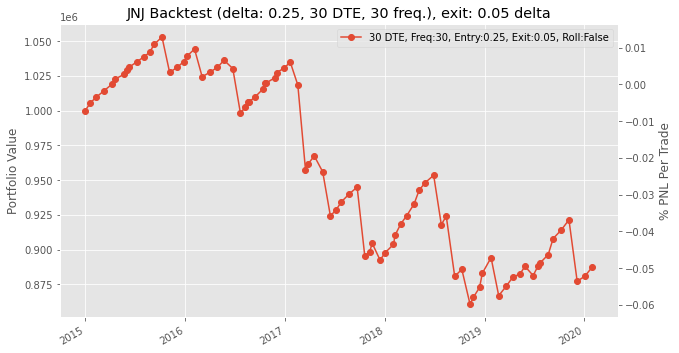

0.250.05 took 103.08505296707153 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 106.0, Underlying: 104.57, Premium: 0.51, Delta: 0.303162
Bought back call (expiry 2015-01-09 00:00:00, strike = 106.0) on 2015-01-05 for 0.12
PNL 2015-01-05 00:00:00 = 3003.0 (premium = 0.51, exit = 0.12)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.28, Premium: 0.39, Delta: 0.342749
Expired call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 104.0
We lost money  PNL 2015-01-09 = -4774.000000000039 (premium = 0.39, exit = 1.0100000000000051)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.319877
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-12 for 0.14
PNL 2015-01-12 00:00:00 = 2156.0 (premium = 0.42, exit = 0.14)

Date 2015-01-13, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 0.42, Delta: 0.391119
Expired ca

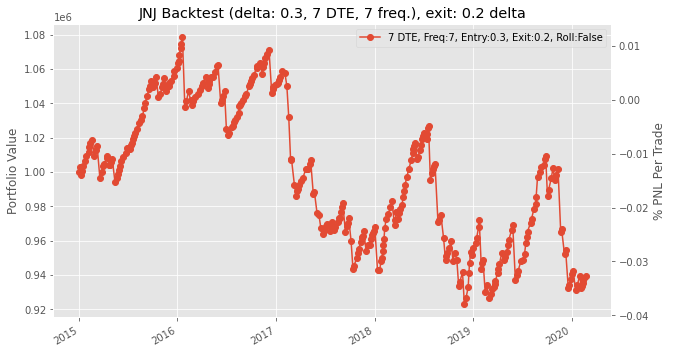

Date 2014-12-31, Expiry: 2015-01-17, Strike: 106.0, Underlying: 104.57, Premium: 0.78, Delta: 0.346231
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-06 for 0.24
PNL 2015-01-06 00:00:00 = 4158.0 (premium = 0.78, exit = 0.24)

Date 2015-01-07, Expiry: 2015-01-23, Strike: 107.0, Underlying: 105.56, Premium: 0.62, Delta: 0.319545
Bought back call (expiry 2015-01-23 00:00:00, strike = 107.0) on 2015-01-14 for 0.23
PNL 2015-01-14 00:00:00 = 3003.0 (premium = 0.62, exit = 0.23)

Date 2015-01-15, Expiry: 2015-01-30, Strike: 105.0, Underlying: 102.54, Premium: 0.67, Delta: 0.278535
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-20 for 0.15
PNL 2015-01-20 00:00:00 = 4004.0 (premium = 0.67, exit = 0.15)

Date 2015-01-21, Expiry: 2015-02-06, Strike: 104.0, Underlying: 101.9, Premium: 0.5, Delta: 0.266806
Bought back call (expiry 2015-02-06 00:00:00, strike = 104.0) on 2015-01-30 for 0.05
PNL 2015-01-30 00:00:00 = 3465.0 (premium = 0.5, exit = 0.

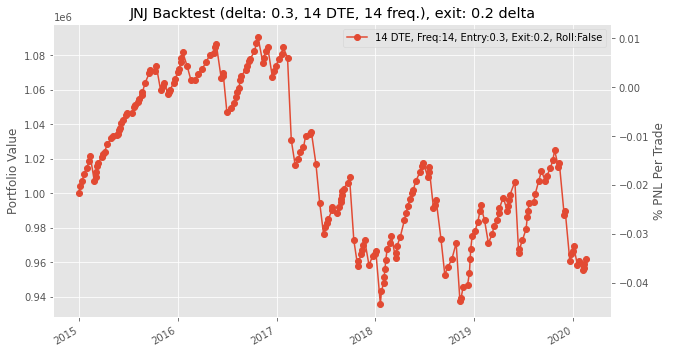

Date 2014-12-31, Expiry: 2015-01-23, Strike: 107.0, Underlying: 104.57, Premium: 0.81, Delta: 0.302863
Bought back call (expiry 2015-01-23 00:00:00, strike = 107.0) on 2015-01-05 for 0.37
PNL 2015-01-05 00:00:00 = 3388.0000000000005 (premium = 0.81, exit = 0.37)

Date 2015-01-06, Expiry: 2015-01-30, Strike: 106.0, Underlying: 103.28, Premium: 0.7, Delta: 0.27270500000000003
Bought back call (expiry 2015-01-30 00:00:00, strike = 106.0) on 2015-01-20 for 0.07
PNL 2015-01-20 00:00:00 = 4850.999999999999 (premium = 0.7, exit = 0.07)

Date 2015-01-21, Expiry: 2015-02-13, Strike: 104.0, Underlying: 101.9, Premium: 0.7, Delta: 0.300573
Bought back call (expiry 2015-02-13 00:00:00, strike = 104.0) on 2015-01-30 for 0.25
PNL 2015-01-30 00:00:00 = 3464.9999999999995 (premium = 0.7, exit = 0.25)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 102.0, Underlying: 100.33, Premium: 0.83, Delta: 0.321747
Bought back call (expiry 2015-02-20 00:00:00, strike = 102.0) on 2015-02-09 for 0.29
PNL 2015-02-09 

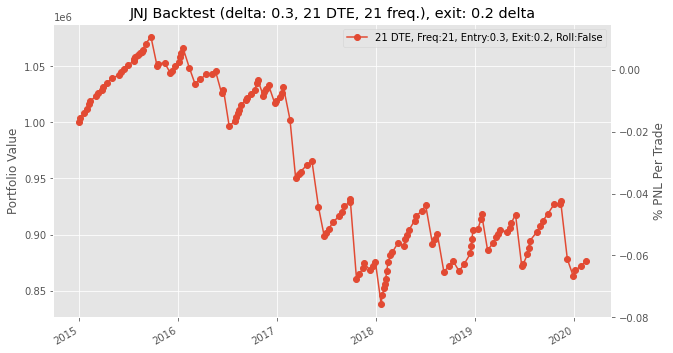

Date 2014-12-31, Expiry: 2015-01-30, Strike: 107.0, Underlying: 104.57, Premium: 1.02, Delta: 0.330746
Bought back call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-15 for 0.28
PNL 2015-01-15 00:00:00 = 5698.0 (premium = 1.02, exit = 0.28)

Date 2015-01-16, Expiry: 2015-02-13, Strike: 107.0, Underlying: 104.04, Premium: 0.81, Delta: 0.278962
Bought back call (expiry 2015-02-13 00:00:00, strike = 107.0) on 2015-01-20 for 0.21
PNL 2015-01-20 00:00:00 = 4620.000000000001 (premium = 0.81, exit = 0.21)

Date 2015-01-21, Expiry: 2015-02-20, Strike: 104.0, Underlying: 101.9, Premium: 0.79, Delta: 0.299976
Bought back call (expiry 2015-02-20 00:00:00, strike = 104.0) on 2015-01-30 for 0.33
PNL 2015-01-30 00:00:00 = 3542.0 (premium = 0.79, exit = 0.33)

Date 2015-01-30, Expiry: 2015-02-27, Strike: 103.0, Underlying: 100.33, Premium: 0.69, Delta: 0.26621500000000003
Bought back call (expiry 2015-02-27 00:00:00, strike = 103.0) on 2015-02-09 for 0.24
PNL 2015-02-09 00:00:00 = 3464.9999

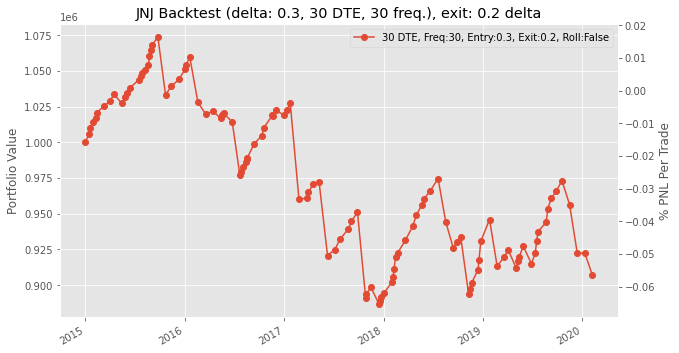

0.30.2 took 122.20185685157776 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 106.0, Underlying: 104.57, Premium: 0.51, Delta: 0.303162
Bought back call (expiry 2015-01-09 00:00:00, strike = 106.0) on 2015-01-06 for 0.04
PNL 2015-01-06 00:00:00 = 3619.0 (premium = 0.51, exit = 0.04)

Date 2015-01-07, Expiry: 2015-01-17, Strike: 107.0, Underlying: 105.56, Premium: 0.45, Delta: 0.289076
Bought back call (expiry 2015-01-17 00:00:00, strike = 107.0) on 2015-01-12 for 0.03
PNL 2015-01-12 00:00:00 = 3234.0000000000005 (premium = 0.45, exit = 0.03)

Date 2015-01-13, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 0.42, Delta: 0.391119
Expired call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-13
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 105.0
PNL 2015-01-17 00:00:00 = 3234.0 (premium = 0.42, exit = 0)

Date 2015-01-16, Expiry: 2015-01-23, Strike: 106.0, Under

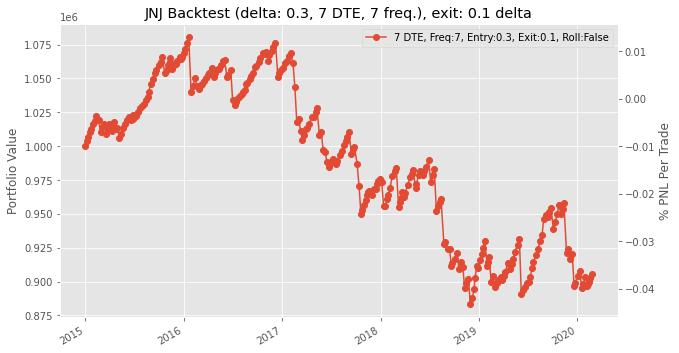

Date 2014-12-31, Expiry: 2015-01-17, Strike: 106.0, Underlying: 104.57, Premium: 0.78, Delta: 0.346231
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-14 for 0.03
PNL 2015-01-14 00:00:00 = 5775.0 (premium = 0.78, exit = 0.03)

Date 2015-01-15, Expiry: 2015-01-30, Strike: 105.0, Underlying: 102.54, Premium: 0.67, Delta: 0.278535
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-23 for 0.04
PNL 2015-01-23 00:00:00 = 4851.0 (premium = 0.67, exit = 0.04)

Date 2015-01-23, Expiry: 2015-02-06, Strike: 104.0, Underlying: 102.18, Premium: 0.4, Delta: 0.258986
Bought back call (expiry 2015-02-06 00:00:00, strike = 104.0) on 2015-01-30 for 0.05
PNL 2015-01-30 00:00:00 = 2695.0000000000005 (premium = 0.4, exit = 0.05)

Date 2015-01-30, Expiry: 2015-02-13, Strike: 102.0, Underlying: 100.33, Premium: 0.65, Delta: 0.31848000000000004
Bought back call (expiry 2015-02-13 00:00:00, strike = 102.0) on 2015-02-11 for 0.04
PNL 2015-02-11 00:00:00 = 4697.0 (p

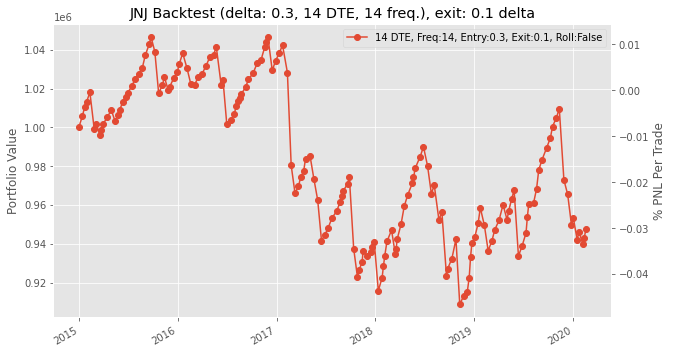

Date 2014-12-31, Expiry: 2015-01-23, Strike: 107.0, Underlying: 104.57, Premium: 0.81, Delta: 0.302863
Bought back call (expiry 2015-01-23 00:00:00, strike = 107.0) on 2015-01-15 for 0.1
PNL 2015-01-15 00:00:00 = 5467.000000000001 (premium = 0.81, exit = 0.1)

Date 2015-01-16, Expiry: 2015-02-06, Strike: 106.0, Underlying: 104.04, Premium: 0.81, Delta: 0.32363800000000004
Bought back call (expiry 2015-02-06 00:00:00, strike = 106.0) on 2015-01-21 for 0.14
PNL 2015-01-21 00:00:00 = 5159.0 (premium = 0.81, exit = 0.14)

Date 2015-01-22, Expiry: 2015-02-13, Strike: 105.0, Underlying: 103.625, Premium: 0.72, Delta: 0.342296
Bought back call (expiry 2015-02-13 00:00:00, strike = 105.0) on 2015-01-30 for 0.15
PNL 2015-01-30 00:00:00 = 4389.0 (premium = 0.72, exit = 0.15)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 102.0, Underlying: 100.33, Premium: 0.83, Delta: 0.321747
Bought back call (expiry 2015-02-20 00:00:00, strike = 102.0) on 2015-02-12 for 0.05
PNL 2015-02-12 00:00:00 = 6005.9999

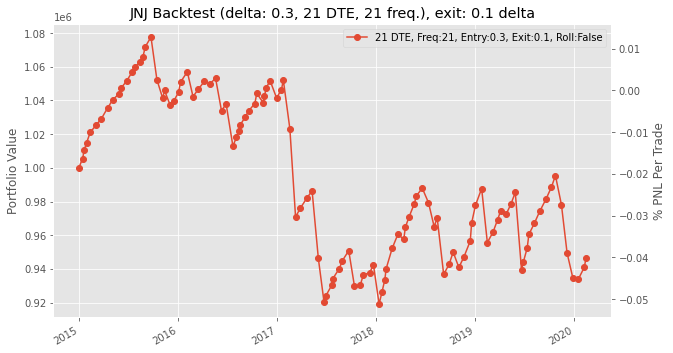

Date 2014-12-31, Expiry: 2015-01-30, Strike: 107.0, Underlying: 104.57, Premium: 1.02, Delta: 0.330746
Bought back call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-20 for 0.03
PNL 2015-01-20 00:00:00 = 7623.0 (premium = 1.02, exit = 0.03)

Date 2015-01-21, Expiry: 2015-02-20, Strike: 104.0, Underlying: 101.9, Premium: 0.79, Delta: 0.299976
Bought back call (expiry 2015-02-20 00:00:00, strike = 104.0) on 2015-02-09 for 0.06
PNL 2015-02-09 00:00:00 = 5621.0 (premium = 0.79, exit = 0.06)

Date 2015-02-10, Expiry: 2015-03-13, Strike: 102.0, Underlying: 100.34, Premium: 0.88, Delta: 0.318921
Bought back call (expiry 2015-03-13 00:00:00, strike = 102.0) on 2015-03-10 for 0.02
PNL 2015-03-10 00:00:00 = 6622.0 (premium = 0.88, exit = 0.02)

Date 2015-03-11, Expiry: 2015-04-10, Strike: 101.0, Underlying: 98.32, Premium: 0.7, Delta: 0.280243
Expired call (expiry 2015-04-10 00:00:00, strike = 101.0) on 2015-03-11
Strike was breached- At expiry, underlying is 101.94 , strike is 101.0
W

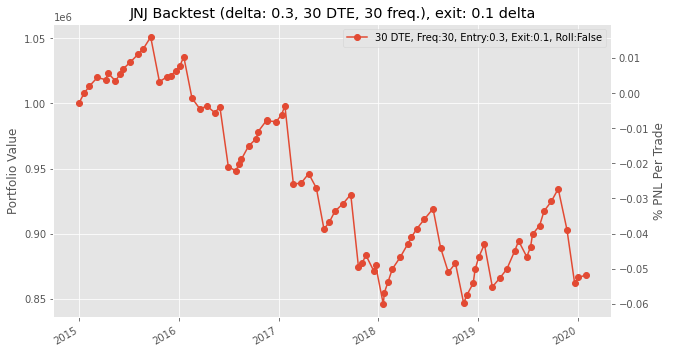

0.30.1 took 103.58862161636353 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 106.0, Underlying: 104.57, Premium: 0.51, Delta: 0.303162
Bought back call (expiry 2015-01-09 00:00:00, strike = 106.0) on 2015-01-05 for 0.12
PNL 2015-01-05 00:00:00 = 3003.0 (premium = 0.51, exit = 0.12)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.28, Premium: 0.39, Delta: 0.342749
Expired call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 104.0
We lost money  PNL 2015-01-09 = -4774.000000000039 (premium = 0.39, exit = 1.0100000000000051)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.319877
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-12 for 0.14
PNL 2015-01-12 00:00:00 = 2156.0 (premium = 0.42, exit = 0.14)

Date 2015-01-13, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 0.42, Delta: 0.391119
Bought back 

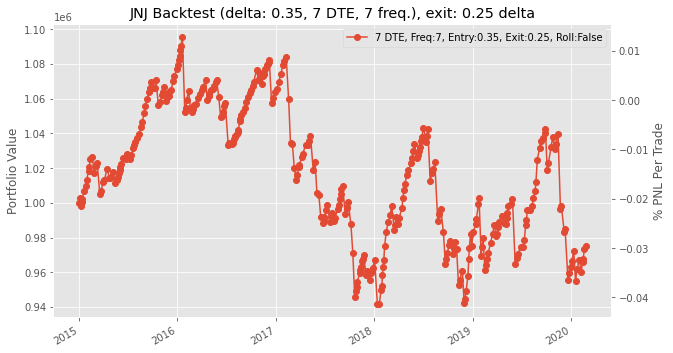

Date 2014-12-31, Expiry: 2015-01-17, Strike: 106.0, Underlying: 104.57, Premium: 0.78, Delta: 0.346231
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-05 for 0.37
PNL 2015-01-05 00:00:00 = 3157.0000000000005 (premium = 0.78, exit = 0.37)

Date 2015-01-06, Expiry: 2015-01-17, Strike: 104.0, Underlying: 103.28, Premium: 0.79, Delta: 0.403261
Bought back call (expiry 2015-01-17 00:00:00, strike = 104.0) on 2015-01-15 for 0.05
PNL 2015-01-15 00:00:00 = 5698.0 (premium = 0.79, exit = 0.05)

Date 2015-01-16, Expiry: 2015-01-30, Strike: 105.0, Underlying: 104.04, Premium: 0.98, Delta: 0.399383
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-20 for 0.15
PNL 2015-01-20 00:00:00 = 6391.0 (premium = 0.98, exit = 0.15)

Date 2015-01-21, Expiry: 2015-02-06, Strike: 103.0, Underlying: 101.9, Premium: 0.85, Delta: 0.383339
Bought back call (expiry 2015-02-06 00:00:00, strike = 103.0) on 2015-01-30 for 0.14
PNL 2015-01-30 00:00:00 = 5467.0 (premium = 0

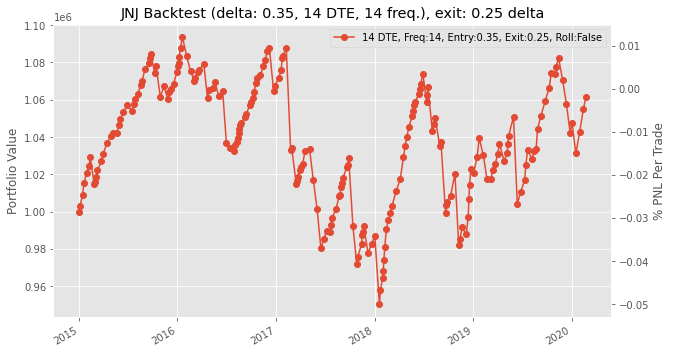

Date 2014-12-31, Expiry: 2015-01-23, Strike: 106.0, Underlying: 104.57, Premium: 1.16, Delta: 0.388243
Bought back call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-06 for 0.48
PNL 2015-01-06 00:00:00 = 5235.999999999999 (premium = 1.16, exit = 0.48)

Date 2015-01-07, Expiry: 2015-01-30, Strike: 107.0, Underlying: 105.56, Premium: 1.05, Delta: 0.370514
Bought back call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-13 for 0.46
PNL 2015-01-13 00:00:00 = 4543.000000000001 (premium = 1.05, exit = 0.46)

Date 2015-01-14, Expiry: 2015-02-06, Strike: 106.0, Underlying: 103.935, Premium: 0.91, Delta: 0.32708400000000004
Bought back call (expiry 2015-02-06 00:00:00, strike = 106.0) on 2015-01-15 for 0.55
PNL 2015-01-15 00:00:00 = 2772.0 (premium = 0.91, exit = 0.55)

Date 2015-01-16, Expiry: 2015-02-06, Strike: 106.0, Underlying: 104.04, Premium: 0.81, Delta: 0.32363800000000004
Bought back call (expiry 2015-02-06 00:00:00, strike = 106.0) on 2015-01-20 for 0.2
PNL 2015-01-

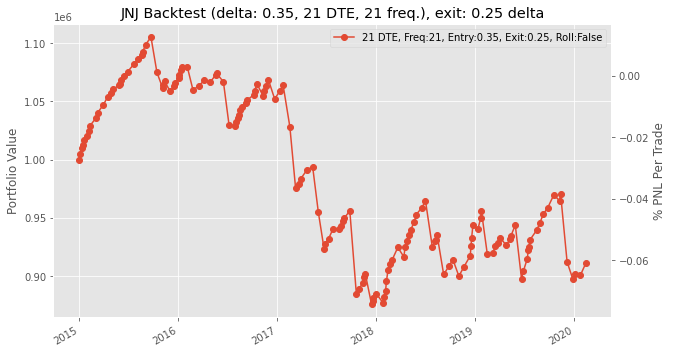

Date 2014-12-31, Expiry: 2015-01-30, Strike: 107.0, Underlying: 104.57, Premium: 1.02, Delta: 0.330746
Bought back call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-06 for 0.47
PNL 2015-01-06 00:00:00 = 4235.0 (premium = 1.02, exit = 0.47)

Date 2015-01-07, Expiry: 2015-02-06, Strike: 107.0, Underlying: 105.56, Premium: 1.24, Delta: 0.382382
Bought back call (expiry 2015-02-06 00:00:00, strike = 107.0) on 2015-01-15 for 0.36
PNL 2015-01-15 00:00:00 = 6776.0 (premium = 1.24, exit = 0.36)

Date 2015-01-16, Expiry: 2015-02-13, Strike: 106.0, Underlying: 104.04, Premium: 1.13, Delta: 0.353779
Bought back call (expiry 2015-02-13 00:00:00, strike = 106.0) on 2015-01-20 for 0.33
PNL 2015-01-20 00:00:00 = 6159.999999999998 (premium = 1.13, exit = 0.33)

Date 2015-01-21, Expiry: 2015-02-20, Strike: 103.0, Underlying: 101.9, Premium: 1.14, Delta: 0.387396
Bought back call (expiry 2015-02-20 00:00:00, strike = 103.0) on 2015-01-30 for 0.54
PNL 2015-01-30 00:00:00 = 4619.999999999999 (p

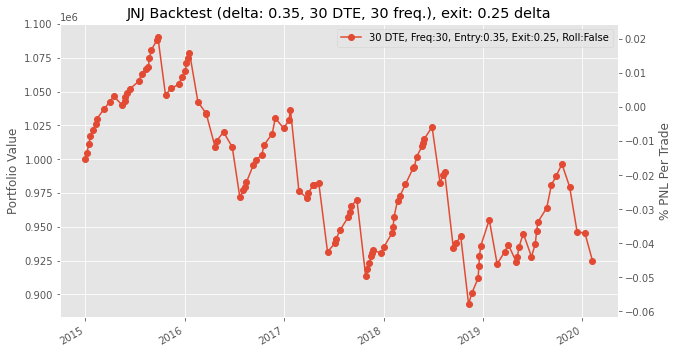

0.350.25 took 123.39435839653015 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 106.0, Underlying: 104.57, Premium: 0.51, Delta: 0.303162
Bought back call (expiry 2015-01-09 00:00:00, strike = 106.0) on 2015-01-05 for 0.12
PNL 2015-01-05 00:00:00 = 3003.0 (premium = 0.51, exit = 0.12)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.28, Premium: 0.39, Delta: 0.342749
Expired call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 104.0
We lost money  PNL 2015-01-09 = -4774.000000000039 (premium = 0.39, exit = 1.0100000000000051)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.319877
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-14 for 0.03
PNL 2015-01-14 00:00:00 = 3003.0 (premium = 0.42, exit = 0.03)

Date 2015-01-15, Expiry: 2015-01-23, Strike: 104.0, Underlying: 102.54, Premium: 0.61, Delta: 0.319558
Bought bac

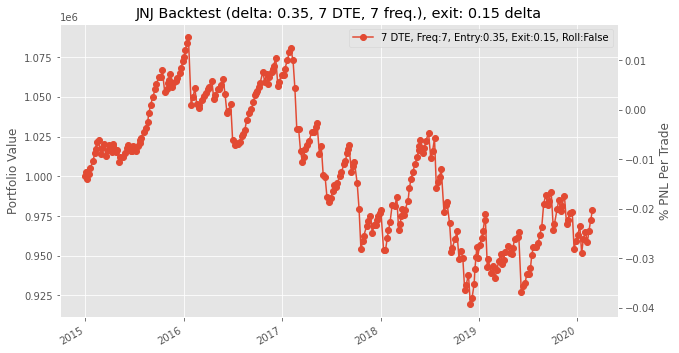

Date 2014-12-31, Expiry: 2015-01-17, Strike: 106.0, Underlying: 104.57, Premium: 0.78, Delta: 0.346231
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-14 for 0.03
PNL 2015-01-14 00:00:00 = 5775.0 (premium = 0.78, exit = 0.03)

Date 2015-01-15, Expiry: 2015-01-30, Strike: 104.0, Underlying: 102.54, Premium: 0.97, Delta: 0.367009
Bought back call (expiry 2015-01-30 00:00:00, strike = 104.0) on 2015-01-26 for 0.08
PNL 2015-01-26 00:00:00 = 6853.0 (premium = 0.97, exit = 0.08)

Date 2015-01-27, Expiry: 2015-02-13, Strike: 103.0, Underlying: 102.09, Premium: 0.85, Delta: 0.393714
Bought back call (expiry 2015-02-13 00:00:00, strike = 103.0) on 2015-02-09 for 0.05
PNL 2015-02-09 00:00:00 = 6159.999999999999 (premium = 0.85, exit = 0.05)

Date 2015-02-10, Expiry: 2015-02-27, Strike: 101.0, Underlying: 100.34, Premium: 0.83, Delta: 0.377828
Expired call (expiry 2015-02-27 00:00:00, strike = 101.0) on 2015-02-10
Strike was breached- At expiry, underlying is 102.55 , str

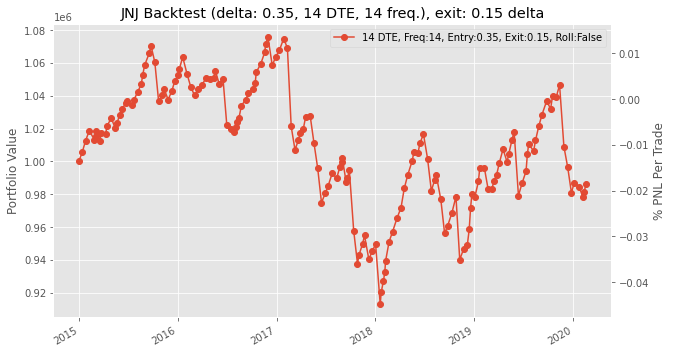

Date 2014-12-31, Expiry: 2015-01-23, Strike: 106.0, Underlying: 104.57, Premium: 1.16, Delta: 0.388243
Bought back call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-15 for 0.2
PNL 2015-01-15 00:00:00 = 7392.0 (premium = 1.16, exit = 0.2)

Date 2015-01-16, Expiry: 2015-02-06, Strike: 106.0, Underlying: 104.04, Premium: 0.81, Delta: 0.32363800000000004
Bought back call (expiry 2015-02-06 00:00:00, strike = 106.0) on 2015-01-20 for 0.2
PNL 2015-01-20 00:00:00 = 4697.000000000001 (premium = 0.81, exit = 0.2)

Date 2015-01-21, Expiry: 2015-02-13, Strike: 104.0, Underlying: 101.9, Premium: 0.7, Delta: 0.300573
Bought back call (expiry 2015-02-13 00:00:00, strike = 104.0) on 2015-01-30 for 0.25
PNL 2015-01-30 00:00:00 = 3464.9999999999995 (premium = 0.7, exit = 0.25)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 102.0, Underlying: 100.33, Premium: 0.83, Delta: 0.321747
Bought back call (expiry 2015-02-20 00:00:00, strike = 102.0) on 2015-02-12 for 0.05
PNL 2015-02-12 00:00:00 = 600

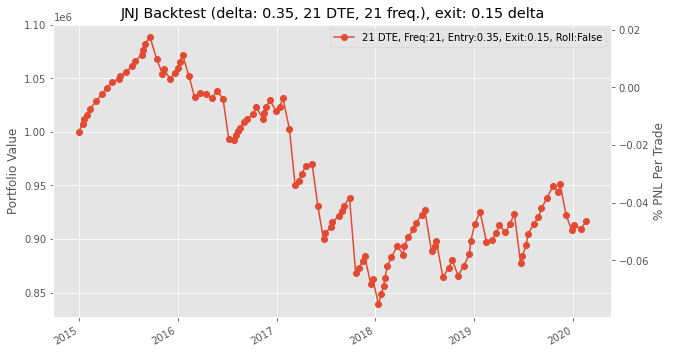

Date 2014-12-31, Expiry: 2015-01-30, Strike: 107.0, Underlying: 104.57, Premium: 1.02, Delta: 0.330746
Bought back call (expiry 2015-01-30 00:00:00, strike = 107.0) on 2015-01-15 for 0.28
PNL 2015-01-15 00:00:00 = 5698.0 (premium = 1.02, exit = 0.28)

Date 2015-01-16, Expiry: 2015-02-13, Strike: 106.0, Underlying: 104.04, Premium: 1.13, Delta: 0.353779
Bought back call (expiry 2015-02-13 00:00:00, strike = 106.0) on 2015-01-20 for 0.33
PNL 2015-01-20 00:00:00 = 6159.999999999998 (premium = 1.13, exit = 0.33)

Date 2015-01-21, Expiry: 2015-02-20, Strike: 103.0, Underlying: 101.9, Premium: 1.14, Delta: 0.387396
Bought back call (expiry 2015-02-20 00:00:00, strike = 103.0) on 2015-02-09 for 0.14
PNL 2015-02-09 00:00:00 = 7699.999999999999 (premium = 1.14, exit = 0.14)

Date 2015-02-10, Expiry: 2015-03-13, Strike: 102.0, Underlying: 100.34, Premium: 0.88, Delta: 0.318921
Bought back call (expiry 2015-03-13 00:00:00, strike = 102.0) on 2015-03-06 for 0.14
PNL 2015-03-06 00:00:00 = 5698.0 (p

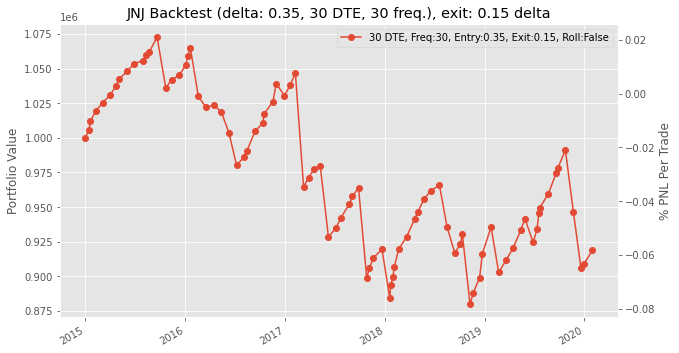

0.350.15 took 104.29323768615723 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 105.0, Underlying: 104.57, Premium: 0.9, Delta: 0.446113
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-05 for 0.36
PNL 2015-01-05 00:00:00 = 4158.0 (premium = 0.9, exit = 0.36)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.28, Premium: 0.39, Delta: 0.342749
Expired call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 104.0
We lost money  PNL 2015-01-09 = -4774.000000000039 (premium = 0.39, exit = 1.0100000000000051)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.01, Premium: 0.42, Delta: 0.319877
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-12 for 0.14
PNL 2015-01-12 00:00:00 = 2156.0 (premium = 0.42, exit = 0.14)

Date 2015-01-13, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 0.42, Delta: 0.391119
Bought back 

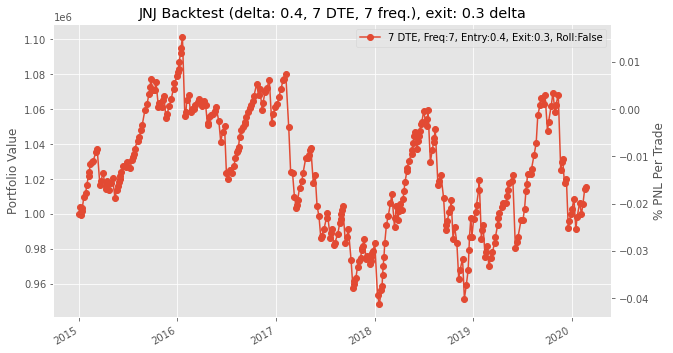

Date 2014-12-31, Expiry: 2015-01-17, Strike: 106.0, Underlying: 104.57, Premium: 0.78, Delta: 0.346231
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-05 for 0.37
PNL 2015-01-05 00:00:00 = 3157.0000000000005 (premium = 0.78, exit = 0.37)

Date 2015-01-06, Expiry: 2015-01-17, Strike: 104.0, Underlying: 103.28, Premium: 0.79, Delta: 0.403261
Bought back call (expiry 2015-01-17 00:00:00, strike = 104.0) on 2015-01-15 for 0.05
PNL 2015-01-15 00:00:00 = 5698.0 (premium = 0.79, exit = 0.05)

Date 2015-01-16, Expiry: 2015-01-30, Strike: 105.0, Underlying: 104.04, Premium: 0.98, Delta: 0.399383
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-20 for 0.15
PNL 2015-01-20 00:00:00 = 6391.0 (premium = 0.98, exit = 0.15)

Date 2015-01-21, Expiry: 2015-02-06, Strike: 103.0, Underlying: 101.9, Premium: 0.85, Delta: 0.383339
Bought back call (expiry 2015-02-06 00:00:00, strike = 103.0) on 2015-01-30 for 0.14
PNL 2015-01-30 00:00:00 = 5467.0 (premium = 0

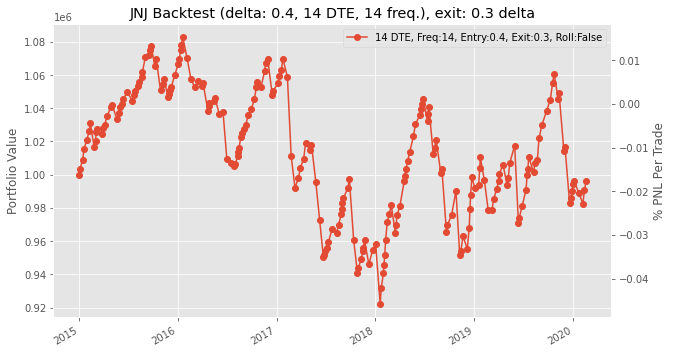

Date 2014-12-31, Expiry: 2015-01-23, Strike: 106.0, Underlying: 104.57, Premium: 1.16, Delta: 0.388243
Bought back call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-05 for 0.63
PNL 2015-01-05 00:00:00 = 4080.9999999999995 (premium = 1.16, exit = 0.63)

Date 2015-01-06, Expiry: 2015-01-30, Strike: 104.0, Underlying: 103.28, Premium: 1.39, Delta: 0.443316
Bought back call (expiry 2015-01-30 00:00:00, strike = 104.0) on 2015-01-20 for 0.31
PNL 2015-01-20 00:00:00 = 8315.999999999998 (premium = 1.39, exit = 0.31)

Date 2015-01-21, Expiry: 2015-02-13, Strike: 103.0, Underlying: 101.9, Premium: 1.08, Delta: 0.400645
Bought back call (expiry 2015-02-13 00:00:00, strike = 103.0) on 2015-01-30 for 0.41
PNL 2015-01-30 00:00:00 = 5159.000000000001 (premium = 1.08, exit = 0.41)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 101.0, Underlying: 100.33, Premium: 1.23, Delta: 0.417642
Bought back call (expiry 2015-02-20 00:00:00, strike = 101.0) on 2015-02-12 for 0.12
PNL 2015-02-12 00:00:00

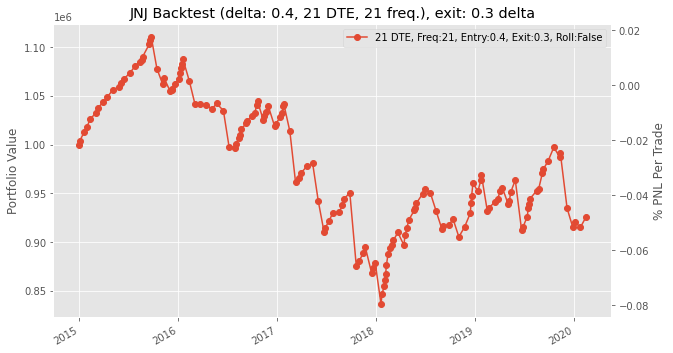

Date 2014-12-31, Expiry: 2015-01-30, Strike: 106.0, Underlying: 104.57, Premium: 1.4, Delta: 0.409227
Bought back call (expiry 2015-01-30 00:00:00, strike = 106.0) on 2015-01-06 for 0.7
PNL 2015-01-06 00:00:00 = 5390.0 (premium = 1.4, exit = 0.7)

Date 2015-01-07, Expiry: 2015-02-06, Strike: 107.0, Underlying: 105.56, Premium: 1.24, Delta: 0.382382
Bought back call (expiry 2015-02-06 00:00:00, strike = 107.0) on 2015-01-13 for 0.7
PNL 2015-01-13 00:00:00 = 4158.0 (premium = 1.24, exit = 0.7)

Date 2015-01-14, Expiry: 2015-02-13, Strike: 105.0, Underlying: 103.935, Premium: 1.5, Delta: 0.425429
Bought back call (expiry 2015-02-13 00:00:00, strike = 105.0) on 2015-01-20 for 0.49
PNL 2015-01-20 00:00:00 = 7777.0 (premium = 1.5, exit = 0.49)

Date 2015-01-21, Expiry: 2015-02-20, Strike: 103.0, Underlying: 101.9, Premium: 1.14, Delta: 0.387396
Bought back call (expiry 2015-02-20 00:00:00, strike = 103.0) on 2015-01-30 for 0.54
PNL 2015-01-30 00:00:00 = 4619.999999999999 (premium = 1.14, exi

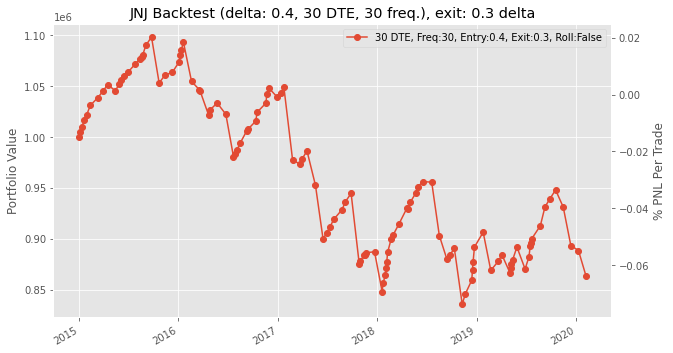

0.40.3 took 120.3756308555603 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 105.0, Underlying: 104.57, Premium: 0.9, Delta: 0.446113
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-06 for 0.14
PNL 2015-01-06 00:00:00 = 5852.0 (premium = 0.9, exit = 0.14)

Date 2015-01-07, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.56, Premium: 0.82, Delta: 0.435654
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-12 for 0.14
PNL 2015-01-12 00:00:00 = 5235.999999999999 (premium = 0.82, exit = 0.14)

Date 2015-01-13, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 0.42, Delta: 0.391119
Expired call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-13
Error with data- 2015-01-16T00:00:00.000000000 price used since 2015-01-17 00:00:00 was not available At expiry, underlying is 104.04 , strike is 105.0
PNL 2015-01-17 00:00:00 = 3234.0 (premium = 0.42, exit = 0)

Date 2015-01-16, Expiry: 2015-01-23, Strike: 105.0, Underlyin

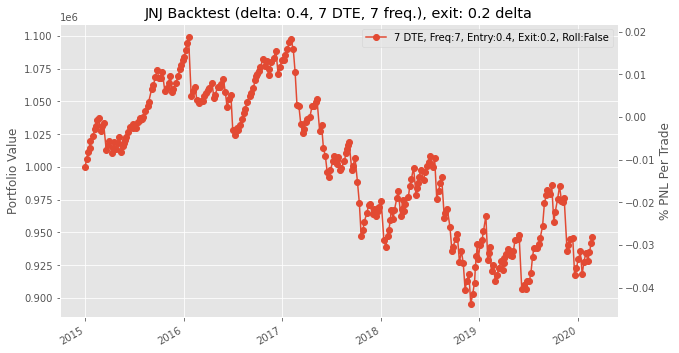

Date 2014-12-31, Expiry: 2015-01-17, Strike: 106.0, Underlying: 104.57, Premium: 0.78, Delta: 0.346231
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-06 for 0.24
PNL 2015-01-06 00:00:00 = 4158.0 (premium = 0.78, exit = 0.24)

Date 2015-01-07, Expiry: 2015-01-23, Strike: 106.0, Underlying: 105.56, Premium: 1.02, Delta: 0.445676
Bought back call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-15 for 0.2
PNL 2015-01-15 00:00:00 = 6314.000000000001 (premium = 1.02, exit = 0.2)

Date 2015-01-16, Expiry: 2015-01-30, Strike: 105.0, Underlying: 104.04, Premium: 0.98, Delta: 0.399383
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-20 for 0.15
PNL 2015-01-20 00:00:00 = 6391.0 (premium = 0.98, exit = 0.15)

Date 2015-01-21, Expiry: 2015-02-06, Strike: 103.0, Underlying: 101.9, Premium: 0.85, Delta: 0.383339
Bought back call (expiry 2015-02-06 00:00:00, strike = 103.0) on 2015-01-30 for 0.14
PNL 2015-01-30 00:00:00 = 5467.0 (premium = 0.85

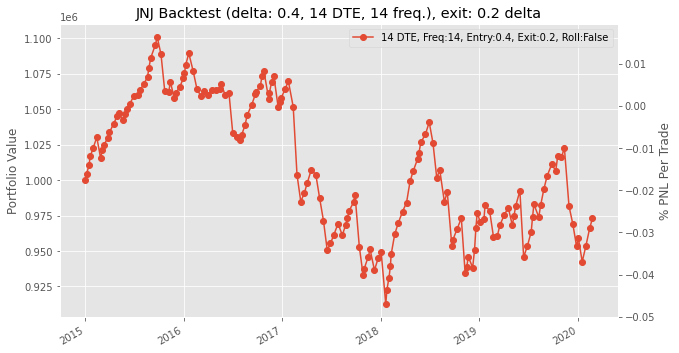

Date 2014-12-31, Expiry: 2015-01-23, Strike: 106.0, Underlying: 104.57, Premium: 1.16, Delta: 0.388243
Bought back call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-15 for 0.2
PNL 2015-01-15 00:00:00 = 7392.0 (premium = 1.16, exit = 0.2)

Date 2015-01-16, Expiry: 2015-02-06, Strike: 105.0, Underlying: 104.04, Premium: 1.2, Delta: 0.419847
Bought back call (expiry 2015-02-06 00:00:00, strike = 105.0) on 2015-01-20 for 0.32
PNL 2015-01-20 00:00:00 = 6775.999999999999 (premium = 1.2, exit = 0.32)

Date 2015-01-21, Expiry: 2015-02-13, Strike: 103.0, Underlying: 101.9, Premium: 1.08, Delta: 0.400645
Bought back call (expiry 2015-02-13 00:00:00, strike = 103.0) on 2015-02-06 for 0.18
PNL 2015-02-06 00:00:00 = 6930.000000000001 (premium = 1.08, exit = 0.18)

Date 2015-02-06, Expiry: 2015-02-27, Strike: 101.0, Underlying: 100.98, Premium: 1.21, Delta: 0.457338
Bought back call (expiry 2015-02-27 00:00:00, strike = 101.0) on 2015-02-12 for 0.22
PNL 2015-02-12 00:00:00 = 7623.0 (premi

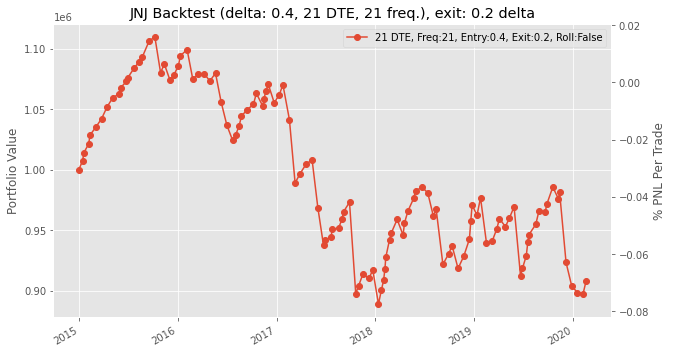

Date 2014-12-31, Expiry: 2015-01-30, Strike: 106.0, Underlying: 104.57, Premium: 1.4, Delta: 0.409227
Bought back call (expiry 2015-01-30 00:00:00, strike = 106.0) on 2015-01-20 for 0.07
PNL 2015-01-20 00:00:00 = 10240.999999999998 (premium = 1.4, exit = 0.07)

Date 2015-01-21, Expiry: 2015-02-20, Strike: 103.0, Underlying: 101.9, Premium: 1.14, Delta: 0.387396
Bought back call (expiry 2015-02-20 00:00:00, strike = 103.0) on 2015-02-09 for 0.14
PNL 2015-02-09 00:00:00 = 7699.999999999999 (premium = 1.14, exit = 0.14)

Date 2015-02-10, Expiry: 2015-03-13, Strike: 101.0, Underlying: 100.34, Premium: 1.24, Delta: 0.404264
Bought back call (expiry 2015-03-13 00:00:00, strike = 101.0) on 2015-03-10 for 0.12
PNL 2015-03-10 00:00:00 = 8624.0 (premium = 1.24, exit = 0.12)

Date 2015-03-11, Expiry: 2015-04-10, Strike: 99.5, Underlying: 98.32, Premium: 1.21, Delta: 0.411901
Expired call (expiry 2015-04-10 00:00:00, strike = 99.5) on 2015-03-11
Strike was breached- At expiry, underlying is 101.94

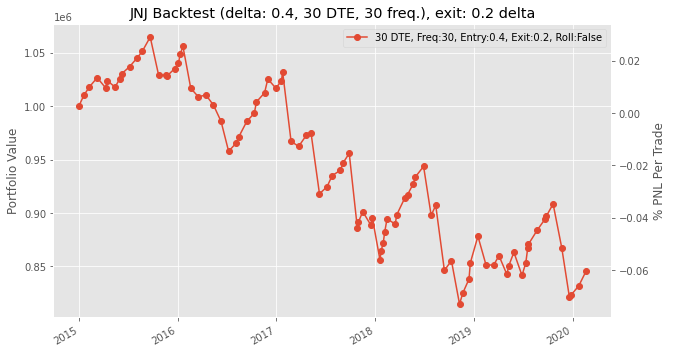

0.40.2 took 105.42037749290466 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 105.0, Underlying: 104.57, Premium: 0.9, Delta: 0.446113
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-05 for 0.36
PNL 2015-01-05 00:00:00 = 4158.0 (premium = 0.9, exit = 0.36)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 104.0, Underlying: 103.28, Premium: 0.39, Delta: 0.342749
Expired call (expiry 2015-01-09 00:00:00, strike = 104.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 104.0
We lost money  PNL 2015-01-09 = -4774.000000000039 (premium = 0.39, exit = 1.0100000000000051)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 105.0, Underlying: 105.01, Premium: 0.85, Delta: 0.509847
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-14 for 0.15
PNL 2015-01-14 00:00:00 = 5390.0 (premium = 0.85, exit = 0.15)

Date 2015-01-15, Expiry: 2015-01-23, Strike: 103.0, Underlying: 102.54, Premium: 1.01, Delta: 0.448163
Bought back ca

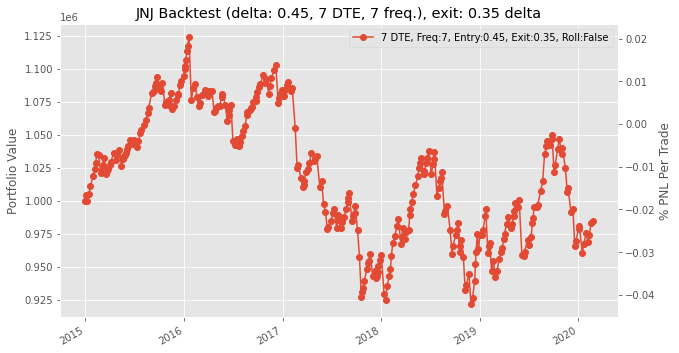

Date 2014-12-31, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 1.23, Delta: 0.45979
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-05 for 0.66
PNL 2015-01-05 00:00:00 = 4389.0 (premium = 1.23, exit = 0.66)

Date 2015-01-06, Expiry: 2015-01-17, Strike: 104.0, Underlying: 103.28, Premium: 0.79, Delta: 0.403261
Bought back call (expiry 2015-01-17 00:00:00, strike = 104.0) on 2015-01-15 for 0.05
PNL 2015-01-15 00:00:00 = 5698.0 (premium = 0.79, exit = 0.05)

Date 2015-01-16, Expiry: 2015-01-30, Strike: 105.0, Underlying: 104.04, Premium: 0.98, Delta: 0.399383
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-20 for 0.15
PNL 2015-01-20 00:00:00 = 6391.0 (premium = 0.98, exit = 0.15)

Date 2015-01-21, Expiry: 2015-02-06, Strike: 102.0, Underlying: 101.9, Premium: 1.33, Delta: 0.5052949999999999
Bought back call (expiry 2015-02-06 00:00:00, strike = 102.0) on 2015-01-30 for 0.32
PNL 2015-01-30 00:00:00 = 7777.0 (premium = 1.33

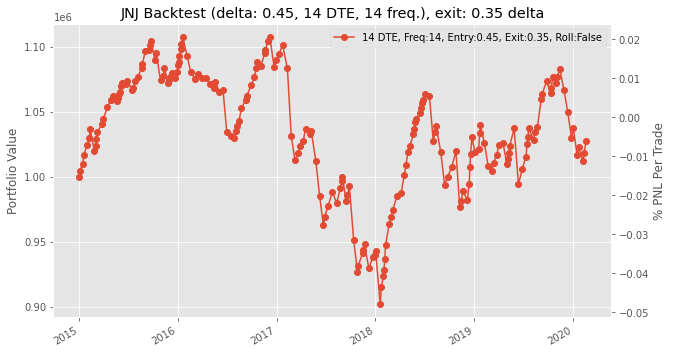

Date 2014-12-31, Expiry: 2015-01-23, Strike: 105.0, Underlying: 104.57, Premium: 1.61, Delta: 0.478491
Bought back call (expiry 2015-01-23 00:00:00, strike = 105.0) on 2015-01-06 for 0.77
PNL 2015-01-06 00:00:00 = 6468.000000000001 (premium = 1.61, exit = 0.77)

Date 2015-01-07, Expiry: 2015-01-30, Strike: 106.0, Underlying: 105.56, Premium: 1.5, Delta: 0.464326
Bought back call (expiry 2015-01-30 00:00:00, strike = 106.0) on 2015-01-13 for 0.76
PNL 2015-01-13 00:00:00 = 5698.0 (premium = 1.5, exit = 0.76)

Date 2015-01-14, Expiry: 2015-02-06, Strike: 105.0, Underlying: 103.935, Premium: 1.26, Delta: 0.413246
Bought back call (expiry 2015-02-06 00:00:00, strike = 105.0) on 2015-01-15 for 0.81
PNL 2015-01-15 00:00:00 = 3464.9999999999995 (premium = 1.26, exit = 0.81)

Date 2015-01-16, Expiry: 2015-02-06, Strike: 105.0, Underlying: 104.04, Premium: 1.2, Delta: 0.419847
Bought back call (expiry 2015-02-06 00:00:00, strike = 105.0) on 2015-01-20 for 0.32
PNL 2015-01-20 00:00:00 = 6775.9999

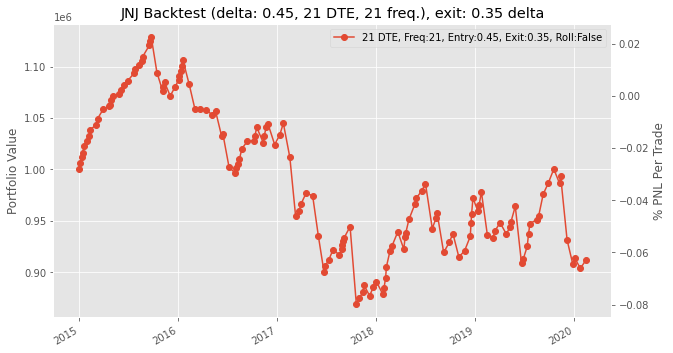

Date 2014-12-31, Expiry: 2015-01-30, Strike: 105.0, Underlying: 104.57, Premium: 1.88, Delta: 0.49021
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-15 for 0.67
PNL 2015-01-15 00:00:00 = 9317.0 (premium = 1.88, exit = 0.67)

Date 2015-01-16, Expiry: 2015-02-13, Strike: 105.0, Underlying: 104.04, Premium: 1.55, Delta: 0.433813
Bought back call (expiry 2015-02-13 00:00:00, strike = 105.0) on 2015-01-20 for 0.49
PNL 2015-01-20 00:00:00 = 8162.0 (premium = 1.55, exit = 0.49)

Date 2015-01-21, Expiry: 2015-02-20, Strike: 102.0, Underlying: 101.9, Premium: 1.59, Delta: 0.480095
Bought back call (expiry 2015-02-20 00:00:00, strike = 102.0) on 2015-01-30 for 0.83
PNL 2015-01-30 00:00:00 = 5852.000000000001 (premium = 1.59, exit = 0.83)

Date 2015-01-30, Expiry: 2015-02-27, Strike: 101.0, Underlying: 100.33, Premium: 1.41, Delta: 0.4332220000000001
Bought back call (expiry 2015-02-27 00:00:00, strike = 101.0) on 2015-02-09 for 0.74
PNL 2015-02-09 00:00:00 = 5158.999999

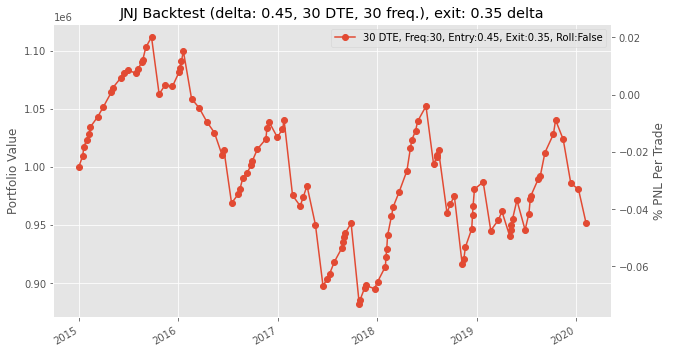

0.450.35 took 119.66601634025574 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 105.0, Underlying: 104.57, Premium: 0.9, Delta: 0.446113
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-06 for 0.14
PNL 2015-01-06 00:00:00 = 5852.0 (premium = 0.9, exit = 0.14)

Date 2015-01-07, Expiry: 2015-01-17, Strike: 106.0, Underlying: 105.56, Premium: 0.82, Delta: 0.435654
Bought back call (expiry 2015-01-17 00:00:00, strike = 106.0) on 2015-01-12 for 0.14
PNL 2015-01-12 00:00:00 = 5235.999999999999 (premium = 0.82, exit = 0.14)

Date 2015-01-13, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 0.42, Delta: 0.391119
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-14 for 0.15
PNL 2015-01-14 00:00:00 = 2079.0 (premium = 0.42, exit = 0.15)

Date 2015-01-15, Expiry: 2015-01-23, Strike: 103.0, Underlying: 102.54, Premium: 1.01, Delta: 0.448163
Bought back call (expiry 2015-01-23 00:00:00, strike = 103.0) on 2015-01-20 for 0.19
PNL 20

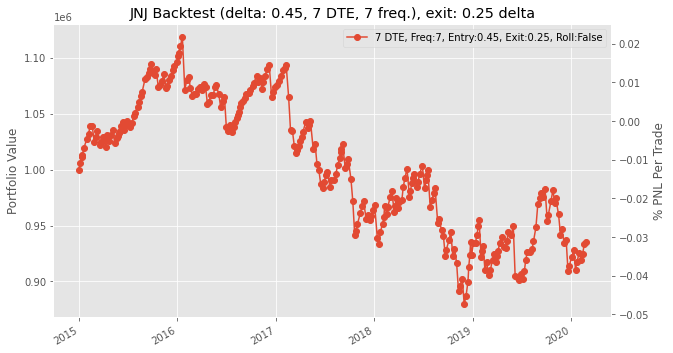

Date 2014-12-31, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 1.23, Delta: 0.45979
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-14 for 0.15
PNL 2015-01-14 00:00:00 = 8316.0 (premium = 1.23, exit = 0.15)

Date 2015-01-15, Expiry: 2015-01-30, Strike: 103.0, Underlying: 102.54, Premium: 1.38, Delta: 0.464808
Bought back call (expiry 2015-01-30 00:00:00, strike = 103.0) on 2015-01-28 for 0.16
PNL 2015-01-28 00:00:00 = 9394.0 (premium = 1.38, exit = 0.16)

Date 2015-01-29, Expiry: 2015-02-13, Strike: 103.0, Underlying: 102.425, Premium: 0.85, Delta: 0.419419
Bought back call (expiry 2015-02-13 00:00:00, strike = 103.0) on 2015-01-30 for 0.41
PNL 2015-01-30 00:00:00 = 3388.0 (premium = 0.85, exit = 0.41)

Date 2015-01-30, Expiry: 2015-02-13, Strike: 101.0, Underlying: 100.33, Premium: 1.02, Delta: 0.436155
Expired call (expiry 2015-02-13 00:00:00, strike = 101.0) on 2015-01-30
At expiry, underlying is 99.6099 , strike is 101.0
PNL 2015-02-13 00:

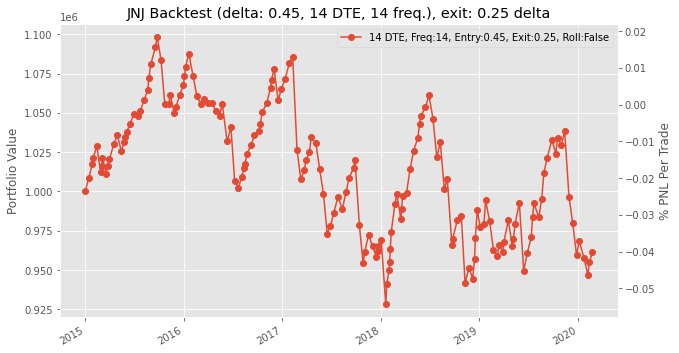

Date 2014-12-31, Expiry: 2015-01-23, Strike: 105.0, Underlying: 104.57, Premium: 1.61, Delta: 0.478491
Bought back call (expiry 2015-01-23 00:00:00, strike = 105.0) on 2015-01-15 for 0.35
PNL 2015-01-15 00:00:00 = 9702.000000000002 (premium = 1.61, exit = 0.35)

Date 2015-01-16, Expiry: 2015-02-06, Strike: 105.0, Underlying: 104.04, Premium: 1.2, Delta: 0.419847
Bought back call (expiry 2015-02-06 00:00:00, strike = 105.0) on 2015-01-20 for 0.32
PNL 2015-01-20 00:00:00 = 6775.999999999999 (premium = 1.2, exit = 0.32)

Date 2015-01-21, Expiry: 2015-02-13, Strike: 103.0, Underlying: 101.9, Premium: 1.08, Delta: 0.400645
Bought back call (expiry 2015-02-13 00:00:00, strike = 103.0) on 2015-01-30 for 0.41
PNL 2015-01-30 00:00:00 = 5159.000000000001 (premium = 1.08, exit = 0.41)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 101.0, Underlying: 100.33, Premium: 1.23, Delta: 0.417642
Bought back call (expiry 2015-02-20 00:00:00, strike = 101.0) on 2015-02-12 for 0.12
PNL 2015-02-12 00:00:00 = 

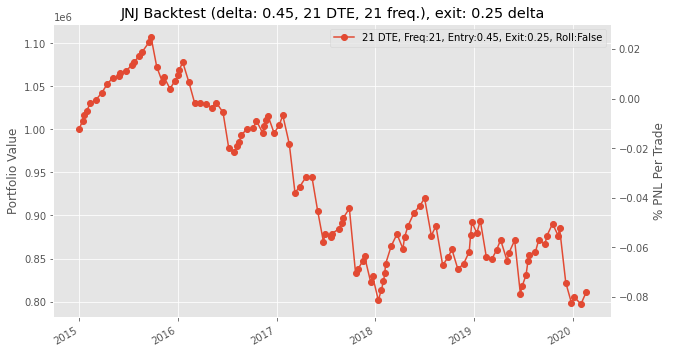

Date 2014-12-31, Expiry: 2015-01-30, Strike: 105.0, Underlying: 104.57, Premium: 1.88, Delta: 0.49021
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-20 for 0.15
PNL 2015-01-20 00:00:00 = 13321.0 (premium = 1.88, exit = 0.15)

Date 2015-01-21, Expiry: 2015-02-20, Strike: 102.0, Underlying: 101.9, Premium: 1.59, Delta: 0.480095
Bought back call (expiry 2015-02-20 00:00:00, strike = 102.0) on 2015-02-09 for 0.29
PNL 2015-02-09 00:00:00 = 10010.0 (premium = 1.59, exit = 0.29)

Date 2015-02-10, Expiry: 2015-03-13, Strike: 100.0, Underlying: 100.34, Premium: 1.72, Delta: 0.494317
Bought back call (expiry 2015-03-13 00:00:00, strike = 100.0) on 2015-03-11 for 0.08
PNL 2015-03-11 00:00:00 = 12628.0 (premium = 1.72, exit = 0.08)

Date 2015-03-12, Expiry: 2015-04-10, Strike: 100.0, Underlying: 99.83, Premium: 1.63, Delta: 0.4933
Expired call (expiry 2015-04-10 00:00:00, strike = 100.0) on 2015-03-12
Strike was breached- At expiry, underlying is 101.94 , strike is 100.0


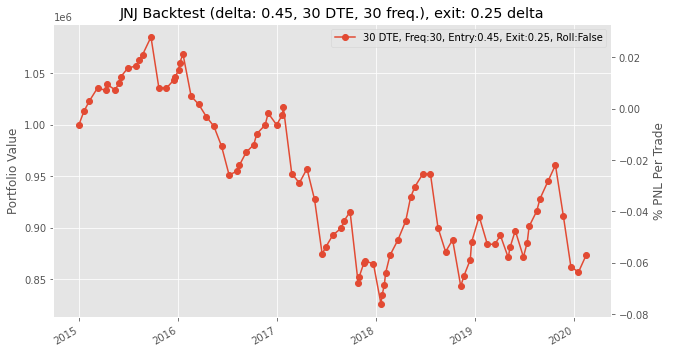

0.450.25 took 109.62873077392578 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 105.0, Underlying: 104.57, Premium: 0.9, Delta: 0.446113
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-05 for 0.36
PNL 2015-01-05 00:00:00 = 4158.0 (premium = 0.9, exit = 0.36)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 103.0, Underlying: 103.28, Premium: 0.88, Delta: 0.568177
Expired call (expiry 2015-01-09 00:00:00, strike = 103.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 103.0
We lost money  PNL 2015-01-09 = -8701.00000000004 (premium = 0.88, exit = 2.010000000000005)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 105.0, Underlying: 105.01, Premium: 0.85, Delta: 0.509847
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-13 for 0.42
PNL 2015-01-13 00:00:00 = 3311.0 (premium = 0.85, exit = 0.42)

Date 2015-01-14, Expiry: 2015-01-23, Strike: 104.0, Underlying: 103.935, Premium: 1.14, Delta: 0.498414
Bought back c

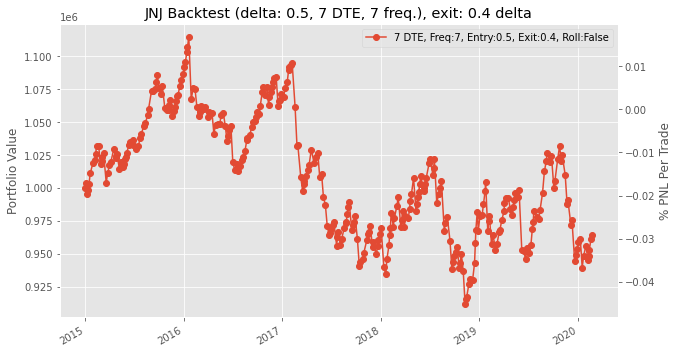

Date 2014-12-31, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 1.23, Delta: 0.45979
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-05 for 0.66
PNL 2015-01-05 00:00:00 = 4389.0 (premium = 1.23, exit = 0.66)

Date 2015-01-06, Expiry: 2015-01-17, Strike: 103.0, Underlying: 103.28, Premium: 1.3, Delta: 0.544387
Bought back call (expiry 2015-01-17 00:00:00, strike = 103.0) on 2015-01-15 for 0.27
PNL 2015-01-15 00:00:00 = 7931.0 (premium = 1.3, exit = 0.27)

Date 2015-01-16, Expiry: 2015-01-30, Strike: 104.0, Underlying: 104.04, Premium: 1.46, Delta: 0.511944
Bought back call (expiry 2015-01-30 00:00:00, strike = 104.0) on 2015-01-20 for 0.31
PNL 2015-01-20 00:00:00 = 8855.0 (premium = 1.46, exit = 0.31)

Date 2015-01-21, Expiry: 2015-02-06, Strike: 102.0, Underlying: 101.9, Premium: 1.33, Delta: 0.5052949999999999
Bought back call (expiry 2015-02-06 00:00:00, strike = 102.0) on 2015-01-30 for 0.32
PNL 2015-01-30 00:00:00 = 7777.0 (premium = 1.33, 

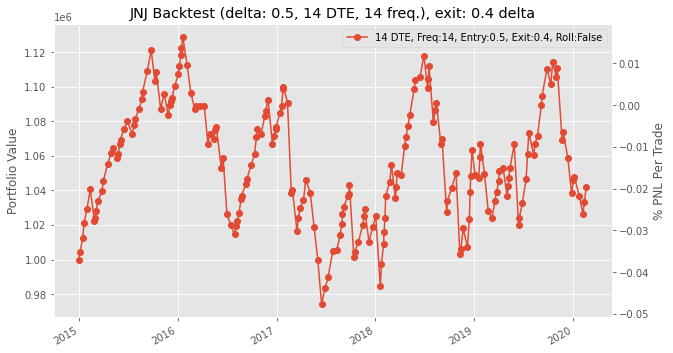

Date 2014-12-31, Expiry: 2015-01-23, Strike: 105.0, Underlying: 104.57, Premium: 1.61, Delta: 0.478491
Bought back call (expiry 2015-01-23 00:00:00, strike = 105.0) on 2015-01-05 for 1.0
PNL 2015-01-05 00:00:00 = 4697.000000000001 (premium = 1.61, exit = 1.0)

Date 2015-01-06, Expiry: 2015-01-30, Strike: 103.0, Underlying: 103.28, Premium: 1.9, Delta: 0.5353100000000001
Bought back call (expiry 2015-01-30 00:00:00, strike = 103.0) on 2015-01-20 for 0.55
PNL 2015-01-20 00:00:00 = 10394.999999999998 (premium = 1.9, exit = 0.55)

Date 2015-01-21, Expiry: 2015-02-13, Strike: 102.0, Underlying: 101.9, Premium: 1.56, Delta: 0.503043
Bought back call (expiry 2015-02-13 00:00:00, strike = 102.0) on 2015-01-30 for 0.65
PNL 2015-01-30 00:00:00 = 7007.0 (premium = 1.56, exit = 0.65)

Date 2015-01-30, Expiry: 2015-02-20, Strike: 100.0, Underlying: 100.33, Premium: 1.72, Delta: 0.515516
Bought back call (expiry 2015-02-20 00:00:00, strike = 100.0) on 2015-02-12 for 0.28
PNL 2015-02-12 00:00:00 = 11

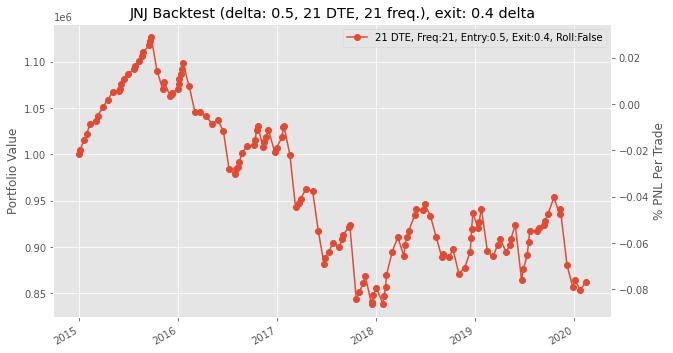

Date 2014-12-31, Expiry: 2015-01-30, Strike: 105.0, Underlying: 104.57, Premium: 1.88, Delta: 0.49021
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-06 for 1.0
PNL 2015-01-06 00:00:00 = 6775.999999999999 (premium = 1.88, exit = 1.0)

Date 2015-01-07, Expiry: 2015-02-06, Strike: 106.0, Underlying: 105.56, Premium: 1.68, Delta: 0.465104
Bought back call (expiry 2015-02-06 00:00:00, strike = 106.0) on 2015-01-12 for 1.16
PNL 2015-01-12 00:00:00 = 4004.0 (premium = 1.68, exit = 1.16)

Date 2015-01-13, Expiry: 2015-02-13, Strike: 105.0, Underlying: 104.57, Premium: 1.77, Delta: 0.481432
Bought back call (expiry 2015-02-13 00:00:00, strike = 105.0) on 2015-01-15 for 1.05
PNL 2015-01-15 00:00:00 = 5544.0 (premium = 1.77, exit = 1.05)

Date 2015-01-16, Expiry: 2015-02-13, Strike: 104.0, Underlying: 104.04, Premium: 2.07, Delta: 0.513868
Bought back call (expiry 2015-02-13 00:00:00, strike = 104.0) on 2015-01-20 for 0.72
PNL 2015-01-20 00:00:00 = 10394.999999999998 (pr

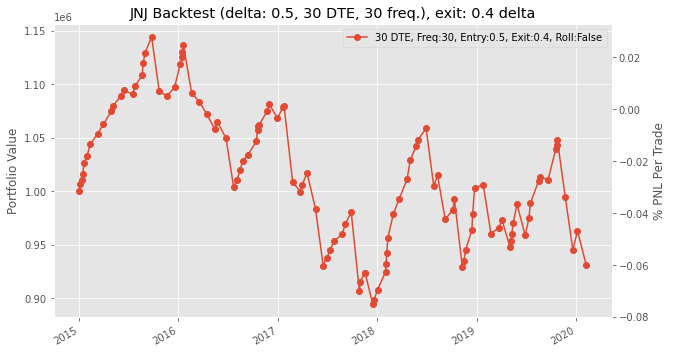

0.50.4 took 118.12166953086853 seconds
Date 2014-12-31, Expiry: 2015-01-09, Strike: 105.0, Underlying: 104.57, Premium: 0.9, Delta: 0.446113
Bought back call (expiry 2015-01-09 00:00:00, strike = 105.0) on 2015-01-05 for 0.36
PNL 2015-01-05 00:00:00 = 4158.0 (premium = 0.9, exit = 0.36)

Date 2015-01-06, Expiry: 2015-01-09, Strike: 103.0, Underlying: 103.28, Premium: 0.88, Delta: 0.568177
Expired call (expiry 2015-01-09 00:00:00, strike = 103.0) on 2015-01-06
Strike was breached- At expiry, underlying is 105.01 , strike is 103.0
We lost money  PNL 2015-01-09 = -8701.00000000004 (premium = 0.88, exit = 2.010000000000005)

Date 2015-01-09, Expiry: 2015-01-17, Strike: 105.0, Underlying: 105.01, Premium: 0.85, Delta: 0.509847
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-14 for 0.15
PNL 2015-01-14 00:00:00 = 5390.0 (premium = 0.85, exit = 0.15)

Date 2015-01-15, Expiry: 2015-01-23, Strike: 103.0, Underlying: 102.54, Premium: 1.01, Delta: 0.448163
Bought back call

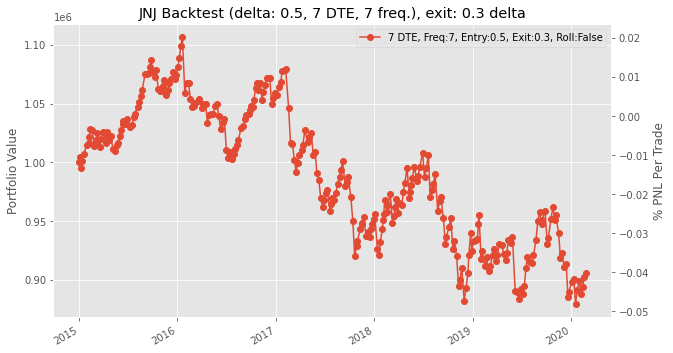

Date 2014-12-31, Expiry: 2015-01-17, Strike: 105.0, Underlying: 104.57, Premium: 1.23, Delta: 0.45979
Bought back call (expiry 2015-01-17 00:00:00, strike = 105.0) on 2015-01-06 for 0.44
PNL 2015-01-06 00:00:00 = 6083.0 (premium = 1.23, exit = 0.44)

Date 2015-01-07, Expiry: 2015-01-23, Strike: 106.0, Underlying: 105.56, Premium: 1.02, Delta: 0.445676
Bought back call (expiry 2015-01-23 00:00:00, strike = 106.0) on 2015-01-14 for 0.42
PNL 2015-01-14 00:00:00 = 4620.000000000001 (premium = 1.02, exit = 0.42)

Date 2015-01-15, Expiry: 2015-01-30, Strike: 103.0, Underlying: 102.54, Premium: 1.38, Delta: 0.464808
Bought back call (expiry 2015-01-30 00:00:00, strike = 103.0) on 2015-01-20 for 0.55
PNL 2015-01-20 00:00:00 = 6390.999999999999 (premium = 1.38, exit = 0.55)

Date 2015-01-21, Expiry: 2015-02-06, Strike: 102.0, Underlying: 101.9, Premium: 1.33, Delta: 0.5052949999999999
Bought back call (expiry 2015-02-06 00:00:00, strike = 102.0) on 2015-01-30 for 0.32
PNL 2015-01-30 00:00:00 = 

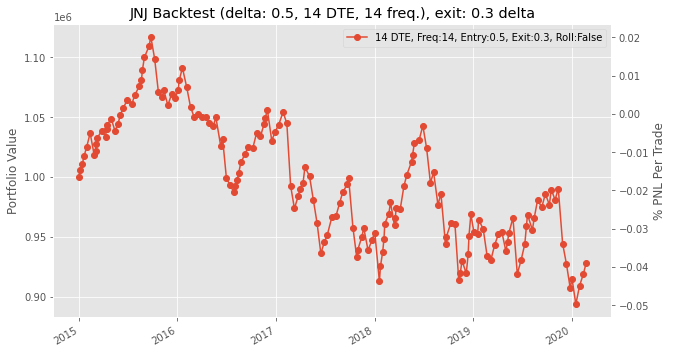

Date 2014-12-31, Expiry: 2015-01-23, Strike: 105.0, Underlying: 104.57, Premium: 1.61, Delta: 0.478491
Bought back call (expiry 2015-01-23 00:00:00, strike = 105.0) on 2015-01-15 for 0.35
PNL 2015-01-15 00:00:00 = 9702.000000000002 (premium = 1.61, exit = 0.35)

Date 2015-01-16, Expiry: 2015-02-06, Strike: 104.0, Underlying: 104.04, Premium: 1.72, Delta: 0.518752
Bought back call (expiry 2015-02-06 00:00:00, strike = 104.0) on 2015-01-20 for 0.5
PNL 2015-01-20 00:00:00 = 9394.0 (premium = 1.72, exit = 0.5)

Date 2015-01-21, Expiry: 2015-02-13, Strike: 102.0, Underlying: 101.9, Premium: 1.56, Delta: 0.503043
Bought back call (expiry 2015-02-13 00:00:00, strike = 102.0) on 2015-02-09 for 0.13
PNL 2015-02-09 00:00:00 = 11011.000000000002 (premium = 1.56, exit = 0.13)

Date 2015-02-10, Expiry: 2015-03-06, Strike: 100.0, Underlying: 100.34, Premium: 1.44, Delta: 0.492592
Bought back call (expiry 2015-03-06 00:00:00, strike = 100.0) on 2015-02-12 for 0.68
PNL 2015-02-12 00:00:00 = 5851.99999

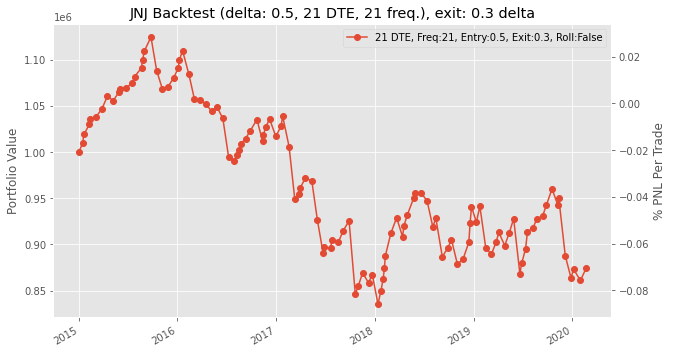

Date 2014-12-31, Expiry: 2015-01-30, Strike: 105.0, Underlying: 104.57, Premium: 1.88, Delta: 0.49021
Bought back call (expiry 2015-01-30 00:00:00, strike = 105.0) on 2015-01-15 for 0.67
PNL 2015-01-15 00:00:00 = 9317.0 (premium = 1.88, exit = 0.67)

Date 2015-01-16, Expiry: 2015-02-13, Strike: 104.0, Underlying: 104.04, Premium: 2.07, Delta: 0.513868
Bought back call (expiry 2015-02-13 00:00:00, strike = 104.0) on 2015-01-20 for 0.72
PNL 2015-01-20 00:00:00 = 10394.999999999998 (premium = 2.07, exit = 0.72)

Date 2015-01-21, Expiry: 2015-02-20, Strike: 102.0, Underlying: 101.9, Premium: 1.59, Delta: 0.480095
Bought back call (expiry 2015-02-20 00:00:00, strike = 102.0) on 2015-02-09 for 0.29
PNL 2015-02-09 00:00:00 = 10010.0 (premium = 1.59, exit = 0.29)

Date 2015-02-10, Expiry: 2015-03-13, Strike: 100.0, Underlying: 100.34, Premium: 1.72, Delta: 0.494317
Bought back call (expiry 2015-03-13 00:00:00, strike = 100.0) on 2015-03-11 for 0.08
PNL 2015-03-11 00:00:00 = 12628.0 (premium = 

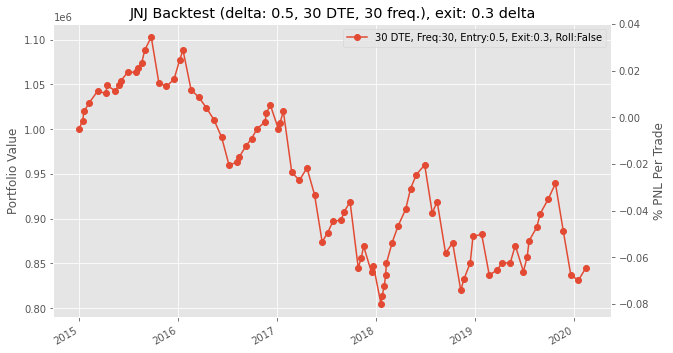

0.50.3 took 105.68094563484192 seconds
   [Entry,Exit,Offset]          7         14         21        30
0          [0.1, 0, 1]   941210.5   997690.0   971163.5  959613.5
1        [0.2, 0.1, 1]   983329.5   958959.0   962077.5  909910.0
2        [0.2, 0.0, 1]   954724.0   969315.5  1011742.5  965927.5
3      [0.25, 0.15, 1]   956110.0   967298.1   956610.5  954262.0
4      [0.25, 0.05, 1]   916801.5  1010772.3   985870.5  887657.0
5        [0.3, 0.2, 1]   939370.2   961561.6   876530.5  906868.5
6        [0.3, 0.1, 1]   905752.0   947701.6   946408.0  868407.0
7      [0.35, 0.25, 1]   974898.0  1061700.1   911765.7  924886.5
8      [0.35, 0.15, 1]   978863.5   986240.1   916809.2  918688.0
9        [0.4, 0.3, 1]  1015677.2   995903.6   925895.2  863248.0
10       [0.4, 0.2, 1]   946377.2   972996.1   908146.7  845653.5
11     [0.45, 0.35, 1]   984384.4  1027704.6   911958.2  951528.5
12     [0.45, 0.25, 1]   935250.7   961715.6   810664.7  873412.0
13       [0.5, 0.4, 1]   964133.4  10

In [ ]:
start = time.time()
# Returns Dataframe
data = {'[Entry,Exit,Offset]':[[.1,0,1]],7:[0]}
returns_df = pd.DataFrame(data)
for i in [7,14,21,30]:
    returns_df[i] = [np.float(0)]
for entry in range(4,11):
    for gap in range(1,3):
        data = {f'[Entry,Exit,Offset]':[[round(entry * 0.05,2), round((entry) *0.05  - (gap) * 0.1 ,2),1]]}
        df2 = pd.DataFrame(data)
        for i in [7,14,21,30]:
            df2[i] = [np.float(0)]
        returns_df = pd.concat([returns_df,df2],ignore_index = True)

# Sharpe Dataframe
data = {'[Entry,Exit,Offset]':[[.1,0,1]],7:[0]}
sharpe_df = pd.DataFrame(data)
for i in [7,14,21,30]:
    sharpe_df[i] = [np.float(0)]
for entry in range(4,11):
    for gap in range(1,3):
      data = {f'[Entry,Exit,Offset]':[[round(entry * 0.05,2), round((entry) *0.05  - (gap) * 0.1 ,2),1]]}
      df2 = pd.DataFrame(data)
      for i in [7,14,21,30]:
          df2[i] = [np.float(0)]
      sharpe_df = pd.concat([sharpe_df,df2],ignore_index = True)
print(f'Initialization took {time.time()-start} seconds')

for index, row in returns_df.iterrows():
    start = time.time()
    x,entry_exit = list(row.iteritems())[0]
    entry = entry_exit[0]
    exit = entry_exit[1]
    date_offset = entry_exit[2]
    for dte, columnData in list(row.iteritems())[1:]:
        port_backtest = portfolio(date_offset = date_offset,start_date = datetime(2015,1,1), end_date = datetime(2020,3,1),df = df, dte_sell = dte, frequency= dte,strike_signal_val = entry, exit_signal_val = exit, roll_positions = False)
        port_backtest.backtest_v2()
        returns_df.at[index,dte] = copy.deepcopy(port_backtest.final_return())
        sharpe_df.at[index,dte] = copy.deepcopy(port_backtest.sharpe())
        plot_returns([port_backtest])
    print(f'{entry}{exit} took {time.time() - start} seconds')
print(returns_df)
print(sharpe_df)

Date 2016-12-30, Expiry: 2017-01-27, Strike: 119.0, Underlying: 115.09, Premium: 0.61, Delta: 0.223913
Bought back call (expiry 2017-01-27 00:00:00, strike = 119.0) on 2017-01-12 for 0.24
PNL 2017-01-12 00:00:00 = 2849.0 (premium = 0.61, exit = 0.24)

Date 2017-01-12, Expiry: 2017-02-10, Strike: 118.0, Underlying: 114.598, Premium: 0.73, Delta: 0.255152
Bought back call (expiry 2017-02-10 00:00:00, strike = 118.0) on 2017-01-23 for 0.17
PNL 2017-01-23 00:00:00 = 4312.0 (premium = 0.73, exit = 0.17)

Date 2017-01-23, Expiry: 2017-02-24, Strike: 117.0, Underlying: 113.87, Premium: 0.53, Delta: 0.220574
Bought back call (expiry 2017-02-24 00:00:00, strike = 117.0) on 2017-01-24 for 0.13
PNL 2017-01-24 00:00:00 = 3080.0 (premium = 0.53, exit = 0.13)

Date 2017-01-24, Expiry: 2017-02-24, Strike: 114.0, Underlying: 111.699, Premium: 0.56, Delta: 0.252539
Expired call (expiry 2017-02-24 00:00:00, strike = 114.0) on 2017-01-24
Strike was breached- At expiry, underlying is 122.7300033569336 , s

Date 2018-05-02, Expiry: 2018-06-01, Strike: 127.0, Underlying: 123.565, Premium: 0.88, Delta: 0.263177
Bought back call (expiry 2018-06-01 00:00:00, strike = 127.0) on 2018-05-21 for 0.11
PNL 2018-05-21 00:00:00 = 5929.0 (premium = 0.88, exit = 0.11)

Date 2018-05-21, Expiry: 2018-06-22, Strike: 126.0, Underlying: 123.51, Premium: 0.75, Delta: 0.266533
Bought back call (expiry 2018-06-22 00:00:00, strike = 126.0) on 2018-05-29 for 0.25
PNL 2018-05-29 00:00:00 = 3850.0 (premium = 0.75, exit = 0.25)

Date 2018-05-29, Expiry: 2018-06-29, Strike: 124.0, Underlying: 119.25, Premium: 0.69, Delta: 0.22166
Bought back call (expiry 2018-06-29 00:00:00, strike = 124.0) on 2018-06-28 for 0.03
PNL 2018-06-28 00:00:00 = 5081.999999999999 (premium = 0.69, exit = 0.03)

Date 2018-06-28, Expiry: 2018-07-27, Strike: 127.0, Underlying: 121.995, Premium: 0.83, Delta: 0.235357
Expired call (expiry 2018-07-27 00:00:00, strike = 127.0) on 2018-06-28
Strike was breached- At expiry, underlying is 131.5500030

Bought back call (expiry 2019-11-15 00:00:00, strike = 135.0) on 2019-10-21 for 0.4
PNL 2019-10-21 00:00:00 = 1693.9999999999998 (premium = 0.62, exit = 0.4)

Date 2019-10-21, Expiry: 2019-11-22, Strike: 133.0, Underlying: 128.11, Premium: 0.99, Delta: 0.256209
Expired call (expiry 2019-11-22 00:00:00, strike = 133.0) on 2019-10-21
Strike was breached- At expiry, underlying is 138.07000732421875 , strike is 133.0
We lost money  PNL 2019-11-22 = -31416.056396484375 (premium = 0.99, exit = 5.07000732421875)

Date 2019-11-22, Expiry: 2019-12-20, Strike: 141.0, Underlying: 138.21, Premium: 0.83, Delta: 0.263988
Expired call (expiry 2019-12-20 00:00:00, strike = 141.0) on 2019-11-22
Strike was breached- At expiry, underlying is 146.05999755859375 , strike is 141.0
We lost money  PNL 2019-12-20 = -32570.981201171875 (premium = 0.83, exit = 5.05999755859375)

Date 2016-12-30, Expiry: 2017-01-13, Strike: 117.0, Underlying: 115.09, Premium: 0.49, Delta: 0.272704
Bought back call (expiry 2017-01

Date 2017-09-27, Expiry: 2017-10-13, Strike: 132.0, Underlying: 129.65, Premium: 0.44, Delta: 0.240185
Expired call (expiry 2017-10-13 00:00:00, strike = 132.0) on 2017-09-27
Strike was breached- At expiry, underlying is 136.42999267578125 , strike is 132.0
We lost money  PNL 2017-10-13 = -30722.943603515625 (premium = 0.44, exit = 4.42999267578125)

Date 2017-10-13, Expiry: 2017-10-27, Strike: 140.0, Underlying: 136.5, Premium: 0.51, Delta: 0.21501
Expired call (expiry 2017-10-27 00:00:00, strike = 140.0) on 2017-10-13
Strike was breached- At expiry, underlying is 141.77999877929688 , strike is 140.0
We lost money  PNL 2017-10-27 = -9778.990600585938 (premium = 0.51, exit = 1.779998779296875)

Date 2017-10-27, Expiry: 2017-11-10, Strike: 144.0, Underlying: 141.665, Premium: 0.61, Delta: 0.276343
Bought back call (expiry 2017-11-10 00:00:00, strike = 144.0) on 2017-10-31 for 0.2
PNL 2017-10-31 00:00:00 = 3157.0 (premium = 0.61, exit = 0.2)

Date 2017-10-31, Expiry: 2017-11-17, Strike: 

Bought back call (expiry 2018-05-18 00:00:00, strike = 127.0) on 2018-05-08 for 0.14
PNL 2018-05-08 00:00:00 = 3003.0 (premium = 0.53, exit = 0.14)

Date 2018-05-08, Expiry: 2018-05-25, Strike: 125.0, Underlying: 122.5, Premium: 0.74, Delta: 0.272622
Bought back call (expiry 2018-05-25 00:00:00, strike = 125.0) on 2018-05-22 for 0.09
PNL 2018-05-22 00:00:00 = 5005.0 (premium = 0.74, exit = 0.09)

Date 2018-05-22, Expiry: 2018-06-08, Strike: 125.0, Underlying: 122.87, Premium: 0.5, Delta: 0.236357
Bought back call (expiry 2018-06-08 00:00:00, strike = 125.0) on 2018-05-24 for 0.25
PNL 2018-05-24 00:00:00 = 1925.0 (premium = 0.5, exit = 0.25)

Date 2018-05-24, Expiry: 2018-06-08, Strike: 124.0, Underlying: 122.1, Premium: 0.43, Delta: 0.22507600000000005
Bought back call (expiry 2018-06-08 00:00:00, strike = 124.0) on 2018-05-29 for 0.16
PNL 2018-05-29 00:00:00 = 2079.0 (premium = 0.43, exit = 0.16)

Date 2018-05-29, Expiry: 2018-06-15, Strike: 122.0, Underlying: 119.25, Premium: 0.7, De

At expiry, underlying is 127.83000183105469 , strike is 128.0
PNL 2019-01-04 00:00:00 = 7777.0 (premium = 1.01, exit = 0)

Date 2019-01-04, Expiry: 2019-01-18, Strike: 132.0, Underlying: 127.84, Premium: 0.67, Delta: 0.227673
Bought back call (expiry 2019-01-18 00:00:00, strike = 132.0) on 2019-01-14 for 0.14
PNL 2019-01-14 00:00:00 = 4081.0 (premium = 0.67, exit = 0.14)

Date 2019-01-14, Expiry: 2019-01-25, Strike: 132.0, Underlying: 128.38, Premium: 0.86, Delta: 0.267542
Bought back call (expiry 2019-01-25 00:00:00, strike = 132.0) on 2019-01-22 for 0.1
PNL 2019-01-22 00:00:00 = 5852.0 (premium = 0.86, exit = 0.1)

Date 2019-01-22, Expiry: 2019-02-08, Strike: 132.0, Underlying: 128.06, Premium: 0.62, Delta: 0.22565
Bought back call (expiry 2019-02-08 00:00:00, strike = 132.0) on 2019-01-24 for 0.26
PNL 2019-01-24 00:00:00 = 2772.0 (premium = 0.62, exit = 0.26)

Date 2019-01-24, Expiry: 2019-02-08, Strike: 130.0, Underlying: 126.77, Premium: 0.64, Delta: 0.248523
Expired call (expiry 

Strike was breached- At expiry, underlying is 131.64999389648438 , strike is 131.0
We lost money  PNL 2019-09-20 = -538.9530029296878 (premium = 0.58, exit = 0.649993896484375)

Date 2019-09-20, Expiry: 2019-10-04, Strike: 134.0, Underlying: 131.58, Premium: 0.64, Delta: 0.275679
Bought back call (expiry 2019-10-04 00:00:00, strike = 134.0) on 2019-09-26 for 0.09
PNL 2019-09-26 00:00:00 = 4235.0 (premium = 0.64, exit = 0.09)

Date 2019-09-26, Expiry: 2019-10-11, Strike: 132.0, Underlying: 129.31, Premium: 0.69, Delta: 0.27460100000000004
Bought back call (expiry 2019-10-11 00:00:00, strike = 132.0) on 2019-10-09 for 0.1
PNL 2019-10-09 00:00:00 = 4543.0 (premium = 0.69, exit = 0.1)

Date 2019-10-09, Expiry: 2019-10-25, Strike: 133.0, Underlying: 129.22, Premium: 0.94, Delta: 0.273117
Bought back call (expiry 2019-10-25 00:00:00, strike = 133.0) on 2019-10-18 for 0.23
PNL 2019-10-18 00:00:00 = 5467.0 (premium = 0.94, exit = 0.23)

Date 2019-10-18, Expiry: 2019-11-01, Strike: 132.0, Under

Bought back call (expiry 2017-04-07 00:00:00, strike = 126.0) on 2017-04-04 for 0.05
PNL 2017-04-04 00:00:00 = 1540.0 (premium = 0.25, exit = 0.05)

Date 2017-04-04, Expiry: 2017-04-13, Strike: 126.0, Underlying: 124.45, Premium: 0.25, Delta: 0.224397
Bought back call (expiry 2017-04-13 00:00:00, strike = 126.0) on 2017-04-10 for 0.08
PNL 2017-04-10 00:00:00 = 1308.9999999999998 (premium = 0.25, exit = 0.08)

Date 2017-04-10, Expiry: 2017-04-13, Strike: 125.0, Underlying: 124.335, Premium: 0.29, Delta: 0.321266
Expired call (expiry 2017-04-13 00:00:00, strike = 125.0) on 2017-04-10
At expiry, underlying is 124.98999786376953 , strike is 125.0
PNL 2017-04-13 00:00:00 = 2233.0 (premium = 0.29, exit = 0)

Date 2017-04-13, Expiry: 2017-04-21, Strike: 128.0, Underlying: 125.3, Premium: 0.41, Delta: 0.21700500000000006
Expired call (expiry 2017-04-21 00:00:00, strike = 128.0) on 2017-04-13
At expiry, underlying is 121.76000213623047 , strike is 128.0
PNL 2017-04-21 00:00:00 = 3157.0 (premium

Bought back call (expiry 2017-09-01 00:00:00, strike = 133.0) on 2017-08-30 for 0.03
PNL 2017-08-30 00:00:00 = 1309.0 (premium = 0.2, exit = 0.03)

Date 2017-08-30, Expiry: 2017-09-08, Strike: 133.0, Underlying: 130.975, Premium: 0.21, Delta: 0.183165
Bought back call (expiry 2017-09-08 00:00:00, strike = 133.0) on 2017-09-01 for 0.13
PNL 2017-09-01 00:00:00 = 615.9999999999999 (premium = 0.21, exit = 0.13)

Date 2017-09-01, Expiry: 2017-09-08, Strike: 132.0, Underlying: 131.066, Premium: 0.33, Delta: 0.301364
Bought back call (expiry 2017-09-08 00:00:00, strike = 132.0) on 2017-09-05 for 0.05
PNL 2017-09-05 00:00:00 = 2156.0 (premium = 0.33, exit = 0.05)

Date 2017-09-05, Expiry: 2017-09-15, Strike: 132.0, Underlying: 129.97, Premium: 0.33, Delta: 0.225005
Expired call (expiry 2017-09-15 00:00:00, strike = 132.0) on 2017-09-05
Strike was breached- At expiry, underlying is 134.4499969482422 , strike is 132.0
We lost money  PNL 2017-09-15 = -16323.976501464844 (premium = 0.33, exit = 2.

Strike was breached- At expiry, underlying is 145.75999450683594 , strike is 141.0
We lost money  PNL 2018-01-12 = -33494.95770263672 (premium = 0.41, exit = 4.7599945068359375)

Date 2018-01-12, Expiry: 2018-01-19, Strike: 147.0, Underlying: 145.74, Premium: 0.47, Delta: 0.309904
Expired call (expiry 2018-01-19 00:00:00, strike = 147.0) on 2018-01-12
Strike was breached- At expiry, underlying is 147.36000061035156 , strike is 147.0
PNL 2018-01-19 00:00:00 = 846.9953002929685 (premium = 0.47, exit = 0.3600006103515625)

Date 2018-01-19, Expiry: 2018-01-26, Strike: 150.0, Underlying: 147.5, Premium: 0.71, Delta: 0.281648
Expired call (expiry 2018-01-26 00:00:00, strike = 150.0) on 2018-01-19
At expiry, underlying is 145.3300018310547 , strike is 150.0
PNL 2018-01-26 00:00:00 = 5467.0 (premium = 0.71, exit = 0)

Date 2018-01-26, Expiry: 2018-02-02, Strike: 147.0, Underlying: 145.16, Premium: 0.39, Delta: 0.251922
Bought back call (expiry 2018-02-02 00:00:00, strike = 147.0) on 2018-01-29

Date 2018-05-08, Expiry: 2018-05-18, Strike: 125.0, Underlying: 122.5, Premium: 0.45, Delta: 0.23762600000000006
Bought back call (expiry 2018-05-18 00:00:00, strike = 125.0) on 2018-05-17 for 0.05
PNL 2018-05-17 00:00:00 = 3080.0 (premium = 0.45, exit = 0.05)

Date 2018-05-17, Expiry: 2018-05-25, Strike: 125.0, Underlying: 123.65, Premium: 0.56, Delta: 0.298221
Bought back call (expiry 2018-05-25 00:00:00, strike = 125.0) on 2018-05-22 for 0.09
PNL 2018-05-22 00:00:00 = 3619.0000000000005 (premium = 0.56, exit = 0.09)

Date 2018-05-22, Expiry: 2018-06-01, Strike: 124.0, Underlying: 122.87, Premium: 0.49, Delta: 0.280276
Bought back call (expiry 2018-06-01 00:00:00, strike = 124.0) on 2018-05-24 for 0.16
PNL 2018-05-24 00:00:00 = 2540.9999999999995 (premium = 0.49, exit = 0.16)

Date 2018-05-24, Expiry: 2018-06-01, Strike: 123.0, Underlying: 122.1, Premium: 0.37, Delta: 0.258366
Bought back call (expiry 2018-06-01 00:00:00, strike = 123.0) on 2018-05-29 for 0.06
PNL 2018-05-29 00:00:00

At expiry, underlying is 139.10000610351562 , strike is 140.0
PNL 2018-10-05 00:00:00 = 2541.0 (premium = 0.33, exit = 0)

Date 2018-10-05, Expiry: 2018-10-12, Strike: 141.0, Underlying: 138.74, Premium: 0.32, Delta: 0.211735
Bought back call (expiry 2018-10-12 00:00:00, strike = 141.0) on 2018-10-10 for 0.12
PNL 2018-10-10 00:00:00 = 1540.0 (premium = 0.32, exit = 0.12)

Date 2018-10-10, Expiry: 2018-10-19, Strike: 142.0, Underlying: 137.924, Premium: 0.83, Delta: 0.250111
Bought back call (expiry 2018-10-19 00:00:00, strike = 142.0) on 2018-10-11 for 0.31
PNL 2018-10-11 00:00:00 = 4004.0 (premium = 0.83, exit = 0.31)

Date 2018-10-11, Expiry: 2018-10-19, Strike: 139.0, Underlying: 134.73, Premium: 0.84, Delta: 0.24682
Expired call (expiry 2018-10-19 00:00:00, strike = 139.0) on 2018-10-11
Strike was breached- At expiry, underlying is 139.0500030517578 , strike is 139.0
PNL 2018-10-19 00:00:00 = 6082.976501464844 (premium = 0.84, exit = 0.0500030517578125)

Date 2018-10-19, Expiry: 20

Strike was breached- At expiry, underlying is 138.35000610351562 , strike is 137.0
We lost money  PNL 2019-03-01 = -5698.0469970703125 (premium = 0.61, exit = 1.350006103515625)

Date 2019-03-01, Expiry: 2019-03-08, Strike: 140.0, Underlying: 138.57, Premium: 0.32, Delta: 0.255783
Bought back call (expiry 2019-03-08 00:00:00, strike = 140.0) on 2019-03-07 for 0.01
PNL 2019-03-07 00:00:00 = 2387.0 (premium = 0.32, exit = 0.01)

Date 2019-03-07, Expiry: 2019-03-15, Strike: 140.0, Underlying: 138.14, Premium: 0.37, Delta: 0.24408
Bought back call (expiry 2019-03-15 00:00:00, strike = 140.0) on 2019-03-14 for 0.05
PNL 2019-03-14 00:00:00 = 2464.0 (premium = 0.37, exit = 0.05)

Date 2019-03-14, Expiry: 2019-03-22, Strike: 140.0, Underlying: 138.33, Premium: 0.38, Delta: 0.258004
Bought back call (expiry 2019-03-22 00:00:00, strike = 140.0) on 2019-03-15 for 0.1
PNL 2019-03-15 00:00:00 = 2156.0 (premium = 0.38, exit = 0.1)

Date 2019-03-15, Expiry: 2019-03-22, Strike: 139.0, Underlying: 137.

Date 2019-07-19, Expiry: 2019-07-26, Strike: 133.0, Underlying: 131.0, Premium: 0.47, Delta: 0.261281
Bought back call (expiry 2019-07-26 00:00:00, strike = 133.0) on 2019-07-22 for 0.05
PNL 2019-07-22 00:00:00 = 3234.0 (premium = 0.47, exit = 0.05)

Date 2019-07-22, Expiry: 2019-07-26, Strike: 130.0, Underlying: 128.32, Premium: 0.44, Delta: 0.273491
Expired call (expiry 2019-07-26 00:00:00, strike = 130.0) on 2019-07-22
Strike was breached- At expiry, underlying is 130.72999572753906 , strike is 130.0
We lost money  PNL 2019-07-26 = -2232.9671020507812 (premium = 0.44, exit = 0.7299957275390625)

Date 2019-07-26, Expiry: 2019-08-02, Strike: 133.0, Underlying: 130.61, Premium: 0.28, Delta: 0.193243
Bought back call (expiry 2019-08-02 00:00:00, strike = 133.0) on 2019-07-31 for 0.12
PNL 2019-07-31 00:00:00 = 1232.0000000000002 (premium = 0.28, exit = 0.12)

Date 2019-07-31, Expiry: 2019-08-09, Strike: 133.0, Underlying: 130.98, Premium: 0.6, Delta: 0.288744
Bought back call (expiry 201

Strike was breached- At expiry, underlying is 141.3800048828125 , strike is 139.0
We lost money  PNL 2019-12-13 = -13860.03759765625 (premium = 0.58, exit = 2.3800048828125)

Date 2019-12-13, Expiry: 2019-12-20, Strike: 143.0, Underlying: 141.55, Premium: 0.39, Delta: 0.27575
Expired call (expiry 2019-12-20 00:00:00, strike = 143.0) on 2019-12-13
Strike was breached- At expiry, underlying is 146.05999755859375 , strike is 143.0
We lost money  PNL 2019-12-20 = -20558.981201171875 (premium = 0.39, exit = 3.05999755859375)

Date 2019-12-20, Expiry: 2019-12-27, Strike: 148.0, Underlying: 146.46, Premium: 0.37, Delta: 0.263301
Bought back call (expiry 2019-12-27 00:00:00, strike = 148.0) on 2019-12-24 for 0.03
PNL 2019-12-24 00:00:00 = 2617.9999999999995 (premium = 0.37, exit = 0.03)

Date 2019-12-24, Expiry: 2020-01-03, Strike: 148.0, Underlying: 145.83, Premium: 0.38, Delta: 0.234918
Bought back call (expiry 2020-01-03 00:00:00, strike = 148.0) on 2019-12-30 for 0.07
PNL 2019-12-30 00:00:

Strike was breached- At expiry, underlying is 140.0800018310547 , strike is 85.0
PNL 2017-11-03 00:00:00 = 16400.985900878914 (premium = 57.21, exit = 55.08000183105469)

Date 2017-11-03, Expiry: 2017-11-17, Strike: 90.0, Underlying: 139.93, Premium: 49.98, Delta: 1.0
Expired call (expiry 2017-11-17 00:00:00, strike = 90.0) on 2017-11-03
Strike was breached- At expiry, underlying is 138 , strike is 90.0
PNL 2017-11-17 00:00:00 = 15245.999999999976 (premium = 49.98, exit = 48.0)

Date 2017-11-17, Expiry: 2017-12-01, Strike: 90.0, Underlying: 138.02, Premium: 47.39, Delta: 1.0
Expired call (expiry 2017-12-01 00:00:00, strike = 90.0) on 2017-11-17
Strike was breached- At expiry, underlying is 139.97999572753906 , strike is 90.0
We lost money  PNL 2017-12-01 = -19942.967102050778 (premium = 47.39, exit = 49.97999572753906)

Date 2017-12-01, Expiry: 2017-12-15, Strike: 90.0, Underlying: 139.85, Premium: 49.93, Delta: 1.0
Expired call (expiry 2017-12-15 00:00:00, strike = 90.0) on 2017-12-01

Strike was breached- At expiry, underlying is 139.10000610351562 , strike is 115.0
PNL 2018-10-05 00:00:00 = 30568.95300292969 (premium = 28.07, exit = 24.100006103515625)

Date 2018-10-05, Expiry: 2018-10-19, Strike: 70.0, Underlying: 138.74, Premium: 68.79, Delta: 0.999928
Expired call (expiry 2018-10-19 00:00:00, strike = 70.0) on 2018-10-05
Strike was breached- At expiry, underlying is 139.0500030517578 , strike is 70.0
We lost money  PNL 2018-10-19 = -2002.023498535108 (premium = 68.79, exit = 69.05000305175781)

Date 2018-10-19, Expiry: 2018-11-02, Strike: 120.0, Underlying: 139.435, Premium: 19.56, Delta: 0.999709
Expired call (expiry 2018-11-02 00:00:00, strike = 120.0) on 2018-10-19
Strike was breached- At expiry, underlying is 140.67999267578125 , strike is 120.0
We lost money  PNL 2018-11-02 = -8623.943603515634 (premium = 19.56, exit = 20.67999267578125)

Date 2018-11-02, Expiry: 2018-11-16, Strike: 80.0, Underlying: 140.55, Premium: 60.59, Delta: 0.999815
Expired call (exp

Strike was breached- At expiry, underlying is 128.2100067138672 , strike is 110.0
We lost money  PNL 2019-09-06 = -6622.051696777333 (premium = 17.35, exit = 18.210006713867188)

Date 2019-09-06, Expiry: 2019-09-20, Strike: 70.0, Underlying: 128.26, Premium: 58.32, Delta: 1.0
Expired call (expiry 2019-09-20 00:00:00, strike = 70.0) on 2019-09-06
Strike was breached- At expiry, underlying is 131.64999389648438 , strike is 70.0
We lost money  PNL 2019-09-20 = -25640.953002929684 (premium = 58.32, exit = 61.649993896484375)

Date 2019-09-20, Expiry: 2019-10-04, Strike: 100.0, Underlying: 131.58, Premium: 31.65, Delta: 1.0
Expired call (expiry 2019-10-04 00:00:00, strike = 100.0) on 2019-09-20
Strike was breached- At expiry, underlying is 133.66000366210938 , strike is 100.0
We lost money  PNL 2019-10-04 = -15477.028198242198 (premium = 31.65, exit = 33.660003662109375)

Date 2019-10-04, Expiry: 2019-10-18, Strike: 70.0, Underlying: 133.62, Premium: 63.67, Delta: 1.0
Expired call (expiry 2

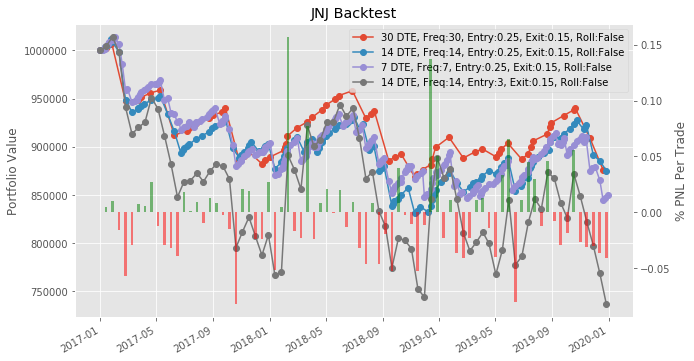

AttributeError: 'numpy.ndarray' object has no attribute 'pct_change'

In [ ]:
jnj_30 = portfolio(dte_sell = 30, frequency= 30,roll_positions = False)
jnj_30.backtest_v2()
jnj_14 = portfolio(dte_sell = 14, frequency= 14,roll_positions = False)
jnj_14.backtest_v2()
jnj_7 = portfolio(dte_sell = 7, frequency= 7,roll_positions = False)
jnj_7.backtest_v2()
jnj_14v = portfolio(dte_sell = 14, frequency= 14,strike_signal_val = .3, exit_signal_val = 0.15, roll_positions = False)
jnj_14v.backtest_v2()
plot_returns([jnj_30,jnj_14,jnj_7,jnj_14v])
print(jnj_30.final_return(),jnj_30.sharpe())
print(jnj_14.final_return(),jnj_14.sharpe())
print(jnj_7.final_return(),jnj_7.sharpe())
print(jnj_14v.final_return(),jnj_14v.sharpe())

In [ ]:
jnj_14v = portfolio(dte_sell = 14, frequency= 14,strike_signal_val = .3, exit_signal_val = 0.15, roll_positions = False)
jnj_14v.backtest_v2()

Date 2016-12-30, Expiry: 2017-01-13, Strike: 117.0, Underlying: 115.09, Premium: 0.49, Delta: 0.272704
Bought back call (expiry 2017-01-13 00:00:00, strike = 117.0) on 2017-01-11 for 0.02
PNL 2017-01-11 00:00:00 = 3619.0 (premium = 0.49, exit = 0.02)

Date 2017-01-11, Expiry: 2017-01-27, Strike: 117.0, Underlying: 114.87, Premium: 0.77, Delta: 0.30688000000000004
Bought back call (expiry 2017-01-27 00:00:00, strike = 117.0) on 2017-01-20 for 0.2
PNL 2017-01-20 00:00:00 = 4389.000000000001 (premium = 0.77, exit = 0.2)

Date 2017-01-20, Expiry: 2017-02-03, Strike: 116.0, Underlying: 114.14, Premium: 0.57, Delta: 0.289961
Bought back call (expiry 2017-02-03 00:00:00, strike = 116.0) on 2017-01-24 for 0.02
PNL 2017-01-24 00:00:00 = 4234.999999999999 (premium = 0.57, exit = 0.02)

Date 2017-01-24, Expiry: 2017-02-10, Strike: 113.0, Underlying: 111.699, Premium: 0.49, Delta: 0.312594
Expired call (expiry 2017-02-10 00:00:00, strike = 113.0) on 2017-01-24
Strike was breached- At expiry, under

Strike was breached- At expiry, underlying is 141.77999877929688 , strike is 139.0
We lost money  PNL 2017-10-27 = -15630.990600585938 (premium = 0.75, exit = 2.779998779296875)

Date 2017-10-27, Expiry: 2017-11-10, Strike: 144.0, Underlying: 141.665, Premium: 0.61, Delta: 0.276343
Bought back call (expiry 2017-11-10 00:00:00, strike = 144.0) on 2017-10-31 for 0.2
PNL 2017-10-31 00:00:00 = 3157.0 (premium = 0.61, exit = 0.2)

Date 2017-10-31, Expiry: 2017-11-17, Strike: 142.0, Underlying: 139.51, Premium: 0.76, Delta: 0.293394
Bought back call (expiry 2017-11-17 00:00:00, strike = 142.0) on 2017-11-13 for 0.07
PNL 2017-11-13 00:00:00 = 5313.0 (premium = 0.76, exit = 0.07)

Date 2017-11-13, Expiry: 2017-11-24, Strike: 141.0, Underlying: 139.79, Premium: 0.55, Delta: 0.384184
Bought back call (expiry 2017-11-24 00:00:00, strike = 141.0) on 2017-11-17 for 0.03
PNL 2017-11-17 00:00:00 = 4004.0 (premium = 0.55, exit = 0.03)

Date 2017-11-17, Expiry: 2017-12-01, Strike: 139.0, Underlying: 13

Strike was breached- At expiry, underlying is 131.9499969482422 , strike is 128.0
We lost money  PNL 2018-08-03 = -26333.97650146484 (premium = 0.53, exit = 3.9499969482421875)

Date 2018-08-03, Expiry: 2018-08-17, Strike: 134.0, Underlying: 131.805, Premium: 0.52, Delta: 0.26615500000000003
Bought back call (expiry 2018-08-17 00:00:00, strike = 134.0) on 2018-08-08 for 0.18
PNL 2018-08-08 00:00:00 = 2618.0 (premium = 0.52, exit = 0.18)

Date 2018-08-08, Expiry: 2018-08-24, Strike: 133.0, Underlying: 131.305, Premium: 0.66, Delta: 0.321446
Bought back call (expiry 2018-08-24 00:00:00, strike = 133.0) on 2018-08-14 for 0.16
PNL 2018-08-14 00:00:00 = 3850.0 (premium = 0.66, exit = 0.16)

Date 2018-08-14, Expiry: 2018-08-31, Strike: 131.0, Underlying: 129.59, Premium: 0.66, Delta: 0.30330100000000004
Expired call (expiry 2018-08-31 00:00:00, strike = 131.0) on 2018-08-14
Strike was breached- At expiry, underlying is 134.69000244140625 , strike is 131.0
We lost money  PNL 2018-08-31 = -233

Expired call (expiry 2019-05-31 00:00:00, strike = 139.0) on 2019-05-15
At expiry, underlying is 131.14999389648438 , strike is 139.0
PNL 2019-05-31 00:00:00 = 6006.0 (premium = 0.78, exit = 0)

Date 2019-05-31, Expiry: 2019-06-14, Strike: 134.0, Underlying: 131.19, Premium: 0.91, Delta: 0.298244
Expired call (expiry 2019-06-14 00:00:00, strike = 134.0) on 2019-05-31
Strike was breached- At expiry, underlying is 140.08999633789062 , strike is 134.0
We lost money  PNL 2019-06-14 = -39885.97180175781 (premium = 0.91, exit = 6.089996337890625)

Date 2019-06-14, Expiry: 2019-06-28, Strike: 143.0, Underlying: 140.31, Premium: 0.7, Delta: 0.276656
Bought back call (expiry 2019-06-28 00:00:00, strike = 143.0) on 2019-06-27 for 0.05
PNL 2019-06-27 00:00:00 = 5004.999999999999 (premium = 0.7, exit = 0.05)

Date 2019-06-27, Expiry: 2019-07-12, Strike: 144.0, Underlying: 141.0, Premium: 0.71, Delta: 0.26697
Bought back call (expiry 2019-07-12 00:00:00, strike = 144.0) on 2019-06-28 for 0.24
PNL 2

In [ ]:
print(jnj_14v.final_return(),jnj_14v.sharpe())

845307.3266296387 -1.733129083719962


Sharpe: -1.733129083719962


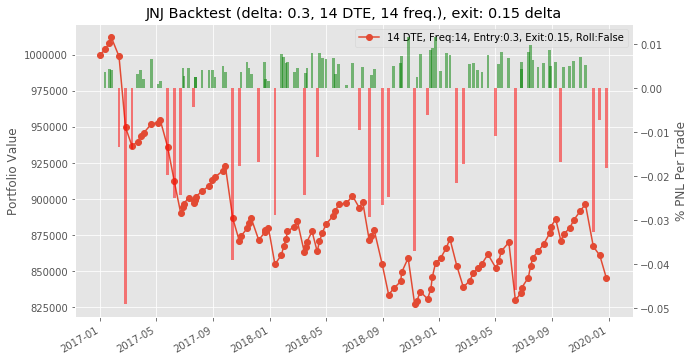

In [ ]:
plot_returns([jnj_14v])

In [ ]:
jnj_hybrid = portfolio(dte_sell = 30, frequency= 30,roll_positions = True, roll_strategy = 'hybrid', roll_credit = 0.5)
jnj_hybrid.run_backtest()

Date 2018-01-02, Expiry: 2018-02-02, Strike: 143.0, Underlying: 139.08, Premium: 0.91, Delta: 0.267409
Bought back call (expiry 2018-02-02T00:00:00.000000000, strike = 143.0) on 2018-02-01 for 0.02
PNL 2018-02-01 00:00:00 = 6853.0 (premium = 0.91, exit = 0.02)

Date 2018-01-31, Expiry: 2018-03-02, Strike: 143.0, Underlying: 138.33, Premium: 0.82, Delta: 0.228925
Bought back call (expiry 2018-03-02T00:00:00.000000000, strike = 143.0) on 2018-02-05 for 0.45
PNL 2018-02-05 00:00:00 = 2848.9999999999995 (premium = 0.82, exit = 0.45)

Date 2018-03-02, Expiry: 2018-03-29, Strike: 134.0, Underlying: 129.07, Premium: 0.8, Delta: 0.22968400000000005
Bought back call (expiry 2018-03-29T00:00:00.000000000, strike = 134.0) on 2018-03-22 for 0.06
PNL 2018-03-22 00:00:00 = 5698.0 (premium = 0.8, exit = 0.06)

Date 2018-04-02, Expiry: 2018-05-04, Strike: 131.0, Underlying: 124.57, Premium: 1.27, Delta: 0.252698
Bought back call (expiry 2018-05-04T00:00:00.000000000, strike = 131.0) on 2018-04-23 for 

Strike was breached- At expiry, underlying is 146.05999755859375 , strike is 141.0
We lost money  PNL 2019-12-20 = -32570.981201171875 (premium = 0.83, exit = 5.05999755859375)

Rolling -4.22999755859375 loss from 2019-12-20. Selling Call on 2019-12-23 00:00:00, Expiry: 2020-01-24, Strike: 152.5, Premium = 0.59, Underlying: 146.57, Delta: 0.183729
Bought back call (expiry 2020-01-24 00:00:00, strike = 152.5) on 2019-12-24 for 0.42
premium = 0.59, exit = 0.42, trade pnl = 0.16999999999999998, total pnl = -4.05999755859375
Achieved roll target with a trade PNL of 0.16999999999999998. Initial loss : -4.22999755859375, total pnl : -4.05999755859375
PNL 2019-12-24 00:00:00 = 1308.9999999999998 (premium = 0.59, exit = 0.42)

Date 2019-12-23, Expiry: 2020-01-24, Strike: 150.0, Underlying: 146.57, Premium: 1.22, Delta: 0.31450900000000004
Bought back call (expiry 2020-01-24T00:00:00.000000000, strike = 150.0) on 2020-01-06 for 0.33
PNL 2020-01-06 00:00:00 = 6852.999999999999 (premium = 1.22, e

In [ ]:
jnj_total = portfolio(dte_sell = 30, frequency= 30,roll_positions = True, roll_strategy = 'total_pnl', roll_credit = 0.5)
jnj_total.run_backtest()

Date 2018-01-02, Expiry: 2018-02-02, Strike: 143.0, Underlying: 139.08, Premium: 0.91, Delta: 0.267409
Bought back call (expiry 2018-02-02T00:00:00.000000000, strike = 143.0) on 2018-02-01 for 0.02
PNL 2018-02-01 00:00:00 = 6853.0 (premium = 0.91, exit = 0.02)

Date 2018-01-31, Expiry: 2018-03-02, Strike: 143.0, Underlying: 138.33, Premium: 0.82, Delta: 0.228925
Bought back call (expiry 2018-03-02T00:00:00.000000000, strike = 143.0) on 2018-02-05 for 0.45
PNL 2018-02-05 00:00:00 = 2848.9999999999995 (premium = 0.82, exit = 0.45)

Date 2018-03-02, Expiry: 2018-03-29, Strike: 134.0, Underlying: 129.07, Premium: 0.8, Delta: 0.22968400000000005
Bought back call (expiry 2018-03-29T00:00:00.000000000, strike = 134.0) on 2018-03-22 for 0.06
PNL 2018-03-22 00:00:00 = 5698.0 (premium = 0.8, exit = 0.06)

Date 2018-04-02, Expiry: 2018-05-04, Strike: 131.0, Underlying: 124.57, Premium: 1.27, Delta: 0.252698
Bought back call (expiry 2018-05-04T00:00:00.000000000, strike = 131.0) on 2018-04-23 for 

Rolling -0.020000000000000018 loss from 2018-12-28. Selling Call on 2018-12-31 00:00:00, Expiry: 2019-02-01, Strike: 140.0, Premium = 0.55, Underlying: 128.94, Delta: 0.128175
Bought back call (expiry 2019-02-01 00:00:00, strike = 140.0) on 2019-01-02 for 0.31
premium = 0.55, exit = 0.31, trade pnl = 0.24000000000000005, total pnl = 0.22000000000000003
Achieved roll target with a trade PNL of 0.24000000000000005. Initial loss : -0.020000000000000018, total pnl : 0.22000000000000003
PNL 2019-01-02 00:00:00 = 1848.0000000000005 (premium = 0.55, exit = 0.31)

Rolling -0.10999999999999999 loss from 2018-12-28. Selling Call on 2018-12-31 00:00:00, Expiry: 2019-02-01, Strike: 140.0, Premium = 0.55, Underlying: 128.94, Delta: 0.128175
Bought back call (expiry 2019-02-01 00:00:00, strike = 140.0) on 2019-01-02 for 0.31
premium = 0.55, exit = 0.31, trade pnl = 0.24000000000000005, total pnl = 0.13000000000000006
Achieved roll target with a trade PNL of 0.24000000000000005. Initial loss : -0.089

Bought back call (expiry 2019-06-07 00:00:00, strike = 146.0) on 2019-05-09 for 0.37
premium = 0.56, exit = 0.37, trade pnl = 0.19000000000000006, total pnl = -1.6900006103515626
Made 0.19000000000000006. Rolling position to recover -1.6900006103515626 total loss
PNL 2019-05-09 00:00:00 = 1463.0000000000005 (premium = 0.56, exit = 0.37)

Rolling -1.6900006103515626 loss from 2019-05-09. Selling Call on 2019-05-10 00:00:00, Expiry: 2019-06-07, Strike: 144.0, Premium = 0.56, Underlying: 138.79, Delta: 0.177723
Bought back call (expiry 2019-06-07 00:00:00, strike = 144.0) on 2019-05-13 for 0.35
premium = 0.56, exit = 0.35, trade pnl = 0.21000000000000008, total pnl = -1.4800006103515626
Made 0.21000000000000008. Rolling position to recover -1.4800006103515626 total loss
PNL 2019-05-13 00:00:00 = 1617.0000000000007 (premium = 0.56, exit = 0.35)

Rolling -1.4800006103515626 loss from 2019-05-13. Selling Call on 2019-05-14 00:00:00, Expiry: 2019-06-14, Strike: 143.0, Premium = 0.5, Underlyin

Bought back call (expiry 2019-06-07 00:00:00, strike = 146.0) on 2019-05-09 for 0.37
premium = 0.56, exit = 0.37, trade pnl = 0.19000000000000006, total pnl = -2.8700061035156255
Made 0.19000000000000006. Rolling position to recover -2.8700061035156255 total loss
PNL 2019-05-09 00:00:00 = 1463.0000000000005 (premium = 0.56, exit = 0.37)

Rolling -2.8700061035156255 loss from 2019-05-09. Selling Call on 2019-05-10 00:00:00, Expiry: 2019-06-07, Strike: 144.0, Premium = 0.56, Underlying: 138.79, Delta: 0.177723
Bought back call (expiry 2019-06-07 00:00:00, strike = 144.0) on 2019-05-13 for 0.35
premium = 0.56, exit = 0.35, trade pnl = 0.21000000000000008, total pnl = -2.6600061035156255
Made 0.21000000000000008. Rolling position to recover -2.6600061035156255 total loss
PNL 2019-05-13 00:00:00 = 1617.0000000000007 (premium = 0.56, exit = 0.35)

Rolling -2.6600061035156255 loss from 2019-05-13. Selling Call on 2019-05-14 00:00:00, Expiry: 2019-06-14, Strike: 143.0, Premium = 0.5, Underlyin

Bought back call (expiry 2019-01-25 00:00:00, strike = 138.0) on 2018-12-26 for 0.61
premium = 0.52, exit = 0.61, trade pnl = -0.08999999999999997, total pnl = -6.810010986328124
Made -0.08999999999999997. Rolling position to recover -6.810010986328124 total loss
We lost money  PNL 2018-12-26 = -692.9999999999998 (premium = 0.52, exit = 0.61)

Rolling -0.08999999999999997 loss from 2018-12-26. Selling Call on 2018-12-27 00:00:00, Expiry: 2019-01-25, Strike: 138.0, Premium = 0.54, Underlying: 126.4, Delta: 0.122633
Bought back call (expiry 2019-01-25 00:00:00, strike = 138.0) on 2018-12-28 for 0.56
premium = 0.54, exit = 0.56, trade pnl = -0.020000000000000018, total pnl = -0.10999999999999999
Made -0.020000000000000018. Rolling position to recover -0.10999999999999999 total loss
We lost money  PNL 2018-12-28 = -154.00000000000014 (premium = 0.54, exit = 0.56)

Rolling -0.020000000000000018 loss from 2018-12-28. Selling Call on 2018-12-31 00:00:00, Expiry: 2019-02-01, Strike: 140.0, Pre

Rolling -1.6900006103515626 loss from 2019-05-09. Selling Call on 2019-05-10 00:00:00, Expiry: 2019-06-07, Strike: 144.0, Premium = 0.56, Underlying: 138.79, Delta: 0.177723
Bought back call (expiry 2019-06-07 00:00:00, strike = 144.0) on 2019-05-13 for 0.35
premium = 0.56, exit = 0.35, trade pnl = 0.21000000000000008, total pnl = -1.4800006103515626
Made 0.21000000000000008. Rolling position to recover -1.4800006103515626 total loss
PNL 2019-05-13 00:00:00 = 1617.0000000000007 (premium = 0.56, exit = 0.35)

Rolling -1.4800006103515626 loss from 2019-05-13. Selling Call on 2019-05-14 00:00:00, Expiry: 2019-06-14, Strike: 143.0, Premium = 0.5, Underlying: 136.9, Delta: 0.156667
Bought back call (expiry 2019-06-14 00:00:00, strike = 143.0) on 2019-05-15 for 0.35
premium = 0.5, exit = 0.35, trade pnl = 0.15000000000000002, total pnl = -1.3300006103515627
Made 0.15000000000000002. Rolling position to recover -1.3300006103515627 total loss
PNL 2019-05-15 00:00:00 = 1155.0000000000002 (premi

Rolling -7.030011596679685 loss from 2019-05-09. Selling Call on 2019-05-10 00:00:00, Expiry: 2019-06-07, Strike: 144.0, Premium = 0.56, Underlying: 138.79, Delta: 0.177723
Bought back call (expiry 2019-06-07 00:00:00, strike = 144.0) on 2019-05-13 for 0.35
premium = 0.56, exit = 0.35, trade pnl = 0.21000000000000008, total pnl = -6.820011596679685
Made 0.21000000000000008. Rolling position to recover -6.820011596679685 total loss
PNL 2019-05-13 00:00:00 = 1617.0000000000007 (premium = 0.56, exit = 0.35)

Rolling -6.820011596679685 loss from 2019-05-13. Selling Call on 2019-05-14 00:00:00, Expiry: 2019-06-14, Strike: 143.0, Premium = 0.5, Underlying: 136.9, Delta: 0.156667
Bought back call (expiry 2019-06-14 00:00:00, strike = 143.0) on 2019-05-15 for 0.35
premium = 0.5, exit = 0.35, trade pnl = 0.15000000000000002, total pnl = -6.670011596679685
Made 0.15000000000000002. Rolling position to recover -6.670011596679685 total loss
PNL 2019-05-15 00:00:00 = 1155.0000000000002 (premium = 0

Strike was breached- At expiry, underlying is 141.3800048828125 , strike is 137.0
premium = 0.79, exit = 4.3800048828125, trade pnl = -3.5900048828125, total pnl = -5.650023803710933
Made -3.5900048828125. Rolling position to recover -5.650023803710933 total loss
We lost money  PNL 2019-12-13 = -27643.03759765625 (premium = 0.79, exit = 4.3800048828125)

Rolling -3.5900048828125 loss from 2019-12-13. Selling Call on 2019-12-16 00:00:00, Expiry: 2020-01-17, Strike: 145.0, Premium = 0.89, Underlying: 141.92, Delta: 0.295265
Expired call (expiry 2020-01-17 00:00:00, strike = 145.0) on 2019-12-16
Strike was breached- At expiry, underlying is 149.1699981689453 , strike is 145.0
premium = 0.89, exit = 4.1699981689453125, trade pnl = -3.2799981689453124, total pnl = -6.870003051757813
Made -3.2799981689453124. Rolling position to recover -6.870003051757813 total loss
We lost money  PNL 2020-01-17 = -25255.985900878906 (premium = 0.89, exit = 4.1699981689453125)

Rolling -3.2799981689453124 lo

Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = -0.0799999999999999
Made 0.41. Rolling position to recover -0.0799999999999999 total loss
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -0.0799999999999999 loss from 2020-03-19. Selling Call on 2020-03-20 00:00:00, Expiry: 2020-04-17, Strike: 145.0, Premium = 0.67, Underlying: 122.1, Delta: 0.097413
Bought back call (expiry 2020-04-17 00:00:00, strike = 145.0) on 2020-03-23 for 0.14
premium = 0.67, exit = 0.14, trade pnl = 0.53, total pnl = 0.4500000000000001
Achieved roll target with a trade PNL of 0.53. Initial loss : -0.1399999999999999, total pnl : 0.4500000000000001
PNL 2020-03-23 00:00:00 = 4081.0 (premium = 0.67, exit = 0.14)

Rolling -0.3899999999999998 loss from 2020-03-13. Selling Call on 2020-03-16 00:00:00, Expiry: 2020-04-17, Strike: 160.0, Premium = 0.53, Underlying: 130.24, Delta: 0.071371
Bought back call

Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = -0.0799999999999999
Made 0.41. Rolling position to recover -0.0799999999999999 total loss
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -0.0799999999999999 loss from 2020-03-19. Selling Call on 2020-03-20 00:00:00, Expiry: 2020-04-17, Strike: 145.0, Premium = 0.67, Underlying: 122.1, Delta: 0.097413
Bought back call (expiry 2020-04-17 00:00:00, strike = 145.0) on 2020-03-23 for 0.14
premium = 0.67, exit = 0.14, trade pnl = 0.53, total pnl = 0.4500000000000001
Achieved roll target with a trade PNL of 0.53. Initial loss : -0.1399999999999999, total pnl : 0.4500000000000001
PNL 2020-03-23 00:00:00 = 4081.0 (premium = 0.67, exit = 0.14)

Rolling -1.969998168945312 loss from 2020-03-13. Selling Call on 2020-03-16 00:00:00, Expiry: 2020-04-17, Strike: 160.0, Premium = 0.53, Underlying: 130.24, Delta: 0.071371
Bought back call 

Bought back call (expiry 2020-07-10 00:00:00, strike = 155.0) on 2020-06-15 for 0.34
premium = 0.68, exit = 0.34, trade pnl = 0.34, total pnl = -14.380000610351564
Made 0.34. Rolling position to recover -14.380000610351564 total loss
PNL 2020-06-15 00:00:00 = 2618.0 (premium = 0.68, exit = 0.34)

Rolling -14.380000610351564 loss from 2020-06-15. Selling Call on 2020-06-16 00:00:00, Expiry: 2020-07-17, Strike: 155.0, Premium = 0.98, Underlying: 143.79, Delta: 0.171792
Bought back call (expiry 2020-07-17 00:00:00, strike = 155.0) on 2020-06-18 for 0.76
premium = 0.98, exit = 0.76, trade pnl = 0.21999999999999997, total pnl = -14.160000610351563
Made 0.21999999999999997. Rolling position to recover -14.160000610351563 total loss
PNL 2020-06-18 00:00:00 = 1693.9999999999998 (premium = 0.98, exit = 0.76)

Rolling -14.160000610351563 loss from 2020-06-18. Selling Call on 2020-06-19 00:00:00, Expiry: 2020-07-17, Strike: 155.0, Premium = 0.84, Underlying: 144.36, Delta: 0.16237200000000002
Bou

Bought back call (expiry 2020-07-17 00:00:00, strike = 155.0) on 2020-06-18 for 0.76
premium = 0.98, exit = 0.76, trade pnl = 0.21999999999999997, total pnl = -15.539998779296875
Made 0.21999999999999997. Rolling position to recover -15.539998779296875 total loss
PNL 2020-06-18 00:00:00 = 1693.9999999999998 (premium = 0.98, exit = 0.76)

Rolling -15.539998779296875 loss from 2020-06-18. Selling Call on 2020-06-19 00:00:00, Expiry: 2020-07-17, Strike: 155.0, Premium = 0.84, Underlying: 144.36, Delta: 0.16237200000000002
Bought back call (expiry 2020-07-17 00:00:00, strike = 155.0) on 2020-06-22 for 0.58
premium = 0.84, exit = 0.58, trade pnl = 0.26, total pnl = -15.279998779296875
Made 0.26. Rolling position to recover -15.279998779296875 total loss
PNL 2020-06-22 00:00:00 = 2002.0 (premium = 0.84, exit = 0.58)

Rolling -15.279998779296875 loss from 2020-06-22. Selling Call on 2020-06-23 00:00:00, Expiry: 2020-07-24, Strike: 155.0, Premium = 0.71, Underlying: 143.44, Delta: 0.141671
Bou

Rolling -0.1599999999999998 loss from 2020-03-13. Selling Call on 2020-03-16 00:00:00, Expiry: 2020-04-17, Strike: 160.0, Premium = 0.53, Underlying: 130.24, Delta: 0.071371
Bought back call (expiry 2020-04-17 00:00:00, strike = 160.0) on 2020-03-17 for 0.88
premium = 0.53, exit = 0.88, trade pnl = -0.35, total pnl = -0.5099999999999998
Made -0.35. Rolling position to recover -0.5099999999999998 total loss
We lost money  PNL 2020-03-17 = -2695.0 (premium = 0.53, exit = 0.88)

Rolling -0.35 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = 0.06
Achieved roll target with a trade PNL of 0.41. Initial loss : -0.35, total pnl : 0.06
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -0.5099999999999998 loss from 2020-03-17. Selling Call o

Bought back call (expiry 2020-04-17 00:00:00, strike = 145.0) on 2020-03-23 for 0.14
premium = 0.67, exit = 0.14, trade pnl = 0.53, total pnl = 0.4500000000000001
Achieved roll target with a trade PNL of 0.53. Initial loss : -0.1399999999999999, total pnl : 0.4500000000000001
PNL 2020-03-23 00:00:00 = 4081.0 (premium = 0.67, exit = 0.14)

Rolling -0.1599999999999998 loss from 2020-03-13. Selling Call on 2020-03-16 00:00:00, Expiry: 2020-04-17, Strike: 160.0, Premium = 0.53, Underlying: 130.24, Delta: 0.071371
Bought back call (expiry 2020-04-17 00:00:00, strike = 160.0) on 2020-03-17 for 0.88
premium = 0.53, exit = 0.88, trade pnl = -0.35, total pnl = -0.5099999999999998
Made -0.35. Rolling position to recover -0.5099999999999998 total loss
We lost money  PNL 2020-03-17 = -2695.0 (premium = 0.53, exit = 0.88)

Rolling -0.35 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (ex

Bought back call (expiry 2020-06-12 00:00:00, strike = 157.5) on 2020-05-14 for 0.66
premium = 0.56, exit = 0.66, trade pnl = -0.09999999999999998, total pnl = -15.260000610351563
Made -0.09999999999999998. Rolling position to recover -15.260000610351563 total loss
We lost money  PNL 2020-05-14 = -769.9999999999998 (premium = 0.56, exit = 0.66)

Rolling -0.09999999999999998 loss from 2020-05-14. Selling Call on 2020-05-15 00:00:00, Expiry: 2020-06-12, Strike: 157.5, Premium = 0.63, Underlying: 148.55, Delta: 0.14245
Bought back call (expiry 2020-06-12 00:00:00, strike = 157.5) on 2020-05-19 for 0.47
premium = 0.63, exit = 0.47, trade pnl = 0.16000000000000003, total pnl = 0.06000000000000005
Achieved roll target with a trade PNL of 0.16000000000000003. Initial loss : -0.09999999999999998, total pnl : 0.06000000000000005
PNL 2020-05-19 00:00:00 = 1232.0000000000002 (premium = 0.63, exit = 0.47)

Rolling -15.260000610351563 loss from 2020-05-14. Selling Call on 2020-05-15 00:00:00, Expir

Rolling -0.09999999999999998 loss from 2020-05-14. Selling Call on 2020-05-15 00:00:00, Expiry: 2020-06-12, Strike: 157.5, Premium = 0.63, Underlying: 148.55, Delta: 0.14245
Bought back call (expiry 2020-06-12 00:00:00, strike = 157.5) on 2020-05-19 for 0.47
premium = 0.63, exit = 0.47, trade pnl = 0.16000000000000003, total pnl = 0.06000000000000005
Achieved roll target with a trade PNL of 0.16000000000000003. Initial loss : -0.09999999999999998, total pnl : 0.06000000000000005
PNL 2020-05-19 00:00:00 = 1232.0000000000002 (premium = 0.63, exit = 0.47)

Rolling -20.23000366210937 loss from 2020-05-14. Selling Call on 2020-05-15 00:00:00, Expiry: 2020-06-12, Strike: 157.5, Premium = 0.63, Underlying: 148.55, Delta: 0.14245
Bought back call (expiry 2020-06-12 00:00:00, strike = 157.5) on 2020-05-19 for 0.47
premium = 0.63, exit = 0.47, trade pnl = 0.16000000000000003, total pnl = -20.07000366210937
Made 0.16000000000000003. Rolling position to recover -20.07000366210937 total loss
PNL 20

Rolling -0.22999999999999998 loss from 2020-03-09. Selling Call on 2020-03-10 00:00:00, Expiry: 2020-04-09, Strike: 157.5, Premium = 0.56, Underlying: 140.56, Delta: 0.100471
Bought back call (expiry 2020-04-09 00:00:00, strike = 157.5) on 2020-03-11 for 0.58
premium = 0.56, exit = 0.58, trade pnl = -0.019999999999999907, total pnl = -0.2499999999999999
Made -0.019999999999999907. Rolling position to recover -0.2499999999999999 total loss
We lost money  PNL 2020-03-11 = -153.9999999999993 (premium = 0.56, exit = 0.58)

Rolling -0.019999999999999907 loss from 2020-03-11. Selling Call on 2020-03-12 00:00:00, Expiry: 2020-04-09, Strike: 152.5, Premium = 0.55, Underlying: 127.72, Delta: 0.082723
Bought back call (expiry 2020-04-09 00:00:00, strike = 152.5) on 2020-03-13 for 0.69
premium = 0.55, exit = 0.69, trade pnl = -0.1399999999999999, total pnl = -0.1599999999999998
Made -0.1399999999999999. Rolling position to recover -0.1599999999999998 total loss
We lost money  PNL 2020-03-13 = -10

Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = -0.3299999999999998
Made 0.41. Rolling position to recover -0.3299999999999998 total loss
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -0.3299999999999998 loss from 2020-03-19. Selling Call on 2020-03-20 00:00:00, Expiry: 2020-04-17, Strike: 145.0, Premium = 0.67, Underlying: 122.1, Delta: 0.097413
Bought back call (expiry 2020-04-17 00:00:00, strike = 145.0) on 2020-03-23 for 0.14
premium = 0.67, exit = 0.14, trade pnl = 0.53, total pnl = 0.20000000000000023
Achieved roll target with a trade PNL of 0.53. Initial loss : -0.22999999999999998, total pnl : 0.20000000000000023
PNL 2020-03-23 00:00:00 = 4081.0 (premium = 0.67, exit = 0.14)

Rolling -1.8099981689453122 loss from 2020-03-09. Selling Call on 2020-03-10 00:00:00, Expiry: 2020-04-09, Strike: 157.5, Premium = 0.56, Underlying: 140.56, Delta: 0.100471
Bought back c

Rolling -0.35 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = 0.06
Achieved roll target with a trade PNL of 0.41. Initial loss : -0.35, total pnl : 0.06
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -2.319998168945312 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = -1.909998168945312
Made 0.41. Rolling position to recover -1.909998168945312 total loss
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -1.909998168945312 loss from 2020-03-19. Selling Call on 2020-03-20 00:0

Bought back call (expiry 2020-07-24 00:00:00, strike = 152.5) on 2020-06-26 for 0.49
premium = 0.67, exit = 0.49, trade pnl = 0.18000000000000005, total pnl = -13.570000610351563
Made 0.18000000000000005. Rolling position to recover -13.570000610351563 total loss
PNL 2020-06-26 00:00:00 = 1386.0000000000005 (premium = 0.67, exit = 0.49)

Rolling -13.570000610351563 loss from 2020-06-26. Selling Call on 2020-06-29 00:00:00, Expiry: 2020-07-31, Strike: 150.0, Premium = 0.68, Underlying: 138.47, Delta: 0.138238
Bought back call (expiry 2020-07-31 00:00:00, strike = 150.0) on 2020-07-28 for 0.2
premium = 0.68, exit = 0.2, trade pnl = 0.48000000000000004, total pnl = -13.090000610351563
Made 0.48000000000000004. Rolling position to recover -13.090000610351563 total loss
PNL 2020-07-28 00:00:00 = 3696.0000000000005 (premium = 0.68, exit = 0.2)

Rolling -17.739998779296876 loss from 2020-04-24. Selling Call on 2020-04-27 00:00:00, Expiry: 2020-05-29, Strike: 165.0, Premium = 0.86, Underlying:

Bought back call (expiry 2020-03-27 00:00:00, strike = 155.0) on 2020-02-28 for 0.32
premium = 0.57, exit = 0.32, trade pnl = 0.24999999999999994, total pnl = -7.350021972656245
Made 0.24999999999999994. Rolling position to recover -7.350021972656245 total loss
PNL 2020-02-28 00:00:00 = 1924.9999999999995 (premium = 0.57, exit = 0.32)

Rolling -7.350021972656245 loss from 2020-02-28. Selling Call on 2020-03-02 00:00:00, Expiry: 2020-04-03, Strike: 150.0, Premium = 0.59, Underlying: 138.59, Delta: 0.12849100000000002
Bought back call (expiry 2020-04-03 00:00:00, strike = 150.0) on 2020-03-03 for 0.47
premium = 0.59, exit = 0.47, trade pnl = 0.12, total pnl = -7.230021972656245
Made 0.12. Rolling position to recover -7.230021972656245 total loss
PNL 2020-03-03 00:00:00 = 924.0 (premium = 0.59, exit = 0.47)

Rolling -7.230021972656245 loss from 2020-03-03. Selling Call on 2020-03-04 00:00:00, Expiry: 2020-04-03, Strike: 152.5, Premium = 0.76, Underlying: 142.76, Delta: 0.160274
Bought bac

Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = 0.06
Achieved roll target with a trade PNL of 0.41. Initial loss : -0.35, total pnl : 0.06
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -0.7399999999999998 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = -0.3299999999999998
Made 0.41. Rolling position to recover -0.3299999999999998 total loss
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -0.3299999999999998 loss from 2020-03-19. Selling Call on 2020-03-20 00:00:00, Expiry: 2020-04-17, Strike: 145.0, Premium = 0.67, Underlying: 122.1, Delta: 0.097413
Bought back call (expiry 2020-04-17 00:00:00, strike = 145.0) 

Rolling -0.35 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = 0.06
Achieved roll target with a trade PNL of 0.41. Initial loss : -0.35, total pnl : 0.06
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -7.970021972656244 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = -7.560021972656243
Made 0.41. Rolling position to recover -7.560021972656243 total loss
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -7.560021972656243 loss from 2020-03-19. Selling Call on 2020-03-20 00:0

Rolling -13.900000610351563 loss from 2020-06-22. Selling Call on 2020-06-23 00:00:00, Expiry: 2020-07-24, Strike: 155.0, Premium = 0.71, Underlying: 143.44, Delta: 0.141671
Bought back call (expiry 2020-07-24 00:00:00, strike = 155.0) on 2020-06-24 for 0.56
premium = 0.71, exit = 0.56, trade pnl = 0.1499999999999999, total pnl = -13.750000610351563
Made 0.1499999999999999. Rolling position to recover -13.750000610351563 total loss
PNL 2020-06-24 00:00:00 = 1154.9999999999993 (premium = 0.71, exit = 0.56)

Rolling -13.750000610351563 loss from 2020-06-24. Selling Call on 2020-06-25 00:00:00, Expiry: 2020-07-24, Strike: 152.5, Premium = 0.67, Underlying: 139.6, Delta: 0.12972999999999998
Bought back call (expiry 2020-07-24 00:00:00, strike = 152.5) on 2020-06-26 for 0.49
premium = 0.67, exit = 0.49, trade pnl = 0.18000000000000005, total pnl = -13.570000610351563
Made 0.18000000000000005. Rolling position to recover -13.570000610351563 total loss
PNL 2020-06-26 00:00:00 = 1386.000000000

Bought back call (expiry 2020-07-24 00:00:00, strike = 155.0) on 2020-06-24 for 0.56
premium = 0.71, exit = 0.56, trade pnl = 0.1499999999999999, total pnl = -20.780022583007806
Made 0.1499999999999999. Rolling position to recover -20.780022583007806 total loss
PNL 2020-06-24 00:00:00 = 1154.9999999999993 (premium = 0.71, exit = 0.56)

Rolling -20.780022583007806 loss from 2020-06-24. Selling Call on 2020-06-25 00:00:00, Expiry: 2020-07-24, Strike: 152.5, Premium = 0.67, Underlying: 139.6, Delta: 0.12972999999999998
Bought back call (expiry 2020-07-24 00:00:00, strike = 152.5) on 2020-06-26 for 0.49
premium = 0.67, exit = 0.49, trade pnl = 0.18000000000000005, total pnl = -20.600022583007807
Made 0.18000000000000005. Rolling position to recover -20.600022583007807 total loss
PNL 2020-06-26 00:00:00 = 1386.0000000000005 (premium = 0.67, exit = 0.49)

Rolling -20.600022583007807 loss from 2020-06-26. Selling Call on 2020-06-29 00:00:00, Expiry: 2020-07-31, Strike: 150.0, Premium = 0.68, 

Bought back call (expiry 2019-01-25 00:00:00, strike = 138.0) on 2018-12-28 for 0.56
premium = 0.54, exit = 0.56, trade pnl = -0.020000000000000018, total pnl = -2.670005493164063
Made -0.020000000000000018. Rolling position to recover -2.670005493164063 total loss
We lost money  PNL 2018-12-28 = -154.00000000000014 (premium = 0.54, exit = 0.56)

Rolling -0.020000000000000018 loss from 2018-12-28. Selling Call on 2018-12-31 00:00:00, Expiry: 2019-02-01, Strike: 140.0, Premium = 0.55, Underlying: 128.94, Delta: 0.128175
Bought back call (expiry 2019-02-01 00:00:00, strike = 140.0) on 2019-01-02 for 0.31
premium = 0.55, exit = 0.31, trade pnl = 0.24000000000000005, total pnl = 0.22000000000000003
Achieved roll target with a trade PNL of 0.24000000000000005. Initial loss : -0.020000000000000018, total pnl : 0.22000000000000003
PNL 2019-01-02 00:00:00 = 1848.0000000000005 (premium = 0.55, exit = 0.31)

Rolling -2.670005493164063 loss from 2018-12-28. Selling Call on 2018-12-31 00:00:00, Ex

Bought back call (expiry 2019-06-07 00:00:00, strike = 144.0) on 2019-05-13 for 0.35
premium = 0.56, exit = 0.35, trade pnl = 0.21000000000000008, total pnl = -1.4800006103515626
Made 0.21000000000000008. Rolling position to recover -1.4800006103515626 total loss
PNL 2019-05-13 00:00:00 = 1617.0000000000007 (premium = 0.56, exit = 0.35)

Rolling -1.4800006103515626 loss from 2019-05-13. Selling Call on 2019-05-14 00:00:00, Expiry: 2019-06-14, Strike: 143.0, Premium = 0.5, Underlying: 136.9, Delta: 0.156667
Bought back call (expiry 2019-06-14 00:00:00, strike = 143.0) on 2019-05-15 for 0.35
premium = 0.5, exit = 0.35, trade pnl = 0.15000000000000002, total pnl = -1.3300006103515627
Made 0.15000000000000002. Rolling position to recover -1.3300006103515627 total loss
PNL 2019-05-15 00:00:00 = 1155.0000000000002 (premium = 0.5, exit = 0.35)

Rolling -1.3300006103515627 loss from 2019-05-15. Selling Call on 2019-05-16 00:00:00, Expiry: 2019-06-14, Strike: 142.0, Premium = 0.64, Underlying: 

Rolling -2.6600061035156255 loss from 2019-05-13. Selling Call on 2019-05-14 00:00:00, Expiry: 2019-06-14, Strike: 143.0, Premium = 0.5, Underlying: 136.9, Delta: 0.156667
Bought back call (expiry 2019-06-14 00:00:00, strike = 143.0) on 2019-05-15 for 0.35
premium = 0.5, exit = 0.35, trade pnl = 0.15000000000000002, total pnl = -2.5100061035156256
Made 0.15000000000000002. Rolling position to recover -2.5100061035156256 total loss
PNL 2019-05-15 00:00:00 = 1155.0000000000002 (premium = 0.5, exit = 0.35)

Rolling -2.5100061035156256 loss from 2019-05-15. Selling Call on 2019-05-16 00:00:00, Expiry: 2019-06-14, Strike: 142.0, Premium = 0.64, Underlying: 137.94, Delta: 0.207713
Bought back call (expiry 2019-06-14 00:00:00, strike = 142.0) on 2019-05-29 for 0.06
premium = 0.64, exit = 0.06, trade pnl = 0.5800000000000001, total pnl = -1.9300061035156255
Made 0.5800000000000001. Rolling position to recover -1.9300061035156255 total loss
PNL 2019-05-29 00:00:00 = 4466.000000000001 (premium =

Bought back call (expiry 2019-01-25 00:00:00, strike = 138.0) on 2018-12-28 for 0.56
premium = 0.54, exit = 0.56, trade pnl = -0.020000000000000018, total pnl = -10.540014038085937
Made -0.020000000000000018. Rolling position to recover -10.540014038085937 total loss
We lost money  PNL 2018-12-28 = -154.00000000000014 (premium = 0.54, exit = 0.56)

Rolling -0.020000000000000018 loss from 2018-12-28. Selling Call on 2018-12-31 00:00:00, Expiry: 2019-02-01, Strike: 140.0, Premium = 0.55, Underlying: 128.94, Delta: 0.128175
Bought back call (expiry 2019-02-01 00:00:00, strike = 140.0) on 2019-01-02 for 0.31
premium = 0.55, exit = 0.31, trade pnl = 0.24000000000000005, total pnl = 0.22000000000000003
Achieved roll target with a trade PNL of 0.24000000000000005. Initial loss : -0.020000000000000018, total pnl : 0.22000000000000003
PNL 2019-01-02 00:00:00 = 1848.0000000000005 (premium = 0.55, exit = 0.31)

Rolling -10.540014038085937 loss from 2018-12-28. Selling Call on 2018-12-31 00:00:00,

Bought back call (expiry 2019-06-14 00:00:00, strike = 143.0) on 2019-05-15 for 0.35
premium = 0.5, exit = 0.35, trade pnl = 0.15000000000000002, total pnl = -1.3300006103515627
Made 0.15000000000000002. Rolling position to recover -1.3300006103515627 total loss
PNL 2019-05-15 00:00:00 = 1155.0000000000002 (premium = 0.5, exit = 0.35)

Rolling -1.3300006103515627 loss from 2019-05-15. Selling Call on 2019-05-16 00:00:00, Expiry: 2019-06-14, Strike: 142.0, Premium = 0.64, Underlying: 137.94, Delta: 0.207713
Bought back call (expiry 2019-06-14 00:00:00, strike = 142.0) on 2019-05-29 for 0.06
premium = 0.64, exit = 0.06, trade pnl = 0.5800000000000001, total pnl = -0.7500006103515626
Made 0.5800000000000001. Rolling position to recover -0.7500006103515626 total loss
PNL 2019-05-29 00:00:00 = 4466.000000000001 (premium = 0.64, exit = 0.06)

Rolling -0.7500006103515626 loss from 2019-05-29. Selling Call on 2019-05-30 00:00:00, Expiry: 2019-06-28, Strike: 139.0, Premium = 0.55, Underlying: 1

Rolling -10.530014648437495 loss from 2019-05-13. Selling Call on 2019-05-14 00:00:00, Expiry: 2019-06-14, Strike: 143.0, Premium = 0.5, Underlying: 136.9, Delta: 0.156667
Bought back call (expiry 2019-06-14 00:00:00, strike = 143.0) on 2019-05-15 for 0.35
premium = 0.5, exit = 0.35, trade pnl = 0.15000000000000002, total pnl = -10.380014648437495
Made 0.15000000000000002. Rolling position to recover -10.380014648437495 total loss
PNL 2019-05-15 00:00:00 = 1155.0000000000002 (premium = 0.5, exit = 0.35)

Rolling -10.380014648437495 loss from 2019-05-15. Selling Call on 2019-05-16 00:00:00, Expiry: 2019-06-14, Strike: 142.0, Premium = 0.64, Underlying: 137.94, Delta: 0.207713
Bought back call (expiry 2019-06-14 00:00:00, strike = 142.0) on 2019-05-29 for 0.06
premium = 0.64, exit = 0.06, trade pnl = 0.5800000000000001, total pnl = -9.800014648437495
Made 0.5800000000000001. Rolling position to recover -9.800014648437495 total loss
PNL 2019-05-29 00:00:00 = 4466.000000000001 (premium = 0

Strike was breached- At expiry, underlying is 141.3800048828125 , strike is 137.0
premium = 0.79, exit = 4.3800048828125, trade pnl = -3.5900048828125, total pnl = -9.360026855468746
Made -3.5900048828125. Rolling position to recover -9.360026855468746 total loss
We lost money  PNL 2019-12-13 = -27643.03759765625 (premium = 0.79, exit = 4.3800048828125)

Rolling -3.5900048828125 loss from 2019-12-13. Selling Call on 2019-12-16 00:00:00, Expiry: 2020-01-17, Strike: 145.0, Premium = 0.89, Underlying: 141.92, Delta: 0.295265
Expired call (expiry 2020-01-17 00:00:00, strike = 145.0) on 2019-12-16
Strike was breached- At expiry, underlying is 149.1699981689453 , strike is 145.0
premium = 0.89, exit = 4.1699981689453125, trade pnl = -3.2799981689453124, total pnl = -6.870003051757813
Made -3.2799981689453124. Rolling position to recover -6.870003051757813 total loss
We lost money  PNL 2020-01-17 = -25255.985900878906 (premium = 0.89, exit = 4.1699981689453125)

Rolling -3.2799981689453124 lo

Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = -0.0799999999999999
Made 0.41. Rolling position to recover -0.0799999999999999 total loss
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -0.0799999999999999 loss from 2020-03-19. Selling Call on 2020-03-20 00:00:00, Expiry: 2020-04-17, Strike: 145.0, Premium = 0.67, Underlying: 122.1, Delta: 0.097413
Bought back call (expiry 2020-04-17 00:00:00, strike = 145.0) on 2020-03-23 for 0.14
premium = 0.67, exit = 0.14, trade pnl = 0.53, total pnl = 0.4500000000000001
Achieved roll target with a trade PNL of 0.53. Initial loss : -0.1399999999999999, total pnl : 0.4500000000000001
PNL 2020-03-23 00:00:00 = 4081.0 (premium = 0.67, exit = 0.14)

Rolling -0.3899999999999998 loss from 2020-03-13. Selling Call on 2020-03-16 00:00:00, Expiry: 2020-04-17, Strike: 160.0, Premium = 0.53, Underlying: 130.24, Delta: 0.071371
Bought back call

Rolling -0.0799999999999999 loss from 2020-03-19. Selling Call on 2020-03-20 00:00:00, Expiry: 2020-04-17, Strike: 145.0, Premium = 0.67, Underlying: 122.1, Delta: 0.097413
Bought back call (expiry 2020-04-17 00:00:00, strike = 145.0) on 2020-03-23 for 0.14
premium = 0.67, exit = 0.14, trade pnl = 0.53, total pnl = 0.4500000000000001
Achieved roll target with a trade PNL of 0.53. Initial loss : -0.1399999999999999, total pnl : 0.4500000000000001
PNL 2020-03-23 00:00:00 = 4081.0 (premium = 0.67, exit = 0.14)

Rolling -1.969998168945312 loss from 2020-03-13. Selling Call on 2020-03-16 00:00:00, Expiry: 2020-04-17, Strike: 160.0, Premium = 0.53, Underlying: 130.24, Delta: 0.071371
Bought back call (expiry 2020-04-17 00:00:00, strike = 160.0) on 2020-03-17 for 0.88
premium = 0.53, exit = 0.88, trade pnl = -0.35, total pnl = -2.319998168945312
Made -0.35. Rolling position to recover -2.319998168945312 total loss
We lost money  PNL 2020-03-17 = -2695.0 (premium = 0.53, exit = 0.88)

Rolling 

Rolling -13.750000610351563 loss from 2020-06-24. Selling Call on 2020-06-25 00:00:00, Expiry: 2020-07-24, Strike: 152.5, Premium = 0.67, Underlying: 139.6, Delta: 0.12972999999999998
Bought back call (expiry 2020-07-24 00:00:00, strike = 152.5) on 2020-06-26 for 0.49
premium = 0.67, exit = 0.49, trade pnl = 0.18000000000000005, total pnl = -13.570000610351563
Made 0.18000000000000005. Rolling position to recover -13.570000610351563 total loss
PNL 2020-06-26 00:00:00 = 1386.0000000000005 (premium = 0.67, exit = 0.49)

Rolling -13.570000610351563 loss from 2020-06-26. Selling Call on 2020-06-29 00:00:00, Expiry: 2020-07-31, Strike: 150.0, Premium = 0.68, Underlying: 138.47, Delta: 0.138238
Bought back call (expiry 2020-07-31 00:00:00, strike = 150.0) on 2020-07-28 for 0.2
premium = 0.68, exit = 0.2, trade pnl = 0.48000000000000004, total pnl = -13.090000610351563
Made 0.48000000000000004. Rolling position to recover -13.090000610351563 total loss
PNL 2020-07-28 00:00:00 = 3696.000000000

Bought back call (expiry 2020-03-27 00:00:00, strike = 155.0) on 2020-02-28 for 0.32
premium = 0.57, exit = 0.32, trade pnl = 0.24999999999999994, total pnl = -5.290003051757813
Made 0.24999999999999994. Rolling position to recover -5.290003051757813 total loss
PNL 2020-02-28 00:00:00 = 1924.9999999999995 (premium = 0.57, exit = 0.32)

Rolling -5.290003051757813 loss from 2020-02-28. Selling Call on 2020-03-02 00:00:00, Expiry: 2020-04-03, Strike: 150.0, Premium = 0.59, Underlying: 138.59, Delta: 0.12849100000000002
Bought back call (expiry 2020-04-03 00:00:00, strike = 150.0) on 2020-03-03 for 0.47
premium = 0.59, exit = 0.47, trade pnl = 0.12, total pnl = -5.170003051757813
Made 0.12. Rolling position to recover -5.170003051757813 total loss
PNL 2020-03-03 00:00:00 = 924.0 (premium = 0.59, exit = 0.47)

Rolling -5.170003051757813 loss from 2020-03-03. Selling Call on 2020-03-04 00:00:00, Expiry: 2020-04-03, Strike: 152.5, Premium = 0.76, Underlying: 142.76, Delta: 0.160274
Bought bac

Rolling -0.7399999999999998 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = -0.3299999999999998
Made 0.41. Rolling position to recover -0.3299999999999998 total loss
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -0.3299999999999998 loss from 2020-03-19. Selling Call on 2020-03-20 00:00:00, Expiry: 2020-04-17, Strike: 145.0, Premium = 0.67, Underlying: 122.1, Delta: 0.097413
Bought back call (expiry 2020-04-17 00:00:00, strike = 145.0) on 2020-03-23 for 0.14
premium = 0.67, exit = 0.14, trade pnl = 0.53, total pnl = 0.20000000000000023
Achieved roll target with a trade PNL of 0.53. Initial loss : -0.22999999999999998, total pnl : 0.20000000000000023
PNL 2020-03-23 00:00:00 = 4081.0 (premium = 0.67, exit = 0.14)

Rolling -5.4000

Rolling -5.500003051757811 loss from 2020-03-19. Selling Call on 2020-03-20 00:00:00, Expiry: 2020-04-17, Strike: 145.0, Premium = 0.67, Underlying: 122.1, Delta: 0.097413
Bought back call (expiry 2020-04-17 00:00:00, strike = 145.0) on 2020-03-23 for 0.14
premium = 0.67, exit = 0.14, trade pnl = 0.53, total pnl = -4.970003051757811
Made 0.53. Rolling position to recover -4.970003051757811 total loss
PNL 2020-03-23 00:00:00 = 4081.0 (premium = 0.67, exit = 0.14)

Rolling -4.970003051757811 loss from 2020-03-23. Selling Call on 2020-03-24 00:00:00, Expiry: 2020-04-24, Strike: 138.0, Premium = 0.5, Underlying: 117.6, Delta: 0.08475099999999999
Expired call (expiry 2020-04-24 00:00:00, strike = 138.0) on 2020-03-24
Strike was breached- At expiry, underlying is 154.86000061035156 , strike is 138.0
premium = 0.5, exit = 16.860000610351562, trade pnl = -16.360000610351562, total pnl = -21.330003662109373
Made -16.360000610351562. Rolling position to recover -21.330003662109373 total loss
We 

Bought back call (expiry 2020-07-24 00:00:00, strike = 152.5) on 2020-06-26 for 0.49
premium = 0.67, exit = 0.49, trade pnl = 0.18000000000000005, total pnl = -13.570000610351563
Made 0.18000000000000005. Rolling position to recover -13.570000610351563 total loss
PNL 2020-06-26 00:00:00 = 1386.0000000000005 (premium = 0.67, exit = 0.49)

Rolling -13.570000610351563 loss from 2020-06-26. Selling Call on 2020-06-29 00:00:00, Expiry: 2020-07-31, Strike: 150.0, Premium = 0.68, Underlying: 138.47, Delta: 0.138238
Bought back call (expiry 2020-07-31 00:00:00, strike = 150.0) on 2020-07-28 for 0.2
premium = 0.68, exit = 0.2, trade pnl = 0.48000000000000004, total pnl = -13.090000610351563
Made 0.48000000000000004. Rolling position to recover -13.090000610351563 total loss
PNL 2020-07-28 00:00:00 = 3696.0000000000005 (premium = 0.68, exit = 0.2)

Rolling -21.330003662109373 loss from 2020-04-24. Selling Call on 2020-04-27 00:00:00, Expiry: 2020-05-29, Strike: 165.0, Premium = 0.86, Underlying:

Strike was breached- At expiry, underlying is 149.1699981689453 , strike is 145.0
premium = 0.89, exit = 4.1699981689453125, trade pnl = -3.2799981689453124, total pnl = -12.640025024414058
Made -3.2799981689453124. Rolling position to recover -12.640025024414058 total loss
We lost money  PNL 2020-01-17 = -25255.985900878906 (premium = 0.89, exit = 4.1699981689453125)

Rolling -3.2799981689453124 loss from 2020-01-17. Selling Call on 2020-01-21 00:00:00, Expiry: 2020-02-21, Strike: 155.0, Premium = 0.84, Underlying: 149.43, Delta: 0.222503
Bought back call (expiry 2020-02-21 00:00:00, strike = 155.0) on 2020-01-24 for 0.43
premium = 0.84, exit = 0.43, trade pnl = 0.41, total pnl = -2.8699981689453122
Made 0.41. Rolling position to recover -2.8699981689453122 total loss
PNL 2020-01-24 00:00:00 = 3157.0 (premium = 0.84, exit = 0.43)

Rolling -2.8699981689453122 loss from 2020-01-24. Selling Call on 2020-01-27 00:00:00, Expiry: 2020-02-28, Strike: 155.0, Premium = 0.66, Underlying: 148.69


Rolling -0.2499999999999999 loss from 2020-03-11. Selling Call on 2020-03-12 00:00:00, Expiry: 2020-04-09, Strike: 152.5, Premium = 0.55, Underlying: 127.72, Delta: 0.082723
Bought back call (expiry 2020-04-09 00:00:00, strike = 152.5) on 2020-03-13 for 0.69
premium = 0.55, exit = 0.69, trade pnl = -0.1399999999999999, total pnl = -0.3899999999999998
Made -0.1399999999999999. Rolling position to recover -0.3899999999999998 total loss
We lost money  PNL 2020-03-13 = -1077.9999999999993 (premium = 0.55, exit = 0.69)

Rolling -0.1399999999999999 loss from 2020-03-13. Selling Call on 2020-03-16 00:00:00, Expiry: 2020-04-17, Strike: 160.0, Premium = 0.53, Underlying: 130.24, Delta: 0.071371
Bought back call (expiry 2020-04-17 00:00:00, strike = 160.0) on 2020-03-17 for 0.88
premium = 0.53, exit = 0.88, trade pnl = -0.35, total pnl = -0.4899999999999999
Made -0.35. Rolling position to recover -0.4899999999999999 total loss
We lost money  PNL 2020-03-17 = -2695.0 (premium = 0.53, exit = 0.88

Rolling -0.09999999999999981 loss from 2020-03-19. Selling Call on 2020-03-20 00:00:00, Expiry: 2020-04-17, Strike: 145.0, Premium = 0.67, Underlying: 122.1, Delta: 0.097413
Bought back call (expiry 2020-04-17 00:00:00, strike = 145.0) on 2020-03-23 for 0.14
premium = 0.67, exit = 0.14, trade pnl = 0.53, total pnl = 0.4300000000000002
Achieved roll target with a trade PNL of 0.53. Initial loss : -0.019999999999999907, total pnl : 0.4300000000000002
PNL 2020-03-23 00:00:00 = 4081.0 (premium = 0.67, exit = 0.14)

Rolling -1.8299981689453122 loss from 2020-03-11. Selling Call on 2020-03-12 00:00:00, Expiry: 2020-04-09, Strike: 152.5, Premium = 0.55, Underlying: 127.72, Delta: 0.082723
Bought back call (expiry 2020-04-09 00:00:00, strike = 152.5) on 2020-03-13 for 0.69
premium = 0.55, exit = 0.69, trade pnl = -0.1399999999999999, total pnl = -1.969998168945312
Made -0.1399999999999999. Rolling position to recover -1.969998168945312 total loss
We lost money  PNL 2020-03-13 = -1077.999999999

Bought back call (expiry 2020-06-26 00:00:00, strike = 152.5) on 2020-06-11 for 0.6
premium = 0.75, exit = 0.6, trade pnl = 0.15000000000000002, total pnl = -14.720000610351564
Made 0.15000000000000002. Rolling position to recover -14.720000610351564 total loss
PNL 2020-06-11 00:00:00 = 1155.0000000000002 (premium = 0.75, exit = 0.6)

Rolling -14.720000610351564 loss from 2020-06-11. Selling Call on 2020-06-12 00:00:00, Expiry: 2020-07-10, Strike: 155.0, Premium = 0.68, Underlying: 141.89, Delta: 0.128992
Bought back call (expiry 2020-07-10 00:00:00, strike = 155.0) on 2020-06-15 for 0.34
premium = 0.68, exit = 0.34, trade pnl = 0.34, total pnl = -14.380000610351564
Made 0.34. Rolling position to recover -14.380000610351564 total loss
PNL 2020-06-15 00:00:00 = 2618.0 (premium = 0.68, exit = 0.34)

Rolling -14.380000610351564 loss from 2020-06-15. Selling Call on 2020-06-16 00:00:00, Expiry: 2020-07-17, Strike: 155.0, Premium = 0.98, Underlying: 143.79, Delta: 0.171792
Bought back call 

Bought back call (expiry 2020-07-24 00:00:00, strike = 155.0) on 2020-06-24 for 0.56
premium = 0.71, exit = 0.56, trade pnl = 0.1499999999999999, total pnl = -15.129998779296875
Made 0.1499999999999999. Rolling position to recover -15.129998779296875 total loss
PNL 2020-06-24 00:00:00 = 1154.9999999999993 (premium = 0.71, exit = 0.56)

Rolling -15.129998779296875 loss from 2020-06-24. Selling Call on 2020-06-25 00:00:00, Expiry: 2020-07-24, Strike: 152.5, Premium = 0.67, Underlying: 139.6, Delta: 0.12972999999999998
Bought back call (expiry 2020-07-24 00:00:00, strike = 152.5) on 2020-06-26 for 0.49
premium = 0.67, exit = 0.49, trade pnl = 0.18000000000000005, total pnl = -14.949998779296875
Made 0.18000000000000005. Rolling position to recover -14.949998779296875 total loss
PNL 2020-06-26 00:00:00 = 1386.0000000000005 (premium = 0.67, exit = 0.49)

Rolling -14.949998779296875 loss from 2020-06-26. Selling Call on 2020-06-29 00:00:00, Expiry: 2020-07-31, Strike: 150.0, Premium = 0.68, 

Rolling -0.1399999999999999 loss from 2020-03-13. Selling Call on 2020-03-16 00:00:00, Expiry: 2020-04-17, Strike: 160.0, Premium = 0.53, Underlying: 130.24, Delta: 0.071371
Bought back call (expiry 2020-04-17 00:00:00, strike = 160.0) on 2020-03-17 for 0.88
premium = 0.53, exit = 0.88, trade pnl = -0.35, total pnl = -0.4899999999999999
Made -0.35. Rolling position to recover -0.4899999999999999 total loss
We lost money  PNL 2020-03-17 = -2695.0 (premium = 0.53, exit = 0.88)

Rolling -0.35 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = 0.06
Achieved roll target with a trade PNL of 0.41. Initial loss : -0.35, total pnl : 0.06
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -0.4899999999999999 loss from 2020-03-17. Selling Call o

Bought back call (expiry 2020-04-17 00:00:00, strike = 160.0) on 2020-03-17 for 0.88
premium = 0.53, exit = 0.88, trade pnl = -0.35, total pnl = -0.4899999999999999
Made -0.35. Rolling position to recover -0.4899999999999999 total loss
We lost money  PNL 2020-03-17 = -2695.0 (premium = 0.53, exit = 0.88)

Rolling -0.35 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = 0.06
Achieved roll target with a trade PNL of 0.41. Initial loss : -0.35, total pnl : 0.06
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -0.4899999999999999 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2

Rolling -14.870000610351564 loss from 2020-05-26. Selling Call on 2020-05-27 00:00:00, Expiry: 2020-06-26, Strike: 152.5, Premium = 0.75, Underlying: 144.44, Delta: 0.17516800000000002
Bought back call (expiry 2020-06-26 00:00:00, strike = 152.5) on 2020-06-11 for 0.6
premium = 0.75, exit = 0.6, trade pnl = 0.15000000000000002, total pnl = -14.720000610351564
Made 0.15000000000000002. Rolling position to recover -14.720000610351564 total loss
PNL 2020-06-11 00:00:00 = 1155.0000000000002 (premium = 0.75, exit = 0.6)

Rolling -14.720000610351564 loss from 2020-06-11. Selling Call on 2020-06-12 00:00:00, Expiry: 2020-07-10, Strike: 155.0, Premium = 0.68, Underlying: 141.89, Delta: 0.128992
Bought back call (expiry 2020-07-10 00:00:00, strike = 155.0) on 2020-06-15 for 0.34
premium = 0.68, exit = 0.34, trade pnl = 0.34, total pnl = -14.380000610351564
Made 0.34. Rolling position to recover -14.380000610351564 total loss
PNL 2020-06-15 00:00:00 = 2618.0 (premium = 0.68, exit = 0.34)

Rollin

Bought back call (expiry 2020-07-17 00:00:00, strike = 155.0) on 2020-06-22 for 0.58
premium = 0.84, exit = 0.58, trade pnl = 0.26, total pnl = -24.64002563476562
Made 0.26. Rolling position to recover -24.64002563476562 total loss
PNL 2020-06-22 00:00:00 = 2002.0 (premium = 0.84, exit = 0.58)

Rolling -24.64002563476562 loss from 2020-06-22. Selling Call on 2020-06-23 00:00:00, Expiry: 2020-07-24, Strike: 155.0, Premium = 0.71, Underlying: 143.44, Delta: 0.141671
Bought back call (expiry 2020-07-24 00:00:00, strike = 155.0) on 2020-06-24 for 0.56
premium = 0.71, exit = 0.56, trade pnl = 0.1499999999999999, total pnl = -24.490025634765622
Made 0.1499999999999999. Rolling position to recover -24.490025634765622 total loss
PNL 2020-06-24 00:00:00 = 1154.9999999999993 (premium = 0.71, exit = 0.56)

Rolling -24.490025634765622 loss from 2020-06-24. Selling Call on 2020-06-25 00:00:00, Expiry: 2020-07-24, Strike: 152.5, Premium = 0.67, Underlying: 139.6, Delta: 0.12972999999999998
Bought ba

Rolling -2.069993896484375 loss from 2019-01-02. Selling Call on 2019-01-03 00:00:00, Expiry: 2019-02-01, Strike: 136.0, Premium = 0.6, Underlying: 126.29, Delta: 0.142233
Bought back call (expiry 2019-02-01 00:00:00, strike = 136.0) on 2019-01-14 for 0.37
premium = 0.6, exit = 0.37, trade pnl = 0.22999999999999998, total pnl = -1.839993896484375
Made 0.22999999999999998. Rolling position to recover -1.839993896484375 total loss
PNL 2019-01-14 00:00:00 = 1770.9999999999998 (premium = 0.6, exit = 0.37)

Rolling -1.839993896484375 loss from 2019-01-14. Selling Call on 2019-01-15 00:00:00, Expiry: 2019-02-15, Strike: 135.0, Premium = 1.06, Underlying: 129.17, Delta: 0.244115
Bought back call (expiry 2019-02-15 00:00:00, strike = 135.0) on 2019-01-22 for 0.3
premium = 1.06, exit = 0.3, trade pnl = 0.76, total pnl = -1.079993896484375
Made 0.76. Rolling position to recover -1.079993896484375 total loss
PNL 2019-01-22 00:00:00 = 5852.0 (premium = 1.06, exit = 0.3)

Rolling -1.079993896484375

Strike was breached- At expiry, underlying is 140.57000732421875 , strike is 140.0
premium = 0.51, exit = 0.57000732421875, trade pnl = -0.06000732421874999, total pnl = -0.7900079345703126
Made -0.06000732421874999. Rolling position to recover -0.7900079345703126 total loss
We lost money  PNL 2019-07-05 = -462.05639648437494 (premium = 0.51, exit = 0.57000732421875)

Rolling -0.06000732421874999 loss from 2019-07-05. Selling Call on 2019-07-08 00:00:00, Expiry: 2019-08-09, Strike: 147.0, Premium = 0.67, Underlying: 140.94, Delta: 0.193402
Bought back call (expiry 2019-08-09 00:00:00, strike = 147.0) on 2019-07-11 for 0.45
premium = 0.67, exit = 0.45, trade pnl = 0.22000000000000003, total pnl = 0.15999267578125004
Achieved roll target with a trade PNL of 0.22000000000000003. Initial loss : -0.06000732421874999, total pnl : 0.15999267578125004
PNL 2019-07-11 00:00:00 = 1694.0000000000002 (premium = 0.67, exit = 0.45)

Rolling -0.7900079345703126 loss from 2019-07-05. Selling Call on 20

Strike was breached- At expiry, underlying is 140.57000732421875 , strike is 140.0
premium = 0.51, exit = 0.57000732421875, trade pnl = -0.06000732421874999, total pnl = -1.6100018310546875
Made -0.06000732421874999. Rolling position to recover -1.6100018310546875 total loss
We lost money  PNL 2019-07-05 = -462.05639648437494 (premium = 0.51, exit = 0.57000732421875)

Rolling -0.06000732421874999 loss from 2019-07-05. Selling Call on 2019-07-08 00:00:00, Expiry: 2019-08-09, Strike: 147.0, Premium = 0.67, Underlying: 140.94, Delta: 0.193402
Bought back call (expiry 2019-08-09 00:00:00, strike = 147.0) on 2019-07-11 for 0.45
premium = 0.67, exit = 0.45, trade pnl = 0.22000000000000003, total pnl = 0.15999267578125004
Achieved roll target with a trade PNL of 0.22000000000000003. Initial loss : -0.06000732421874999, total pnl : 0.15999267578125004
PNL 2019-07-11 00:00:00 = 1694.0000000000002 (premium = 0.67, exit = 0.45)

Rolling -1.6100018310546875 loss from 2019-07-05. Selling Call on 20

Rolling -2.250000610351562 loss from 2019-05-13. Selling Call on 2019-05-14 00:00:00, Expiry: 2019-06-14, Strike: 143.0, Premium = 0.5, Underlying: 136.9, Delta: 0.156667
Bought back call (expiry 2019-06-14 00:00:00, strike = 143.0) on 2019-05-15 for 0.35
premium = 0.5, exit = 0.35, trade pnl = 0.15000000000000002, total pnl = -2.1000006103515623
Made 0.15000000000000002. Rolling position to recover -2.1000006103515623 total loss
PNL 2019-05-15 00:00:00 = 1155.0000000000002 (premium = 0.5, exit = 0.35)

Rolling -2.1000006103515623 loss from 2019-05-15. Selling Call on 2019-05-16 00:00:00, Expiry: 2019-06-14, Strike: 142.0, Premium = 0.64, Underlying: 137.94, Delta: 0.207713
Bought back call (expiry 2019-06-14 00:00:00, strike = 142.0) on 2019-05-29 for 0.06
premium = 0.64, exit = 0.06, trade pnl = 0.5800000000000001, total pnl = -1.5200006103515622
Made 0.5800000000000001. Rolling position to recover -1.5200006103515622 total loss
PNL 2019-05-29 00:00:00 = 4466.000000000001 (premium = 

Strike was breached- At expiry, underlying is 151.88999938964844 , strike is 150.0
premium = 0.79, exit = 1.8899993896484375, trade pnl = -1.0999993896484375, total pnl = -4.619996948242187
Made -1.0999993896484375. Rolling position to recover -4.619996948242187 total loss
We lost money  PNL 2020-02-07 = -8469.995300292969 (premium = 0.79, exit = 1.8899993896484375)

Rolling -1.0999993896484375 loss from 2020-02-07. Selling Call on 2020-02-10 00:00:00, Expiry: 2020-03-13, Strike: 157.5, Premium = 0.65, Underlying: 151.62, Delta: 0.179887
Bought back call (expiry 2020-03-13 00:00:00, strike = 157.5) on 2020-02-12 for 0.45
premium = 0.65, exit = 0.45, trade pnl = 0.2, total pnl = -0.8999993896484375
Made 0.2. Rolling position to recover -0.8999993896484375 total loss
PNL 2020-02-12 00:00:00 = 1540.0 (premium = 0.65, exit = 0.45)

Rolling -0.8999993896484375 loss from 2020-02-12. Selling Call on 2020-02-13 00:00:00, Expiry: 2020-03-13, Strike: 155.0, Premium = 0.8, Underlying: 150.26, Del

Rolling -0.2499999999999999 loss from 2020-03-11. Selling Call on 2020-03-12 00:00:00, Expiry: 2020-04-09, Strike: 152.5, Premium = 0.55, Underlying: 127.72, Delta: 0.082723
Bought back call (expiry 2020-04-09 00:00:00, strike = 152.5) on 2020-03-13 for 0.69
premium = 0.55, exit = 0.69, trade pnl = -0.1399999999999999, total pnl = -0.3899999999999998
Made -0.1399999999999999. Rolling position to recover -0.3899999999999998 total loss
We lost money  PNL 2020-03-13 = -1077.9999999999993 (premium = 0.55, exit = 0.69)

Rolling -0.1399999999999999 loss from 2020-03-13. Selling Call on 2020-03-16 00:00:00, Expiry: 2020-04-17, Strike: 160.0, Premium = 0.53, Underlying: 130.24, Delta: 0.071371
Bought back call (expiry 2020-04-17 00:00:00, strike = 160.0) on 2020-03-17 for 0.88
premium = 0.53, exit = 0.88, trade pnl = -0.35, total pnl = -0.4899999999999999
Made -0.35. Rolling position to recover -0.4899999999999999 total loss
We lost money  PNL 2020-03-17 = -2695.0 (premium = 0.53, exit = 0.88)

Bought back call (expiry 2020-04-17 00:00:00, strike = 145.0) on 2020-03-23 for 0.14
premium = 0.67, exit = 0.14, trade pnl = 0.53, total pnl = 0.4300000000000002
Achieved roll target with a trade PNL of 0.53. Initial loss : -0.019999999999999907, total pnl : 0.4300000000000002
PNL 2020-03-23 00:00:00 = 4081.0 (premium = 0.67, exit = 0.14)

Rolling -2.809996948242187 loss from 2020-03-11. Selling Call on 2020-03-12 00:00:00, Expiry: 2020-04-09, Strike: 152.5, Premium = 0.55, Underlying: 127.72, Delta: 0.082723
Bought back call (expiry 2020-04-09 00:00:00, strike = 152.5) on 2020-03-13 for 0.69
premium = 0.55, exit = 0.69, trade pnl = -0.1399999999999999, total pnl = -2.9499969482421866
Made -0.1399999999999999. Rolling position to recover -2.9499969482421866 total loss
We lost money  PNL 2020-03-13 = -1077.9999999999993 (premium = 0.55, exit = 0.69)

Rolling -0.1399999999999999 loss from 2020-03-13. Selling Call on 2020-03-16 00:00:00, Expiry: 2020-04-17, Strike: 160.0, Premium = 0.53,

Rolling -15.260000610351563 loss from 2020-05-14. Selling Call on 2020-05-15 00:00:00, Expiry: 2020-06-12, Strike: 157.5, Premium = 0.63, Underlying: 148.55, Delta: 0.14245
Bought back call (expiry 2020-06-12 00:00:00, strike = 157.5) on 2020-05-19 for 0.47
premium = 0.63, exit = 0.47, trade pnl = 0.16000000000000003, total pnl = -15.100000610351563
Made 0.16000000000000003. Rolling position to recover -15.100000610351563 total loss
PNL 2020-05-19 00:00:00 = 1232.0000000000002 (premium = 0.63, exit = 0.47)

Rolling -15.100000610351563 loss from 2020-05-19. Selling Call on 2020-05-20 00:00:00, Expiry: 2020-06-19, Strike: 157.5, Premium = 0.58, Underlying: 147.73, Delta: 0.131251
Bought back call (expiry 2020-06-19 00:00:00, strike = 157.5) on 2020-05-21 for 0.46
premium = 0.58, exit = 0.46, trade pnl = 0.11999999999999994, total pnl = -14.980000610351563
Made 0.11999999999999994. Rolling position to recover -14.980000610351563 total loss
PNL 2020-05-21 00:00:00 = 923.9999999999995 (prem

Bought back call (expiry 2020-06-26 00:00:00, strike = 152.5) on 2020-06-11 for 0.6
premium = 0.75, exit = 0.6, trade pnl = 0.15000000000000002, total pnl = -17.07999755859375
Made 0.15000000000000002. Rolling position to recover -17.07999755859375 total loss
PNL 2020-06-11 00:00:00 = 1155.0000000000002 (premium = 0.75, exit = 0.6)

Rolling -17.07999755859375 loss from 2020-06-11. Selling Call on 2020-06-12 00:00:00, Expiry: 2020-07-10, Strike: 155.0, Premium = 0.68, Underlying: 141.89, Delta: 0.128992
Bought back call (expiry 2020-07-10 00:00:00, strike = 155.0) on 2020-06-15 for 0.34
premium = 0.68, exit = 0.34, trade pnl = 0.34, total pnl = -16.73999755859375
Made 0.34. Rolling position to recover -16.73999755859375 total loss
PNL 2020-06-15 00:00:00 = 2618.0 (premium = 0.68, exit = 0.34)

Rolling -16.73999755859375 loss from 2020-06-15. Selling Call on 2020-06-16 00:00:00, Expiry: 2020-07-17, Strike: 155.0, Premium = 0.98, Underlying: 143.79, Delta: 0.171792
Bought back call (expir

In [ ]:
jnj_v1 = portfolio(dte_sell = 30, frequency= 30,roll_positions = True, roll_strategy = 'trade_pnl', roll_credit = 0.5,roll_strategy_exit = 0.25)
jnj_v1.run_backtest()

Date 2018-01-02, Expiry: 2018-02-02, Strike: 143.0, Underlying: 139.08, Premium: 0.91, Delta: 0.267409
Bought back call (expiry 2018-02-02T00:00:00.000000000, strike = 143.0) on 2018-02-01 for 0.02
PNL 2018-02-01 00:00:00 = 6853.0 (premium = 0.91, exit = 0.02)

Date 2018-01-31, Expiry: 2018-03-02, Strike: 143.0, Underlying: 138.33, Premium: 0.82, Delta: 0.228925
Bought back call (expiry 2018-03-02T00:00:00.000000000, strike = 143.0) on 2018-02-05 for 0.45
PNL 2018-02-05 00:00:00 = 2848.9999999999995 (premium = 0.82, exit = 0.45)

Date 2018-03-02, Expiry: 2018-03-29, Strike: 134.0, Underlying: 129.07, Premium: 0.8, Delta: 0.22968400000000005
Bought back call (expiry 2018-03-29T00:00:00.000000000, strike = 134.0) on 2018-03-22 for 0.06
PNL 2018-03-22 00:00:00 = 5698.0 (premium = 0.8, exit = 0.06)

Date 2018-04-02, Expiry: 2018-05-04, Strike: 131.0, Underlying: 124.57, Premium: 1.27, Delta: 0.252698
Bought back call (expiry 2018-05-04T00:00:00.000000000, strike = 131.0) on 2018-04-23 for 

Strike was breached- At expiry, underlying is 146.05999755859375 , strike is 141.0
We lost money  PNL 2019-12-20 = -32570.981201171875 (premium = 0.83, exit = 5.05999755859375)

Rolling -4.22999755859375 loss from 2019-12-20. Selling Call on 2019-12-23 00:00:00, Expiry: 2020-01-24, Strike: 152.5, Premium = 0.59, Underlying: 146.57, Delta: 0.183729
Bought back call (expiry 2020-01-24 00:00:00, strike = 152.5) on 2019-12-24 for 0.42
premium = 0.59, exit = 0.42, trade pnl = 0.16999999999999998, total pnl = -4.05999755859375
Made 0.16999999999999998. Rolling position to recover 0.25 trade loss
PNL 2019-12-24 00:00:00 = 1308.9999999999998 (premium = 0.59, exit = 0.42)

Rolling -4.05999755859375 loss from 2019-12-24. Selling Call on 2019-12-26 00:00:00, Expiry: 2020-01-24, Strike: 150.0, Premium = 0.87, Underlying: 145.6, Delta: 0.24958
Bought back call (expiry 2020-01-24 00:00:00, strike = 150.0) on 2020-01-06 for 0.33
premium = 0.87, exit = 0.33, trade pnl = 0.54, total pnl = -3.5199975585

Rolling -0.35 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = 0.06
Achieved roll target with a trade PNL of 0.41. Initial loss : -0.35, total pnl : 0.06
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -0.4899999999999999 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = -0.0799999999999999
Achieved roll target with a trade PNL of 0.41. Initial loss : -0.1399999999999999, total pnl : -0.0799999999999999
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Rolling -0.3899999999999998 loss

Rolling -0.5299999999999998 loss from 2020-03-17. Selling Call on 2020-03-18 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.6, Underlying: 131.5, Delta: 0.073314
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-19 for 0.19
premium = 0.6, exit = 0.19, trade pnl = 0.41, total pnl = -0.11999999999999983
Achieved roll target with a trade PNL of 0.41. Initial loss : -0.16000000000000003, total pnl : -0.11999999999999983
PNL 2020-03-19 00:00:00 = 3157.0 (premium = 0.6, exit = 0.19)

Date 2020-03-20, Expiry: 2020-04-17, Strike: 135.0, Underlying: 122.1, Premium: 2.08, Delta: 0.239237
Bought back call (expiry 2020-04-17T00:00:00.000000000, strike = 135.0) on 2020-03-23 for 0.5
PNL 2020-03-23 00:00:00 = 12166.0 (premium = 2.08, exit = 0.5)

Date 2020-04-20, Expiry: 2020-05-22, Strike: 160.0, Underlying: 152.46, Premium: 2.12, Delta: 0.278254
Bought back call (expiry 2020-05-22T00:00:00.000000000, strike = 160.0) on 2020-04-29 for 0.59
PNL 2020-04-29 00:00:00 = 

In [ ]:
jnj_v1a = portfolio(dte_sell = 30, frequency= 30,roll_positions = True, roll_strategy = 'trade_pnl', roll_credit = 0.5,roll_strategy_exit = 0.)
jnj_v1a.run_backtest()

In [ ]:
jnj_no_roll = portfolio(dte_sell = 30, frequency= 30)
jnj_no_roll.run_backtest()

Date 2018-01-02, Expiry: 2018-02-02, Strike: 143.0, Underlying: 139.08, Premium: 0.91, Delta: 0.267409
Bought back call (expiry 2018-02-02T00:00:00.000000000, strike = 143.0) on 2018-02-01 for 0.02
PNL 2018-02-01 00:00:00 = 6853.0 (premium = 0.91, exit = 0.02)

Date 2018-01-31, Expiry: 2018-03-02, Strike: 143.0, Underlying: 138.33, Premium: 0.82, Delta: 0.228925
Bought back call (expiry 2018-03-02T00:00:00.000000000, strike = 143.0) on 2018-02-05 for 0.45
PNL 2018-02-05 00:00:00 = 2848.9999999999995 (premium = 0.82, exit = 0.45)

Date 2018-03-02, Expiry: 2018-03-29, Strike: 134.0, Underlying: 129.07, Premium: 0.8, Delta: 0.22968400000000005
Bought back call (expiry 2018-03-29T00:00:00.000000000, strike = 134.0) on 2018-03-22 for 0.06
PNL 2018-03-22 00:00:00 = 5698.0 (premium = 0.8, exit = 0.06)

Date 2018-04-02, Expiry: 2018-05-04, Strike: 131.0, Underlying: 124.57, Premium: 1.27, Delta: 0.252698
Bought back call (expiry 2018-05-04T00:00:00.000000000, strike = 131.0) on 2018-04-23 for 

Bought back call (expiry 2020-07-17T00:00:00.000000000, strike = 150.0) on 2020-06-26 for 0.49
PNL 2020-06-26 00:00:00 = 11011.0 (premium = 1.92, exit = 0.49)

Date 2020-07-20, Expiry: 2020-08-21, Strike: 157.5, Underlying: 149.8, Premium: 1.06, Delta: 0.211236
Bought back call (expiry 2020-08-21T00:00:00.000000000, strike = 157.5) on 2020-07-24 for 0.37
PNL 2020-07-24 00:00:00 = 5313.0 (premium = 1.06, exit = 0.37)



Sharpe: 1.8324415467796948
Sharpe: 2.052313515113184
Sharpe: 1.4559597415562793


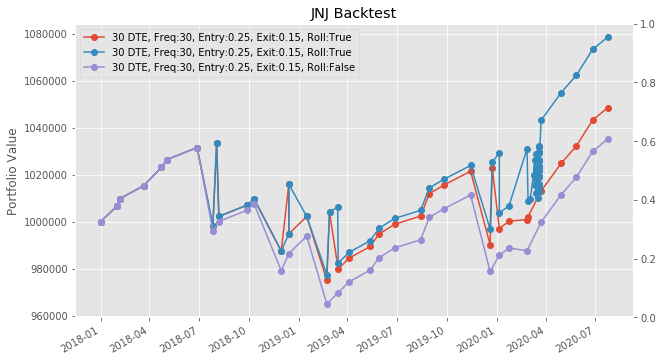

In [ ]:
plot_returns([jnj_hybrid,jnj_v1,jnj_no_roll],bar_graph=False,figsize = (12,10))

Sharpe: 1.8324415467796948


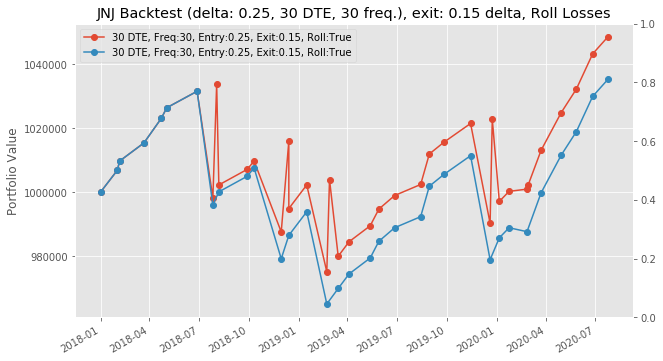

In [ ]:
plot_returns([jnj_hybrid],bar_graph=False,figsize = (12,10),graph_rolls = True)

In [ ]:
jnj_v2 = portfolio(dte_sell = 30, frequency= 15,roll_positions = True, roll_strategy = 'trade_pnl', roll_credit = 0.5,roll_strategy_exit = 0.1)
jnj_v2.run_backtest()

Date 2018-01-02, Expiry: 2018-02-02, Strike: 143.0, Underlying: 139.08, Premium: 0.91, Delta: 0.267409
Bought back call (expiry 2018-02-02T00:00:00.000000000, strike = 143.0) on 2018-02-01 for 0.02
PNL 2018-02-01 00:00:00 = 6853.0 (premium = 0.91, exit = 0.02)

Date 2018-01-16, Expiry: 2018-02-16, Strike: 150.0, Underlying: 147.17, Premium: 1.34, Delta: 0.340698
Bought back call (expiry 2018-02-16T00:00:00.000000000, strike = 150.0) on 2018-01-23 for 0.21
PNL 2018-01-23 00:00:00 = 8701.0 (premium = 1.34, exit = 0.21)

Date 2018-01-31, Expiry: 2018-03-02, Strike: 143.0, Underlying: 138.33, Premium: 0.82, Delta: 0.228925
Bought back call (expiry 2018-03-02T00:00:00.000000000, strike = 143.0) on 2018-02-05 for 0.45
PNL 2018-02-05 00:00:00 = 2848.9999999999995 (premium = 0.82, exit = 0.45)

Date 2018-02-15, Expiry: 2018-03-16, Strike: 135.0, Underlying: 131.13, Premium: 0.82, Delta: 0.238976
Bought back call (expiry 2018-03-16T00:00:00.000000000, strike = 135.0) on 2018-02-22 for 0.38
PNL 

Date 2019-01-11, Expiry: 2019-02-08, Strike: 135.0, Underlying: 129.39, Premium: 1.03, Delta: 0.24156
Bought back call (expiry 2019-02-08T00:00:00.000000000, strike = 135.0) on 2019-01-22 for 0.17
PNL 2019-01-22 00:00:00 = 6622.0 (premium = 1.03, exit = 0.17)

Date 2019-01-25, Expiry: 2019-02-22, Strike: 132.0, Underlying: 128.14, Premium: 0.85, Delta: 0.260287
Expired call (expiry 2019-02-22T00:00:00.000000000, strike = 132.0) on 2019-01-25
Strike was breached- At expiry, underlying is 136.60000610351562 , strike is 132.0
We lost money  PNL 2019-02-22 = -28875.046997070312 (premium = 0.85, exit = 4.600006103515625)

Rolling -3.750006103515625 loss from 2019-02-22. Selling Call on 2019-02-25 00:00:00, Expiry: 2019-03-29, Strike: 142.0, Premium = 0.55, Underlying: 136.65, Delta: 0.187905
Bought back call (expiry 2019-03-29 00:00:00, strike = 142.0) on 2019-02-27 for 0.33
premium = 0.55, exit = 0.33, trade pnl = 0.22000000000000003, total pnl = -3.5300061035156247
Achieved roll target wi

Strike was breached- At expiry, underlying is 144.27999877929688 , strike is 144.0
PNL 2020-01-03 00:00:00 = 4235.0093994140625 (premium = 0.83, exit = 0.279998779296875)

Date 2019-12-23, Expiry: 2020-01-24, Strike: 150.0, Underlying: 146.57, Premium: 1.22, Delta: 0.31450900000000004
Bought back call (expiry 2020-01-24T00:00:00.000000000, strike = 150.0) on 2020-01-06 for 0.33
PNL 2020-01-06 00:00:00 = 6852.999999999999 (premium = 1.22, exit = 0.33)

Date 2020-01-06, Expiry: 2020-02-07, Strike: 149.0, Underlying: 143.69, Premium: 0.94, Delta: 0.23890300000000006
Expired call (expiry 2020-02-07T00:00:00.000000000, strike = 149.0) on 2020-01-06
Strike was breached- At expiry, underlying is 151.88999938964844 , strike is 149.0
We lost money  PNL 2020-02-07 = -15014.995300292969 (premium = 0.94, exit = 2.8899993896484375)

Rolling -1.9499993896484376 loss from 2020-02-07. Selling Call on 2020-02-10 00:00:00, Expiry: 2020-03-13, Strike: 157.5, Premium = 0.65, Underlying: 151.62, Delta: 0.1

In [ ]:
jnj_v3 = portfolio(dte_sell = 14, frequency= 7,roll_positions = True, roll_strategy = 'trade_pnl', roll_credit = 0.5,roll_strategy_exit = 0)
jnj_v3.run_backtest()

Date 2018-01-02, Expiry: 2018-01-19, Strike: 142.0, Underlying: 139.08, Premium: 0.4, Delta: 0.21122800000000005
Expired call (expiry 2018-01-19T00:00:00.000000000, strike = 142.0) on 2018-01-02
Strike was breached- At expiry, underlying is 147.36000061035156 , strike is 142.0
We lost money  PNL 2018-01-19 = -38192.00469970703 (premium = 0.4, exit = 5.3600006103515625)

Rolling -4.960000610351562 loss from 2018-01-19. Selling Call on 2018-01-22 00:00:00, Expiry: 2018-02-02, Strike: 152.5, Premium = 0.5, Underlying: 148.14, Delta: 0.181072
Bought back call (expiry 2018-02-02 00:00:00, strike = 152.5) on 2018-01-23 for 0.01
premium = 0.5, exit = 0.01, trade pnl = 0.49, total pnl = -4.470000610351562
Achieved roll target with a trade PNL of 0.49. Initial loss : -4.960000610351562, total pnl : -4.470000610351562
PNL 2018-01-23 00:00:00 = 3773.0 (premium = 0.5, exit = 0.01)

Date 2018-01-08, Expiry: 2018-01-19, Strike: 144.0, Underlying: 141.76, Premium: 0.38, Delta: 0.229923
Expired call (

Date 2018-07-02, Expiry: 2018-07-13, Strike: 124.0, Underlying: 121.36, Premium: 0.42, Delta: 0.225971
Expired call (expiry 2018-07-13T00:00:00.000000000, strike = 124.0) on 2018-07-02
Strike was breached- At expiry, underlying is 125.93000030517578 , strike is 124.0
We lost money  PNL 2018-07-13 = -11627.002349853516 (premium = 0.42, exit = 1.9300003051757812)

Rolling -1.5100003051757813 loss from 2018-07-13. Selling Call on 2018-07-16 00:00:00, Expiry: 2018-07-27, Strike: 128.0, Premium = 0.54, Underlying: 124.5, Delta: 0.221662
Expired call (expiry 2018-07-27 00:00:00, strike = 128.0) on 2018-07-16
Strike was breached- At expiry, underlying is 131.5500030517578 , strike is 128.0
premium = 0.54, exit = 3.5500030517578125, trade pnl = -3.0100030517578125, total pnl = -4.520003356933594
Made -3.0100030517578125. Rolling position to recover 0 trade loss
We lost money  PNL 2018-07-27 = -23177.023498535156 (premium = 0.54, exit = 3.5500030517578125)

Rolling -3.0100030517578125 loss from

Bought back call (expiry 2018-10-19T00:00:00.000000000, strike = 143.0) on 2018-10-11 for 0.21
PNL 2018-10-11 00:00:00 = 4389.000000000001 (premium = 0.78, exit = 0.21)

Date 2018-10-15, Expiry: 2018-10-26, Strike: 138.0, Underlying: 134.393, Premium: 0.94, Delta: 0.276362
Expired call (expiry 2018-10-26T00:00:00.000000000, strike = 138.0) on 2018-10-15
At expiry, underlying is 136.97000122070312 , strike is 138.0
PNL 2018-10-26 00:00:00 = 7238.0 (premium = 0.94, exit = 0)

Date 2018-10-22, Expiry: 2018-11-02, Strike: 142.0, Underlying: 138.75, Premium: 0.55, Delta: 0.231829
Bought back call (expiry 2018-11-02T00:00:00.000000000, strike = 142.0) on 2018-10-26 for 0.33
PNL 2018-10-26 00:00:00 = 1694.0000000000002 (premium = 0.55, exit = 0.33)

Date 2018-10-29, Expiry: 2018-11-09, Strike: 141.0, Underlying: 136.77, Premium: 0.9, Delta: 0.25608200000000003
Expired call (expiry 2018-11-09T00:00:00.000000000, strike = 141.0) on 2018-10-29
Strike was breached- At expiry, underlying is 145.33

Strike was breached- At expiry, underlying is 136.60000610351562 , strike is 134.0
We lost money  PNL 2019-02-22 = -16170.046997070312 (premium = 0.5, exit = 2.600006103515625)

Rolling -2.100006103515625 loss from 2019-02-22. Selling Call on 2019-02-25 00:00:00, Expiry: 2019-03-08, Strike: 139.0, Premium = 0.52, Underlying: 136.65, Delta: 0.259444
Bought back call (expiry 2019-03-08 00:00:00, strike = 139.0) on 2019-02-27 for 0.22
premium = 0.52, exit = 0.22, trade pnl = 0.30000000000000004, total pnl = -1.800006103515625
Achieved roll target with a trade PNL of 0.30000000000000004. Initial loss : -2.100006103515625, total pnl : -1.800006103515625
PNL 2019-02-27 00:00:00 = 2310.0000000000005 (premium = 0.52, exit = 0.22)

Date 2019-02-19, Expiry: 2019-03-08, Strike: 138.0, Underlying: 135.92, Premium: 0.68, Delta: 0.26779899999999995
Expired call (expiry 2019-03-08T00:00:00.000000000, strike = 138.0) on 2019-02-19
Strike was breached- At expiry, underlying is 138.05999755859375 , stri

Expired call (expiry 2019-08-02T00:00:00.000000000, strike = 131.0) on 2019-07-22
Strike was breached- At expiry, underlying is 131.07000732421875 , strike is 131.0
PNL 2019-08-02 00:00:00 = 4234.943603515625 (premium = 0.62, exit = 0.07000732421875)

Date 2019-07-29, Expiry: 2019-08-09, Strike: 136.0, Underlying: 133.12, Premium: 0.47, Delta: 0.227881
Bought back call (expiry 2019-08-09T00:00:00.000000000, strike = 136.0) on 2019-07-31 for 0.14
PNL 2019-07-31 00:00:00 = 2540.9999999999995 (premium = 0.47, exit = 0.14)

Date 2019-08-05, Expiry: 2019-08-16, Strike: 134.0, Underlying: 130.21, Premium: 0.74, Delta: 0.24694
Bought back call (expiry 2019-08-16T00:00:00.000000000, strike = 134.0) on 2019-08-14 for 0.13
PNL 2019-08-14 00:00:00 = 4697.0 (premium = 0.74, exit = 0.13)

Date 2019-08-12, Expiry: 2019-08-23, Strike: 136.0, Underlying: 132.21, Premium: 0.55, Delta: 0.215934
Bought back call (expiry 2019-08-23T00:00:00.000000000, strike = 136.0) on 2019-08-14 for 0.27
PNL 2019-08-14 

Strike was breached- At expiry, underlying is 146.05999755859375 , strike is 143.0
We lost money  PNL 2019-12-20 = -20250.981201171875 (premium = 0.43, exit = 3.05999755859375)

Rolling -2.62999755859375 loss from 2019-12-20. Selling Call on 2019-12-23 00:00:00, Expiry: 2020-01-03, Strike: 148.0, Premium = 0.57, Underlying: 146.57, Delta: 0.32108400000000004
Bought back call (expiry 2020-01-03 00:00:00, strike = 148.0) on 2019-12-30 for 0.07
premium = 0.57, exit = 0.07, trade pnl = 0.49999999999999994, total pnl = -2.12999755859375
Achieved roll target with a trade PNL of 0.49999999999999994. Initial loss : -2.62999755859375, total pnl : -2.12999755859375
PNL 2019-12-30 00:00:00 = 3849.9999999999995 (premium = 0.57, exit = 0.07)

Date 2019-12-16, Expiry: 2019-12-27, Strike: 144.0, Underlying: 141.92, Premium: 0.48, Delta: 0.263435
Expired call (expiry 2019-12-27T00:00:00.000000000, strike = 144.0) on 2019-12-16
Strike was breached- At expiry, underlying is 145.75 , strike is 144.0
We l

Strike was breached- At expiry, underlying is 154.86000061035156 , strike is 148.0
We lost money  PNL 2020-04-24 = -41888.00469970703 (premium = 1.42, exit = 6.8600006103515625)

Rolling -5.440000610351563 loss from 2020-04-24. Selling Call on 2020-04-27 00:00:00, Expiry: 2020-05-08, Strike: 162.5, Premium = 0.58, Underlying: 155.08, Delta: 0.15778499999999998
Bought back call (expiry 2020-05-08 00:00:00, strike = 162.5) on 2020-04-28 for 0.1
premium = 0.58, exit = 0.1, trade pnl = 0.48, total pnl = -4.960000610351562
Achieved roll target with a trade PNL of 0.48. Initial loss : -5.440000610351563, total pnl : -4.960000610351562
PNL 2020-04-28 00:00:00 = 3696.0 (premium = 0.58, exit = 0.1)

Date 2020-04-20, Expiry: 2020-05-01, Strike: 157.5, Underlying: 152.46, Premium: 1.18, Delta: 0.262771
Bought back call (expiry 2020-05-01T00:00:00.000000000, strike = 157.5) on 2020-04-28 for 0.15
PNL 2020-04-28 00:00:00 = 7931.0 (premium = 1.18, exit = 0.15)

Date 2020-04-27, Expiry: 2020-05-08, S

In [ ]:
jnj_v4 = portfolio(dte_sell = 14, frequency= 7)
jnj_v4.run_backtest()

Date 2018-01-02, Expiry: 2018-01-19, Strike: 142.0, Underlying: 139.08, Premium: 0.4, Delta: 0.21122800000000005
Expired call (expiry 2018-01-19T00:00:00.000000000, strike = 142.0) on 2018-01-02
Strike was breached- At expiry, underlying is 147.36000061035156 , strike is 142.0
We lost money  PNL 2018-01-19 = -38192.00469970703 (premium = 0.4, exit = 5.3600006103515625)

Date 2018-01-08, Expiry: 2018-01-19, Strike: 144.0, Underlying: 141.76, Premium: 0.38, Delta: 0.229923
Expired call (expiry 2018-01-19T00:00:00.000000000, strike = 144.0) on 2018-01-08
Strike was breached- At expiry, underlying is 147.36000061035156 , strike is 144.0
We lost money  PNL 2018-01-19 = -22946.00469970703 (premium = 0.38, exit = 3.3600006103515625)

Date 2018-01-16, Expiry: 2018-02-02, Strike: 152.5, Underlying: 147.17, Premium: 0.75, Delta: 0.213283
Bought back call (expiry 2018-02-02T00:00:00.000000000, strike = 152.5) on 2018-01-23 for 0.01
PNL 2018-01-23 00:00:00 = 5698.0 (premium = 0.75, exit = 0.01)

D

Strike was breached- At expiry, underlying is 131.5500030517578 , strike is 128.0
We lost money  PNL 2018-07-27 = -23177.023498535156 (premium = 0.54, exit = 3.5500030517578125)

Date 2018-07-23, Expiry: 2018-08-03, Strike: 129.0, Underlying: 126.56, Premium: 0.34, Delta: 0.210734
Expired call (expiry 2018-08-03T00:00:00.000000000, strike = 129.0) on 2018-07-23
Strike was breached- At expiry, underlying is 131.9499969482422 , strike is 129.0
We lost money  PNL 2018-08-03 = -20096.976501464844 (premium = 0.34, exit = 2.9499969482421875)

Date 2018-07-30, Expiry: 2018-08-10, Strike: 135.0, Underlying: 132.05, Premium: 0.41, Delta: 0.212704
Bought back call (expiry 2018-08-10T00:00:00.000000000, strike = 135.0) on 2018-08-03 for 0.09
PNL 2018-08-03 00:00:00 = 2463.9999999999995 (premium = 0.41, exit = 0.09)

Date 2018-08-06, Expiry: 2018-08-17, Strike: 134.0, Underlying: 132.085, Premium: 0.44, Delta: 0.263284
Bought back call (expiry 2018-08-17T00:00:00.000000000, strike = 134.0) on 2018

Strike was breached- At expiry, underlying is 132.39999389648438 , strike is 131.0
We lost money  PNL 2019-02-08 = -5928.9530029296875 (premium = 0.63, exit = 1.399993896484375)

Date 2019-02-04, Expiry: 2019-02-15, Strike: 135.0, Underlying: 132.58, Premium: 0.52, Delta: 0.255735
Bought back call (expiry 2019-02-15T00:00:00.000000000, strike = 135.0) on 2019-02-08 for 0.08
PNL 2019-02-08 00:00:00 = 3388.0 (premium = 0.52, exit = 0.08)

Date 2019-02-11, Expiry: 2019-02-22, Strike: 134.0, Underlying: 131.83, Premium: 0.5, Delta: 0.262695
Expired call (expiry 2019-02-22T00:00:00.000000000, strike = 134.0) on 2019-02-11
Strike was breached- At expiry, underlying is 136.60000610351562 , strike is 134.0
We lost money  PNL 2019-02-22 = -16170.046997070312 (premium = 0.5, exit = 2.600006103515625)

Date 2019-02-19, Expiry: 2019-03-08, Strike: 138.0, Underlying: 135.92, Premium: 0.68, Delta: 0.26779899999999995
Expired call (expiry 2019-03-08T00:00:00.000000000, strike = 138.0) on 2019-02-19
S

Date 2019-08-26, Expiry: 2019-09-06, Strike: 134.0, Underlying: 127.26, Premium: 1.2, Delta: 0.246155
Bought back call (expiry 2019-09-06T00:00:00.000000000, strike = 134.0) on 2019-08-28 for 0.1
PNL 2019-08-28 00:00:00 = 8469.999999999998 (premium = 1.2, exit = 0.1)

Date 2019-09-03, Expiry: 2019-09-20, Strike: 133.0, Underlying: 128.86, Premium: 0.62, Delta: 0.21978000000000006
Bought back call (expiry 2019-09-20T00:00:00.000000000, strike = 133.0) on 2019-09-06 for 0.25
PNL 2019-09-06 00:00:00 = 2849.0 (premium = 0.62, exit = 0.25)

Date 2019-09-09, Expiry: 2019-09-20, Strike: 130.0, Underlying: 126.79, Premium: 0.49, Delta: 0.22077800000000006
Expired call (expiry 2019-09-20T00:00:00.000000000, strike = 130.0) on 2019-09-09
Strike was breached- At expiry, underlying is 131.64999389648438 , strike is 130.0
We lost money  PNL 2019-09-20 = -8931.953002929688 (premium = 0.49, exit = 1.649993896484375)

Date 2019-09-16, Expiry: 2019-09-27, Strike: 132.0, Underlying: 129.44, Premium: 0.5

Bought back call (expiry 2020-03-27T00:00:00.000000000, strike = 140.0) on 2020-03-20 for 0.08
PNL 2020-03-20 00:00:00 = 13090.0 (premium = 1.78, exit = 0.08)

Date 2020-03-23, Expiry: 2020-04-03, Strike: 120.0, Underlying: 110.03, Premium: 1.74, Delta: 0.243374
Expired call (expiry 2020-04-03T00:00:00.000000000, strike = 120.0) on 2020-03-23
Strike was breached- At expiry, underlying is 134.1699981689453 , strike is 120.0
We lost money  PNL 2020-04-03 = -95710.9859008789 (premium = 1.74, exit = 14.169998168945312)

Date 2020-03-30, Expiry: 2020-04-09, Strike: 141.0, Underlying: 132.81, Premium: 1.54, Delta: 0.245646
Bought back call (expiry 2020-04-09T00:00:00.000000000, strike = 141.0) on 2020-04-01 for 0.44
PNL 2020-04-01 00:00:00 = 8470.0 (premium = 1.54, exit = 0.44)

Date 2020-04-06, Expiry: 2020-04-17, Strike: 145.0, Underlying: 138.9, Premium: 0.85, Delta: 0.210378
Expired call (expiry 2020-04-17T00:00:00.000000000, strike = 145.0) on 2020-04-06
Strike was breached- At expiry, 

Sharpe: 1.8517647246680673
Sharpe: 0.0870393516087974
Sharpe: -1.017166254116454
Sharpe: -1.236790681108706
Sharpe: 1.2756312383893385


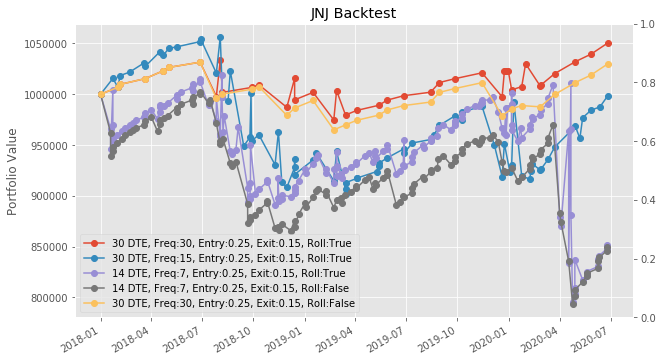

In [ ]:
plot_returns([jnj_v1,jnj_v2,jnj_v3,jnj_v4,jnj_no_roll],bar_graph=False,figsize = (12,10))

Sharpe: 1.8517647246680673
Sharpe: 1.2756312383893385
Sharpe: -1.017166254116454
Sharpe: -1.236790681108706


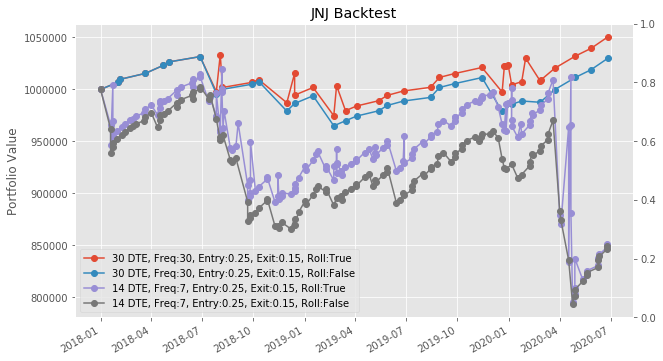

In [ ]:
plot_returns([jnj_v1,jnj_no_roll,jnj_v3,jnj_v4],bar_graph=False,figsize = (12,10))

In [ ]:
jnj_portfolio = portfolio(ticker = 'JNJ',start_date = datetime(2018,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 30, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 30,roll_positions = True, roll_strategy = 'trade_pnl', roll_credit = 0.4,roll_strategy_exit = 0.2)
jnj_portfolio.run_backtest()
jnj_v2 = portfolio(ticker = 'JNJ',start_date = datetime(2018,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 30, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 30,roll_positions = True, roll_strategy = 'trade_pnl', roll_credit = 0.5,roll_strategy_exit = 0)
jnj_v2.run_backtest()
jnj_no_roll = portfolio(ticker = 'JNJ',start_date = datetime(2018,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 30, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 30,roll_positions = False)
jnj_no_roll.run_backtest()
jnj_v4 = portfolio(ticker = 'JNJ',start_date = datetime(2018,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 14, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 7,roll_positions = False)
jnj_v4.run_backtest()

Sharpe: 2.363672900358629
Sharpe: 2.4370967434504753
Sharpe: -0.484348303362699
Sharpe: -1.236790681108706
Sharpe: 1.2756312383893385


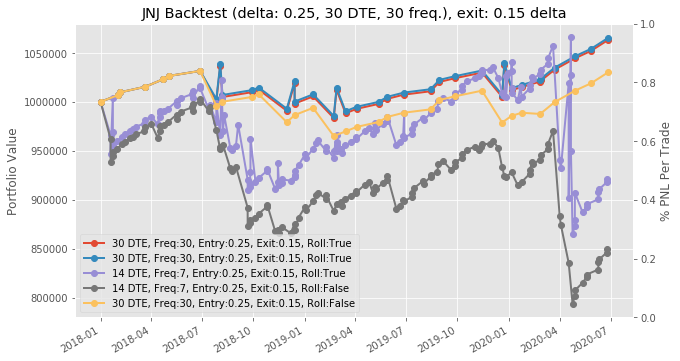

In [ ]:
plot_returns([jnj_portfolio,jnj_v2,jnj_v3,jnj_v4,jnj_no_roll],bar_graph=False)

Date 2018-01-02, Expiry: 2018-01-19, Strike: 142.0, Underlying: 139.08, Premium: 0.4, Delta: 0.21122800000000005
Expired call (expiry 2018-01-19T00:00:00.000000000, strike = 142.0) on 2018-01-02
Strike was breached- At expiry, underlying is 147.36000061035156 , strike is 142.0
We lost money  PNL 2018-01-19 = -38192.00469970703 (premium = 0.4, exit = 5.3600006103515625)

Rolling -4.960000610351562 loss from 2018-01-19. Selling Call on 2018-01-22 00:00:00, Expiry: 2018-02-02, Strike: 152.5, Premium = 0.5, Underlying: 148.14, Delta: 0.181072
Bought back call (expiry 2018-02-02 00:00:00, strike = 152.5) on 2018-01-23 for 0.01
premium = 0.5, exit = -0.01, trade pnl = 0.51, total pnl = -4.450000610351562
Achieved roll target with a trade PNL of 0.51. Initial loss : -4.960000610351562, total pnl : -4.450000610351562
PNL 2018-01-23 00:00:00 = 3927.0 (premium = 0.5, exit = -0.01)

Date 2018-01-08, Expiry: 2018-01-19, Strike: 144.0, Underlying: 141.76, Premium: 0.38, Delta: 0.229923
Expired call

Date 2018-07-02, Expiry: 2018-07-13, Strike: 124.0, Underlying: 121.36, Premium: 0.42, Delta: 0.225971
Expired call (expiry 2018-07-13T00:00:00.000000000, strike = 124.0) on 2018-07-02
Strike was breached- At expiry, underlying is 125.93000030517578 , strike is 124.0
We lost money  PNL 2018-07-13 = -11627.002349853516 (premium = 0.42, exit = 1.9300003051757812)

Rolling -1.5100003051757813 loss from 2018-07-13. Selling Call on 2018-07-16 00:00:00, Expiry: 2018-07-27, Strike: 128.0, Premium = 0.54, Underlying: 124.5, Delta: 0.221662
Expired call (expiry 2018-07-27 00:00:00, strike = 128.0) on 2018-07-16
Strike was breached- At expiry, underlying is 131.5500030517578 , strike is 128.0
premium = 0.54, exit = 3.5500030517578125, trade pnl = -3.0100030517578125, total pnl = -4.520003356933594
Made -3.0100030517578125. Rolling position to recover 0.5
We lost money  PNL 2018-07-27 = -23177.023498535156 (premium = 0.54, exit = 3.5500030517578125)

Rolling -3.0100030517578125 loss from 2018-07-

Expired call (expiry 2018-10-26T00:00:00.000000000, strike = 138.0) on 2018-10-15
At expiry, underlying is 136.97000122070312 , strike is 138.0
PNL 2018-10-26 00:00:00 = 7238.0 (premium = 0.94, exit = 0)

Date 2018-10-22, Expiry: 2018-11-02, Strike: 142.0, Underlying: 138.75, Premium: 0.55, Delta: 0.231829
Bought back call (expiry 2018-11-02T00:00:00.000000000, strike = 142.0) on 2018-10-26 for 0.33
PNL 2018-10-26 00:00:00 = 1694.0000000000002 (premium = 0.55, exit = 0.33)

Date 2018-10-29, Expiry: 2018-11-09, Strike: 141.0, Underlying: 136.77, Premium: 0.9, Delta: 0.25608200000000003
Expired call (expiry 2018-11-09T00:00:00.000000000, strike = 141.0) on 2018-10-29
Strike was breached- At expiry, underlying is 145.33999633789062 , strike is 141.0
We lost money  PNL 2018-11-09 = -26487.971801757812 (premium = 0.9, exit = 4.339996337890625)

Rolling -3.439996337890625 loss from 2018-11-09. Selling Call on 2018-11-12 00:00:00, Expiry: 2018-11-23, Strike: 148.0, Premium = 0.58, Underlying:

Strike was breached- At expiry, underlying is 136.60000610351562 , strike is 134.0
We lost money  PNL 2019-02-22 = -16170.046997070312 (premium = 0.5, exit = 2.600006103515625)

Rolling -2.100006103515625 loss from 2019-02-22. Selling Call on 2019-02-25 00:00:00, Expiry: 2019-03-08, Strike: 139.0, Premium = 0.52, Underlying: 136.65, Delta: 0.259444
Bought back call (expiry 2019-03-08 00:00:00, strike = 139.0) on 2019-02-27 for 0.22
premium = 0.52, exit = -0.22, trade pnl = 0.74, total pnl = -1.360006103515625
Achieved roll target with a trade PNL of 0.74. Initial loss : -2.100006103515625, total pnl : -1.360006103515625
PNL 2019-02-27 00:00:00 = 5698.0 (premium = 0.52, exit = -0.22)

Date 2019-02-19, Expiry: 2019-03-08, Strike: 138.0, Underlying: 135.92, Premium: 0.68, Delta: 0.26779899999999995
Expired call (expiry 2019-03-08T00:00:00.000000000, strike = 138.0) on 2019-02-19
Strike was breached- At expiry, underlying is 138.05999755859375 , strike is 138.0
PNL 2019-03-08 00:00:00 = 47

Strike was breached- At expiry, underlying is 131.07000732421875 , strike is 131.0
PNL 2019-08-02 00:00:00 = 4234.943603515625 (premium = 0.62, exit = 0.07000732421875)

Date 2019-07-29, Expiry: 2019-08-09, Strike: 136.0, Underlying: 133.12, Premium: 0.47, Delta: 0.227881
Bought back call (expiry 2019-08-09T00:00:00.000000000, strike = 136.0) on 2019-07-31 for 0.14
PNL 2019-07-31 00:00:00 = 2540.9999999999995 (premium = 0.47, exit = 0.14)

Date 2019-08-05, Expiry: 2019-08-16, Strike: 134.0, Underlying: 130.21, Premium: 0.74, Delta: 0.24694
Bought back call (expiry 2019-08-16T00:00:00.000000000, strike = 134.0) on 2019-08-14 for 0.13
PNL 2019-08-14 00:00:00 = 4697.0 (premium = 0.74, exit = 0.13)

Date 2019-08-12, Expiry: 2019-08-23, Strike: 136.0, Underlying: 132.21, Premium: 0.55, Delta: 0.215934
Bought back call (expiry 2019-08-23T00:00:00.000000000, strike = 136.0) on 2019-08-14 for 0.27
PNL 2019-08-14 00:00:00 = 2156.0 (premium = 0.55, exit = 0.27)

Date 2019-08-19, Expiry: 2019-08-

Date 2019-12-09, Expiry: 2019-12-20, Strike: 143.0, Underlying: 140.42, Premium: 0.43, Delta: 0.229192
Expired call (expiry 2019-12-20T00:00:00.000000000, strike = 143.0) on 2019-12-09
Strike was breached- At expiry, underlying is 146.05999755859375 , strike is 143.0
We lost money  PNL 2019-12-20 = -20250.981201171875 (premium = 0.43, exit = 3.05999755859375)

Rolling -2.62999755859375 loss from 2019-12-20. Selling Call on 2019-12-23 00:00:00, Expiry: 2020-01-03, Strike: 148.0, Premium = 0.57, Underlying: 146.57, Delta: 0.32108400000000004
Bought back call (expiry 2020-01-03 00:00:00, strike = 148.0) on 2019-12-30 for 0.07
premium = 0.57, exit = -0.07, trade pnl = 0.6399999999999999, total pnl = -1.98999755859375
Achieved roll target with a trade PNL of 0.6399999999999999. Initial loss : -2.62999755859375, total pnl : -1.98999755859375
PNL 2019-12-30 00:00:00 = 4927.999999999999 (premium = 0.57, exit = -0.07)

Date 2019-12-16, Expiry: 2019-12-27, Strike: 144.0, Underlying: 141.92, Prem

Strike was breached- At expiry, underlying is 152.02000427246094 , strike is 145.0
We lost money  PNL 2020-04-17 = -47509.03289794922 (premium = 0.85, exit = 7.0200042724609375)

Rolling -6.170004272460938 loss from 2020-04-17. Selling Call on 2020-04-20 00:00:00, Expiry: 2020-05-01, Strike: 160.0, Premium = 0.72, Underlying: 152.46, Delta: 0.175301
Bought back call (expiry 2020-05-01 00:00:00, strike = 160.0) on 2020-04-21 for 0.44
premium = 0.72, exit = -0.44, trade pnl = 1.16, total pnl = -5.010004272460938
Achieved roll target with a trade PNL of 1.16. Initial loss : -6.170004272460938, total pnl : -5.010004272460938
PNL 2020-04-21 00:00:00 = 8932.0 (premium = 0.72, exit = -0.44)

Date 2020-04-13, Expiry: 2020-04-24, Strike: 148.0, Underlying: 140.63, Premium: 1.42, Delta: 0.245852
Expired call (expiry 2020-04-24T00:00:00.000000000, strike = 148.0) on 2020-04-13
Strike was breached- At expiry, underlying is 154.86000061035156 , strike is 148.0
We lost money  PNL 2020-04-24 = -41888

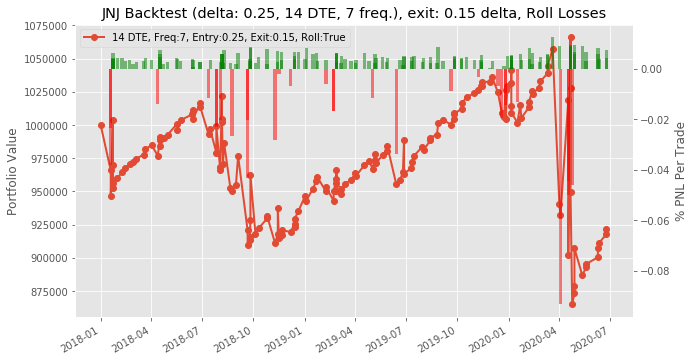

In [ ]:
jnj_v3 = portfolio(ticker = 'JNJ',start_date = datetime(2018,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 14, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 7,roll_positions = True, roll_strategy = 'trade_pnl', roll_credit = 0.5,roll_strategy_exit = 0)
jnj_v3.run_backtest()
plot_returns([jnj_v3],bar_graph=False)

Date 2018-01-02, Expiry: 2018-02-02, Strike: 143.0, Underlying: 139.08, Premium: 0.91, Delta: 0.267409
Bought back call (expiry 2018-02-02T00:00:00.000000000, strike = 143.0) on 2018-02-01 for 0.02
PNL 2018-01-02 = 1006853.0 (premium = 0.91, exit = 0.02)

Date 2018-01-31, Expiry: 2018-03-02, Strike: 143.0, Underlying: 138.33, Premium: 0.82, Delta: 0.228925
Bought back call (expiry 2018-03-02T00:00:00.000000000, strike = 143.0) on 2018-02-05 for 0.45
PNL 2018-01-31 = 9702.0 (premium = 0.82, exit = 0.45)

Date 2018-03-02, Expiry: 2018-03-29, Strike: 134.0, Underlying: 129.07, Premium: 0.8, Delta: 0.22968400000000005
Bought back call (expiry 2018-03-29T00:00:00.000000000, strike = 134.0) on 2018-03-22 for 0.06
PNL 2018-03-02 = 8547.0 (premium = 0.8, exit = 0.06)

Date 2018-04-02, Expiry: 2018-05-04, Strike: 131.0, Underlying: 124.57, Premium: 1.27, Delta: 0.252698
Bought back call (expiry 2018-05-04T00:00:00.000000000, strike = 131.0) on 2018-04-23 for 0.27
PNL 2018-04-02 = 13398.0 (premi

Bought back call (expiry 2019-10-25T00:00:00.000000000, strike = 137.0) on 2019-09-26 for 0.39
PNL 2019-09-23 = 13244.0 (premium = 0.87, exit = 0.39)

Date 2019-10-23, Expiry: 2019-11-22, Strike: 134.0, Underlying: 129.74, Premium: 0.94, Delta: 0.260923
Bought back call (expiry 2019-11-22T00:00:00.000000000, strike = 134.0) on 2019-11-14 for 0.18
PNL 2019-10-23 = 9548.0 (premium = 0.94, exit = 0.18)

Date 2019-11-22, Expiry: 2019-12-20, Strike: 141.0, Underlying: 138.21, Premium: 0.83, Delta: 0.263988
Expired call (expiry 2019-12-20T00:00:00.000000000, strike = 141.0) on 2019-11-22
Strike was breached- At expiry, underlying is 146.05999755859375 , strike is 141.0
We lost money  PNL 2019-11-22 = -26718.981201171875 (premium = 0.83, exit = 5.05999755859375)

Rolling -4.22999755859375 loss from 2019-11-22. Selling Call on 2019-11-25 00:00:00, Expiry: 2019-12-27, Strike: 142.0, Premium = 0.55, Underlying: 137.14, Delta: 0.19544
Expired call (expiry 2019-12-27 00:00:00, strike = 142.0) on 2

Strike was breached- At expiry, underlying is 146.89999389648438 , strike is 142.0
We lost money  PNL 2018-10-29 = -25794.953002929688 (premium = 1.21, exit = 4.899993896484375)

Rolling -3.689993896484375 loss from 2018-10-29. Selling Call on 2018-10-30 00:00:00, Expiry: 2018-11-30, Strike: 148.0, Premium = 0.54, Underlying: 140.34, Delta: 0.148627
Bought back call (expiry 2018-11-30 00:00:00, strike = 148.0) on 2018-10-31 for 0.4
premium = 0.54, exit = -0.4, trade pnl = 0.9400000000000001, total pnl = -2.749993896484375
Achieved roll target with a trade PNL of 0.9400000000000001. Initial loss : -3.689993896484375, total pnl : -2.749993896484375
PNL 2018-10-30 = 31030.953002929688 (premium = 0.9400000000000001, exit = -2.749993896484375)

Date 2018-11-27, Expiry: 2018-12-28, Strike: 147.0, Underlying: 142.85, Premium: 1.03, Delta: 0.27587399999999995
Bought back call (expiry 2018-12-28T00:00:00.000000000, strike = 147.0) on 2018-12-14 for 0.08
PNL 2018-11-27 = -21097.953002929688 (pre

Date 2018-01-02, Expiry: 2018-02-02, Strike: 143.0, Underlying: 139.08, Premium: 0.91, Delta: 0.267409
Bought back call (expiry 2018-02-02T00:00:00.000000000, strike = 143.0) on 2018-02-01 for 0.02
PNL 2018-01-02 = 1006853.0 (premium = 0.91, exit = 0.02)

Date 2018-01-31, Expiry: 2018-03-02, Strike: 143.0, Underlying: 138.33, Premium: 0.82, Delta: 0.228925
Bought back call (expiry 2018-03-02T00:00:00.000000000, strike = 143.0) on 2018-02-05 for 0.45
PNL 2018-01-31 = 9702.0 (premium = 0.82, exit = 0.45)

Date 2018-03-02, Expiry: 2018-03-29, Strike: 134.0, Underlying: 129.07, Premium: 0.8, Delta: 0.22968400000000005
Bought back call (expiry 2018-03-29T00:00:00.000000000, strike = 134.0) on 2018-03-22 for 0.06
PNL 2018-03-02 = 8547.0 (premium = 0.8, exit = 0.06)

Date 2018-04-02, Expiry: 2018-05-04, Strike: 131.0, Underlying: 124.57, Premium: 1.27, Delta: 0.252698
Bought back call (expiry 2018-05-04T00:00:00.000000000, strike = 131.0) on 2018-04-23 for 0.27
PNL 2018-04-02 = 13398.0 (premi

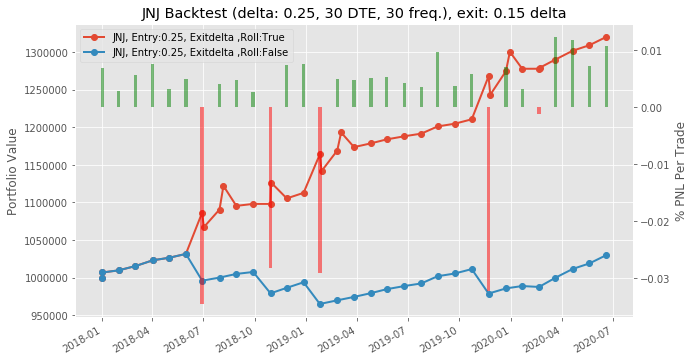

Sharpe: 1.2756312383893385


In [ ]:
jnj_portfolio = portfolio(ticker = 'JNJ',start_date = datetime(2018,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 30, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 30,roll_positions = True, roll_strategy = 'trade_pnl', roll_credit = 0.4,roll_strategy_exit = 0.2)
jnj_portfolio.run_backtest()
jnj_v2 = portfolio(ticker = 'JNJ',start_date = datetime(2018,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 30, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 30,roll_positions = True, roll_strategy = 'trade_pnl', roll_credit = 0.5,roll_strategy_exit = 0)
jnj_v2.run_backtest()
jnj_no_roll = portfolio(ticker = 'JNJ',start_date = datetime(2018,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 30, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 30,roll_positions = False)
jnj_no_roll.run_backtest()
jnj_v3 = portfolio(ticker = 'JNJ',start_date = datetime(2018,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 14, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 7,roll_positions = True, roll_strategy = 'trade_pnl', roll_credit = 0.5,roll_strategy_exit = 0)
jnj_v3.run_backtest()
jnj_v4 = portfolio(ticker = 'JNJ',start_date = datetime(2018,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 14, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 7,roll_positions = False)
jnj_v4.run_backtest()
plot_returns([jnj_portfolio,jnj_v2,jnj_no_roll])

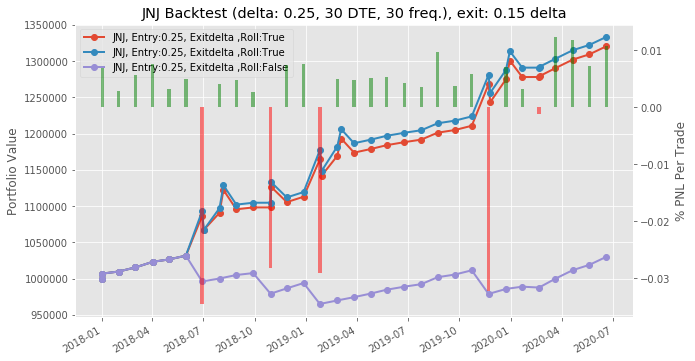

Sharpe: 1.2756312383893385


In [ ]:
plot_returns([jnj_portfolio,jnj_v2,jnj_no_roll])

Sharpe: 6.616089064428073
Sharpe: 1.2756312383893385
Sharpe: 4.846753139253481
Sharpe: -1.236790681108706


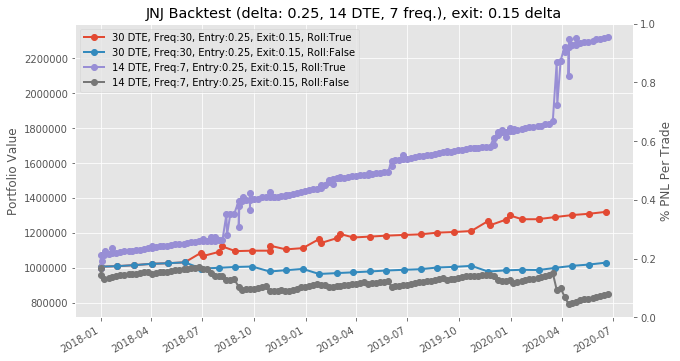

In [ ]:
plot_returns([jnj_portfolio,jnj_no_roll,jnj_v3,jnj_v4],bar_graph = False)

Date 2018-01-02, Expiry: 2018-01-19, Strike: 142.0, Underlying: 139.08, Premium: 0.4, Delta: 0.21122800000000005
Expired call (expiry 2018-01-19T00:00:00.000000000, strike = 142.0) on 2018-01-02
Strike was breached- At expiry, underlying is 147.36000061035156 , strike is 142.0
We lost money  PNL 2018-01-02 = 961807.995300293 (premium = 0.4, exit = 5.3600006103515625)

Rolling -4.960000610351562 loss from 2018-01-02. Selling Call on 2018-01-03 00:00:00, Expiry: 2018-01-19, Strike: 143.0, Premium = 0.48, Underlying: 140.66, Delta: 0.252119
Expired call (expiry 2018-01-19 00:00:00, strike = 143.0) on 2018-01-03
Strike was breached- At expiry, underlying is 147.36000061035156 , strike is 143.0
premium = 0.48, exit = 4.3600006103515625, trade pnl = -3.8800006103515625, total pnl = -8.840001220703124
Made -3.8800006103515625. Rolling position to recover 0.4
PNL 2018-01-03 = 1038192.004699707 (premium = -3.8800006103515625, exit = -8.840001220703124)

Rolling -8.840001220703124 loss from 2018

Strike was breached- At expiry, underlying is 125.93000030517578 , strike is 124.0
We lost money  PNL 2018-07-02 = -9163.002349853516 (premium = 0.42, exit = 1.9300003051757812)

Rolling -1.5100003051757813 loss from 2018-07-02. Selling Call on 2018-07-03 00:00:00, Expiry: 2018-07-20, Strike: 128.0, Premium = 0.44, Underlying: 122.71, Delta: 0.168517
Bought back call (expiry 2018-07-20 00:00:00, strike = 128.0) on 2018-07-19 for 0.02
premium = 0.44, exit = -0.02, trade pnl = 0.46, total pnl = -1.0500003051757814
Achieved roll target with a trade PNL of 0.46. Initial loss : -1.5100003051757813, total pnl : -1.0500003051757814
PNL 2018-07-03 = 14091.002349853516 (premium = 0.46, exit = -1.0500003051757814)

Date 2018-07-09, Expiry: 2018-07-20, Strike: 129.0, Underlying: 126.1, Premium: 0.65, Delta: 0.260754
Bought back call (expiry 2018-07-20T00:00:00.000000000, strike = 129.0) on 2018-07-16 for 0.19
PNL 2018-07-09 = -8085.002349853516 (premium = 0.65, exit = 0.19)

Date 2018-07-16, Expi

Bought back call (expiry 2018-10-19T00:00:00.000000000, strike = 143.0) on 2018-10-11 for 0.21
PNL 2018-10-08 = 6545.000000000001 (premium = 0.78, exit = 0.21)

Date 2018-10-15, Expiry: 2018-10-26, Strike: 138.0, Underlying: 134.393, Premium: 0.94, Delta: 0.276362
Expired call (expiry 2018-10-26T00:00:00.000000000, strike = 138.0) on 2018-10-15
At expiry, underlying is 136.97000122070312 , strike is 138.0
PNL 2018-10-15 = 11627.0 (premium = 0.94, exit = 0)

Date 2018-10-22, Expiry: 2018-11-02, Strike: 142.0, Underlying: 138.75, Premium: 0.55, Delta: 0.231829
Bought back call (expiry 2018-11-02T00:00:00.000000000, strike = 142.0) on 2018-10-26 for 0.33
PNL 2018-10-22 = 8932.0 (premium = 0.55, exit = 0.33)

Date 2018-10-29, Expiry: 2018-11-09, Strike: 141.0, Underlying: 136.77, Premium: 0.9, Delta: 0.25608200000000003
Expired call (expiry 2018-11-09T00:00:00.000000000, strike = 141.0) on 2018-10-29
Strike was breached- At expiry, underlying is 145.33999633789062 , strike is 141.0
We lost

Strike was breached- At expiry, underlying is 138.05999755859375 , strike is 138.0
PNL 2019-02-19 = -11396.028198242188 (premium = 0.68, exit = 0.05999755859375)

Date 2019-02-25, Expiry: 2019-03-08, Strike: 139.0, Underlying: 136.65, Premium: 0.52, Delta: 0.259444
Bought back call (expiry 2019-03-08T00:00:00.000000000, strike = 139.0) on 2019-02-27 for 0.22
PNL 2019-02-25 = 7084.018798828125 (premium = 0.52, exit = 0.22)

Date 2019-03-04, Expiry: 2019-03-15, Strike: 141.0, Underlying: 138.49, Premium: 0.45, Delta: 0.235454
Bought back call (expiry 2019-03-15T00:00:00.000000000, strike = 141.0) on 2019-03-07 for 0.18
PNL 2019-03-04 = 4389.0 (premium = 0.45, exit = 0.18)

Date 2019-03-11, Expiry: 2019-03-22, Strike: 141.0, Underlying: 138.54, Premium: 0.62, Delta: 0.272873
Bought back call (expiry 2019-03-22T00:00:00.000000000, strike = 141.0) on 2019-03-14 for 0.16
PNL 2019-03-11 = 5621.0 (premium = 0.62, exit = 0.16)

Date 2019-03-18, Expiry: 2019-03-29, Strike: 139.0, Underlying: 137

Bought back call (expiry 2019-09-06T00:00:00.000000000, strike = 134.0) on 2019-08-28 for 0.1
PNL 2019-08-26 = 10625.999999999998 (premium = 1.2, exit = 0.1)

Date 2019-09-03, Expiry: 2019-09-20, Strike: 133.0, Underlying: 128.86, Premium: 0.62, Delta: 0.21978000000000006
Bought back call (expiry 2019-09-20T00:00:00.000000000, strike = 133.0) on 2019-09-06 for 0.25
PNL 2019-09-03 = 11318.999999999998 (premium = 0.62, exit = 0.25)

Date 2019-09-09, Expiry: 2019-09-20, Strike: 130.0, Underlying: 126.79, Premium: 0.49, Delta: 0.22077800000000006
Expired call (expiry 2019-09-20T00:00:00.000000000, strike = 130.0) on 2019-09-09
Strike was breached- At expiry, underlying is 131.64999389648438 , strike is 130.0
We lost money  PNL 2019-09-09 = -6082.9530029296875 (premium = 0.49, exit = 1.649993896484375)

Rolling -1.159993896484375 loss from 2019-09-09. Selling Call on 2019-09-10 00:00:00, Expiry: 2019-09-27, Strike: 133.0, Premium = 0.56, Underlying: 129.14, Delta: 0.21633
Bought back call (

Strike was breached- At expiry, underlying is 149.1699981689453 , strike is 147.0
We lost money  PNL 2020-01-06 = -9624.985900878906 (premium = 0.45, exit = 2.1699981689453125)

Rolling -1.7199981689453125 loss from 2020-01-06. Selling Call on 2020-01-07 00:00:00, Expiry: 2020-01-24, Strike: 150.0, Premium = 0.4, Underlying: 144.6, Delta: 0.154369
Bought back call (expiry 2020-01-24 00:00:00, strike = 150.0) on 2020-01-10 for 0.34
premium = 0.4, exit = -0.34, trade pnl = 0.74, total pnl = -0.9799981689453126
Achieved roll target with a trade PNL of 0.74. Initial loss : -1.7199981689453125, total pnl : -0.9799981689453126
PNL 2020-01-07 = 16862.985900878906 (premium = 0.74, exit = -0.9799981689453126)

Date 2020-01-13, Expiry: 2020-01-24, Strike: 148.0, Underlying: 145.36, Premium: 0.77, Delta: 0.286086
Expired call (expiry 2020-01-24T00:00:00.000000000, strike = 148.0) on 2020-01-13
Strike was breached- At expiry, underlying is 148.32000732421875 , strike is 148.0
PNL 2020-01-13 = -977

Date 2020-05-18, Expiry: 2020-05-29, Strike: 155.0, Underlying: 151.27, Premium: 0.67, Delta: 0.215794
Bought back call (expiry 2020-05-29T00:00:00.000000000, strike = 155.0) on 2020-05-19 for 0.34
PNL 2020-05-18 = 8316.0 (premium = 0.67, exit = 0.34)

Date 2020-05-26, Expiry: 2020-06-12, Strike: 150.0, Underlying: 145.21, Premium: 0.86, Delta: 0.234585
Bought back call (expiry 2020-06-12T00:00:00.000000000, strike = 150.0) on 2020-06-09 for 0.19
PNL 2020-05-26 = 7699.999999999999 (premium = 0.86, exit = 0.19)

Date 2020-06-01, Expiry: 2020-06-12, Strike: 150.0, Underlying: 147.18, Premium: 1.13, Delta: 0.314202
Bought back call (expiry 2020-06-12T00:00:00.000000000, strike = 150.0) on 2020-06-09 for 0.19
PNL 2020-06-01 = 12397.0 (premium = 1.13, exit = 0.19)

Date 2020-06-08, Expiry: 2020-06-19, Strike: 150.0, Underlying: 146.6, Premium: 0.93, Delta: 0.278355
Bought back call (expiry 2020-06-19T00:00:00.000000000, strike = 150.0) on 2020-06-11 for 0.49
PNL 2020-06-08 = 10626.0 (premiu

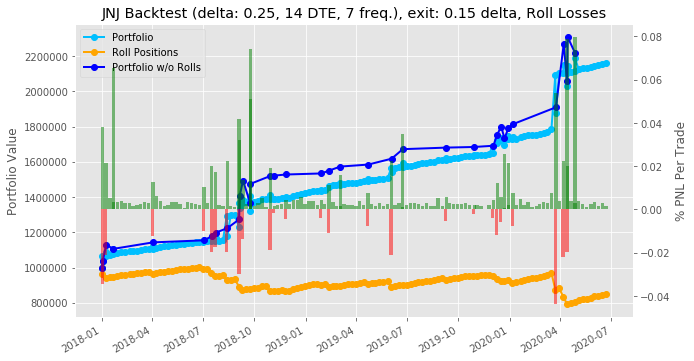

Sharpe: 4.6410405746844114


In [ ]:
jnj_portfolio = portfolio(ticker = 'JNJ',start_date = datetime(2018,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 14, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 7,roll_positions = True, roll_strategy = 'trade_pnl', roll_credit = 0.4,roll_strategy_exit = 0.2)
jnj_portfolio.run_backtest()
plot_returns(jnj_portfolio)

Date 2018-12-31, Expiry: 2019-02-01, Strike: 136.0, Underlying: 128.94, Premium: 1.26, Delta: 0.244872
Bought back call (expiry 2019-02-01T00:00:00.000000000, strike = 136.0) on 2019-01-03 for 0.6
PNL 2018-12-31 = 1005082.0 (premium = 1.26, exit = 0.6)

Date 2019-01-31, Expiry: 2019-03-01, Strike: 139.0, Underlying: 134.93, Premium: 0.72, Delta: 0.225245
Bought back call (expiry 2019-03-01T00:00:00.000000000, strike = 139.0) on 2019-02-04 for 0.19
PNL 2019-01-31 = 9163.0 (premium = 0.72, exit = 0.19)

Date 2019-03-01, Expiry: 2019-03-29, Strike: 142.0, Underlying: 138.57, Premium: 0.71, Delta: 0.252915
Bought back call (expiry 2019-03-29T00:00:00.000000000, strike = 142.0) on 2019-03-14 for 0.21
PNL 2019-03-01 = 7931.0 (premium = 0.71, exit = 0.21)

Date 2019-04-01, Expiry: 2019-05-03, Strike: 144.0, Underlying: 139.03, Premium: 0.76, Delta: 0.226744
Bought back call (expiry 2019-05-03T00:00:00.000000000, strike = 144.0) on 2019-04-03 for 0.43
PNL 2019-04-01 = 6391.0 (premium = 0.76, e

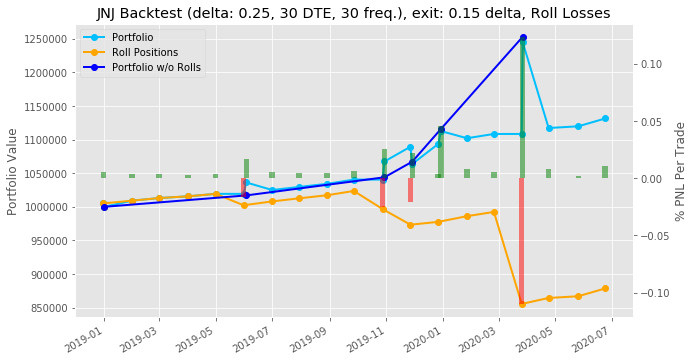

Sharpe: 2.4812760963063627


In [ ]:
jnj_portfolio = portfolio(ticker = 'JNJ',start_date = datetime(2019,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 30, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 30,roll_positions = True, roll_strategy = 'trade_pnl', roll_credit = 0.4,roll_strategy_exit = 0.2)
jnj_portfolio.run_backtest()
plot_returns(jnj_portfolio)

Date 2018-12-31, Expiry: 2019-02-01, Strike: 136.0, Underlying: 128.94, Premium: 1.26, Delta: 0.244872
Bought back call (expiry 2019-02-01T00:00:00.000000000, strike = 136.0) on 2019-01-03 for 0.6
PNL 2018-12-31 = 1005082.0 (premium = 1.26, exit = 0.6)

Date 2019-01-31, Expiry: 2019-03-01, Strike: 139.0, Underlying: 134.93, Premium: 0.72, Delta: 0.225245
Bought back call (expiry 2019-03-01T00:00:00.000000000, strike = 139.0) on 2019-02-04 for 0.19
PNL 2019-01-31 = 9163.0 (premium = 0.72, exit = 0.19)

Date 2019-03-01, Expiry: 2019-03-29, Strike: 142.0, Underlying: 138.57, Premium: 0.71, Delta: 0.252915
Bought back call (expiry 2019-03-29T00:00:00.000000000, strike = 142.0) on 2019-03-14 for 0.21
PNL 2019-03-01 = 7931.0 (premium = 0.71, exit = 0.21)

Date 2019-04-01, Expiry: 2019-05-03, Strike: 144.0, Underlying: 139.03, Premium: 0.76, Delta: 0.226744
Bought back call (expiry 2019-05-03T00:00:00.000000000, strike = 144.0) on 2019-04-03 for 0.43
PNL 2019-04-01 = 6391.0 (premium = 0.76, e

Strike was breached- At expiry, underlying is 145.75 , strike is 142.0
We lost money  PNL 2019-11-27 = -50204.04229736328 (premium = 0.73, exit = 3.75)

Rolling -3.02 loss from 2019-11-27. Selling Call on 2019-11-29 00:00:00, Expiry: 2019-12-27, Strike: 142.0, Premium = 0.43, Underlying: 137.6, Delta: 0.180866
Expired call (expiry 2019-12-27 00:00:00, strike = 142.0) on 2019-11-29
Strike was breached- At expiry, underlying is 145.75 , strike is 142.0
premium = 0.43, exit = 3.75, trade pnl = -3.32, total pnl = -6.34
Made -3.32. Rolling position to recover 0.4
PNL 2019-11-29 = -3696.0422973632812 (premium = -3.32, exit = -6.34)

Rolling -6.34 loss from 2019-12-27. Selling Call on 2019-12-30 00:00:00, Expiry: 2020-01-31, Strike: 152.5, Premium = 0.41, Underlying: 145.25, Delta: 0.135221
Bought back call (expiry 2020-01-31 00:00:00, strike = 152.5) on 2019-12-31 for 0.37
premium = 0.41, exit = 0.37, trade pnl = 0.03999999999999998, total pnl = -6.3
Made 0.03999999999999998. Rolling positio

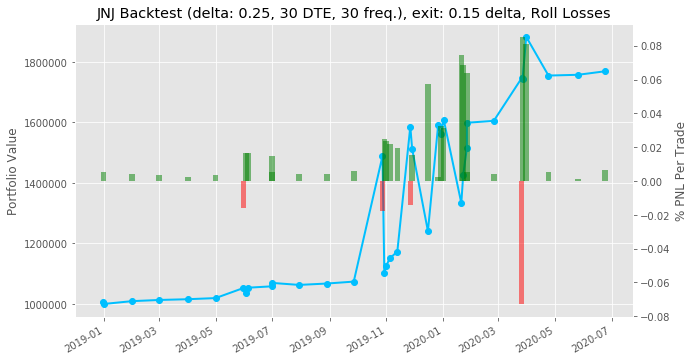

Sharpe: 8.620428912689267


In [ ]:
jnj_portfolio = portfolio(ticker = 'JNJ',start_date = datetime(2019,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 30, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 30,roll_positions = True, roll_strategy = 'trade_pnl', roll_credit = 0.4,roll_strategy_exit = 0.2)
jnj_portfolio.run_backtest()
plot_returns(jnj_portfolio)

Date 2018-01-02, Expiry: 2018-02-02, Strike: 143.0, Underlying: 139.08, Premium: 0.91, Delta: 0.267409
Bought back call (expiry 2018-02-02T00:00:00.000000000, strike = 143.0) on 2018-02-01 for 0.02
PNL 2018-01-02 = 1006853.0 (premium = 0.91, exit = 0.02)

Date 2018-01-31, Expiry: 2018-03-02, Strike: 143.0, Underlying: 138.33, Premium: 0.82, Delta: 0.228925
Bought back call (expiry 2018-03-02T00:00:00.000000000, strike = 143.0) on 2018-02-05 for 0.45
PNL 2018-01-31 = 1009702.0 (premium = 0.82, exit = 0.45)

Date 2018-03-02, Expiry: 2018-03-29, Strike: 134.0, Underlying: 129.07, Premium: 0.8, Delta: 0.22968400000000005
Bought back call (expiry 2018-03-29T00:00:00.000000000, strike = 134.0) on 2018-03-22 for 0.06
PNL 2018-03-02 = 1015400.0 (premium = 0.8, exit = 0.06)

Date 2018-04-02, Expiry: 2018-05-04, Strike: 131.0, Underlying: 124.57, Premium: 1.27, Delta: 0.252698
Bought back call (expiry 2018-05-04T00:00:00.000000000, strike = 131.0) on 2018-04-23 for 0.27
PNL 2018-04-02 = 1023100.

Strike was breached- At expiry, underlying is 136.60000610351562 , strike is 132.0
We lost money  PNL 2019-01-25 = 1355123.8684082031 (premium = 0.85, exit = 4.600006103515625)

Rolling -3.750006103515625 loss from 2019-01-25. Selling Call on 2019-01-28 00:00:00, Expiry: 2019-03-01, Strike: 135.0, Premium = 0.42, Underlying: 128.55, Delta: 0.1404
Expired call (expiry 2019-03-01 00:00:00, strike = 135.0) on 2019-01-28
Strike was breached- At expiry, underlying is 138.35000610351562 , strike is 135.0
premium = 0.42, exit = 3.350006103515625, trade pnl = -2.930006103515625, total pnl = -6.68001220703125
Made -2.930006103515625. Rolling position to recover 0.4
PNL 2019-01-28 = 1412873.9624023438 (premium = -2.930006103515625, exit = -6.68001220703125)

Rolling -6.68001220703125 loss from 2019-03-01. Selling Call on 2019-03-04 00:00:00, Expiry: 2019-04-05, Strike: 144.0, Premium = 0.47, Underlying: 138.49, Delta: 0.17133800000000002
Bought back call (expiry 2019-04-05 00:00:00, strike = 144

Date 2019-07-25, Expiry: 2019-08-23, Strike: 136.0, Underlying: 131.24, Premium: 0.72, Delta: 0.223629
Bought back call (expiry 2019-08-23T00:00:00.000000000, strike = 136.0) on 2019-08-14 for 0.27
PNL 2019-07-25 = 1995303.2313232422 (premium = 0.72, exit = 0.27)

Date 2019-08-23, Expiry: 2019-09-20, Strike: 134.0, Underlying: 127.85, Premium: 1.58, Delta: 0.26502600000000004
Bought back call (expiry 2019-09-20T00:00:00.000000000, strike = 134.0) on 2019-08-30 for 0.34
PNL 2019-08-23 = 2004851.2313232422 (premium = 1.58, exit = 0.34)

Date 2019-09-23, Expiry: 2019-10-25, Strike: 137.0, Underlying: 131.9, Premium: 0.87, Delta: 0.236801
Bought back call (expiry 2019-10-25T00:00:00.000000000, strike = 137.0) on 2019-09-26 for 0.39
PNL 2019-09-23 = 2008547.2313232422 (premium = 0.87, exit = 0.39)

Date 2019-10-23, Expiry: 2019-11-22, Strike: 134.0, Underlying: 129.74, Premium: 0.94, Delta: 0.260923
Bought back call (expiry 2019-11-22T00:00:00.000000000, strike = 134.0) on 2019-11-14 for 0.

Bought back call (expiry 2020-04-09 00:00:00, strike = 157.5) on 2020-03-16 for 0.58
premium = 0.42, exit = 0.58, trade pnl = -0.15999999999999998, total pnl = -0.18000000000000005
Made -0.15999999999999998. Rolling position to recover 0.4
PNL 2020-03-13 = 2163317.193725586 (premium = -0.15999999999999998, exit = -0.18000000000000005)

Rolling -0.18000000000000005 loss from 2020-03-16. Selling Call on 2020-03-17 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.47, Underlying: 135.17, Delta: 0.065076
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-18 for 0.6
premium = 0.47, exit = 0.6, trade pnl = -0.13, total pnl = -0.31000000000000005
Made -0.13. Rolling position to recover 0.4
PNL 2020-03-17 = 2164703.193725586 (premium = -0.13, exit = -0.31000000000000005)

Rolling -0.31000000000000005 loss from 2020-03-18. Selling Call on 2020-03-19 00:00:00, Expiry: 2020-04-17, Strike: 160.0, Premium = 0.4, Underlying: 128.08, Delta: 0.056378
Bought back call (expi

Bought back call (expiry 2020-04-09 00:00:00, strike = 157.5) on 2020-03-10 for 0.56
premium = 0.53, exit = 0.56, trade pnl = -0.030000000000000027, total pnl = -0.1499999999999999
Made -0.030000000000000027. Rolling position to recover 0.4
PNL 2020-03-09 = 2207053.193725586 (premium = -0.030000000000000027, exit = -0.1499999999999999)

Rolling -0.1499999999999999 loss from 2020-03-10. Selling Call on 2020-03-11 00:00:00, Expiry: 2020-04-09, Strike: 157.5, Premium = 0.58, Underlying: 132.62, Delta: 0.083351
Bought back call (expiry 2020-04-09 00:00:00, strike = 157.5) on 2020-03-12 for 0.37
premium = 0.58, exit = 0.37, trade pnl = 0.20999999999999996, total pnl = 0.06000000000000005
Made 0.20999999999999996. Rolling position to recover 0.4
PNL 2020-03-11 = 2208208.193725586 (premium = 0.20999999999999996, exit = 0.06000000000000005)

Rolling 0.06000000000000005 loss from 2020-03-12. Selling Call on 2020-03-13 00:00:00, Expiry: 2020-04-09, Strike: 157.5, Premium = 0.42, Underlying: 130.

Bought back call (expiry 2020-06-19 00:00:00, strike = 157.5) on 2020-05-21 for 0.46
premium = 0.58, exit = 0.46, trade pnl = 0.11999999999999994, total pnl = -14.610000610351564
Made 0.11999999999999994. Rolling position to recover 0.4
PNL 2020-05-20 = 3260875.236022949 (premium = 0.11999999999999994, exit = -14.610000610351564)

Rolling -14.610000610351564 loss from 2020-05-21. Selling Call on 2020-05-22 00:00:00, Expiry: 2020-06-19, Strike: 155.0, Premium = 0.51, Underlying: 144.36, Delta: 0.122138
Bought back call (expiry 2020-06-19 00:00:00, strike = 155.0) on 2020-05-26 for 0.4
premium = 0.51, exit = 0.4, trade pnl = 0.10999999999999999, total pnl = -14.500000610351565
Made 0.10999999999999999. Rolling position to recover 0.4
PNL 2020-05-22 = 3373372.2407226562 (premium = 0.10999999999999999, exit = -14.500000610351565)

Rolling -14.500000610351565 loss from 2020-05-26. Selling Call on 2020-05-27 00:00:00, Expiry: 2020-06-26, Strike: 155.0, Premium = 0.42, Underlying: 144.44, Del

Rolling -0.3800000000000003 loss from 2020-05-01. Selling Call on 2020-05-04 00:00:00, Expiry: 2020-06-05, Strike: 162.5, Premium = 0.41, Underlying: 149.04, Delta: 0.089564
Bought back call (expiry 2020-06-05 00:00:00, strike = 162.5) on 2020-05-05 for 0.35
premium = 0.41, exit = 0.35, trade pnl = 0.06, total pnl = -0.3200000000000003
Made 0.06. Rolling position to recover 0.4
PNL 2020-05-04 = 3664278.2501220703 (premium = 0.06, exit = -0.3200000000000003)

Rolling -0.3200000000000003 loss from 2020-05-05. Selling Call on 2020-05-06 00:00:00, Expiry: 2020-06-05, Strike: 160.0, Premium = 0.48, Underlying: 149.15, Delta: 0.112378
Bought back call (expiry 2020-06-05 00:00:00, strike = 160.0) on 2020-05-07 for 0.29
premium = 0.48, exit = 0.29, trade pnl = 0.19, total pnl = -0.13000000000000028
Made 0.19. Rolling position to recover 0.4
PNL 2020-05-06 = 3666742.2501220703 (premium = 0.19, exit = -0.13000000000000028)

Rolling -0.13000000000000028 loss from 2020-05-07. Selling Call on 2020-

Bought back call (expiry 2020-05-01 00:00:00, strike = 150.0) on 2020-04-06 for 0.51
premium = 0.63, exit = 0.51, trade pnl = 0.12, total pnl = -0.5600000000000002
Made 0.12. Rolling position to recover 0.4
PNL 2020-04-03 = 3685453.2501220703 (premium = 0.12, exit = -0.5600000000000002)

Rolling -0.5600000000000002 loss from 2020-04-06. Selling Call on 2020-04-07 00:00:00, Expiry: 2020-05-08, Strike: 155.0, Premium = 0.69, Underlying: 138.59, Delta: 0.11633
Bought back call (expiry 2020-05-08 00:00:00, strike = 155.0) on 2020-04-13 for 0.75
premium = 0.69, exit = 0.75, trade pnl = -0.06000000000000005, total pnl = -0.6200000000000002
Made -0.06000000000000005. Rolling position to recover 0.4
PNL 2020-04-07 = 3689765.2501220703 (premium = -0.06000000000000005, exit = -0.6200000000000002)

Rolling -0.6200000000000002 loss from 2020-04-13. Selling Call on 2020-04-14 00:00:00, Expiry: 2020-05-15, Strike: 160.0, Premium = 0.55, Underlying: 146.23, Delta: 0.11200999999999997
Bought back call

Rolling -0.2100000000000002 loss from 2020-05-28. Selling Call on 2020-05-29 00:00:00, Expiry: 2020-06-26, Strike: 157.5, Premium = 0.49, Underlying: 148.41, Delta: 0.128584
Bought back call (expiry 2020-06-26 00:00:00, strike = 157.5) on 2020-06-01 for 0.39
premium = 0.49, exit = 0.39, trade pnl = 0.09999999999999998, total pnl = -0.11000000000000021
Made 0.09999999999999998. Rolling position to recover 0.4
PNL 2020-05-29 = 3732346.2501220703 (premium = 0.09999999999999998, exit = -0.11000000000000021)

Rolling -0.11000000000000021 loss from 2020-06-01. Selling Call on 2020-06-02 00:00:00, Expiry: 2020-07-02, Strike: 157.5, Premium = 0.51, Underlying: 147.64, Delta: 0.12696300000000002
Bought back call (expiry 2020-07-02 00:00:00, strike = 157.5) on 2020-06-04 for 0.37
premium = 0.51, exit = 0.37, trade pnl = 0.14, total pnl = 0.029999999999999805
Made 0.14. Rolling position to recover 0.4
PNL 2020-06-02 = 3733193.2501220703 (premium = 0.14, exit = 0.029999999999999805)

Rolling 0.029

Rolling -0.04999999999999977 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta: 0.164991
Bought back call (expiry 2020-07-02 00:00:00, strike = 155.0) on 2020-06-08 for 0.56
premium = 0.63, exit = 0.56, trade pnl = 0.06999999999999995, total pnl = 0.020000000000000184
Made 0.06999999999999995. Rolling position to recover 0.4
PNL 2020-06-05 = 3741355.2501220703 (premium = 0.06999999999999995, exit = 0.020000000000000184)

Rolling 0.3199999999999998 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta: 0.164991
Bought back call (expiry 2020-07-02 00:00:00, strike = 155.0) on 2020-06-08 for 0.56
premium = 0.63, exit = 0.56, trade pnl = 0.06999999999999995, total pnl = 0.38999999999999974
Made 0.06999999999999995. Rolling position to recover 0.4
We lost money  PNL 2020-06-05 = 3736735.2501220703 (premium = 0.06999999999999995

Bought back call (expiry 2020-07-02 00:00:00, strike = 157.5) on 2020-06-04 for 0.37
premium = 0.51, exit = 0.37, trade pnl = 0.14, total pnl = 0.059999999999999776
Made 0.14. Rolling position to recover 0.4
PNL 2020-06-02 = 3740354.2501220703 (premium = 0.14, exit = 0.059999999999999776)

Rolling 0.059999999999999776 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta: 0.164991
Bought back call (expiry 2020-07-02 00:00:00, strike = 155.0) on 2020-06-08 for 0.56
premium = 0.63, exit = 0.56, trade pnl = 0.06999999999999995, total pnl = 0.12999999999999973
Made 0.06999999999999995. Rolling position to recover 0.4
We lost money  PNL 2020-06-05 = 3739892.2501220703 (premium = 0.06999999999999995, exit = 0.12999999999999973)

Rolling -0.059999999999999776 loss from 2020-06-05. Selling Call on 2020-06-08 00:00:00, Expiry: 2020-07-10, Strike: 157.5, Premium = 0.54, Underlying: 146.6, Delta: 0.124785
Bought back

Rolling -0.3799999999999997 loss from 2020-06-02. Selling Call on 2020-06-03 00:00:00, Expiry: 2020-07-02, Strike: 157.5, Premium = 0.63, Underlying: 148.66, Delta: 0.152886
Bought back call (expiry 2020-07-02 00:00:00, strike = 157.5) on 2020-06-04 for 0.37
premium = 0.63, exit = 0.37, trade pnl = 0.26, total pnl = -0.11999999999999972
Made 0.26. Rolling position to recover 0.4
PNL 2020-06-03 = 3751750.2501220703 (premium = 0.26, exit = -0.11999999999999972)

Rolling -0.11999999999999972 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta: 0.164991
Bought back call (expiry 2020-07-02 00:00:00, strike = 155.0) on 2020-06-08 for 0.56
premium = 0.63, exit = 0.56, trade pnl = 0.06999999999999995, total pnl = -0.04999999999999977
Made 0.06999999999999995. Rolling position to recover 0.4
PNL 2020-06-05 = 3752674.2501220703 (premium = 0.06999999999999995, exit = -0.04999999999999977)

Rolling 0.389999999999999

Rolling -0.3400000000000001 loss from 2020-05-29. Selling Call on 2020-06-01 00:00:00, Expiry: 2020-07-02, Strike: 157.5, Premium = 0.54, Underlying: 147.18, Delta: 0.128128
Bought back call (expiry 2020-07-02 00:00:00, strike = 157.5) on 2020-06-02 for 0.51
premium = 0.54, exit = 0.51, trade pnl = 0.030000000000000027, total pnl = -0.31000000000000005
Made 0.030000000000000027. Rolling position to recover 0.4
PNL 2020-06-01 = 3758064.2501220703 (premium = 0.030000000000000027, exit = -0.31000000000000005)

Rolling -0.31000000000000005 loss from 2020-06-02. Selling Call on 2020-06-03 00:00:00, Expiry: 2020-07-02, Strike: 157.5, Premium = 0.63, Underlying: 148.66, Delta: 0.152886
Bought back call (expiry 2020-07-02 00:00:00, strike = 157.5) on 2020-06-04 for 0.37
premium = 0.63, exit = 0.37, trade pnl = 0.26, total pnl = -0.050000000000000044
Made 0.26. Rolling position to recover 0.4
PNL 2020-06-03 = 3760451.2501220703 (premium = 0.26, exit = -0.050000000000000044)

Rolling -0.05000000

Bought back call (expiry 2020-06-26 00:00:00, strike = 155.0) on 2020-06-04 for 0.38
premium = 0.42, exit = 0.38, trade pnl = 0.03999999999999998, total pnl = 0.2400000000000001
Made 0.03999999999999998. Rolling position to recover 0.4
We lost money  PNL 2020-05-27 = 3768998.2501220703 (premium = 0.03999999999999998, exit = 0.2400000000000001)

Rolling -0.20000000000000012 loss from 2020-05-27. Selling Call on 2020-05-28 00:00:00, Expiry: 2020-06-26, Strike: 157.5, Premium = 0.43, Underlying: 147.18, Delta: 0.11302
Bought back call (expiry 2020-06-26 00:00:00, strike = 157.5) on 2020-05-29 for 0.49
premium = 0.43, exit = 0.49, trade pnl = -0.06, total pnl = -0.2600000000000001
Made -0.06. Rolling position to recover 0.4
PNL 2020-05-28 = 3772078.2501220703 (premium = -0.06, exit = -0.2600000000000001)

Rolling -0.2600000000000001 loss from 2020-05-29. Selling Call on 2020-06-01 00:00:00, Expiry: 2020-07-02, Strike: 157.5, Premium = 0.54, Underlying: 147.18, Delta: 0.128128
Bought back c

Bought back call (expiry 2020-05-01 00:00:00, strike = 175.0) on 2020-04-01 for 0.01
premium = 0.45, exit = 0.01, trade pnl = 0.44, total pnl = -0.009999999999999898
Achieved roll target with a trade PNL of 0.44. Initial loss : -0.11999999999999988, total pnl : -0.009999999999999898
PNL 2020-03-31 = 3793484.2501220703 (premium = 0.44, exit = -0.009999999999999898)

Rolling 0.1499999999999998 loss from 2020-03-09. Selling Call on 2020-03-10 00:00:00, Expiry: 2020-04-09, Strike: 157.5, Premium = 0.56, Underlying: 140.56, Delta: 0.100471
Bought back call (expiry 2020-04-09 00:00:00, strike = 157.5) on 2020-03-11 for 0.58
premium = 0.56, exit = 0.58, trade pnl = -0.019999999999999907, total pnl = 0.1299999999999999
Made -0.019999999999999907. Rolling position to recover 0.4
We lost money  PNL 2020-03-10 = 3791405.2501220703 (premium = -0.019999999999999907, exit = 0.1299999999999999)

Rolling -0.1499999999999998 loss from 2020-03-10. Selling Call on 2020-03-11 00:00:00, Expiry: 2020-04-09,

Bought back call (expiry 2020-06-19 00:00:00, strike = 155.0) on 2020-05-26 for 0.4
premium = 0.51, exit = 0.4, trade pnl = 0.10999999999999999, total pnl = -14.500000610351565
Made 0.10999999999999999. Rolling position to recover 0.4
PNL 2020-05-22 = 4958879.297119141 (premium = 0.10999999999999999, exit = -14.500000610351565)

Rolling -14.500000610351565 loss from 2020-05-26. Selling Call on 2020-05-27 00:00:00, Expiry: 2020-06-26, Strike: 155.0, Premium = 0.42, Underlying: 144.44, Delta: 0.109655
Bought back call (expiry 2020-06-26 00:00:00, strike = 155.0) on 2020-06-04 for 0.38
premium = 0.42, exit = 0.38, trade pnl = 0.03999999999999998, total pnl = -14.460000610351566
Made 0.03999999999999998. Rolling position to recover 0.4
PNL 2020-05-27 = 5070529.301818848 (premium = 0.03999999999999998, exit = -14.460000610351566)

Rolling -14.460000610351566 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta

Rolling 0.15999999999999964 loss from 2020-05-21. Selling Call on 2020-05-22 00:00:00, Expiry: 2020-06-19, Strike: 155.0, Premium = 0.51, Underlying: 144.36, Delta: 0.122138
Bought back call (expiry 2020-06-19 00:00:00, strike = 155.0) on 2020-05-26 for 0.4
premium = 0.51, exit = 0.4, trade pnl = 0.10999999999999999, total pnl = 0.26999999999999963
Made 0.10999999999999999. Rolling position to recover 0.4
We lost money  PNL 2020-05-22 = 5252865.306518555 (premium = 0.10999999999999999, exit = 0.26999999999999963)

Rolling -0.15999999999999964 loss from 2020-05-22. Selling Call on 2020-05-26 00:00:00, Expiry: 2020-06-26, Strike: 155.0, Premium = 0.51, Underlying: 145.21, Delta: 0.127399
Bought back call (expiry 2020-06-26 00:00:00, strike = 155.0) on 2020-05-27 for 0.42
premium = 0.51, exit = 0.42, trade pnl = 0.09000000000000002, total pnl = -0.06999999999999962
Made 0.09000000000000002. Rolling position to recover 0.4
PNL 2020-05-26 = 5255329.306518555 (premium = 0.09000000000000002, 

Bought back call (expiry 2020-05-15 00:00:00, strike = 165.0) on 2020-04-17 for 0.59
premium = 0.71, exit = 0.59, trade pnl = 0.12, total pnl = -0.7700000000000004
Made 0.12. Rolling position to recover 0.4
PNL 2020-04-16 = 5286899.306518555 (premium = 0.12, exit = -0.7700000000000004)

Rolling -0.7700000000000004 loss from 2020-04-17. Selling Call on 2020-04-20 00:00:00, Expiry: 2020-05-22, Strike: 165.0, Premium = 1.03, Underlying: 152.46, Delta: 0.161038
Bought back call (expiry 2020-05-22 00:00:00, strike = 165.0) on 2020-04-21 for 0.86
premium = 1.03, exit = 0.86, trade pnl = 0.17000000000000004, total pnl = -0.6000000000000003
Made 0.17000000000000004. Rolling position to recover 0.4
PNL 2020-04-20 = 5292828.306518555 (premium = 0.17000000000000004, exit = -0.6000000000000003)

Rolling -0.6000000000000003 loss from 2020-04-21. Selling Call on 2020-04-22 00:00:00, Expiry: 2020-05-22, Strike: 170.0, Premium = 0.45, Underlying: 154.1, Delta: 0.086622
Bought back call (expiry 2020-05

Bought back call (expiry 2020-07-02 00:00:00, strike = 157.5) on 2020-06-04 for 0.37
premium = 0.51, exit = 0.37, trade pnl = 0.14, total pnl = 0.029999999999999583
Made 0.14. Rolling position to recover 0.4
PNL 2020-06-02 = 5318700.306518555 (premium = 0.14, exit = 0.029999999999999583)

Rolling 0.029999999999999583 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta: 0.164991
Bought back call (expiry 2020-07-02 00:00:00, strike = 155.0) on 2020-06-08 for 0.56
premium = 0.63, exit = 0.56, trade pnl = 0.06999999999999995, total pnl = 0.09999999999999953
Made 0.06999999999999995. Rolling position to recover 0.4
We lost money  PNL 2020-06-05 = 5318469.306518555 (premium = 0.06999999999999995, exit = 0.09999999999999953)

Rolling -0.029999999999999583 loss from 2020-06-05. Selling Call on 2020-06-08 00:00:00, Expiry: 2020-07-10, Strike: 157.5, Premium = 0.54, Underlying: 146.6, Delta: 0.124785
Bought back c

Bought back call (expiry 2020-07-02 00:00:00, strike = 157.5) on 2020-06-04 for 0.37
premium = 0.63, exit = 0.37, trade pnl = 0.26, total pnl = -0.049999999999999545
Made 0.26. Rolling position to recover 0.4
PNL 2020-06-03 = 5326477.306518555 (premium = 0.26, exit = -0.049999999999999545)

Rolling -0.049999999999999545 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta: 0.164991
Bought back call (expiry 2020-07-02 00:00:00, strike = 155.0) on 2020-06-08 for 0.56
premium = 0.63, exit = 0.56, trade pnl = 0.06999999999999995, total pnl = 0.020000000000000406
Made 0.06999999999999995. Rolling position to recover 0.4
PNL 2020-06-05 = 5326862.306518555 (premium = 0.06999999999999995, exit = 0.020000000000000406)

Rolling 0.31999999999999956 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta: 0.164991
Bought back call (expiry 

Bought back call (expiry 2020-07-02 00:00:00, strike = 157.5) on 2020-06-04 for 0.37
premium = 0.63, exit = 0.37, trade pnl = 0.26, total pnl = 0.3700000000000005
Made 0.26. Rolling position to recover 0.4
We lost money  PNL 2020-06-03 = 5324398.306518555 (premium = 0.26, exit = 0.3700000000000005)

Rolling -0.11000000000000049 loss from 2020-06-03. Selling Call on 2020-06-04 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.64, Underlying: 145.62, Delta: 0.150923
Bought back call (expiry 2020-07-02 00:00:00, strike = 155.0) on 2020-06-08 for 0.56
premium = 0.64, exit = 0.56, trade pnl = 0.07999999999999996, total pnl = -0.030000000000000526
Made 0.07999999999999996. Rolling position to recover 0.4
PNL 2020-06-04 = 5326092.306518555 (premium = 0.07999999999999996, exit = -0.030000000000000526)

Rolling 0.3700000000000005 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta: 0.164991
Bought back cal

Bought back call (expiry 2020-06-26 00:00:00, strike = 157.5) on 2020-05-29 for 0.49
premium = 0.43, exit = 0.49, trade pnl = -0.06, total pnl = -0.05000000000000032
Made -0.06. Rolling position to recover 0.4
We lost money  PNL 2020-05-28 = 5337257.306518555 (premium = -0.06, exit = -0.05000000000000032)

Rolling -0.009999999999999676 loss from 2020-05-28. Selling Call on 2020-05-29 00:00:00, Expiry: 2020-06-26, Strike: 157.5, Premium = 0.49, Underlying: 148.41, Delta: 0.128584
Bought back call (expiry 2020-06-26 00:00:00, strike = 157.5) on 2020-06-01 for 0.39
premium = 0.49, exit = 0.39, trade pnl = 0.09999999999999998, total pnl = 0.0900000000000003
Made 0.09999999999999998. Rolling position to recover 0.4
PNL 2020-05-29 = 5337411.306518555 (premium = 0.09999999999999998, exit = 0.0900000000000003)

Rolling 0.0900000000000003 loss from 2020-06-01. Selling Call on 2020-06-02 00:00:00, Expiry: 2020-07-02, Strike: 157.5, Premium = 0.51, Underlying: 147.64, Delta: 0.12696300000000002
B

Rolling -0.5400000000000003 loss from 2020-05-29. Selling Call on 2020-06-01 00:00:00, Expiry: 2020-07-02, Strike: 157.5, Premium = 0.54, Underlying: 147.18, Delta: 0.128128
Bought back call (expiry 2020-07-02 00:00:00, strike = 157.5) on 2020-06-02 for 0.51
premium = 0.54, exit = 0.51, trade pnl = 0.030000000000000027, total pnl = -0.5100000000000002
Made 0.030000000000000027. Rolling position to recover 0.4
PNL 2020-06-01 = 5351348.306518555 (premium = 0.030000000000000027, exit = -0.5100000000000002)

Rolling -0.5100000000000002 loss from 2020-06-02. Selling Call on 2020-06-03 00:00:00, Expiry: 2020-07-02, Strike: 157.5, Premium = 0.63, Underlying: 148.66, Delta: 0.152886
Bought back call (expiry 2020-07-02 00:00:00, strike = 157.5) on 2020-06-04 for 0.37
premium = 0.63, exit = 0.37, trade pnl = 0.26, total pnl = -0.2500000000000002
Made 0.26. Rolling position to recover 0.4
PNL 2020-06-03 = 5355275.306518555 (premium = 0.26, exit = -0.2500000000000002)

Rolling -0.2500000000000002 

Bought back call (expiry 2020-07-02 00:00:00, strike = 155.0) on 2020-06-08 for 0.56
premium = 0.63, exit = 0.56, trade pnl = 0.06999999999999995, total pnl = 0.09999999999999964
Made 0.06999999999999995. Rolling position to recover 0.4
We lost money  PNL 2020-06-05 = 5361127.306518555 (premium = 0.06999999999999995, exit = 0.09999999999999964)

Rolling -0.029999999999999694 loss from 2020-06-05. Selling Call on 2020-06-08 00:00:00, Expiry: 2020-07-10, Strike: 157.5, Premium = 0.54, Underlying: 146.6, Delta: 0.124785
Bought back call (expiry 2020-07-10 00:00:00, strike = 157.5) on 2020-06-09 for 0.54
premium = 0.54, exit = 0.54, trade pnl = 0.0, total pnl = -0.029999999999999694
Made 0.0. Rolling position to recover 0.4
PNL 2020-06-08 = 5361589.306518555 (premium = 0.0, exit = -0.029999999999999694)

Rolling 0.24000000000000032 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta: 0.164991
Bought back cal

premium = 0.42, exit = 0.58, trade pnl = -0.15999999999999998, total pnl = -0.28999999999999987
Made -0.15999999999999998. Rolling position to recover 0.4
PNL 2020-03-13 = 5378837.306518555 (premium = -0.15999999999999998, exit = -0.28999999999999987)

Rolling -0.28999999999999987 loss from 2020-03-16. Selling Call on 2020-03-17 00:00:00, Expiry: 2020-04-17, Strike: 165.0, Premium = 0.47, Underlying: 135.17, Delta: 0.065076
Bought back call (expiry 2020-04-17 00:00:00, strike = 165.0) on 2020-03-18 for 0.6
premium = 0.47, exit = 0.6, trade pnl = -0.13, total pnl = -0.4199999999999999
Made -0.13. Rolling position to recover 0.4
PNL 2020-03-17 = 5381070.306518555 (premium = -0.13, exit = -0.4199999999999999)

Rolling -0.4199999999999999 loss from 2020-03-18. Selling Call on 2020-03-19 00:00:00, Expiry: 2020-04-17, Strike: 160.0, Premium = 0.4, Underlying: 128.08, Delta: 0.056378
Bought back call (expiry 2020-04-17 00:00:00, strike = 160.0) on 2020-03-20 for 0.1
premium = 0.4, exit = 0.1,

Bought back call (expiry 2020-06-19 00:00:00, strike = 155.0) on 2020-05-26 for 0.4
premium = 0.51, exit = 0.4, trade pnl = 0.10999999999999999, total pnl = -14.540000610351564
Made 0.10999999999999999. Rolling position to recover 0.4
PNL 2020-05-22 = 6556013.353515625 (premium = 0.10999999999999999, exit = -14.540000610351564)

Rolling -14.540000610351564 loss from 2020-05-26. Selling Call on 2020-05-27 00:00:00, Expiry: 2020-06-26, Strike: 155.0, Premium = 0.42, Underlying: 144.44, Delta: 0.109655
Bought back call (expiry 2020-06-26 00:00:00, strike = 155.0) on 2020-06-04 for 0.38
premium = 0.42, exit = 0.38, trade pnl = 0.03999999999999998, total pnl = -14.500000610351565
Made 0.03999999999999998. Rolling position to recover 0.4
PNL 2020-05-27 = 6667971.358215332 (premium = 0.03999999999999998, exit = -14.500000610351565)

Rolling -14.500000610351565 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta

Bought back call (expiry 2020-06-26 00:00:00, strike = 155.0) on 2020-05-27 for 0.42
premium = 0.51, exit = 0.42, trade pnl = 0.09000000000000002, total pnl = -0.029999999999999583
Made 0.09000000000000002. Rolling position to recover 0.4
PNL 2020-05-26 = 6857391.362915039 (premium = 0.09000000000000002, exit = -0.029999999999999583)

Rolling -0.029999999999999583 loss from 2020-05-27. Selling Call on 2020-05-28 00:00:00, Expiry: 2020-06-26, Strike: 157.5, Premium = 0.43, Underlying: 147.18, Delta: 0.11302
Bought back call (expiry 2020-06-26 00:00:00, strike = 157.5) on 2020-05-29 for 0.49
premium = 0.43, exit = 0.49, trade pnl = -0.06, total pnl = -0.08999999999999958
Made -0.06. Rolling position to recover 0.4
PNL 2020-05-28 = 6857622.362915039 (premium = -0.06, exit = -0.08999999999999958)

Rolling -0.08999999999999958 loss from 2020-05-29. Selling Call on 2020-06-01 00:00:00, Expiry: 2020-07-02, Strike: 157.5, Premium = 0.54, Underlying: 147.18, Delta: 0.128128
Bought back call (ex

Bought back call (expiry 2020-05-22 00:00:00, strike = 165.0) on 2020-04-21 for 0.86
premium = 1.03, exit = 0.86, trade pnl = 0.17000000000000004, total pnl = -0.6400000000000002
Made 0.17000000000000004. Rolling position to recover 0.4
PNL 2020-04-20 = 6895198.362915039 (premium = 0.17000000000000004, exit = -0.6400000000000002)

Rolling -0.6400000000000002 loss from 2020-04-21. Selling Call on 2020-04-22 00:00:00, Expiry: 2020-05-22, Strike: 170.0, Premium = 0.45, Underlying: 154.1, Delta: 0.086622
Bought back call (expiry 2020-05-22 00:00:00, strike = 170.0) on 2020-04-23 for 0.65
premium = 0.45, exit = 0.65, trade pnl = -0.2, total pnl = -0.8400000000000003
Made -0.2. Rolling position to recover 0.4
PNL 2020-04-22 = 6900126.362915039 (premium = -0.2, exit = -0.8400000000000003)

Rolling -0.8400000000000003 loss from 2020-04-23. Selling Call on 2020-04-24 00:00:00, Expiry: 2020-05-22, Strike: 170.0, Premium = 0.5, Underlying: 154.97, Delta: 0.096294
Bought back call (expiry 2020-05-

Rolling 0.25000000000000044 loss from 2020-05-27. Selling Call on 2020-05-28 00:00:00, Expiry: 2020-06-26, Strike: 157.5, Premium = 0.43, Underlying: 147.18, Delta: 0.11302
Bought back call (expiry 2020-06-26 00:00:00, strike = 157.5) on 2020-05-29 for 0.49
premium = 0.43, exit = 0.49, trade pnl = -0.06, total pnl = 0.19000000000000045
Made -0.06. Rolling position to recover 0.4
We lost money  PNL 2020-05-28 = 6918837.362915039 (premium = -0.06, exit = 0.19000000000000045)

Rolling -0.25000000000000044 loss from 2020-05-28. Selling Call on 2020-05-29 00:00:00, Expiry: 2020-06-26, Strike: 157.5, Premium = 0.49, Underlying: 148.41, Delta: 0.128584
Bought back call (expiry 2020-06-26 00:00:00, strike = 157.5) on 2020-06-01 for 0.39
premium = 0.49, exit = 0.39, trade pnl = 0.09999999999999998, total pnl = -0.15000000000000047
Made 0.09999999999999998. Rolling position to recover 0.4
PNL 2020-05-29 = 6922687.362915039 (premium = 0.09999999999999998, exit = -0.15000000000000047)

Rolling -0.


Rolling -0.00999999999999951 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta: 0.164991
Bought back call (expiry 2020-07-02 00:00:00, strike = 155.0) on 2020-06-08 for 0.56
premium = 0.63, exit = 0.56, trade pnl = 0.06999999999999995, total pnl = 0.06000000000000044
Made 0.06999999999999995. Rolling position to recover 0.4
PNL 2020-06-05 = 6930233.362915039 (premium = 0.06999999999999995, exit = 0.06000000000000044)

Rolling 0.2799999999999995 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta: 0.164991
Bought back call (expiry 2020-07-02 00:00:00, strike = 155.0) on 2020-06-08 for 0.56
premium = 0.63, exit = 0.56, trade pnl = 0.06999999999999995, total pnl = 0.3499999999999995
Made 0.06999999999999995. Rolling position to recover 0.4
We lost money  PNL 2020-06-05 = 6926229.362915039 (premium = 0.06999999999999995, ex

Bought back call (expiry 2020-07-02 00:00:00, strike = 157.5) on 2020-06-04 for 0.37
premium = 0.51, exit = 0.37, trade pnl = 0.14, total pnl = 0.019999999999999518
Made 0.14. Rolling position to recover 0.4
PNL 2020-06-02 = 6930156.362915039 (premium = 0.14, exit = 0.019999999999999518)

Rolling 0.019999999999999518 loss from 2020-06-04. Selling Call on 2020-06-05 00:00:00, Expiry: 2020-07-02, Strike: 155.0, Premium = 0.63, Underlying: 147.4, Delta: 0.164991
Bought back call (expiry 2020-07-02 00:00:00, strike = 155.0) on 2020-06-08 for 0.56
premium = 0.63, exit = 0.56, trade pnl = 0.06999999999999995, total pnl = 0.08999999999999947
Made 0.06999999999999995. Rolling position to recover 0.4
We lost money  PNL 2020-06-05 = 6930002.362915039 (premium = 0.06999999999999995, exit = 0.08999999999999947)

Rolling -0.019999999999999518 loss from 2020-06-05. Selling Call on 2020-06-08 00:00:00, Expiry: 2020-07-10, Strike: 157.5, Premium = 0.54, Underlying: 146.6, Delta: 0.124785
Bought back c

Rolling 0.2900000000000004 loss from 2020-05-19. Selling Call on 2020-05-20 00:00:00, Expiry: 2020-06-19, Strike: 157.5, Premium = 0.58, Underlying: 147.73, Delta: 0.131251
Bought back call (expiry 2020-06-19 00:00:00, strike = 157.5) on 2020-05-21 for 0.46
premium = 0.58, exit = 0.46, trade pnl = 0.11999999999999994, total pnl = 0.41000000000000036
Made 0.11999999999999994. Rolling position to recover 0.4
We lost money  PNL 2020-05-20 = 6934699.362915039 (premium = 0.11999999999999994, exit = 0.41000000000000036)

Rolling -0.2900000000000004 loss from 2020-05-20. Selling Call on 2020-05-21 00:00:00, Expiry: 2020-06-19, Strike: 157.5, Premium = 0.46, Underlying: 146.88, Delta: 0.108938
Bought back call (expiry 2020-06-19 00:00:00, strike = 157.5) on 2020-05-22 for 0.29
premium = 0.46, exit = 0.29, trade pnl = 0.17000000000000004, total pnl = -0.12000000000000038
Made 0.17000000000000004. Rolling position to recover 0.4
PNL 2020-05-21 = 6939165.362915039 (premium = 0.17000000000000004, 

Bought back call (expiry 2020-06-12 00:00:00, strike = 155.0) on 2020-05-21 for 0.42
premium = 0.69, exit = 0.42, trade pnl = 0.26999999999999996, total pnl = 0.31999999999999956
Made 0.26999999999999996. Rolling position to recover 0.4
We lost money  PNL 2020-05-12 = 6958338.362915039 (premium = 0.26999999999999996, exit = 0.31999999999999956)

Rolling -0.0499999999999996 loss from 2020-05-12. Selling Call on 2020-05-13 00:00:00, Expiry: 2020-06-12, Strike: 157.5, Premium = 0.56, Underlying: 146.44, Delta: 0.121842
Bought back call (expiry 2020-06-12 00:00:00, strike = 157.5) on 2020-05-14 for 0.66
premium = 0.56, exit = 0.66, trade pnl = -0.09999999999999998, total pnl = -0.14999999999999958
Made -0.09999999999999998. Rolling position to recover 0.4
PNL 2020-05-13 = 6959108.362915039 (premium = -0.09999999999999998, exit = -0.14999999999999958)

Rolling -0.14999999999999958 loss from 2020-05-14. Selling Call on 2020-05-15 00:00:00, Expiry: 2020-06-12, Strike: 157.5, Premium = 0.63, U

Bought back call (expiry 2020-06-26 00:00:00, strike = 155.0) on 2020-05-27 for 0.42
premium = 0.51, exit = 0.42, trade pnl = 0.09000000000000002, total pnl = -0.04000000000000037
Made 0.09000000000000002. Rolling position to recover 0.4
PNL 2020-05-26 = 6963805.362915039 (premium = 0.09000000000000002, exit = -0.04000000000000037)

Rolling -0.04000000000000037 loss from 2020-05-27. Selling Call on 2020-05-28 00:00:00, Expiry: 2020-06-26, Strike: 157.5, Premium = 0.43, Underlying: 147.18, Delta: 0.11302
Bought back call (expiry 2020-06-26 00:00:00, strike = 157.5) on 2020-05-29 for 0.49
premium = 0.43, exit = 0.49, trade pnl = -0.06, total pnl = -0.10000000000000037
Made -0.06. Rolling position to recover 0.4
PNL 2020-05-28 = 6964113.362915039 (premium = -0.06, exit = -0.10000000000000037)

Rolling -0.10000000000000037 loss from 2020-05-29. Selling Call on 2020-06-01 00:00:00, Expiry: 2020-07-02, Strike: 157.5, Premium = 0.54, Underlying: 147.18, Delta: 0.128128
Bought back call (expir

Bought back call (expiry 2020-07-02 00:00:00, strike = 155.0) on 2020-06-08 for 0.56
premium = 0.63, exit = 0.56, trade pnl = 0.06999999999999995, total pnl = 0.07000000000000045
Made 0.06999999999999995. Rolling position to recover 0.4
We lost money  PNL 2020-06-05 = 6976972.362915039 (premium = 0.06999999999999995, exit = 0.07000000000000045)

Rolling -4.996003610813204e-16 loss from 2020-06-05. Selling Call on 2020-06-08 00:00:00, Expiry: 2020-07-10, Strike: 157.5, Premium = 0.54, Underlying: 146.6, Delta: 0.124785
Bought back call (expiry 2020-07-10 00:00:00, strike = 157.5) on 2020-06-09 for 0.54
premium = 0.54, exit = 0.54, trade pnl = 0.0, total pnl = -4.996003610813204e-16
Made 0.0. Rolling position to recover 0.4
PNL 2020-06-08 = 6976972.362915039 (premium = 0.0, exit = -4.996003610813204e-16)

Rolling 0.42999999999999955 loss from 2020-05-26. Selling Call on 2020-05-27 00:00:00, Expiry: 2020-06-26, Strike: 155.0, Premium = 0.42, Underlying: 144.44, Delta: 0.109655
Bought back

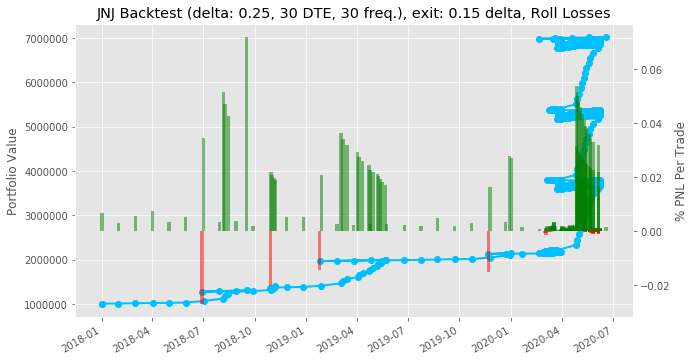

Sharpe: 5.016035126466443


In [ ]:
portfolio(ticker = 'JNJ',start_date = datetime(2018,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 30, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 30,roll_positions = True)
# PORTFOLIO WITH FIXED CREDIT OF 0.4 AND EXIT CONDITION OF 0.4

Date 2015-01-02 00:00:00, Expiry: 2015-01-09T00:00:00.000000000, Strike: 106.0, Underlying: 104.6, Delta: 0.267069
Bought back call (expiry 2015-01-09T00:00:00.000000000, strike = 106.0) on 2015-01-05 00:00:00 for 0.12
PNL 2015-01-02 00:00:00 = 1001771.0 (premium = 0.35, exit = 0.12)

Date 2015-01-12 00:00:00, Expiry: 2015-01-23T00:00:00.000000000, Strike: 107.0, Underlying: 104.62, Delta: 0.225524
Bought back call (expiry 2015-01-23T00:00:00.000000000, strike = 107.0) on 2015-01-15 00:00:00 for 0.1
PNL 2015-01-12 00:00:00 = 1003927.0 (premium = 0.38, exit = 0.1)

Date 2015-01-22 00:00:00, Expiry: 2015-01-30T00:00:00.000000000, Strike: 105.0, Underlying: 103.625, Delta: 0.255897
Bought back call (expiry 2015-01-30T00:00:00.000000000, strike = 105.0) on 2015-01-20 00:00:00 for 0.15
PNL 2015-01-22 00:00:00 = 1005159.0 (premium = 0.31, exit = 0.15)

Date 2015-02-02 00:00:00, Expiry: 2015-02-13T00:00:00.000000000, Strike: 103.0, Underlying: 100.83, Delta: 0.206975
Bought back call (expiry 

Date 2015-10-09 00:00:00, Expiry: 2015-10-16T00:00:00.000000000, Strike: 97.0, Underlying: 95.23, Delta: 0.232757
Bought back call (expiry 2015-10-16T00:00:00.000000000, strike = 97.0) on 2015-09-22 00:00:00 for 0.3
PNL 2015-10-09 00:00:00 = 1017786.9906005859 (premium = 0.32, exit = 0.3)

Date 2015-10-19 00:00:00, Expiry: 2015-10-30T00:00:00.000000000, Strike: 99.5, Underlying: 97.935, Delta: 0.251215
Bought back call (expiry 2015-10-30T00:00:00.000000000, strike = 99.5) on 2015-09-10 00:00:00 for 0.4
we lost money  PNL 2015-10-19 00:00:00 = 1017324.9906005859 (premium = 0.34, exit = 0.4)

Date 2015-10-29 00:00:00, Expiry: 2015-11-06T00:00:00.000000000, Strike: 102.0, Underlying: 101.445, Delta: 0.370262
Bought back call (expiry 2015-11-06T00:00:00.000000000, strike = 102.0) on 2015-09-24 00:00:00 for 0.11
PNL 2015-10-29 00:00:00 = 1019788.9906005859 (premium = 0.43, exit = 0.11)

Date 2015-11-09 00:00:00, Expiry: 2015-11-20T00:00:00.000000000, Strike: 102.0, Underlying: 100.84, Delta

Bought back call (expiry 2016-07-22T00:00:00.000000000, strike = 125.0) on 2016-06-02 00:00:00 for 0.02
PNL 2016-07-15 00:00:00 = 1056748.990600586 (premium = 0.38, exit = 0.02)

Date 2016-07-25 00:00:00, Expiry: 2016-08-05T00:00:00.000000000, Strike: 126.0, Underlying: 124.805, Delta: 0.296618
Bought back call (expiry 2016-08-05T00:00:00.000000000, strike = 126.0) on 2016-06-23 00:00:00 for 0.11
PNL 2016-07-25 00:00:00 = 1058981.990600586 (premium = 0.4, exit = 0.11)

Date 2016-08-04 00:00:00, Expiry: 2016-08-12T00:00:00.000000000, Strike: 125.0, Underlying: 124.02, Delta: 0.24238
Bought back call (expiry 2016-08-12T00:00:00.000000000, strike = 125.0) on 2016-08-08 00:00:00 for 0.06
PNL 2016-08-04 00:00:00 = 1060059.990600586 (premium = 0.2, exit = 0.06)

Date 2016-08-15 00:00:00, Expiry: 2016-08-26T00:00:00.000000000, Strike: 123.0, Underlying: 122.37, Delta: 0.29223000000000005
Bought back call (expiry 2016-08-26T00:00:00.000000000, strike = 123.0) on 2016-08-17 00:00:00 for 0.15
PN

At expiry, underlying is 121.76000213623047 , strike is 127.0
PNL 2017-04-11 00:00:00 = 1094555.985900879 (premium = 0.46, exit = 0)

Date 2017-04-21 00:00:00, Expiry: 2017-04-28T00:00:00.000000000, Strike: 123.0, Underlying: 121.985, Delta: 0.308608
Expired call (expiry 2017-04-28T00:00:00.000000000, strike = 123.0) on 2017-04-21 00:00:00
Strike was breached- At expiry, underlying is 123.47000122070312 , strike is 123.0
we lost money  PNL 2017-04-21 00:00:00 = 1093939.9765014648 (premium = 0.39, exit = 0.470001220703125)

Date 2017-05-01 00:00:00, Expiry: 2017-05-12T00:00:00.000000000, Strike: 125.0, Underlying: 123.685, Delta: 0.286587
Bought back call (expiry 2017-05-12T00:00:00.000000000, strike = 125.0) on 2017-05-05 00:00:00 for 0.12
PNL 2017-05-01 00:00:00 = 1096095.9765014648 (premium = 0.4, exit = 0.12)

Date 2017-05-11 00:00:00, Expiry: 2017-05-19T00:00:00.000000000, Strike: 124.0, Underlying: 123.13, Delta: 0.303175
Expired call (expiry 2017-05-19T00:00:00.000000000, strike 

Date 2018-01-05 00:00:00, Expiry: 2018-01-12T00:00:00.000000000, Strike: 143.0, Underlying: 141.67, Delta: 0.304259
Bought back call (expiry 2018-01-12T00:00:00.000000000, strike = 143.0) on 2018-01-02 00:00:00 for 0.11
PNL 2018-01-05 00:00:00 = 1080002.990600586 (premium = 0.47, exit = 0.11)

Date 2018-01-16 00:00:00, Expiry: 2018-01-26T00:00:00.000000000, Strike: 150.0, Underlying: 147.17, Delta: 0.307235
Bought back call (expiry 2018-01-26T00:00:00.000000000, strike = 150.0) on 2017-12-07 00:00:00 for 0.27
PNL 2018-01-16 00:00:00 = 1085700.990600586 (premium = 1.01, exit = 0.27)

Date 2018-01-26 00:00:00, Expiry: 2018-02-02T00:00:00.000000000, Strike: 147.0, Underlying: 145.16, Delta: 0.251922
Bought back call (expiry 2018-02-02T00:00:00.000000000, strike = 147.0) on 2017-12-29 00:00:00 for 0.46
we lost money  PNL 2018-01-26 00:00:00 = 1085161.990600586 (premium = 0.39, exit = 0.46)

Date 2018-02-05 00:00:00, Expiry: 2018-02-16T00:00:00.000000000, Strike: 136.0, Underlying: 131.365,

Strike was breached- At expiry, underlying is 139.0500030517578 , strike is 137.0
we lost money  PNL 2018-10-12 00:00:00 = 1114114.004699707 (premium = 0.89, exit = 2.0500030517578125)

Date 2018-10-23 00:00:00, Expiry: 2018-11-02T00:00:00.000000000, Strike: 142.0, Underlying: 139.21, Delta: 0.263552
Bought back call (expiry 2018-11-02T00:00:00.000000000, strike = 142.0) on 2018-10-12 00:00:00 for 0.51
PNL 2018-10-23 00:00:00 = 1115192.004699707 (premium = 0.65, exit = 0.51)

Date 2018-11-02 00:00:00, Expiry: 2018-11-09T00:00:00.000000000, Strike: 143.0, Underlying: 140.55, Delta: 0.259199
Bought back call (expiry 2018-11-09T00:00:00.000000000, strike = 143.0) on 2018-10-12 00:00:00 for 0.59
we lost money  PNL 2018-11-02 00:00:00 = 1114961.004699707 (premium = 0.56, exit = 0.59)

Date 2018-11-12 00:00:00, Expiry: 2018-11-23T00:00:00.000000000, Strike: 148.0, Underlying: 145.715, Delta: 0.27331500000000003
Bought back call (expiry 2018-11-23T00:00:00.000000000, strike = 148.0) on 2018-1

Bought back call (expiry 2019-07-26T00:00:00.000000000, strike = 133.0) on 2019-07-22 00:00:00 for 0.05
PNL 2019-07-19 00:00:00 = 1114884.0234985352 (premium = 0.47, exit = 0.05)

Date 2019-07-30 00:00:00, Expiry: 2019-08-09T00:00:00.000000000, Strike: 135.0, Underlying: 132.11, Delta: 0.231146
Bought back call (expiry 2019-08-09T00:00:00.000000000, strike = 135.0) on 2019-07-22 00:00:00 for 0.29
PNL 2019-07-30 00:00:00 = 1116424.0234985352 (premium = 0.49, exit = 0.29)

Date 2019-08-09 00:00:00, Expiry: 2019-08-16T00:00:00.000000000, Strike: 135.0, Underlying: 132.6, Delta: 0.238243
Bought back call (expiry 2019-08-16T00:00:00.000000000, strike = 135.0) on 2019-07-22 00:00:00 for 0.4
PNL 2019-08-09 00:00:00 = 1116809.0234985352 (premium = 0.45, exit = 0.4)

Date 2019-08-19 00:00:00, Expiry: 2019-08-30T00:00:00.000000000, Strike: 135.0, Underlying: 132.36, Delta: 0.248526
Bought back call (expiry 2019-08-30T00:00:00.000000000, strike = 135.0) on 2019-08-26 00:00:00 for 0.42
PNL 2019-08

we lost money  PNL 2020-04-06 00:00:00 = 1127512.0563964844 (premium = 0.85, exit = 1.08)

Date 2020-04-15 00:00:00, Expiry: 2020-04-24T00:00:00.000000000, Strike: 152.5, Underlying: 147.16, Delta: 0.252712
Bought back call (expiry 2020-04-24T00:00:00.000000000, strike = 152.5) on 2020-03-12 00:00:00 for 1.32
we lost money  PNL 2020-04-15 00:00:00 = 1126049.0563964844 (premium = 1.13, exit = 1.32)

Date 2020-04-24 00:00:00, Expiry: 2020-05-01T00:00:00.000000000, Strike: 160.0, Underlying: 154.97, Delta: 0.181034
Bought back call (expiry 2020-05-01T00:00:00.000000000, strike = 160.0) on 2020-03-13 00:00:00 for 0.46
PNL 2020-04-24 00:00:00 = 1126511.0563964844 (premium = 0.52, exit = 0.46)

Date 2020-05-05 00:00:00, Expiry: 2020-05-15T00:00:00.000000000, Strike: 155.0, Underlying: 149.96, Delta: 0.203862
Bought back call (expiry 2020-05-15T00:00:00.000000000, strike = 155.0) on 2020-02-28 00:00:00 for 0.84
we lost money  PNL 2020-05-05 00:00:00 = 1125048.0563964844 (premium = 0.65, exit 

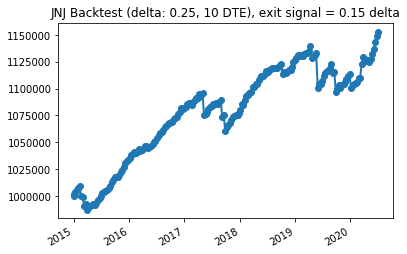

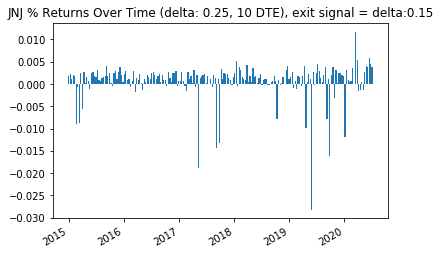

In [ ]:
jnj_delta_v2 = portfolio(ticker = 'JNJ',start_date = datetime(2015,1,1), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 10, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 10,roll_positions = False)
jnj_delta_v2.run_backtest()
plot_returns(jnj_delta_v2)

Date 2014-12-31, Expiry: 2015-01-17, Strike: 107.0, Underlying: 104.57, Premium: 0.48, Delta: 0.243142
Bought back call (expiry 2015-01-17T00:00:00.000000000, strike = 107.0) on 2015-01-05 for 0.19
PNL 2014-12-31 = 1002233.0 (premium = 0.48, exit = 0.19)

Date 2015-01-15, Expiry: 2015-01-30, Strike: 105.0, Underlying: 102.54, Premium: 0.67, Delta: 0.278535
Bought back call (expiry 2015-01-30T00:00:00.000000000, strike = 105.0) on 2015-01-20 for 0.15
PNL 2015-01-15 = 6237.0 (premium = 0.67, exit = 0.15)

Date 2015-01-29, Expiry: 2015-02-13, Strike: 104.0, Underlying: 102.425, Premium: 0.45, Delta: 0.276584
Bought back call (expiry 2015-02-13T00:00:00.000000000, strike = 104.0) on 2015-01-30 for 0.25
PNL 2015-01-29 = 5544.0 (premium = 0.45, exit = 0.25)

Date 2015-02-12, Expiry: 2015-02-27, Strike: 100.0, Underlying: 98.48, Premium: 0.43, Delta: 0.25166
Expired call (expiry 2015-02-27T00:00:00.000000000, strike = 100.0) on 2015-02-12
Strike was breached- At expiry, underlying is 102.5100

Strike was breached- At expiry, underlying is 113.31999969482422 , strike is 112.0
We lost money  PNL 2016-04-07 = -5004.997650146484 (premium = 0.58, exit = 1.3199996948242188)

Date 2016-04-21, Expiry: 2016-05-06, Strike: 115.0, Underlying: 113.43, Premium: 0.4, Delta: 0.266192
Bought back call (expiry 2016-05-06T00:00:00.000000000, strike = 115.0) on 2016-04-27 for 0.14
PNL 2016-04-21 = -3695.9976501464844 (premium = 0.4, exit = 0.14)

Date 2016-05-05, Expiry: 2016-05-20, Strike: 114.0, Underlying: 112.69, Premium: 0.45, Delta: 0.26835
Bought back call (expiry 2016-05-20T00:00:00.000000000, strike = 114.0) on 2016-05-19 for 0.04
PNL 2016-05-05 = 5159.0 (premium = 0.45, exit = 0.04)

Date 2016-05-19, Expiry: 2016-06-03, Strike: 114.0, Underlying: 112.865, Premium: 0.21, Delta: 0.186924
Bought back call (expiry 2016-06-03T00:00:00.000000000, strike = 114.0) on 2016-05-31 for 0.08
PNL 2016-05-19 = 4158.0 (premium = 0.21, exit = 0.08)

Date 2016-06-02, Expiry: 2016-06-17, Strike: 116.0,

Strike was breached- At expiry, underlying is 134.35000610351562 , strike is 131.0
We lost money  PNL 2017-06-01 = -21329.046997070312 (premium = 0.31, exit = 3.350006103515625)

Date 2017-06-15, Expiry: 2017-06-30, Strike: 135.0, Underlying: 132.95, Premium: 0.39, Delta: 0.242016
Expired call (expiry 2017-06-30T00:00:00.000000000, strike = 135.0) on 2017-06-15
At expiry, underlying is 132.2899932861328 , strike is 135.0
PNL 2017-06-15 = -20405.046997070312 (premium = 0.39, exit = 0)

Date 2017-06-29, Expiry: 2017-07-14, Strike: 135.0, Underlying: 132.844, Premium: 0.47, Delta: 0.25700700000000004
Bought back call (expiry 2017-07-14T00:00:00.000000000, strike = 135.0) on 2017-07-07 for 0.1
PNL 2017-06-29 = 5852.0 (premium = 0.47, exit = 0.1)

Date 2017-07-13, Expiry: 2017-07-28, Strike: 135.0, Underlying: 131.9, Premium: 0.71, Delta: 0.261101
Bought back call (expiry 2017-07-28T00:00:00.000000000, strike = 135.0) on 2017-07-25 for 0.02
PNL 2017-07-13 = 8162.0 (premium = 0.71, exit = 0.

Date 2018-09-06, Expiry: 2018-09-21, Strike: 140.0, Underlying: 137.2, Premium: 0.55, Delta: 0.247606
Expired call (expiry 2018-09-21T00:00:00.000000000, strike = 140.0) on 2018-09-06
Strike was breached- At expiry, underlying is 142.8800048828125 , strike is 140.0
We lost money  PNL 2018-09-06 = -15862.03759765625 (premium = 0.55, exit = 2.8800048828125)

Date 2018-09-20, Expiry: 2018-10-05, Strike: 144.0, Underlying: 141.86, Premium: 0.56, Delta: 0.277535
Bought back call (expiry 2018-10-05T00:00:00.000000000, strike = 144.0) on 2018-09-25 for 0.07
PNL 2018-09-20 = -14168.03759765625 (premium = 0.56, exit = 0.07)

Date 2018-10-04, Expiry: 2018-10-19, Strike: 143.0, Underlying: 139.125, Premium: 0.82, Delta: 0.253932
Bought back call (expiry 2018-10-19T00:00:00.000000000, strike = 143.0) on 2018-10-11 for 0.21
PNL 2018-10-04 = 8470.0 (premium = 0.82, exit = 0.21)

Date 2018-10-18, Expiry: 2018-11-02, Strike: 143.0, Underlying: 139.71, Premium: 0.69, Delta: 0.253583
Bought back call (e

Date 2019-10-31, Expiry: 2019-11-15, Strike: 135.0, Underlying: 131.9, Premium: 0.59, Delta: 0.243724
Bought back call (expiry 2019-11-15T00:00:00.000000000, strike = 135.0) on 2019-11-04 for 0.18
PNL 2019-10-31 = 6930.0 (premium = 0.59, exit = 0.18)

Date 2019-11-14, Expiry: 2019-11-29, Strike: 133.0, Underlying: 130.75, Premium: 0.43, Delta: 0.219628
Expired call (expiry 2019-11-29T00:00:00.000000000, strike = 133.0) on 2019-11-14
Strike was breached- At expiry, underlying is 137.49000549316406 , strike is 133.0
We lost money  PNL 2019-11-14 = -28105.042297363285 (premium = 0.43, exit = 4.4900054931640625)

Date 2019-11-27, Expiry: 2019-12-13, Strike: 141.0, Underlying: 137.88, Premium: 0.46, Delta: 0.21597
Bought back call (expiry 2019-12-13T00:00:00.000000000, strike = 141.0) on 2019-12-03 for 0.17
PNL 2019-11-27 = -29029.042297363285 (premium = 0.46, exit = 0.17)

Date 2019-12-12, Expiry: 2019-12-27, Strike: 144.0, Underlying: 141.56, Premium: 0.61, Delta: 0.271811
Expired call (e

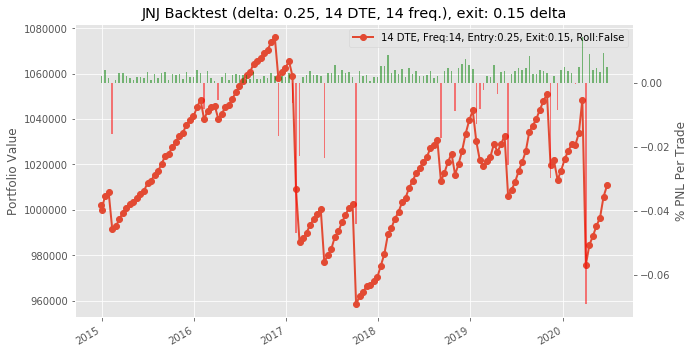

In [ ]:
jnj_port = portfolio(ticker = 'JNJ',start_date = datetime(2015,1,2), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 14, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 14,roll_positions = False)
jnj_port.run_backtest()
plot_returns([jnj_port])

Date 2015-01-02, Expiry: 2015-01-17, Strike: 107.0, Underlying: 104.6, Premium: 0.36, Delta: 0.21715
Bought back call (expiry 2015-01-17T00:00:00.000000000, strike = 107.0) on 2015-01-05 for 0.19
PNL 2015-01-02 = 1001309.0 (premium = 0.36, exit = 0.19)

Date 2015-01-16, Expiry: 2015-01-30, Strike: 107.0, Underlying: 104.04, Premium: 0.41, Delta: 0.20852
Bought back call (expiry 2015-01-30T00:00:00.000000000, strike = 107.0) on 2015-01-20 for 0.03
PNL 2015-01-16 = 4235.0 (premium = 0.41, exit = 0.03)

Date 2015-01-30, Expiry: 2015-02-13, Strike: 103.0, Underlying: 100.33, Premium: 0.41, Delta: 0.22185900000000006
Bought back call (expiry 2015-02-13T00:00:00.000000000, strike = 103.0) on 2015-02-09 for 0.05
PNL 2015-01-30 = 5698.0 (premium = 0.41, exit = 0.05)

Date 2015-02-13, Expiry: 2015-02-27, Strike: 101.0, Underlying: 99.6099, Premium: 0.33, Delta: 0.228406
Expired call (expiry 2015-02-27T00:00:00.000000000, strike = 101.0) on 2015-02-13
Strike was breached- At expiry, underlying i

Strike was breached- At expiry, underlying is 113.31999969482422 , strike is 111.0
We lost money  PNL 2016-04-08 = -12319.997650146484 (premium = 0.63, exit = 2.3199996948242188)

Date 2016-04-22, Expiry: 2016-05-06, Strike: 115.0, Underlying: 113.35, Premium: 0.36, Delta: 0.250238
Bought back call (expiry 2016-05-06T00:00:00.000000000, strike = 115.0) on 2016-04-27 for 0.14
PNL 2016-04-22 = -11318.997650146484 (premium = 0.36, exit = 0.14)

Date 2016-05-06, Expiry: 2016-05-20, Strike: 114.0, Underlying: 112.65, Premium: 0.41, Delta: 0.264135
Bought back call (expiry 2016-05-20T00:00:00.000000000, strike = 114.0) on 2016-05-19 for 0.04
PNL 2016-05-06 = 4543.0 (premium = 0.41, exit = 0.04)

Date 2016-05-20, Expiry: 2016-06-03, Strike: 114.0, Underlying: 112.48, Premium: 0.35, Delta: 0.261041
Bought back call (expiry 2016-06-03T00:00:00.000000000, strike = 114.0) on 2016-05-31 for 0.08
PNL 2016-05-20 = 4928.0 (premium = 0.35, exit = 0.08)

Date 2016-06-03, Expiry: 2016-06-17, Strike: 116

Strike was breached- At expiry, underlying is 134.35000610351562 , strike is 132.0
We lost money  PNL 2017-06-02 = -28028.061096191406 (premium = 0.32, exit = 2.350006103515625)

Date 2017-06-16, Expiry: 2017-06-30, Strike: 136.0, Underlying: 134.295, Premium: 0.41, Delta: 0.267206
Bought back call (expiry 2017-06-30T00:00:00.000000000, strike = 136.0) on 2017-06-28 for 0.03
PNL 2017-06-16 = -12705.046997070314 (premium = 0.41, exit = 0.03)

Date 2017-06-30, Expiry: 2017-07-14, Strike: 135.0, Underlying: 132.73, Premium: 0.33, Delta: 0.212452
Bought back call (expiry 2017-07-14T00:00:00.000000000, strike = 135.0) on 2017-07-07 for 0.1
PNL 2017-06-30 = 4697.0 (premium = 0.33, exit = 0.1)

Date 2017-07-14, Expiry: 2017-07-28, Strike: 136.0, Underlying: 132.78, Premium: 0.58, Delta: 0.23729
Bought back call (expiry 2017-07-28T00:00:00.000000000, strike = 136.0) on 2017-07-24 for 0.03
PNL 2017-07-14 = 6005.999999999999 (premium = 0.58, exit = 0.03)

Date 2017-07-28, Expiry: 2017-08-11, Str

Strike was breached- At expiry, underlying is 142.8800048828125 , strike is 140.0
We lost money  PNL 2018-09-07 = -15092.03759765625 (premium = 0.51, exit = 2.8800048828125)

Date 2018-09-21, Expiry: 2018-10-05, Strike: 145.0, Underlying: 142.96, Premium: 0.5, Delta: 0.269944
Bought back call (expiry 2018-10-05T00:00:00.000000000, strike = 145.0) on 2018-09-24 for 0.16
PNL 2018-09-21 = -15631.03759765625 (premium = 0.5, exit = 0.16)

Date 2018-10-05, Expiry: 2018-10-19, Strike: 143.0, Underlying: 138.74, Premium: 0.72, Delta: 0.231871
Bought back call (expiry 2018-10-19T00:00:00.000000000, strike = 143.0) on 2018-10-11 for 0.21
PNL 2018-10-05 = 6545.0 (premium = 0.72, exit = 0.21)

Date 2018-10-19, Expiry: 2018-11-02, Strike: 143.0, Underlying: 139.435, Premium: 0.61, Delta: 0.233426
Bought back call (expiry 2018-11-02T00:00:00.000000000, strike = 143.0) on 2018-10-26 for 0.22
PNL 2018-10-19 = 6930.0 (premium = 0.61, exit = 0.22)

Date 2018-11-02, Expiry: 2018-11-16, Strike: 144.0, Und

Expired call (expiry 2019-11-29T00:00:00.000000000, strike = 136.0) on 2019-11-15
Strike was breached- At expiry, underlying is 137.49000549316406 , strike is 136.0
We lost money  PNL 2019-11-15 = -1848.0422973632803 (premium = 0.64, exit = 1.4900054931640625)

Date 2019-11-29, Expiry: 2019-12-13, Strike: 140.0, Underlying: 137.6, Premium: 0.57, Delta: 0.264022
Expired call (expiry 2019-12-13T00:00:00.000000000, strike = 140.0) on 2019-11-29
Strike was breached- At expiry, underlying is 141.3800048828125 , strike is 140.0
We lost money  PNL 2019-11-29 = -12782.079895019531 (premium = 0.57, exit = 1.3800048828125)

Date 2019-12-13, Expiry: 2019-12-27, Strike: 144.0, Underlying: 141.55, Premium: 0.44, Delta: 0.23612600000000006
Expired call (expiry 2019-12-27T00:00:00.000000000, strike = 144.0) on 2019-12-13
Strike was breached- At expiry, underlying is 145.75 , strike is 144.0
We lost money  PNL 2019-12-13 = -16324.03759765625 (premium = 0.44, exit = 1.75)

Date 2019-12-27, Expiry: 2020

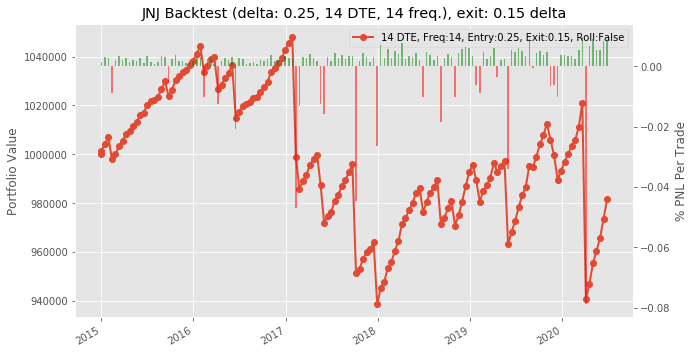

In [ ]:
jnj_port = portfolio(ticker = 'JNJ',start_date = datetime(2015,1,2), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 14, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 14,roll_positions = False)
jnj_port.run_backtest()
plot_returns([jnj_port])

In [ ]:
jnj_port2 = portfolio(ticker = 'JNJ',start_date = datetime(2015,1,2), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 14, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 14,roll_positions = False)
jnj_port.run_backtest()
plot_returns([jnj_port])

Date 2019-01-02, Expiry: 2019-01-11, Strike: 132.0, Underlying: 127.54, Premium: 0.42, Delta: 0.173402
At expiry, underlying is 129.75 , strike is 132.0
PNL 2019-01-02 = 3234.0 (premium = 0.42, exit = 0, contracts = 7700, PNL per contract = 0.42)

Date 2019-01-09, Expiry: 2019-01-18, Strike: 132.0, Underlying: 128.49, Premium: 0.47, Delta: 0.207319
At expiry, underlying is 130.69000244140625 , strike is 132.0
PNL 2019-01-09 = 3619.0 (premium = 0.47, exit = 0, contracts = 7700, PNL per contract = 0.47)

Date 2019-01-16, Expiry: 2019-01-25, Strike: 133.0, Underlying: 128.17, Premium: 0.49, Delta: 0.181214
At expiry, underlying is 128.22999572753906 , strike is 133.0
PNL 2019-01-16 = 3773.0 (premium = 0.49, exit = 0, contracts = 7700, PNL per contract = 0.49)

Date 2019-01-23, Expiry: 2019-02-01, Strike: 132.0, Underlying: 128.97, Premium: 0.43, Delta: 0.21279
Strike was breached- At expiry, underlying is 134.1999969482422 , strike is 132.0
We lost money  PNL 2019-01-23 = -13628.976501464

At expiry, underlying is 131.36000061035156 , strike is 134.0
PNL 2019-08-07 = 4235.0 (premium = 0.55, exit = 0, contracts = 7700, PNL per contract = 0.55)

Date 2019-08-14, Expiry: 2019-08-23, Strike: 135.0, Underlying: 131.05, Premium: 0.43, Delta: 0.188228
At expiry, underlying is 127.7300033569336 , strike is 135.0
PNL 2019-08-14 = 3311.0 (premium = 0.43, exit = 0, contracts = 7700, PNL per contract = 0.43)

Date 2019-08-21, Expiry: 2019-08-30, Strike: 137.0, Underlying: 131.37, Premium: 0.7, Delta: 0.188387
At expiry, underlying is 128.36000061035156 , strike is 137.0
PNL 2019-08-21 = 5390.0 (premium = 0.7, exit = 0, contracts = 7700, PNL per contract = 0.7)

Date 2019-08-28, Expiry: 2019-09-06, Strike: 132.0, Underlying: 128.36, Premium: 0.31, Delta: 0.166129
At expiry, underlying is 128.2100067138672 , strike is 132.0
PNL 2019-08-28 = 2387.0 (premium = 0.31, exit = 0, contracts = 7700, PNL per contract = 0.31)

Date 2019-09-04, Expiry: 2019-09-13, Strike: 132.0, Underlying: 128.

At expiry, underlying is 123.16000366210938 , strike is 144.0
PNL 2020-03-18 = 10241.0 (premium = 1.33, exit = 0, contracts = 7700, PNL per contract = 1.33)

Date 2020-03-25, Expiry: 2020-04-03, Strike: 132.0, Underlying: 122.91, Premium: 1.02, Delta: 0.195928
Strike was breached- At expiry, underlying is 134.1699981689453 , strike is 132.0
We lost money  PNL 2020-03-25 = -8854.985900878906 (premium = 1.02, exit = 2.1699981689453125)

Date 2020-04-01, Expiry: 2020-04-09, Strike: 137.0, Underlying: 128.92, Premium: 1.0, Delta: 0.202804
Strike was breached- At expiry, underlying is 141.22999572753906 , strike is 137.0
We lost money  PNL 2020-04-01 = -24870.96710205078 (premium = 1.0, exit = 4.2299957275390625)

Date 2020-04-08, Expiry: 2020-04-17, Strike: 150.0, Underlying: 142.4, Premium: 0.76, Delta: 0.181483
Strike was breached- At expiry, underlying is 152.02000427246094 , strike is 150.0
We lost money  PNL 2020-04-08 = -9702.032897949219 (premium = 0.76, exit = 2.0200042724609375)



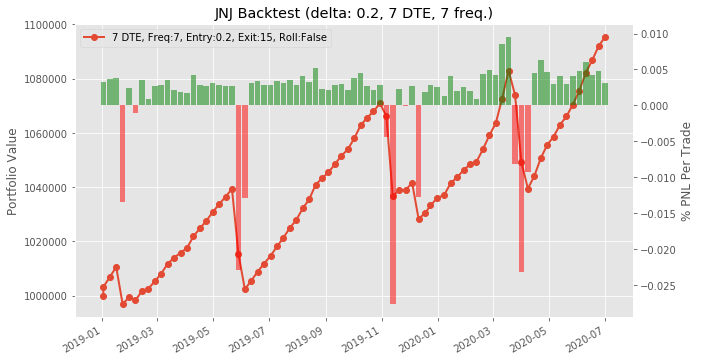

In [ ]:
# This cell proves that our results still match previous results (code is still accurately calibrated- at least for simple strategies)

JNJ_delta = portfolio(ticker = 'JNJ', strike_signal = 'delta', strike_signal_val = 0.20, dte_sell = 7, frequency= 7)
JNJ_delta.run_backtest()
plot_returns([JNJ_delta])

Date 2017-01-03 00:00:00, Expiry: 2017-01-13T00:00:00.000000000, Strike: 118.0, Underlying: 115.7, Delta: 0.189899
At expiry, underlying is 114.5999984741211 , strike is 118.0
PNL 2017-01-03 00:00:00 = 1002002.0 (premium = 0.26, exit = 0)

Date 2017-01-12 00:00:00, Expiry: 2017-01-20T00:00:00.000000000, Strike: 116.0, Underlying: 114.598, Delta: 0.256193
At expiry, underlying is 114.1500015258789 , strike is 116.0
PNL 2017-01-12 00:00:00 = 1004466.0 (premium = 0.32, exit = 0)

Date 2017-01-23 00:00:00, Expiry: 2017-02-03T00:00:00.000000000, Strike: 116.0, Underlying: 113.87, Delta: 0.236665
At expiry, underlying is 113.63999938964844 , strike is 116.0
PNL 2017-01-23 00:00:00 = 1007469.0 (premium = 0.39, exit = 0)

Date 2017-02-01 00:00:00, Expiry: 2017-02-10T00:00:00.000000000, Strike: 114.0, Underlying: 112.96, Delta: 0.304104
Strike was breached- At expiry, underlying is 115.23999786376953 , strike is 114.0
we lost money  PNL 2017-02-01 00:00:00 = 1000847.0164489746 (premium = 0.38, 

At expiry, underlying is 139.55999755859375 , strike is 143.0
PNL 2017-10-30 00:00:00 = 859475.1339416504 (premium = 0.47, exit = 0)

Date 2017-11-08 00:00:00, Expiry: 2017-11-17T00:00:00.000000000, Strike: 143.0, Underlying: 141.33, Delta: 0.29349699999999995
At expiry, underlying is 138 , strike is 143.0
PNL 2017-11-08 00:00:00 = 863556.1339416504 (premium = 0.53, exit = 0)

Date 2017-11-17 00:00:00, Expiry: 2017-11-24T00:00:00.000000000, Strike: 139.0, Underlying: 138.02, Delta: 0.291036
At expiry, underlying is 138.00999450683594 , strike is 139.0
PNL 2017-11-17 00:00:00 = 865943.1339416504 (premium = 0.31, exit = 0)

Date 2017-11-28 00:00:00, Expiry: 2017-12-08T00:00:00.000000000, Strike: 142.0, Underlying: 139.93, Delta: 0.26879699999999995
At expiry, underlying is 140.58999633789062 , strike is 142.0
PNL 2017-11-28 00:00:00 = 869562.1339416504 (premium = 0.47, exit = 0)

Date 2017-12-08 00:00:00, Expiry: 2017-12-15T00:00:00.000000000, Strike: 142.0, Underlying: 140.55, Delta: 0.

Strike was breached- At expiry, underlying is 142.8800048828125 , strike is 141.0
we lost money  PNL 2018-09-14 00:00:00 = 827058.0258483887 (premium = 0.31, exit = 1.8800048828125)

Date 2018-09-24 00:00:00, Expiry: 2018-10-05T00:00:00.000000000, Strike: 143.0, Underlying: 140.79, Delta: 0.259335
At expiry, underlying is 139.10000610351562 , strike is 143.0
PNL 2018-09-24 00:00:00 = 830831.0258483887 (premium = 0.49, exit = 0)

Date 2018-10-04 00:00:00, Expiry: 2018-10-12T00:00:00.000000000, Strike: 141.0, Underlying: 139.125, Delta: 0.28218000000000004
At expiry, underlying is 133.8699951171875 , strike is 141.0
PNL 2018-10-04 00:00:00 = 834989.0258483887 (premium = 0.54, exit = 0)

Date 2018-10-15 00:00:00, Expiry: 2018-10-26T00:00:00.000000000, Strike: 138.0, Underlying: 134.393, Delta: 0.276362
At expiry, underlying is 136.97000122070312 , strike is 138.0
PNL 2018-10-15 00:00:00 = 842227.0258483887 (premium = 0.94, exit = 0)

Date 2018-10-24 00:00:00, Expiry: 2018-11-02T00:00:00.0

Strike was breached- At expiry, underlying is 131.07000732421875 , strike is 131.0
PNL 2019-07-22 00:00:00 = 802110.0446472168 (premium = 0.62, exit = 0.07000732421875)

Date 2019-07-31 00:00:00, Expiry: 2019-08-09T00:00:00.000000000, Strike: 133.0, Underlying: 130.98, Delta: 0.288744
At expiry, underlying is 132.0399932861328 , strike is 133.0
PNL 2019-07-31 00:00:00 = 806730.0446472168 (premium = 0.6, exit = 0)

Date 2019-08-09 00:00:00, Expiry: 2019-08-16T00:00:00.000000000, Strike: 135.0, Underlying: 132.6, Delta: 0.238243
At expiry, underlying is 131.36000061035156 , strike is 135.0
PNL 2019-08-09 00:00:00 = 810195.0446472168 (premium = 0.45, exit = 0)

Date 2019-08-20 00:00:00, Expiry: 2019-08-30T00:00:00.000000000, Strike: 134.0, Underlying: 130.92, Delta: 0.245287
At expiry, underlying is 128.36000061035156 , strike is 134.0
PNL 2019-08-20 00:00:00 = 815970.0446472168 (premium = 0.75, exit = 0)

Date 2019-08-30 00:00:00, Expiry: 2019-09-06T00:00:00.000000000, Strike: 130.0, Und

At expiry, underlying is 147.3000030517578 , strike is 149.0
PNL 2020-05-26 00:00:00 = 811658.0258483887 (premium = 0.65, exit = 0)

Date 2020-06-05 00:00:00, Expiry: 2020-06-12T00:00:00.000000000, Strike: 150.0, Underlying: 147.4, Delta: 0.255805
At expiry, underlying is 142.14999389648438 , strike is 150.0
PNL 2020-06-05 00:00:00 = 816047.0258483887 (premium = 0.57, exit = 0)

Date 2020-06-15 00:00:00, Expiry: 2020-06-26T00:00:00.000000000, Strike: 146.0, Underlying: 140.82, Delta: 0.240819
At expiry, underlying is 137.80999755859375 , strike is 146.0
PNL 2020-06-15 00:00:00 = 823516.0258483887 (premium = 0.97, exit = 0)

Date 2020-06-25 00:00:00, Expiry: 2020-07-02T00:00:00.000000000, Strike: 143.0, Underlying: 139.6, Delta: 0.26868200000000003
At expiry, underlying is 140.97000122070312 , strike is 143.0
PNL 2020-06-25 00:00:00 = 830138.0258483887 (premium = 0.86, exit = 0)



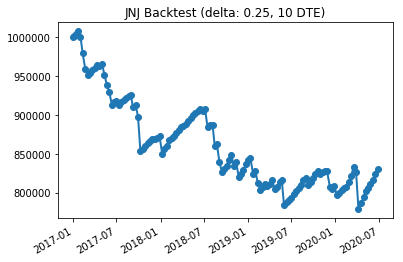

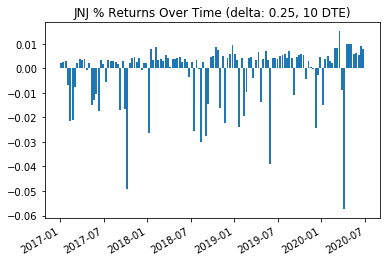

In [ ]:
jnj_delta_v2 = portfolio(ticker = 'JNJ',start_date = datetime(2017,1,2), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 10, exit_signal = None, exit_signal_val = 0.15, frequency= 10,roll_positions = False)
jnj_delta_v2.run_backtest()
plot_returns(jnj_delta_v2)

Date 2017-01-03 00:00:00, Expiry: 2017-01-13T00:00:00.000000000, Strike: 117.0, Underlying: 115.7, Delta: 0.311713
Bought back call (expiry 2017-01-13T00:00:00.000000000, strike = 117.0) on 2016-12-01 00:00:00 for 0.35
PNL 2017-01-03 00:00:00 = 1001232.0 (premium = 0.51, exit = 0.35)

Date 2017-01-12 00:00:00, Expiry: 2017-01-20T00:00:00.000000000, Strike: 116.0, Underlying: 114.598, Delta: 0.256193
Bought back call (expiry 2017-01-20T00:00:00.000000000, strike = 116.0) on 2017-01-18 00:00:00 for 0.04
PNL 2017-01-12 00:00:00 = 1003388.0 (premium = 0.32, exit = 0.04)

Date 2017-01-23 00:00:00, Expiry: 2017-02-03T00:00:00.000000000, Strike: 115.0, Underlying: 113.87, Delta: 0.357477
Bought back call (expiry 2017-02-03T00:00:00.000000000, strike = 115.0) on 2017-01-24 00:00:00 for 0.05
PNL 2017-01-23 00:00:00 = 1008316.0 (premium = 0.69, exit = 0.05)

Date 2017-02-01 00:00:00, Expiry: 2017-02-10T00:00:00.000000000, Strike: 114.0, Underlying: 112.96, Delta: 0.304104
Expired call (expiry 20

Strike was breached- At expiry, underlying is 133.22000122070312 , strike is 131.0
we lost money  PNL 2017-09-29 00:00:00 = 990452.0399475098 (premium = 0.27, exit = 2.220001220703125)

Date 2017-10-09 00:00:00, Expiry: 2017-10-20T00:00:00.000000000, Strike: 136.0, Underlying: 133.49, Delta: 0.278883
Bought back call (expiry 2017-10-20T00:00:00.000000000, strike = 136.0) on 2017-09-27 00:00:00 for 0.21
PNL 2017-10-09 00:00:00 = 994071.0399475098 (premium = 0.68, exit = 0.21)

Date 2017-10-19 00:00:00, Expiry: 2017-10-27T00:00:00.000000000, Strike: 143.0, Underlying: 142.09, Delta: 0.35033800000000004
Bought back call (expiry 2017-10-27T00:00:00.000000000, strike = 143.0) on 2017-09-07 00:00:00 for 0.14
PNL 2017-10-19 00:00:00 = 996920.0399475098 (premium = 0.51, exit = 0.14)

Date 2017-10-30 00:00:00, Expiry: 2017-11-10T00:00:00.000000000, Strike: 142.0, Underlying: 140.05, Delta: 0.313966
Bought back call (expiry 2017-11-10T00:00:00.000000000, strike = 142.0) on 2017-09-28 00:00:00 fo

Date 2018-07-16 00:00:00, Expiry: 2018-07-27T00:00:00.000000000, Strike: 127.0, Underlying: 124.5, Delta: 0.297689
Expired call (expiry 2018-07-27T00:00:00.000000000, strike = 127.0) on 2018-07-16 00:00:00
Strike was breached- At expiry, underlying is 131.5500030517578 , strike is 127.0
we lost money  PNL 2018-07-16 00:00:00 = 1038115.0540466309 (premium = 0.8, exit = 4.5500030517578125)

Date 2018-07-26 00:00:00, Expiry: 2018-08-03T00:00:00.000000000, Strike: 132.0, Underlying: 130.18, Delta: 0.258601
Bought back call (expiry 2018-08-03T00:00:00.000000000, strike = 132.0) on 2018-06-21 00:00:00 for 0.11
PNL 2018-07-26 00:00:00 = 1040348.0540466309 (premium = 0.4, exit = 0.11)

Date 2018-08-06 00:00:00, Expiry: 2018-08-17T00:00:00.000000000, Strike: 134.0, Underlying: 132.085, Delta: 0.263284
Bought back call (expiry 2018-08-17T00:00:00.000000000, strike = 134.0) on 2018-07-23 00:00:00 for 0.11
PNL 2018-08-06 00:00:00 = 1042889.0540466309 (premium = 0.44, exit = 0.11)

Date 2018-08-15 

Date 2019-04-12 00:00:00, Expiry: 2019-04-18T00:00:00.000000000, Strike: 139.0, Underlying: 135.97, Delta: 0.25991
Expired call (expiry 2019-04-18T00:00:00.000000000, strike = 139.0) on 2019-04-12 00:00:00
At expiry, underlying is 137.52000427246094 , strike is 139.0
PNL 2019-04-12 00:00:00 = 1042504.1104431152 (premium = 0.69, exit = 0)

Date 2019-04-22 00:00:00, Expiry: 2019-05-03T00:00:00.000000000, Strike: 140.0, Underlying: 137.63, Delta: 0.262253
Expired call (expiry 2019-05-03T00:00:00.000000000, strike = 140.0) on 2019-04-22 00:00:00
Strike was breached- At expiry, underlying is 142.00999450683594 , strike is 140.0
we lost money  PNL 2019-04-22 00:00:00 = 1031185.1527404785 (premium = 0.54, exit = 2.0099945068359375)

Date 2019-05-02 00:00:00, Expiry: 2019-05-10T00:00:00.000000000, Strike: 142.0, Underlying: 140.6, Delta: 0.345438
Bought back call (expiry 2019-05-10T00:00:00.000000000, strike = 142.0) on 2019-05-09 00:00:00 for 0.02
PNL 2019-05-02 00:00:00 = 1036652.1527404785 

Expired call (expiry 2020-01-17T00:00:00.000000000, strike = 147.0) on 2020-01-07 00:00:00
Strike was breached- At expiry, underlying is 149.1699981689453 , strike is 147.0
we lost money  PNL 2020-01-07 00:00:00 = 1043197.1339416504 (premium = 0.59, exit = 2.1699981689453125)

Date 2020-01-17 00:00:00, Expiry: 2020-01-24T00:00:00.000000000, Strike: 152.5, Underlying: 149.04, Delta: 0.186669
Bought back call (expiry 2020-01-24T00:00:00.000000000, strike = 152.5) on 2019-12-05 00:00:00 for 0.2
PNL 2020-01-17 00:00:00 = 1044583.1339416504 (premium = 0.38, exit = 0.2)

Date 2020-01-27 00:00:00, Expiry: 2020-02-07T00:00:00.000000000, Strike: 152.5, Underlying: 148.69, Delta: 0.211378
Bought back call (expiry 2020-02-07T00:00:00.000000000, strike = 152.5) on 2020-01-03 00:00:00 for 0.41
PNL 2020-01-27 00:00:00 = 1045507.1339416504 (premium = 0.53, exit = 0.41)

Date 2020-02-06 00:00:00, Expiry: 2020-02-14T00:00:00.000000000, Strike: 155.0, Underlying: 153.78, Delta: 0.374897
Bought back call

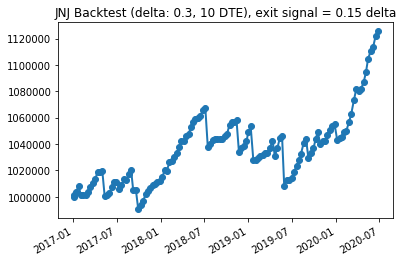

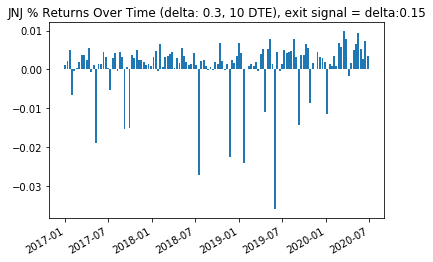

In [ ]:
jnj_delta_v2 = portfolio(ticker = 'JNJ',start_date = datetime(2017,1,2), strike_signal = 'delta', strike_signal_val = 0.3, dte_sell = 10, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 10,roll_positions = False)
jnj_delta_v2.run_backtest()
plot_returns(jnj_delta_v2)

Date 2017-01-03 00:00:00, Expiry: 2017-01-13T00:00:00.000000000, Strike: 117.0, Underlying: 115.7, Delta: 0.311713
Bought back call (expiry 2017-01-13T00:00:00.000000000, strike = 117.0) on 2016-12-01 00:00:00 for 0.35
PNL 2017-01-03 00:00:00 = 1001232.0 (premium = 0.51, exit = 0.35)

Date 2017-01-09 00:00:00, Expiry: 2017-01-13T00:00:00.000000000, Strike: 117.0, Underlying: 116.495, Delta: 0.390772
Bought back call (expiry 2017-01-13T00:00:00.000000000, strike = 117.0) on 2016-12-01 00:00:00 for 0.35
PNL 2017-01-09 00:00:00 = 1002079.0 (premium = 0.46, exit = 0.35)

Date 2017-01-17 00:00:00, Expiry: 2017-01-27T00:00:00.000000000, Strike: 117.0, Underlying: 114.77, Delta: 0.261534
Bought back call (expiry 2017-01-27T00:00:00.000000000, strike = 117.0) on 2016-12-08 00:00:00 for 0.56
we lost money  PNL 2017-01-17 00:00:00 = 1001771.0 (premium = 0.52, exit = 0.56)

Date 2017-01-23 00:00:00, Expiry: 2017-01-27T00:00:00.000000000, Strike: 115.0, Underlying: 113.87, Delta: 0.319981
Expired 

Strike was breached- At expiry, underlying is 135.30999755859375 , strike is 134.0
we lost money  PNL 2017-07-17 00:00:00 = 1030184.0187988281 (premium = 0.78, exit = 1.30999755859375)

Date 2017-07-24 00:00:00, Expiry: 2017-07-28T00:00:00.000000000, Strike: 134.0, Underlying: 133.334, Delta: 0.360277
Bought back call (expiry 2017-07-28T00:00:00.000000000, strike = 134.0) on 2017-07-25 00:00:00 for 0.07
PNL 2017-07-24 00:00:00 = 1032956.0187988281 (premium = 0.43, exit = 0.07)

Date 2017-07-31 00:00:00, Expiry: 2017-08-04T00:00:00.000000000, Strike: 134.0, Underlying: 132.985, Delta: 0.283208
Bought back call (expiry 2017-08-04T00:00:00.000000000, strike = 134.0) on 2017-07-26 00:00:00 for 0.13
PNL 2017-07-31 00:00:00 = 1034265.0187988281 (premium = 0.3, exit = 0.13)

Date 2017-08-07 00:00:00, Expiry: 2017-08-11T00:00:00.000000000, Strike: 134.0, Underlying: 132.59, Delta: 0.19173
Bought back call (expiry 2017-08-11T00:00:00.000000000, strike = 134.0) on 2017-07-26 00:00:00 for 0.32
we

Date 2018-01-22 00:00:00, Expiry: 2018-01-26T00:00:00.000000000, Strike: 150.0, Underlying: 148.14, Delta: 0.290135
Bought back call (expiry 2018-01-26T00:00:00.000000000, strike = 150.0) on 2017-12-07 00:00:00 for 0.27
PNL 2018-01-22 00:00:00 = 1005698.0845947266 (premium = 0.73, exit = 0.27)

Date 2018-01-29 00:00:00, Expiry: 2018-02-02T00:00:00.000000000, Strike: 145.0, Underlying: 143.88, Delta: 0.346219
Bought back call (expiry 2018-02-02T00:00:00.000000000, strike = 145.0) on 2018-01-02 00:00:00 for 0.5
PNL 2018-01-29 00:00:00 = 1006545.0845947266 (premium = 0.61, exit = 0.5)

Date 2018-02-05 00:00:00, Expiry: 2018-02-09T00:00:00.000000000, Strike: 135.0, Underlying: 131.365, Delta: 0.290323
Bought back call (expiry 2018-02-09T00:00:00.000000000, strike = 135.0) on 2018-02-07 00:00:00 for 0.21
PNL 2018-02-05 00:00:00 = 1012474.0845947266 (premium = 0.98, exit = 0.21)

Date 2018-02-12 00:00:00, Expiry: 2018-02-16T00:00:00.000000000, Strike: 132.0, Underlying: 130.21, Delta: 0.3157

Bought back call (expiry 2019-02-08T00:00:00.000000000, strike = 134.0) on 2019-01-22 00:00:00 for 0.28
PNL 2019-02-04 00:00:00 = 998691.1433410645 (premium = 0.35, exit = 0.28)

Date 2019-02-11 00:00:00, Expiry: 2019-02-15T00:00:00.000000000, Strike: 133.0, Underlying: 131.83, Delta: 0.315844
Bought back call (expiry 2019-02-15T00:00:00.000000000, strike = 133.0) on 2019-01-24 00:00:00 for 0.32
PNL 2019-02-11 00:00:00 = 999769.1433410645 (premium = 0.46, exit = 0.32)

Date 2019-02-19 00:00:00, Expiry: 2019-03-01T00:00:00.000000000, Strike: 137.0, Underlying: 135.92, Delta: 0.304591
Bought back call (expiry 2019-03-01T00:00:00.000000000, strike = 137.0) on 2019-01-14 00:00:00 for 0.78
we lost money  PNL 2019-02-19 00:00:00 = 998460.1433410645 (premium = 0.61, exit = 0.78)

Date 2019-02-25 00:00:00, Expiry: 2019-03-01T00:00:00.000000000, Strike: 138.0, Underlying: 136.65, Delta: 0.303019
Bought back call (expiry 2019-03-01T00:00:00.000000000, strike = 138.0) on 2019-01-10 00:00:00 for 0

Strike was breached- At expiry, underlying is 132.0399932861328 , strike is 132.0
PNL 2019-08-05 00:00:00 = 987295.2091369629 (premium = 0.72, exit = 0.0399932861328125)

Date 2019-08-12 00:00:00, Expiry: 2019-08-16T00:00:00.000000000, Strike: 134.0, Underlying: 132.21, Delta: 0.276222
Bought back call (expiry 2019-08-16T00:00:00.000000000, strike = 134.0) on 2019-07-22 00:00:00 for 0.55
we lost money  PNL 2019-08-12 00:00:00 = 986833.2091369629 (premium = 0.49, exit = 0.55)

Date 2019-08-19 00:00:00, Expiry: 2019-08-23T00:00:00.000000000, Strike: 134.0, Underlying: 132.36, Delta: 0.257597
Bought back call (expiry 2019-08-23T00:00:00.000000000, strike = 134.0) on 2019-08-16 00:00:00 for 0.29
PNL 2019-08-19 00:00:00 = 987449.2091369629 (premium = 0.37, exit = 0.29)

Date 2019-08-26 00:00:00, Expiry: 2019-08-30T00:00:00.000000000, Strike: 131.0, Underlying: 127.26, Delta: 0.304703
Bought back call (expiry 2019-08-30T00:00:00.000000000, strike = 131.0) on 2019-08-28 00:00:00 for 0.1
PNL 2

Date 2020-02-24 00:00:00, Expiry: 2020-02-28T00:00:00.000000000, Strike: 149.0, Underlying: 146.61, Delta: 0.274727
Bought back call (expiry 2020-02-28T00:00:00.000000000, strike = 149.0) on 2020-02-26 00:00:00 for 0.28
PNL 2020-02-24 00:00:00 = 980211.232635498 (premium = 0.64, exit = 0.28)

Date 2020-03-02 00:00:00, Expiry: 2020-03-06T00:00:00.000000000, Strike: 141.0, Underlying: 138.59, Delta: 0.315906
Bought back call (expiry 2020-03-06T00:00:00.000000000, strike = 141.0) on 2020-02-28 00:00:00 for 0.86
PNL 2020-03-02 00:00:00 = 980981.232635498 (premium = 0.96, exit = 0.86)

Date 2020-03-09 00:00:00, Expiry: 2020-03-13T00:00:00.000000000, Strike: 142.0, Underlying: 137.26, Delta: 0.285737
Bought back call (expiry 2020-03-13T00:00:00.000000000, strike = 142.0) on 2020-03-11 00:00:00 for 0.34
PNL 2020-03-09 00:00:00 = 988835.232635498 (premium = 1.36, exit = 0.34)

Date 2020-03-16 00:00:00, Expiry: 2020-03-20T00:00:00.000000000, Strike: 136.0, Underlying: 130.24, Delta: 0.295507
Bo

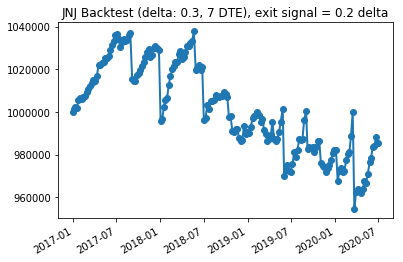

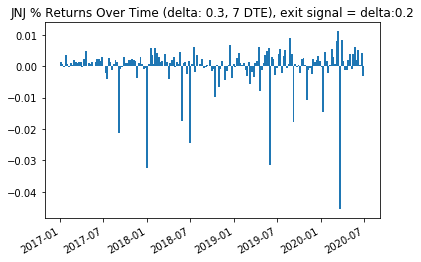

In [ ]:
jnj_delta_v2 = portfolio(ticker = 'JNJ',start_date = datetime(2017,1,2), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 7, exit_signal = 'delta', exit_signal_val = 0.20, frequency= 7,roll_positions = False)
jnj_delta_v2.run_backtest()
plot_returns(jnj_delta_v2)

Date 2017-01-03 00:00:00, Expiry: 2017-01-13T00:00:00.000000000, Strike: 118.0, Underlying: 115.7, Delta: 0.189899
Bought back call (expiry 2017-01-13T00:00:00.000000000, strike = 118.0) on 2016-12-01 00:00:00 for 0.24
PNL 2017-01-03 00:00:00 = 1000154.0 (premium = 0.26, exit = 0.24)

Date 2017-01-09 00:00:00, Expiry: 2017-01-13T00:00:00.000000000, Strike: 118.0, Underlying: 116.495, Delta: 0.19784
Bought back call (expiry 2017-01-13T00:00:00.000000000, strike = 118.0) on 2016-12-01 00:00:00 for 0.24
we lost money  PNL 2017-01-09 00:00:00 = 999769.0 (premium = 0.19, exit = 0.24)

Date 2017-01-17 00:00:00, Expiry: 2017-01-27T00:00:00.000000000, Strike: 117.0, Underlying: 114.77, Delta: 0.261534
Bought back call (expiry 2017-01-27T00:00:00.000000000, strike = 117.0) on 2017-01-20 00:00:00 for 0.2
PNL 2017-01-17 00:00:00 = 1002233.0 (premium = 0.52, exit = 0.2)

Date 2017-01-23 00:00:00, Expiry: 2017-01-27T00:00:00.000000000, Strike: 116.0, Underlying: 113.87, Delta: 0.183341
Expired call

Date 2017-08-07 00:00:00, Expiry: 2017-08-11T00:00:00.000000000, Strike: 134.0, Underlying: 132.59, Delta: 0.19173
Bought back call (expiry 2017-08-11T00:00:00.000000000, strike = 134.0) on 2017-08-08 00:00:00 for 0.07
PNL 2017-08-07 00:00:00 = 1021560.0164489746 (premium = 0.17, exit = 0.07)

Date 2017-08-14 00:00:00, Expiry: 2017-08-18T00:00:00.000000000, Strike: 135.0, Underlying: 133.475, Delta: 0.190266
Bought back call (expiry 2017-08-18T00:00:00.000000000, strike = 135.0) on 2017-05-22 00:00:00 for 0.44
we lost money  PNL 2017-08-14 00:00:00 = 1019558.0164489746 (premium = 0.18, exit = 0.44)

Date 2017-08-21 00:00:00, Expiry: 2017-08-25T00:00:00.000000000, Strike: 134.0, Underlying: 133.446, Delta: 0.302544
Bought back call (expiry 2017-08-25T00:00:00.000000000, strike = 134.0) on 2017-08-23 00:00:00 for 0.06
PNL 2017-08-21 00:00:00 = 1021560.0164489746 (premium = 0.32, exit = 0.06)

Date 2017-08-28 00:00:00, Expiry: 2017-09-01T00:00:00.000000000, Strike: 133.0, Underlying: 131.

Bought back call (expiry 2018-03-09T00:00:00.000000000, strike = 132.0) on 2018-03-01 00:00:00 for 0.22
PNL 2018-03-05 00:00:00 = 1008624.082244873 (premium = 0.29, exit = 0.22)

Date 2018-03-12 00:00:00, Expiry: 2018-03-16T00:00:00.000000000, Strike: 135.0, Underlying: 132.99, Delta: 0.200871
Bought back call (expiry 2018-03-16T00:00:00.000000000, strike = 135.0) on 2018-02-22 00:00:00 for 0.38
we lost money  PNL 2018-03-12 00:00:00 = 1007700.082244873 (premium = 0.26, exit = 0.38)

Date 2018-03-19 00:00:00, Expiry: 2018-03-23T00:00:00.000000000, Strike: 132.0, Underlying: 130.305, Delta: 0.290611
Bought back call (expiry 2018-03-23T00:00:00.000000000, strike = 132.0) on 2018-03-22 00:00:00 for 0.01
PNL 2018-03-19 00:00:00 = 1011627.082244873 (premium = 0.52, exit = 0.01)

Date 2018-03-26 00:00:00, Expiry: 2018-03-29T00:00:00.000000000, Strike: 129.0, Underlying: 127.52, Delta: 0.294275
Expired call (expiry 2018-03-29T00:00:00.000000000, strike = 129.0) on 2018-03-26 00:00:00
At expir

Date 2018-09-17 00:00:00, Expiry: 2018-09-21T00:00:00.000000000, Strike: 141.0, Underlying: 139.8, Delta: 0.283927
Bought back call (expiry 2018-09-21T00:00:00.000000000, strike = 141.0) on 2018-08-21 00:00:00 for 0.34
PNL 2018-09-17 00:00:00 = 992839.072845459 (premium = 0.35, exit = 0.34)

Date 2018-09-24 00:00:00, Expiry: 2018-09-28T00:00:00.000000000, Strike: 142.0, Underlying: 140.79, Delta: 0.269405
Bought back call (expiry 2018-09-28T00:00:00.000000000, strike = 142.0) on 2018-08-09 00:00:00 for 0.05
PNL 2018-09-24 00:00:00 = 994764.072845459 (premium = 0.3, exit = 0.05)

Date 2018-10-01 00:00:00, Expiry: 2018-10-05T00:00:00.000000000, Strike: 141.0, Underlying: 139.42, Delta: 0.223625
Bought back call (expiry 2018-10-05T00:00:00.000000000, strike = 141.0) on 2018-08-23 00:00:00 for 0.43
we lost money  PNL 2018-10-01 00:00:00 = 993378.072845459 (premium = 0.25, exit = 0.43)

Date 2018-10-08 00:00:00, Expiry: 2018-10-12T00:00:00.000000000, Strike: 141.0, Underlying: 139.58, Delta

Expired call (expiry 2019-03-29T00:00:00.000000000, strike = 138.0) on 2019-03-25 00:00:00
Strike was breached- At expiry, underlying is 139.7899932861328 , strike is 138.0
we lost money  PNL 2019-03-25 00:00:00 = 932779.2537841797 (premium = 0.3, exit = 1.7899932861328125)

Date 2019-04-01 00:00:00, Expiry: 2019-04-05T00:00:00.000000000, Strike: 140.0, Underlying: 139.03, Delta: 0.321797
Bought back call (expiry 2019-04-05T00:00:00.000000000, strike = 140.0) on 2019-04-02 00:00:00 for 0.08
PNL 2019-04-01 00:00:00 = 935320.2537841797 (premium = 0.41, exit = 0.08)

Date 2019-04-08 00:00:00, Expiry: 2019-04-12T00:00:00.000000000, Strike: 137.0, Underlying: 135.94, Delta: 0.310562
Bought back call (expiry 2019-04-12T00:00:00.000000000, strike = 137.0) on 2019-04-10 00:00:00 for 0.07
PNL 2019-04-08 00:00:00 = 937784.2537841797 (premium = 0.39, exit = 0.07)

Date 2019-04-15 00:00:00, Expiry: 2019-04-18T00:00:00.000000000, Strike: 140.0, Underlying: 136.58, Delta: 0.218516
Bought back call (

Strike was breached- At expiry, underlying is 133.66000366210938 , strike is 131.0
we lost money  PNL 2019-09-30 00:00:00 = 895896.3383789062 (premium = 0.37, exit = 2.660003662109375)

Date 2019-10-07 00:00:00, Expiry: 2019-10-11T00:00:00.000000000, Strike: 135.0, Underlying: 133.49, Delta: 0.286941
Bought back call (expiry 2019-10-11T00:00:00.000000000, strike = 135.0) on 2019-09-09 00:00:00 for 0.34
PNL 2019-10-07 00:00:00 = 896743.3383789062 (premium = 0.45, exit = 0.34)

Date 2019-10-14 00:00:00, Expiry: 2019-10-18T00:00:00.000000000, Strike: 134.0, Underlying: 130.61, Delta: 0.21508
Bought back call (expiry 2019-10-18T00:00:00.000000000, strike = 134.0) on 2019-10-10 00:00:00 for 0.28
PNL 2019-10-14 00:00:00 = 898437.3383789062 (premium = 0.5, exit = 0.28)

Date 2019-10-21 00:00:00, Expiry: 2019-10-25T00:00:00.000000000, Strike: 130.0, Underlying: 128.11, Delta: 0.259767
Bought back call (expiry 2019-10-25T00:00:00.000000000, strike = 130.0) on 2019-10-24 00:00:00 for 0.12
PNL 20

Date 2020-04-13 00:00:00, Expiry: 2020-04-17T00:00:00.000000000, Strike: 146.0, Underlying: 140.63, Delta: 0.246011
Expired call (expiry 2020-04-17T00:00:00.000000000, strike = 146.0) on 2020-04-13 00:00:00
Strike was breached- At expiry, underlying is 152.02000427246094 , strike is 146.0
we lost money  PNL 2020-04-13 00:00:00 = 858782.3148803711 (premium = 1.05, exit = 6.0200042724609375)

Date 2020-04-20 00:00:00, Expiry: 2020-04-24T00:00:00.000000000, Strike: 155.0, Underlying: 152.46, Delta: 0.311392
Bought back call (expiry 2020-04-24T00:00:00.000000000, strike = 155.0) on 2020-03-11 00:00:00 for 0.76
PNL 2020-04-20 00:00:00 = 860630.3148803711 (premium = 1.0, exit = 0.76)

Date 2020-04-27 00:00:00, Expiry: 2020-05-01T00:00:00.000000000, Strike: 157.5, Underlying: 155.08, Delta: 0.296657
Bought back call (expiry 2020-05-01T00:00:00.000000000, strike = 157.5) on 2020-04-09 00:00:00 for 0.55
PNL 2020-04-27 00:00:00 = 862632.3148803711 (premium = 0.81, exit = 0.55)

Date 2020-05-04 0

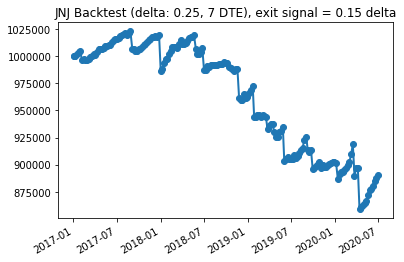

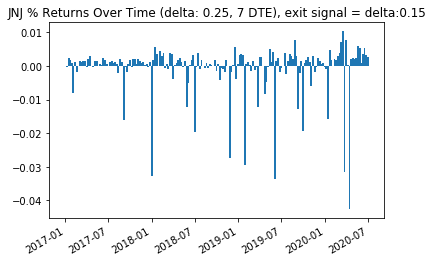

In [ ]:
jnj_delta_v2 = portfolio(ticker = 'JNJ',start_date = datetime(2017,1,2), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 7, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 7,roll_positions = False)
jnj_delta_v2.run_backtest()
plot_returns(jnj_delta_v2)

Date 2017-01-03 00:00:00, Expiry: 2017-01-20T00:00:00.000000000, Strike: 118.0, Underlying: 115.7, Delta: 0.246157
Bought back call (expiry 2017-01-20T00:00:00.000000000, strike = 118.0) on 2017-01-11 00:00:00 for 0.14
PNL 2017-01-03 00:00:00 = 1002541.0 (premium = 0.47, exit = 0.14)

Date 2017-01-17 00:00:00, Expiry: 2017-02-03T00:00:00.000000000, Strike: 118.0, Underlying: 114.77, Delta: 0.211229
Bought back call (expiry 2017-02-03T00:00:00.000000000, strike = 118.0) on 2017-01-18 00:00:00 for 0.36
PNL 2017-01-17 00:00:00 = 1003311.0 (premium = 0.46, exit = 0.36)

Date 2017-01-30 00:00:00, Expiry: 2017-02-10T00:00:00.000000000, Strike: 115.0, Underlying: 113.105, Delta: 0.214432
Bought back call (expiry 2017-02-10T00:00:00.000000000, strike = 115.0) on 2017-01-24 00:00:00 for 0.11
PNL 2017-01-30 00:00:00 = 1004620.0 (premium = 0.28, exit = 0.11)

Date 2017-02-13 00:00:00, Expiry: 2017-02-24T00:00:00.000000000, Strike: 117.0, Underlying: 115.835, Delta: 0.195544
Bought back call (expi

Date 2018-03-12 00:00:00, Expiry: 2018-03-23T00:00:00.000000000, Strike: 136.0, Underlying: 132.99, Delta: 0.208377
Bought back call (expiry 2018-03-23T00:00:00.000000000, strike = 136.0) on 2018-02-08 00:00:00 for 1.07
we lost money  PNL 2018-03-12 00:00:00 = 993916.995300293 (premium = 0.41, exit = 1.07)

Date 2018-03-26 00:00:00, Expiry: 2018-04-06T00:00:00.000000000, Strike: 131.0, Underlying: 127.52, Delta: 0.212073
Bought back call (expiry 2018-04-06T00:00:00.000000000, strike = 131.0) on 2018-03-23 00:00:00 for 0.35
PNL 2018-03-26 00:00:00 = 994994.995300293 (premium = 0.49, exit = 0.35)

Date 2018-04-09 00:00:00, Expiry: 2018-04-20T00:00:00.000000000, Strike: 134.0, Underlying: 130.26, Delta: 0.274778
Bought back call (expiry 2018-04-20T00:00:00.000000000, strike = 134.0) on 2018-03-23 00:00:00 for 0.62
PNL 2018-04-09 00:00:00 = 997612.995300293 (premium = 0.96, exit = 0.62)

Date 2018-04-23 00:00:00, Expiry: 2018-05-04T00:00:00.000000000, Strike: 130.0, Underlying: 126.75, Del

At expiry, underlying is 137.52000427246094 , strike is 139.0
PNL 2019-04-08 00:00:00 = 1019480.9929504395 (premium = 0.77, exit = 0)

Date 2019-04-22 00:00:00, Expiry: 2019-05-03T00:00:00.000000000, Strike: 140.0, Underlying: 137.63, Delta: 0.262253
Expired call (expiry 2019-05-03T00:00:00.000000000, strike = 140.0) on 2019-04-22 00:00:00
Strike was breached- At expiry, underlying is 142.00999450683594 , strike is 140.0
we lost money  PNL 2019-04-22 00:00:00 = 1008162.0352478027 (premium = 0.54, exit = 2.0099945068359375)

Date 2019-05-06 00:00:00, Expiry: 2019-05-17T00:00:00.000000000, Strike: 145.0, Underlying: 141.9, Delta: 0.227445
Bought back call (expiry 2019-05-17T00:00:00.000000000, strike = 145.0) on 2019-02-19 00:00:00 for 0.9
we lost money  PNL 2019-05-06 00:00:00 = 1005159.0352478027 (premium = 0.51, exit = 0.9)

Date 2019-05-20 00:00:00, Expiry: 2019-05-31T00:00:00.000000000, Strike: 140.0, Underlying: 138.31, Delta: 0.25317399999999995
Bought back call (expiry 2019-05-31

Date 2020-05-04 00:00:00, Expiry: 2020-05-15T00:00:00.000000000, Strike: 152.5, Underlying: 149.04, Delta: 0.297266
Bought back call (expiry 2020-05-15T00:00:00.000000000, strike = 152.5) on 2020-05-07 00:00:00 for 0.48
PNL 2020-05-04 00:00:00 = 909679.1245422363 (premium = 1.14, exit = 0.48)

Date 2020-05-18 00:00:00, Expiry: 2020-05-29T00:00:00.000000000, Strike: 155.0, Underlying: 151.27, Delta: 0.215794
Bought back call (expiry 2020-05-29T00:00:00.000000000, strike = 155.0) on 2020-04-09 00:00:00 for 1.65
we lost money  PNL 2020-05-18 00:00:00 = 902133.1245422363 (premium = 0.67, exit = 1.65)

Date 2020-06-01 00:00:00, Expiry: 2020-06-12T00:00:00.000000000, Strike: 150.0, Underlying: 147.18, Delta: 0.314202
Bought back call (expiry 2020-06-12T00:00:00.000000000, strike = 150.0) on 2020-05-27 00:00:00 for 0.61
PNL 2020-06-01 00:00:00 = 906137.1245422363 (premium = 1.13, exit = 0.61)

Date 2020-06-15 00:00:00, Expiry: 2020-06-26T00:00:00.000000000, Strike: 146.0, Underlying: 140.82, 

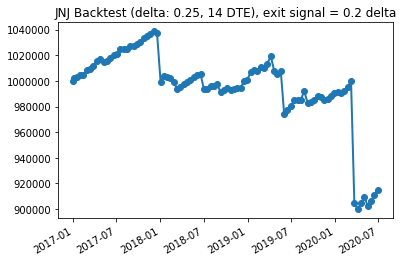

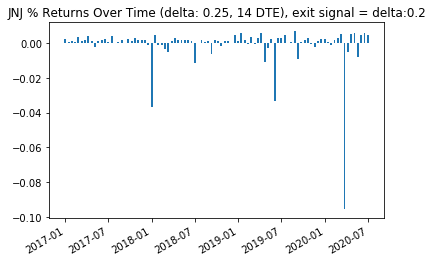

In [ ]:
jnj_delta_v2 = portfolio(ticker = 'JNJ',start_date = datetime(2017,1,2), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 14,frequency= 14, exit_signal = 'delta', exit_signal_val = 0.15, roll_positions = False)
jnj_delta_v2.run_backtest()
plot_returns(jnj_delta_v2)

Date 2017-01-03 00:00:00, Expiry: 2017-01-20T00:00:00.000000000, Strike: 118.0, Underlying: 115.7, Delta: 0.246157
Bought back call (expiry 2017-01-20T00:00:00.000000000, strike = 118.0) on 2017-01-11 00:00:00 for 0.14
PNL 2017-01-03 00:00:00 = 1002541.0 (premium = 0.47, exit = 0.14)

Date 2017-01-17 00:00:00, Expiry: 2017-02-03T00:00:00.000000000, Strike: 118.0, Underlying: 114.77, Delta: 0.211229
Bought back call (expiry 2017-02-03T00:00:00.000000000, strike = 118.0) on 2017-01-19 00:00:00 for 0.24
PNL 2017-01-17 00:00:00 = 1004235.0 (premium = 0.46, exit = 0.24)

Date 2017-01-30 00:00:00, Expiry: 2017-02-10T00:00:00.000000000, Strike: 115.0, Underlying: 113.105, Delta: 0.214432
Bought back call (expiry 2017-02-10T00:00:00.000000000, strike = 115.0) on 2017-01-24 00:00:00 for 0.11
PNL 2017-01-30 00:00:00 = 1005544.0 (premium = 0.28, exit = 0.11)

Date 2017-02-13 00:00:00, Expiry: 2017-02-24T00:00:00.000000000, Strike: 117.0, Underlying: 115.835, Delta: 0.195544
Bought back call (expi

Bought back call (expiry 2018-03-09T00:00:00.000000000, strike = 135.0) on 2018-02-21 00:00:00 for 0.22
PNL 2018-02-26 00:00:00 = 1023869.995300293 (premium = 0.44, exit = 0.22)

Date 2018-03-12 00:00:00, Expiry: 2018-03-23T00:00:00.000000000, Strike: 136.0, Underlying: 132.99, Delta: 0.208377
Bought back call (expiry 2018-03-23T00:00:00.000000000, strike = 136.0) on 2018-02-22 00:00:00 for 0.34
PNL 2018-03-12 00:00:00 = 1024408.995300293 (premium = 0.41, exit = 0.34)

Date 2018-03-26 00:00:00, Expiry: 2018-04-06T00:00:00.000000000, Strike: 131.0, Underlying: 127.52, Delta: 0.212073
Bought back call (expiry 2018-04-06T00:00:00.000000000, strike = 131.0) on 2018-03-23 00:00:00 for 0.35
PNL 2018-03-26 00:00:00 = 1025486.995300293 (premium = 0.49, exit = 0.35)

Date 2018-04-09 00:00:00, Expiry: 2018-04-20T00:00:00.000000000, Strike: 134.0, Underlying: 130.26, Delta: 0.274778
Bought back call (expiry 2018-04-20T00:00:00.000000000, strike = 134.0) on 2018-04-02 00:00:00 for 0.37
PNL 2018-04

Date 2019-04-08 00:00:00, Expiry: 2019-04-18T00:00:00.000000000, Strike: 139.0, Underlying: 135.94, Delta: 0.27215900000000004
Expired call (expiry 2019-04-18T00:00:00.000000000, strike = 139.0) on 2019-04-08 00:00:00
At expiry, underlying is 137.52000427246094 , strike is 139.0
PNL 2019-04-08 00:00:00 = 1065604.0399475098 (premium = 0.77, exit = 0)

Date 2019-04-22 00:00:00, Expiry: 2019-05-03T00:00:00.000000000, Strike: 140.0, Underlying: 137.63, Delta: 0.262253
Expired call (expiry 2019-05-03T00:00:00.000000000, strike = 140.0) on 2019-04-22 00:00:00
Strike was breached- At expiry, underlying is 142.00999450683594 , strike is 140.0
we lost money  PNL 2019-04-22 00:00:00 = 1054285.082244873 (premium = 0.54, exit = 2.0099945068359375)

Date 2019-05-06 00:00:00, Expiry: 2019-05-17T00:00:00.000000000, Strike: 145.0, Underlying: 141.9, Delta: 0.227445
Bought back call (expiry 2019-05-17T00:00:00.000000000, strike = 145.0) on 2019-02-20 00:00:00 for 0.36
PNL 2019-05-06 00:00:00 = 1055440.

Date 2020-04-20 00:00:00, Expiry: 2020-05-01T00:00:00.000000000, Strike: 157.5, Underlying: 152.46, Delta: 0.262771
Bought back call (expiry 2020-05-01T00:00:00.000000000, strike = 157.5) on 2020-04-09 00:00:00 for 0.55
PNL 2020-04-20 00:00:00 = 978671.1386413574 (premium = 1.18, exit = 0.55)

Date 2020-05-04 00:00:00, Expiry: 2020-05-15T00:00:00.000000000, Strike: 152.5, Underlying: 149.04, Delta: 0.297266
Bought back call (expiry 2020-05-15T00:00:00.000000000, strike = 152.5) on 2020-05-12 00:00:00 for 0.11
PNL 2020-05-04 00:00:00 = 986602.1386413574 (premium = 1.14, exit = 0.11)

Date 2020-05-18 00:00:00, Expiry: 2020-05-29T00:00:00.000000000, Strike: 155.0, Underlying: 151.27, Delta: 0.215794
Bought back call (expiry 2020-05-29T00:00:00.000000000, strike = 155.0) on 2020-05-12 00:00:00 for 0.28
PNL 2020-05-18 00:00:00 = 989605.1386413574 (premium = 0.67, exit = 0.28)

Date 2020-06-01 00:00:00, Expiry: 2020-06-12T00:00:00.000000000, Strike: 150.0, Underlying: 147.18, Delta: 0.314202

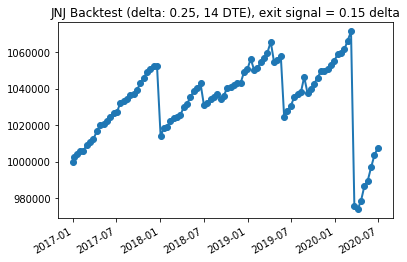

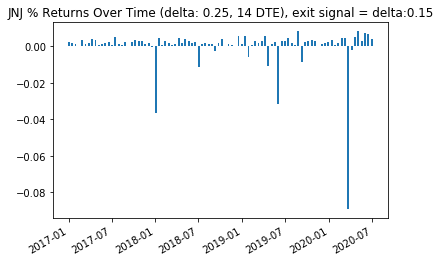

In [ ]:
jnj_delta_v2 = portfolio(ticker = 'JNJ',start_date = datetime(2017,1,2), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 14,frequency= 14, exit_signal = 'delta', exit_signal_val = 0.15, roll_positions = False)
jnj_delta_v2.run_backtest()
plot_returns(jnj_delta_v2)

Date 2017-01-03 00:00:00, Expiry: 2017-01-13T00:00:00.000000000, Strike: 118.0, Underlying: 115.7, Delta: 0.189899
Bought back call (expiry 2017-01-13T00:00:00.000000000, strike = 118.0) on 2016-12-01 00:00:00 for 0.24
PNL 2017-01-03 00:00:00 = 1000154.0 (premium = 0.26, exit = 0.24)

Date 2017-01-06 00:00:00, Expiry: 2017-01-13T00:00:00.000000000, Strike: 118.0, Underlying: 116.39, Delta: 0.225601
Bought back call (expiry 2017-01-13T00:00:00.000000000, strike = 118.0) on 2016-12-01 00:00:00 for 0.24
PNL 2017-01-06 00:00:00 = 1000385.0 (premium = 0.27, exit = 0.24)

Date 2017-01-12 00:00:00, Expiry: 2017-01-20T00:00:00.000000000, Strike: 116.0, Underlying: 114.598, Delta: 0.256193
Bought back call (expiry 2017-01-20T00:00:00.000000000, strike = 116.0) on 2017-01-18 00:00:00 for 0.04
PNL 2017-01-12 00:00:00 = 1002541.0 (premium = 0.32, exit = 0.04)

Date 2017-01-17 00:00:00, Expiry: 2017-01-27T00:00:00.000000000, Strike: 117.0, Underlying: 114.77, Delta: 0.261534
Bought back call (expir

Date 2017-06-01 00:00:00, Expiry: 2017-06-09T00:00:00.000000000, Strike: 130.0, Underlying: 128.47, Delta: 0.233975
Bought back call (expiry 2017-06-09T00:00:00.000000000, strike = 130.0) on 2017-04-27 00:00:00 for 0.1
PNL 2017-06-01 00:00:00 = 1034342.0070495605 (premium = 0.28, exit = 0.1)

Date 2017-06-06 00:00:00, Expiry: 2017-06-16T00:00:00.000000000, Strike: 133.0, Underlying: 130.955, Delta: 0.184787
Bought back call (expiry 2017-06-16T00:00:00.000000000, strike = 133.0) on 2017-05-22 00:00:00 for 0.05
PNL 2017-06-06 00:00:00 = 1035651.0070495605 (premium = 0.22, exit = 0.05)

Date 2017-06-12 00:00:00, Expiry: 2017-06-23T00:00:00.000000000, Strike: 134.0, Underlying: 131.78, Delta: 0.218445
Bought back call (expiry 2017-06-23T00:00:00.000000000, strike = 134.0) on 2017-05-04 00:00:00 for 0.01
PNL 2017-06-12 00:00:00 = 1038192.0070495605 (premium = 0.34, exit = 0.01)

Date 2017-06-16 00:00:00, Expiry: 2017-06-23T00:00:00.000000000, Strike: 136.0, Underlying: 134.295, Delta: 0.177

Date 2017-10-13 00:00:00, Expiry: 2017-10-20T00:00:00.000000000, Strike: 139.0, Underlying: 136.5, Delta: 0.25395700000000004
Bought back call (expiry 2017-10-20T00:00:00.000000000, strike = 139.0) on 2017-09-21 00:00:00 for 0.22
PNL 2017-10-13 00:00:00 = 1018557.1198425293 (premium = 0.55, exit = 0.22)

Date 2017-10-19 00:00:00, Expiry: 2017-10-27T00:00:00.000000000, Strike: 144.0, Underlying: 142.09, Delta: 0.207051
Bought back call (expiry 2017-10-27T00:00:00.000000000, strike = 144.0) on 2017-09-07 00:00:00 for 0.1
PNL 2017-10-19 00:00:00 = 1019789.1198425293 (premium = 0.26, exit = 0.1)

Date 2017-10-24 00:00:00, Expiry: 2017-11-03T00:00:00.000000000, Strike: 144.0, Underlying: 141.606, Delta: 0.209535
Bought back call (expiry 2017-11-03T00:00:00.000000000, strike = 144.0) on 2017-09-21 00:00:00 for 0.1
PNL 2017-10-24 00:00:00 = 1021560.1198425293 (premium = 0.33, exit = 0.1)

Date 2017-10-30 00:00:00, Expiry: 2017-11-10T00:00:00.000000000, Strike: 143.0, Underlying: 140.05, Delta

At expiry, underlying is 128.82000732421875 , strike is 132.0
PNL 2018-02-21 00:00:00 = 1015862.1950378418 (premium = 0.46, exit = 0)

Date 2018-02-26 00:00:00, Expiry: 2018-03-09T00:00:00.000000000, Strike: 135.0, Underlying: 131.97, Delta: 0.216055
Bought back call (expiry 2018-03-09T00:00:00.000000000, strike = 135.0) on 2018-02-21 00:00:00 for 0.22
PNL 2018-02-26 00:00:00 = 1017556.1950378418 (premium = 0.44, exit = 0.22)

Date 2018-03-02 00:00:00, Expiry: 2018-03-09T00:00:00.000000000, Strike: 131.0, Underlying: 129.07, Delta: 0.28636
Bought back call (expiry 2018-03-09T00:00:00.000000000, strike = 131.0) on 2018-03-06 00:00:00 for 0.09
PNL 2018-03-02 00:00:00 = 1021252.1950378418 (premium = 0.57, exit = 0.09)

Date 2018-03-08 00:00:00, Expiry: 2018-03-16T00:00:00.000000000, Strike: 134.0, Underlying: 131.47, Delta: 0.209863
Bought back call (expiry 2018-03-16T00:00:00.000000000, strike = 134.0) on 2018-03-01 00:00:00 for 0.32
PNL 2018-03-08 00:00:00 = 1021560.1950378418 (premium 

Strike was breached- At expiry, underlying is 125.93000030517578 , strike is 124.0
we lost money  PNL 2018-07-02 00:00:00 = 1033187.3336791992 (premium = 0.42, exit = 1.9300003051757812)

Date 2018-07-06 00:00:00, Expiry: 2018-07-13T00:00:00.000000000, Strike: 128.0, Underlying: 125.515, Delta: 0.20798200000000006
Bought back call (expiry 2018-07-13T00:00:00.000000000, strike = 128.0) on 2018-05-31 00:00:00 for 0.3
PNL 2018-07-06 00:00:00 = 1033418.3336791992 (premium = 0.33, exit = 0.3)

Date 2018-07-11 00:00:00, Expiry: 2018-07-20T00:00:00.000000000, Strike: 129.0, Underlying: 126.38, Delta: 0.285215
Bought back call (expiry 2018-07-20T00:00:00.000000000, strike = 129.0) on 2018-06-18 00:00:00 for 0.29
PNL 2018-07-11 00:00:00 = 1036883.3336791992 (premium = 0.74, exit = 0.29)

Date 2018-07-16 00:00:00, Expiry: 2018-07-27T00:00:00.000000000, Strike: 128.0, Underlying: 124.5, Delta: 0.221662
Bought back call (expiry 2018-07-27T00:00:00.000000000, strike = 128.0) on 2018-07-02 00:00:00 

Bought back call (expiry 2018-11-23T00:00:00.000000000, strike = 147.0) on 2018-10-11 00:00:00 for 0.36
PNL 2018-11-13 00:00:00 = 1041888.3618774414 (premium = 0.56, exit = 0.36)

Date 2018-11-19 00:00:00, Expiry: 2018-11-30T00:00:00.000000000, Strike: 150.0, Underlying: 147.76, Delta: 0.218209
Bought back call (expiry 2018-11-30T00:00:00.000000000, strike = 150.0) on 2018-10-11 00:00:00 for 0.31
PNL 2018-11-19 00:00:00 = 1042812.3618774414 (premium = 0.43, exit = 0.31)

Date 2018-11-23 00:00:00, Expiry: 2018-11-30T00:00:00.000000000, Strike: 144.0, Underlying: 142.23, Delta: 0.242762
Bought back call (expiry 2018-11-30T00:00:00.000000000, strike = 144.0) on 2018-11-26 00:00:00 for 0.19
PNL 2018-11-23 00:00:00 = 1045122.3618774414 (premium = 0.49, exit = 0.19)

Date 2018-11-28 00:00:00, Expiry: 2018-12-07T00:00:00.000000000, Strike: 149.0, Underlying: 146.017, Delta: 0.215444
Bought back call (expiry 2018-12-07T00:00:00.000000000, strike = 149.0) on 2018-10-25 00:00:00 for 0.4
PNL 2018

Expired call (expiry 2019-04-18T00:00:00.000000000, strike = 139.0) on 2019-04-08 00:00:00
At expiry, underlying is 137.52000427246094 , strike is 139.0
PNL 2019-04-08 00:00:00 = 1086625.4088745117 (premium = 0.77, exit = 0)

Date 2019-04-12 00:00:00, Expiry: 2019-04-18T00:00:00.000000000, Strike: 139.0, Underlying: 135.97, Delta: 0.25991
Expired call (expiry 2019-04-18T00:00:00.000000000, strike = 139.0) on 2019-04-12 00:00:00
At expiry, underlying is 137.52000427246094 , strike is 139.0
PNL 2019-04-12 00:00:00 = 1091938.4088745117 (premium = 0.69, exit = 0)

Date 2019-04-17 00:00:00, Expiry: 2019-04-26T00:00:00.000000000, Strike: 141.0, Underlying: 138.86, Delta: 0.287166
Bought back call (expiry 2019-04-26T00:00:00.000000000, strike = 141.0) on 2019-04-09 00:00:00 for 0.35
PNL 2019-04-17 00:00:00 = 1094094.4088745117 (premium = 0.63, exit = 0.35)

Date 2019-04-22 00:00:00, Expiry: 2019-05-03T00:00:00.000000000, Strike: 140.0, Underlying: 137.63, Delta: 0.262253
Expired call (expiry 

At expiry, underlying is 128.2100067138672 , strike is 130.0
PNL 2019-08-30 00:00:00 = 1119658.3712768555 (premium = 0.44, exit = 0)

Date 2019-09-04 00:00:00, Expiry: 2019-09-13T00:00:00.000000000, Strike: 131.0, Underlying: 128.67, Delta: 0.251606
Bought back call (expiry 2019-09-13T00:00:00.000000000, strike = 131.0) on 2019-09-09 00:00:00 for 0.05
PNL 2019-09-04 00:00:00 = 1123046.3712768555 (premium = 0.49, exit = 0.05)

Date 2019-09-09 00:00:00, Expiry: 2019-09-20T00:00:00.000000000, Strike: 130.0, Underlying: 126.79, Delta: 0.22077800000000006
Expired call (expiry 2019-09-20T00:00:00.000000000, strike = 130.0) on 2019-09-09 00:00:00
Strike was breached- At expiry, underlying is 131.64999389648438 , strike is 130.0
we lost money  PNL 2019-09-09 00:00:00 = 1114114.4182739258 (premium = 0.49, exit = 1.649993896484375)

Date 2019-09-13 00:00:00, Expiry: 2019-09-20T00:00:00.000000000, Strike: 133.0, Underlying: 130.68, Delta: 0.199749
Bought back call (expiry 2019-09-20T00:00:00.0000

Strike was breached- At expiry, underlying is 148.32000732421875 , strike is 148.0
PNL 2020-01-13 00:00:00 = 1108878.3430786133 (premium = 0.77, exit = 0.32000732421875)

Date 2020-01-17 00:00:00, Expiry: 2020-01-24T00:00:00.000000000, Strike: 152.5, Underlying: 149.04, Delta: 0.186669
Bought back call (expiry 2020-01-24T00:00:00.000000000, strike = 152.5) on 2019-12-05 00:00:00 for 0.2
PNL 2020-01-17 00:00:00 = 1110264.3430786133 (premium = 0.38, exit = 0.2)

Date 2020-01-22 00:00:00, Expiry: 2020-01-31T00:00:00.000000000, Strike: 150.0, Underlying: 148.36, Delta: 0.351896
Bought back call (expiry 2020-01-31T00:00:00.000000000, strike = 150.0) on 2019-12-12 00:00:00 for 0.55
PNL 2020-01-22 00:00:00 = 1113113.3430786133 (premium = 0.92, exit = 0.55)

Date 2020-01-27 00:00:00, Expiry: 2020-02-07T00:00:00.000000000, Strike: 152.5, Underlying: 148.69, Delta: 0.211378
Bought back call (expiry 2020-02-07T00:00:00.000000000, strike = 152.5) on 2020-01-03 00:00:00 for 0.41
PNL 2020-01-27 00:0

Date 2020-06-05 00:00:00, Expiry: 2020-06-12T00:00:00.000000000, Strike: 150.0, Underlying: 147.4, Delta: 0.255805
Bought back call (expiry 2020-06-12T00:00:00.000000000, strike = 150.0) on 2020-06-09 00:00:00 for 0.19
PNL 2020-06-05 00:00:00 = 1077847.3242797852 (premium = 0.57, exit = 0.19)

Date 2020-06-10 00:00:00, Expiry: 2020-06-19T00:00:00.000000000, Strike: 152.5, Underlying: 148.1, Delta: 0.243037
Bought back call (expiry 2020-06-19T00:00:00.000000000, strike = 152.5) on 2020-05-27 00:00:00 for 0.55
PNL 2020-06-10 00:00:00 = 1080157.3242797852 (premium = 0.85, exit = 0.55)

Date 2020-06-15 00:00:00, Expiry: 2020-06-26T00:00:00.000000000, Strike: 146.0, Underlying: 140.82, Delta: 0.240819
Bought back call (expiry 2020-06-26T00:00:00.000000000, strike = 146.0) on 2020-06-24 00:00:00 for 0.1
PNL 2020-06-15 00:00:00 = 1086856.3242797852 (premium = 0.97, exit = 0.1)

Date 2020-06-19 00:00:00, Expiry: 2020-06-26T00:00:00.000000000, Strike: 148.0, Underlying: 144.36, Delta: 0.228003


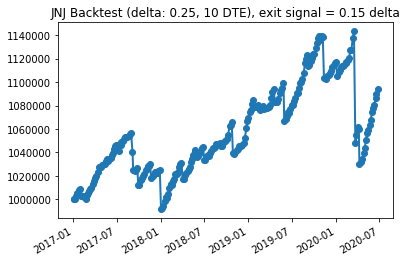

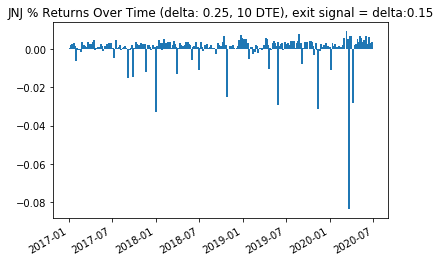

In [ ]:
jnj_delta_v2 = portfolio(ticker = 'JNJ',start_date = datetime(2017,1,2), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 10,frequency= 5, exit_signal = 'delta', exit_signal_val = 0.15, roll_positions = False)
jnj_delta_v2.run_backtest()
plot_returns(jnj_delta_v2)

Date 2017-01-06 00:00:00, Expiry: 2017-01-13T00:00:00.000000000, Strike: 118.0, Underlying: 116.39, Delta: 0.225601
Bought back call (expiry 2017-01-13T00:00:00.000000000, strike = 118.0) on 2016-12-01 00:00:00 for 0.24
PNL 2017-01-06 00:00:00 = 1000231.0 (premium = 0.27, exit = 0.24)

Date 2017-01-17 00:00:00, Expiry: 2017-01-27T00:00:00.000000000, Strike: 117.0, Underlying: 114.77, Delta: 0.261534
Bought back call (expiry 2017-01-27T00:00:00.000000000, strike = 117.0) on 2017-01-20 00:00:00 for 0.2
PNL 2017-01-17 00:00:00 = 1002695.0 (premium = 0.52, exit = 0.2)

Date 2017-01-27 00:00:00, Expiry: 2017-02-03T00:00:00.000000000, Strike: 114.0, Underlying: 113.14, Delta: 0.305095
Bought back call (expiry 2017-02-03T00:00:00.000000000, strike = 114.0) on 2017-01-24 00:00:00 for 0.14
PNL 2017-01-27 00:00:00 = 1004004.0 (premium = 0.31, exit = 0.14)

Date 2017-02-06 00:00:00, Expiry: 2017-02-17T00:00:00.000000000, Strike: 115.0, Underlying: 113.36, Delta: 0.175742
Bought back call (expiry 

Date 2017-10-24 00:00:00, Expiry: 2017-11-03T00:00:00.000000000, Strike: 144.0, Underlying: 141.606, Delta: 0.209535
Bought back call (expiry 2017-11-03T00:00:00.000000000, strike = 144.0) on 2017-09-21 00:00:00 for 0.1
PNL 2017-10-24 00:00:00 = 1027874.0798950195 (premium = 0.33, exit = 0.1)

Date 2017-11-03 00:00:00, Expiry: 2017-11-10T00:00:00.000000000, Strike: 142.0, Underlying: 139.93, Delta: 0.185165
Bought back call (expiry 2017-11-10T00:00:00.000000000, strike = 142.0) on 2017-09-28 00:00:00 for 0.09
PNL 2017-11-03 00:00:00 = 1028952.0798950195 (premium = 0.23, exit = 0.09)

Date 2017-11-13 00:00:00, Expiry: 2017-11-24T00:00:00.000000000, Strike: 142.0, Underlying: 139.79, Delta: 0.21337
Bought back call (expiry 2017-11-24T00:00:00.000000000, strike = 142.0) on 2017-10-05 00:00:00 for 0.26
we lost money  PNL 2017-11-13 00:00:00 = 1028798.0798950195 (premium = 0.24, exit = 0.26)

Date 2017-11-22 00:00:00, Expiry: 2017-12-01T00:00:00.000000000, Strike: 138.0, Underlying: 137.35,

Strike was breached- At expiry, underlying is 125.93000030517578 , strike is 124.0
we lost money  PNL 2018-07-02 00:00:00 = 992839.2561340332 (premium = 0.42, exit = 1.9300003051757812)

Date 2018-07-11 00:00:00, Expiry: 2018-07-20T00:00:00.000000000, Strike: 129.0, Underlying: 126.38, Delta: 0.285215
Bought back call (expiry 2018-07-20T00:00:00.000000000, strike = 129.0) on 2018-06-18 00:00:00 for 0.29
PNL 2018-07-11 00:00:00 = 996304.2561340332 (premium = 0.74, exit = 0.29)

Date 2018-07-20 00:00:00, Expiry: 2018-07-27T00:00:00.000000000, Strike: 128.0, Underlying: 125.85, Delta: 0.19502
Bought back call (expiry 2018-07-27T00:00:00.000000000, strike = 128.0) on 2018-07-02 00:00:00 for 0.4
we lost money  PNL 2018-07-20 00:00:00 = 995226.2561340332 (premium = 0.26, exit = 0.4)

Date 2018-07-30 00:00:00, Expiry: 2018-08-10T00:00:00.000000000, Strike: 135.0, Underlying: 132.05, Delta: 0.212704
Bought back call (expiry 2018-08-10T00:00:00.000000000, strike = 135.0) on 2018-06-28 00:00:00 

Date 2019-04-08 00:00:00, Expiry: 2019-04-18T00:00:00.000000000, Strike: 139.0, Underlying: 135.94, Delta: 0.27215900000000004
Expired call (expiry 2019-04-18T00:00:00.000000000, strike = 139.0) on 2019-04-08 00:00:00
At expiry, underlying is 137.52000427246094 , strike is 139.0
PNL 2019-04-08 00:00:00 = 1002695.3313293457 (premium = 0.77, exit = 0)

Date 2019-04-17 00:00:00, Expiry: 2019-04-26T00:00:00.000000000, Strike: 141.0, Underlying: 138.86, Delta: 0.287166
Bought back call (expiry 2019-04-26T00:00:00.000000000, strike = 141.0) on 2019-04-09 00:00:00 for 0.35
PNL 2019-04-17 00:00:00 = 1004851.3313293457 (premium = 0.63, exit = 0.35)

Date 2019-04-26 00:00:00, Expiry: 2019-05-03T00:00:00.000000000, Strike: 142.0, Underlying: 140.22, Delta: 0.255175
Bought back call (expiry 2019-05-03T00:00:00.000000000, strike = 142.0) on 2019-04-11 00:00:00 for 0.31
PNL 2019-04-26 00:00:00 = 1005467.3313293457 (premium = 0.39, exit = 0.31)

Date 2019-05-07 00:00:00, Expiry: 2019-05-17T00:00:00.0

Strike was breached- At expiry, underlying is 148.32000732421875 , strike is 148.0
PNL 2020-01-13 00:00:00 = 1030338.2420349121 (premium = 0.77, exit = 0.32000732421875)

Date 2020-01-22 00:00:00, Expiry: 2020-01-31T00:00:00.000000000, Strike: 150.0, Underlying: 148.36, Delta: 0.351896
Bought back call (expiry 2020-01-31T00:00:00.000000000, strike = 150.0) on 2019-12-12 00:00:00 for 0.55
PNL 2020-01-22 00:00:00 = 1033187.2420349121 (premium = 0.92, exit = 0.55)

Date 2020-01-31 00:00:00, Expiry: 2020-02-07T00:00:00.000000000, Strike: 152.5, Underlying: 148.93, Delta: 0.189528
Bought back call (expiry 2020-02-07T00:00:00.000000000, strike = 152.5) on 2020-01-03 00:00:00 for 0.41
we lost money  PNL 2020-01-31 00:00:00 = 1033110.2420349121 (premium = 0.4, exit = 0.41)

Date 2020-02-11 00:00:00, Expiry: 2020-02-21T00:00:00.000000000, Strike: 155.0, Underlying: 151.99, Delta: 0.191107
Bought back call (expiry 2020-02-21T00:00:00.000000000, strike = 155.0) on 2019-11-19 00:00:00 for 0.13
PNL

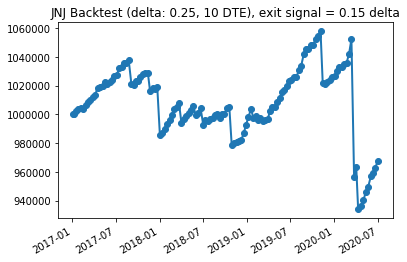

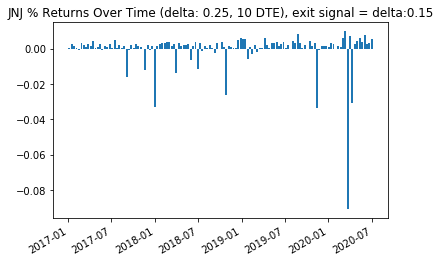

In [ ]:
jnj_delta_v2 = portfolio(ticker = 'JNJ',start_date = datetime(2017,1,7), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 10,frequency= 10, exit_signal = 'delta', exit_signal_val = 0.15, roll_positions = False)
jnj_delta_v2.run_backtest()
plot_returns(jnj_delta_v2)

Date 2015-01-08 00:00:00, Expiry: 2015-01-23T00:00:00.000000000, Strike: 108.0, Underlying: 106.28, Delta: 0.29866
Bought back call (expiry 2015-01-23T00:00:00.000000000, strike = 108.0) on 2015-01-05 00:00:00 for 0.21
PNL 2015-01-08 00:00:00 = 1002926.0 (premium = 0.59, exit = 0.21)

Date 2015-01-22 00:00:00, Expiry: 2015-02-06T00:00:00.000000000, Strike: 106.0, Underlying: 103.625, Delta: 0.196348
Bought back call (expiry 2015-02-06T00:00:00.000000000, strike = 106.0) on 2015-01-20 00:00:00 for 0.2
PNL 2015-01-22 00:00:00 = 1003619.0 (premium = 0.29, exit = 0.2)

Date 2015-02-05 00:00:00, Expiry: 2015-02-20T00:00:00.000000000, Strike: 104.0, Underlying: 102.39, Delta: 0.277539
Bought back call (expiry 2015-02-20T00:00:00.000000000, strike = 104.0) on 2015-02-06 00:00:00 for 0.16
PNL 2015-02-05 00:00:00 = 1006545.0 (premium = 0.54, exit = 0.16)

Date 2015-02-19 00:00:00, Expiry: 2015-03-06T00:00:00.000000000, Strike: 102.0, Underlying: 100.7, Delta: 0.214795
Bought back call (expiry 2

Strike was breached- At expiry, underlying is 100.54000091552734 , strike is 99.0
we lost money  PNL 2016-01-21 00:00:00 = 1006775.9859008789 (premium = 0.58, exit = 1.5400009155273438)

Date 2016-02-04 00:00:00, Expiry: 2016-02-19T00:00:00.000000000, Strike: 107.0, Underlying: 103.94, Delta: 0.217799
Bought back call (expiry 2016-02-19T00:00:00.000000000, strike = 107.0) on 2016-01-19 00:00:00 for 0.04
PNL 2016-02-04 00:00:00 = 1010394.9859008789 (premium = 0.51, exit = 0.04)

Date 2016-02-18 00:00:00, Expiry: 2016-03-04T00:00:00.000000000, Strike: 106.0, Underlying: 104.1, Delta: 0.21084
Bought back call (expiry 2016-03-04T00:00:00.000000000, strike = 106.0) on 2016-01-21 00:00:00 for 0.06
PNL 2016-02-18 00:00:00 = 1012704.9859008789 (premium = 0.36, exit = 0.06)

Date 2016-03-03 00:00:00, Expiry: 2016-03-18T00:00:00.000000000, Strike: 109.0, Underlying: 106.81, Delta: 0.204343
Bought back call (expiry 2016-03-18T00:00:00.000000000, strike = 109.0) on 2016-02-22 00:00:00 for 0.25
PNL

Date 2017-03-16 00:00:00, Expiry: 2017-03-31T00:00:00.000000000, Strike: 130.0, Underlying: 128.2, Delta: 0.256256
Bought back call (expiry 2017-03-31T00:00:00.000000000, strike = 130.0) on 2017-02-24 00:00:00 for 0.09
PNL 2017-03-16 00:00:00 = 1019557.9624023438 (premium = 0.4, exit = 0.09)

Date 2017-03-30 00:00:00, Expiry: 2017-04-13T00:00:00.000000000, Strike: 126.0, Underlying: 124.586, Delta: 0.296096
Bought back call (expiry 2017-04-13T00:00:00.000000000, strike = 126.0) on 2017-04-10 00:00:00 for 0.08
PNL 2017-03-30 00:00:00 = 1022406.9624023438 (premium = 0.45, exit = 0.08)

Date 2017-04-13 00:00:00, Expiry: 2017-04-28T00:00:00.000000000, Strike: 128.0, Underlying: 125.3, Delta: 0.248819
Bought back call (expiry 2017-04-28T00:00:00.000000000, strike = 128.0) on 2017-04-18 00:00:00 for 0.01
PNL 2017-04-13 00:00:00 = 1026641.9624023438 (premium = 0.56, exit = 0.01)

Date 2017-04-27 00:00:00, Expiry: 2017-05-12T00:00:00.000000000, Strike: 125.0, Underlying: 123.61, Delta: 0.30505

Bought back call (expiry 2018-05-25T00:00:00.000000000, strike = 128.0) on 2018-05-03 00:00:00 for 0.38
PNL 2018-05-10 00:00:00 = 1002541.1174926758 (premium = 0.6, exit = 0.38)

Date 2018-05-24 00:00:00, Expiry: 2018-06-08T00:00:00.000000000, Strike: 124.0, Underlying: 122.1, Delta: 0.22507600000000005
Bought back call (expiry 2018-06-08T00:00:00.000000000, strike = 124.0) on 2018-05-29 00:00:00 for 0.16
PNL 2018-05-24 00:00:00 = 1004620.1174926758 (premium = 0.43, exit = 0.16)

Date 2018-06-07 00:00:00, Expiry: 2018-06-22T00:00:00.000000000, Strike: 126.0, Underlying: 123.09, Delta: 0.219458
Bought back call (expiry 2018-06-22T00:00:00.000000000, strike = 126.0) on 2018-05-29 00:00:00 for 0.25
PNL 2018-06-07 00:00:00 = 1006006.1174926758 (premium = 0.43, exit = 0.25)

Date 2018-06-21 00:00:00, Expiry: 2018-07-06T00:00:00.000000000, Strike: 124.0, Underlying: 121.15, Delta: 0.24042
Bought back call (expiry 2018-07-06T00:00:00.000000000, strike = 124.0) on 2018-07-02 00:00:00 for 0.06


Bought back call (expiry 2019-07-05T00:00:00.000000000, strike = 145.0) on 2019-05-28 00:00:00 for 0.43
PNL 2019-06-20 00:00:00 = 1060907.1785888672 (premium = 0.49, exit = 0.43)

Date 2019-07-03 00:00:00, Expiry: 2019-07-19T00:00:00.000000000, Strike: 145.0, Underlying: 142.02, Delta: 0.279776
Bought back call (expiry 2019-07-19T00:00:00.000000000, strike = 145.0) on 2019-01-24 00:00:00 for 1.0
we lost money  PNL 2019-07-03 00:00:00 = 1059444.1785888672 (premium = 0.81, exit = 1.0)

Date 2019-07-18 00:00:00, Expiry: 2019-08-02T00:00:00.000000000, Strike: 135.0, Underlying: 131.85, Delta: 0.259752
Bought back call (expiry 2019-08-02T00:00:00.000000000, strike = 135.0) on 2019-07-22 00:00:00 for 0.13
PNL 2019-07-18 00:00:00 = 1063833.1785888672 (premium = 0.7, exit = 0.13)

Date 2019-08-01 00:00:00, Expiry: 2019-08-16T00:00:00.000000000, Strike: 134.0, Underlying: 130.19, Delta: 0.223757
Bought back call (expiry 2019-08-16T00:00:00.000000000, strike = 134.0) on 2019-08-14 00:00:00 for 0

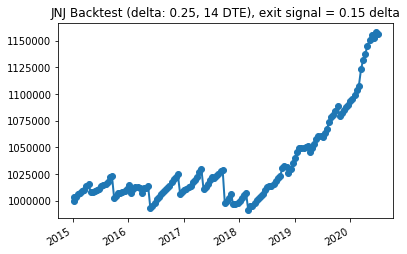

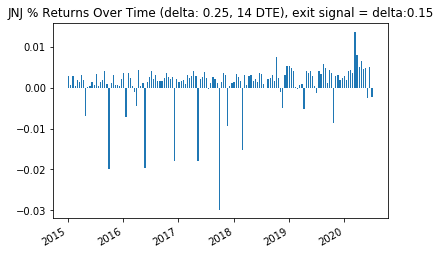

In [ ]:
jnj_delta_v2 = portfolio(ticker = 'JNJ',start_date = datetime(2015,1,8), strike_signal = 'delta', strike_signal_val = 0.25, dte_sell = 14, exit_signal = 'delta', exit_signal_val = 0.15, frequency= 14,roll_positions = False)
jnj_delta_v2.run_backtest()
plot_returns(jnj_delta_v2)

At expiry, underlying is 129.75 , strike is 134.0
PNL 2019-01-02 00:00:00 = 1001155.0 (premium = 0.15, exit = 0)
At expiry, underlying is 130.69000244140625 , strike is 136.0
PNL 2019-01-11 00:00:00 = 1001309.0 (premium = 0.02, exit = 0)
At expiry, underlying is 134.1999969482422 , strike is 134.0
We should lose money
PNL 2019-01-22 00:00:00 = 1000693.0234985352 (premium = 0.12, exit = 0.1999969482421875)
At expiry, underlying is 132.39999389648438 , strike is 141.0
PNL 2019-02-01 00:00:00 = 1000770.0234985352 (premium = 0.01, exit = 0)
At expiry, underlying is 136.60000610351562 , strike is 138.0
PNL 2019-02-11 00:00:00 = 1001001.0234985352 (premium = 0.03, exit = 0)
At expiry, underlying is 138.35000610351562 , strike is 141.0
PNL 2019-02-21 00:00:00 = 1001078.0234985352 (premium = 0.01, exit = 0)
At expiry, underlying is 137.60000610351562 , strike is 145.0
PNL 2019-03-04 00:00:00 = 1001386.0234985352 (premium = 0.04, exit = 0)
At expiry, underlying is 136.91000366210938 , strike is

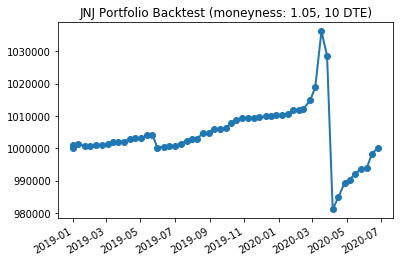

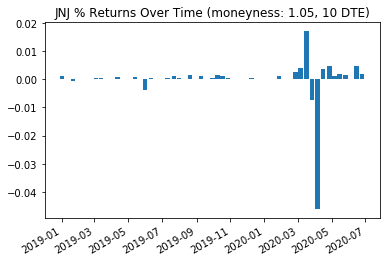

In [ ]:
JNJ = portfolio(ticker = 'JNJ', strike_signal = 'moneyness', strike_signal_val = 1.05, dte_sell = 10, frequency= 10)
JNJ.run_backtest()
plot_returns(JNJ)

In [ ]:
date_filter = (df['trade_date']== datetime(2019,1,2))
start = time.time()
nearest_expiry = nearest(unique(df[date_filter]['expirDate'].values), date + timedelta(days=15))
end = time.time()
expiry_filter = df['expirDate'] == nearest_expiry
liquidity_filter = df['cValue'] > 0

nearest_delta = nearest(df[date_filter & expiry_filter & liquidity_filter]['delta'].values, 0.3)
delta_filter = df['delta'] == nearest_delta
nearest_strike = df[date_filter & expiry_filter & liquidity_filter & delta_filter]['strike'].values[0]
strike_filter = df['strike'] == nearest_strike
# print(nearest_delta,nearest_strike)
df[date_filter & expiry_filter & liquidity_filter & delta_filter]['strike'].values[0]
df[date_filter & expiry_filter & liquidity_filter][['trade_date','strike','delta']]
exit_signal_filter = (df['delta'] < 0.2)
print(df[expiry_filter & liquidity_filter & strike_filter & exit_signal_filter][['trade_date','strike','delta']])

exceeded_limit = df[expiry_filter & liquidity_filter & strike_filter & exit_signal_filter][['trade_date','strike','delta','cValue','strike']]
if len(exceeded_limit) > 0:
    print(exceeded_limit.iloc[0])
    print(exceeded_limit['cValue'].iloc[0])


     trade_date  strike     delta
4063 2019-01-14   131.0  0.185889
4973 2019-01-16   131.0  0.066242
trade_date    2019-01-14 00:00:00
strike                        131
delta                    0.185889
cValue                       0.28
strike                        131
Name: 4063, dtype: object
0.28


In [ ]:
df = pd.read_csv(f'C:/Users/Michael Nguyen/Google Drive/Shared Drive/Lavaca Capital/Historical Options Data/JNJ 2013-Present with 2018.csv')
df['trade_date'] = pd.to_datetime(df['trade_date'])

In [ ]:
data = {'[Entry,Exit]':[[.1,0]],7:[0]}
df = pd.DataFrame(data)
for i in [7,10,15,20,25,30,40]:
    df[i] = [random.randint(1,100)]
for i in range(1,5):
    data = {f'[Entry,Exit]':[[round(0.05*i+0.15,2),round(0.05*i+0.05,2)]]}
    df2 = pd.DataFrame(data)
    for i in [7,10,15,20,25,30,40]:
        df2[i] = [np.float(random.randint(1,100))]
    df = pd.concat([df,df2],ignore_index = True)
df.set_index('[Entry,Exit]')

for index, row in df.iterrows():
    x,entry_exit = list(row.iteritems())[0]
    entry = entry_exit[0]
    exit = entry_exit[1]
    print(entry,exit)
    for columnName, columnData in list(row.iteritems())[1:]:
        print(entry,exit,columnName,'=',df.iloc[index][columnName],end = '|')

print()

df.head()

,"[Entry,Exit]",7,10,15,20,25,30,40
0,"[0.1, 0]",70.0,58.0,71.0,1.0,65.0,92.0,22.0
1,"[0.2, 0.1]",98.0,70.0,11.0,34.0,39.0,84.0,35.0
2,"[0.25, 0.15]",10.0,98.0,86.0,48.0,53.0,25.0,18.0
3,"[0.3, 0.2]",2.0,4.0,11.0,37.0,30.0,56.0,70.0
4,"[0.35, 0.25]",79.0,9.0,34.0,13.0,97.0,59.0,70.0


In [ ]:
pdr.get_data_yahoo("JNJ", start="2019-10-17", end="2019-10-17")['Close'].values[0]

136.1699981689453

In [ ]:
date = trade_dates[0]
moneyness = 1
dte = 15

date_filter = (df['trade_date']== date)

# Given the dataframe, only look at data for a given date. With that dataframe, look at the available expiries and find the one that is closest to our intended period
nearest_expiry = nearest(df[date_filter]['expirDate'].unique(), date + timedelta(days=dte))
print(f'The closest expiry to {date + timedelta(days=dte)} is {nearest_expiry}')
expiry_filter = (df['expirDate'] == nearest_expiry)

# Given the smaller dataframe, record all of the available strikes. Then, find the strike that is closest to underlying * moneyness
nearest_strike = nearest(df[date_filter & expiry_filter]['strike'].unique(), df[date_filter & expiry_filter]['stkPx'].iloc[0] * moneyness)
print(f'The closest strike to {df[date_filter & expiry_filter]["stkPx"].iloc[0]}*{moneyness} is {nearest_strike}')
strike_filter = (df['strike'] == nearest_strike)

The closest expiry to 2019-01-17 00:00:00 is 2019-01-18T00:00:00.000000000
The closest strike to 127.54*1 is 128.0


In [ ]:
trade_dates = [pd.to_datetime(x) for x in np.unique(df['trade_date'].values)]

In [ ]:
# dates = list(unique(df['trade_date'].values))
# dates.append(dates[0])
# pd.unique((df.Date).dt.strftime('%d-%m-%y'))
pd.to_datetime(df['trade_date']).dt.date.unique().tolist()

[datetime.date(2019, 1, 2),
 datetime.date(2019, 1, 3),
 datetime.date(2019, 1, 4),
 datetime.date(2019, 1, 7),
 datetime.date(2019, 1, 8),
 datetime.date(2019, 1, 9),
 datetime.date(2019, 1, 10),
 datetime.date(2019, 1, 11),
 datetime.date(2019, 1, 14),
 datetime.date(2019, 1, 15),
 datetime.date(2019, 1, 16),
 datetime.date(2019, 1, 17),
 datetime.date(2019, 1, 18),
 datetime.date(2019, 1, 22),
 datetime.date(2019, 1, 23),
 datetime.date(2019, 1, 24),
 datetime.date(2019, 1, 25),
 datetime.date(2019, 1, 28),
 datetime.date(2019, 1, 29),
 datetime.date(2019, 1, 30),
 datetime.date(2019, 1, 31),
 datetime.date(2019, 2, 1),
 datetime.date(2019, 2, 4),
 datetime.date(2019, 2, 5),
 datetime.date(2019, 2, 6),
 datetime.date(2019, 2, 7),
 datetime.date(2019, 2, 8),
 datetime.date(2019, 2, 11),
 datetime.date(2019, 2, 12),
 datetime.date(2019, 2, 13),
 datetime.date(2019, 2, 14),
 datetime.date(2019, 2, 15),
 datetime.date(2019, 2, 19),
 datetime.date(2019, 2, 20),
 datetime.date(2019, 2, 21

In [ ]:
small_df = df[expiry_filter & strike_filter & date_filter]
small_df[['trade_date', 'ticker', 'stkPx', 'expirDate', 'strike', 'cVolu', 'cOi', 'cBidPx', 'cValue', 'cAskPx', 'cBidIv', 'cMidIv', 'cAskIv']]

def strategy_test(start_date = datetime(2020,7,1), end_date = datetime(2020,8,10),s_moniness = 0.10, dte_open = 30, dte_close = 0, outsize_signal = none):
      for date in df:
        pass
      # buy option with expiry closest to date + dte_open
      # subtract option with expiry closest to date + dte_close (close position/buy back position)
PNL = 100000
start_date = datetime(2020,7,1)
end_date = datetime(2020,8,10)
s_moniness = 0.10
dte_open = 30
dte_close = 0
outsize_signal = None

def sell_call(df, date, dte, moneyness, call_price = 'cValue'):
    # Given the dataframe, only look at data for a given date. With that dataframe, look at the available expiries and find the one that is closest to our intended period
    nearest_expiry = nearest(df[date_filter]['expirDate'].unique(), date + datetime.timedelta(days=dte))
    print(f'The closest expiry to {date + datetime.timedelta(days=dte)} is {nearest_expiry}')
    expiry_filter = (df['expirDate'] == nearest_expiry)

    # Given the smaller dataframe, record all of the available strikes. Then, find the strike that is closest to underlying * moneyness
    nearest_strike = nearest(df[date_filter & expiry_filter]['strike'].unique(), df[date_filter & expiry_filter]['stkPx'].iloc[0] * moneyness)
    print(f'The closest strike to {df[date_filter & expiry_filter]["stkPx"].iloc[0]}*{moneyness} is {nearest_strike}')
    strike_filter = (df['strike'] == nearest_strike)
    
    
    if call_price == 'cAskPx':
        return df[expiry_filter & strike_filter & date_filter]['cAskPx'].values[0]
    if call_price == 'cBidPx':
        return df[expiry_filter & strike_filter & date_filter]['cBidPx'].values[0]
    else:
        return df[expiry_filter & strike_filter & date_filter]['cValue'].values[0]

In [ ]:
# We should implement a maximum credit (lots of options have deltas of 1)
# Add feature to sell another call with the same delta and continue to do so until we're even
# Use eval so that we can set credit_premium to be a fixed value (0.05) or a multiplier (0.5 or 1.5)

available_premiums = df[df['trade_date'] == datetime(2016,1,4)]['cValue']
print(available_premiums)
credit = 1
credit_filter = df['cValue'] > credit
date_filter = df['trade_date'] == datetime(2016,1,4)
dte_sell = 14
small_df = df[date_filter & credit_filter][['trade_date','expirDate','ticker','stkPx',"strike",'cValue', 'delta']]
small_df['expirDate'] = pd.to_datetime(small_df['expirDate'])
small_df['trade_date'] = pd.to_datetime(small_df['trade_date'])
print(available_expiries)
available_expiries = pd.to_datetime(small_df["expirDate"].map(pd.Timestamp.date).unique())
nearest_expiry = nearest(available_expiries, datetime(2016,1,4)+timedelta(days = dte_sell))
expiry_filter = small_df['expirDate'] == nearest_expiry
print(nearest_expiry)
df[date_filter & credit_filter & expiry_filter][['trade_date','expirDate','ticker','stkPx',"strike",'cValue', 'delta']]
best_strike = max(df[date_filter & credit_filter & expiry_filter].strike.values)

223186    15.45
223187    12.45
223188    11.45
223189    10.45
223190     9.45
          ...  
223569     1.69
223570     1.07
223571     0.69
223572     0.43
223573     0.26
Name: cValue, Length: 388, dtype: float64
DatetimeIndex(['2016-01-08', '2016-01-15', '2016-01-22', '2016-01-29',
               '2016-02-05', '2016-02-12', '2016-02-19', '2016-03-18',
               '2016-04-15', '2016-07-15', '2017-01-20', '2018-01-19'],
              dtype='datetime64[ns]', freq=None)
2016-01-15 00:00:00


In [ ]:
def plot_returns():
        # np.ediff1d([date[1] for date in JNJ.PNL])
#     fig = plt.figure()
#     plt.plot([date[0] for date in JNJ.PNL],[date[1] for date in JNJ.PNL], 'o-', lw = 2)
#     plt.yscale('log')
#     fig.autofmt_xdate()
#     plt.title("Log Returns of Backtest")
#     plt.show()

#     np.ediff1d([date[1] for date in JNJ.PNL])
    fig = plt.figure(figsize = figsize)
    plt.plot([date[0] for date in portfolio.PNL],[date[1] for date in portfolio.PNL], 'o-', lw = 2)
    plt.yscale('linear')
    fig.autofmt_xdate()
    
    title = f"{portfolio.ticker} Backtest ({portfolio.strike_signal}: {portfolio.strike_signal_val}, {portfolio.dte_sell} DTE, {portfolio.frequency} freq.)"
    if portfolio.exit_signal:
        title = title + f", exit: {portfolio.exit_signal_val} {portfolio.exit_signal}"
    if portfolio.roll_positions:
        title = title + f", Roll Losses"
#     if portfolio. exit_signal:
#         plt.title(f"{portfolio.ticker} Backtest ({portfolio.strike_signal}: {portfolio.strike_signal_val}, {portfolio.dte_sell} DTE), exit signal = {portfolio.exit_signal_val} {portfolio.exit_signal}")
#     else:
#         plt.title(f"{portfolio.ticker} Backtest ({portfolio.strike_signal}: {portfolio.strike_signal_val}, {portfolio.dte_sell} DTE)")
    plt.title(title)
    plt.show()

    fig = plt.figure()
    plt.bar([date[0] for date in portfolio.PNL],pd.Series([date[1] for date in portfolio.PNL]).pct_change(),width = 8)
    fig.autofmt_xdate()
    if portfolio.exit_signal:
        title = title + f", exit: {portfolio.exit_signal_val} {portfolio.exit_signal}"
    if portfolio.roll_positions:
        title = title + f", Roll Losses"
    plt.show()
    
#     plt.hist(pd.Series([date[1] for date in port.PNL]).pct_change(),bins = 50)
#     fig.autofmt_xdate()
#     plt.title('Distribution of Returns')
#     plt.show()